### 함수 저장소

1. 학습 데이터셋 비교 가시화

visualize_multiple_dataloaders([test_loader], test_loader, images_per_loader=5)

2. 실험 진행용 학습모델 저장

### 1. 라이브러리 불러오기

In [1]:
import os
import shutil
import random
from torch.utils.data import DataLoader
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import gc


import torchvision
from torchvision.datasets import CIFAR10
from torchvision.datasets import CIFAR100
from torchvision.transforms import ToTensor
from torch.utils.data import TensorDataset, DataLoader, Dataset
import torchvision.transforms as transforms
from PIL import Image
from torchvision import transforms


# Visualization
import cv2
import matplotlib.pyplot as plt
from torchsummary import summary

In [2]:
GPU_NUM = 1 # 원하는 GPU 번호 입력
device = torch.device(f'cuda:{GPU_NUM}' if torch.cuda.is_available() else 'cpu')
torch.cuda.set_device(device) # change allocation of current GPU
print(f"Using device: {device}")
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"  # Arrange GPU devices starting from 0
os.environ["CUDA_VISIBLE_DEVICES"]= "1"  # Set the GPU 2 to use

print('Current cuda device:', torch.cuda.current_device())
print('Count of using GPUs:', torch.cuda.device_count())

Using device: cuda:1
Current cuda device: 1
Count of using GPUs: 2


### Neural Network Master Switch Board

In [3]:
# Neural Network Retrain Option
#모델/데이터 전체 리셋
Data_Reset = True
#학습된 모델 없등면 자동으로 학습
Auto_Init = True
defualt_epoch = 25
#Model Save Path
default_path = "default_path"
#로그 기록 여부
log_save = True
## Switch Baord based on stage
poision_sys_reset = False
restore_sys_reset = False
reclass_sys_reset = False
multiplier_sys_reset = False
##Muliplier_sys_reset by Type
M_reset_auto_10 =False
M_reset_unet_10 =False
M_reset_auto_attacked =False
M_reset_unet_attacked =False
M_reset_auto_100 =False
M_reset_unet_100 =False

##### Automated Git Ignore 

In [4]:
def gitignore(directory = default_path, gitignore_path=".gitignore"):

    # .gitignore 파일이 존재하는지 확인
    if not os.path.exists(gitignore_path):
        print(f"{gitignore_path} 파일이 존재하지 않습니다. 새로 생성합니다.")
        with open(gitignore_path, 'w') as f:
            f.write("")  # 빈 .gitignore 파일 생성
    
    # .gitignore 파일을 읽기
    with open(gitignore_path, 'r') as f:
        lines = f.readlines()

    # 이미 디렉토리가 .gitignore에 있는지 확인
    ignore_line = f"{directory}/\n"
    if ignore_line not in lines:
        # 디렉토리가 없으면 추가
        with open(gitignore_path, 'a') as f:
            f.write(ignore_line)
        print(f"{directory} 디렉토리를 .gitignore에 추가했습니다.")
    else:
        print(f"{directory} 디렉토리가 이미 .gitignore에 존재합니다.")


### 2. 데이터셋 정의 - 비오염

In [5]:
# Data loading and transformations
transform = transforms.Compose([
  transforms.RandomHorizontalFlip(),
  transforms.RandomCrop(32, padding=4),
  transforms.ToTensor(),
  transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

In [6]:
# Use PyTorch's torchvision.transforms.ToTenesor() to convert the dataset to tensor format
train_set = CIFAR10(root='./data', train=True, download=True, transform=transform)
test_set = CIFAR10(root='./data', train=False, download=True, transform=transform)
add_set = CIFAR100(root='./data', train=True, download=True, transform=transform)

Files already downloaded and verified
Files already downloaded and verified
Files already downloaded and verified


In [7]:
# Use PyTorch's DataLoader to divide the dataset into mini-batches and load the data
train_loader = DataLoader(dataset=train_set, batch_size=64, shuffle=True)
test_loader = DataLoader(dataset=test_set, batch_size=64, shuffle=False)
add_loader = DataLoader(dataset=add_set, batch_size=64, shuffle=False)

In [8]:
def visualize_multiple_dataloaders(dataloaders, trainloader, images_per_loader=5):
    num_loaders = len(dataloaders)
    classes = trainloader.dataset.classes

    # 플롯 크기 설정
    plt.figure(figsize=(8,8))

    for i, loader in enumerate(dataloaders):
        # 각 DataLoader에서 배치 하나 가져오기
        batch = next(iter(loader))
        if len(batch) == 2:
            images, labels = batch
        elif len(batch) == 4:\
            _ , _, images, labels = batch
        images = torch.clamp(images, 0, 1)  # 이미지를 0과 1 사이로 클리핑하여 표시 문제 방지

        # 각 DataLoader에서 선택한 이미지 수만큼 시각화
        for j in range(images_per_loader):
            idx = i * images_per_loader + j
            plt.subplot(num_loaders, images_per_loader, idx + 1)
            plt.imshow(images[j].permute(1, 2, 0))  # 이미지 차원 변경: (C, H, W) -> (H, W, C)
            plt.title(classes[labels[j].item()])
            plt.axis('off')

    plt.tight_layout()
    plt.show()

### 3. 신경망 코딩

#### 3.1. ResNet50

In [9]:
class BasicBlock(nn.Module):
    def __init__(self, in_channels, out_channels, stride=1):
        super(BasicBlock, self).__init__()
        self.conv1 = nn.Conv2d(in_channels, out_channels, kernel_size=3, stride=stride, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(out_channels)
        self.conv2 = nn.Conv2d(out_channels, out_channels, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn2 = nn.BatchNorm2d(out_channels)
        self.shortcut = nn.Sequential()
        if stride != 1 or in_channels != out_channels:
            self.shortcut = nn.Sequential(
                nn.Conv2d(in_channels, out_channels, kernel_size=1, stride=stride, bias=False),
                nn.BatchNorm2d(out_channels)
            )

    def forward(self, x):
        out = F.relu(self.bn1(self.conv1(x)))
        out = self.bn2(self.conv2(out))
        out += self.shortcut(x)
        out = F.relu(out)
        return out

class ResNet(nn.Module):
    def __init__(self, block, num_blocks, num_classes=10):
        super(ResNet, self).__init__()
        self.in_channels = 64
        self.conv1 = nn.Conv2d(3, 64, kernel_size=3, stride=1, padding=1, bias=False)
        self.bn1 = nn.BatchNorm2d(64)
        self.layer1 = self._make_layer(block, 64, num_blocks[0], stride=1)
        self.layer2 = self._make_layer(block, 128, num_blocks[1], stride=2)
        self.layer3 = self._make_layer(block, 256, num_blocks[2], stride=2)
        self.layer4 = self._make_layer(block, 512, num_blocks[3], stride=2)
        self.avgpool = nn.AdaptiveAvgPool2d((1, 1))
        self.fc = nn.Linear(512, num_classes)

    def _make_layer(self, block, out_channels, num_blocks, stride):
        layers = []
        layers.append(block(self.in_channels, out_channels, stride))
        self.in_channels = out_channels
        for _ in range(1, num_blocks):
            layers.append(block(out_channels, out_channels))
        return nn.Sequential(*layers)

    def forward(self, x):
        out = F.relu(self.bn1(self.conv1(x)))
        out = self.layer1(out)
        out = self.layer2(out)
        out = self.layer3(out)
        out = self.layer4(out)
        out = self.avgpool(out)
        out = torch.flatten(out, 1)
        out = self.fc(out)
        return out

#### 3.2. Autoencoder 모델 정의

In [10]:
class Autoencoder(nn.Module):
    def __init__(self):
        super(Autoencoder, self).__init__()
        
        # Encoder 부분
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, stride=2, padding=1),   # 32x32 -> 16x16
            nn.ReLU(),
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),  # 16x16 -> 8x8
            nn.ReLU(),
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1), # 8x8 -> 4x4
            nn.ReLU(),
            nn.Flatten(),
            nn.Linear(256 * 4 * 4, 1024),
            nn.ReLU(),
            nn.Linear(1024, 128)  # latent space (압축된 표현)
        )
        
        # Decoder 부분
        self.decoder = nn.Sequential(
            nn.Linear(128, 1024),
            nn.ReLU(),
            nn.Linear(1024, 256 * 4 * 4),
            nn.ReLU(),
            nn.Unflatten(1, (256, 4, 4)),
            nn.ConvTranspose2d(256, 128, kernel_size=3, stride=2, padding=1, output_padding=1), # 4x4 -> 8x8
            nn.ReLU(),
            nn.ConvTranspose2d(128, 64, kernel_size=3, stride=2, padding=1, output_padding=1),   # 8x8 -> 16x16
            nn.ReLU(),
            nn.ConvTranspose2d(64, 3, kernel_size=3, stride=2, padding=1, output_padding=1),     # 16x16 -> 32x32
            nn.Tanh()  # 0~1 범위로 출력
        )

    def forward(self, x):
        x = self.encoder(x)
        x = self.decoder(x)
        return x

#### 3.3. U-Net 모델 정의

In [11]:
class UNet(nn.Module):
    def __init__(self):
        super(UNet, self).__init__()
        
        # 인코더 (Contracting Path)
        self.encoder = nn.Sequential(
            nn.Conv2d(3, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)  # 32x32 -> 16x16
        )
        
        self.encoder_2 = nn.Sequential(
            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)  # 16x16 -> 8x8
        )
        
        self.encoder_3 = nn.Sequential(
            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.MaxPool2d(2, 2)  # 8x8 -> 4x4
        )

        # 병목층 (Bottleneck)
        self.bottleneck = nn.Sequential(
            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.ReLU()
        )

        # 디코더 (Expanding Path)
        self.decoder_1 = nn.Sequential(
            nn.Conv2d(512, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2, mode='nearest')  # 4x4 -> 8x8
        )
        
        self.decoder_2 = nn.Sequential(
            nn.Conv2d(256, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(128, 128, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2, mode='nearest')  # 8x8 -> 16x16
        )
        
        self.decoder_3 = nn.Sequential(
            nn.Conv2d(128, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv2d(64, 64, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Upsample(scale_factor=2, mode='nearest')  # 16x16 -> 32x32
        )
        
        # 최종 출력 레이어
        self.final_conv = nn.Conv2d(64, 3, kernel_size=3, padding=1)  # 출력 채널 3 (RGB 이미지)

    def forward(self, x):
        # 인코더
        enc1 = self.encoder(x)
        enc2 = self.encoder_2(enc1)
        enc3 = self.encoder_3(enc2)
        
        # 병목층
        bottleneck = self.bottleneck(enc3)
        
        # 디코더
        dec1 = self.decoder_1(bottleneck)
        dec2 = self.decoder_2(dec1)
        dec3 = self.decoder_3(dec2)
        
        # 최종 출력
        out = self.final_conv(dec3)
        return out


### 4. 신경망 학습과 테스트 진행

#### Generic Train and evaluate function

In [12]:
# Train and evaluate function
def train_and_evaluate(model, train_loader, test_loader, device = device, epochs=defualt_epoch, \
                       Data_Reset = Data_Reset, net_reset = False, folder_path = default_path, \
                       net_name = "defual_net.pt", log_save = log_save, log_name = "default_log"):
  
  if os.path.exists(folder_path)== False:
    print("디렉토리 없음")
    if net_reset == False and Data_Reset == False and Auto_Init == False:
      return
  
    os.mkdir(folder_path)
    print("디렉토리를 만들었습니다 : ", folder_path)
    gitignore(directory = folder_path)
  
  os.chdir(folder_path)

  if os.path.exists(net_name) == False and Auto_Init == False:
      print("학습데이터 없음")
      os.chdir("../")
      return

  if net_reset == True or Data_Reset == True or (os.path.exists(net_name) == False and Auto_Init == True):

    model.train()

    criterion = nn.CrossEntropyLoss()
    # optimizer = optim.SGD(model.parameters(), lr=0.001, momentum=0.9)
    optimizer = optim.SGD(model.parameters(), lr=0.03, momentum=0.9, weight_decay=1e-4)

    accuracies = []

    # DataLoader에서 데이터 항목 개수 확인
    for batch in train_loader:
        num_items = len(batch)  # 배치에서 항목 개수 확인
        print("Number of Data Type:", num_items)
        break

    for epoch in range(epochs):
      running_loss = 0.0

      if num_items == 2:
        for data in train_loader:
            original_images, original_labels = data
            original_images, original_labels = original_images.to(device), original_labels.to(device)

            optimizer.zero_grad()

            outputs = model(original_images)
            loss = criterion(outputs, original_labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
      
      elif num_items == 4:
        for data in train_loader:
            _, _, poisoned_images, poisoned_labels = data
            poisoned_images, poisoned_labels = poisoned_images.to(device), poisoned_labels.to(device)

            optimizer.zero_grad()

            # 모델 예측
            outputs = model(poisoned_images)

            # 손실 계산
            loss = criterion(outputs, poisoned_labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
      elif num_items == 5:
        for data in train_loader:
            _, _, _, poisoned_labels, restored_images = data
            restored_images, poisoned_labels = restored_images.to(device), poisoned_labels.to(device)

            optimizer.zero_grad()

            # 모델 예측
            outputs = model(restored_images)

            # 손실 계산
            loss = criterion(outputs, poisoned_labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
      else :
          print("dataset error")
          return 
        
      print(f'[Epoch {epoch + 1}] loss: {running_loss / len(train_loader):.3f}')

      accuracy = evaluate(model, device, test_loader)
      accuracies.append(accuracy)
      print(f'Accuracy: {accuracy:.2f}%')

    torch.save(model, net_name)
    print("모델을 저장하였습니다 : ", net_name)
    
    if log_save == True or Data_Reset == True or (os.path.exists(net_name) == False and Auto_Init == True):
      np.save(log_name, accuracies)
      print("로그를 저장하였습니다 : ", log_name, ".npy")
    
    del model
    torch.cuda.empty_cache()
    gc.collect()
      
  
  else:  
    if os.path.exists(log_name+".npy")== False:
      print("accuracies 없음 (모델 로드가능)")
      accuracies = []

    else:  
      accuracies_np = np.load(log_name+".npy")
      accuracies = accuracies_np.tolist()
      print("accuracies 로드됨")
  print(os.getcwd())
  
  os.chdir("../")
  return accuracies

#### 4.1 Resnet

In [13]:
# Evaluate function
def evaluate(model, device, test_loader, ex_load = False, load_dict = "./default_net.pt"):
  if ex_load == True :
    model = torch.load(load_dict)
  model.eval()
  total_correct = 0
  with torch.no_grad():
     for data, target in test_loader:
      data, target = data.to(device), target.to(device)
      output = model(data)
      _, preds = torch.max(output, 1)
      total_correct += (preds == target).sum().item()

  accuracy = 100 * total_correct / len(test_loader.dataset)
  return accuracy

#### 4.2 Image Restoration Neural Network Train Function
##### Autoencoder/ Unet

In [14]:
# 학습 함수
def train_model(model, trainloader, device = device,  epochs=defualt_epoch, \
                       Data_Reset = Data_Reset, net_reset = False, folder_path = default_path, \
                       net_name = "defual_net.pt", log_save = log_save, log_name = "default_log"):
    
    if os.path.exists(folder_path)== False:
        print("디렉토리 없음")
        if net_reset == False and Data_Reset == False and Auto_Init == False:
            return
        
        os.mkdir(folder_path)
        print("디렉토리를 만들었습니다 : ", folder_path)
        gitignore(directory = folder_path)

    os.chdir(folder_path)

    if os.path.exists(net_name)== False and Auto_Init == False:
            print("학습데이터 없음")
            os.chdir("../")
            return
    
    # DataLoader에서 데이터 항목 개수 확인
    for batch in trainloader:
        num_items = len(batch)  # 배치에서 항목 개수 확인
        print("Number of Data Type:", num_items)
        break
    
    if net_reset == True or Data_Reset == True or (os.path.exists(net_name) == False and Auto_Init == True):
    
        model.train()
        loss = []

        criterion = nn.MSELoss()  # 평균 제곱 오차 (복원된 이미지와 원본 이미지 간의 차이)
        optimizer = optim.Adam(model.parameters(), lr=0.001)

        for epoch in range(epochs):
            running_loss = 0.0
            for data in trainloader:
                if num_items == 2 :
                    inputs, _ = data
                elif num_items == 4 :
                    _, _, inputs, _ = data  # 레이블은 필요 없음
                inputs = inputs.to(device)

                # 손상된 이미지 생성 (노이즈 추가)
                noisy_inputs = inputs + 0.1 * torch.randn_like(inputs)
                noisy_inputs = torch.clip(noisy_inputs, 0., 1.)  # 값이 0~1 사이로 유지되도록 조정

                optimizer.zero_grad()

                # 모델에 손상된 이미지 입력
                outputs = model(noisy_inputs)
                
                # 손실 계산
                loss = criterion(outputs, inputs)  # 원본 이미지와 복원된 이미지 간의 차이
                loss.backward()
                optimizer.step()

                running_loss += loss.item()

            print(f'Epoch [{epoch+1}/{epochs}], Loss: {running_loss/len(trainloader)}')
        

        torch.save(model, net_name)
        print("모델을 저장하였습니다 : ", net_name)
        
        if log_save == True or Data_Reset == True or (os.path.exists(net_name) == False and Auto_Init == True):
            loss = loss.cpu()
            np.save(log_name, loss.detach().numpy())
            print("로그를 저장하였습니다 : ", log_name, ".npy")
        
        print(os.getcwd())    
        os.chdir("../")
        del model
        torch.cuda.empty_cache()
        gc.collect()
        
        return
            
        
    else:      
        if os.path.exists(log_name+".npy")== False:
            print("accuracies 없음 (모델 로드 가능)")
            loss = []

        else:  
            loss = torch.from_numpy(np.load(log_name+".npy"))
            print("loss 로드됨")
        
        print(os.getcwd())
        os.chdir("../")
        return

### 5. 데이터의 오염 통합 모델

In [15]:
class AugmentedDataset(Dataset):
    """
    CIFAR-10 데이터셋에 다양한 공격을 추가하는 클래스입니다.

    Attributes:
    - dataset: 원본 데이터셋
    - perbutationset : 오염 추가용 데이터셋 (CIFAR-100)
    - attacked_ratio: 공격 비율
    - label_attack: Label 오염 활성화 여부
    - label_perterbation: Label 섭동 활성화 여부
    - alpha: 이미지 겹침 공격의 혼합 비율
    - partial_overlay: 이미지 부분 겹침 활성화 여부
    - rotational_overlay: 이미지 회전 겹침 활성화 여부
    - image_corruption: 이미지 결손 활성화 여부
    - attack_order: 공격 순서 ("label_first" 또는 "overlay_first")
    """
    def __init__(self, dataset, perterbationset, attacked_ratio=0.2, label_attack=True, label_perterbation = True, \
                 overlay=True, alpha=0.5, partial_overlay=True, rotational_overlay=True, image_corruption=True, \
                    corruption_ratio = 0.2, attack_order="label", im_proc_order="overlay"):
        """ AugmentedDataset 객체를 초기화합니다. """
        self.dataset = dataset
        self.perterbationset = perterbationset
        self.attacked_ratio = attacked_ratio
        self.label_attack = label_attack
        self.label_perterbation = label_perterbation
        self.overlay = overlay
        self.alpha = alpha
        self.partial_overlay = partial_overlay
        self.rotational_overlay = rotational_overlay
        self.image_corruption = image_corruption
        self.corruption_ratio = corruption_ratio
        self.attack_order = attack_order  # 공격 순서 설정
        self.im_proc_order = im_proc_order

        # 공격 인덱스 설정
        self.attacked_indices = self._select_attacked_indices(self.attacked_ratio)

        # Label 오염 생성 (라벨 공격이 활성화된 경우에만)
        self.attacked_labels = self._crazy_labels() if self.label_attack else None
        self.perbutated_labels = self._label_flipper(self.attacked_labels) if self.label_perterbation else None

    def _select_attacked_indices(self, ratio):
        """공격 대상 샘플의 인덱스를 선택합니다."""
        num_attack_samples = int(ratio * len(self.dataset))
        return random.sample(range(len(self.dataset)), num_attack_samples)

    def _crazy_labels(self):
        """Label 오염된 라벨 리스트를 생성합니다."""
        attacked_labels = []
        for idx in range(len(self.dataset)):
            _, original_label = self.dataset[idx]
            if idx in self.attacked_indices:
                # 원래 라벨과 다른 무작위 라벨 생성
                attacked_label = original_label
                while attacked_label == original_label:
                    attacked_label = random.randint(0, 9)
                attacked_labels.append(attacked_label)
            else:
                attacked_labels.append(original_label)
        return attacked_labels

# Label Flipping을 샘플에 적용하는 함수 정의
    def _label_flipper(self, target):
        """
        CIFAR-10 데이터셋의 일부 샘플에 Label-Flipping오염을 가하는 함수입니다.
        airplane : 0
        automobile : 1
        bird : 2
        cat : 3
        deer : 4
        dog : 5
        frog : 6
        horse : 7
        ship : 8
        truck : 9

        Automobile - Truck
        Dog - Cat
        Deer - Horse
        Birds - Frog
        Airplane - Ship"""
        perbutated_labels = []

        for idx in range(len(target)):
            # 이미지와 라벨을 가져오기
            label = target[idx]

            if idx in self.attacked_indices:
                # 라벨 복사 후 공격 수행
                original_label = label

                if original_label == 1:
                    label = 9
                elif original_label == 9:
                    label = 1
                elif original_label == 5:
                    label = 3
                elif original_label == 3:
                    label = 5
                elif original_label == 7:
                    label = 4
                elif original_label == 4:
                    label = 7
                elif original_label == 2:
                    label = 6
                elif original_label == 6:
                    label = 2
                elif original_label == 0:
                    label = 8
                elif original_label == 8:
                    label = 0
            # 리스트에 추가
            perbutated_labels.append(label)

        return perbutated_labels

    def _overlay(self, image, idx):
        """특정 이미지에 이미지 겹침 공격을 적용합니다."""
        if self.partial_overlay == False:
            if idx in self.attacked_indices and self.overlay:
                overlay_idx = random.randint(0, len(self.dataset) - 1)
                overlay_image, _ = self.dataset[overlay_idx]
                return (1 - self.alpha) * image + self.alpha * overlay_image
            return image
        
        else:
            if idx in self.attacked_indices:
                # 텐서를 PIL 이미지로 변환
                pil_image = transforms.ToPILImage()(image)

                # 두 개의 이미지를 랜덤으로 선택하여 중첩
                rand_idx_1 = random.randint(0, len(self.dataset) - 1)
                rand_idx_2 = random.randint(0, len(self.dataset) - 1)

                overlay_image_1, _ = self.dataset[rand_idx_1]
                overlay_image_2, _ = self.dataset[rand_idx_2]

                # 첫 번째 이미지를 중첩
                overlay_h_1, overlay_w_1 = overlay_image_1.shape[1], overlay_image_1.shape[2]
                scale_factor_1 = random.uniform(0.5, 1.0)
                new_h_1 = int(overlay_h_1 * scale_factor_1)
                new_w_1 = int(overlay_w_1 * scale_factor_1)

                overlay_image_1_pil = transforms.ToPILImage()(overlay_image_1)
                overlay_image_1_resized = overlay_image_1_pil.resize((new_w_1, new_h_1))

                x1 = random.randint(0, pil_image.size[0] - new_w_1)
                y1 = random.randint(0, pil_image.size[1] - new_h_1)
                pil_image.paste(overlay_image_1_resized, (x1, y1))

                # 두 번째 이미지를 중첩
                overlay_h_2, overlay_w_2 = overlay_image_2.shape[1], overlay_image_2.shape[2]
                scale_factor_2 = random.uniform(0.5, 1.0)
                new_h_2 = int(overlay_h_2 * scale_factor_2)
                new_w_2 = int(overlay_w_2 * scale_factor_2)

                overlay_image_2_pil = transforms.ToPILImage()(overlay_image_2)
                overlay_image_2_resized = overlay_image_2_pil.resize((new_w_2, new_h_2))

                x2 = random.randint(0, pil_image.size[0] - new_w_2)
                y2 = random.randint(0, pil_image.size[1] - new_h_2)
                pil_image.paste(overlay_image_2_resized, (x2, y2))

                # 여러 변형을 적용
                final_image = pil_image.copy()
                for _ in range(3):  # 세 번 변형 적용
                    max_shift = 10  # 이동 범위 (픽셀 단위)
                    shift_x = random.randint(-max_shift, max_shift)
                    shift_y = random.randint(-max_shift, max_shift)
                    transformed_image = final_image.transform(final_image.size, Image.AFFINE, (1, 0, shift_x, 0, 1, shift_y))

                    # 크기 조정 (Resizing)
                    resize_factor = random.uniform(0.5, 1.5)
                    new_size = (int(transformed_image.size[0] * resize_factor), int(transformed_image.size[1] * resize_factor))
                    transformed_image = transformed_image.resize(new_size)

                    if self.rotational_overlay == True:
                        # 회전 (Rotation)
                        rotate_angle = random.randint(-30, 30)  # -30도에서 30도 사이로 회전
                        transformed_image = transformed_image.rotate(rotate_angle)

                    # 변형된 이미지를 원본 이미지에 중첩
                    overlay_width, overlay_height = transformed_image.size
                    max_x_offset = max(0, final_image.size[0] - overlay_width)
                    max_y_offset = max(0, final_image.size[1] - overlay_height)

                    x_offset = random.randint(0, max_x_offset)
                    y_offset = random.randint(0, max_y_offset)

                    # 중첩
                    if transformed_image.mode == 'RGBA':
                        final_image.paste(transformed_image, (x_offset, y_offset), transformed_image.split()[3])  # 알파 채널 처리
                    else:
                        final_image.paste(transformed_image, (x_offset, y_offset))
                    # 최종 이미지를 텐서로 변환하여 저장

                return transforms.ToTensor()(final_image)
                    
            return image  # 이미지가 공격되지 않으면 원본 이미지 그대로 반환

    # 1. 결손 처리 함수 수정
    def _corrupt_image(self, image, idx):
        """이미지의 일부 픽셀을 결손 처리합니다."""
        if self.image_corruption == True:
            if idx in self.attacked_indices and self.overlay:

                image_np = image.numpy()  # 텐서를 NumPy 배열로 변환
                total_pixels = image_np.size
                num_corrupted_pixels = int(total_pixels * self.corruption_ratio)

                # 랜덤으로 픽셀 선택 (이미지의 플랫(flat) 배열에서 인덱스 기준)
                indices = random.sample(range(total_pixels), num_corrupted_pixels)
                flat_image = image_np.flatten()

                # 선택된 픽셀을 0으로 설정
                flat_image[indices] = 0

                # 이미지를 원래 형태로 복원
                image_np = flat_image.reshape(image_np.shape)
                return torch.tensor(image_np)
            return image

    def __len__(self):
        """데이터셋의 전체 길이를 반환합니다."""
        return len(self.dataset)
    
    def __image_process__(self, image, idx):
        """ Image Processing 순서함수"""
        if self.im_proc_order == "overlay":
            image = self._overlay(image, idx)
            image = self._corrupt_image(image, idx)
        elif self.im_proc_order == "corrupt":
            image = self._overlay(image, idx)
            image = self._corrupt_image(image, idx)
        else:       
            raise ValueError(f"Invalid im_proc_order: {self.im_proc_order}. Use 'overlay' or 'corrupt'.")

        return image


    def __getitem__(self, idx):
        """
        데이터셋의 특정 샘플을 반환합니다.

        Args:
        - idx: 샘플 인덱스

        Returns:
        - (Tensor, int): 이미지 텐서와 라벨
        """
        # 원본 이미지와 라벨 가져오기
        original_images, _ = self.dataset[idx]
        image, original_label = self.dataset[idx]

        if self.attack_order == "label":
            # 라벨 오염 -> 이미지 겹침
            label = self.attacked_labels[idx] if self.label_attack else original_label
            label = self.perbutated_labels[idx] if self.label_attack else label
            image = self.__image_process__(image, idx)


        elif self.attack_order == "overlay":
            # 이미지 겹침 -> 라벨 오염
            image = self.__image_process__(image, idx)
            label = self.attacked_labels[idx] if self.label_attack else original_label
            label = self.perbutated_labels[idx] if self.label_attack else label
        else:
            raise ValueError(f"Invalid attack order: {self.attack_order}. Use 'label' or 'overlay'.")

        return original_images, original_label, image, label

In [16]:
## Data Save 함수
def save_dataset (data, folder_path = default_path, dat_name = "defual_net.dat"):
    if os.path.exists(folder_path)== False:
        print("디렉토리 없음")
    
        os.mkdir(folder_path)
        print("디렉토리를 만들었습니다 : ", folder_path)
        gitignore(directory = folder_path)
  
    os.chdir(folder_path)
    torch.save(data, dat_name)
    print("data saved")
    os.chdir("../")

    torch.cuda.empty_cache()
    gc.collect()
    return

## Data Load 함수
def load_dataset (folder_path = default_path, dat_name = "defual_net.dat"):
    if os.path.exists(folder_path)== False:
        print("디렉토리 없음")
        return
    
    os.chdir(folder_path)
    if os.path.exists(dat_name) == False:
        print("데이터 없음")
        os.chdir("..//")
        return
    
    data = torch.load(dat_name)
    os.chdir("..//")
    return data
  

### 실험 진행

##### 1. 오염 없는 일반적 데이터 학습 과정

In [17]:
# ResNet50 모델 신경망 생성 및 장치에 저장
model_res = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)

In [18]:
acc_res = train_and_evaluate(model_res, train_loader, test_loader, net_reset=poision_sys_reset, net_name="default_resnet.pt", log_name = "default_log")

Number of Data Type: 2
[Epoch 1] loss: 1.625
Accuracy: 53.63%
[Epoch 2] loss: 1.275
Accuracy: 60.80%
[Epoch 3] loss: 0.968
Accuracy: 67.28%
[Epoch 4] loss: 0.804
Accuracy: 75.04%
[Epoch 5] loss: 0.691
Accuracy: 76.41%
[Epoch 6] loss: 0.611
Accuracy: 76.69%
[Epoch 7] loss: 0.549
Accuracy: 79.11%
[Epoch 8] loss: 0.497
Accuracy: 82.09%
[Epoch 9] loss: 0.463
Accuracy: 82.13%
[Epoch 10] loss: 0.427
Accuracy: 83.17%
[Epoch 11] loss: 0.397
Accuracy: 84.45%
[Epoch 12] loss: 0.371
Accuracy: 83.91%
[Epoch 13] loss: 0.346
Accuracy: 85.06%
[Epoch 14] loss: 0.330
Accuracy: 85.18%
[Epoch 15] loss: 0.306
Accuracy: 86.97%
[Epoch 16] loss: 0.295
Accuracy: 87.21%
[Epoch 17] loss: 0.278
Accuracy: 86.83%
[Epoch 18] loss: 0.263
Accuracy: 87.58%
[Epoch 19] loss: 0.258
Accuracy: 87.93%
[Epoch 20] loss: 0.244
Accuracy: 87.86%
[Epoch 21] loss: 0.233
Accuracy: 87.20%
[Epoch 22] loss: 0.221
Accuracy: 88.73%
[Epoch 23] loss: 0.216
Accuracy: 87.62%
[Epoch 24] loss: 0.209
Accuracy: 88.16%
[Epoch 25] loss: 0.200
Acc

##### 2. 오염을 적용하는 데이터 학습 과정

In [19]:
train_set_attacked = load_dataset(folder_path = default_path, dat_name = "poisoned.dat")
if train_set_attacked == None or Data_Reset == True or poision_sys_reset == True:
    train_set_attacked = AugmentedDataset(
        dataset=train_set,
        perterbationset=add_set,
        attacked_ratio=0.4,
        overlay=True,
        alpha=0.5,
        label_attack=True,
        partial_overlay=True,
        corruption_ratio=0.2,
        attack_order="label",
        im_proc_order="overlay"
    )
    save_dataset(train_set_attacked, dat_name = "poisoned.dat")

train_loader_attacked = DataLoader(dataset=train_set_attacked, batch_size=64, shuffle=True)

C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\46769482.py:31: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  data = torch.load(dat_name)


data saved


In [20]:
# ResNet50 모델 신경망 생성 및 장치에 저장
model_res_1 = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)

In [21]:
acc_res_1 = train_and_evaluate(model_res_1, train_loader_attacked, test_loader, net_reset=poision_sys_reset, net_name="train_loader_attacked.pt", log_name = "train_loader_attacked")

Number of Data Type: 4
[Epoch 1] loss: 2.034
Accuracy: 45.19%
[Epoch 2] loss: 1.834
Accuracy: 47.07%
[Epoch 3] loss: 1.697
Accuracy: 55.41%
[Epoch 4] loss: 1.601
Accuracy: 61.85%
[Epoch 5] loss: 1.528
Accuracy: 65.65%
[Epoch 6] loss: 1.475
Accuracy: 68.67%
[Epoch 7] loss: 1.419
Accuracy: 69.25%
[Epoch 8] loss: 1.382
Accuracy: 72.80%
[Epoch 9] loss: 1.347
Accuracy: 73.90%
[Epoch 10] loss: 1.312
Accuracy: 74.24%
[Epoch 11] loss: 1.287
Accuracy: 76.27%
[Epoch 12] loss: 1.266
Accuracy: 78.56%
[Epoch 13] loss: 1.245
Accuracy: 77.65%
[Epoch 14] loss: 1.224
Accuracy: 79.19%
[Epoch 15] loss: 1.212
Accuracy: 79.49%
[Epoch 16] loss: 1.198
Accuracy: 81.13%
[Epoch 17] loss: 1.186
Accuracy: 81.83%
[Epoch 18] loss: 1.172
Accuracy: 81.78%
[Epoch 19] loss: 1.161
Accuracy: 82.64%
[Epoch 20] loss: 1.152
Accuracy: 81.43%
[Epoch 21] loss: 1.143
Accuracy: 82.84%
[Epoch 22] loss: 1.136
Accuracy: 83.48%
[Epoch 23] loss: 1.129
Accuracy: 83.85%
[Epoch 24] loss: 1.121
Accuracy: 82.58%
[Epoch 25] loss: 1.115
Acc

### 최종 비교 그래프

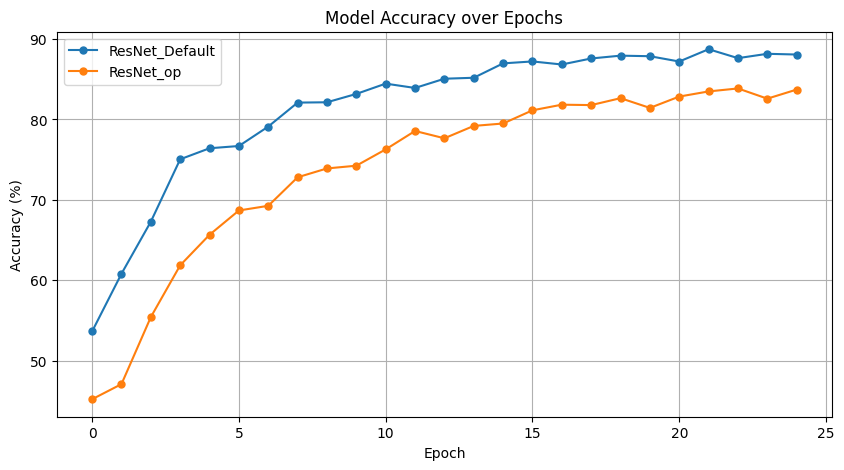

In [22]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='ResNet_op')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()

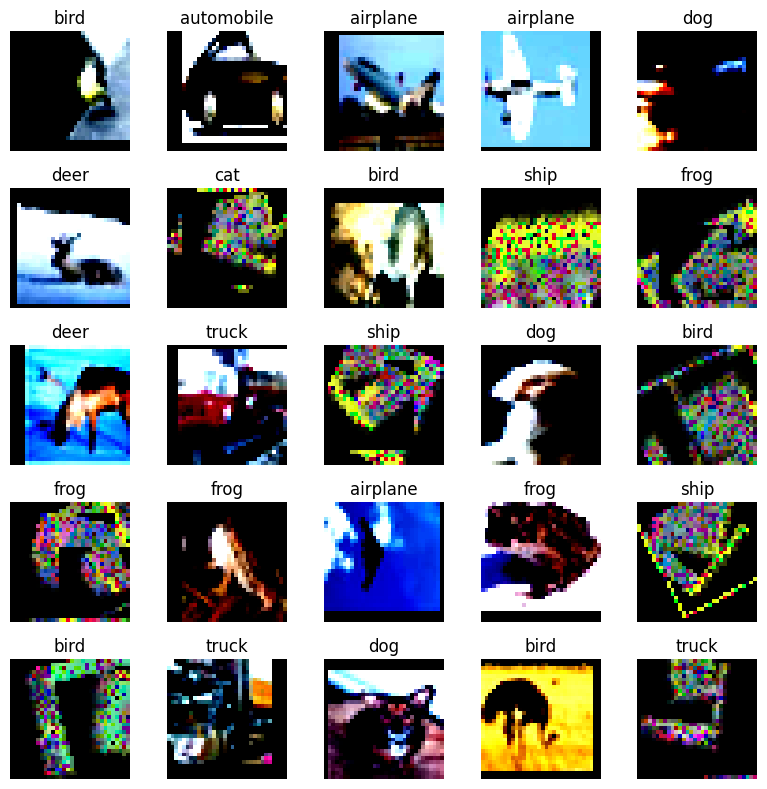

In [23]:
visualize_multiple_dataloaders([train_loader, train_loader_attacked, train_loader_attacked, train_loader_attacked, train_loader_attacked], test_loader, images_per_loader=5)

#### Poison Activation Validator

### 6. Image Restoration Module

In [24]:
train_set_attacked = load_dataset(folder_path = default_path, dat_name = "poisoned_validate.dat")
if train_set_attacked == None or Data_Reset == True or poision_sys_reset == True:
    train_set_attacked = AugmentedDataset(
        dataset=train_set,
        perterbationset=add_set,
        attacked_ratio=1,
        overlay=True,
        alpha=0.5,
        label_attack=True,
        partial_overlay=True,
        corruption_ratio=0.2,
        attack_order="label",
        im_proc_order="overlay"
    )
    save_dataset(train_set_attacked, dat_name = "poisoned_validate.dat")

train_loader_attacked = DataLoader(dataset=train_set_attacked, batch_size=64, shuffle=True)

C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\46769482.py:31: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  data = torch.load(dat_name)


data saved


#### 6.1 중독데이터 복원 AI 학습

##### CIFAR-10을 학습데이터로 이용

In [25]:
auto_10 = Autoencoder().to(device)
unet_10 = UNet().to(device)

Autotest = train_model(auto_10, train_loader, net_reset= restore_sys_reset, net_name="auto_10.pt", log_name = "auto_10")
unettest = train_model(unet_10, train_loader, net_reset= restore_sys_reset, net_name="unet_10.pt", log_name = "unet_10")

Number of Data Type: 2
Epoch [1/25], Loss: 0.7264729254233563
Epoch [2/25], Loss: 0.5447864612502515
Epoch [3/25], Loss: 0.5078115757850125
Epoch [4/25], Loss: 0.4906263513790677
Epoch [5/25], Loss: 0.4789729289462804
Epoch [6/25], Loss: 0.46702413866891884
Epoch [7/25], Loss: 0.4590662299748272
Epoch [8/25], Loss: 0.4540921574663323
Epoch [9/25], Loss: 0.44895037444656155
Epoch [10/25], Loss: 0.44542651762590385
Epoch [11/25], Loss: 0.44071253916948955
Epoch [12/25], Loss: 0.4363060176296307
Epoch [13/25], Loss: 0.4325821097854458
Epoch [14/25], Loss: 0.4301752309360163
Epoch [15/25], Loss: 0.4283489599023634
Epoch [16/25], Loss: 0.42638540641426126
Epoch [17/25], Loss: 0.42464150697983744
Epoch [18/25], Loss: 0.4226812809095968
Epoch [19/25], Loss: 0.42072198057875915
Epoch [20/25], Loss: 0.4190041725440403
Epoch [21/25], Loss: 0.41678353393321754
Epoch [22/25], Loss: 0.4157669204656425
Epoch [23/25], Loss: 0.41422277875721
Epoch [24/25], Loss: 0.4127137276065319
Epoch [25/25], Loss:

##### 중독데이터를 학습데이터로 이용

In [26]:
auto_attacked = Autoencoder().to(device)
unet_attacked = UNet().to(device)

Autotest_attaked = train_model(auto_attacked, train_loader_attacked, net_reset= restore_sys_reset, net_name="auto_attacked.pt", log_name = "auto_attacked")
unettest_attaked = train_model(unet_attacked, train_loader_attacked, net_reset= restore_sys_reset, net_name="unet_attacked.pt", log_name = "unet_attacked")

Number of Data Type: 4
Epoch [1/25], Loss: 0.05294172073264256
Epoch [2/25], Loss: 0.042232825289792414
Epoch [3/25], Loss: 0.03988087350202491
Epoch [4/25], Loss: 0.03856816390991363
Epoch [5/25], Loss: 0.03797385273525096
Epoch [6/25], Loss: 0.037321794194543303
Epoch [7/25], Loss: 0.03694177916525956
Epoch [8/25], Loss: 0.03669739472191504
Epoch [9/25], Loss: 0.03621841223715135
Epoch [10/25], Loss: 0.03614769244561796
Epoch [11/25], Loss: 0.035787084873508464
Epoch [12/25], Loss: 0.035675008995625215
Epoch [13/25], Loss: 0.03549384150911323
Epoch [14/25], Loss: 0.03521958836223311
Epoch [15/25], Loss: 0.03514384259910459
Epoch [16/25], Loss: 0.03498003288836735
Epoch [17/25], Loss: 0.03470838267851592
Epoch [18/25], Loss: 0.03471708426590237
Epoch [19/25], Loss: 0.03443091725001631
Epoch [20/25], Loss: 0.03443066736973841
Epoch [21/25], Loss: 0.03426382914328438
Epoch [22/25], Loss: 0.03434520216225206
Epoch [23/25], Loss: 0.03412048336918778
Epoch [24/25], Loss: 0.033982577462159


##### CIFAR-100을 학습데이터로 이용

In [27]:
auto_100 = Autoencoder().to(device)
unet_100 = UNet().to(device)

Autotest_100 = train_model(auto_100, add_loader, net_reset= restore_sys_reset, net_name="auto_100.pt", log_name = "auto_100")
unettest_100 = train_model(unet_100, add_loader, net_reset= restore_sys_reset, net_name="unet_100.pt", log_name = "unet_100")

Number of Data Type: 2
Epoch [1/25], Loss: 0.8023595282488771
Epoch [2/25], Loss: 0.5938652009915208
Epoch [3/25], Loss: 0.5570085169866567
Epoch [4/25], Loss: 0.5360704398978396
Epoch [5/25], Loss: 0.5200227208607032
Epoch [6/25], Loss: 0.5093880764511235
Epoch [7/25], Loss: 0.5002993982085182
Epoch [8/25], Loss: 0.4931897031681617
Epoch [9/25], Loss: 0.4897190905592935
Epoch [10/25], Loss: 0.48600599417448653
Epoch [11/25], Loss: 0.4826660207699022
Epoch [12/25], Loss: 0.4783585337193116
Epoch [13/25], Loss: 0.4750025007502197
Epoch [14/25], Loss: 0.47202023082529493
Epoch [15/25], Loss: 0.46927775865625543
Epoch [16/25], Loss: 0.466820616703814
Epoch [17/25], Loss: 0.46525184257560986
Epoch [18/25], Loss: 0.4632097535273608
Epoch [19/25], Loss: 0.46199353885315264
Epoch [20/25], Loss: 0.4606605336794158
Epoch [21/25], Loss: 0.4598105770090352
Epoch [22/25], Loss: 0.45809540922379555
Epoch [23/25], Loss: 0.4566382431541867
Epoch [24/25], Loss: 0.4552798095109213
Epoch [25/25], Loss: 

#### 6.2 학습결과 표출

In [28]:
# 이미지 결과 확인 함수
def show_images(restored_data, index = 0):
    # 결과 이미지를 시각화
    o_image, o_label, p_image, p_label, r_image = restored_data.original_images, restored_data.original_labels, restored_data.poisoned_images, restored_data.poisoned_labels, restored_data.restored_images
    fig, ax = plt.subplots(1, 3, figsize=(12, 4))
    
    ax[0].imshow(o_image[index].permute(1, 2, 0).cpu().detach().numpy())
    ax[0].set_title('Original')
    ax[1].imshow(p_image[index].permute(1, 2, 0).cpu().detach().numpy())
    ax[1].set_title('Poisoned')
    ax[2].imshow(r_image[index].permute(1, 2, 0).cpu().detach().numpy())
    ax[2].set_title('Recovered Output')
    
    plt.show()
    print("Original Label:", o_label[index])
    print("Poisoned Label:", p_label[index])

def multi_show(restored_data, sample = 10):
    for i in range(sample):
        label = restored_data.poisoned_labels
        index = random.randrange(1, len(label))
        show_images(restored_data, index)

#### 6.3 중독된 데이터 복구 적용

#### 복구데이터 클래스 정의

In [29]:
class CIFAR10WithModelOutputAndLabels(Dataset):
    def __init__(self, original_images, original_labels, poisoned_images,  poisoned_labels, restored_images):
        self.original_images= original_images
        self.original_labels = original_labels        
        self.poisoned_images = poisoned_images
        self.poisoned_labels = poisoned_labels
        self.restored_images = restored_images

    def __len__(self):
        return len(self.poisoned_images)

    def __getitem__(self, idx):
        return self.original_images[idx], self.original_labels[idx], self.poisoned_images[idx], self.poisoned_labels[idx] , self.restored_images[idx]

# 이미지를 모델에 통과시키고 출력 저장하는 함수
def process_and_save_cifar10(dataloader, net_name ="default_net.pt" , output_filename="processed_cifar10_with_labels.pth"):
    """
    CIFAR-10 DataLoader에서 이미지를 처리하고, 모델의 출력과 라벨을 저장하는 함수.
    """
    os.chdir(default_path)
    model = torch.load(net_name)
    model.eval()  # 모델을 평가 모드로 설정
    os.chdir("../")

    all_original_images =[]
    all_original_labels=[]
    all_images = []
    all_outputs = []
    all_labels = []

    with torch.no_grad():  # 예측 시에는 그래디언트 계산을 하지 않음
        for data in dataloader:
            original_images, original_labels, images, labels = data
            # 이미지를 GPU로 이동 (GPU가 사용 가능하면)
            images = images.cuda() if torch.cuda.is_available() else images
            labels = labels.cuda() if torch.cuda.is_available() else labels

            # 모델을 통해 예측 결과 얻기
            outputs = model(images)

            # 결과를 리스트에 추가
            all_original_images.append(original_images)
            all_original_labels.append(original_labels)
            all_images.append(images.cpu())  # CPU로 이동하여 저장
            all_labels.append(labels.cpu())  # CPU로 이동하여 저장
            all_outputs.append(outputs.cpu())  # CPU로 이동하여 저장

    # CIFAR-10 이미지, 모델 출력, 라벨을 포함한 Dataset 생성
    combined_dataset = CIFAR10WithModelOutputAndLabels(
        torch.cat(all_original_images), torch.cat(all_original_labels), torch.cat(all_images), torch.cat(all_labels) , torch.cat(all_outputs)
    )

    os.chdir(default_path)
    # PyTorch Dataset을 저장
    torch.save(combined_dataset, output_filename)
    print(f"Processed data with labels saved to {output_filename}")
    print(os.getcwd)
    os.chdir("../")

    del model
    torch.cuda.empty_cache()
    gc.collect()


#### 복구

C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\1914269121.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(net_name)


Processed data with labels saved to auto_10.pth
<built-in function getcwd>


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\3029061242.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s_auto_10 = torch.load("auto_10.pth")
Clipping input data t

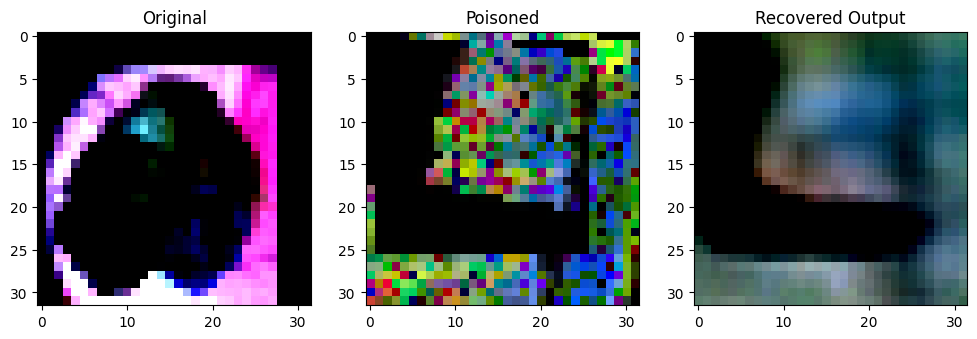

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9839258].


Original Label: tensor(5)
Poisoned Label: tensor(7)


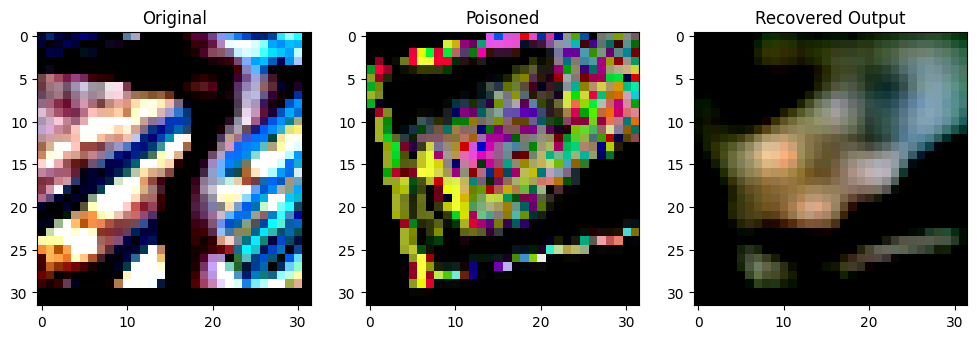

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5942485].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80743426].


Original Label: tensor(2)
Poisoned Label: tensor(1)


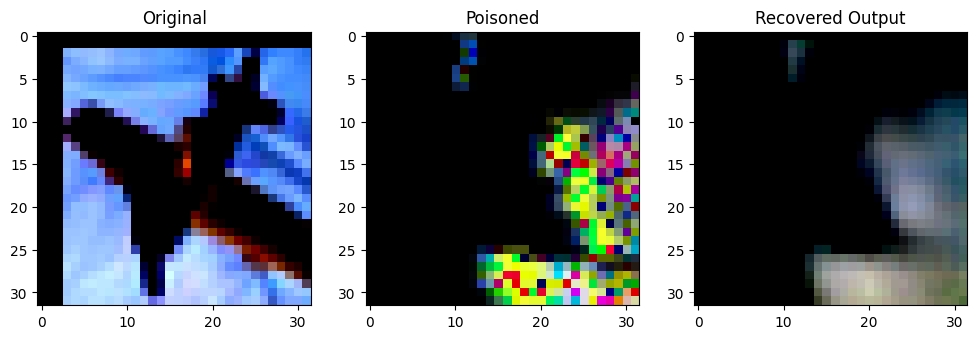

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2885156].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98590004].


Original Label: tensor(0)
Poisoned Label: tensor(0)


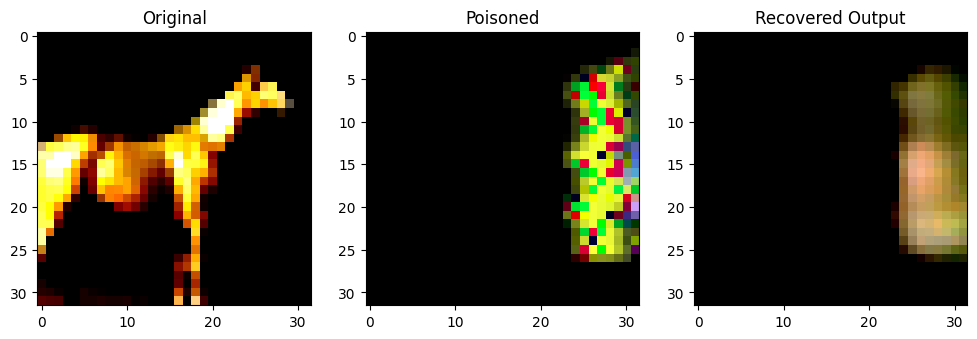

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92516047].


Original Label: tensor(7)
Poisoned Label: tensor(0)


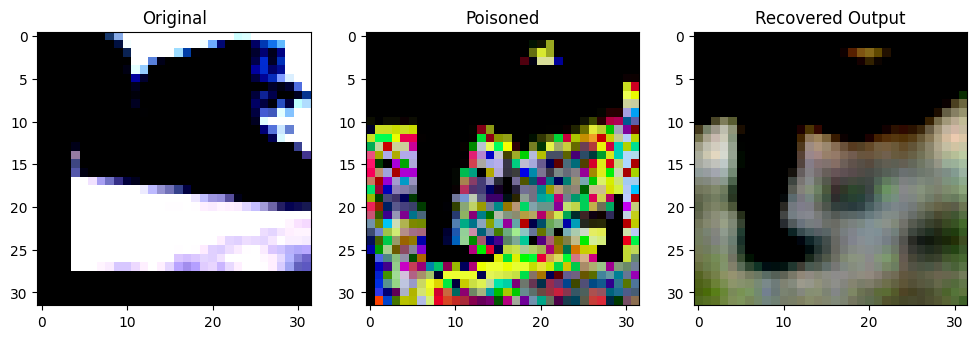

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999998..0.98896575].


Original Label: tensor(9)
Poisoned Label: tensor(2)


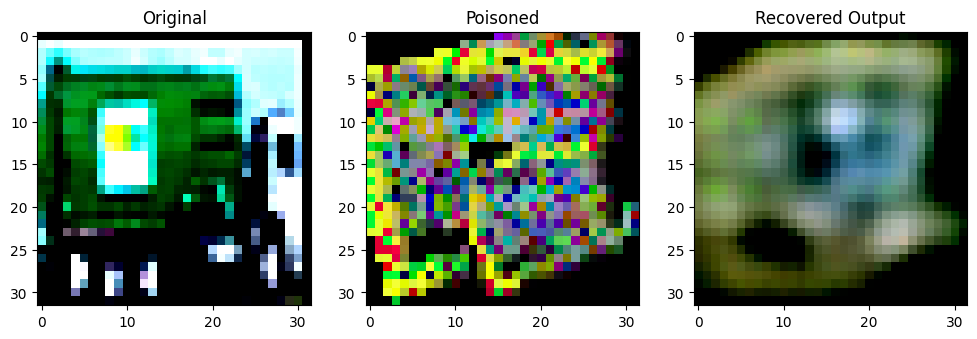

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.756259].


Original Label: tensor(9)
Poisoned Label: tensor(3)


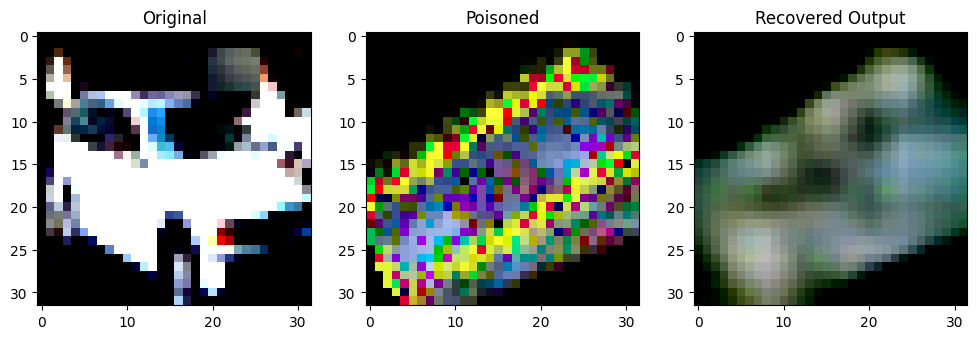

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1975338].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9328128].


Original Label: tensor(1)
Poisoned Label: tensor(4)


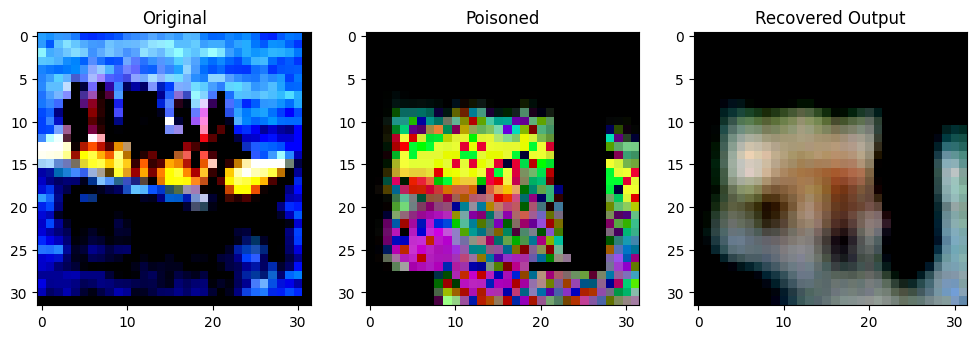

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.0888019].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..0.93469304].


Original Label: tensor(8)
Poisoned Label: tensor(2)


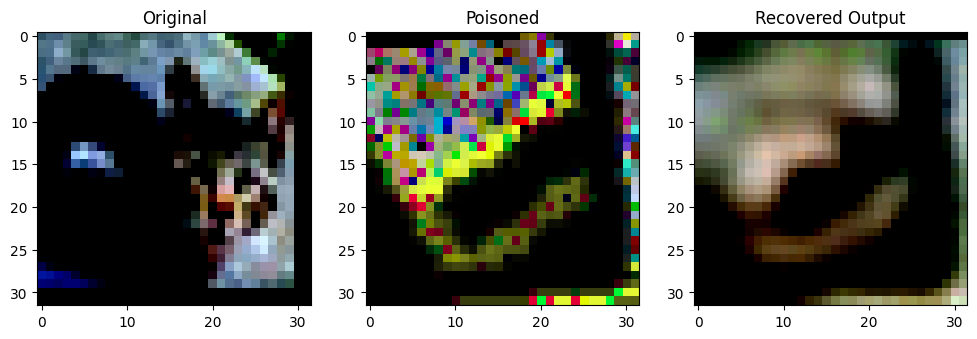

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0474076].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92213726].


Original Label: tensor(3)
Poisoned Label: tensor(0)


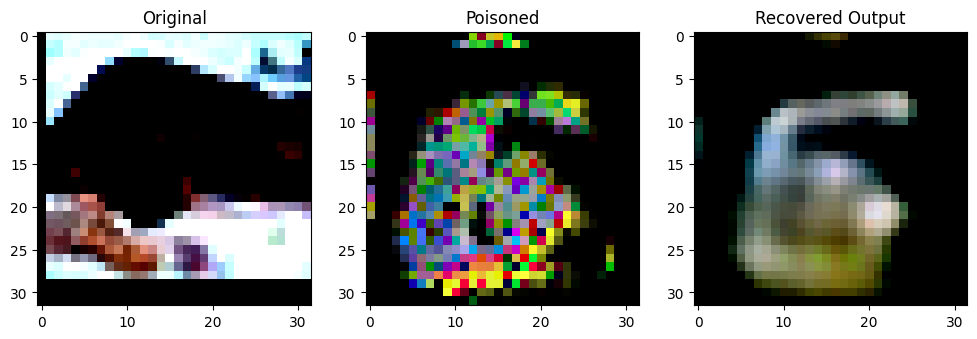

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0084033].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94955826].


Original Label: tensor(5)
Poisoned Label: tensor(9)


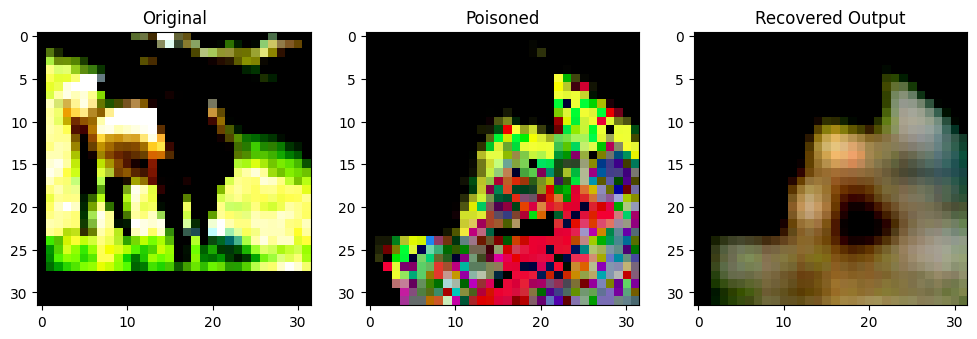

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.0713727].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8326094].


Original Label: tensor(4)
Poisoned Label: tensor(1)


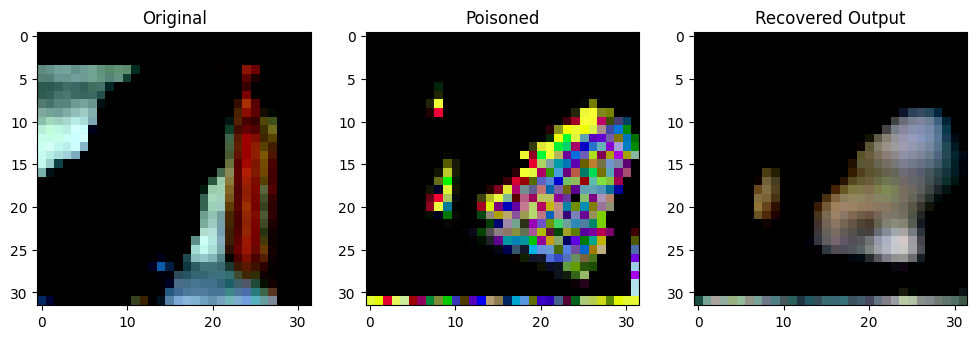

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8036647].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8032073].


Original Label: tensor(5)
Poisoned Label: tensor(1)


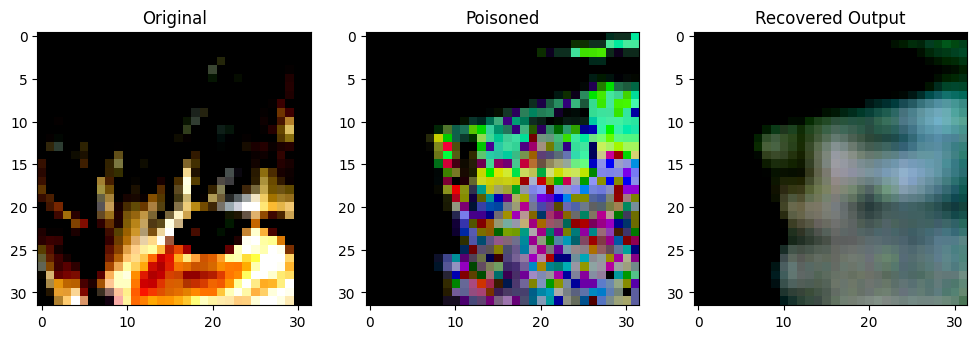

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3262744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74900055].


Original Label: tensor(3)
Poisoned Label: tensor(6)


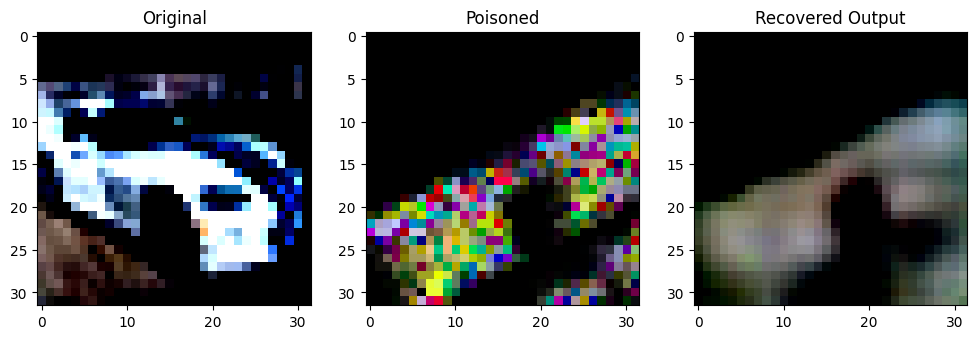

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2317834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99966264].


Original Label: tensor(1)
Poisoned Label: tensor(5)


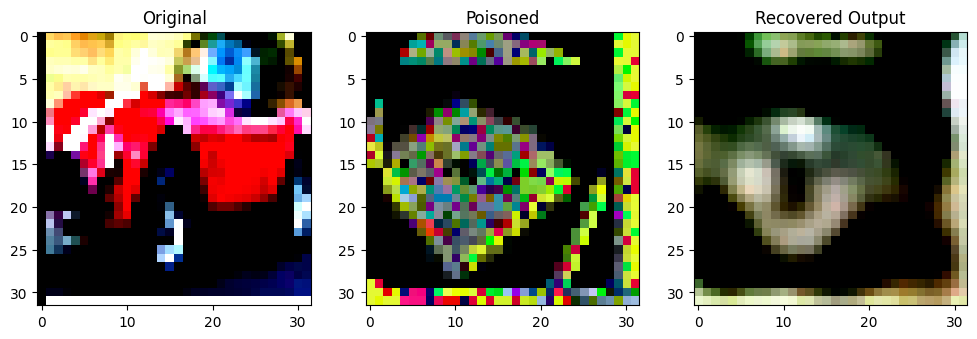

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9992956].


Original Label: tensor(1)
Poisoned Label: tensor(5)


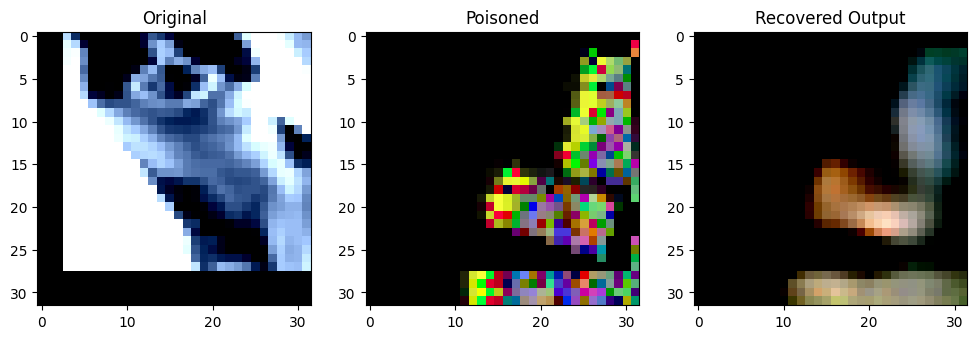

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92858946].


Original Label: tensor(3)
Poisoned Label: tensor(4)


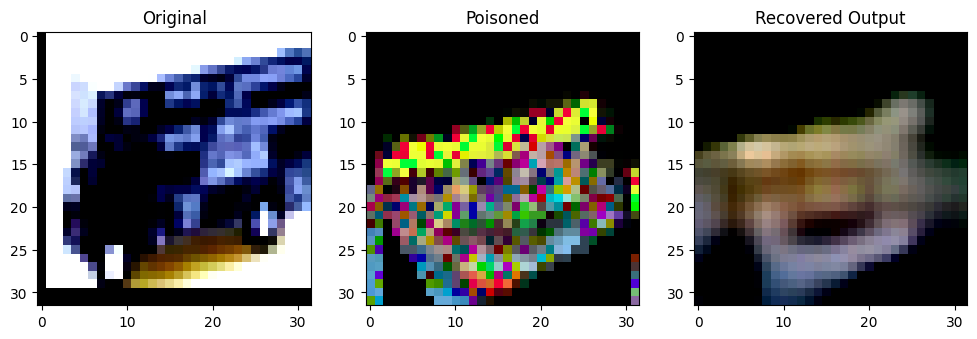

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.745514].


Original Label: tensor(9)
Poisoned Label: tensor(2)


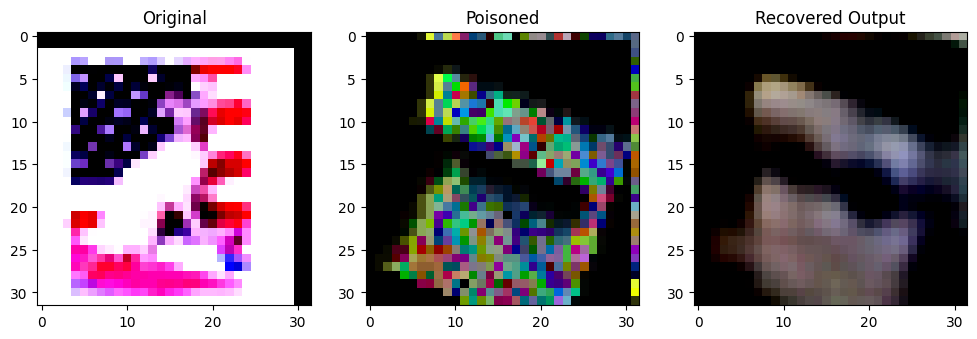

Original Label: tensor(3)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93716735].


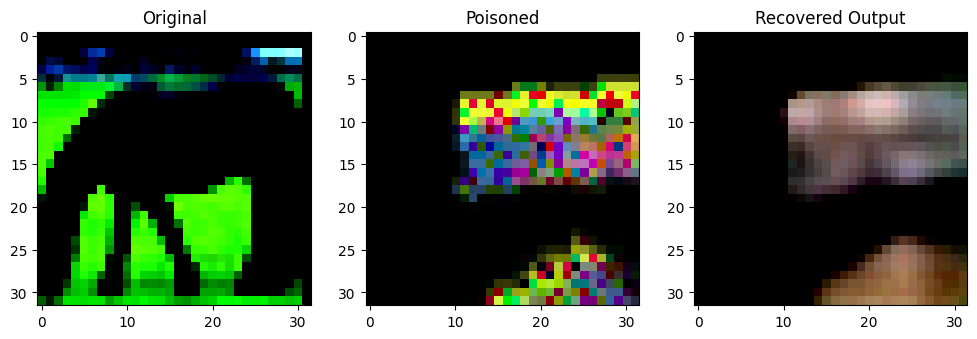

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8137439].


Original Label: tensor(7)
Poisoned Label: tensor(7)


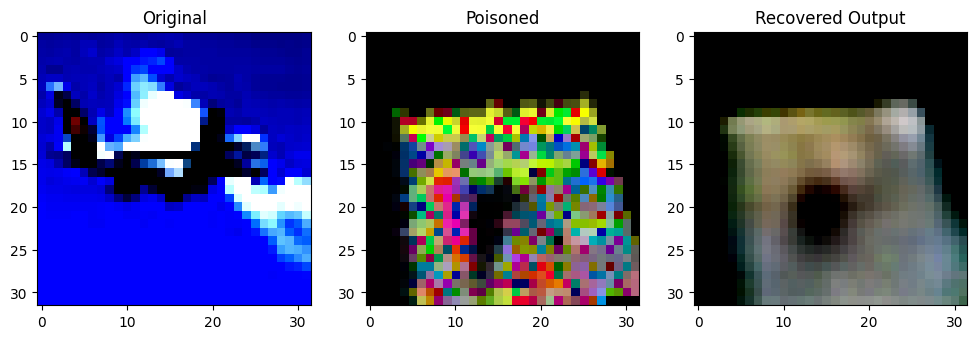

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.11191].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6580827].


Original Label: tensor(0)
Poisoned Label: tensor(9)


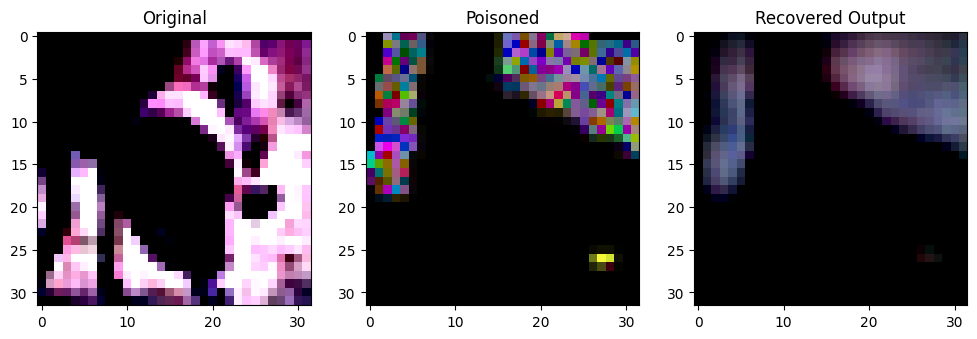

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5882353].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77113533].


Original Label: tensor(4)
Poisoned Label: tensor(6)


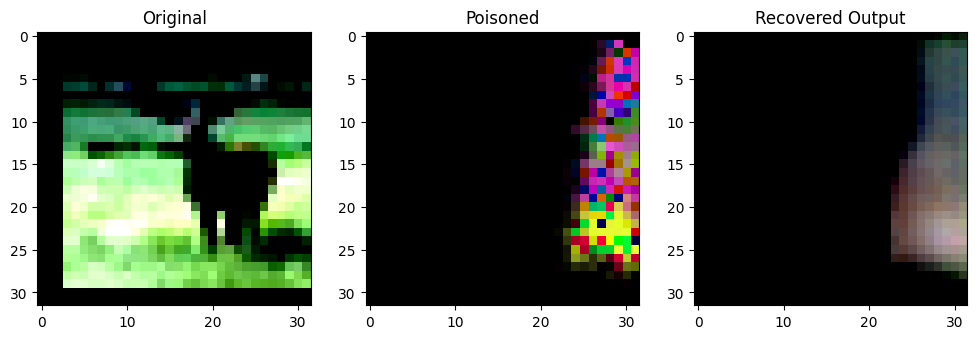

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.923097].


Original Label: tensor(4)
Poisoned Label: tensor(6)


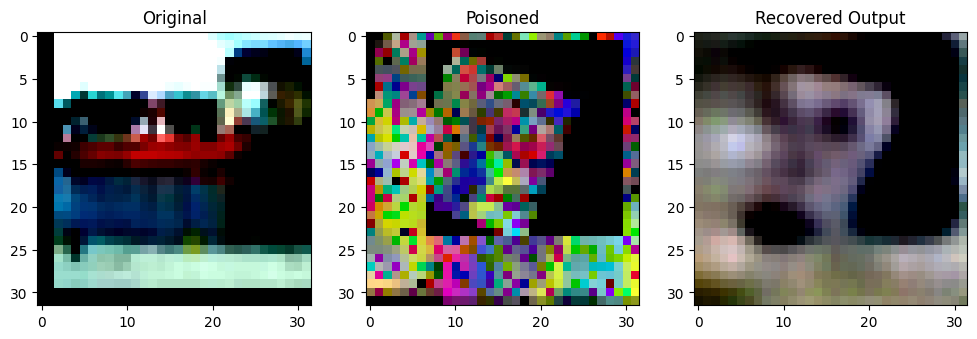

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8683473].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7778672].


Original Label: tensor(8)
Poisoned Label: tensor(7)


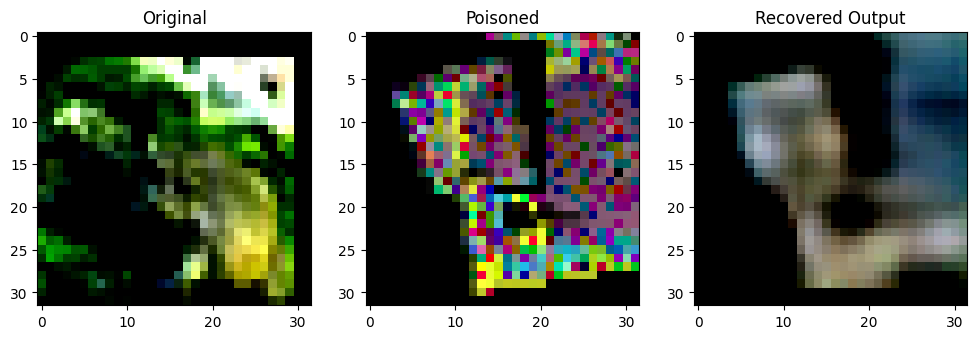

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9652166].


Original Label: tensor(6)
Poisoned Label: tensor(1)


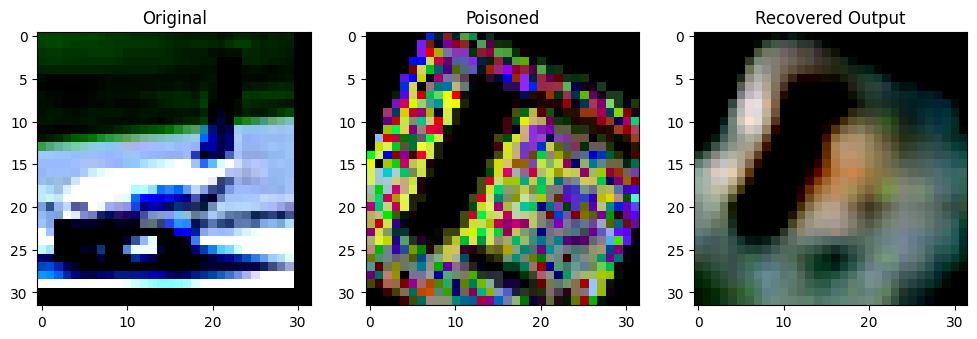

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999917..0.95806545].


Original Label: tensor(0)
Poisoned Label: tensor(4)


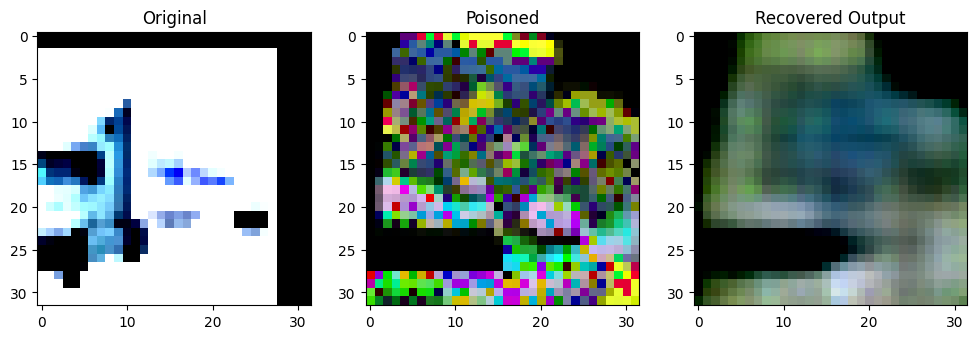

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7525765].


Original Label: tensor(9)
Poisoned Label: tensor(0)


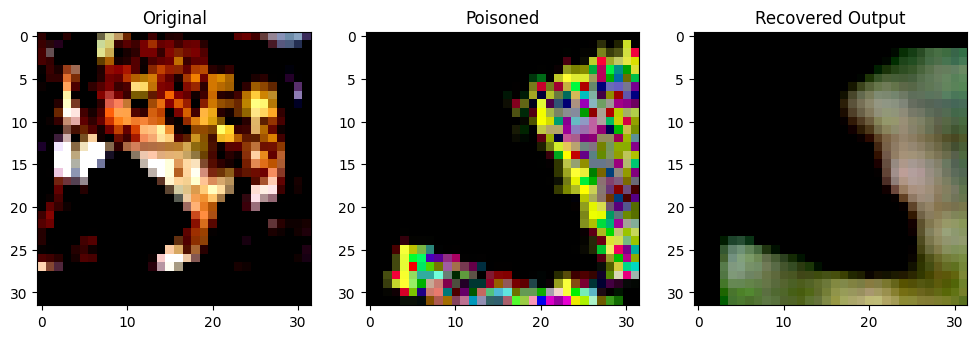

Original Label: tensor(6)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9932123].


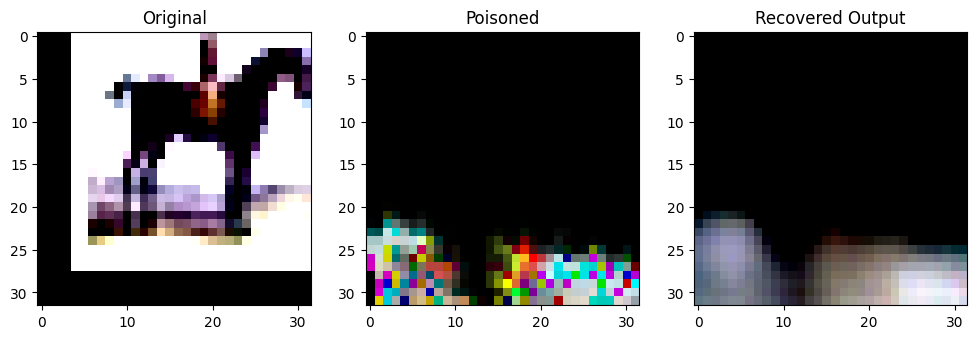

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73037446].


Original Label: tensor(7)
Poisoned Label: tensor(1)


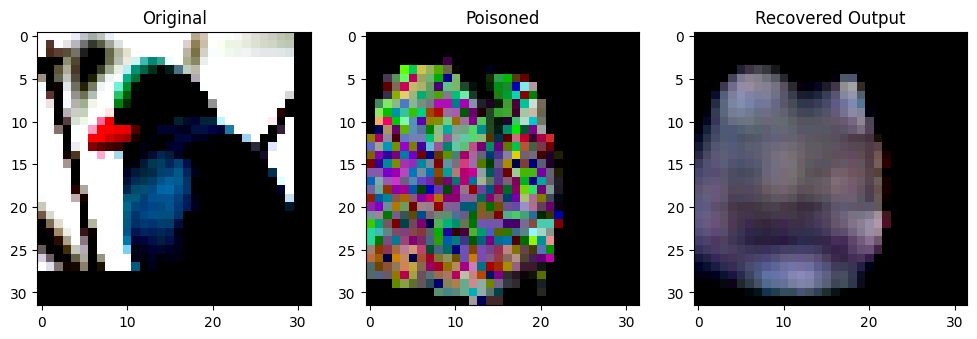

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7274723].


Original Label: tensor(2)
Poisoned Label: tensor(4)


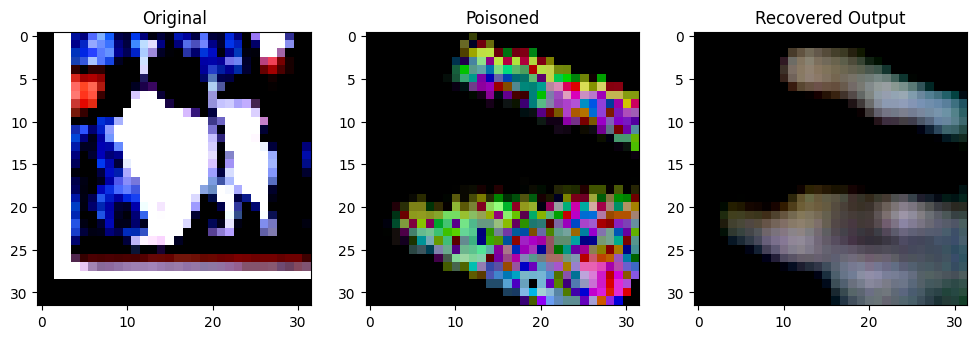

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.907974].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73535824].


Original Label: tensor(5)
Poisoned Label: tensor(9)


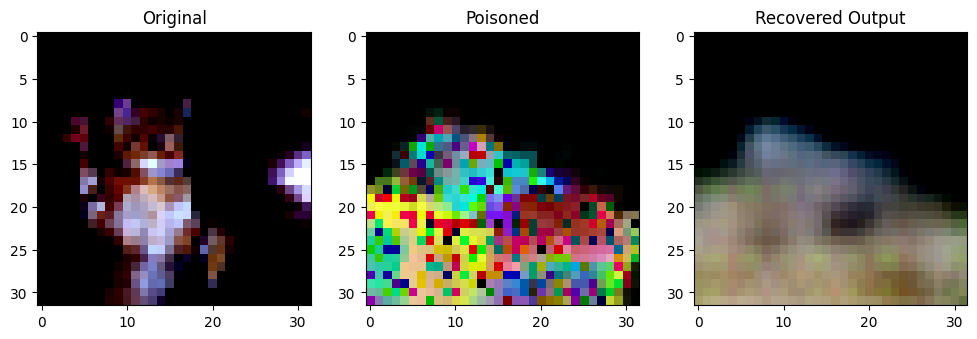

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6837914].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99154246].


Original Label: tensor(3)
Poisoned Label: tensor(4)


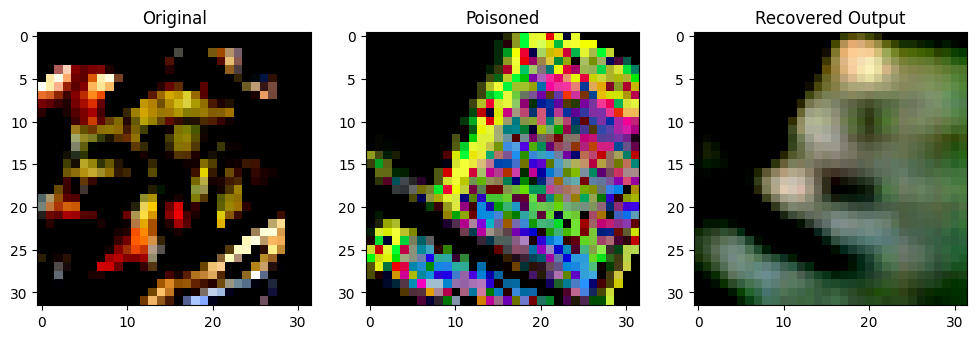

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8539895].


Original Label: tensor(6)
Poisoned Label: tensor(1)


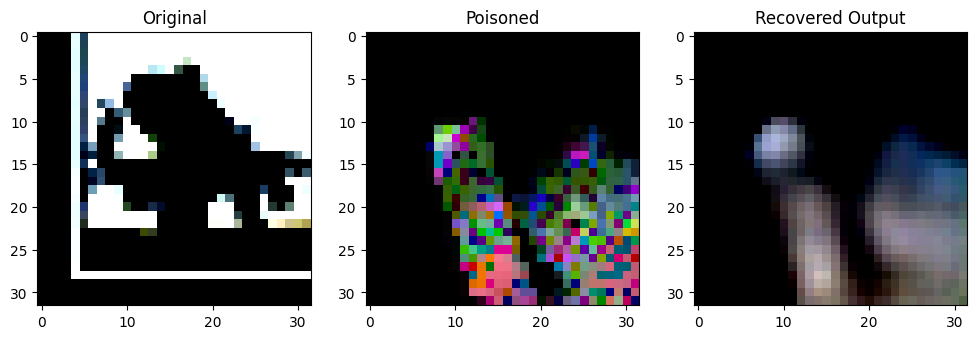

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.736488].


Original Label: tensor(0)
Poisoned Label: tensor(1)


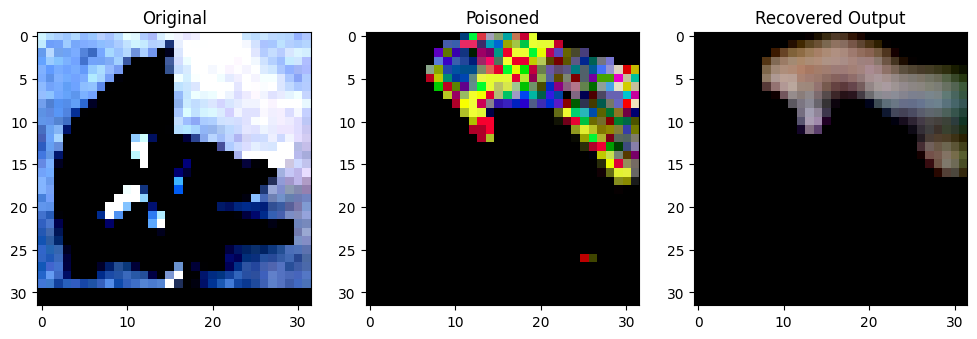

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69249463].


Original Label: tensor(3)
Poisoned Label: tensor(4)


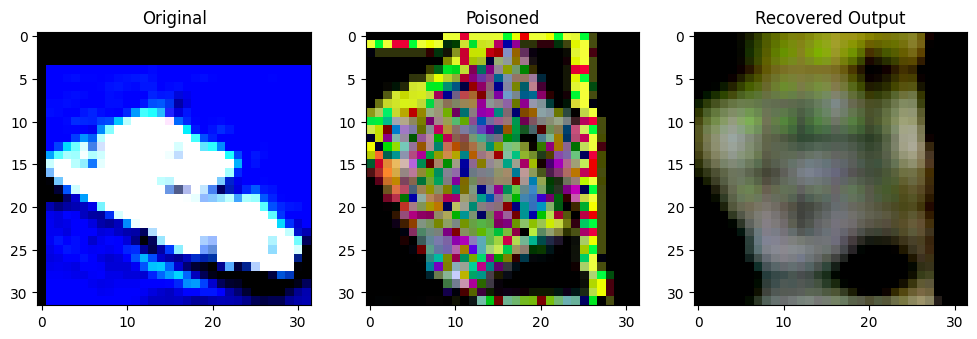

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9848888].


Original Label: tensor(8)
Poisoned Label: tensor(6)


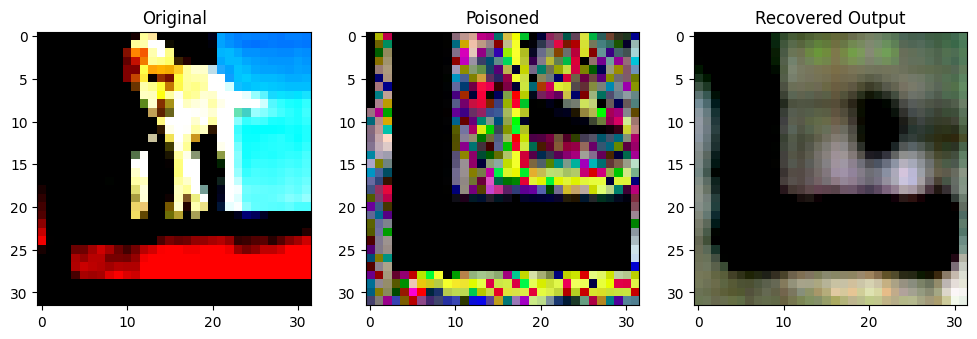

Original Label: tensor(5)
Poisoned Label: tensor(4)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.64690673].


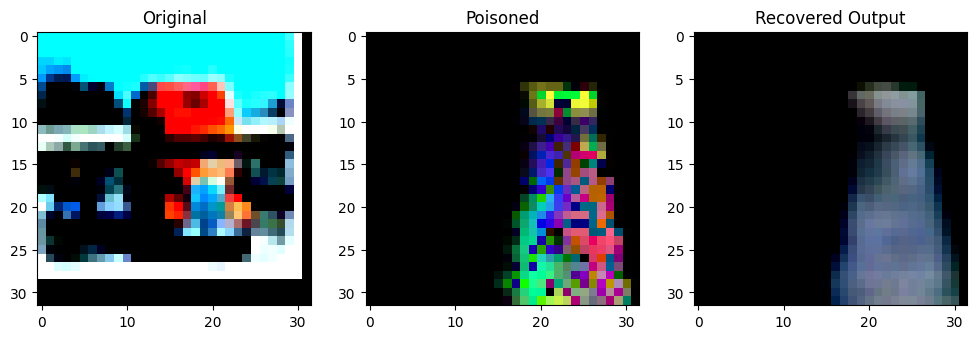

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8781647].


Original Label: tensor(9)
Poisoned Label: tensor(6)


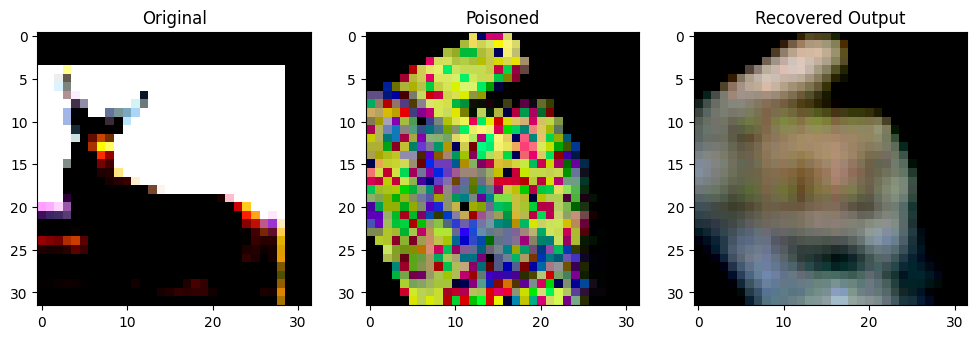

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69627535].


Original Label: tensor(4)
Poisoned Label: tensor(8)


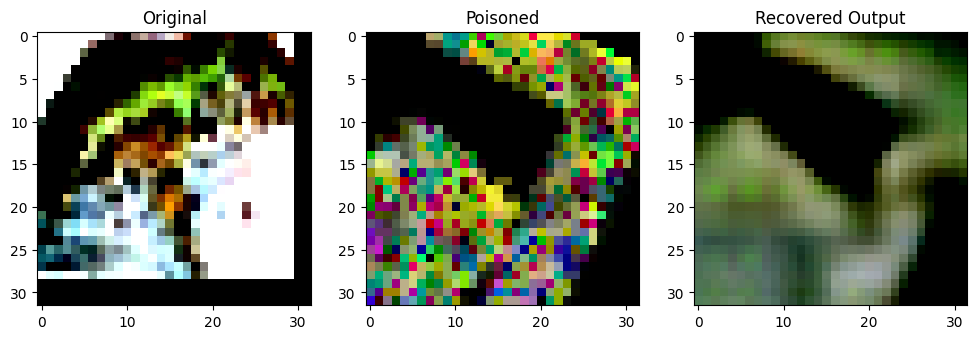

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8807355].


Original Label: tensor(6)
Poisoned Label: tensor(4)


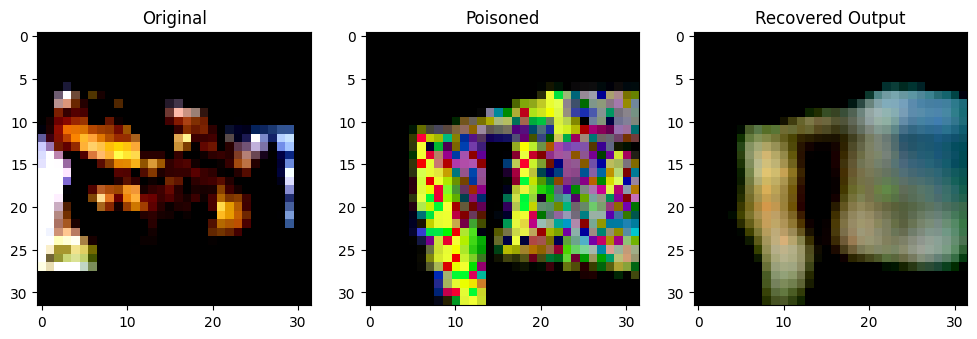

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.878928].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9715936].


Original Label: tensor(6)
Poisoned Label: tensor(7)


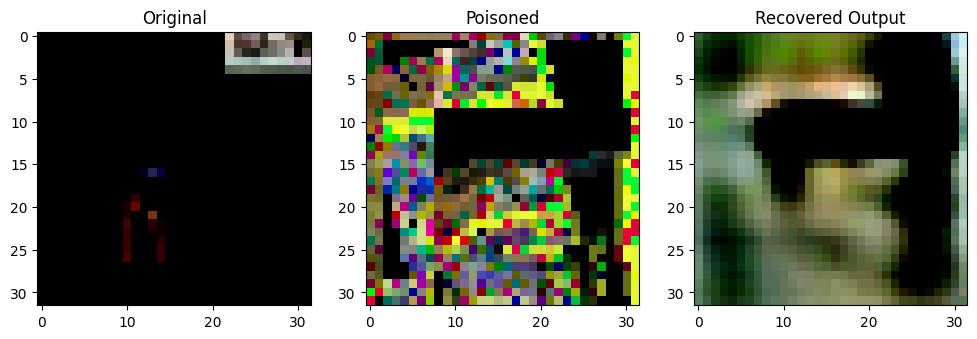

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86245763].


Original Label: tensor(2)
Poisoned Label: tensor(7)


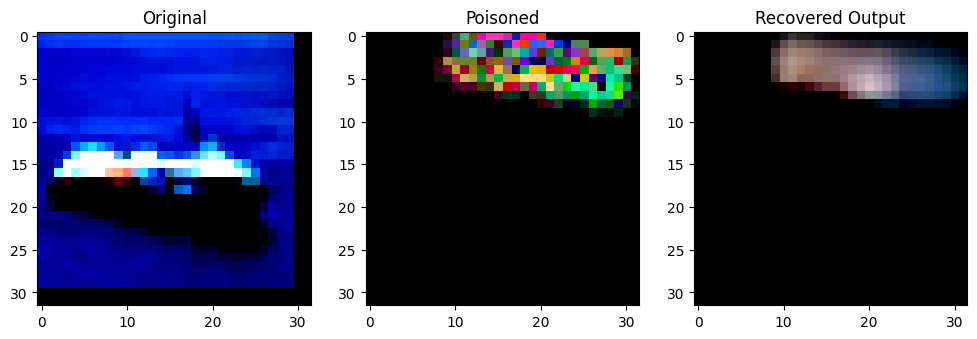

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8337918].


Original Label: tensor(8)
Poisoned Label: tensor(3)


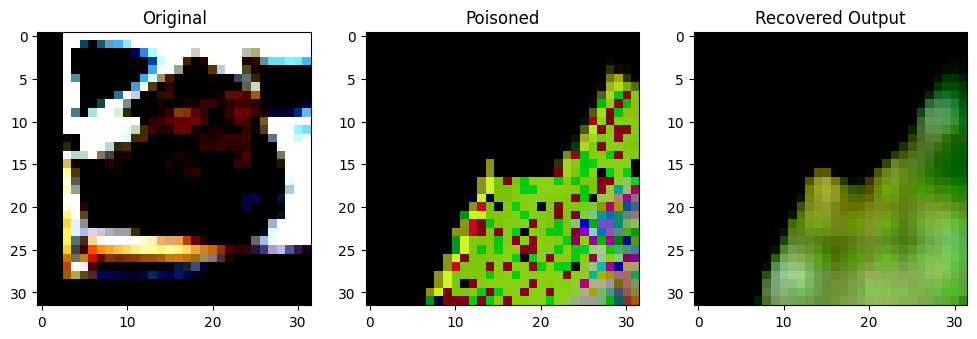

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8852906].


Original Label: tensor(6)
Poisoned Label: tensor(3)


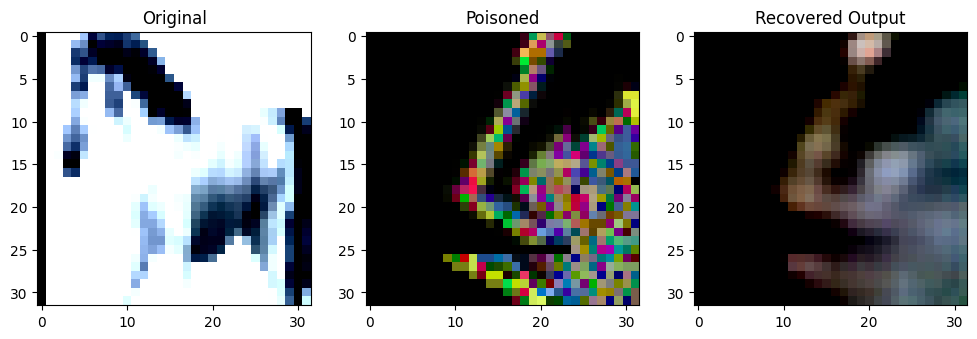

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9930464].


Original Label: tensor(7)
Poisoned Label: tensor(2)


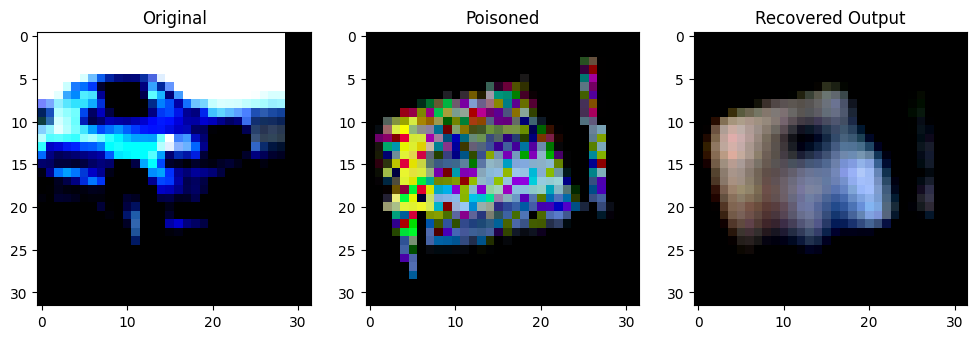

Original Label: tensor(1)
Poisoned Label: tensor(2)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1804092].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6442809].


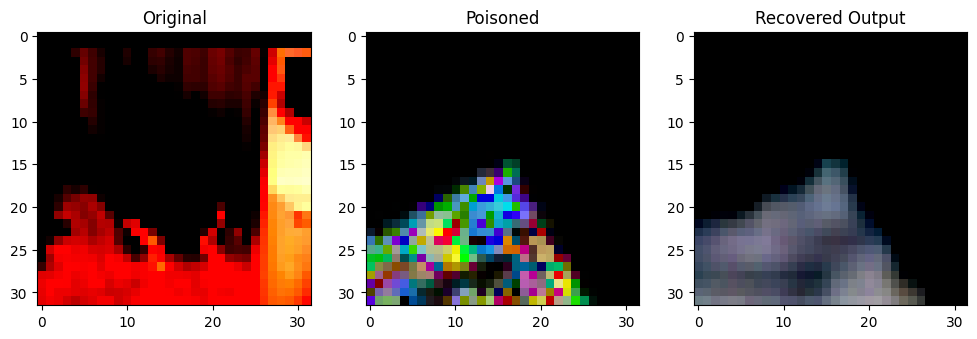

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7351656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(3)
Poisoned Label: tensor(8)


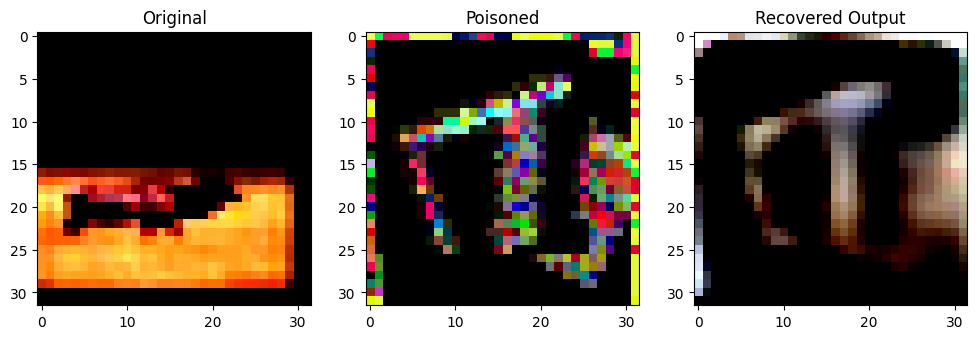

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6116778].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9869825].


Original Label: tensor(4)
Poisoned Label: tensor(4)


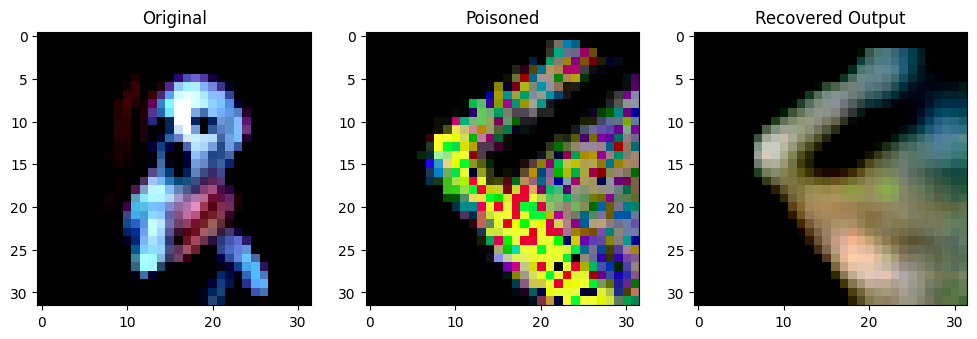

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2385478].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9903889].


Original Label: tensor(5)
Poisoned Label: tensor(5)


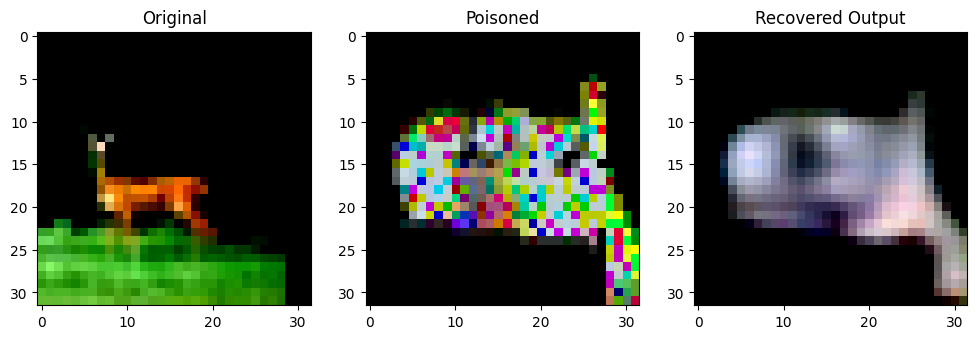

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6879134].


Original Label: tensor(4)
Poisoned Label: tensor(2)


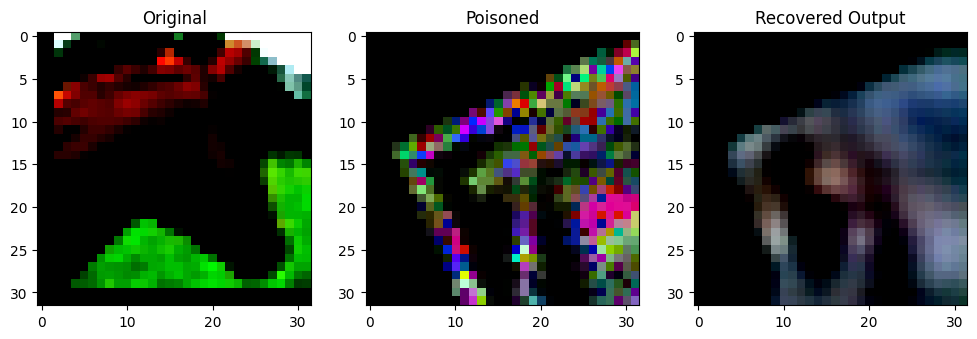

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8225776].


Original Label: tensor(7)
Poisoned Label: tensor(5)


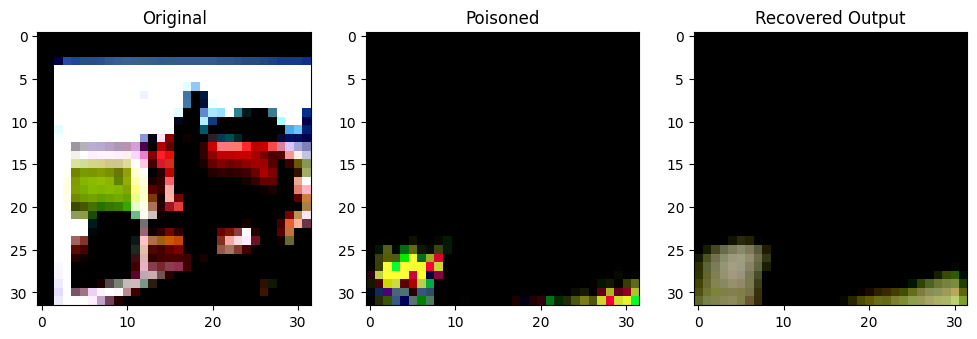

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6757703].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7323412].


Original Label: tensor(7)
Poisoned Label: tensor(9)


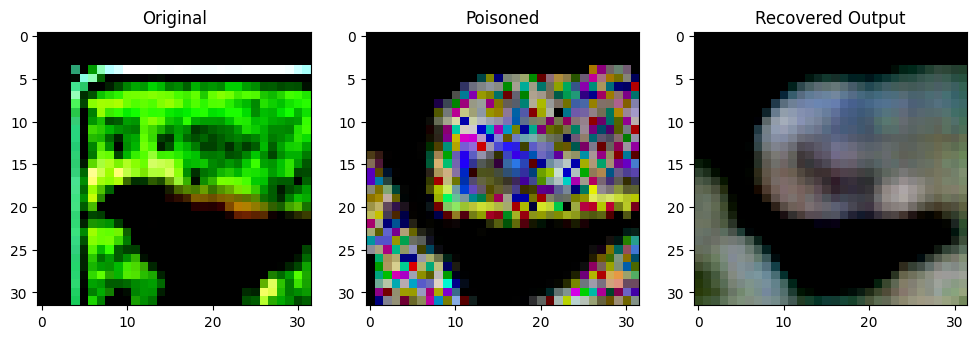

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2317834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.79211545].


Original Label: tensor(2)
Poisoned Label: tensor(7)


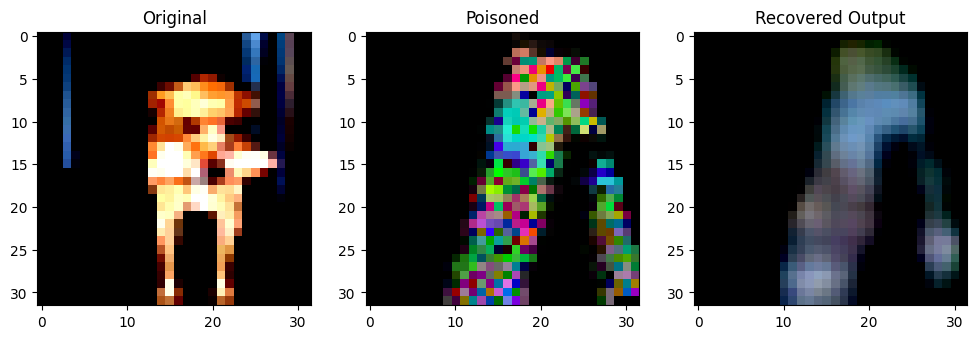

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90878654].


Original Label: tensor(5)
Poisoned Label: tensor(4)


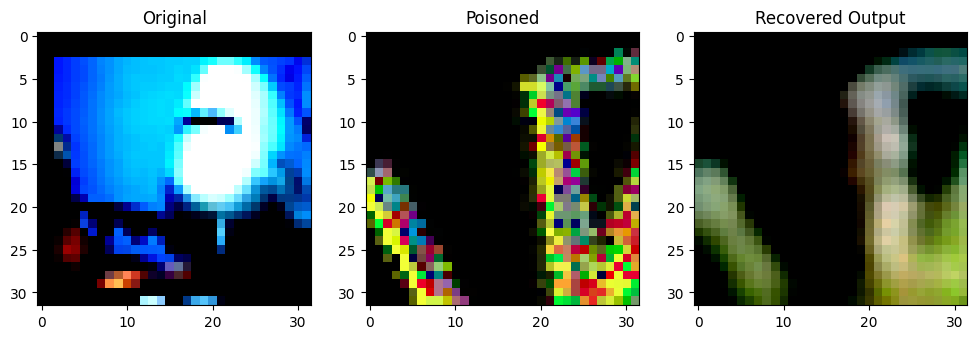

Original Label: tensor(0)
Poisoned Label: tensor(9)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.79330426].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98639935].


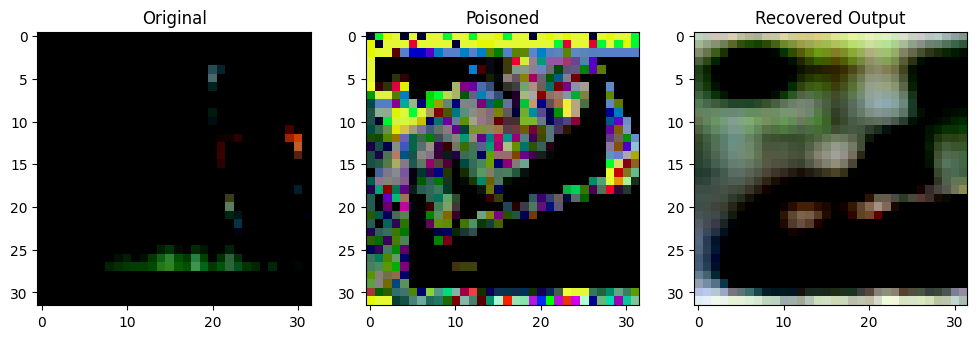

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82616836].


Original Label: tensor(4)
Poisoned Label: tensor(5)


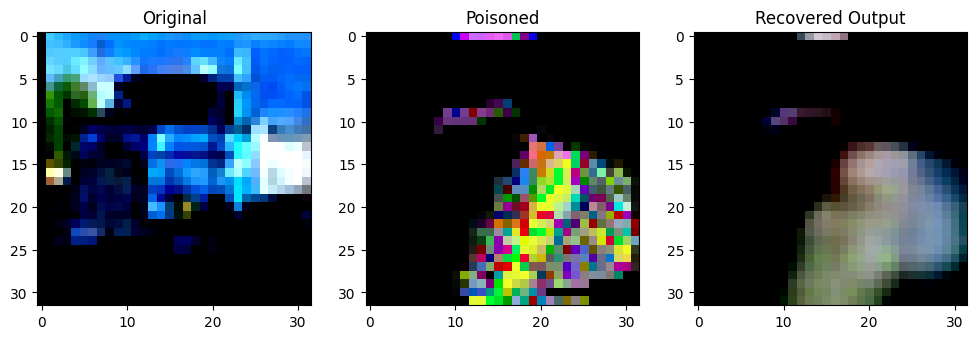

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99095577..0.99291843].


Original Label: tensor(9)
Poisoned Label: tensor(9)


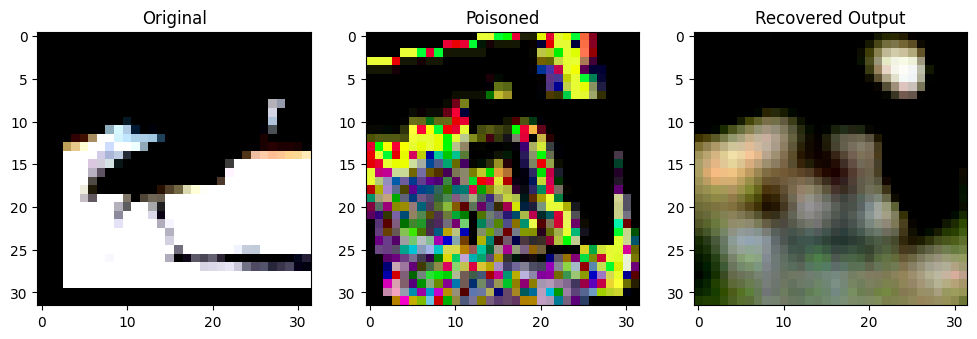

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9670856].


Original Label: tensor(2)
Poisoned Label: tensor(0)


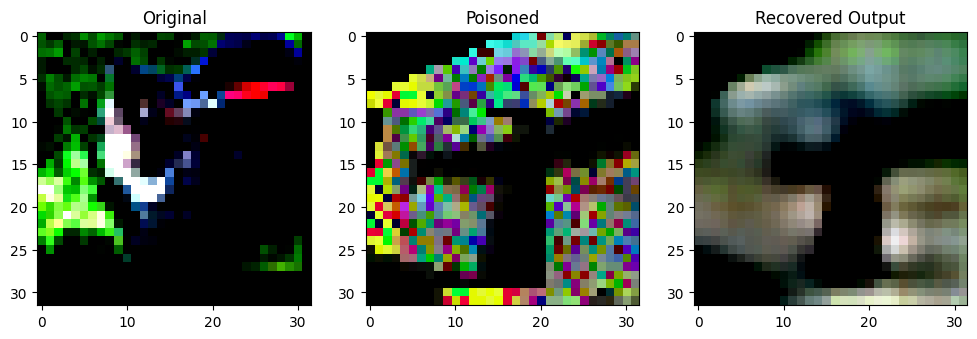

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74256766].


Original Label: tensor(3)
Poisoned Label: tensor(3)


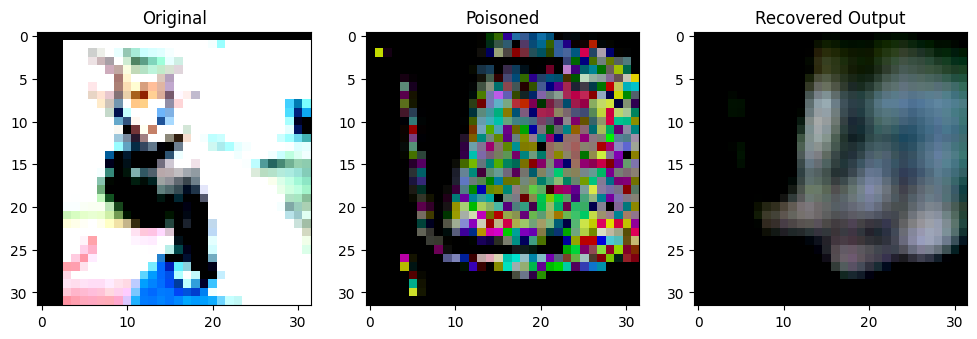

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.923538].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9751465].


Original Label: tensor(3)
Poisoned Label: tensor(8)


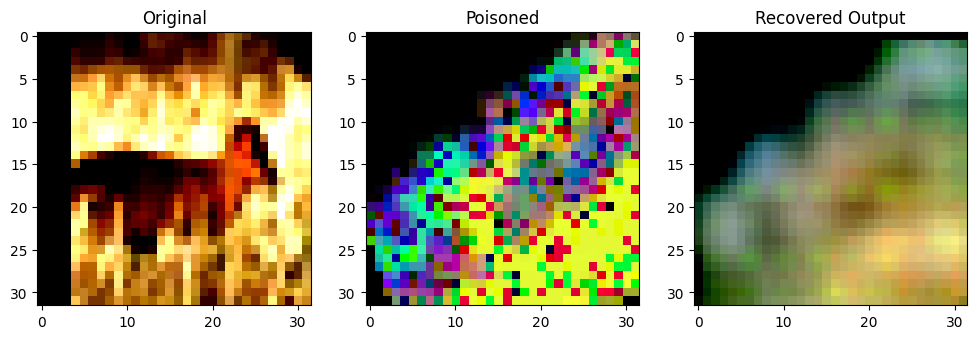

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.62109494].


Original Label: tensor(4)
Poisoned Label: tensor(5)


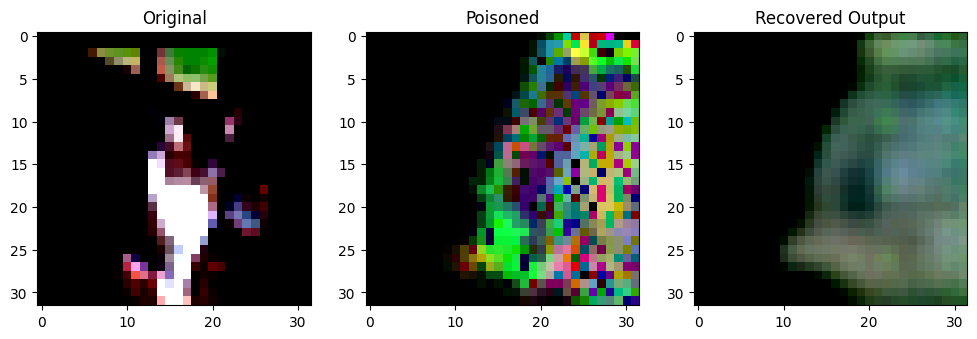

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9594201].


Original Label: tensor(3)
Poisoned Label: tensor(7)


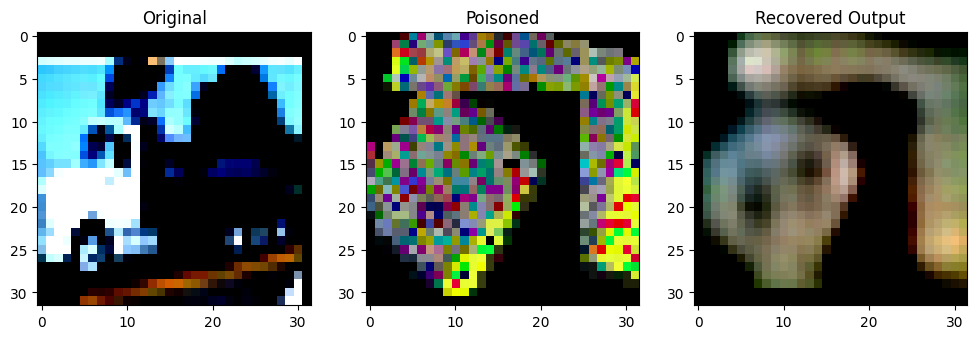

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73069125].


Original Label: tensor(9)
Poisoned Label: tensor(8)


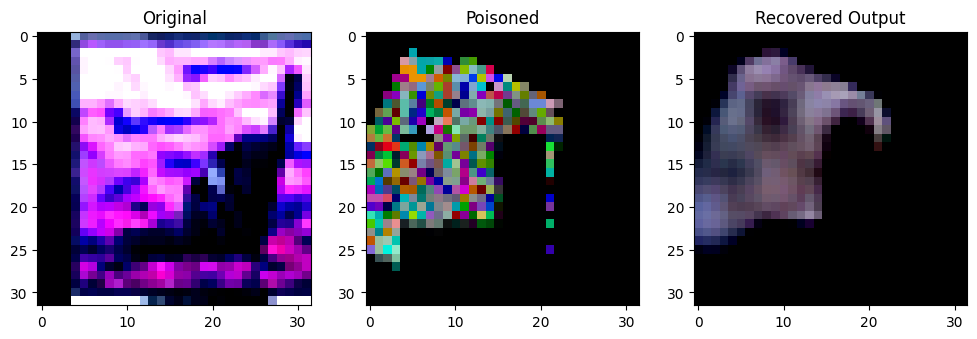

Original Label: tensor(0)
Poisoned Label: tensor(6)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68666005].


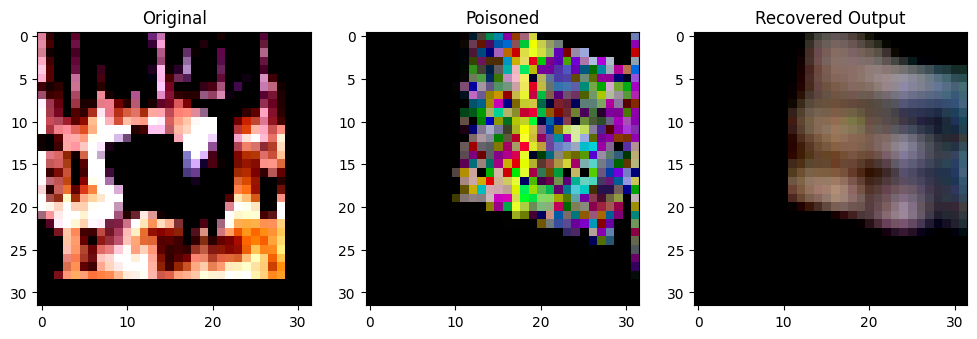

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9018047].


Original Label: tensor(4)
Poisoned Label: tensor(4)


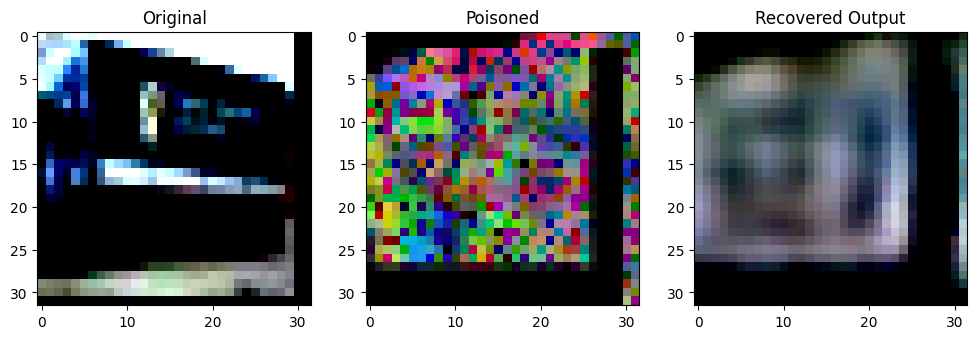

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1659663].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91055685].


Original Label: tensor(9)
Poisoned Label: tensor(0)


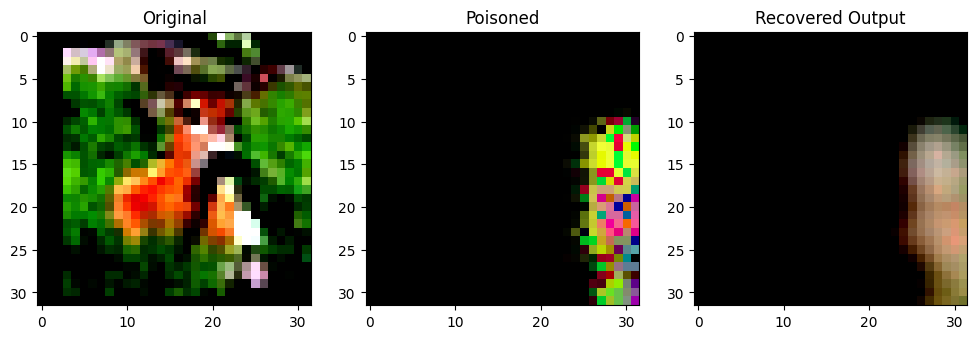

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.674404].


Original Label: tensor(4)
Poisoned Label: tensor(5)


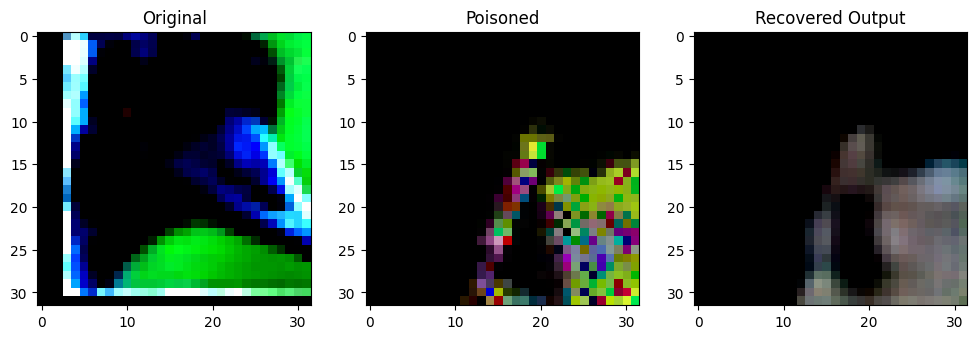

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7732536].


Original Label: tensor(2)
Poisoned Label: tensor(1)


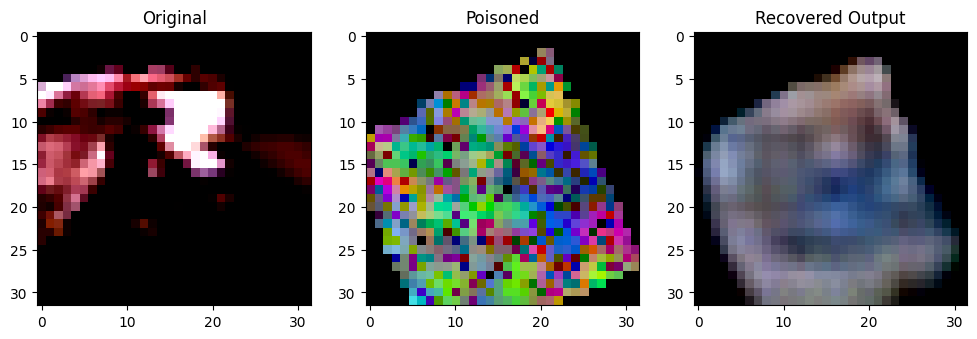

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96875614].


Original Label: tensor(7)
Poisoned Label: tensor(6)


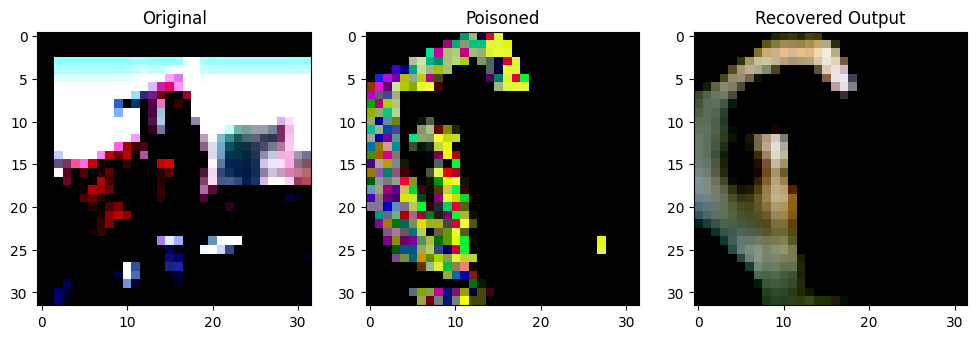

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0947855].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.969766].


Original Label: tensor(9)
Poisoned Label: tensor(5)


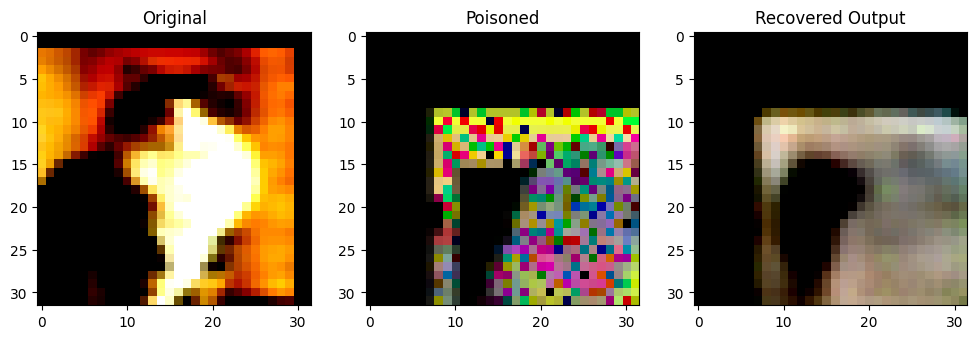

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9749122].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99549985].


Original Label: tensor(3)
Poisoned Label: tensor(8)


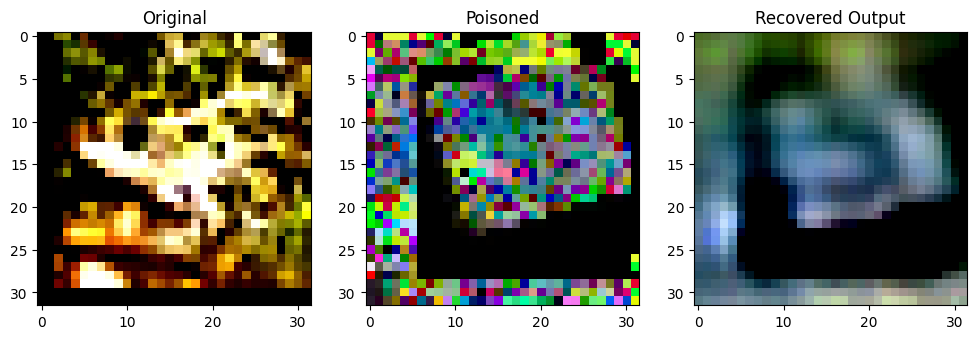

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9709851].


Original Label: tensor(6)
Poisoned Label: tensor(4)


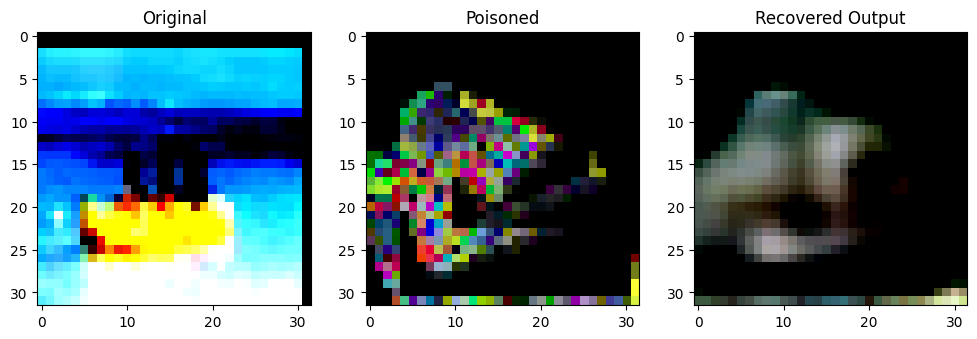

Original Label: tensor(8)
Poisoned Label: tensor(2)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7999733].


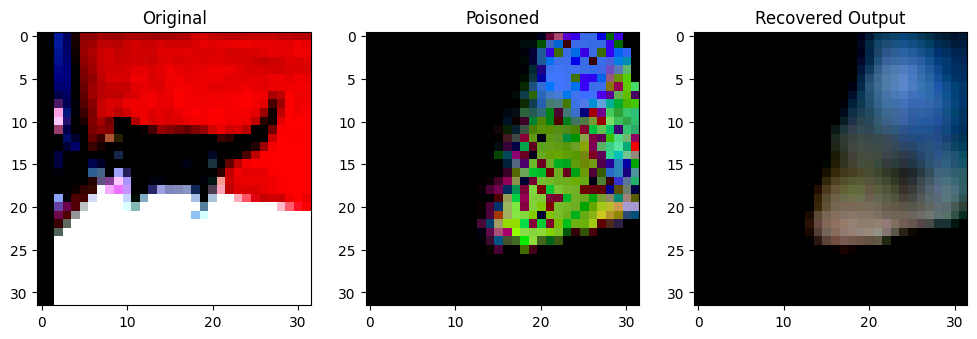

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92423743].


Original Label: tensor(3)
Poisoned Label: tensor(8)


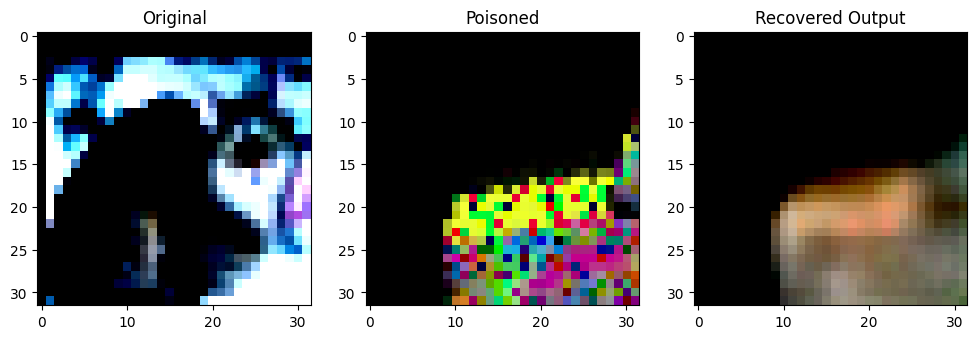

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8504648].


Original Label: tensor(3)
Poisoned Label: tensor(0)


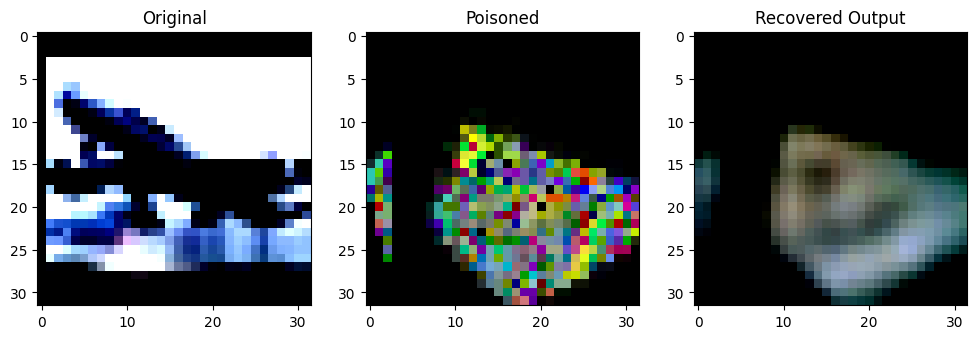

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(0)
Poisoned Label: tensor(5)


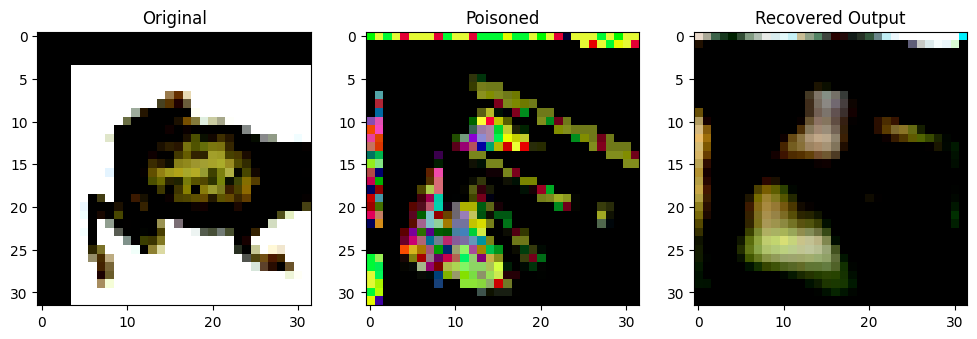

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0299783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9544978].


Original Label: tensor(6)
Poisoned Label: tensor(1)


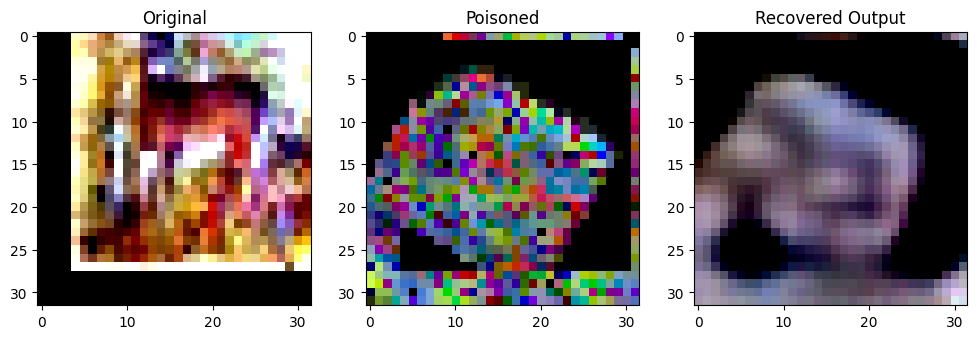

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7522904].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9418389].


Original Label: tensor(4)
Poisoned Label: tensor(2)


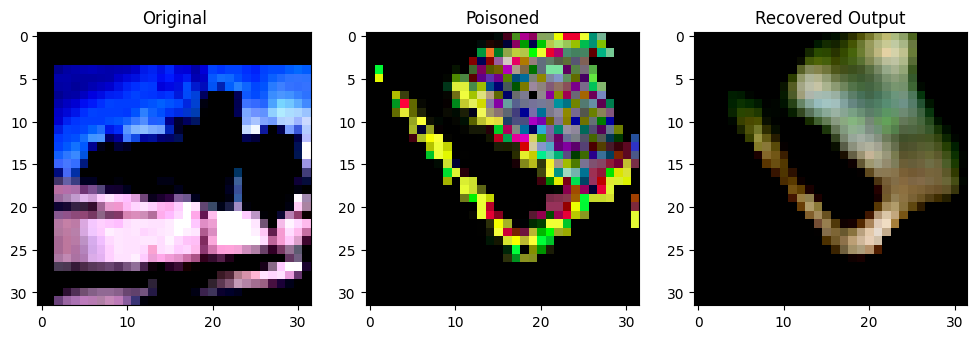

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.827364].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.959324].


Original Label: tensor(8)
Poisoned Label: tensor(8)


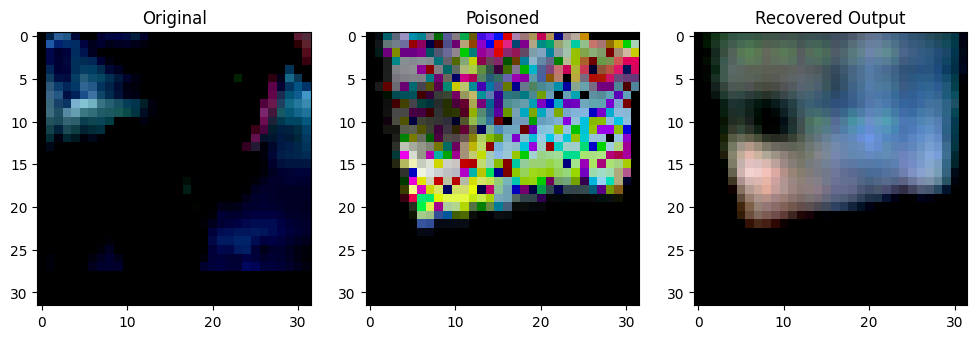

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7021568].


Original Label: tensor(6)
Poisoned Label: tensor(1)


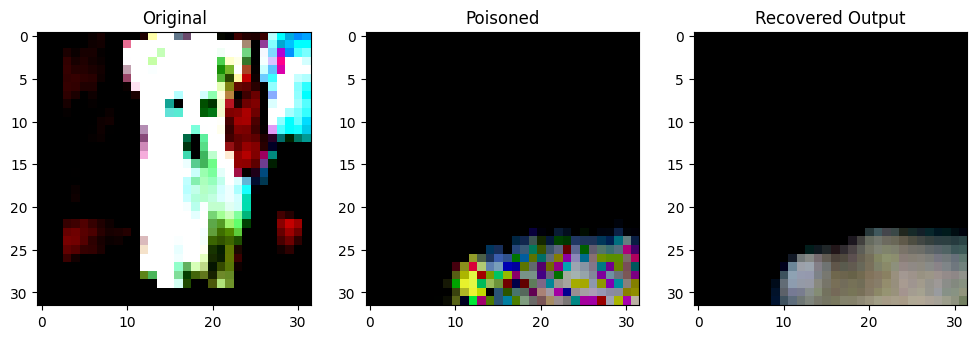

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95671356].


Original Label: tensor(5)
Poisoned Label: tensor(2)


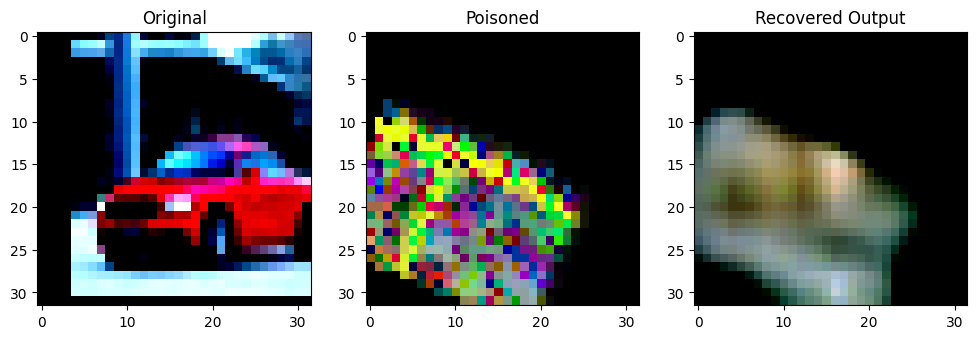

Original Label: tensor(1)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7071032].


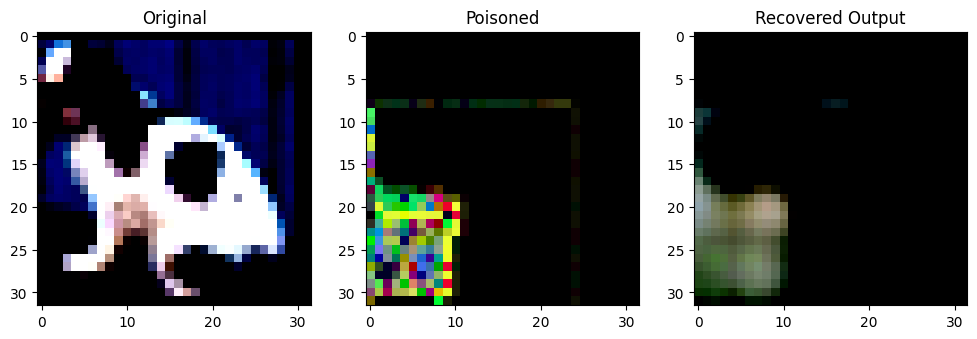

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0259104].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7368694].


Original Label: tensor(5)
Poisoned Label: tensor(1)


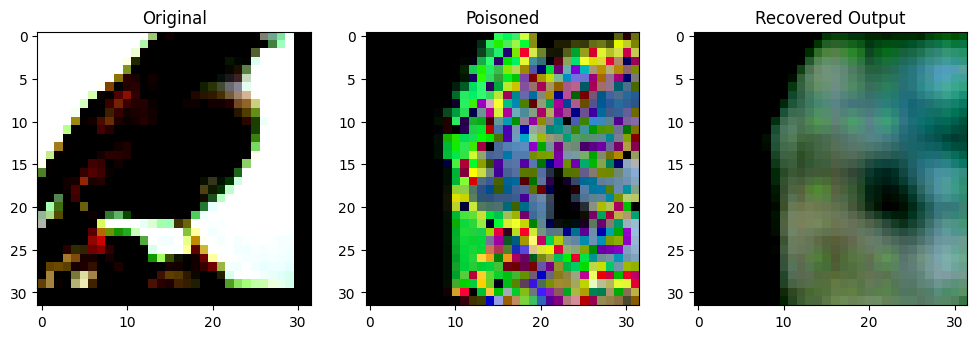

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6465361].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999976..0.9872518].


Original Label: tensor(2)
Poisoned Label: tensor(1)


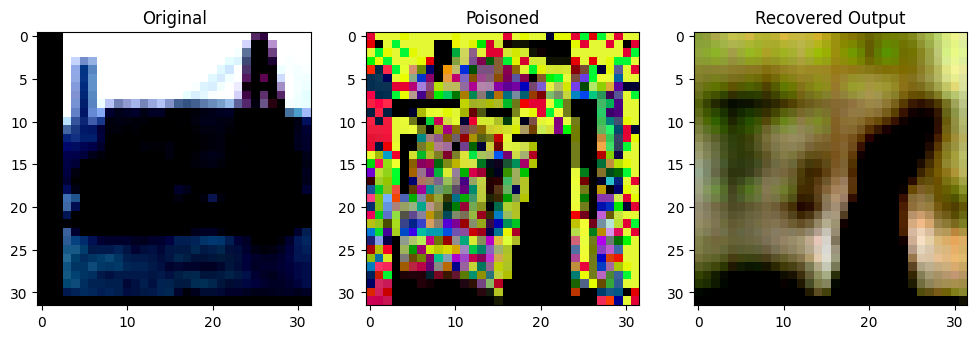

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.75641525].


Original Label: tensor(8)
Poisoned Label: tensor(1)


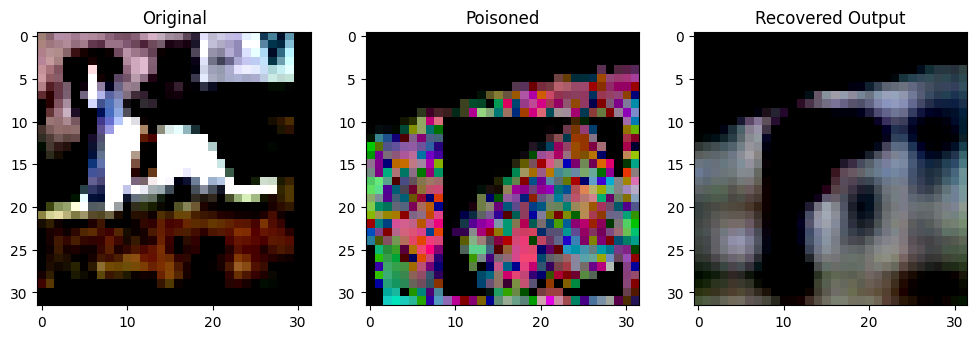

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99693495].


Original Label: tensor(5)
Poisoned Label: tensor(6)


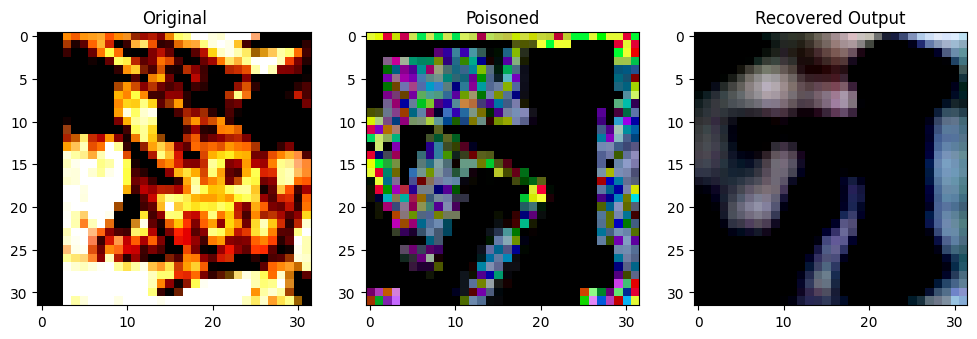

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9282458].


Original Label: tensor(6)
Poisoned Label: tensor(4)


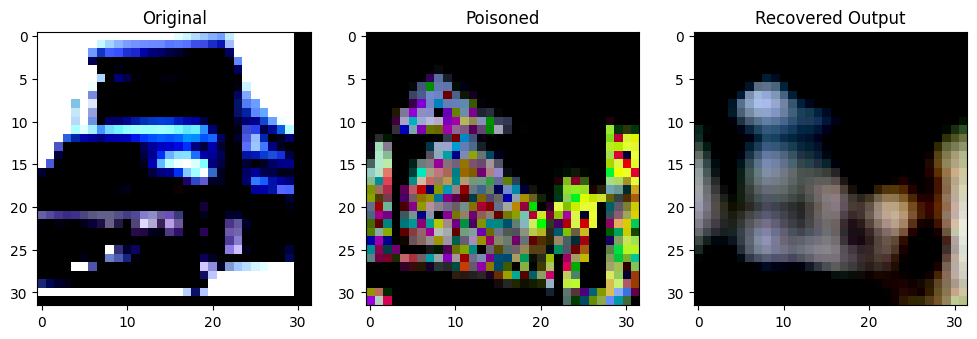

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7694151].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8892273..0.7036904].


Original Label: tensor(9)
Poisoned Label: tensor(9)


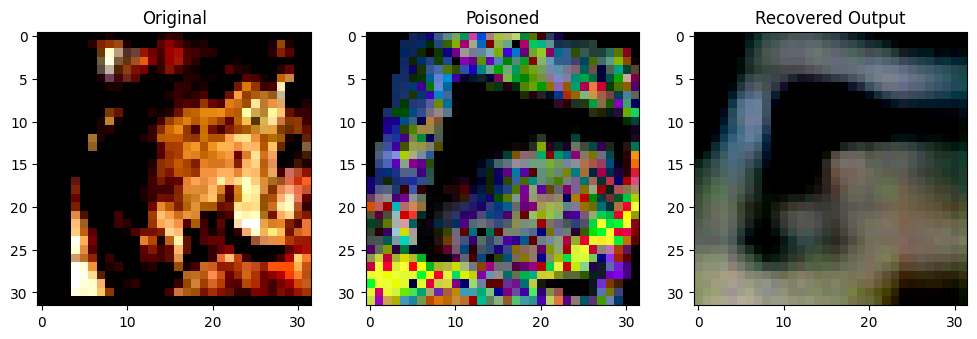

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99474084].


Original Label: tensor(6)
Poisoned Label: tensor(7)


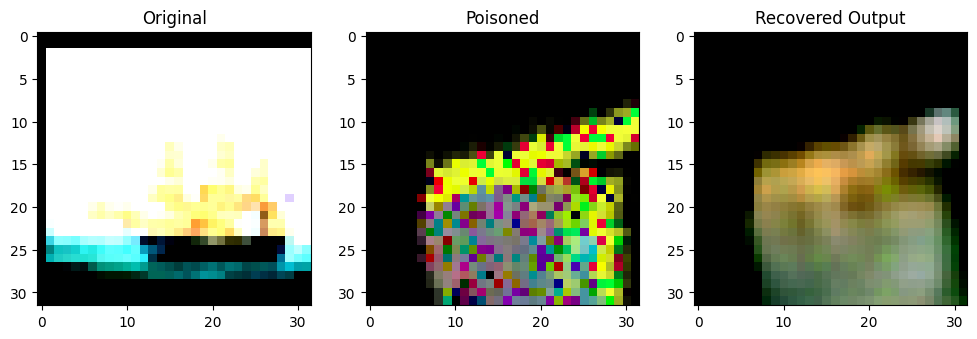

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99824345].


Original Label: tensor(8)
Poisoned Label: tensor(5)


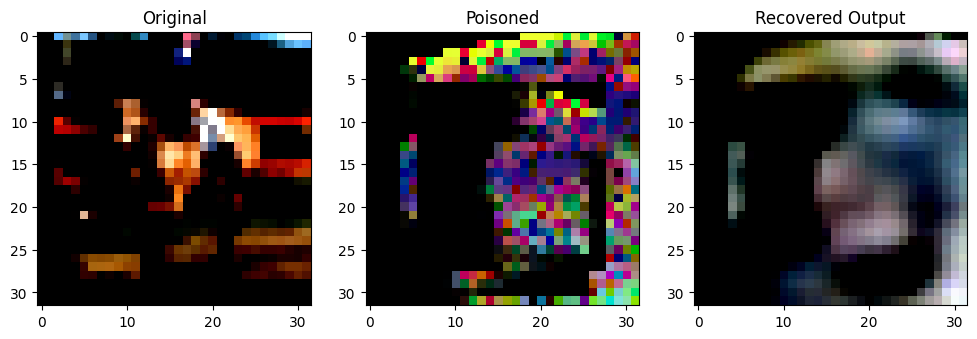

Original Label: tensor(7)
Poisoned Label: tensor(1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.63918144].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99420124].


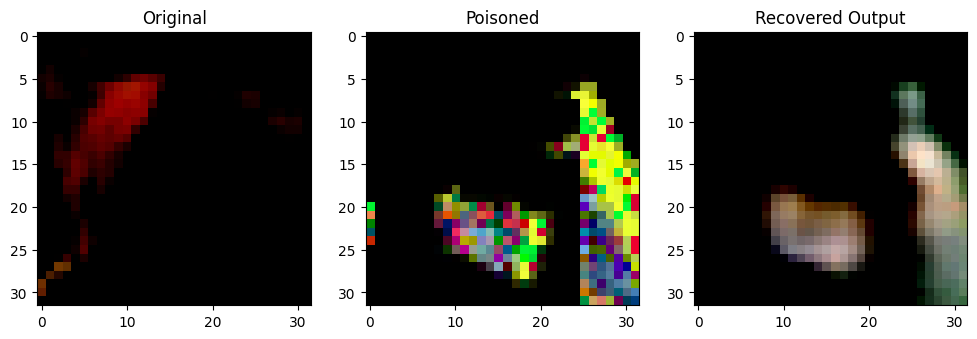

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2727973].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83024645].


Original Label: tensor(3)
Poisoned Label: tensor(9)


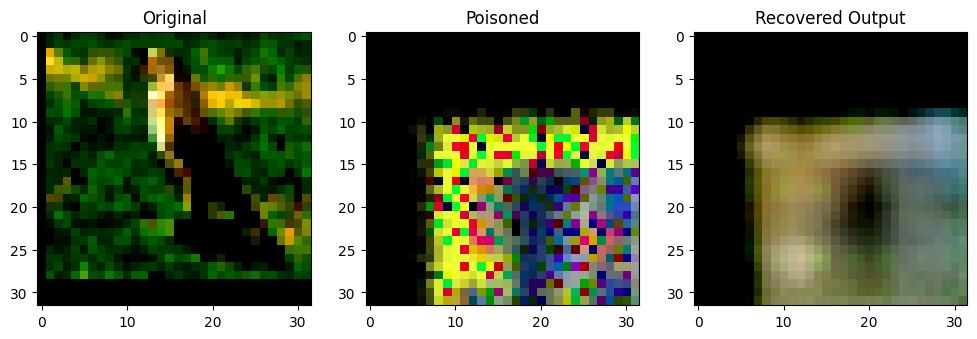

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9793671..0.7375668].


Original Label: tensor(2)
Poisoned Label: tensor(4)


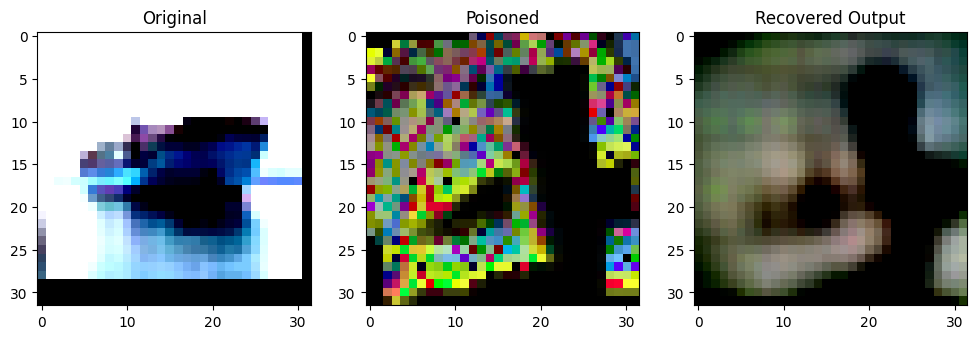

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9696413].


Original Label: tensor(8)
Poisoned Label: tensor(6)


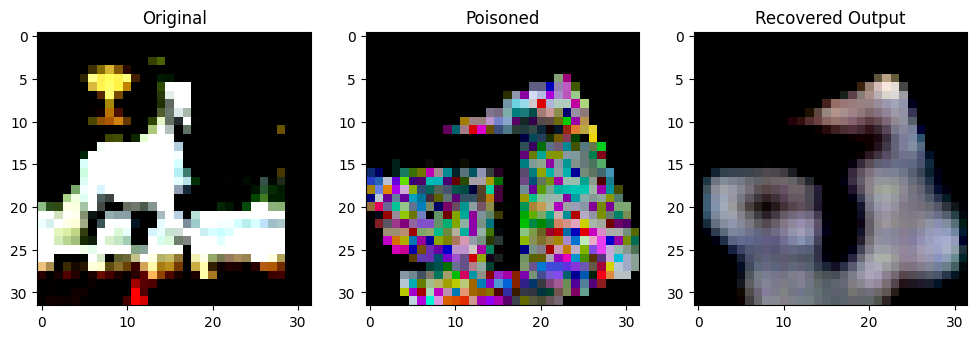

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9892832..0.95348483].


Original Label: tensor(7)
Poisoned Label: tensor(1)


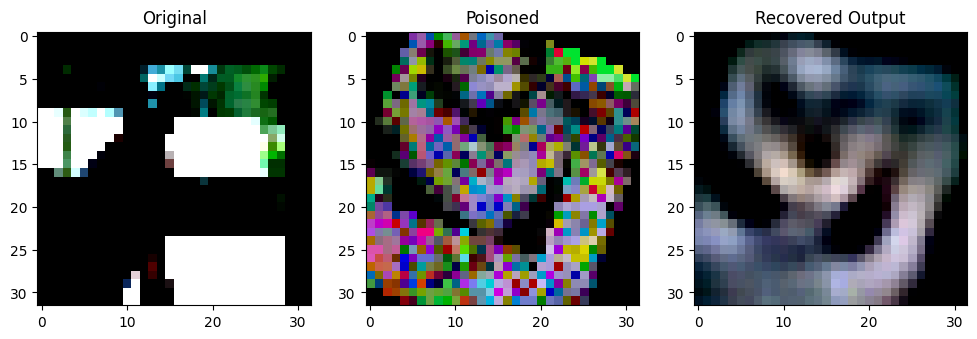

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8921618].


Original Label: tensor(7)
Poisoned Label: tensor(9)


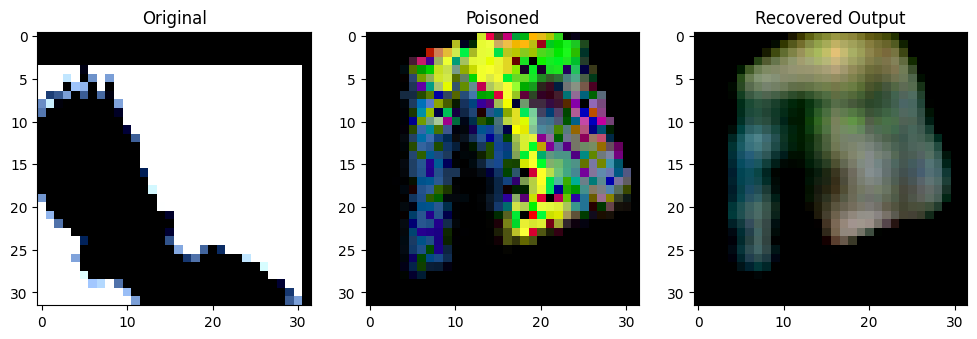

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.725843].


Original Label: tensor(2)
Poisoned Label: tensor(5)


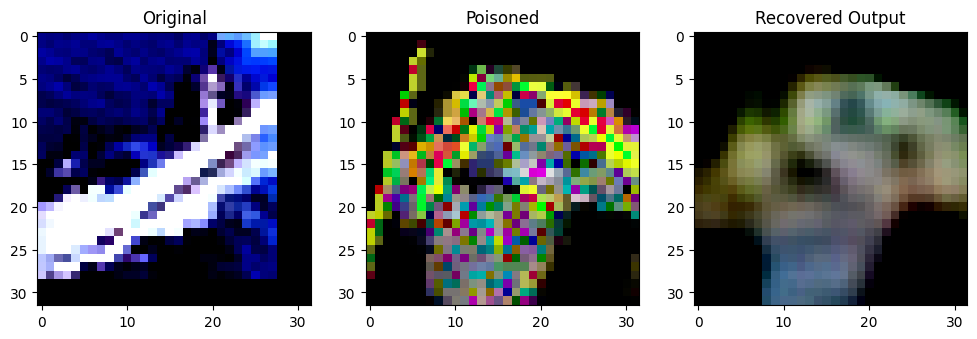

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.65253705].


Original Label: tensor(8)
Poisoned Label: tensor(2)


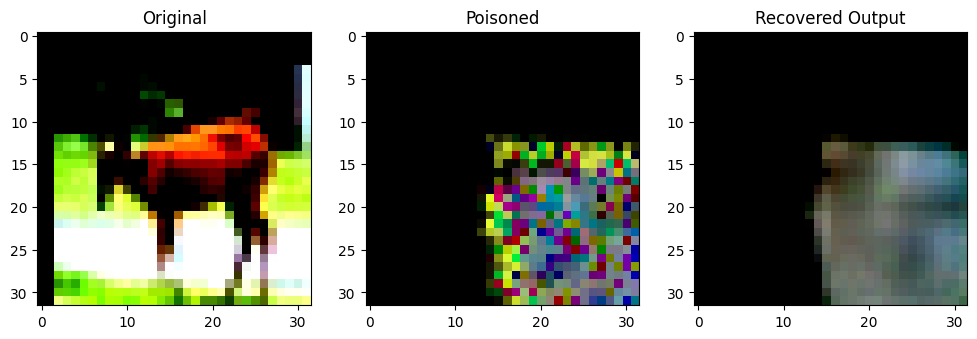

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96573985].


Original Label: tensor(4)
Poisoned Label: tensor(2)


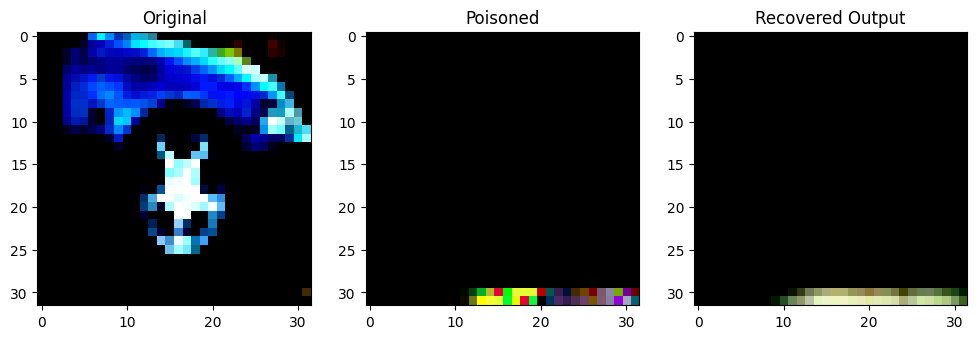

Original Label: tensor(1)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73951113].


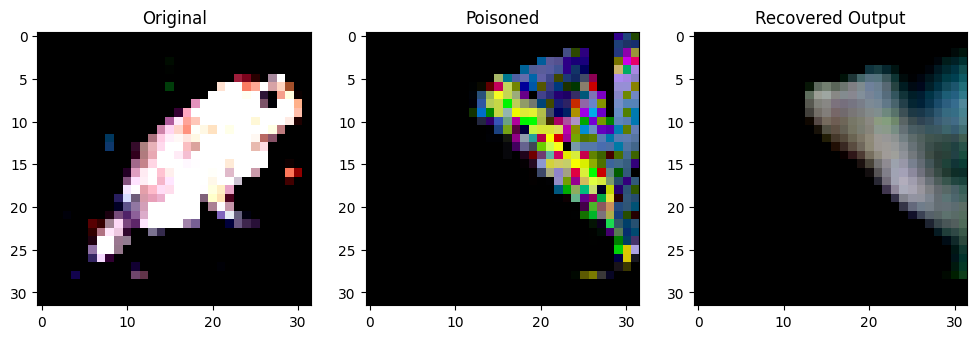

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6286255].


Original Label: tensor(6)
Poisoned Label: tensor(1)


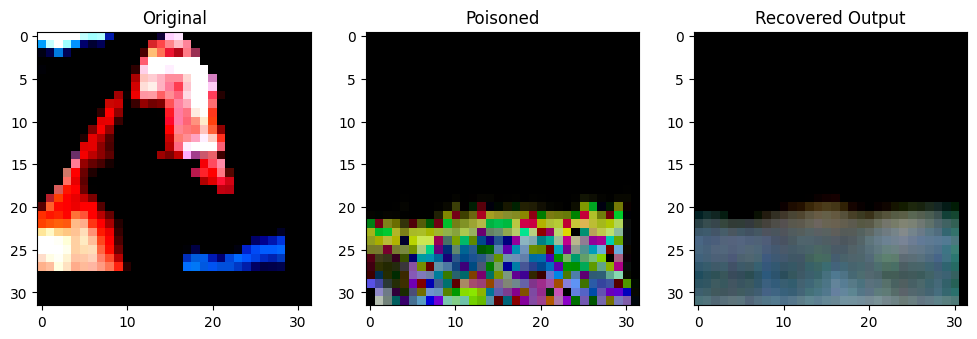

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7283908..0.7911662].


Original Label: tensor(7)
Poisoned Label: tensor(0)


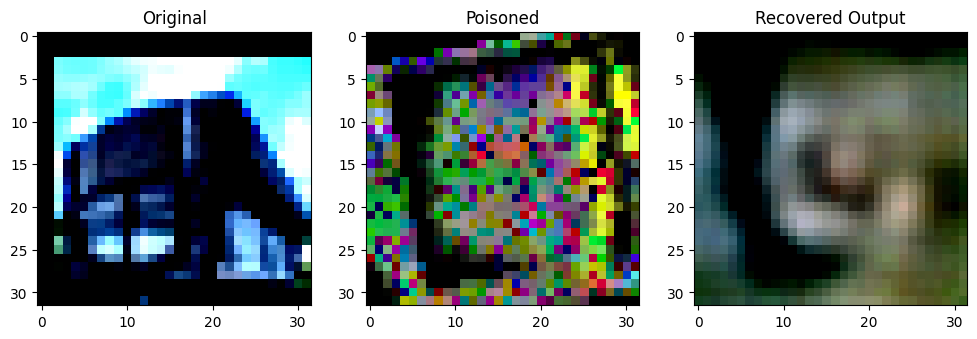

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999985..0.99970883].


Original Label: tensor(9)
Poisoned Label: tensor(5)


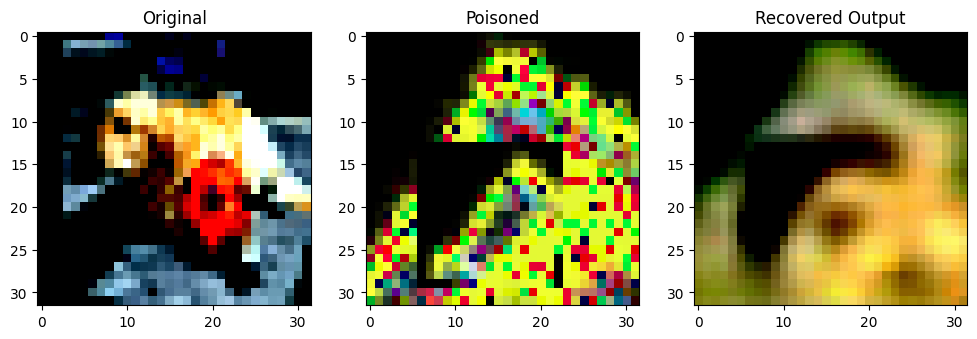

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7180408].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69340247].


Original Label: tensor(5)
Poisoned Label: tensor(5)


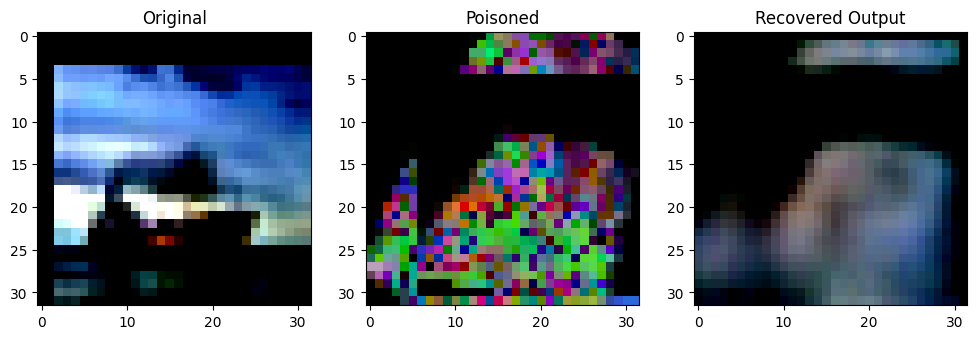

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9602616].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.909296].


Original Label: tensor(8)
Poisoned Label: tensor(3)


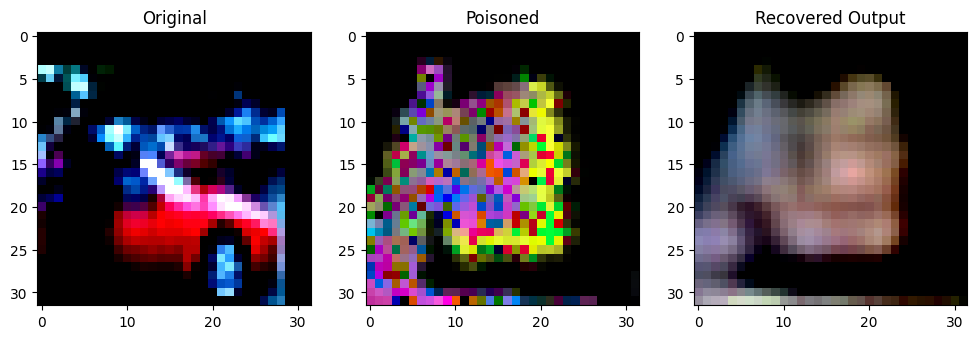

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8036647].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6635319].


Original Label: tensor(1)
Poisoned Label: tensor(3)


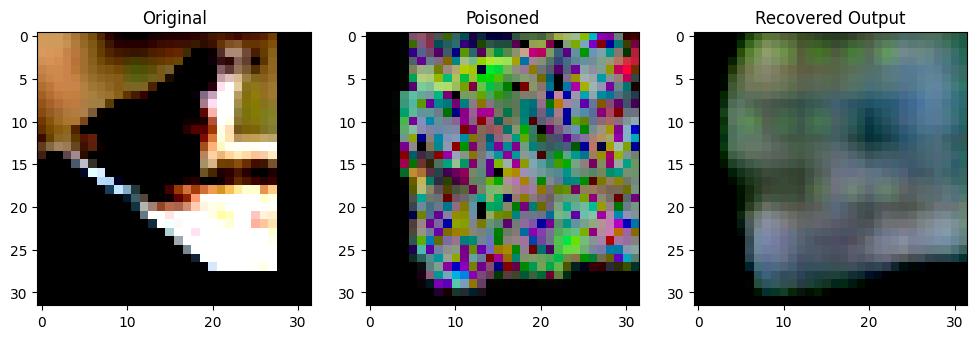

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4097953].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9998734..0.788808].


Original Label: tensor(2)
Poisoned Label: tensor(3)


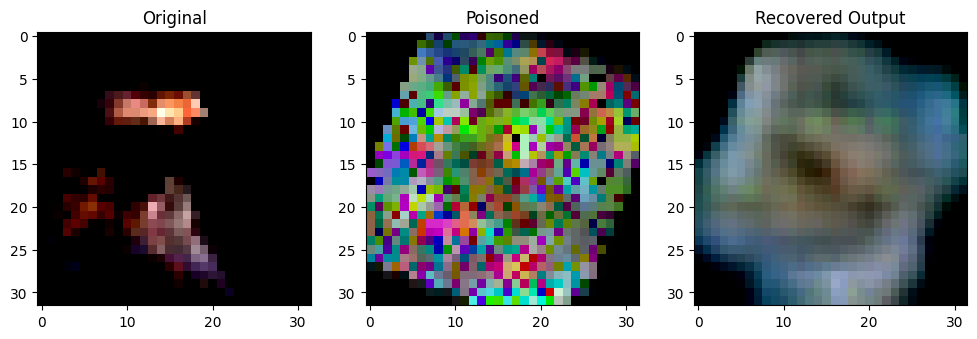

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90610164].


Original Label: tensor(2)
Poisoned Label: tensor(9)


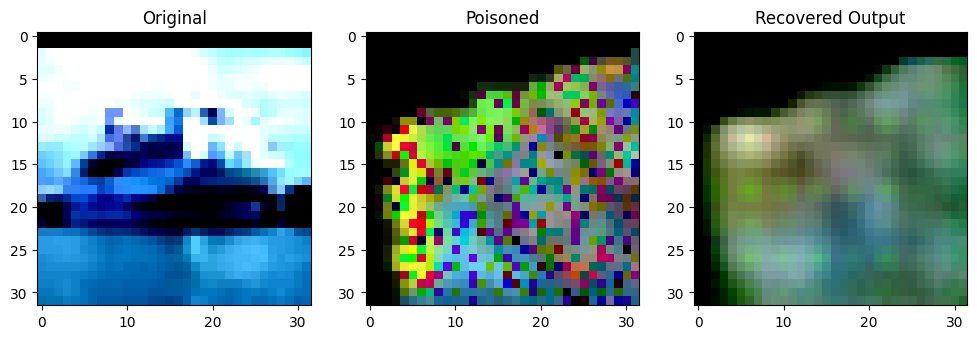

Original Label: tensor(8)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8508403].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93180156].


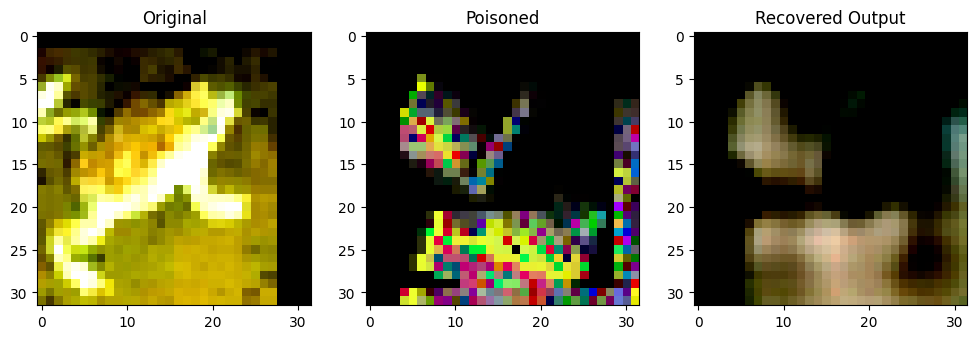

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6639653].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97045976].


Original Label: tensor(6)
Poisoned Label: tensor(9)


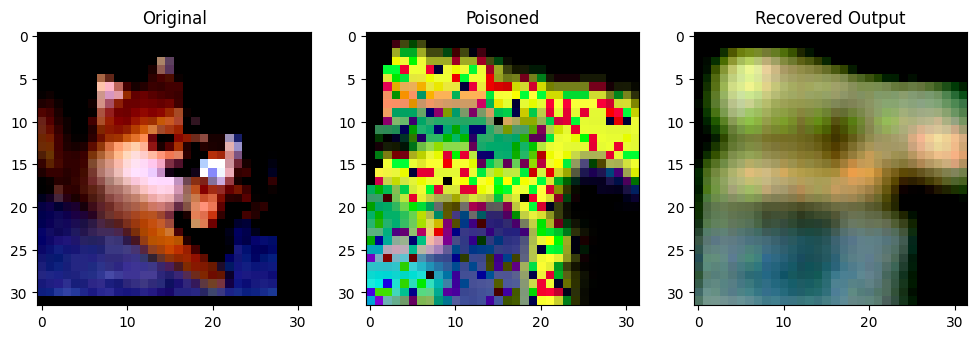

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9558823].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74300194].


Original Label: tensor(5)
Poisoned Label: tensor(6)


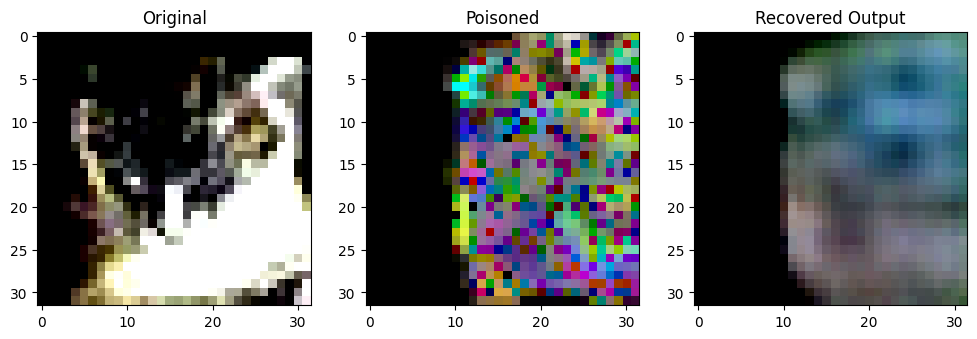

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7162529].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9650496].


Original Label: tensor(3)
Poisoned Label: tensor(1)


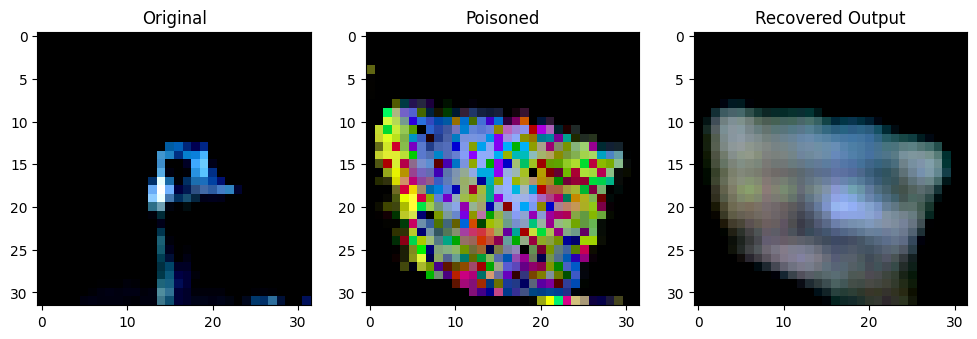

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74675006].


Original Label: tensor(2)
Poisoned Label: tensor(7)


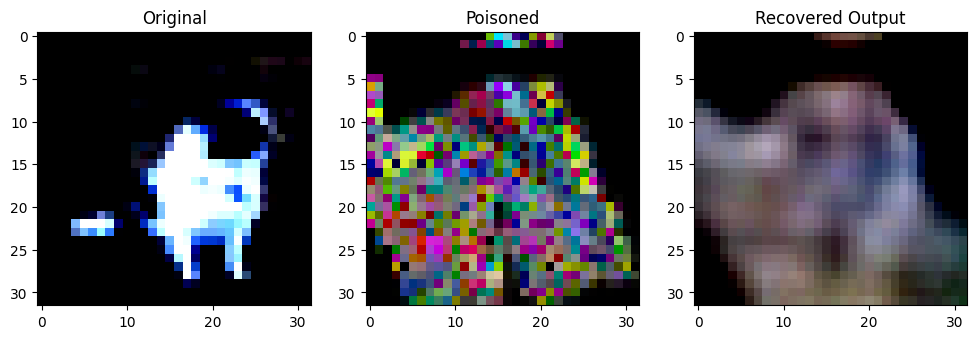

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2009804].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(5)
Poisoned Label: tensor(5)


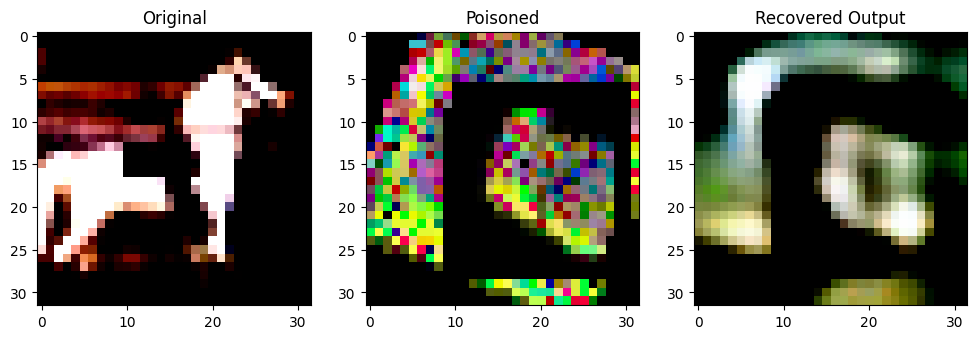

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9859322].


Original Label: tensor(7)
Poisoned Label: tensor(8)


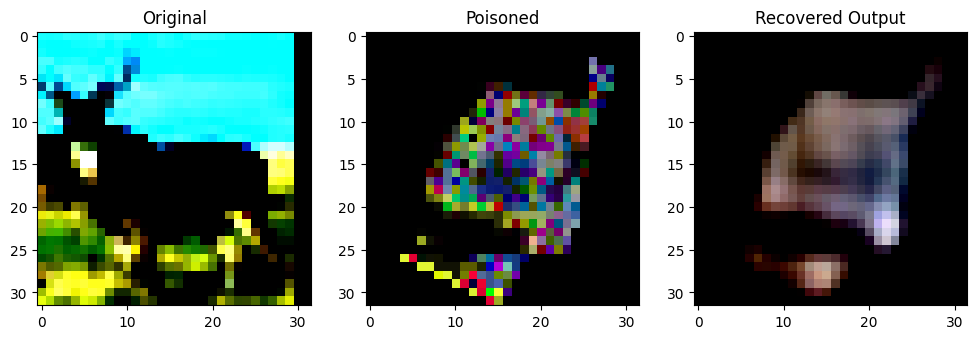

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1975338].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.67657506].


Original Label: tensor(4)
Poisoned Label: tensor(4)


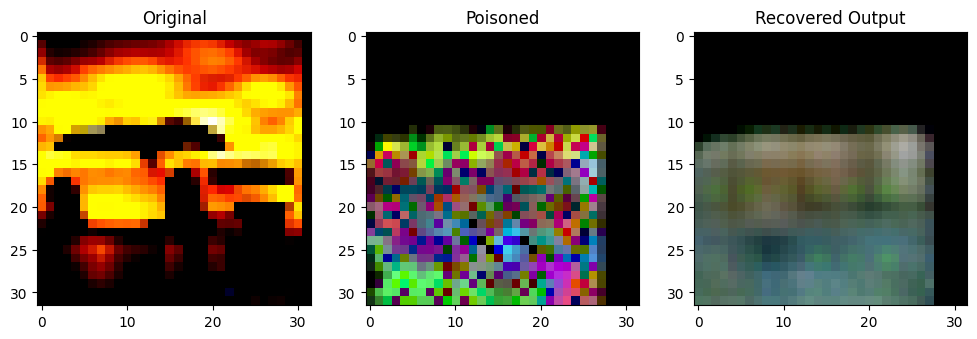

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9383754].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8509464].


Original Label: tensor(1)
Poisoned Label: tensor(6)


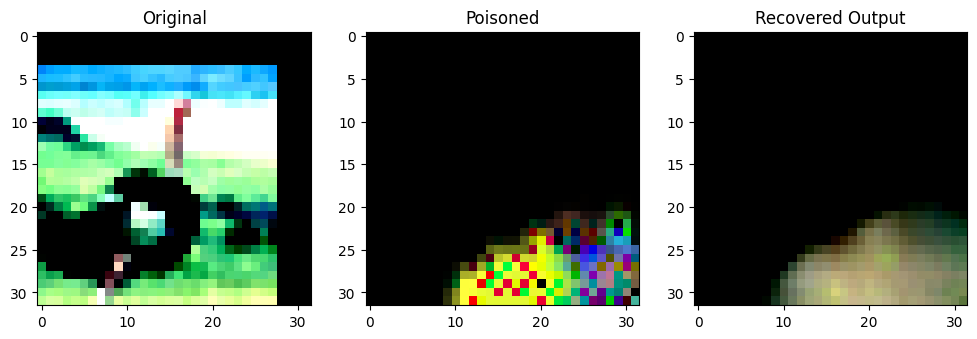

Original Label: tensor(2)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9449738].


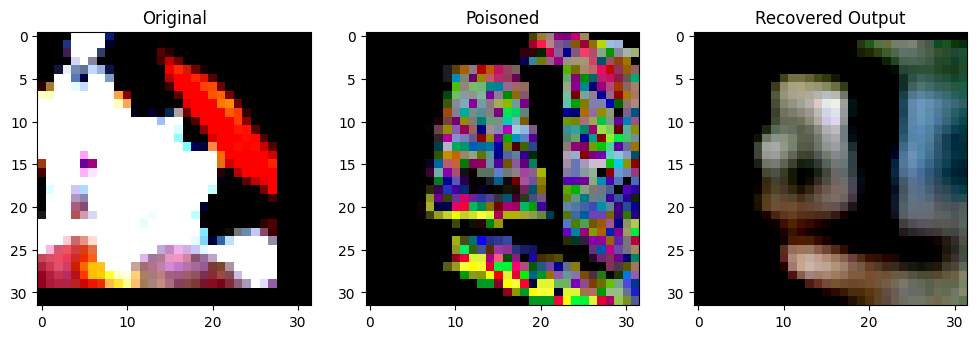

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999934..0.58991635].


Original Label: tensor(5)
Poisoned Label: tensor(0)


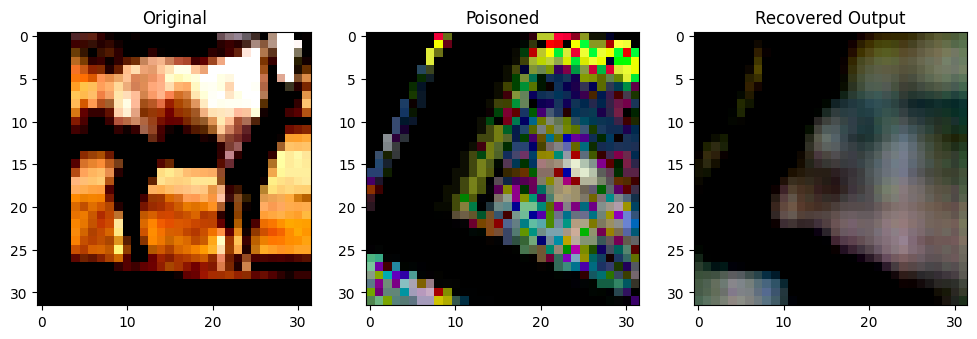

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99954855].


Original Label: tensor(7)
Poisoned Label: tensor(2)


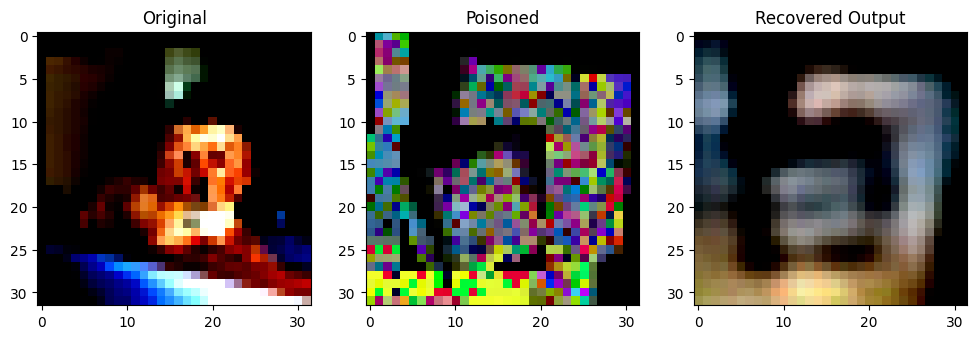

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3410363].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7256125].


Original Label: tensor(5)
Poisoned Label: tensor(5)


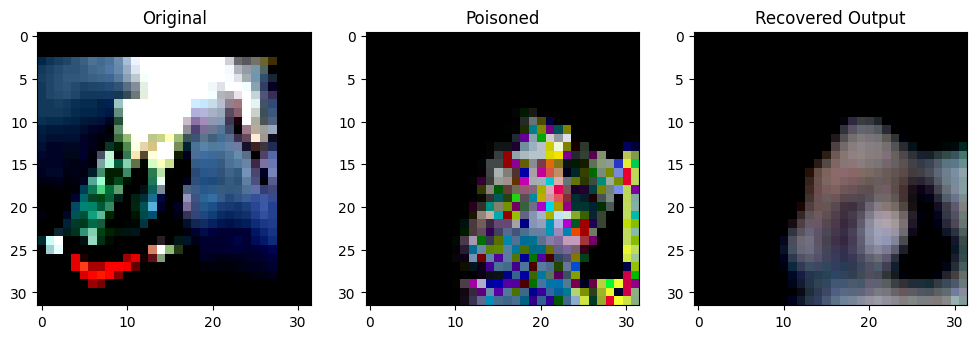

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7849789].


Original Label: tensor(8)
Poisoned Label: tensor(6)


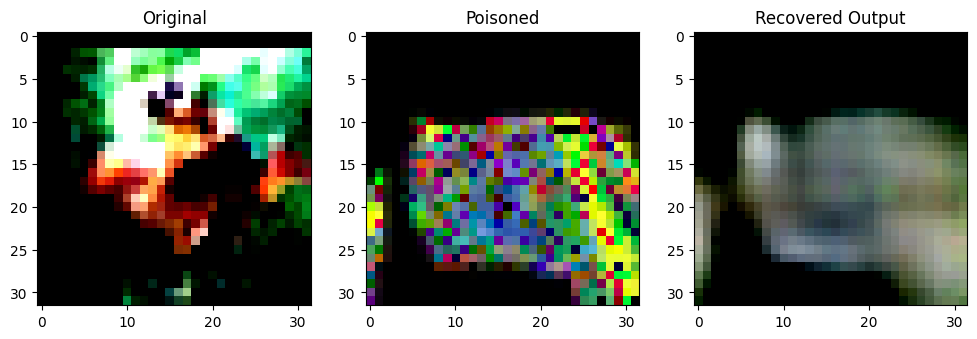

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7685405].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.722445].


Original Label: tensor(4)
Poisoned Label: tensor(9)


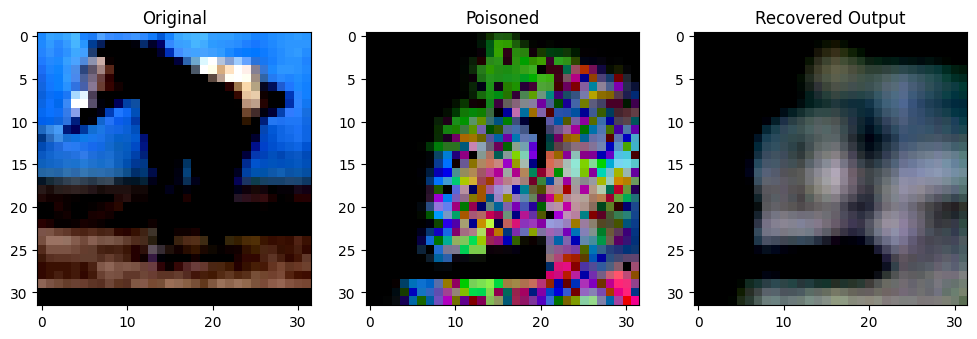

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90868986].


Original Label: tensor(7)
Poisoned Label: tensor(3)


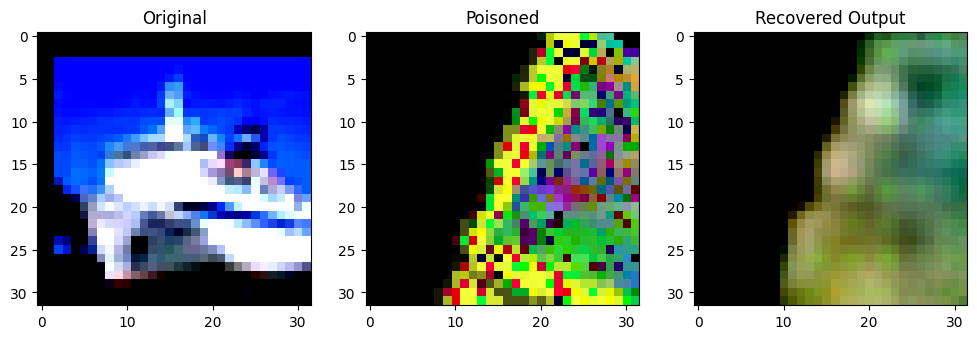

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8475766..0.720297].


Original Label: tensor(8)
Poisoned Label: tensor(2)


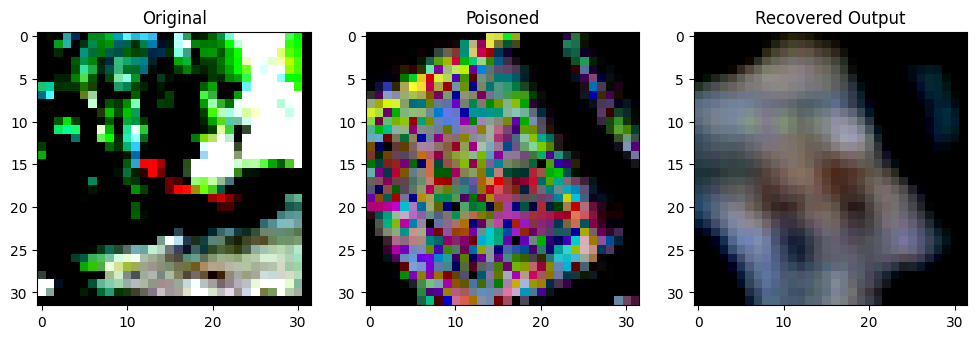

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2184873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9641947].


Original Label: tensor(2)
Poisoned Label: tensor(9)


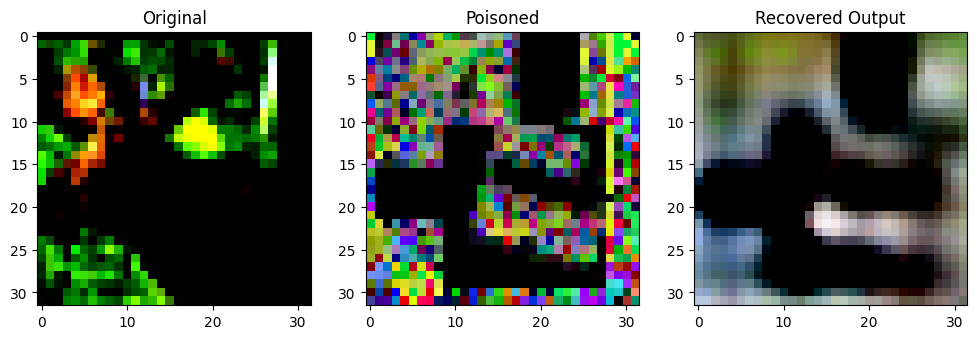

Original Label: tensor(4)
Poisoned Label: tensor(0)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.129035].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99362284].


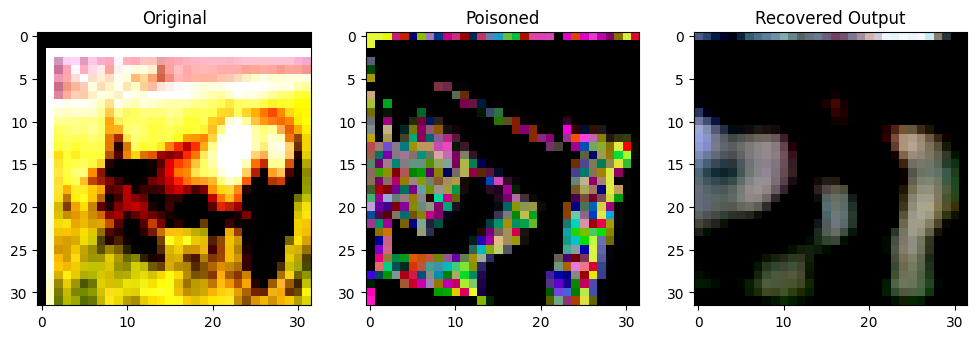

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70773315].


Original Label: tensor(4)
Poisoned Label: tensor(2)


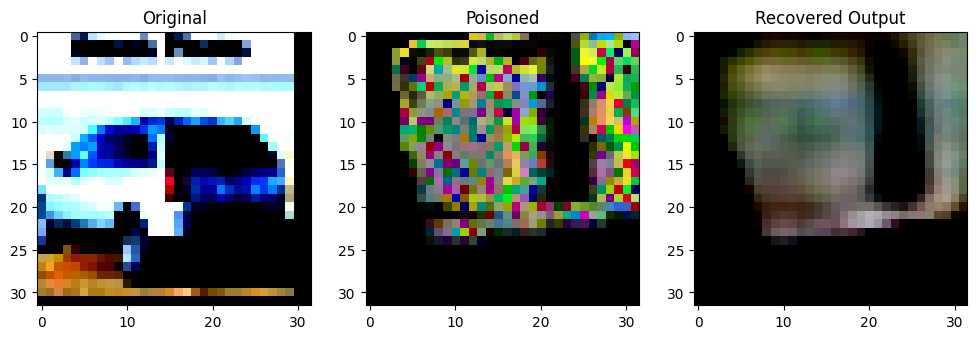

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1461596].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9393526].


Original Label: tensor(1)
Poisoned Label: tensor(5)


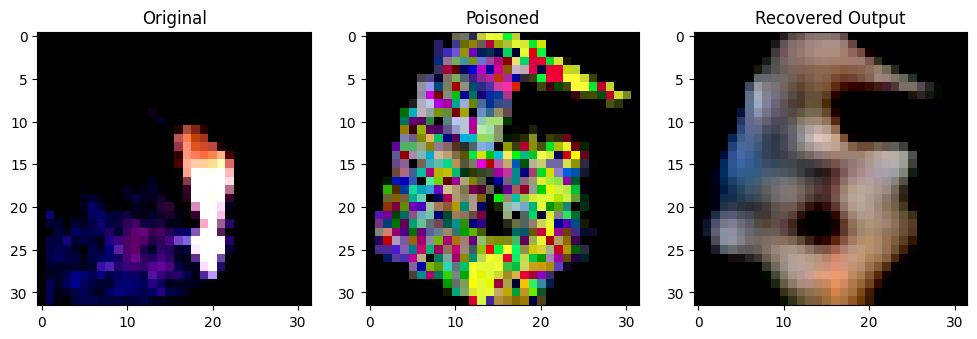

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8876376].


Original Label: tensor(4)
Poisoned Label: tensor(9)


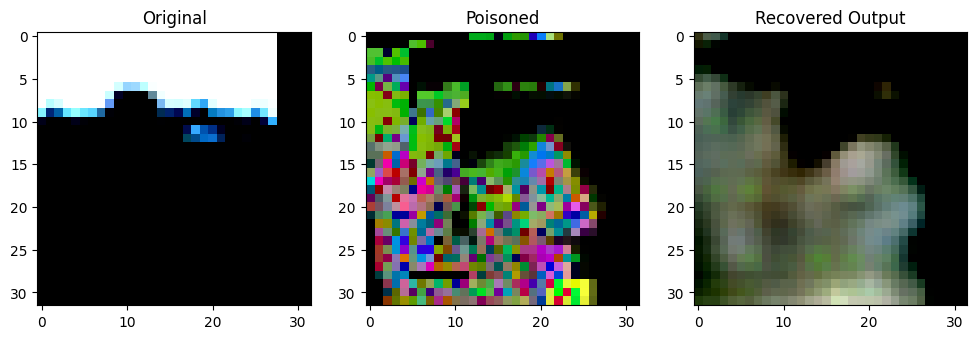

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999977..0.99522567].


Original Label: tensor(2)
Poisoned Label: tensor(4)


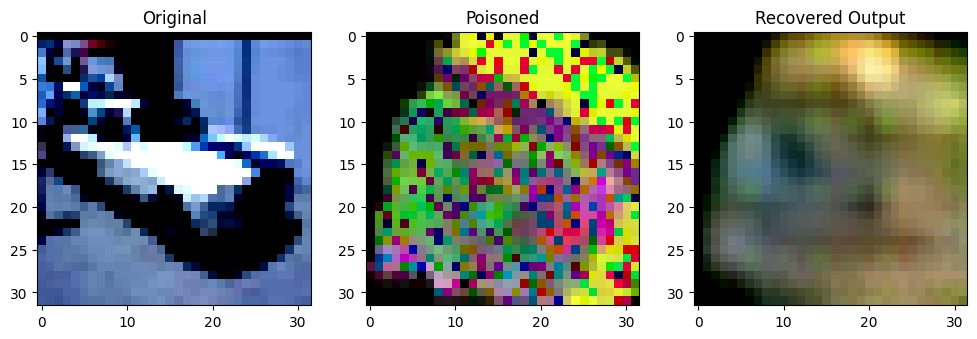

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9208683].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9994075].


Original Label: tensor(1)
Poisoned Label: tensor(0)


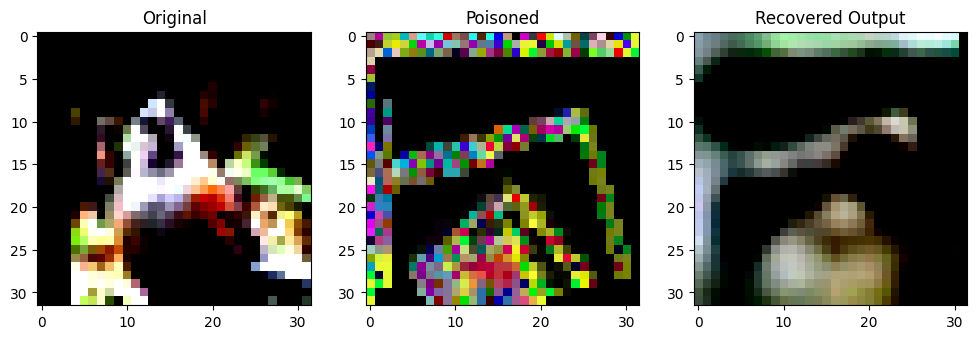

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9094082].


Original Label: tensor(2)
Poisoned Label: tensor(8)


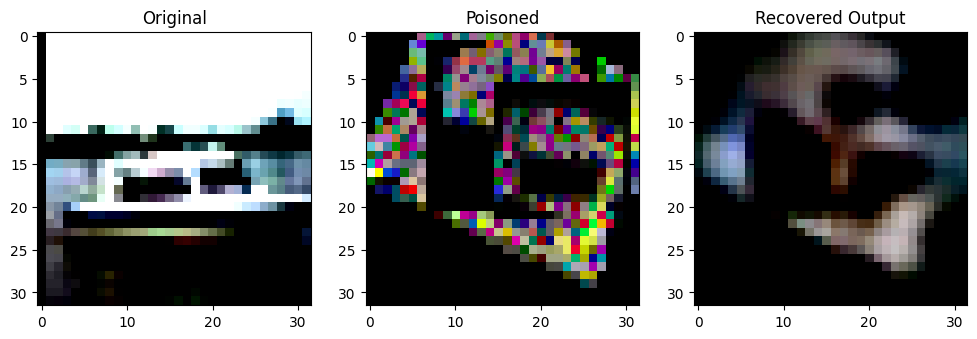

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9058616].


Original Label: tensor(8)
Poisoned Label: tensor(6)


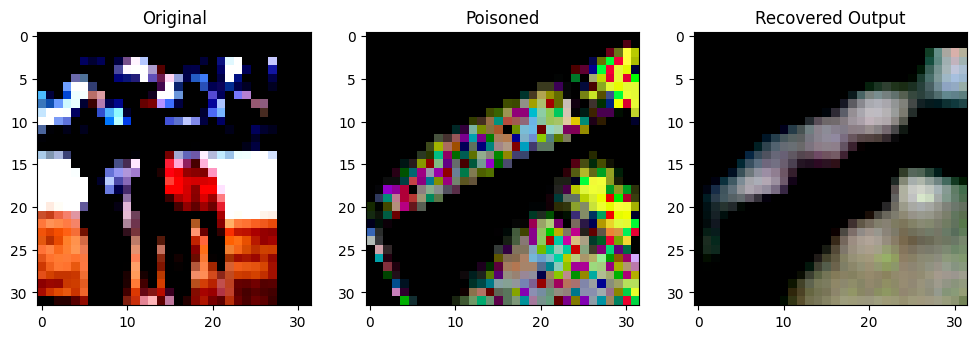

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.78277165].


Original Label: tensor(7)
Poisoned Label: tensor(6)


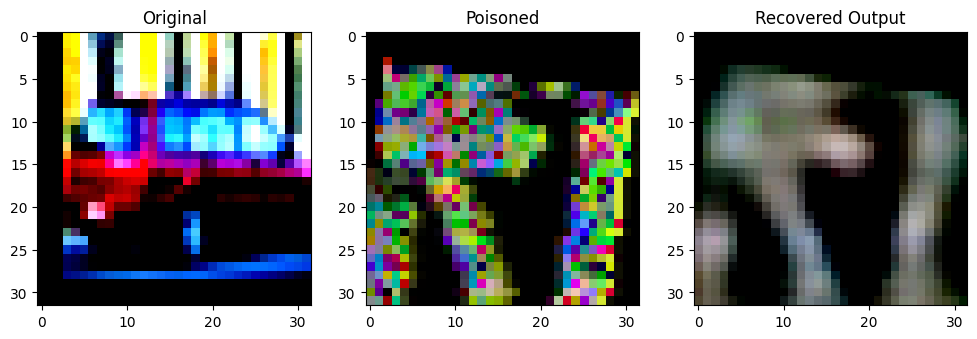

Original Label: tensor(1)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5942485].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999271..0.83929086].


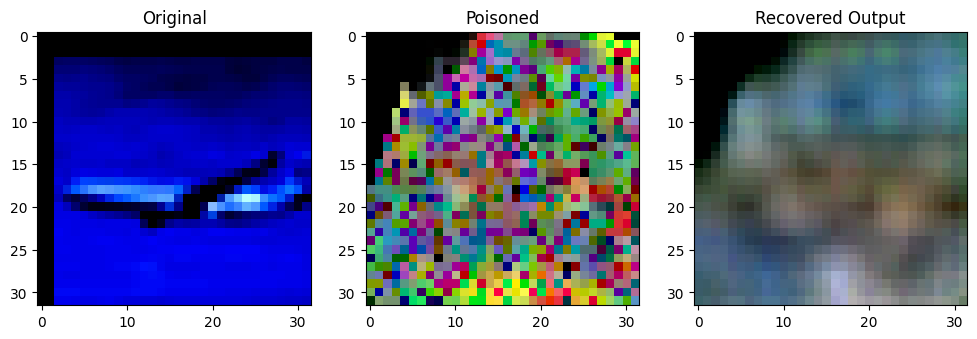

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9811752].


Original Label: tensor(0)
Poisoned Label: tensor(9)


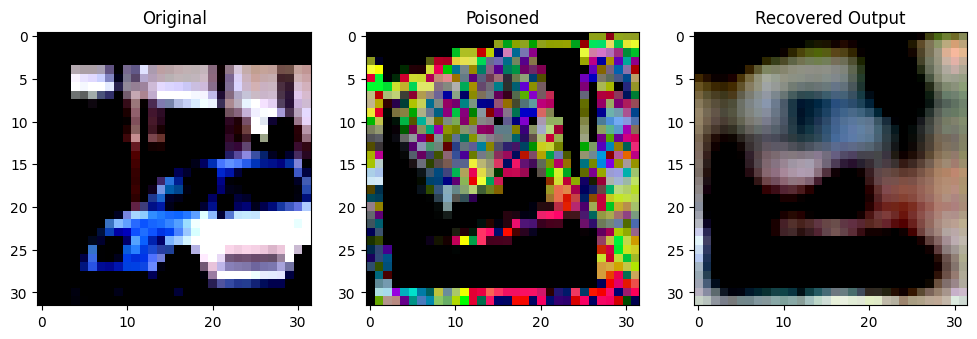

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.060536].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9115114].


Original Label: tensor(1)
Poisoned Label: tensor(4)


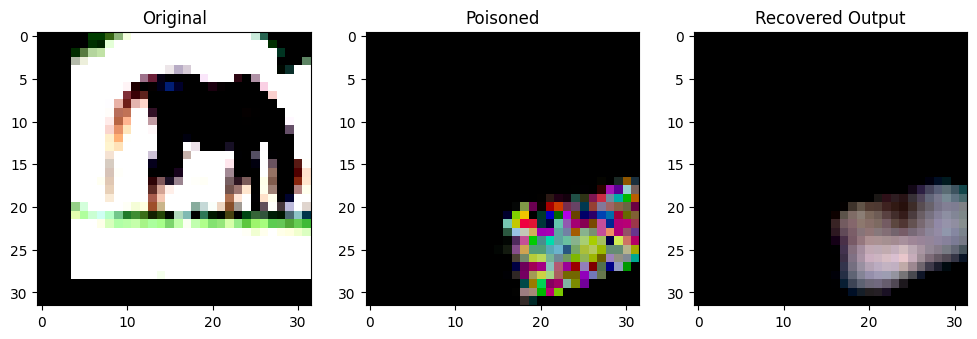

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5831603].


Original Label: tensor(7)
Poisoned Label: tensor(5)


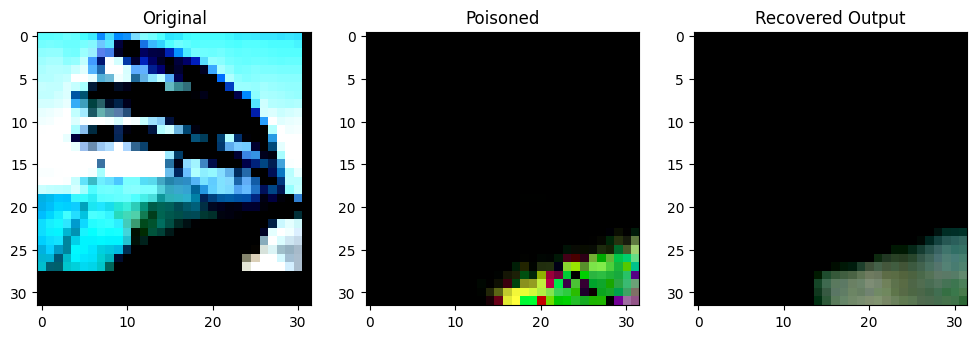

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7026974].


Original Label: tensor(8)
Poisoned Label: tensor(7)


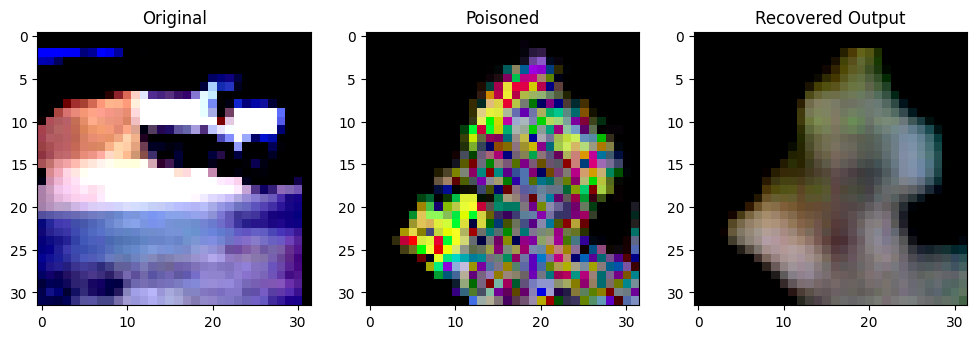

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7194495].


Original Label: tensor(9)
Poisoned Label: tensor(9)


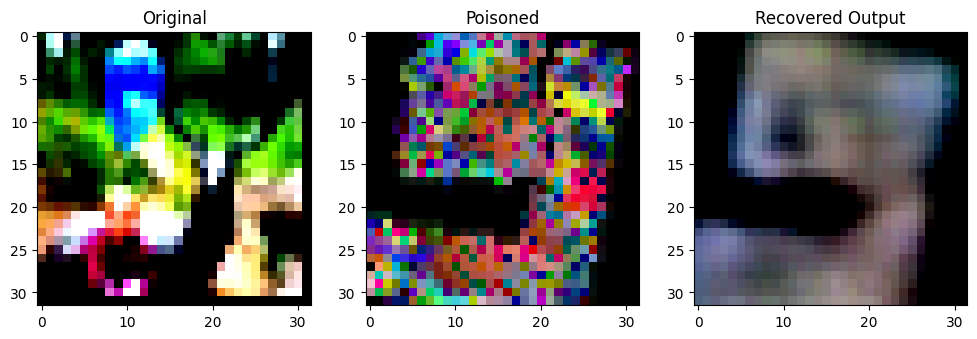

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9972571].


Original Label: tensor(4)
Poisoned Label: tensor(2)


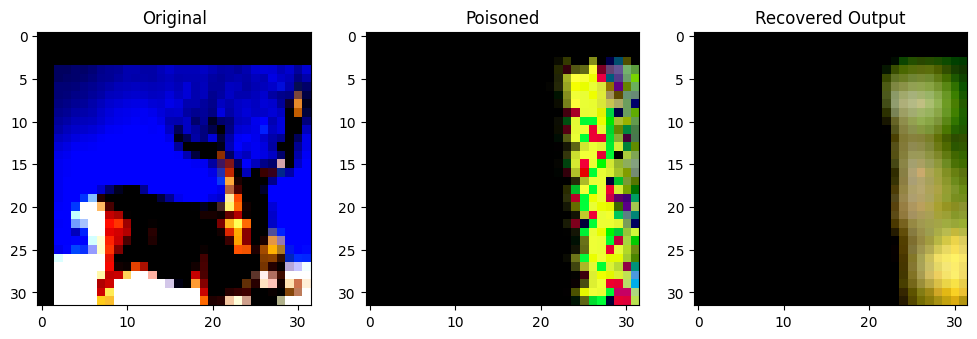

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8623422].


Original Label: tensor(4)
Poisoned Label: tensor(1)


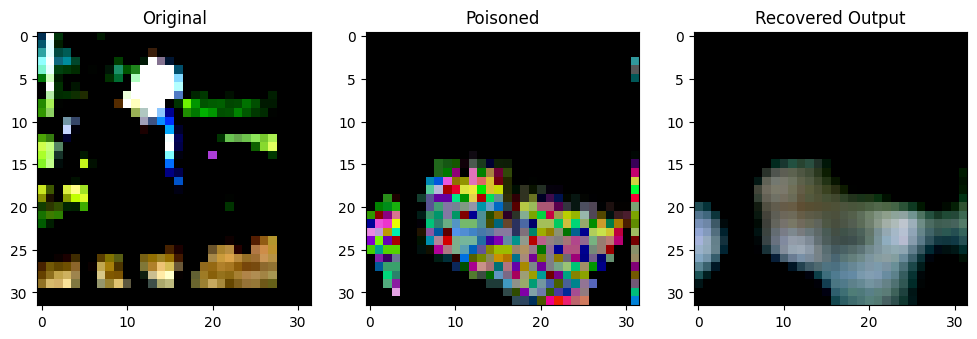

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.888962].


Original Label: tensor(7)
Poisoned Label: tensor(3)


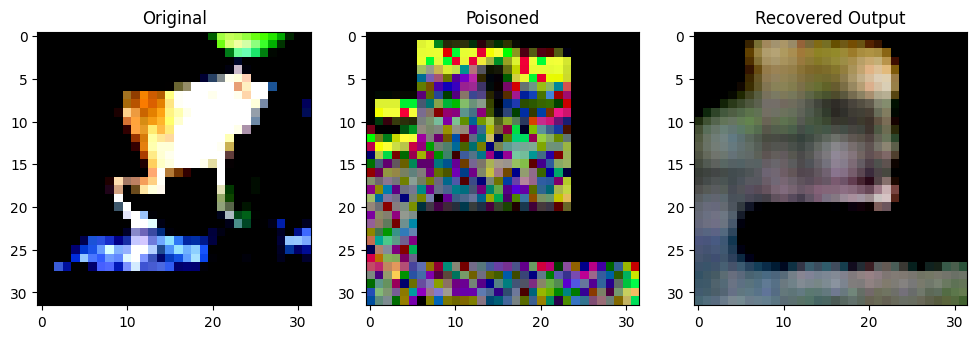

Original Label: tensor(6)
Poisoned Label: tensor(0)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96573985].


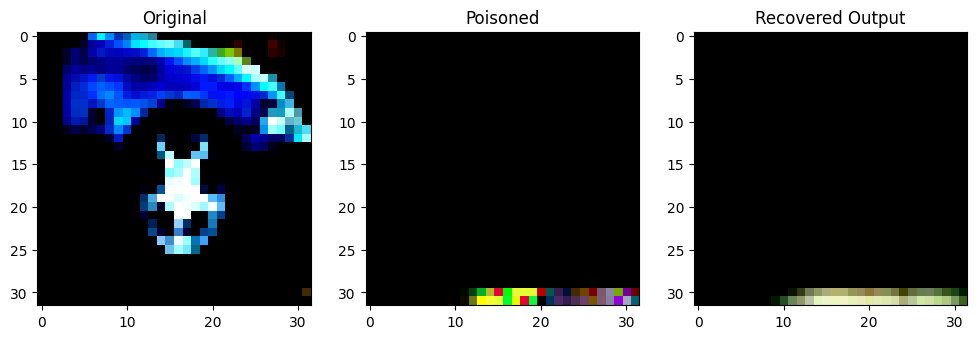

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7351656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80489725].


Original Label: tensor(1)
Poisoned Label: tensor(3)


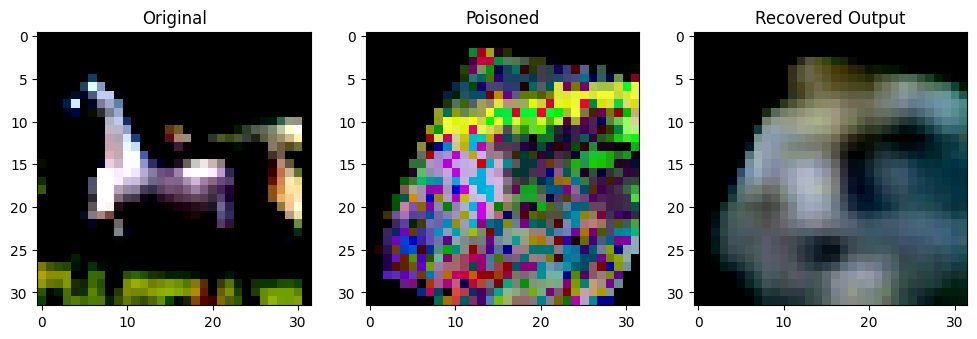

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9808893].


Original Label: tensor(7)
Poisoned Label: tensor(3)


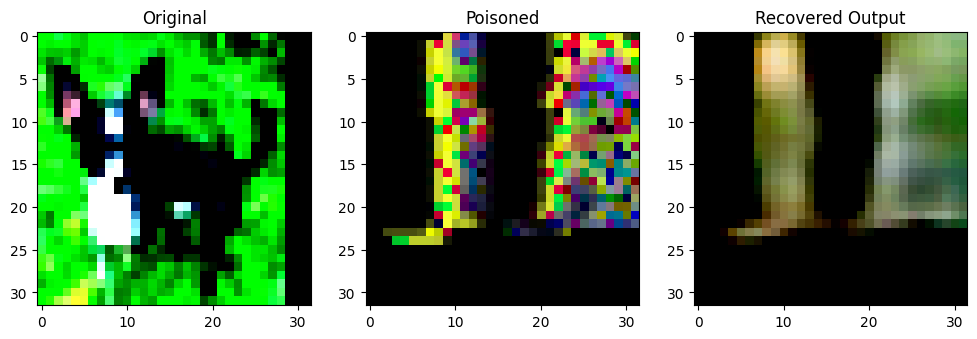

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.1700488].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99027944].


Original Label: tensor(5)
Poisoned Label: tensor(4)


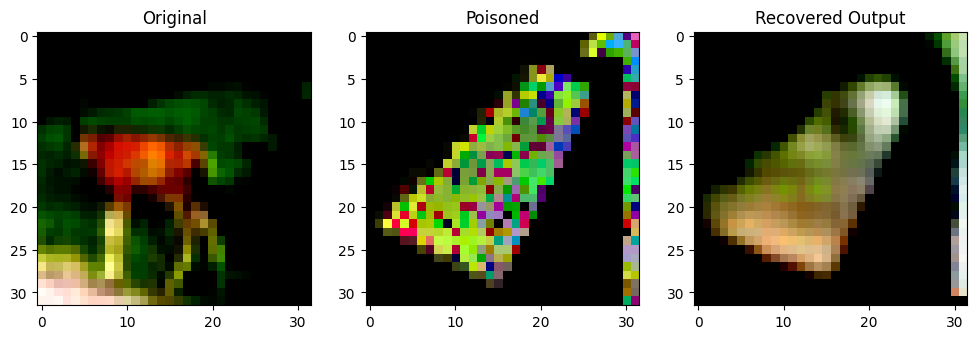

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96451646].


Original Label: tensor(4)
Poisoned Label: tensor(8)


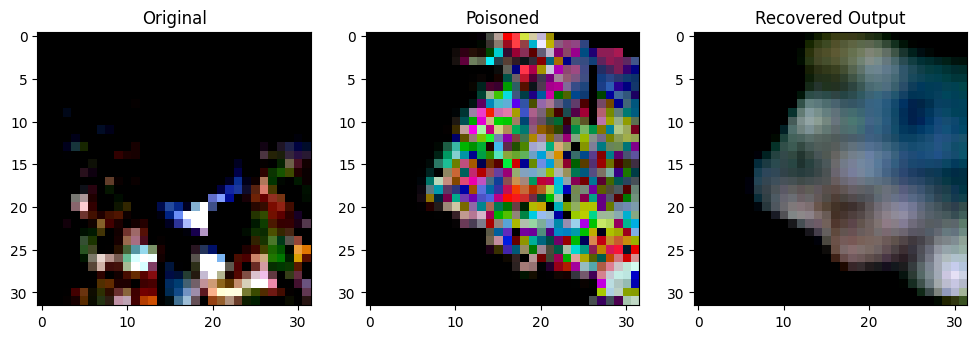

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999983..0.892737].


Original Label: tensor(3)
Poisoned Label: tensor(9)


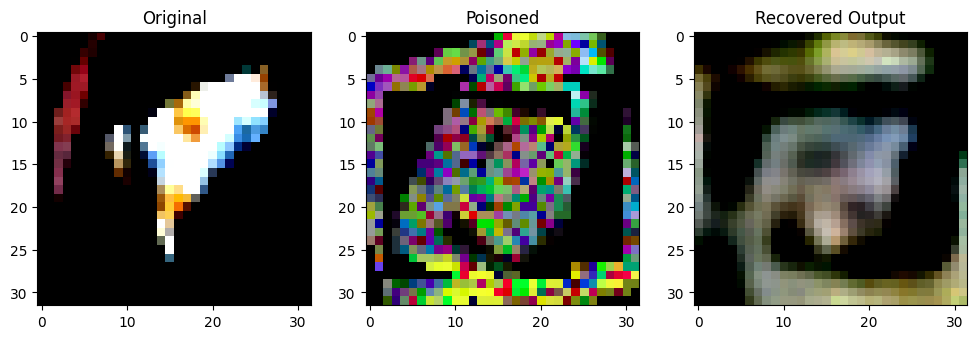

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8132595].


Original Label: tensor(3)
Poisoned Label: tensor(0)


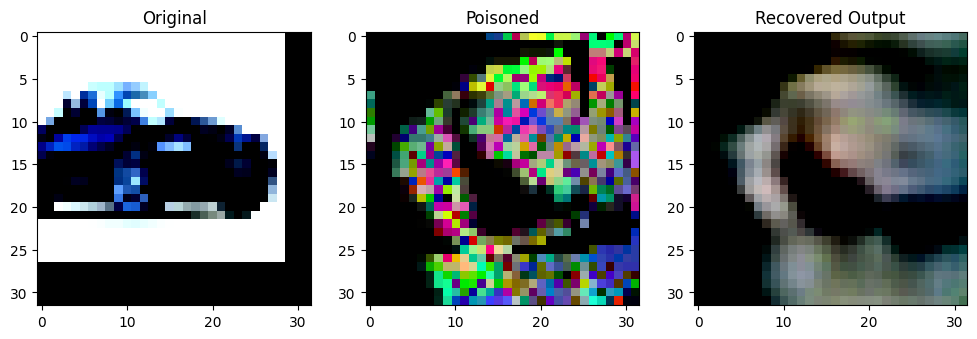

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0947855].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8204347].


Original Label: tensor(1)
Poisoned Label: tensor(4)


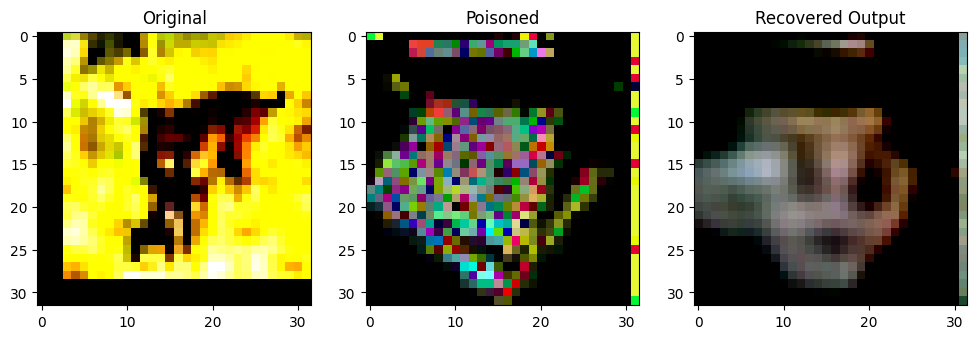

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3410363].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9993485].


Original Label: tensor(4)
Poisoned Label: tensor(3)


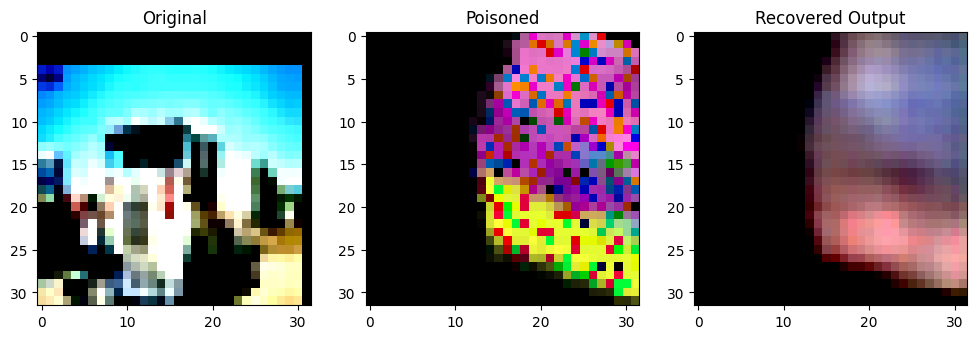

Original Label: tensor(9)
Poisoned Label: tensor(6)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88752365].


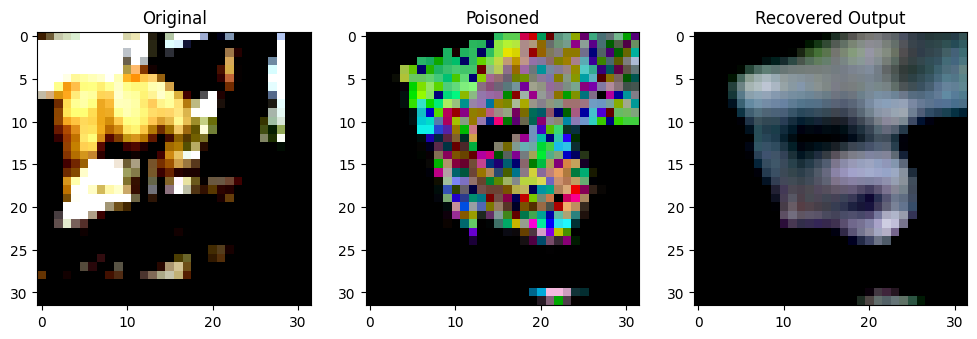

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.94238496..0.9831827].


Original Label: tensor(7)
Poisoned Label: tensor(2)


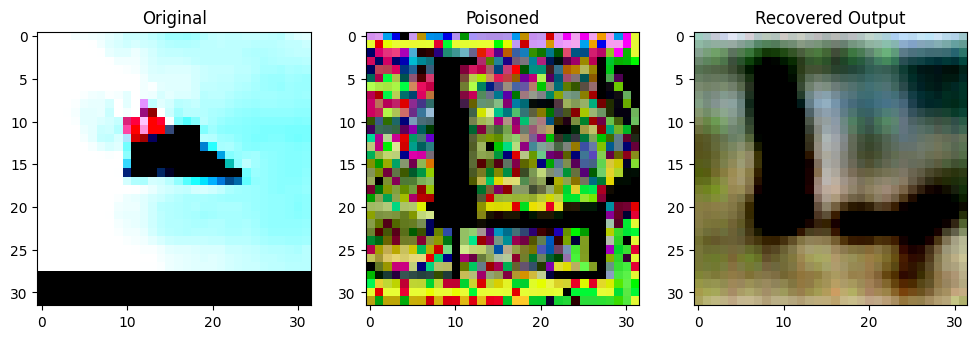

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6988237].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6855907].


Original Label: tensor(0)
Poisoned Label: tensor(0)


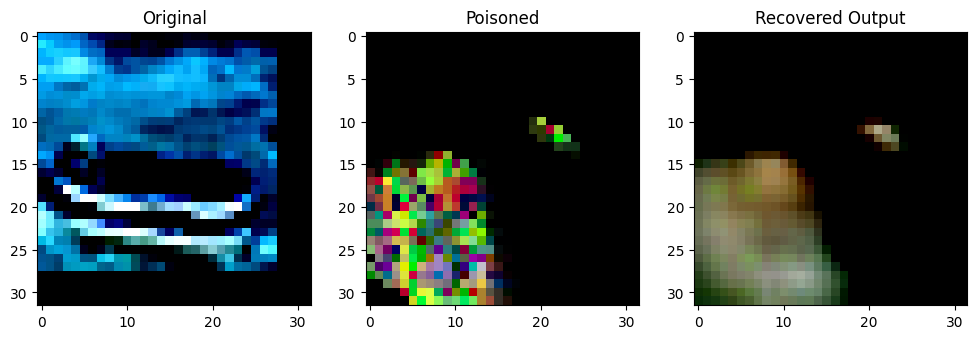

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95585656].


Original Label: tensor(8)
Poisoned Label: tensor(3)


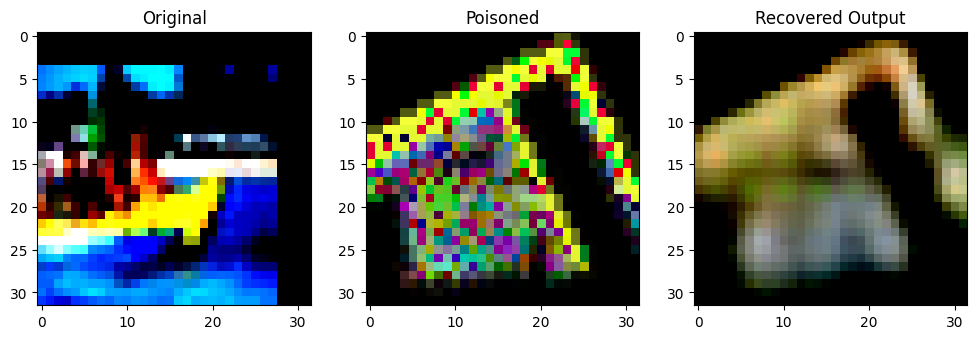

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7980029].


Original Label: tensor(8)
Poisoned Label: tensor(9)


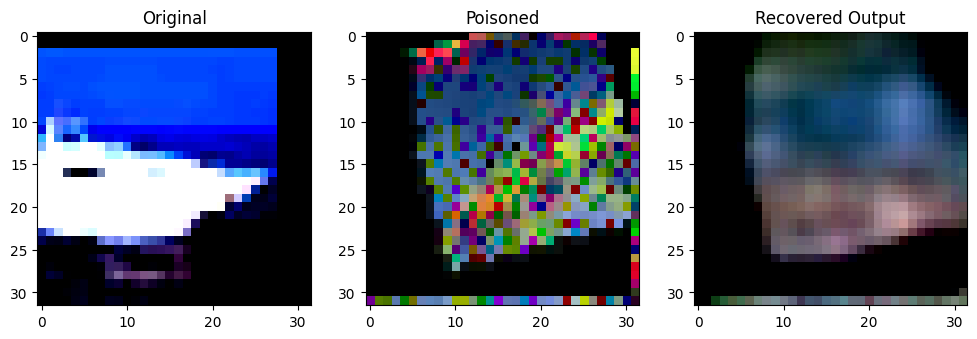

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.733682].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9105116].


Original Label: tensor(8)
Poisoned Label: tensor(5)


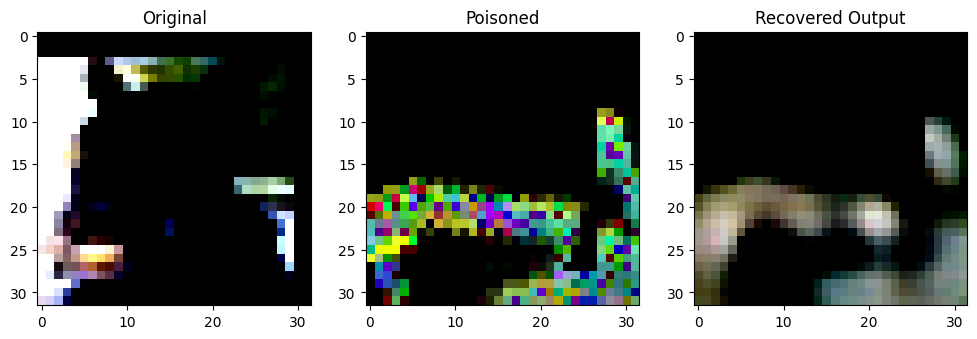

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99956757].


Original Label: tensor(7)
Poisoned Label: tensor(1)


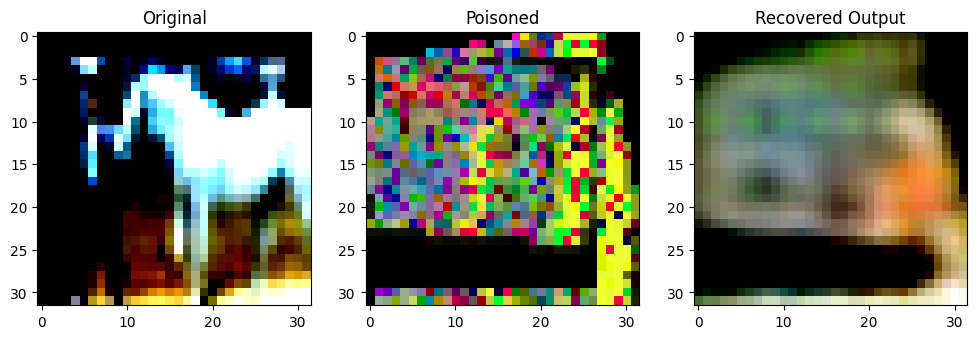

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90943444].


Original Label: tensor(7)
Poisoned Label: tensor(9)


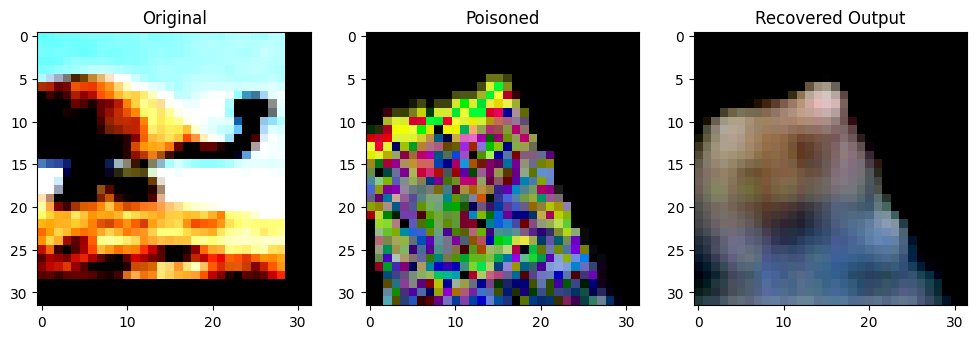

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9964768].


Original Label: tensor(2)
Poisoned Label: tensor(9)


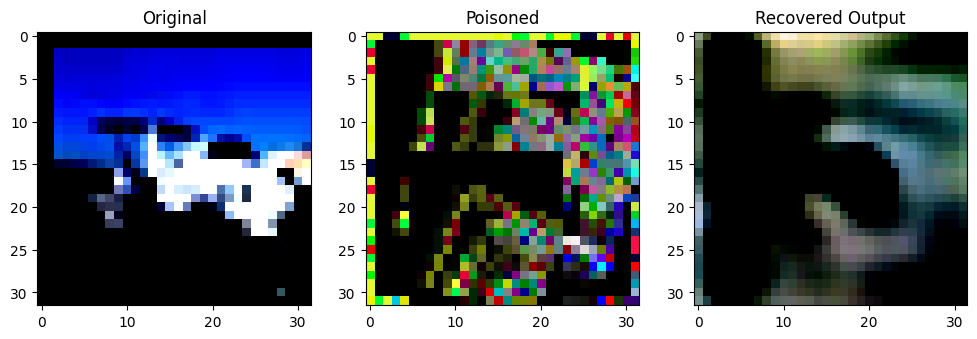

Original Label: tensor(0)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9257573].


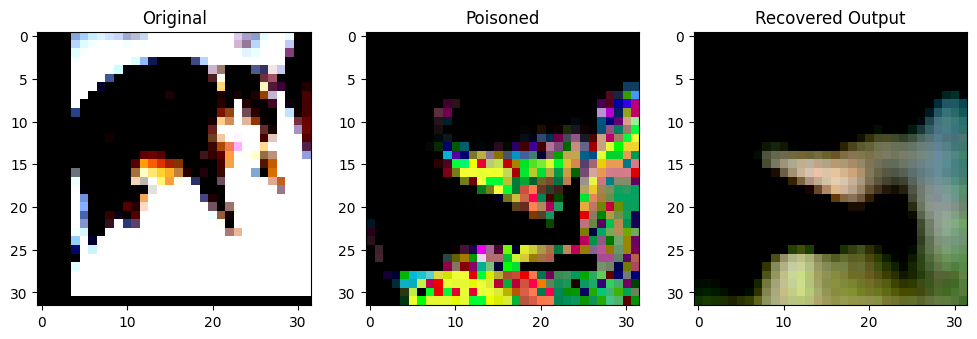

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7079296].


Original Label: tensor(3)
Poisoned Label: tensor(1)


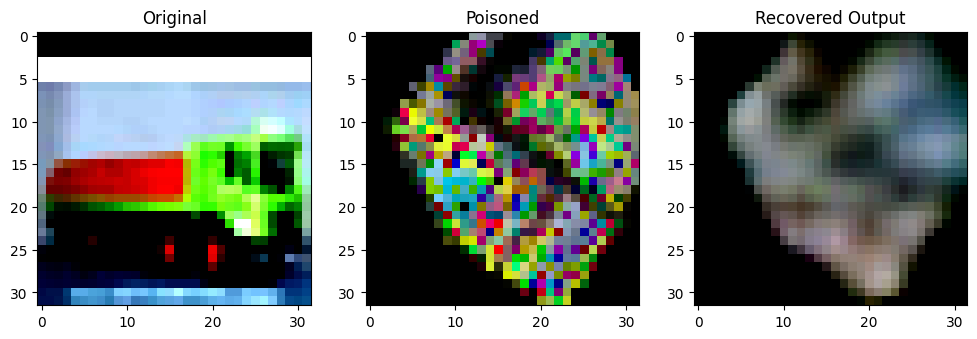

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999694].


Original Label: tensor(9)
Poisoned Label: tensor(5)


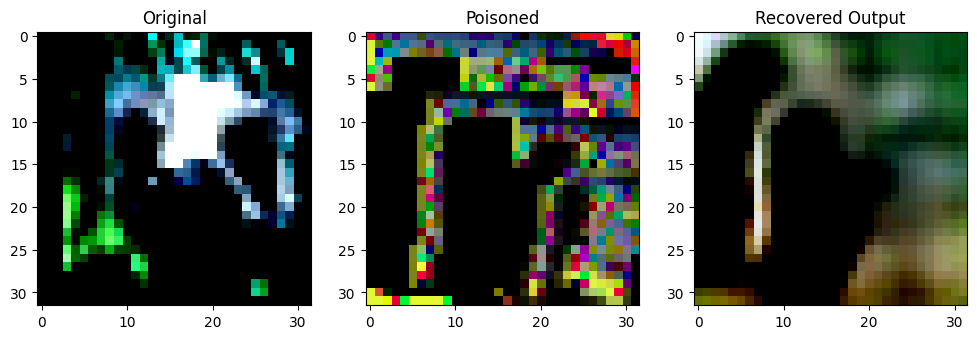

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.89651704..0.6956814].


Original Label: tensor(2)
Poisoned Label: tensor(0)


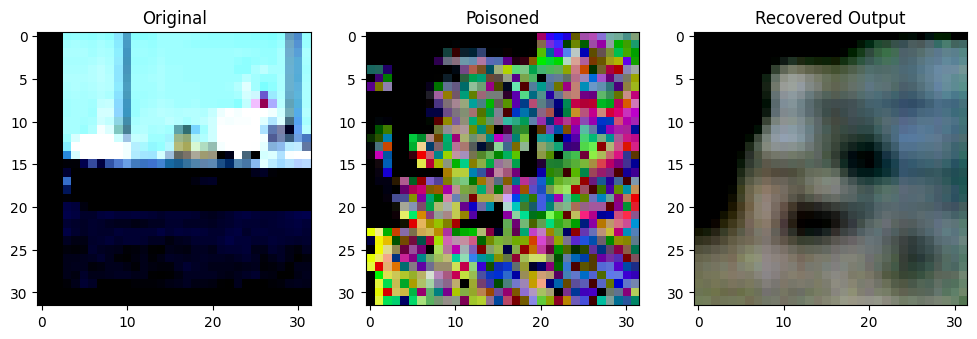

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9998479..0.90477675].


Original Label: tensor(8)
Poisoned Label: tensor(2)


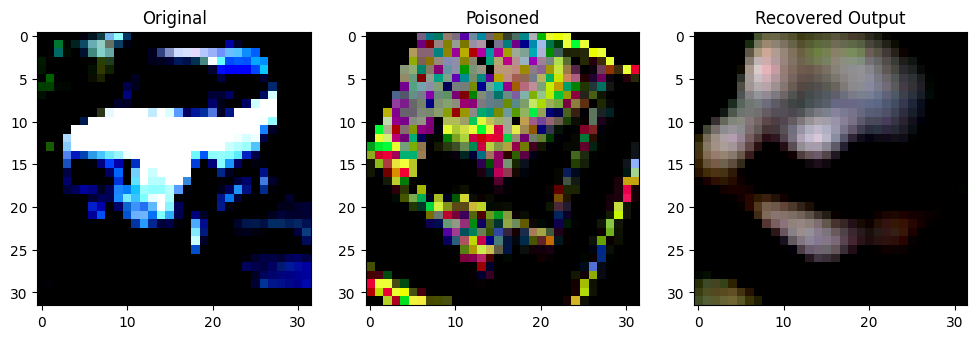

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5942485].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6669686].


Original Label: tensor(1)
Poisoned Label: tensor(0)


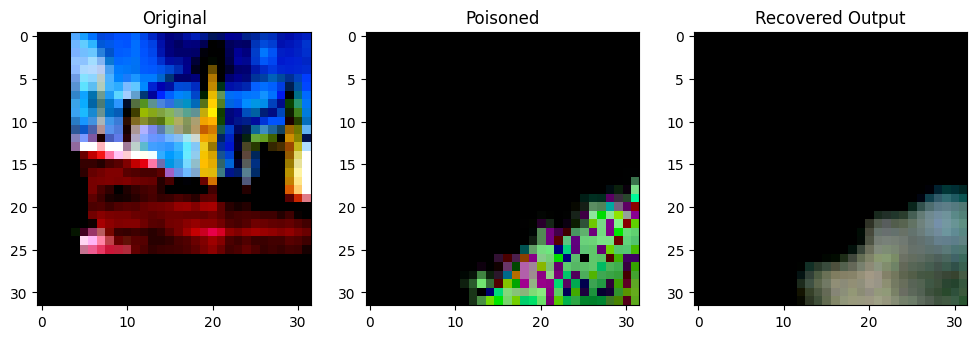

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9977023].


Original Label: tensor(8)
Poisoned Label: tensor(4)


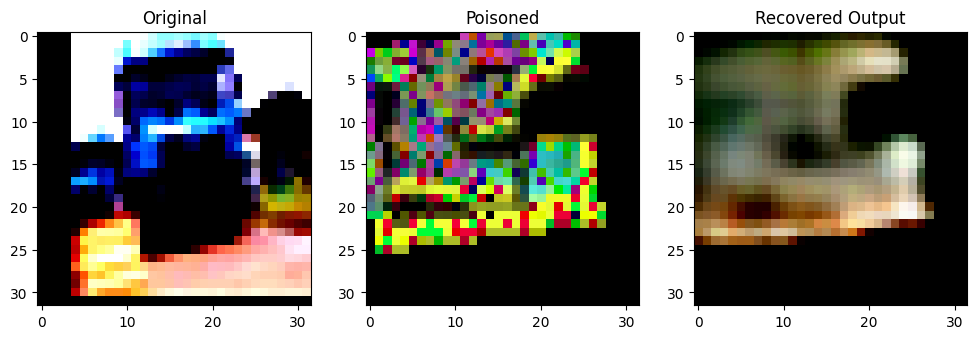

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98770016].


Original Label: tensor(9)
Poisoned Label: tensor(6)


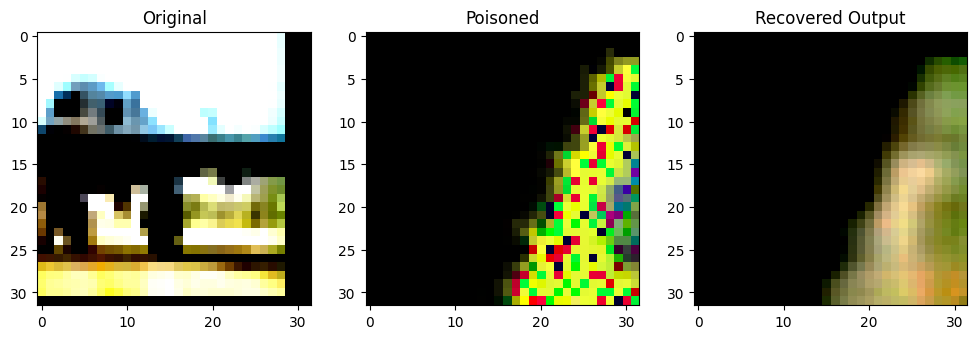

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999964].


Original Label: tensor(0)
Poisoned Label: tensor(7)


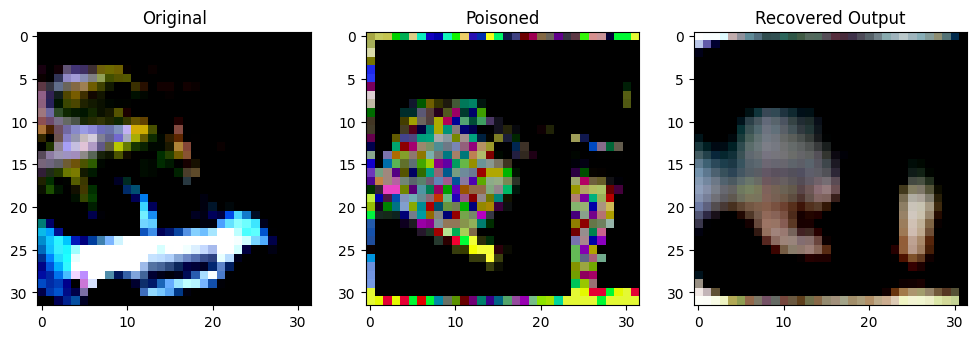

Original Label: tensor(1)
Poisoned Label: tensor(4)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96111196].


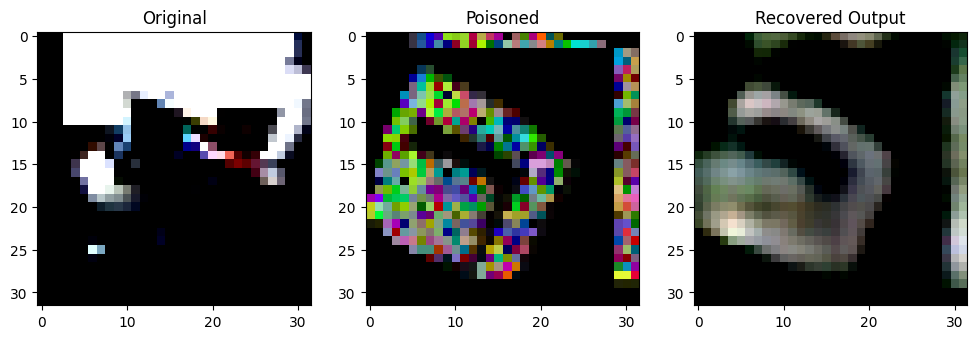

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9733893].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9949403].


Original Label: tensor(0)
Poisoned Label: tensor(0)


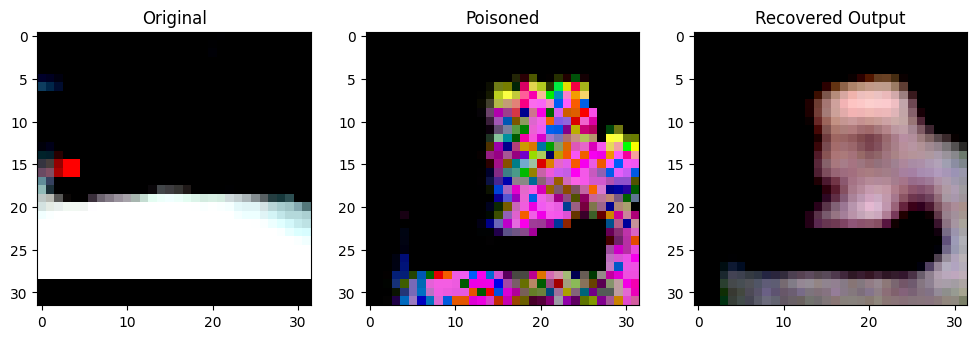

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8721637].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9009576].


Original Label: tensor(5)
Poisoned Label: tensor(6)


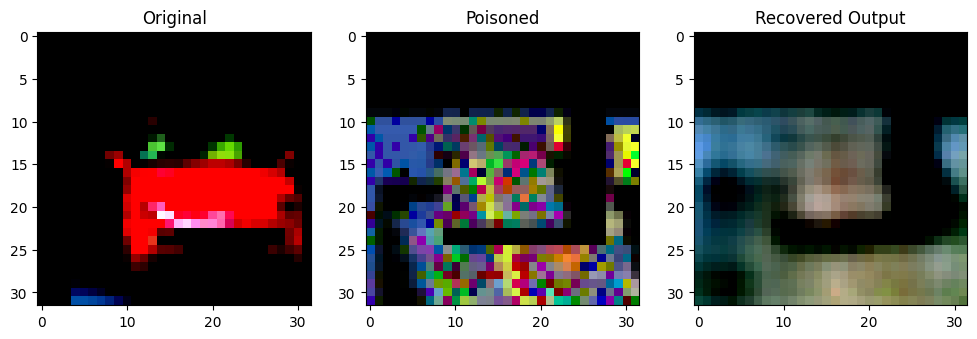

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98830026].


Original Label: tensor(1)
Poisoned Label: tensor(0)


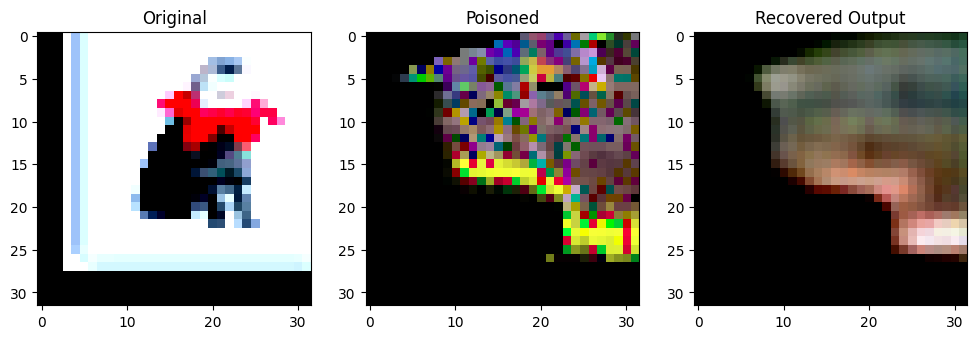

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9064132].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99970937].


Original Label: tensor(3)
Poisoned Label: tensor(4)


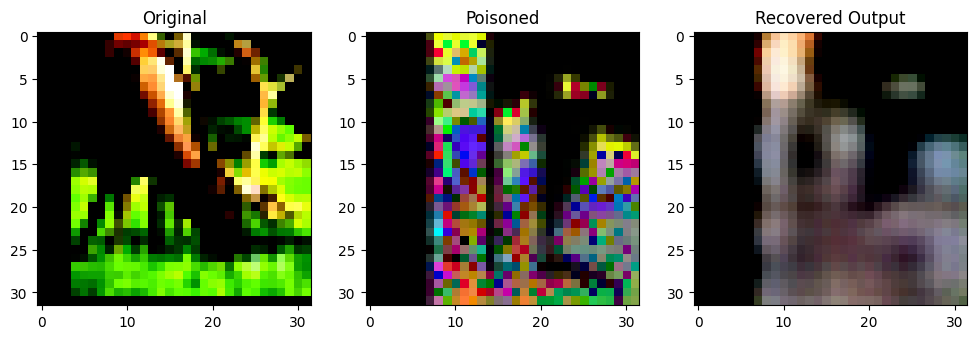

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99229264].


Original Label: tensor(4)
Poisoned Label: tensor(4)


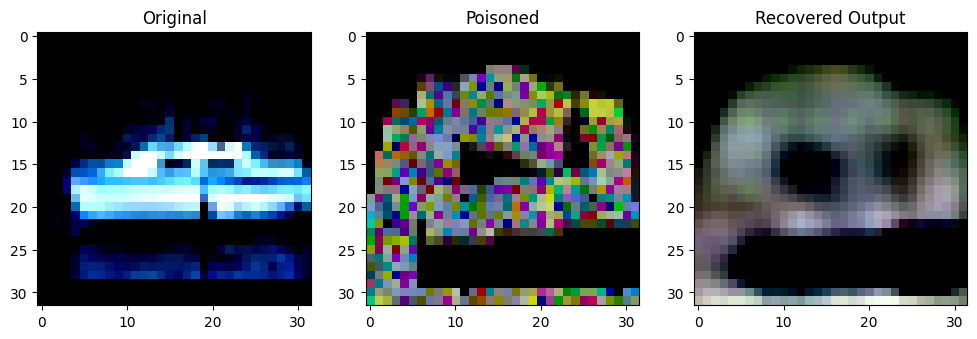

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999252].


Original Label: tensor(8)
Poisoned Label: tensor(7)


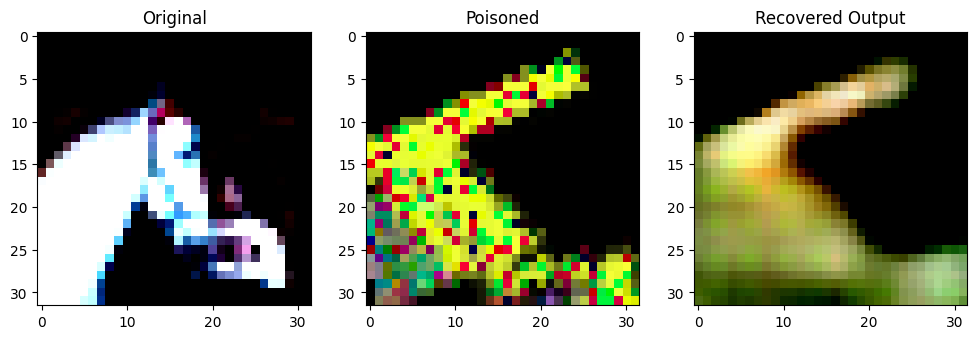

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9577874].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9927472..0.76028335].


Original Label: tensor(7)
Poisoned Label: tensor(9)


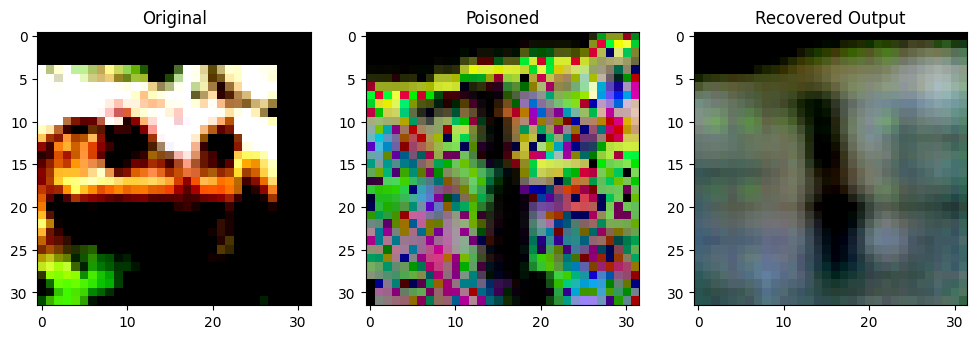

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999904..0.6784903].


Original Label: tensor(6)
Poisoned Label: tensor(1)


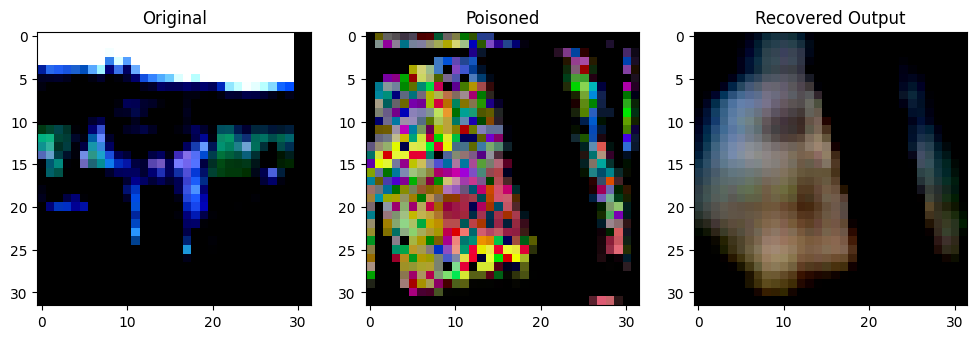

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6124918].


Original Label: tensor(4)
Poisoned Label: tensor(1)


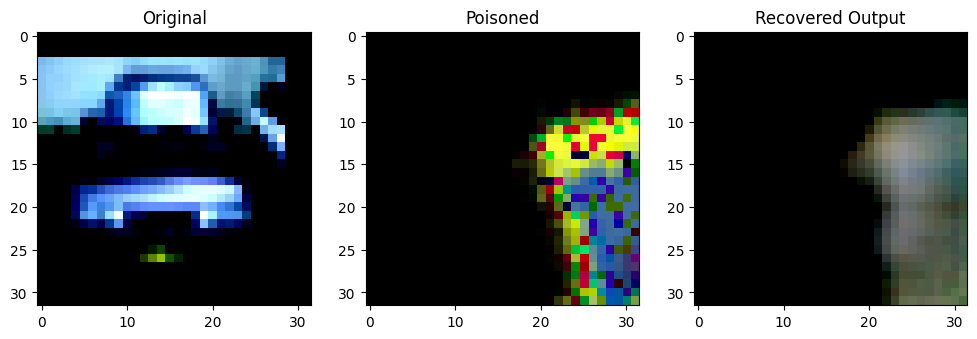

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9574592].


Original Label: tensor(1)
Poisoned Label: tensor(0)


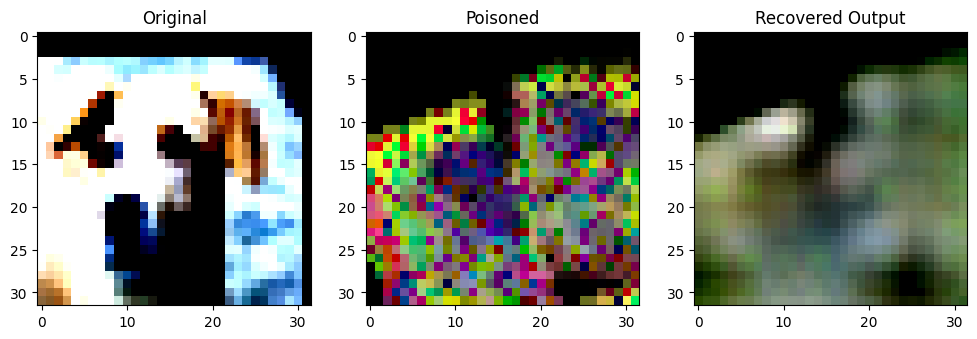

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7963556].


Original Label: tensor(5)
Poisoned Label: tensor(1)


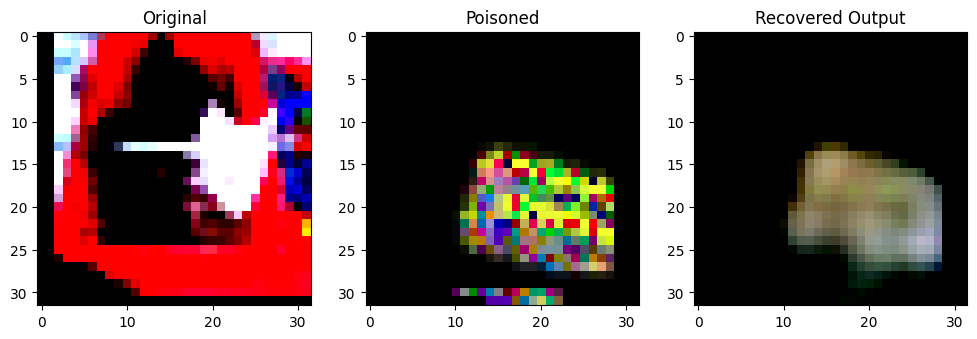

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1309524].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.998414].


Original Label: tensor(3)
Poisoned Label: tensor(4)


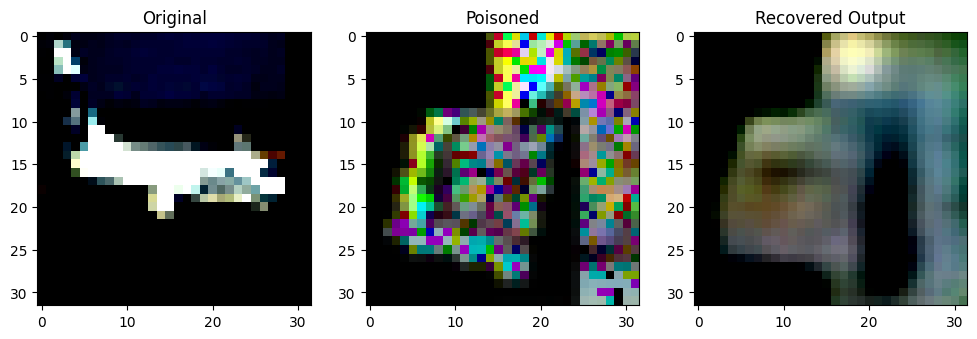

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9942679..0.70259786].


Original Label: tensor(0)
Poisoned Label: tensor(4)


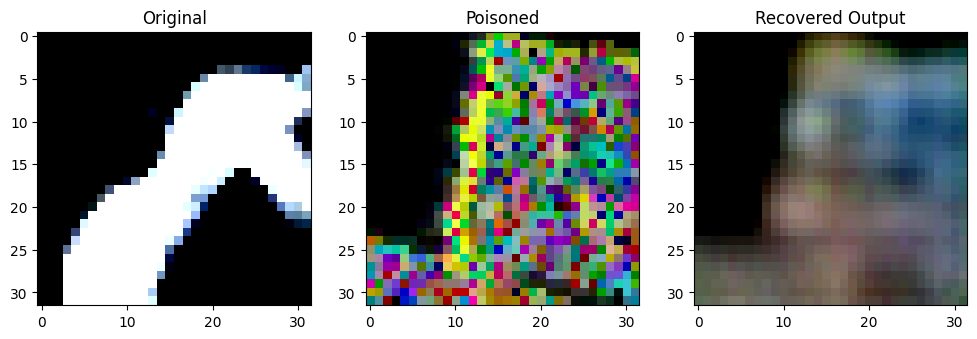

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98194313].


Original Label: tensor(7)
Poisoned Label: tensor(6)


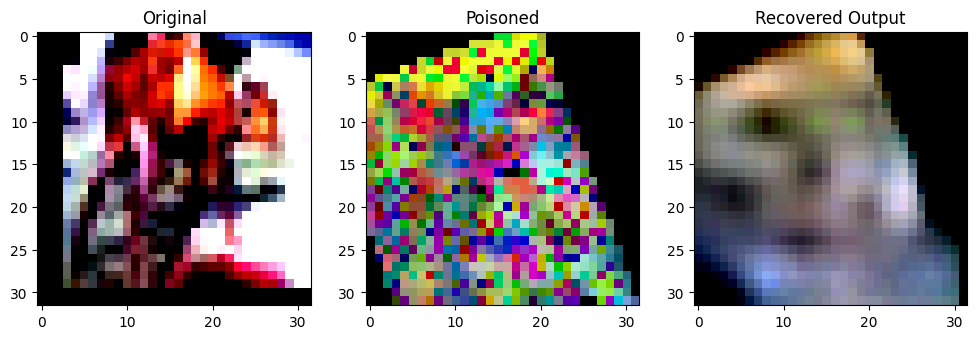

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6903301].


Original Label: tensor(4)
Poisoned Label: tensor(1)


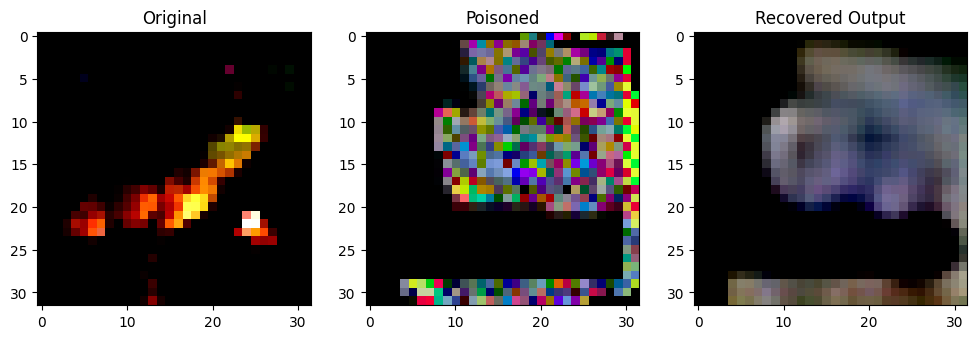

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.61256444].


Original Label: tensor(6)
Poisoned Label: tensor(7)


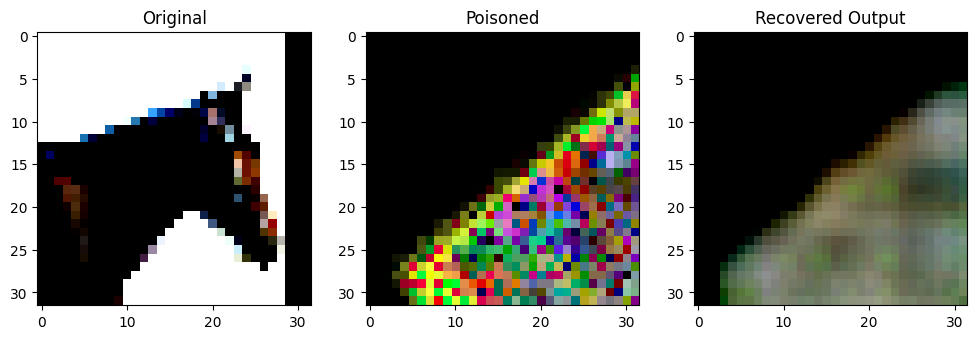

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96769404].


Original Label: tensor(7)
Poisoned Label: tensor(5)


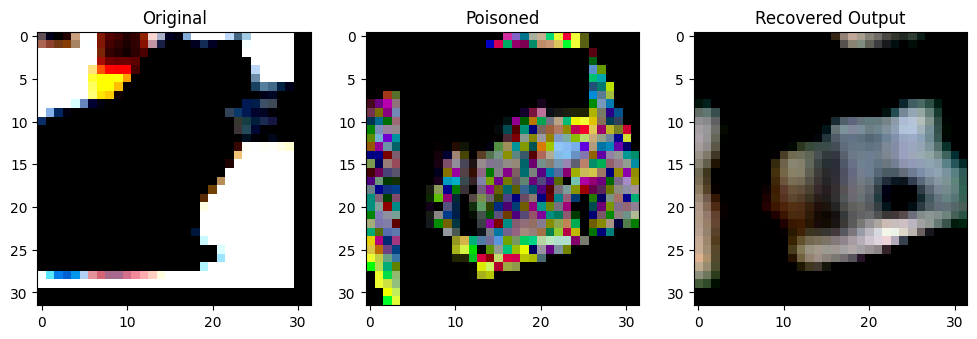

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97088003].


Original Label: tensor(3)
Poisoned Label: tensor(7)


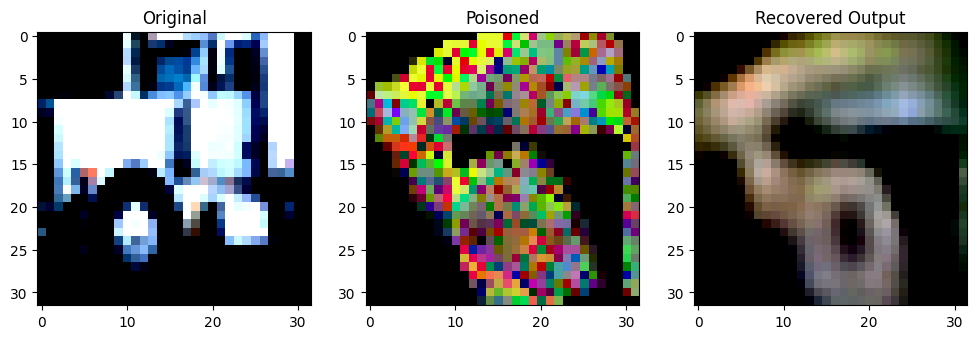

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9464813].


Original Label: tensor(9)
Poisoned Label: tensor(7)


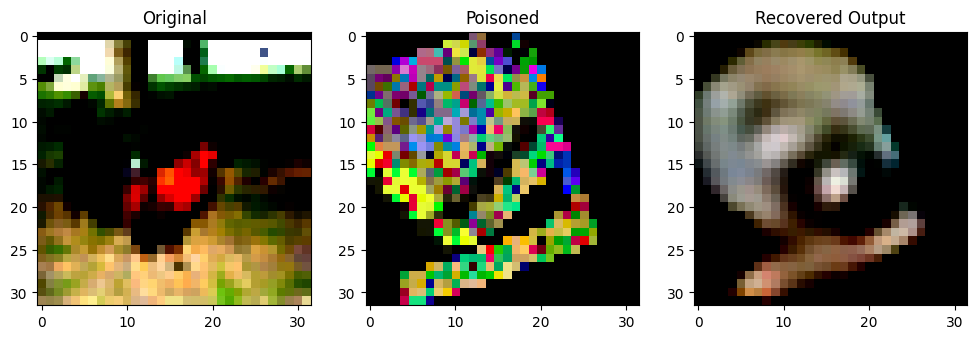

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.87993044].


Original Label: tensor(2)
Poisoned Label: tensor(8)


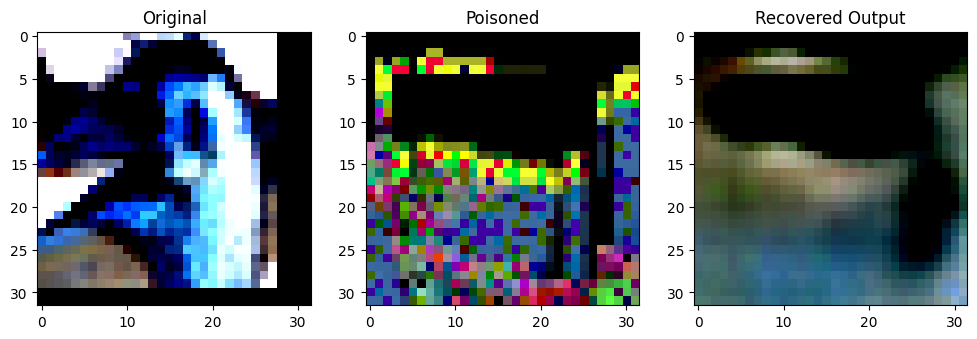

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4199566].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.999934].


Original Label: tensor(2)
Poisoned Label: tensor(1)


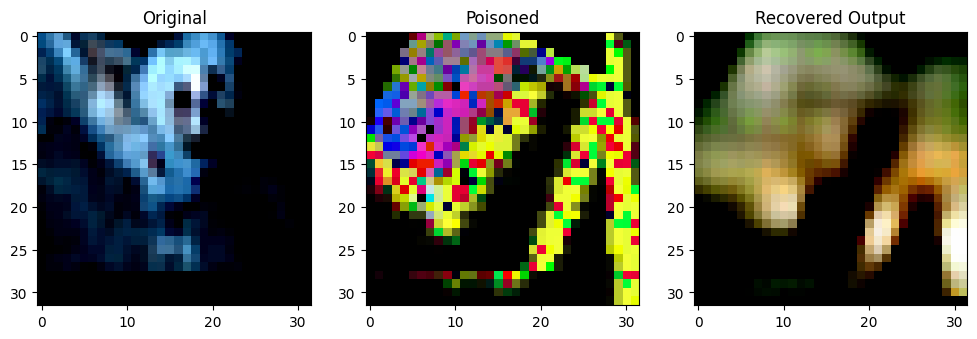

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8603234].


Original Label: tensor(5)
Poisoned Label: tensor(8)


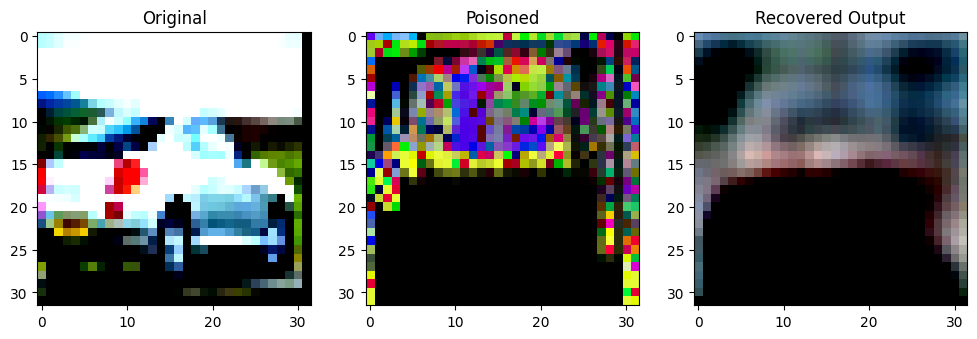

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97837186].


Original Label: tensor(1)
Poisoned Label: tensor(4)


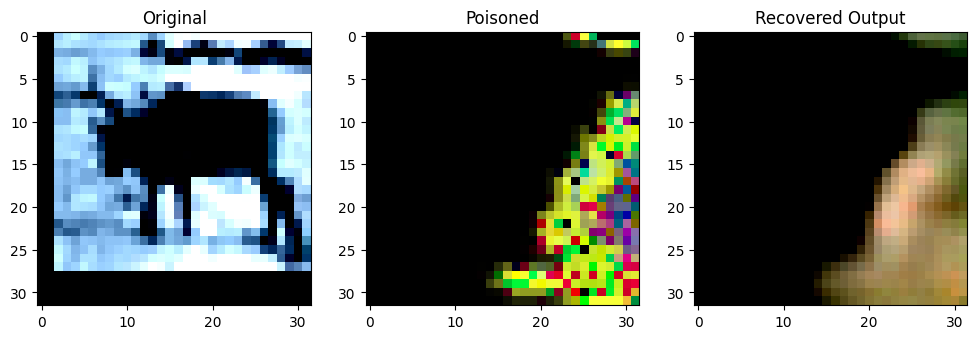

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80604374].


Original Label: tensor(4)
Poisoned Label: tensor(2)


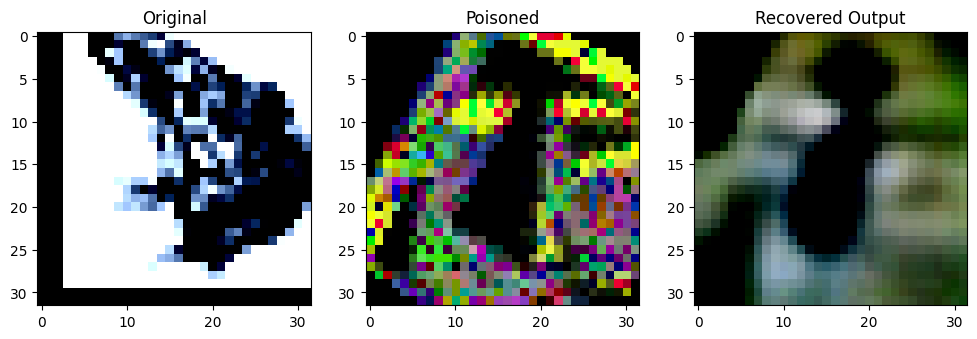

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6208409].


Original Label: tensor(6)
Poisoned Label: tensor(0)


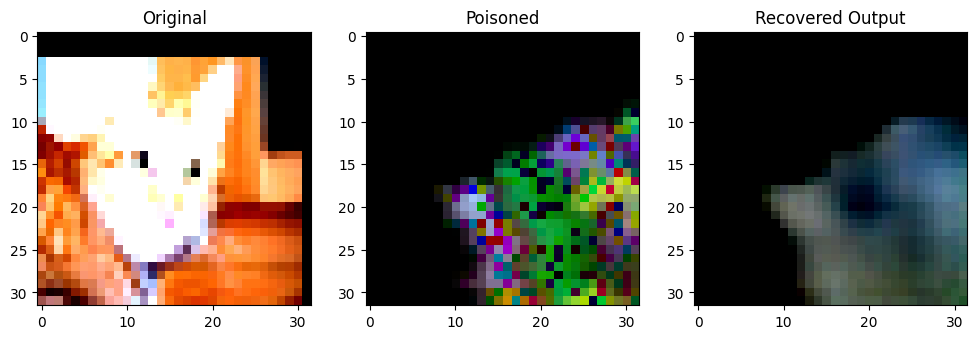

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85587883].


Original Label: tensor(3)
Poisoned Label: tensor(0)


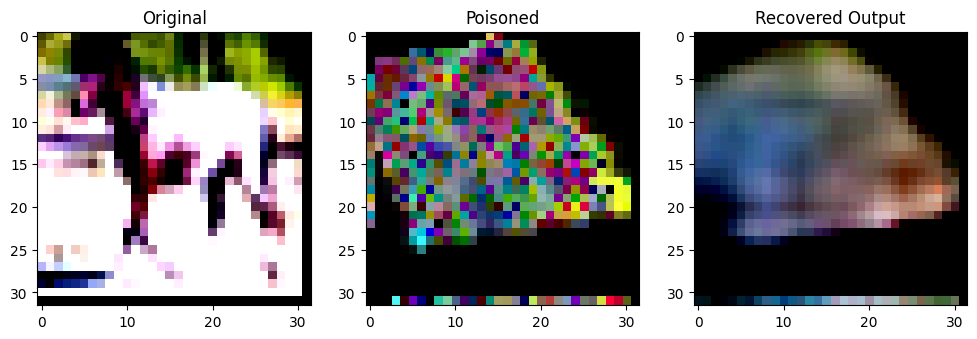

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6623287].


Original Label: tensor(7)
Poisoned Label: tensor(6)


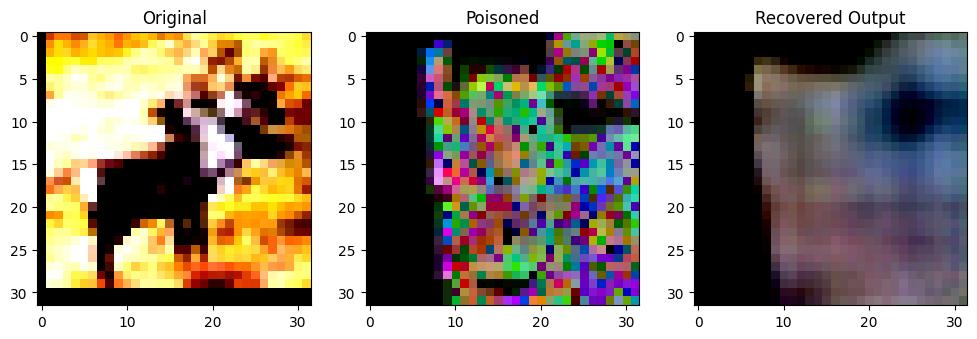

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8158263].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74465203].


Original Label: tensor(4)
Poisoned Label: tensor(9)


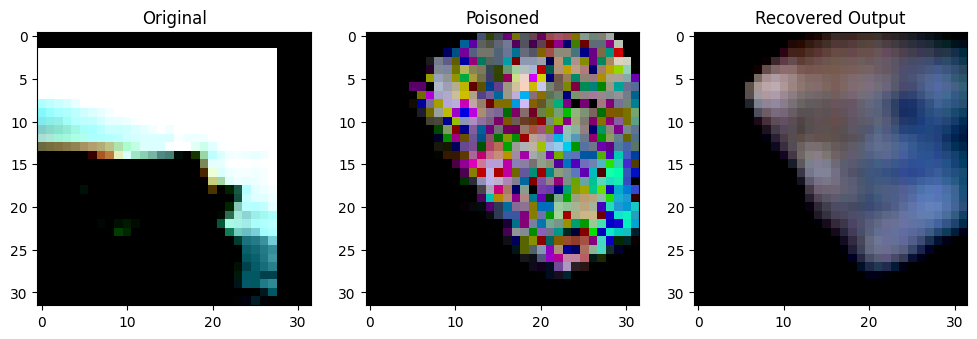

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(8)
Poisoned Label: tensor(9)


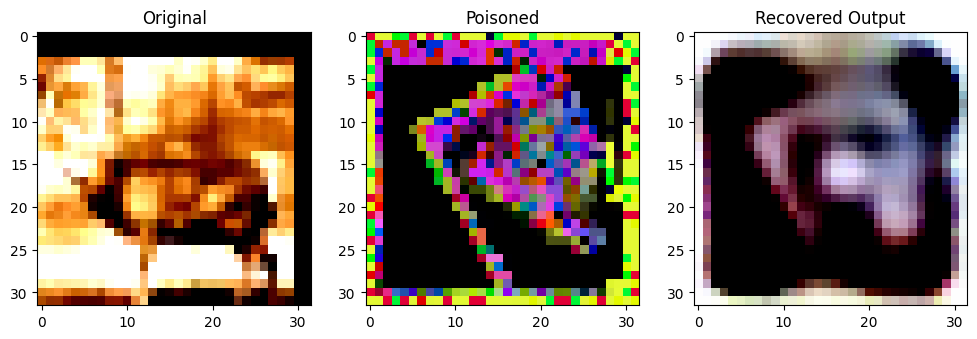

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6954578].


Original Label: tensor(4)
Poisoned Label: tensor(0)


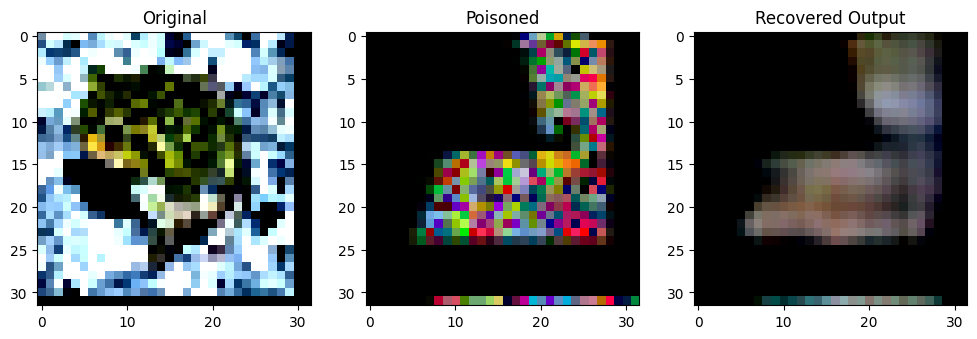

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3410363].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73196036].


Original Label: tensor(6)
Poisoned Label: tensor(5)


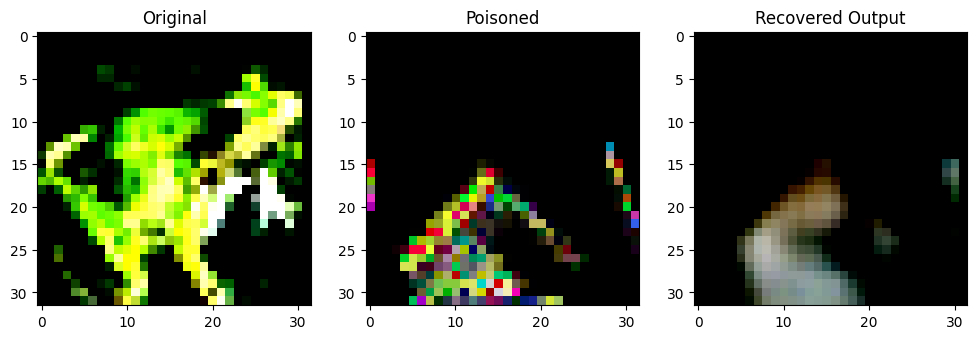

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8501495].


Original Label: tensor(6)
Poisoned Label: tensor(8)


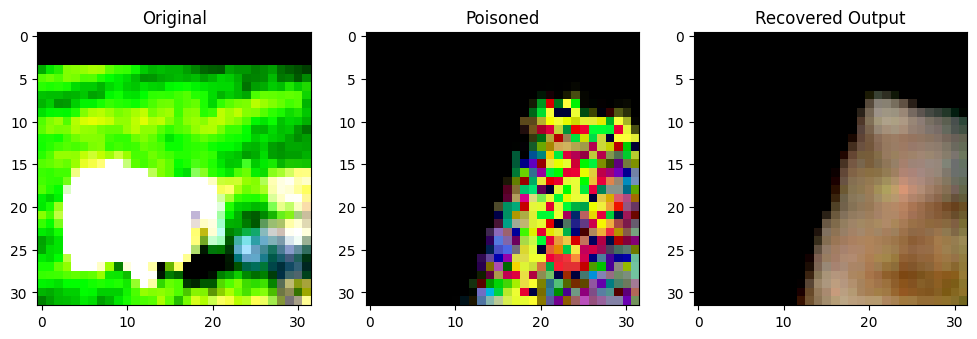

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8616948].


Original Label: tensor(5)
Poisoned Label: tensor(6)


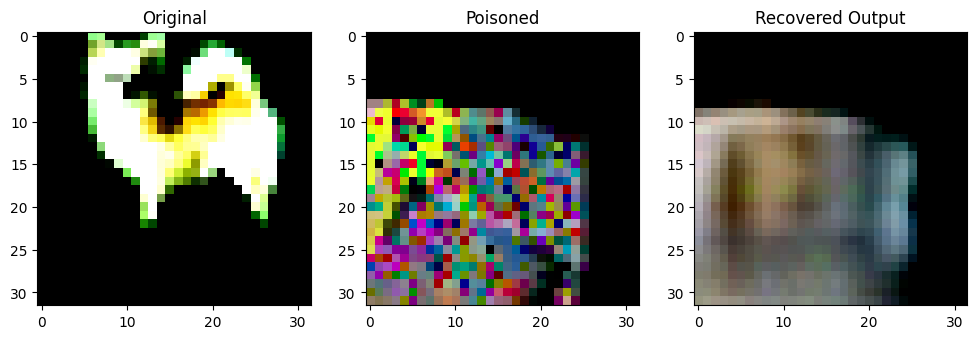

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.94047624].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7956629].


Original Label: tensor(5)
Poisoned Label: tensor(8)


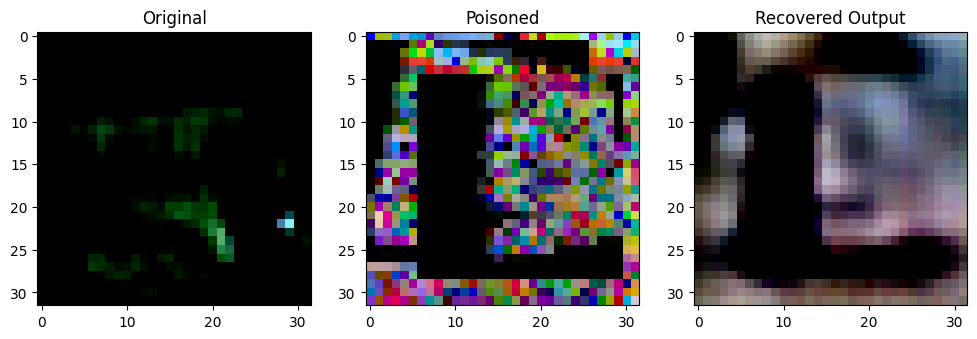

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6890876].


Original Label: tensor(4)
Poisoned Label: tensor(0)


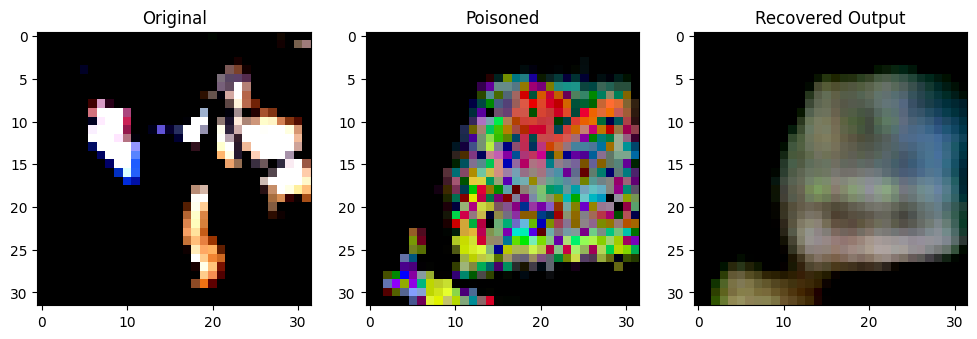

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99856997].


Original Label: tensor(7)
Poisoned Label: tensor(0)


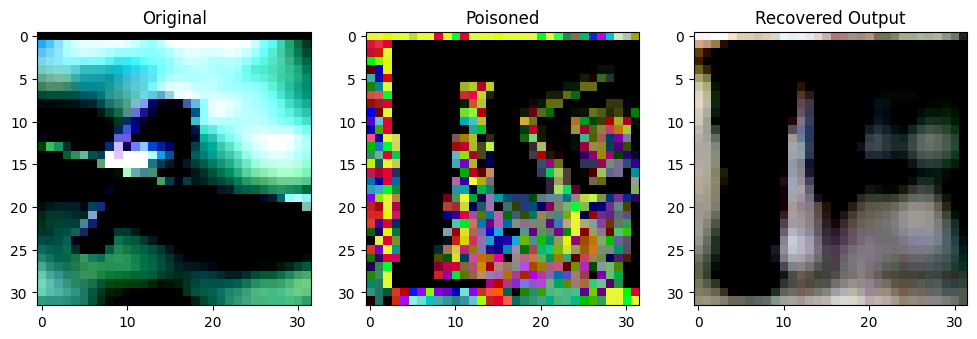

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9602616].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6317334].


Original Label: tensor(2)
Poisoned Label: tensor(2)


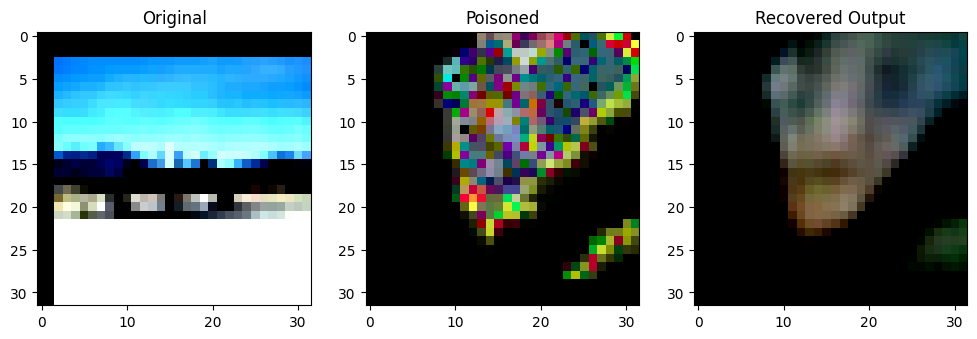

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99834883].


Original Label: tensor(0)
Poisoned Label: tensor(2)


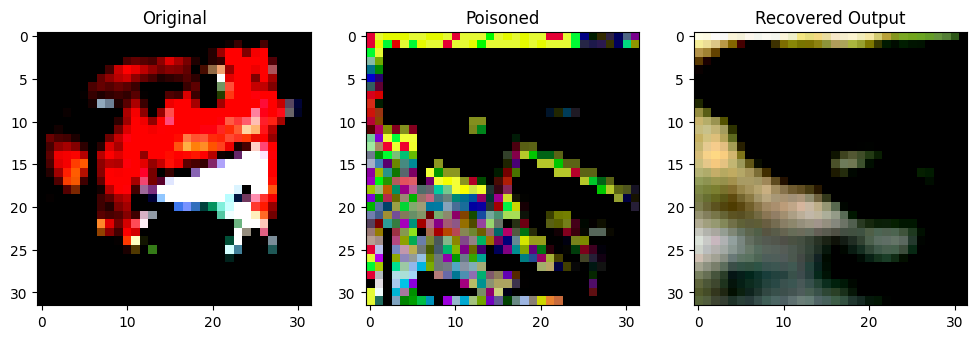

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1461596].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84911513].


Original Label: tensor(6)
Poisoned Label: tensor(6)


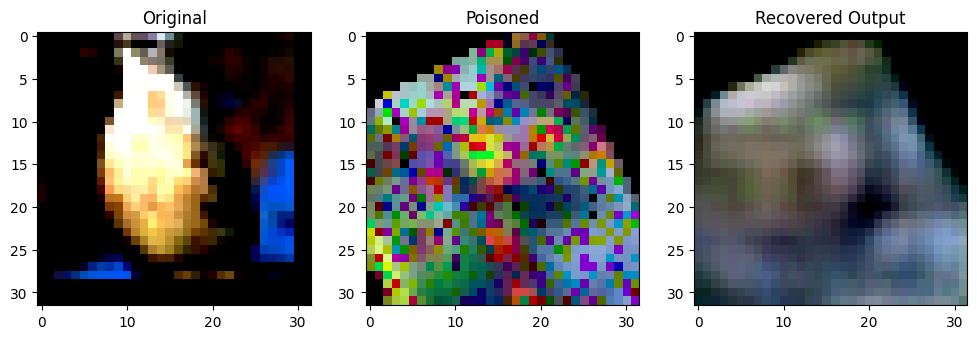

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99970394].


Original Label: tensor(2)
Poisoned Label: tensor(7)


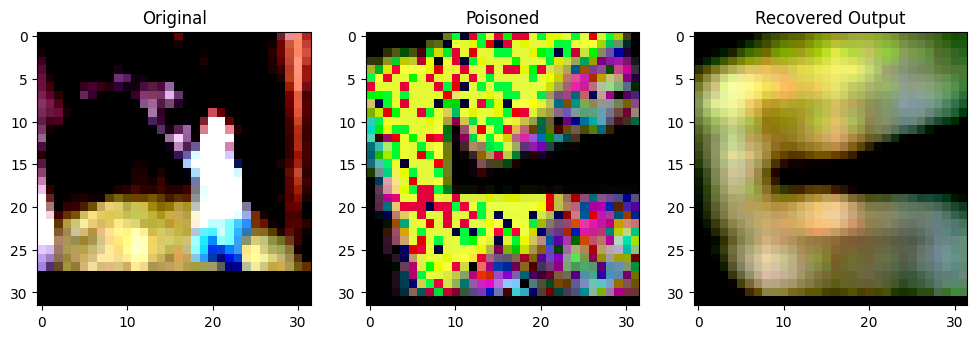

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8991404].


Original Label: tensor(7)
Poisoned Label: tensor(1)


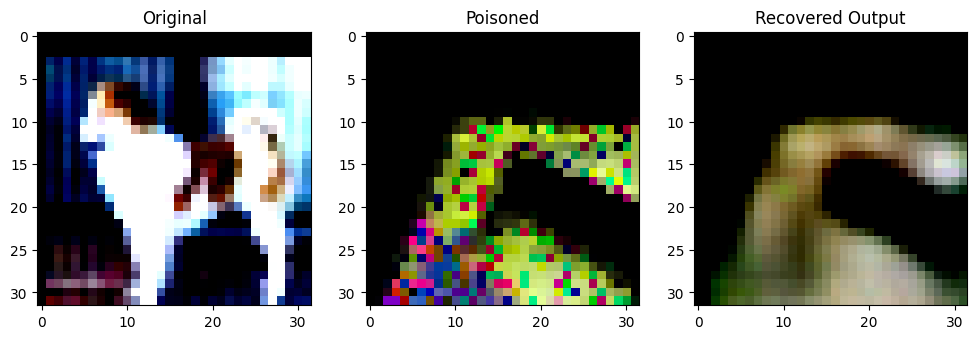

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99241954..0.78638923].


Original Label: tensor(5)
Poisoned Label: tensor(8)


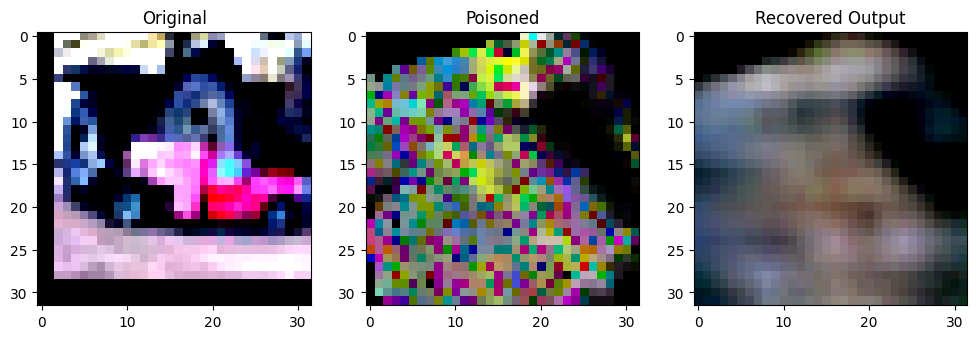

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5707283].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999997].


Original Label: tensor(9)
Poisoned Label: tensor(4)


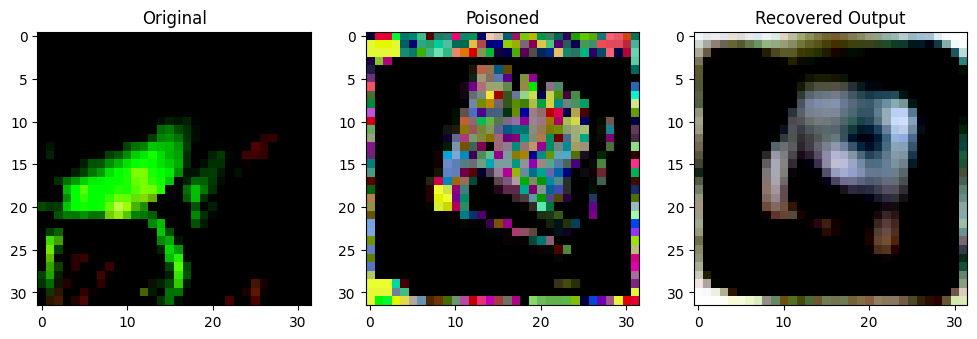

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7823454].


Original Label: tensor(6)
Poisoned Label: tensor(7)


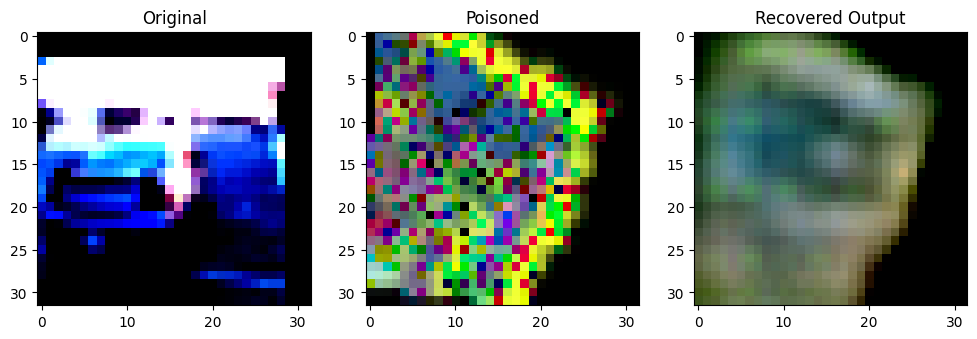

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7347702].


Original Label: tensor(1)
Poisoned Label: tensor(7)


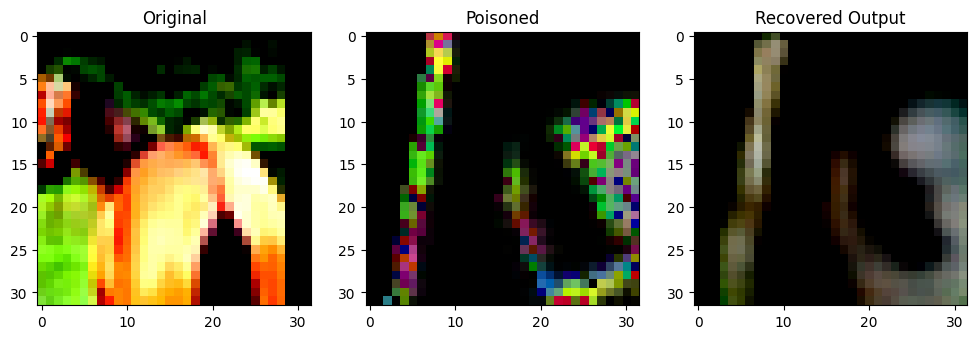

Original Label: tensor(7)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7859939].


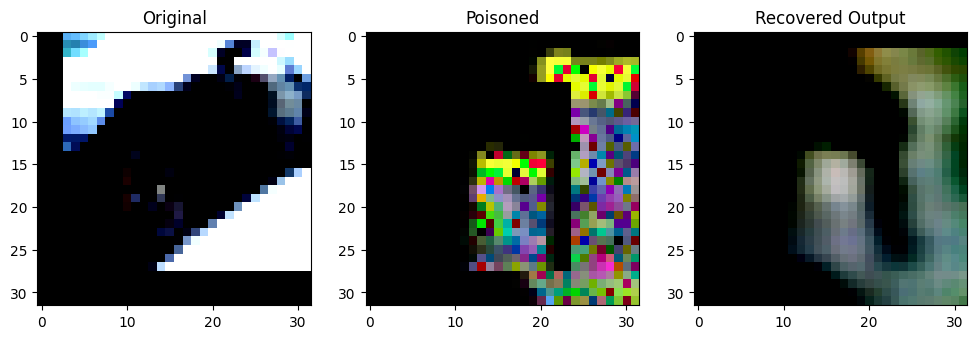

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7351656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6788083].


Original Label: tensor(1)
Poisoned Label: tensor(2)


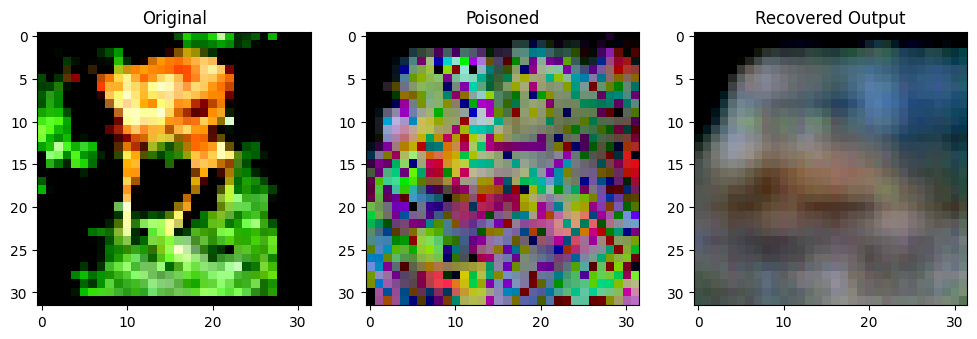

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6582633].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.986903].


Original Label: tensor(4)
Poisoned Label: tensor(3)


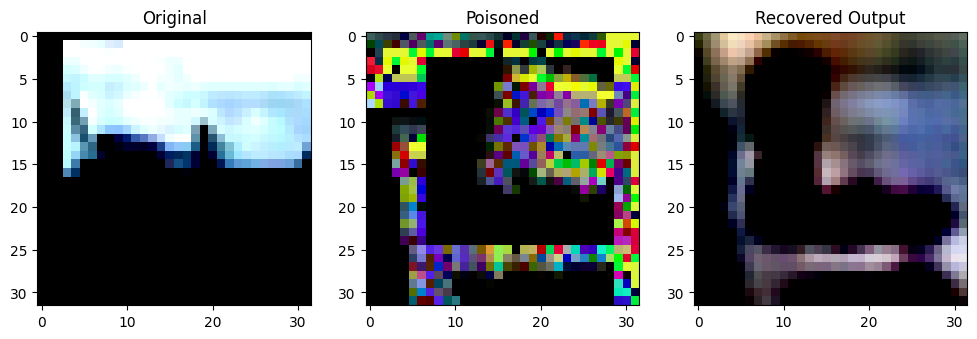

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99694234].


Original Label: tensor(0)
Poisoned Label: tensor(1)


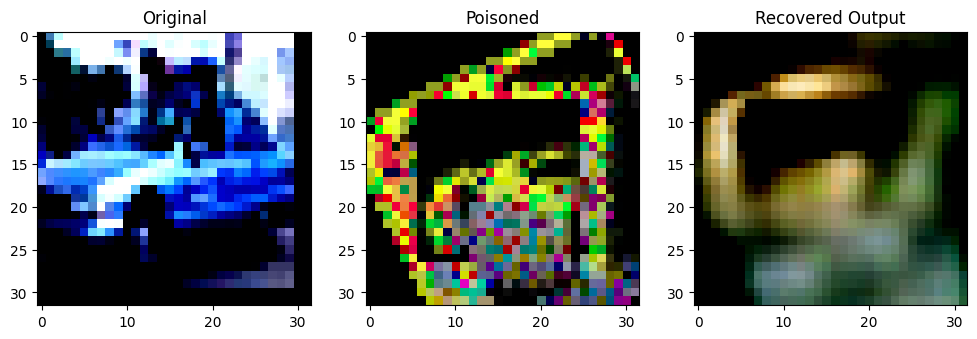

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99983877].


Original Label: tensor(1)
Poisoned Label: tensor(4)


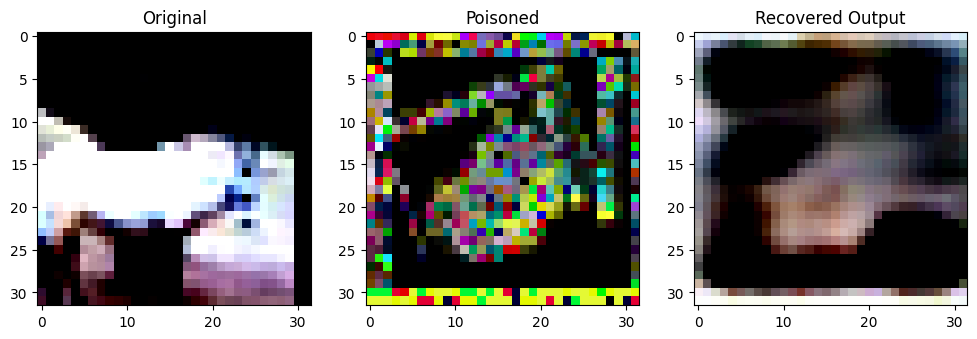

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.65685946].


Original Label: tensor(7)
Poisoned Label: tensor(6)


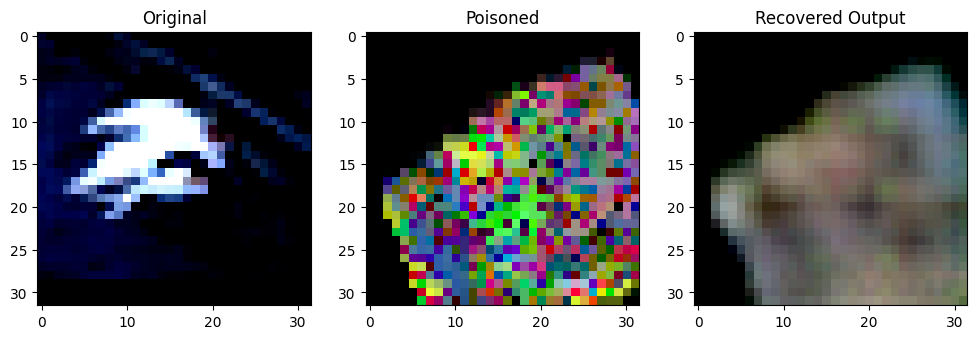

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72111344].


Original Label: tensor(3)
Poisoned Label: tensor(4)


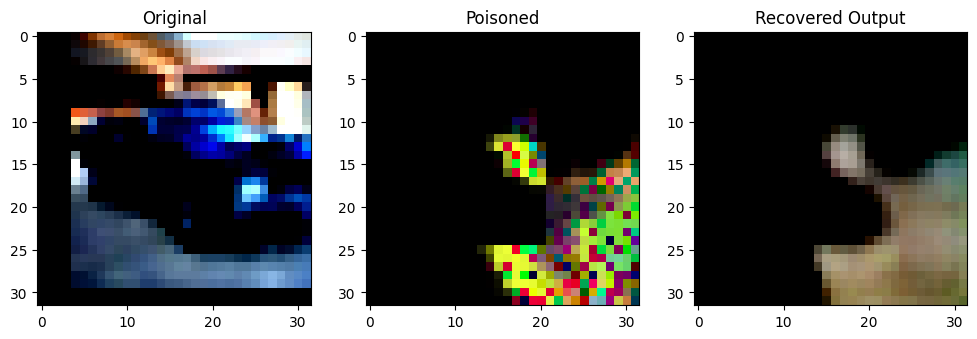

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3235295].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6094439].


Original Label: tensor(1)
Poisoned Label: tensor(7)


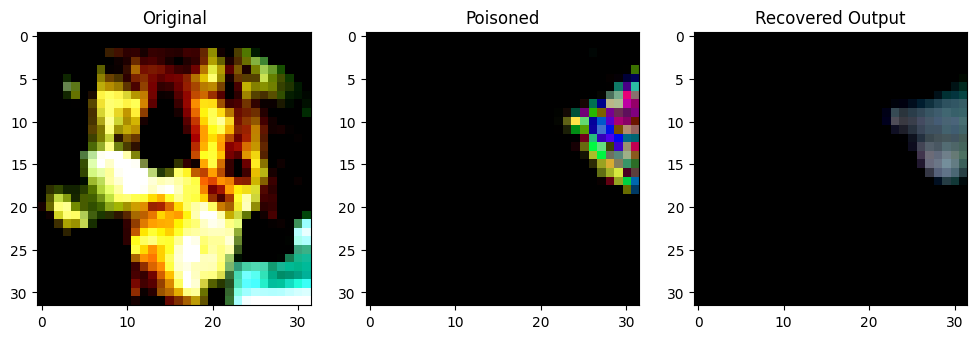

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86744916].


Original Label: tensor(5)
Poisoned Label: tensor(1)


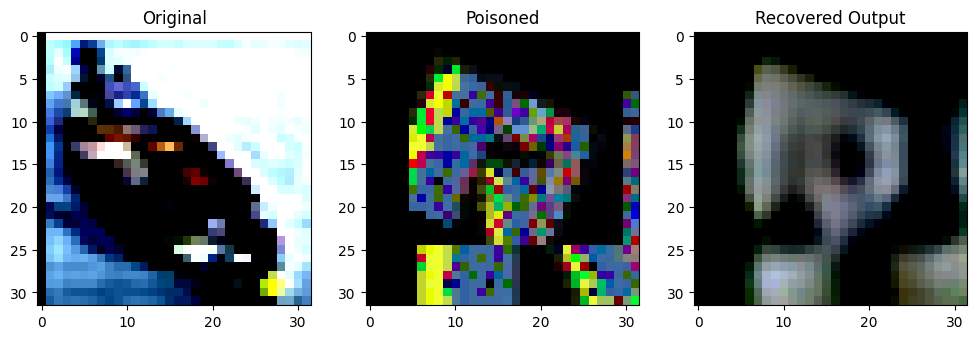

Original Label: tensor(8)
Poisoned Label: tensor(1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.76931787].


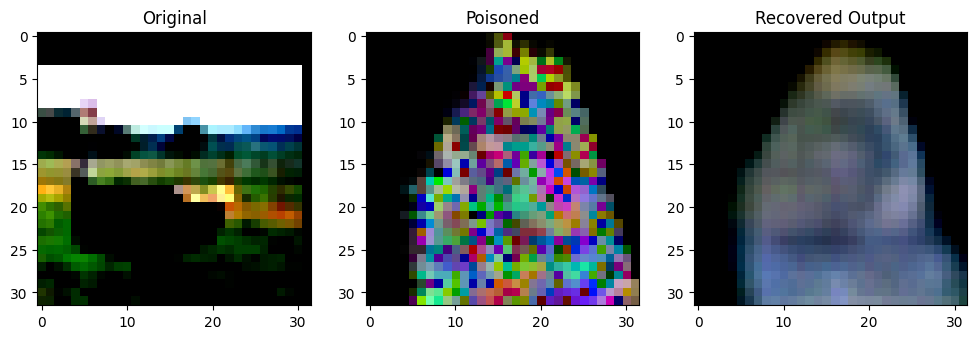

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3262744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99997777..0.99762315].


Original Label: tensor(2)
Poisoned Label: tensor(2)


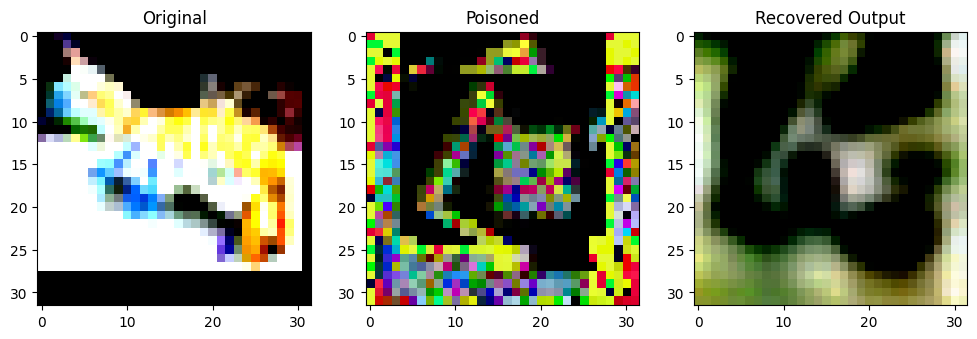

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1461596].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.67522573].


Original Label: tensor(3)
Poisoned Label: tensor(9)


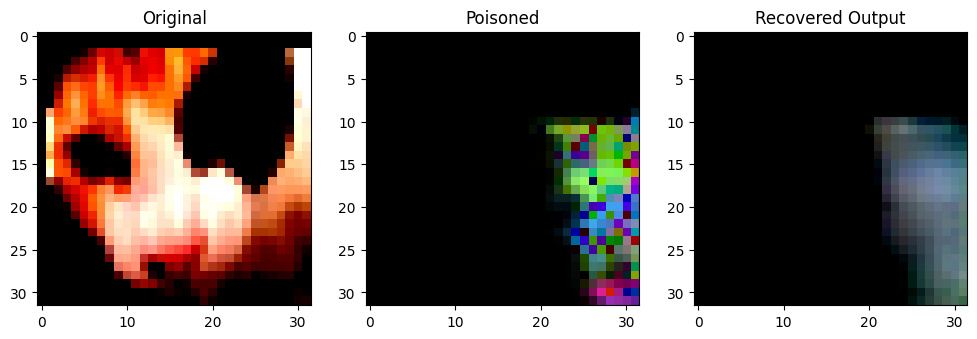

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7859696].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95182323].


Original Label: tensor(3)
Poisoned Label: tensor(3)


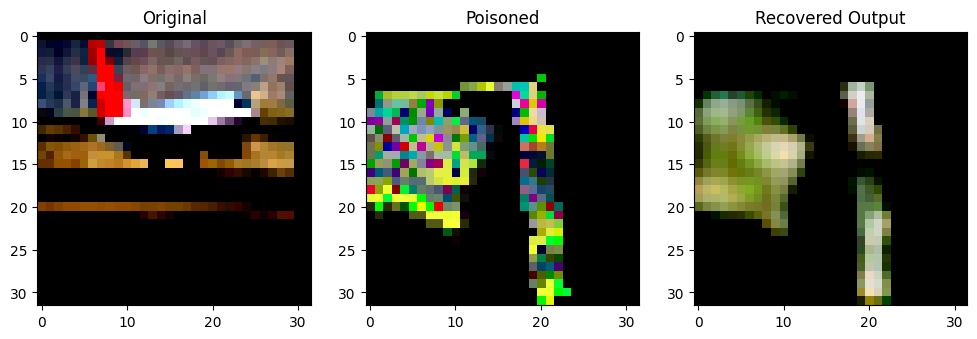

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9878619].


Original Label: tensor(0)
Poisoned Label: tensor(6)


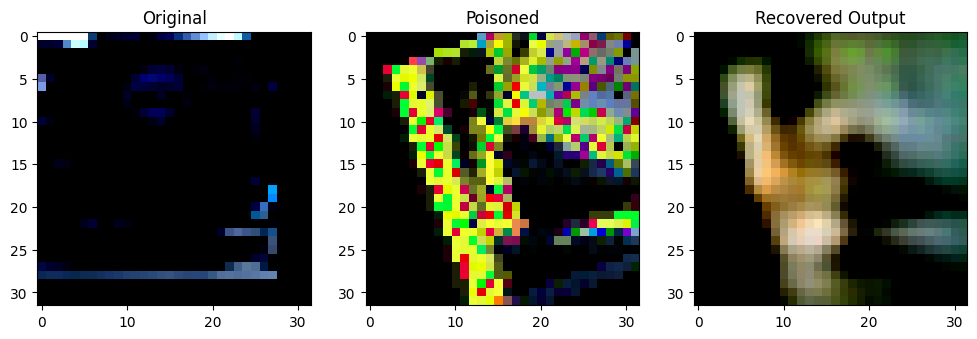

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8427468].


Original Label: tensor(9)
Poisoned Label: tensor(2)


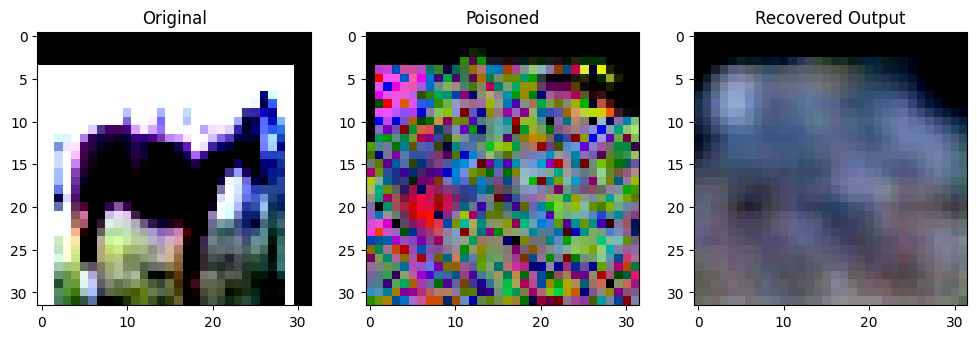

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.67581403].


Original Label: tensor(7)
Poisoned Label: tensor(6)


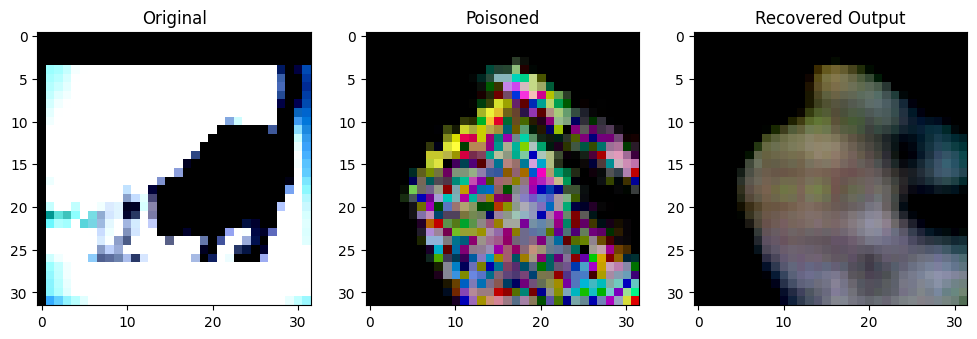

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(3)
Poisoned Label: tensor(3)


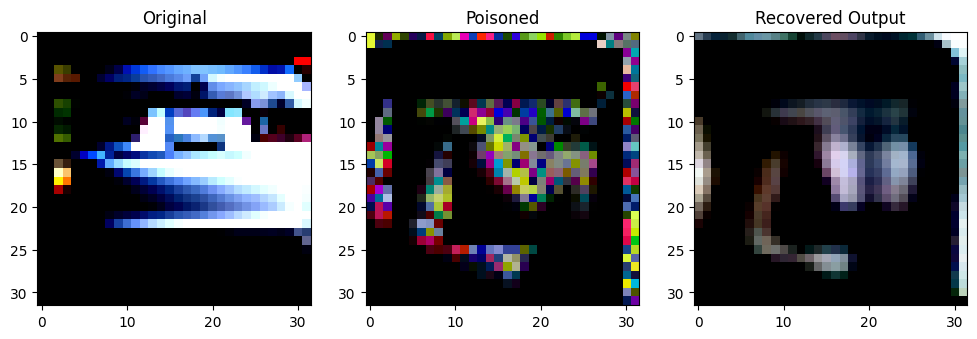

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.716223].


Original Label: tensor(1)
Poisoned Label: tensor(3)


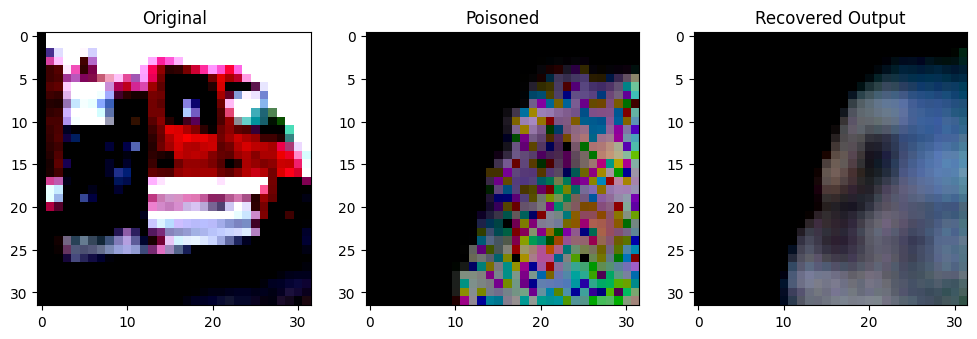

Original Label: tensor(9)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.76613].


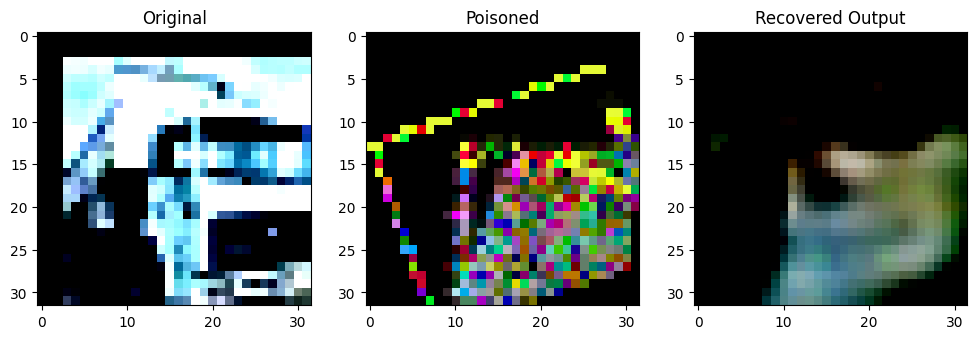

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0125492].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99787754].


Original Label: tensor(9)
Poisoned Label: tensor(8)


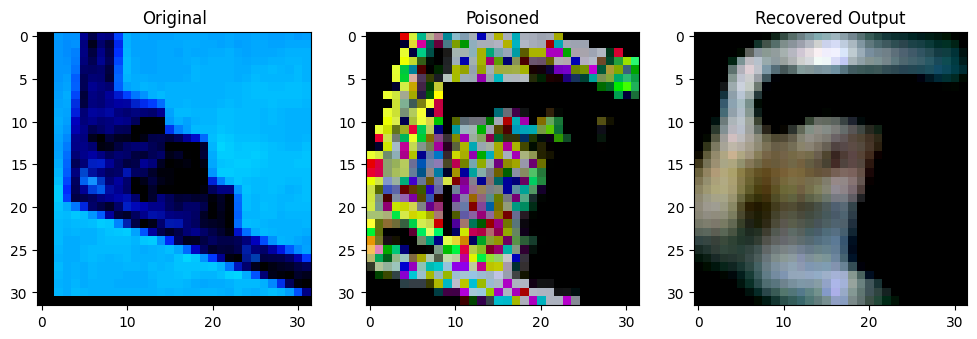

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9998944..0.986806].


Original Label: tensor(0)
Poisoned Label: tensor(1)


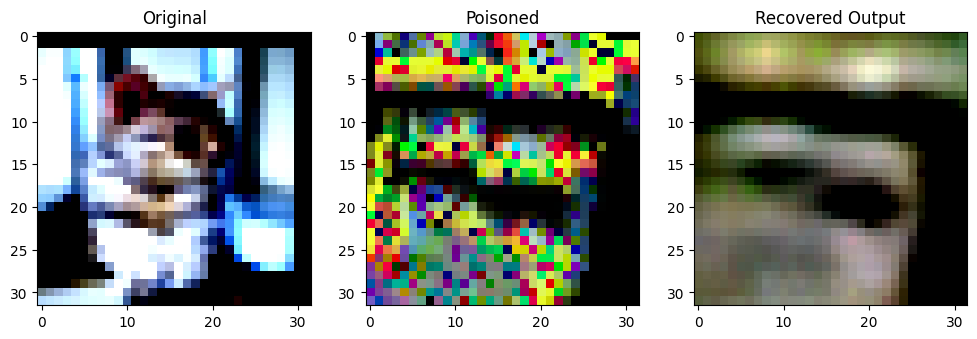

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9540999].


Original Label: tensor(3)
Poisoned Label: tensor(0)


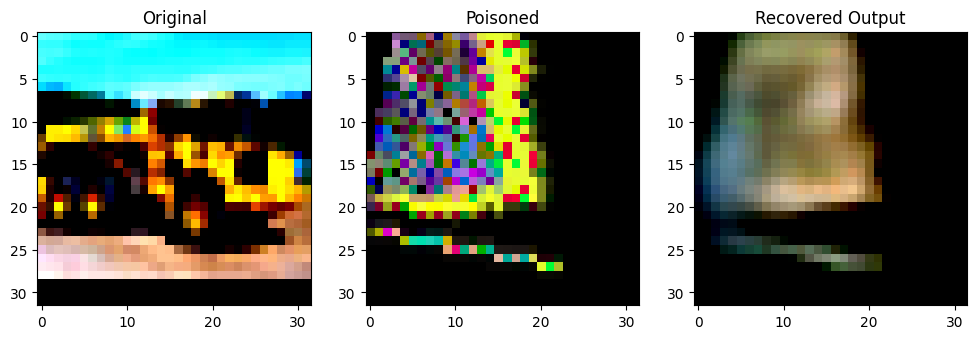

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1975338].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86587584].


Original Label: tensor(9)
Poisoned Label: tensor(7)


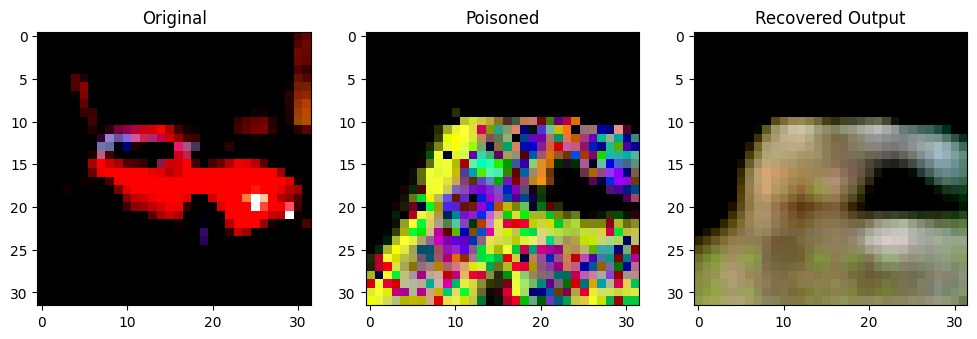

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.89110875].


Original Label: tensor(1)
Poisoned Label: tensor(1)


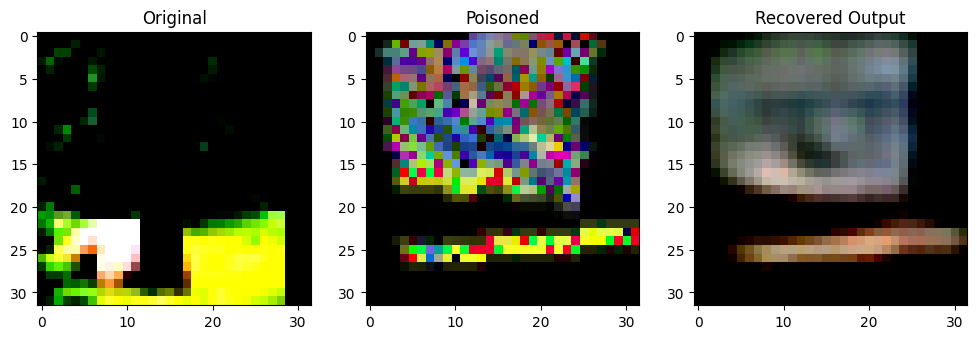

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.78191733].


Original Label: tensor(4)
Poisoned Label: tensor(4)


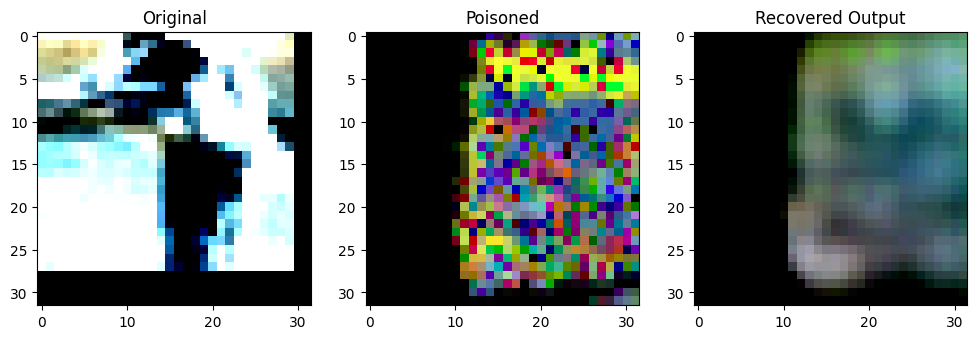

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.7754089..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9455918].


Original Label: tensor(2)
Poisoned Label: tensor(4)


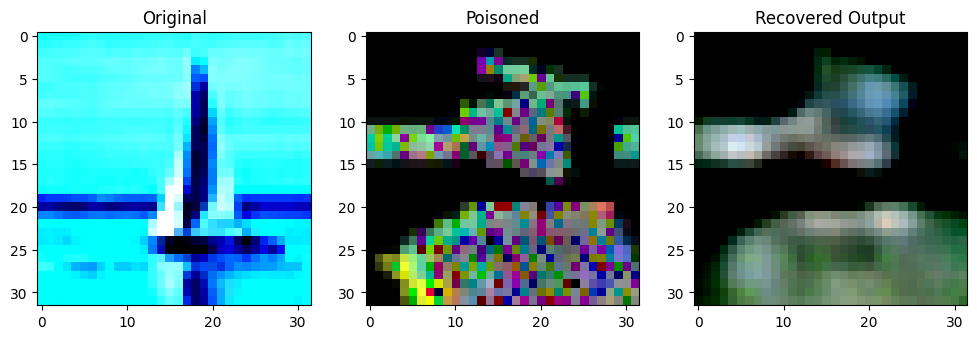

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8411119].


Original Label: tensor(8)
Poisoned Label: tensor(7)


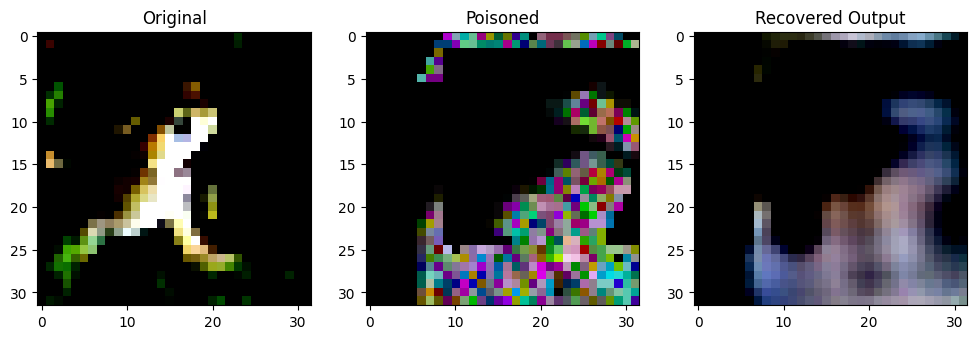

Original Label: tensor(6)
Poisoned Label: tensor(4)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9972631].


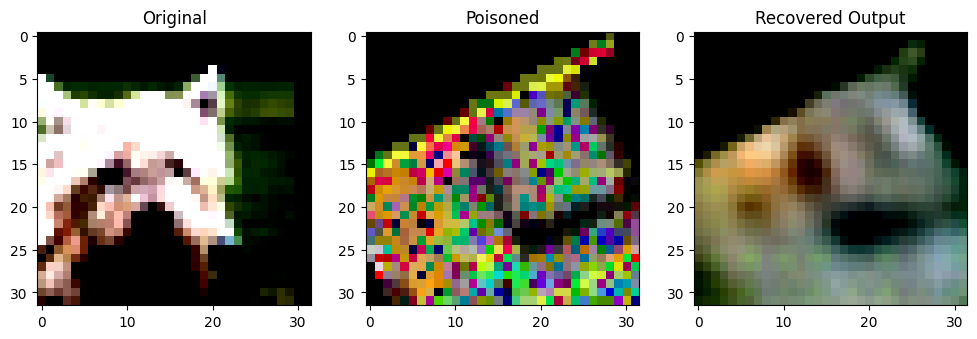

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9996502..0.97959954].


Original Label: tensor(5)
Poisoned Label: tensor(5)


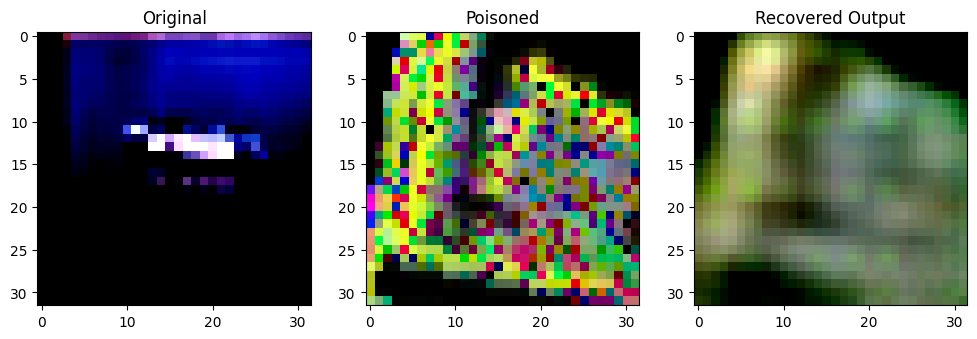

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4440448].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9744303].


Original Label: tensor(8)
Poisoned Label: tensor(2)


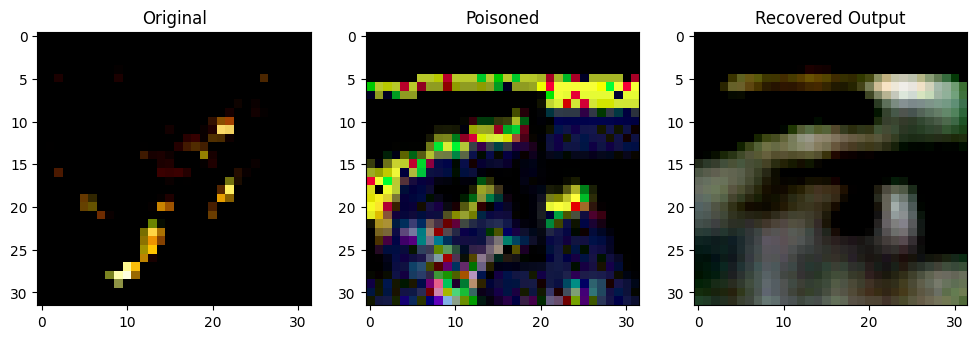

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.0105042].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9975769..0.9904496].


Original Label: tensor(6)
Poisoned Label: tensor(7)


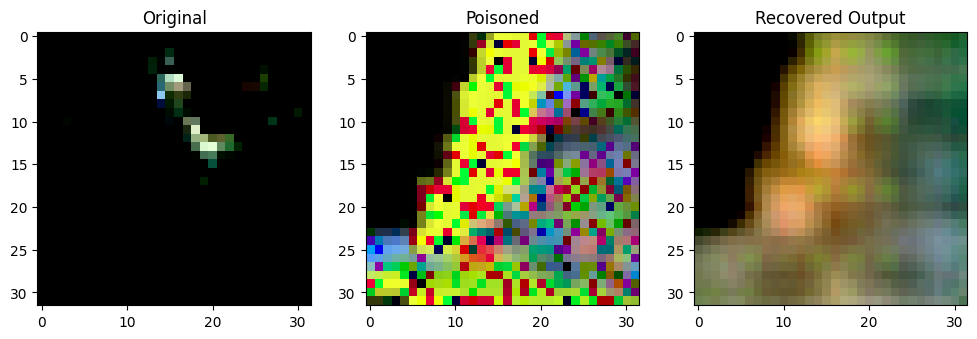

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99950534..0.9961178].


Original Label: tensor(2)
Poisoned Label: tensor(0)


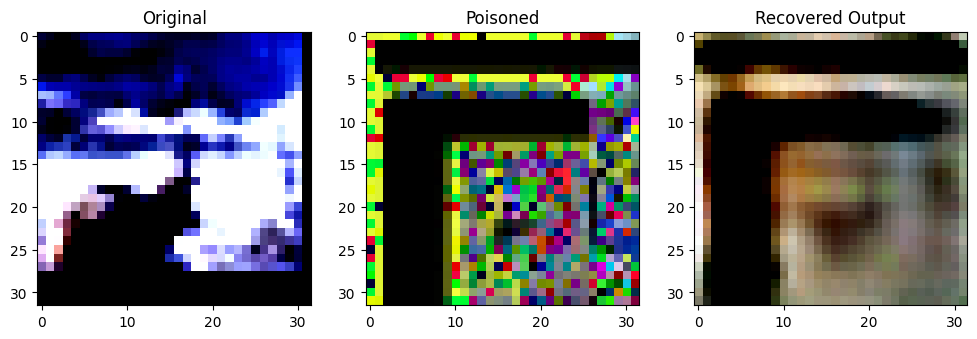

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6917894].


Original Label: tensor(4)
Poisoned Label: tensor(0)


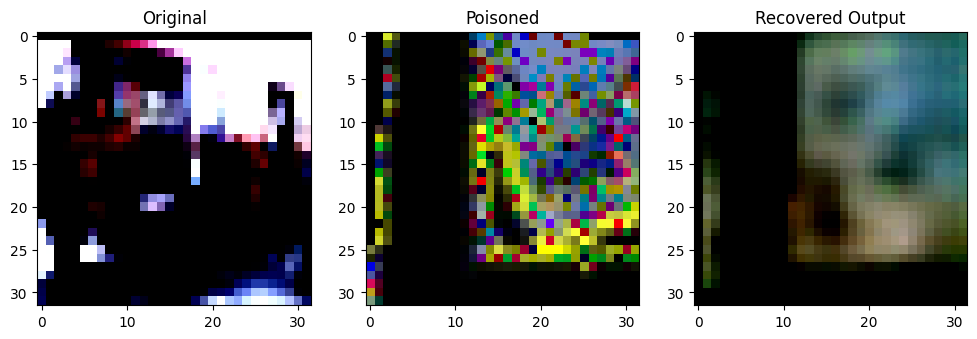

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.3472902..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9992865].


Original Label: tensor(9)
Poisoned Label: tensor(2)


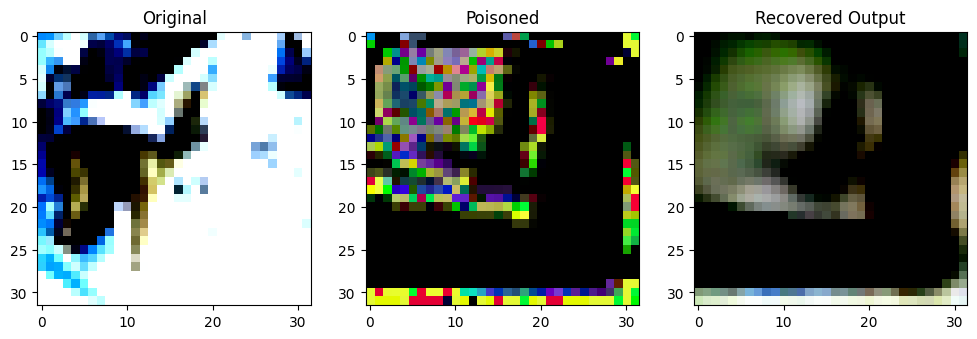

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7917657].


Original Label: tensor(4)
Poisoned Label: tensor(5)


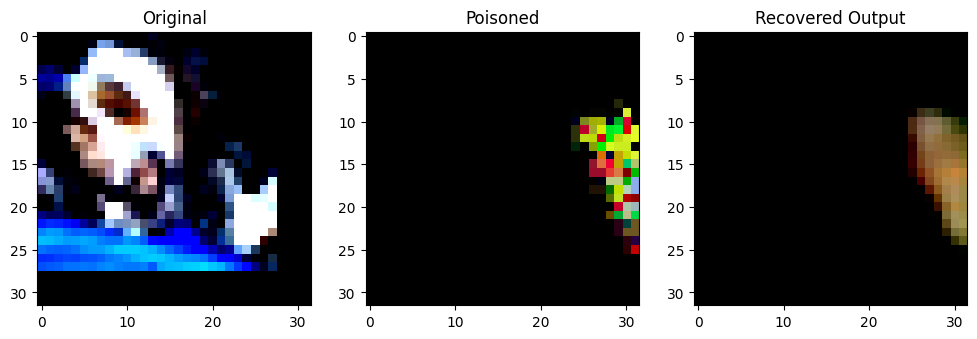

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9745405].


Original Label: tensor(3)
Poisoned Label: tensor(4)


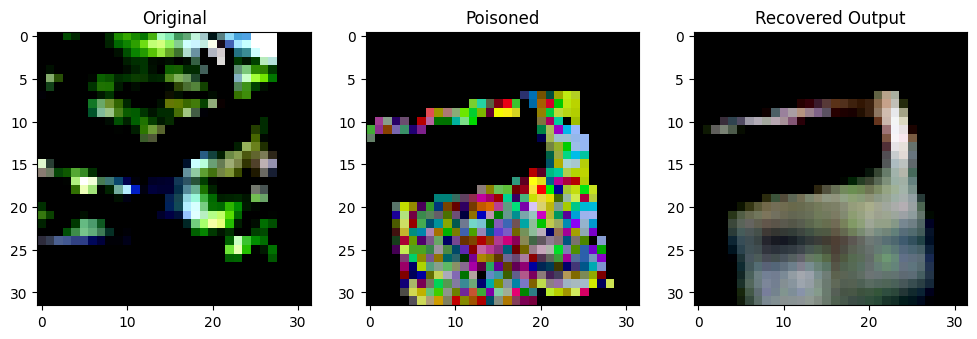

Original Label: tensor(4)
Poisoned Label: tensor(9)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7614897].


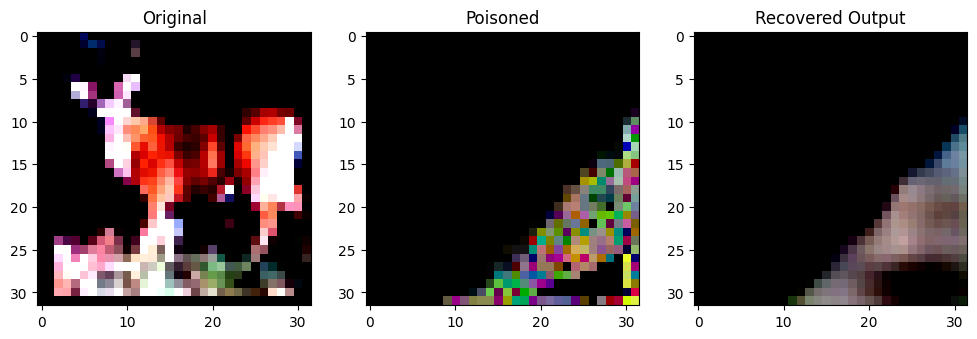

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9995352..0.95990795].


Original Label: tensor(4)
Poisoned Label: tensor(6)


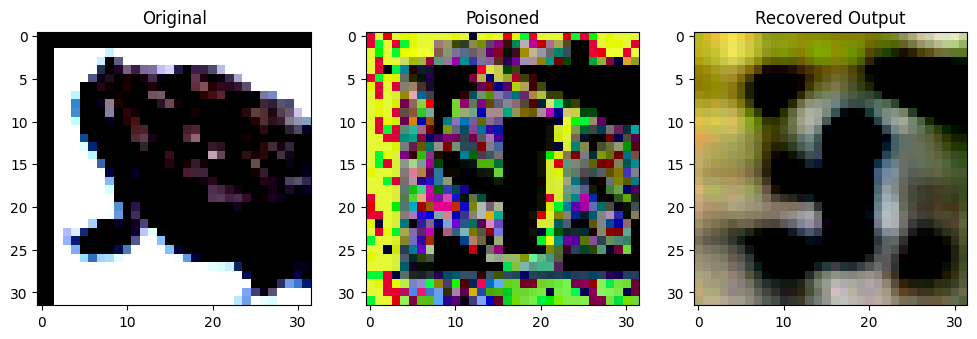

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999942..0.90674186].


Original Label: tensor(6)
Poisoned Label: tensor(8)


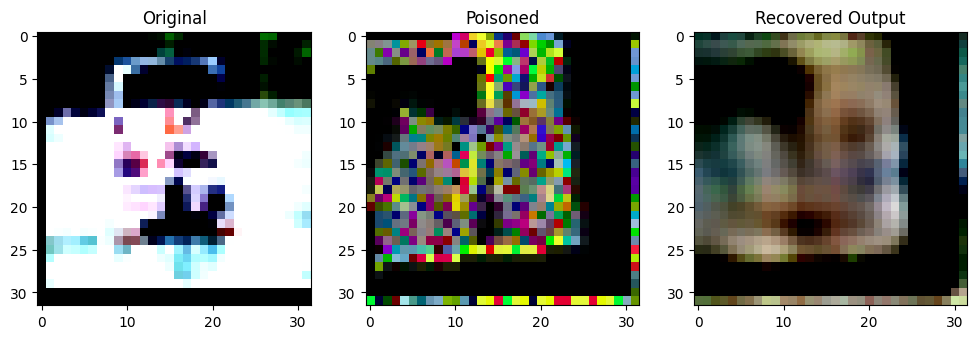

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68879557].


Original Label: tensor(8)
Poisoned Label: tensor(1)


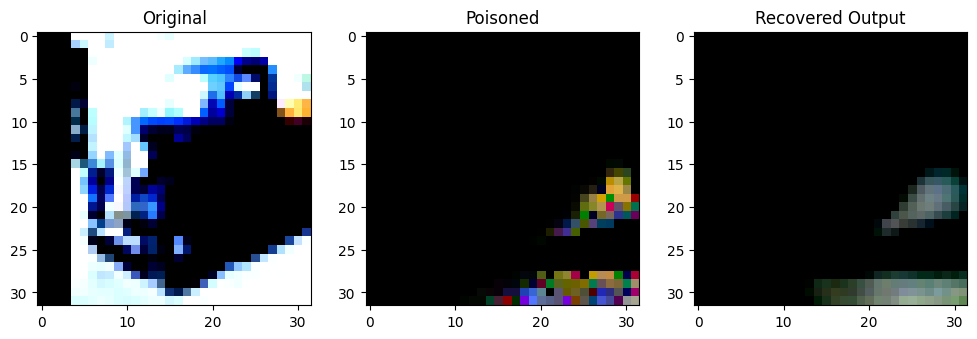

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90429574].


Original Label: tensor(9)
Poisoned Label: tensor(0)


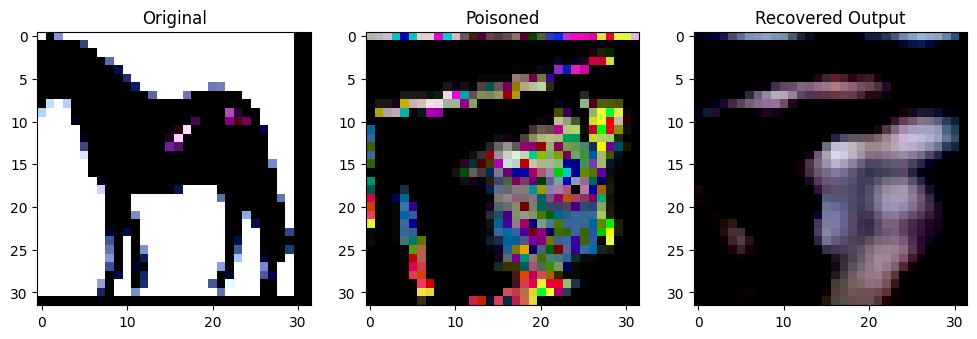

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9428324].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9991082].


Original Label: tensor(7)
Poisoned Label: tensor(0)


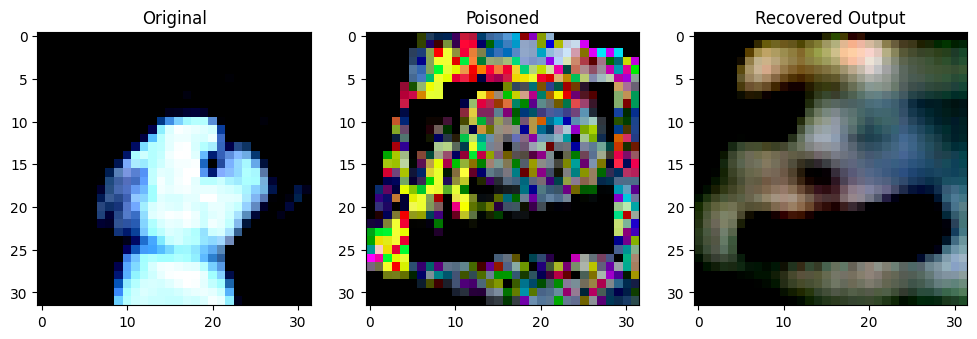

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.235994].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6569264].


Original Label: tensor(5)
Poisoned Label: tensor(8)


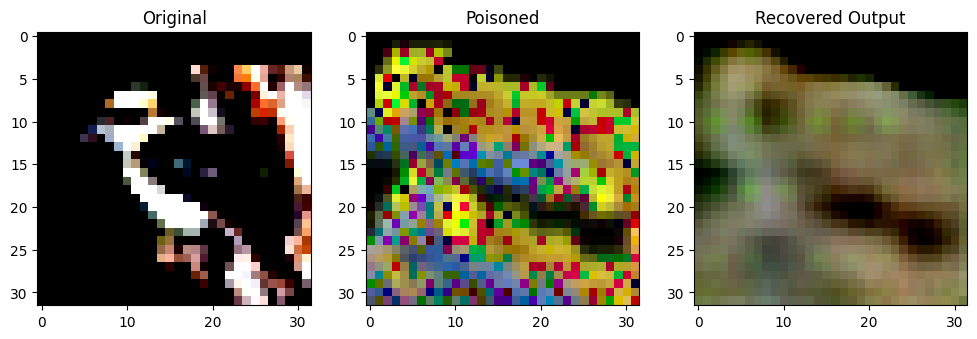

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6556606].


Original Label: tensor(2)
Poisoned Label: tensor(5)


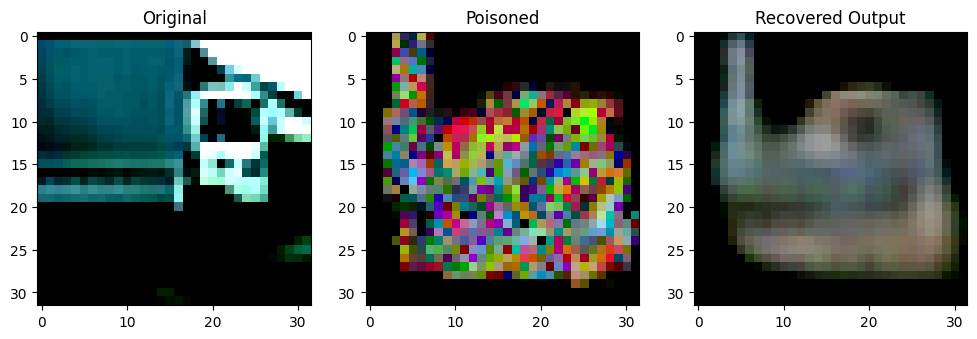

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9996867..0.6661701].


Original Label: tensor(9)
Poisoned Label: tensor(6)


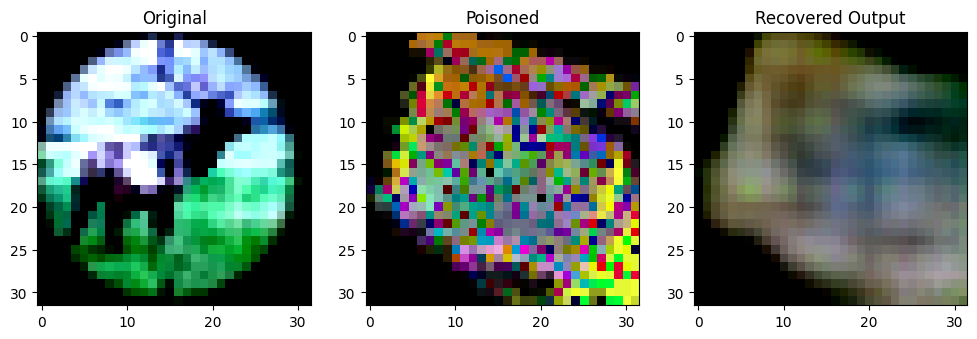

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.87767184].


Original Label: tensor(4)
Poisoned Label: tensor(5)


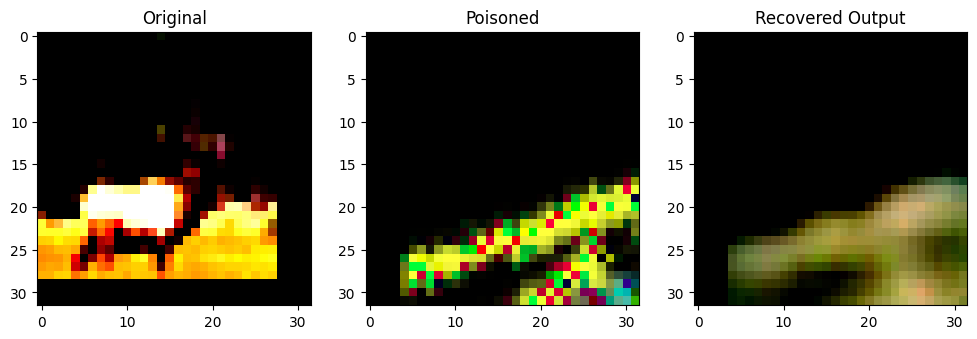

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9295317..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91693205].


Original Label: tensor(4)
Poisoned Label: tensor(8)


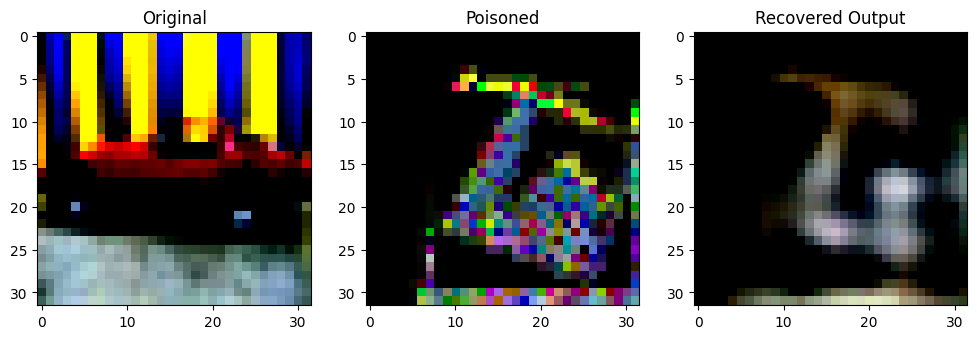

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2317834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99998426].


Original Label: tensor(1)
Poisoned Label: tensor(3)


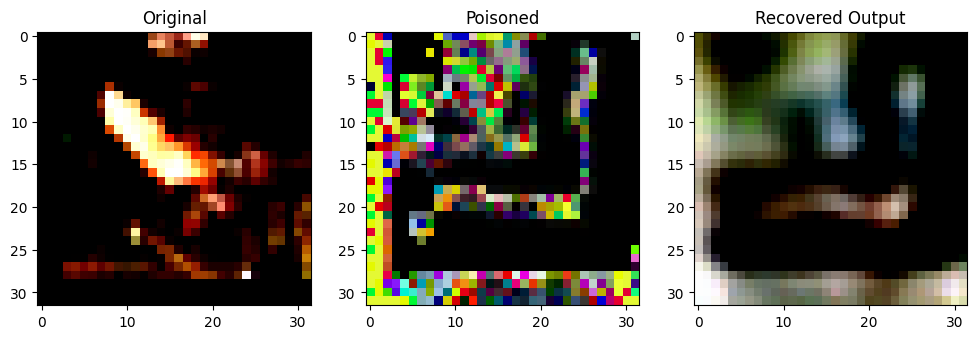

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1804092].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99434584].


Original Label: tensor(6)
Poisoned Label: tensor(1)


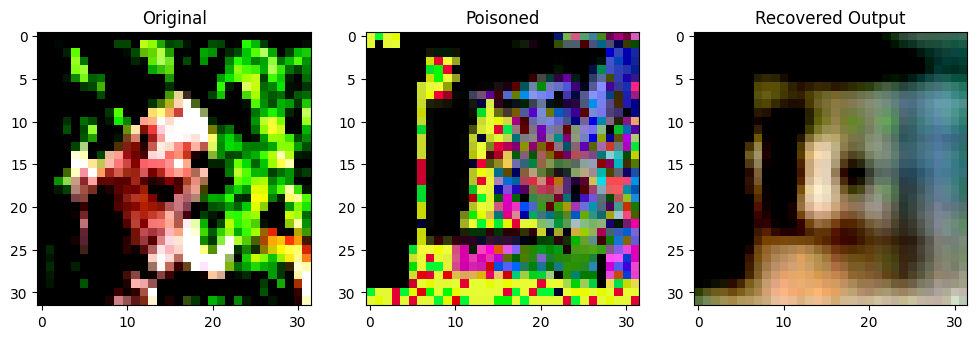

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99996257..0.7233603].


Original Label: tensor(6)
Poisoned Label: tensor(6)


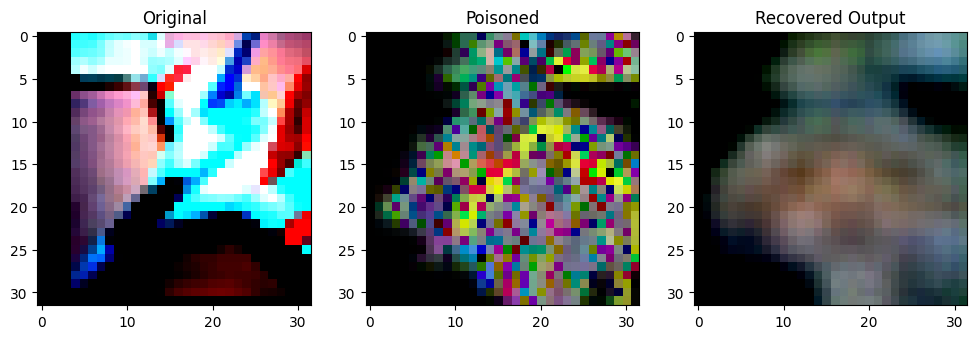

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70675683].


Original Label: tensor(0)
Poisoned Label: tensor(1)


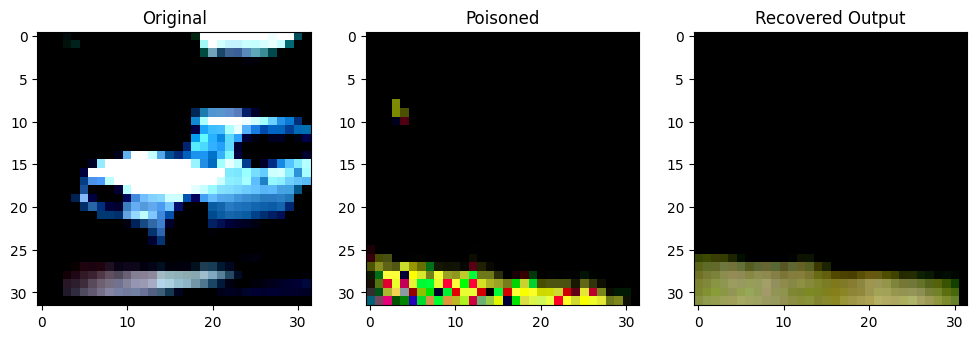

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6813945].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9997687].


Original Label: tensor(1)
Poisoned Label: tensor(3)


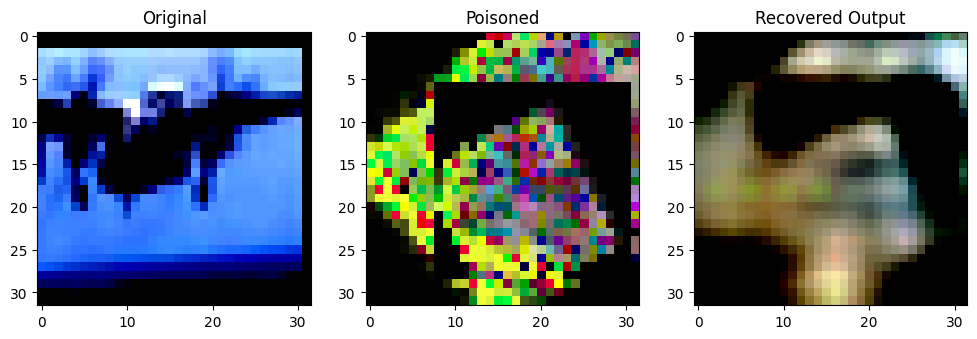

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92967796].


Original Label: tensor(0)
Poisoned Label: tensor(4)


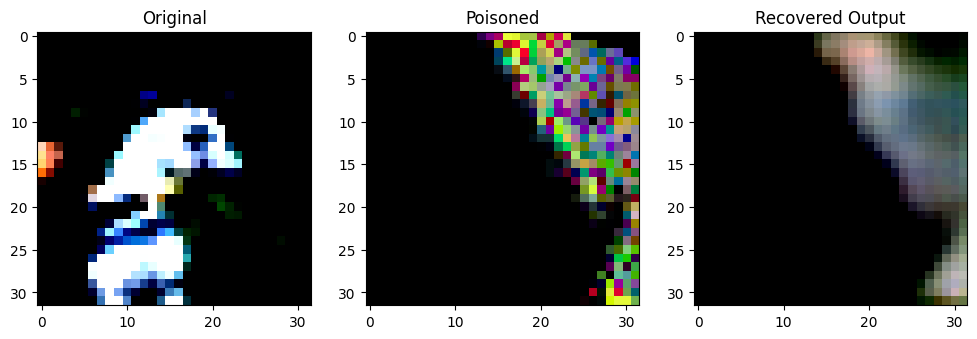

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9287905].


Original Label: tensor(7)
Poisoned Label: tensor(1)


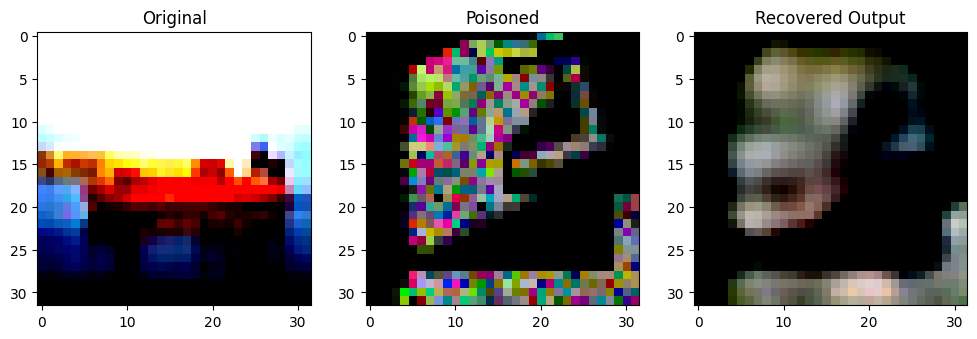

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8864398].


Original Label: tensor(8)
Poisoned Label: tensor(9)


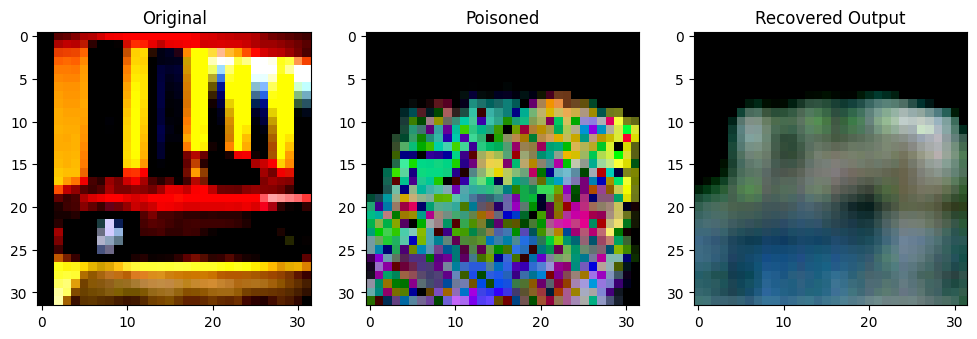

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7068989].


Original Label: tensor(1)
Poisoned Label: tensor(6)


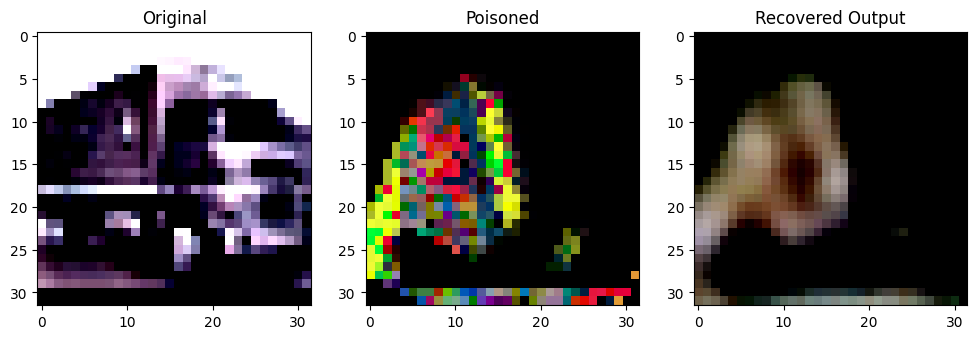

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8526839].


Original Label: tensor(9)
Poisoned Label: tensor(2)


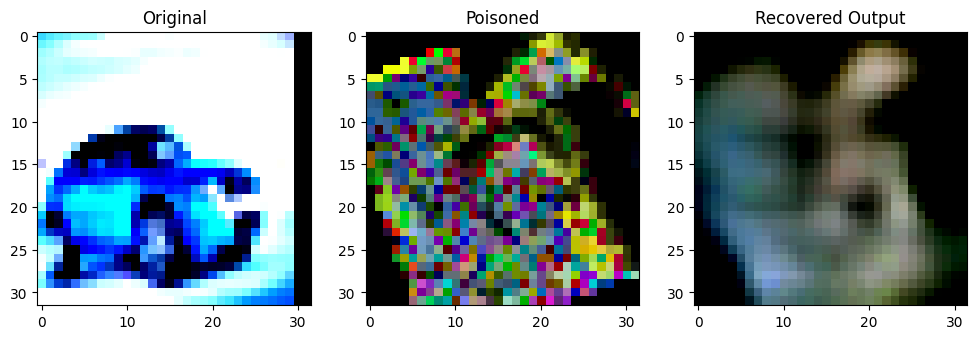

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99991196..0.9545224].


Original Label: tensor(1)
Poisoned Label: tensor(7)


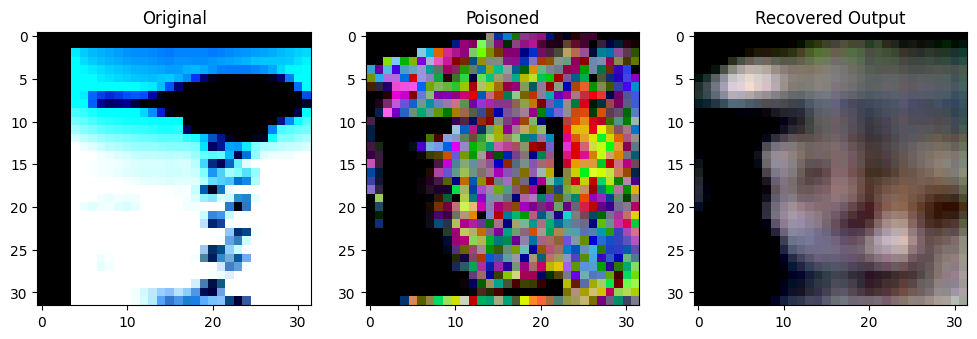

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7730604].


Original Label: tensor(0)
Poisoned Label: tensor(9)


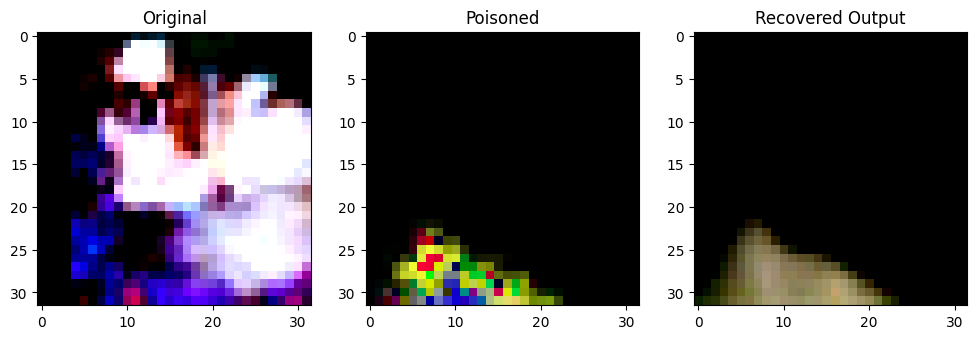

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9020473].


Original Label: tensor(5)
Poisoned Label: tensor(9)


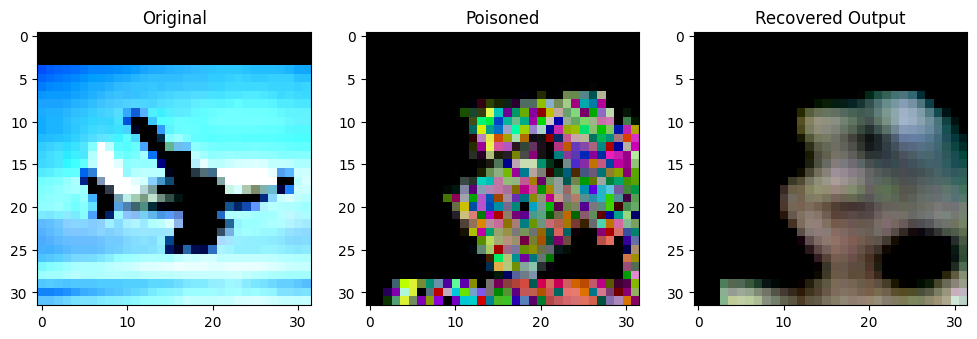

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7179923].


Original Label: tensor(0)
Poisoned Label: tensor(2)


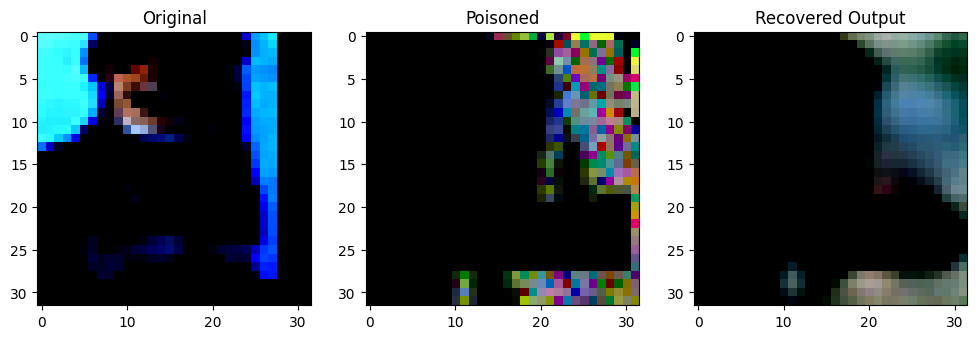

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7830311].


Original Label: tensor(5)
Poisoned Label: tensor(8)


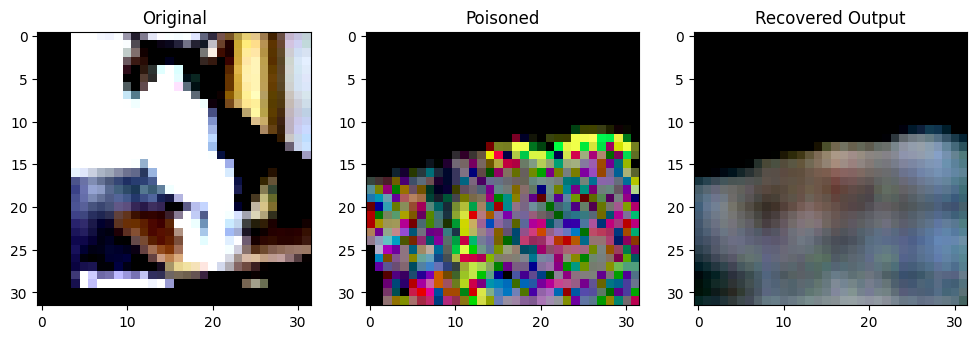

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.887539].


Original Label: tensor(3)
Poisoned Label: tensor(2)


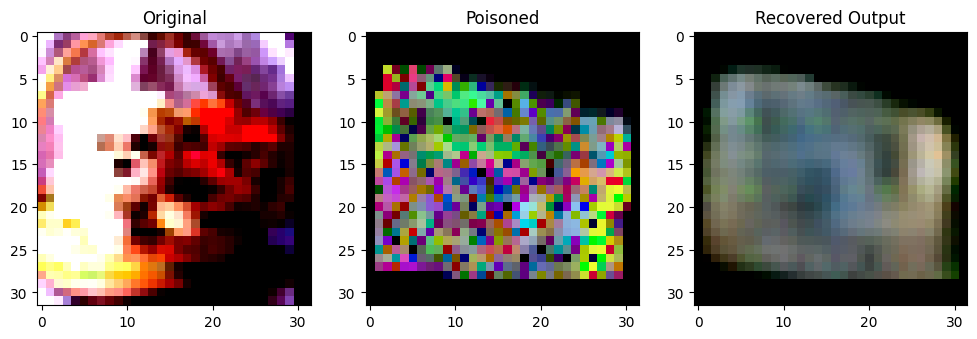

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0084033].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8140389].


Original Label: tensor(5)
Poisoned Label: tensor(8)


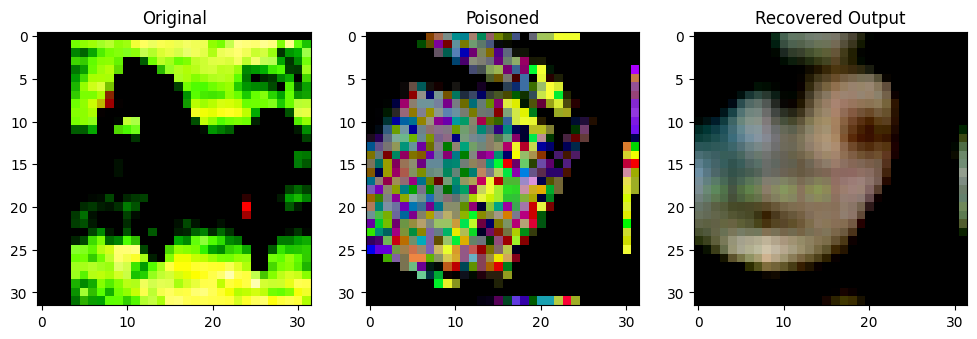

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8177171].


Original Label: tensor(7)
Poisoned Label: tensor(3)


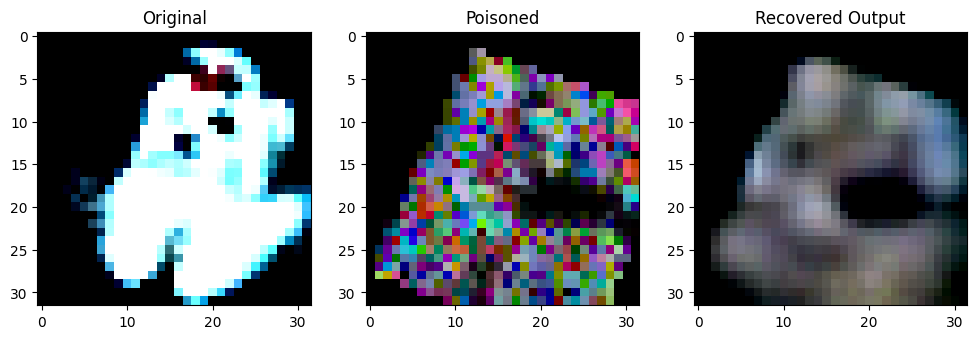

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5245317].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8960794].


Original Label: tensor(5)
Poisoned Label: tensor(4)


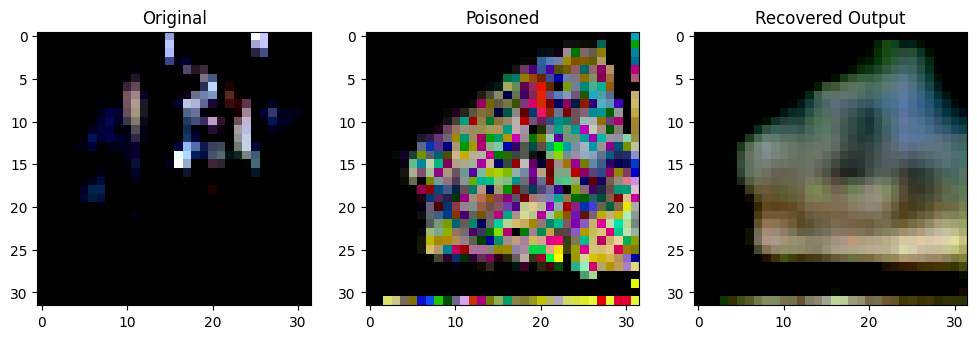

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0996952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84922874].


Original Label: tensor(4)
Poisoned Label: tensor(9)


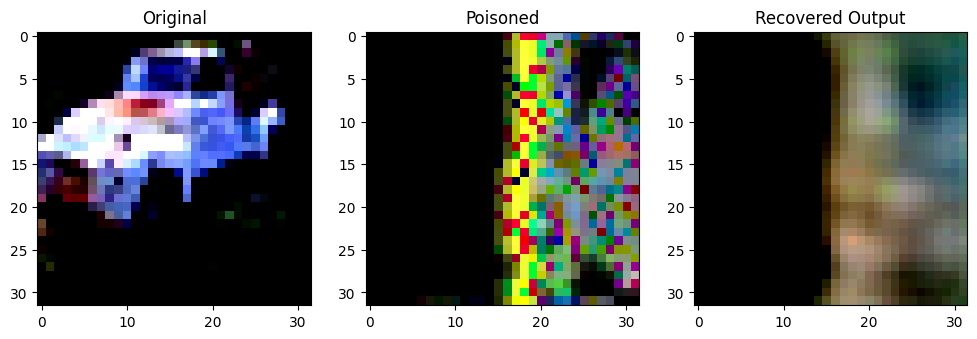

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.95798326].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69499886].


Original Label: tensor(9)
Poisoned Label: tensor(5)


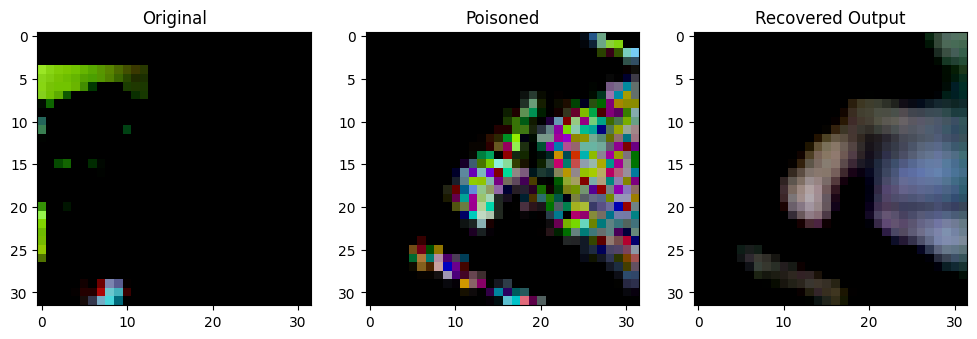

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6837914].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92450905].


Original Label: tensor(3)
Poisoned Label: tensor(0)


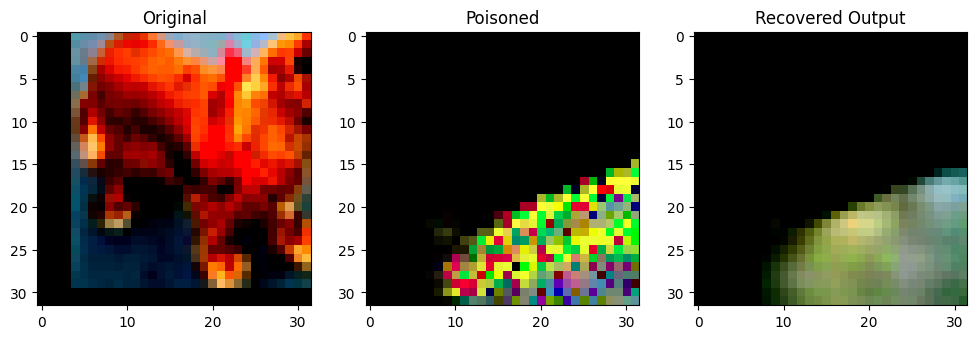

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70960486].


Original Label: tensor(5)
Poisoned Label: tensor(6)


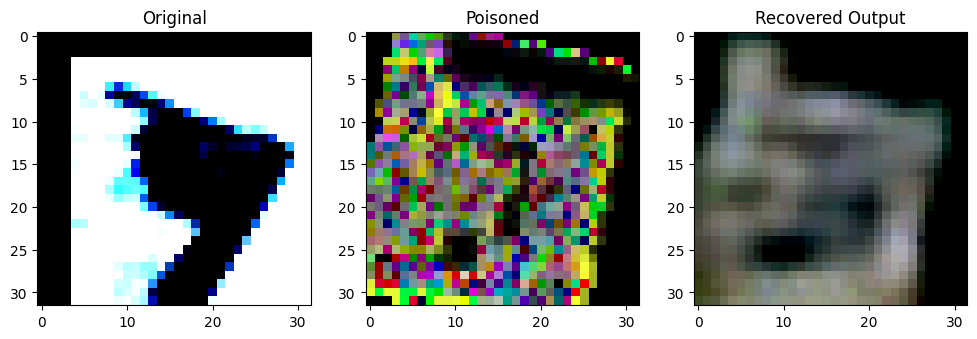

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8560159].


Original Label: tensor(0)
Poisoned Label: tensor(2)


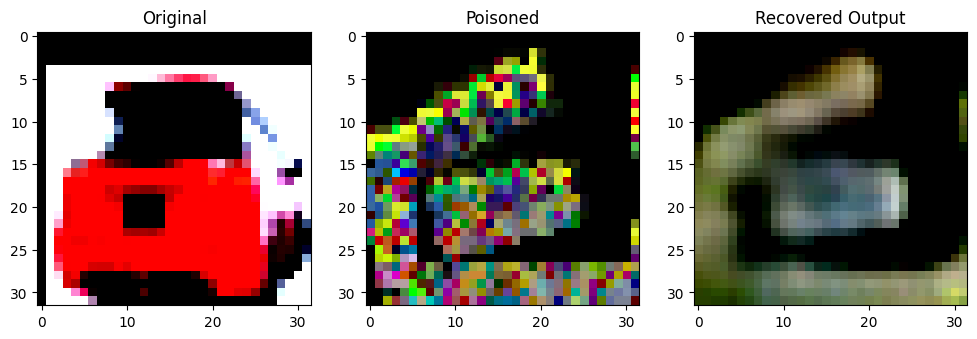

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9568407].


Original Label: tensor(1)
Poisoned Label: tensor(2)


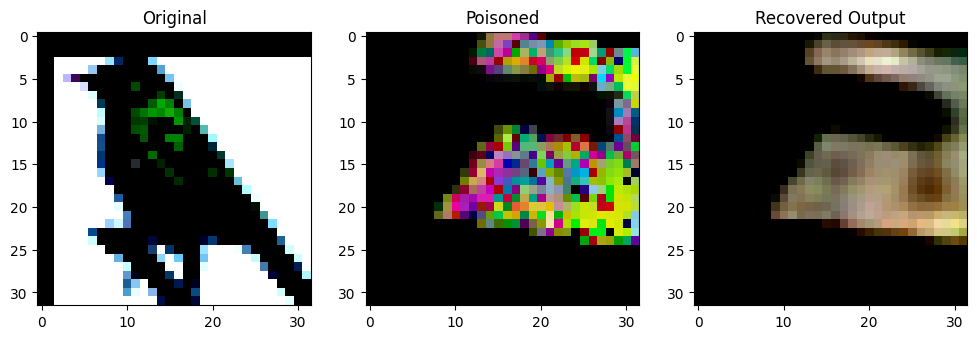

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6152923].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.999962].


Original Label: tensor(2)
Poisoned Label: tensor(5)


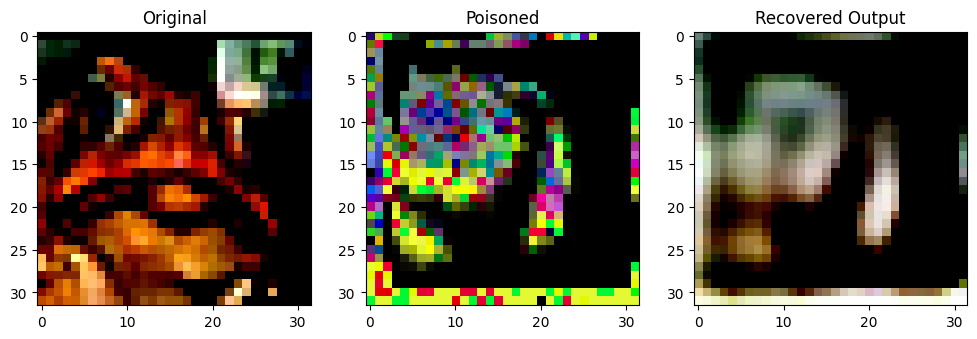

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9733893].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8232107].


Original Label: tensor(6)
Poisoned Label: tensor(4)


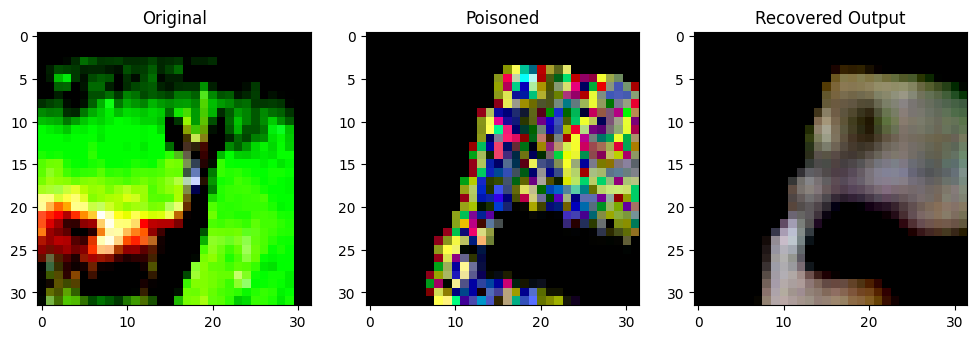

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4954191].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88672125].


Original Label: tensor(4)
Poisoned Label: tensor(5)


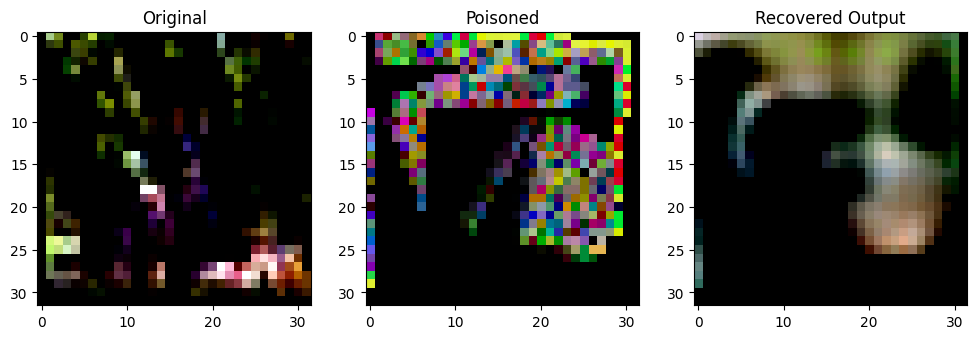

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8590291].


Original Label: tensor(4)
Poisoned Label: tensor(8)


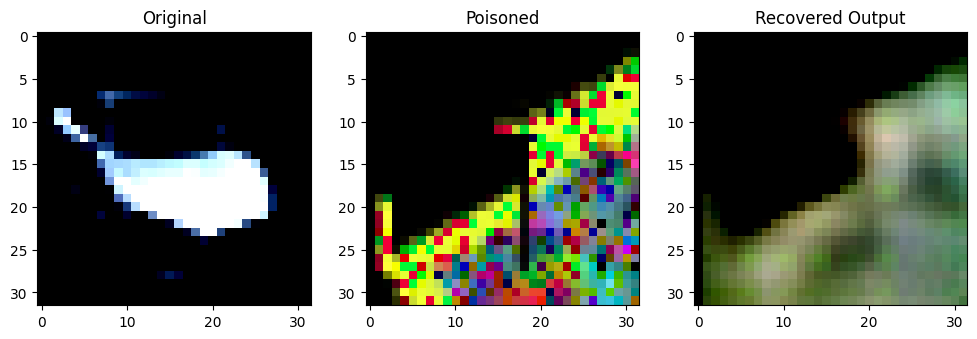

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6666666].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8298621].


Original Label: tensor(1)
Poisoned Label: tensor(8)


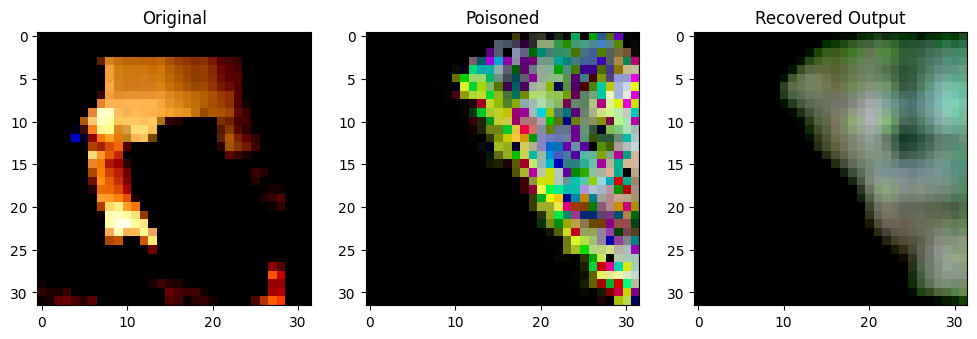

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999993].


Original Label: tensor(3)
Poisoned Label: tensor(2)


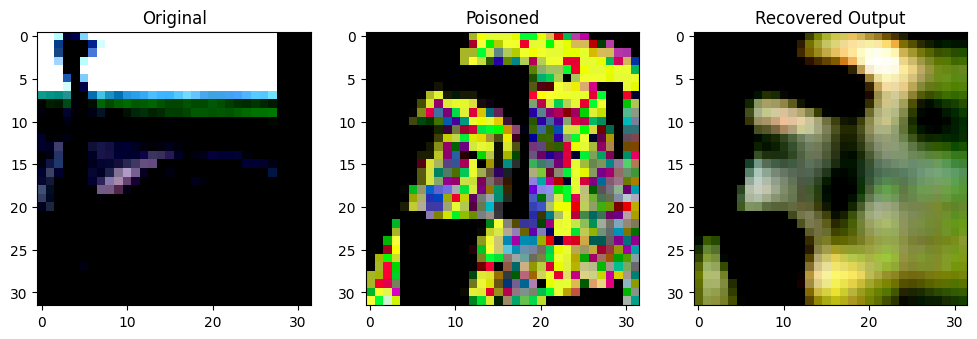

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99958014].


Original Label: tensor(2)
Poisoned Label: tensor(0)


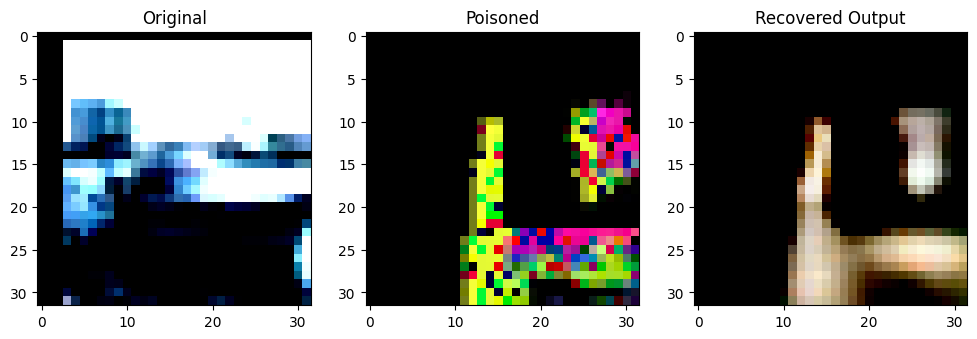

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.943445].


Original Label: tensor(8)
Poisoned Label: tensor(1)


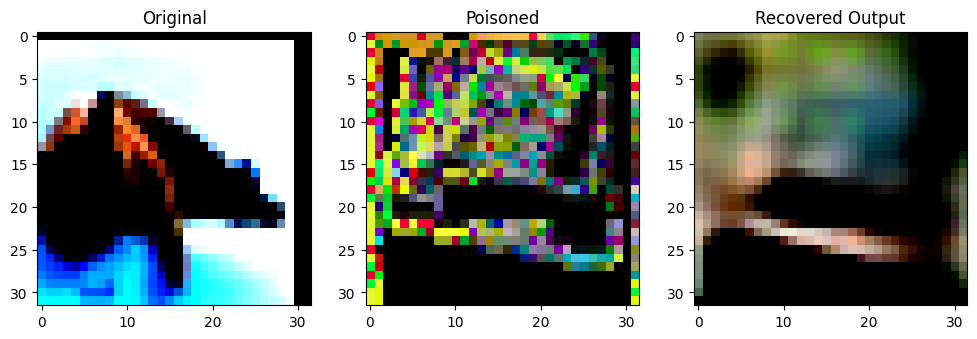

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3262744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83745253].


Original Label: tensor(3)
Poisoned Label: tensor(1)


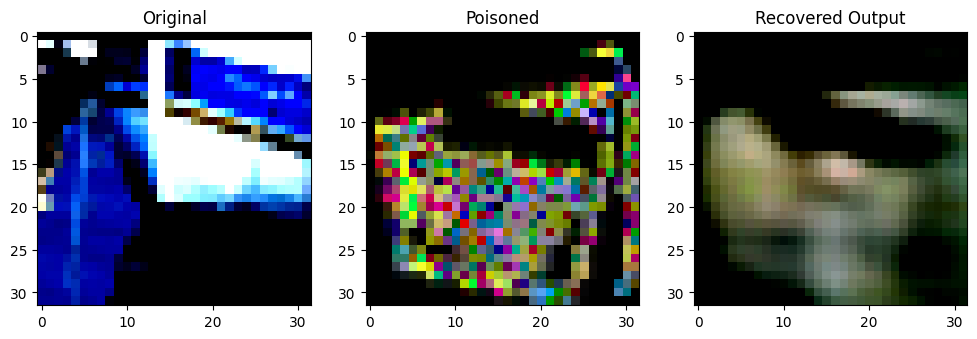

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(8)
Poisoned Label: tensor(4)


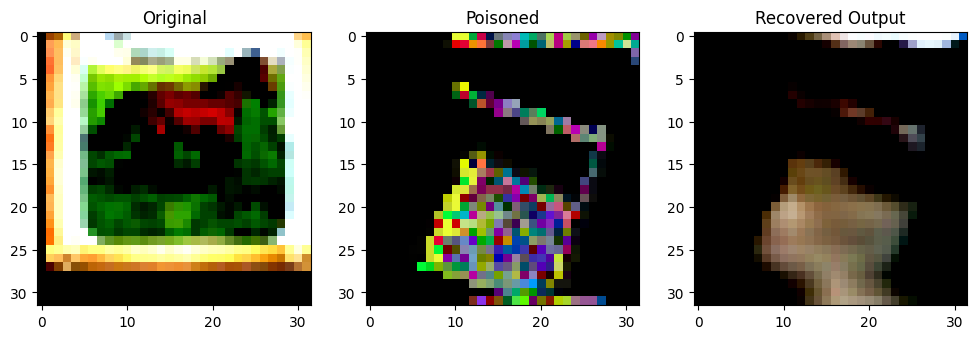

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.998907].


Original Label: tensor(7)
Poisoned Label: tensor(8)


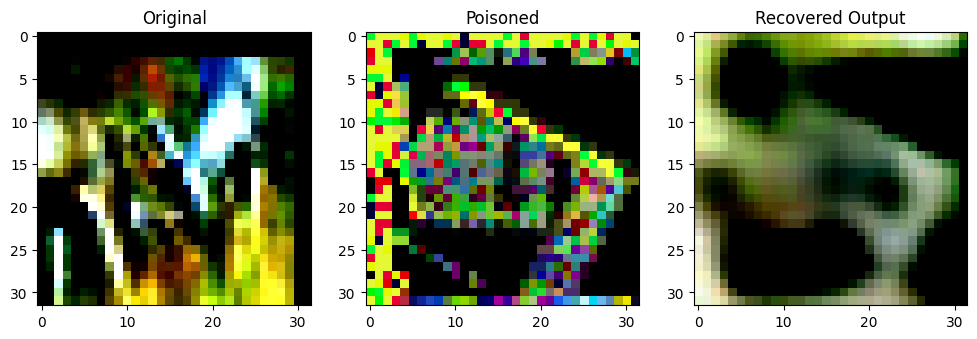

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99925786].


Original Label: tensor(4)
Poisoned Label: tensor(5)


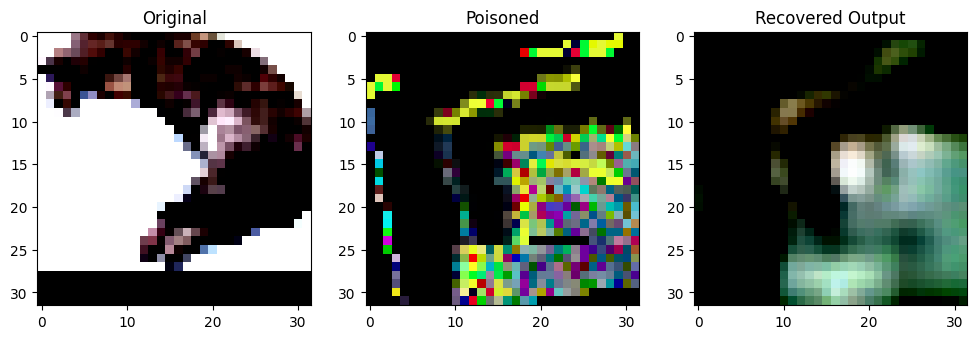

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70683193].


Original Label: tensor(3)
Poisoned Label: tensor(1)


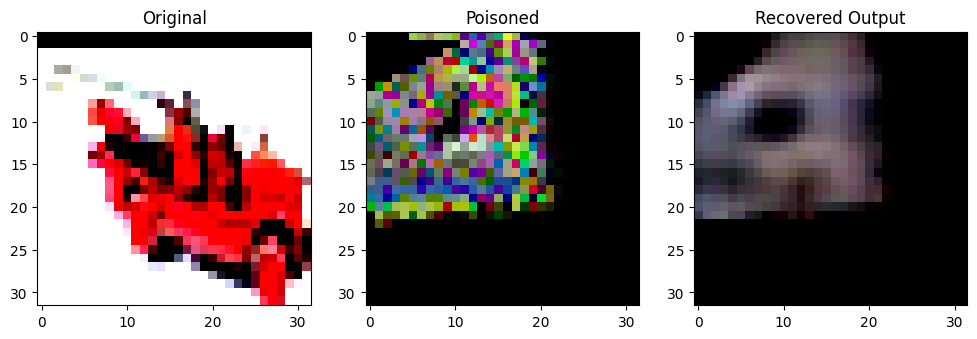

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68116784].


Original Label: tensor(9)
Poisoned Label: tensor(5)


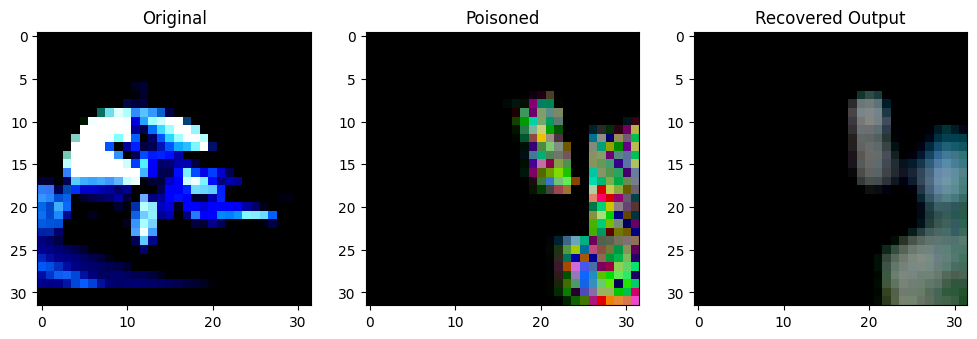

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3241715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8769585..0.94649565].


Original Label: tensor(1)
Poisoned Label: tensor(2)


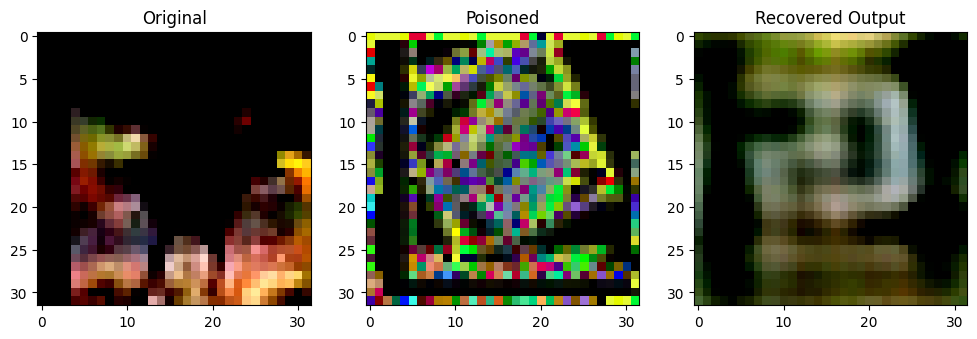

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.751405].


Original Label: tensor(4)
Poisoned Label: tensor(0)


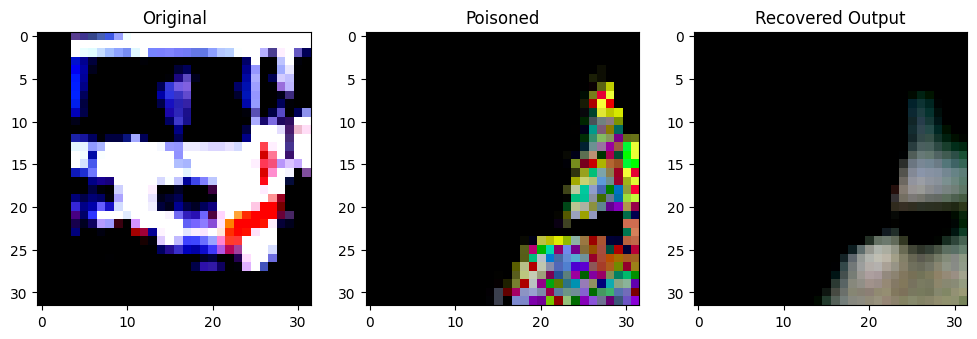

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0947855].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7839953].


Original Label: tensor(9)
Poisoned Label: tensor(6)


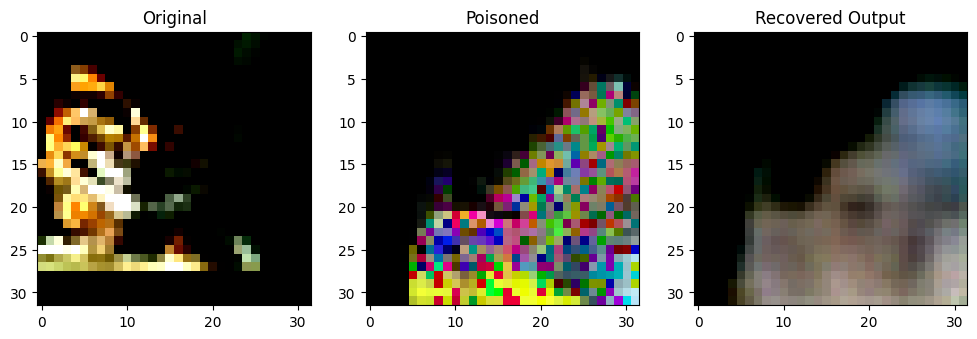

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8238656].


Original Label: tensor(3)
Poisoned Label: tensor(7)


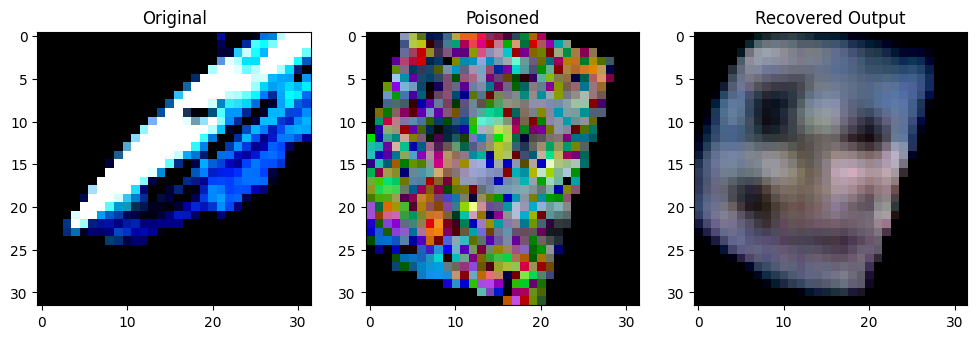

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7470074].


Original Label: tensor(8)
Poisoned Label: tensor(4)


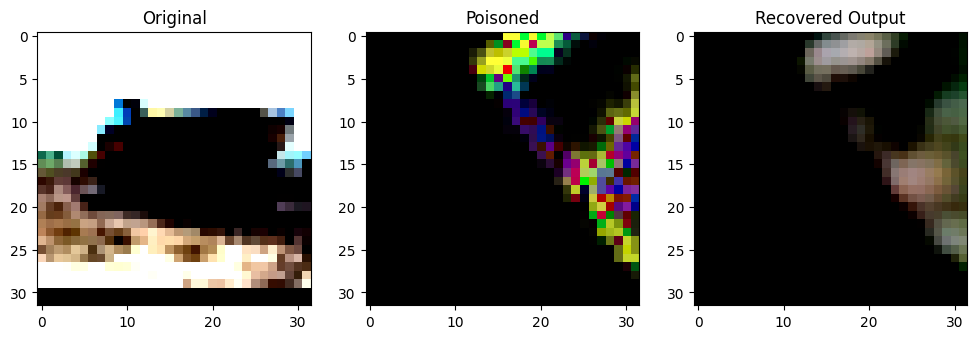

Original Label: tensor(9)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3502399].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7177899].


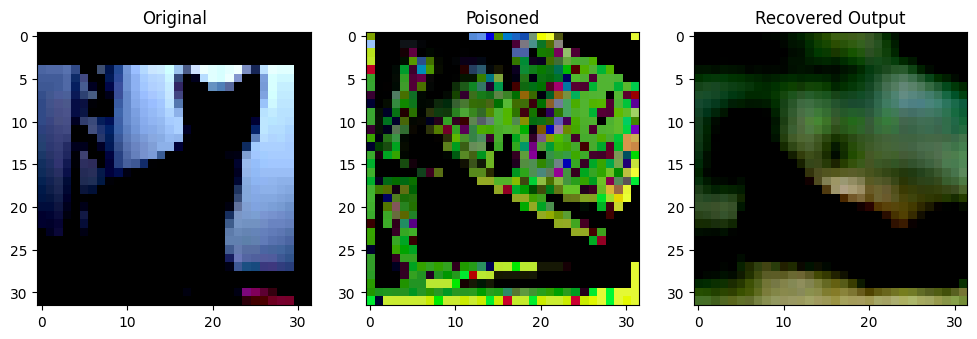

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86267734].


Original Label: tensor(3)
Poisoned Label: tensor(8)


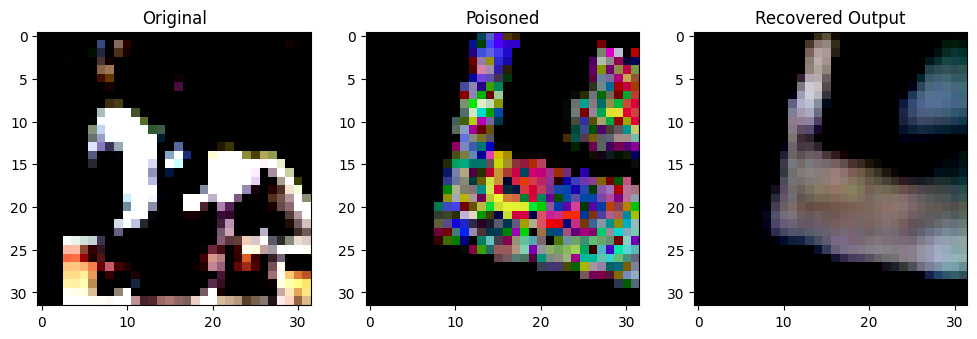

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999945].


Original Label: tensor(7)
Poisoned Label: tensor(0)


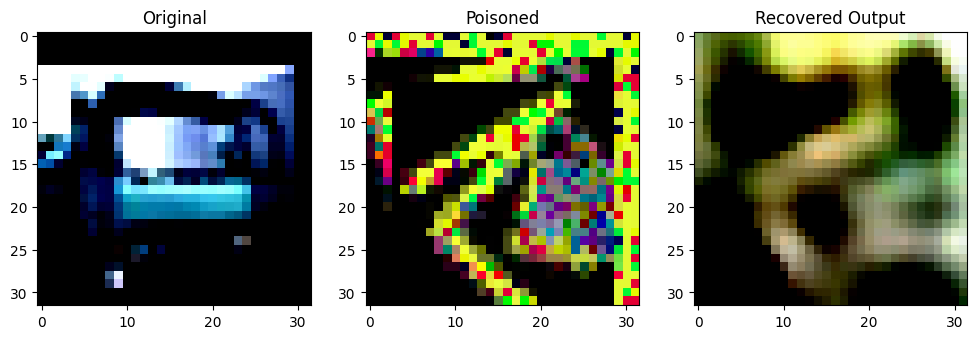

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9655569].


Original Label: tensor(9)
Poisoned Label: tensor(9)


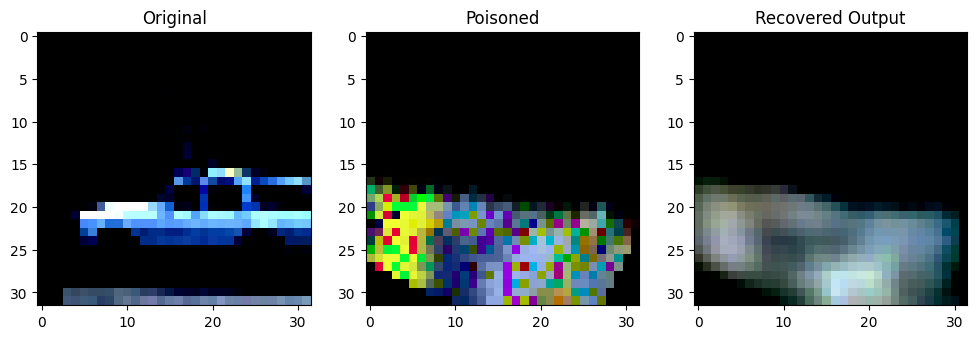

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9994867].


Original Label: tensor(1)
Poisoned Label: tensor(2)


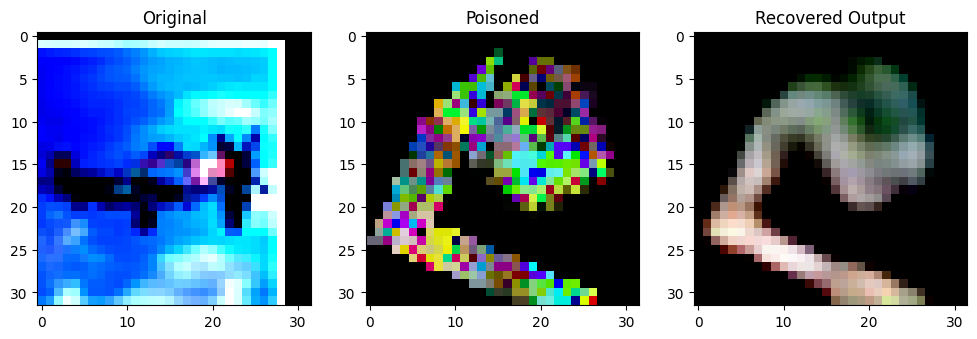

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98330057].


Original Label: tensor(0)
Poisoned Label: tensor(7)


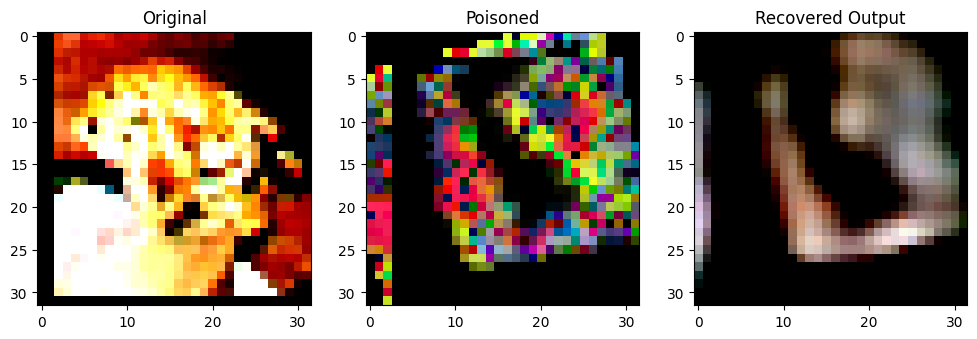

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1975338].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7975954].


Original Label: tensor(6)
Poisoned Label: tensor(7)


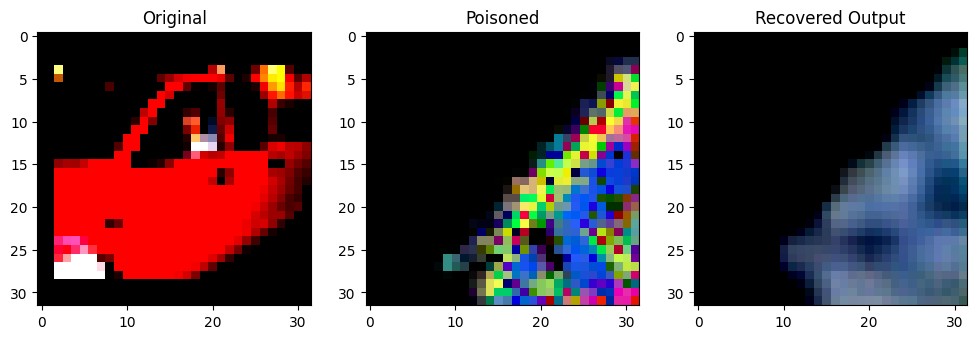

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0084033].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99910444].


Original Label: tensor(1)
Poisoned Label: tensor(0)


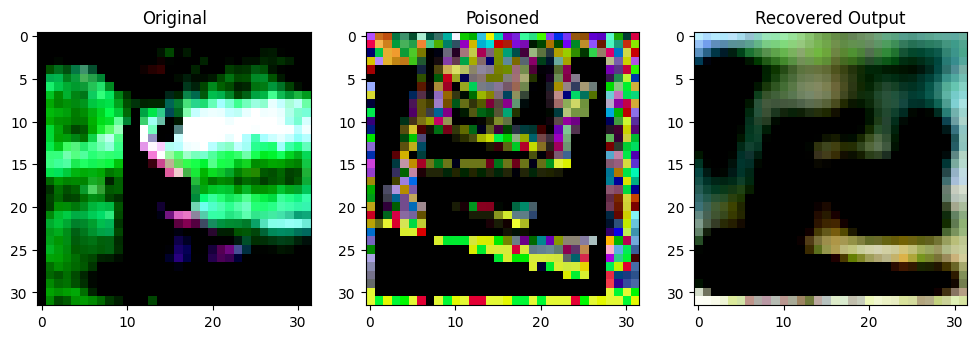

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99180526].


Original Label: tensor(4)
Poisoned Label: tensor(6)


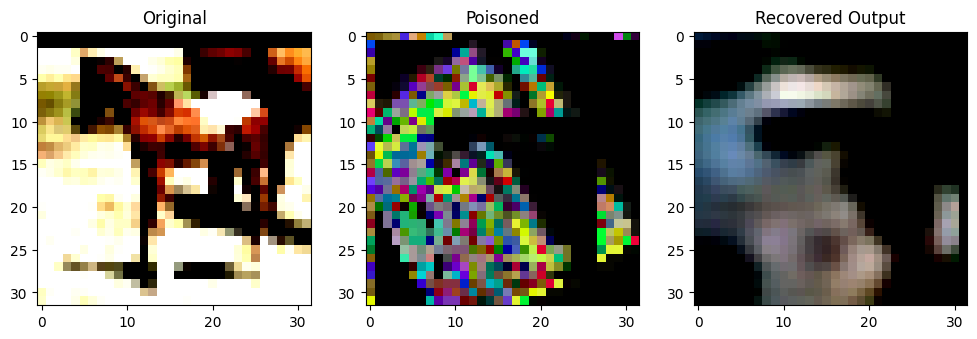

Original Label: tensor(7)
Poisoned Label: tensor(6)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3850982].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.40303802..0.6904417].


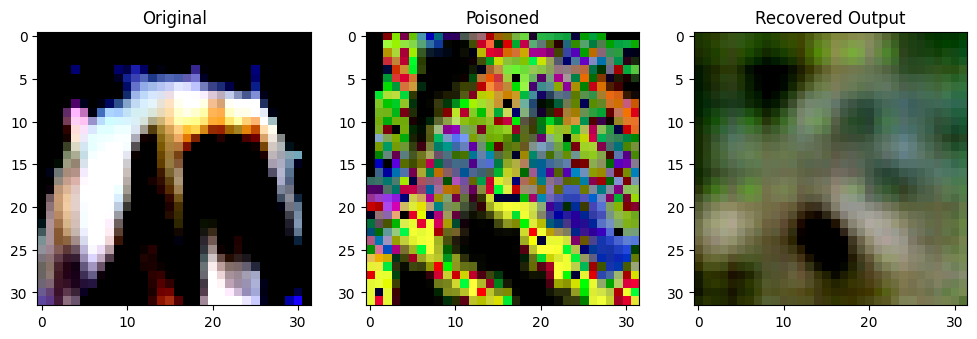

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99756145].


Original Label: tensor(5)
Poisoned Label: tensor(4)


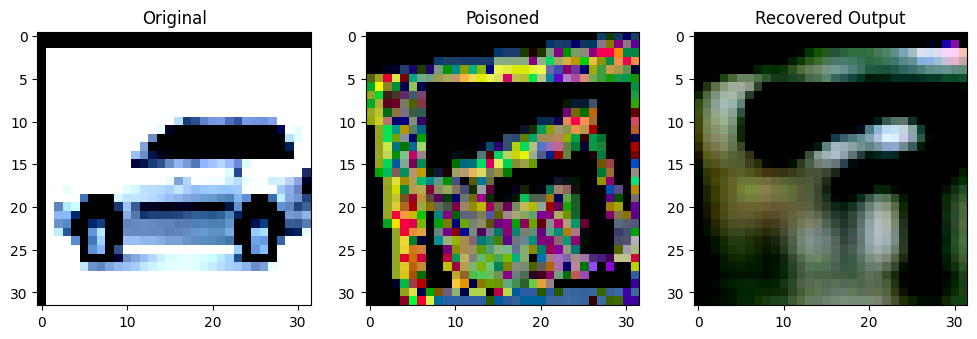

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..-0.99975705].


Original Label: tensor(1)
Poisoned Label: tensor(8)


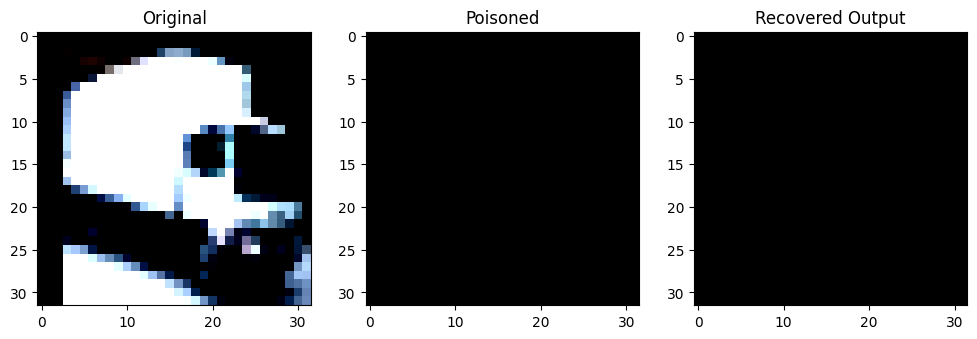

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.59812343].


Original Label: tensor(9)
Poisoned Label: tensor(7)


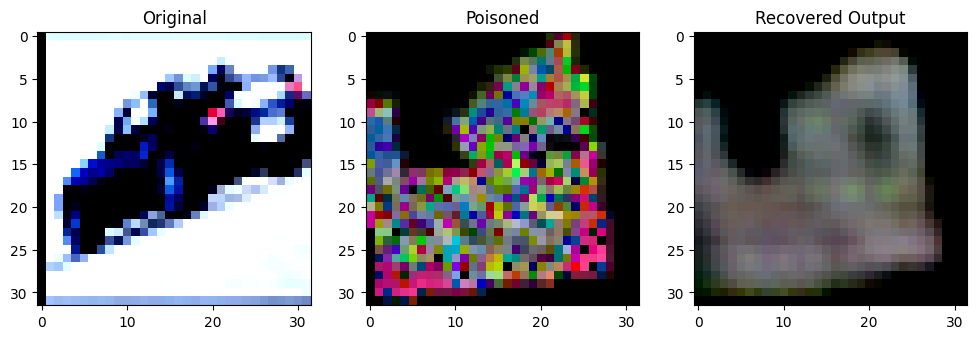

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77365637].


Original Label: tensor(1)
Poisoned Label: tensor(4)


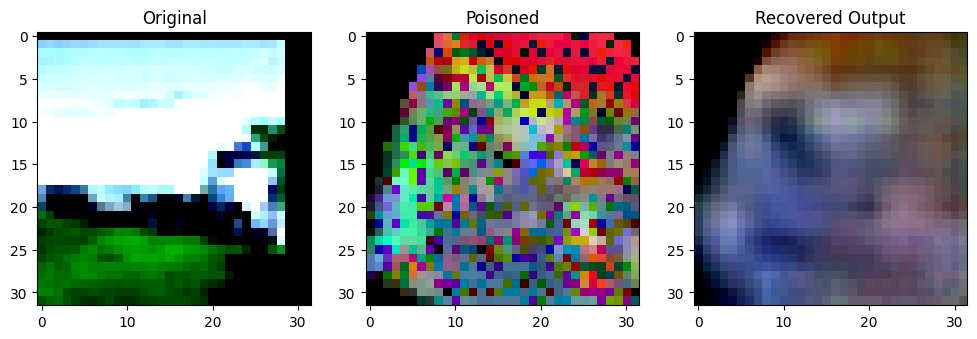

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5810429].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6720504].


Original Label: tensor(9)
Poisoned Label: tensor(4)


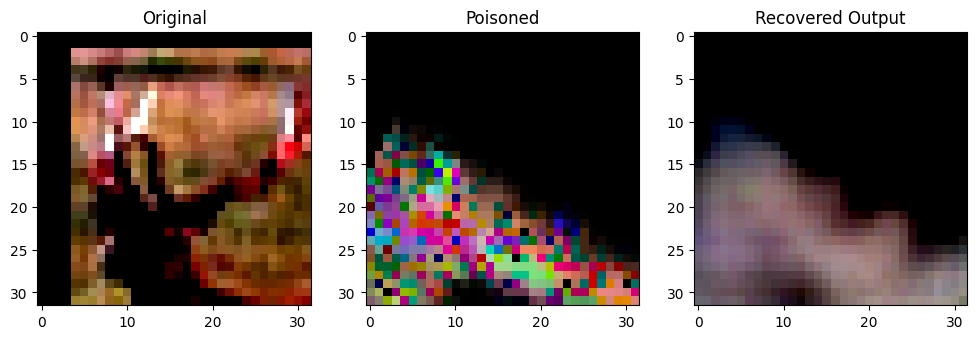

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84766614].


Original Label: tensor(4)
Poisoned Label: tensor(1)


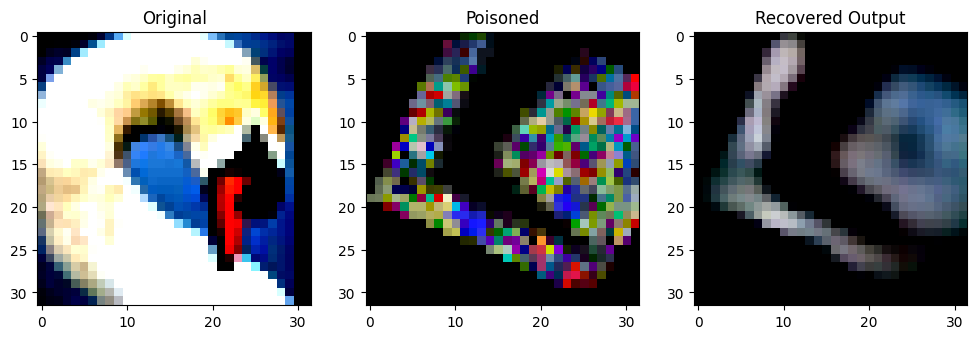

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8121339].


Original Label: tensor(2)
Poisoned Label: tensor(2)


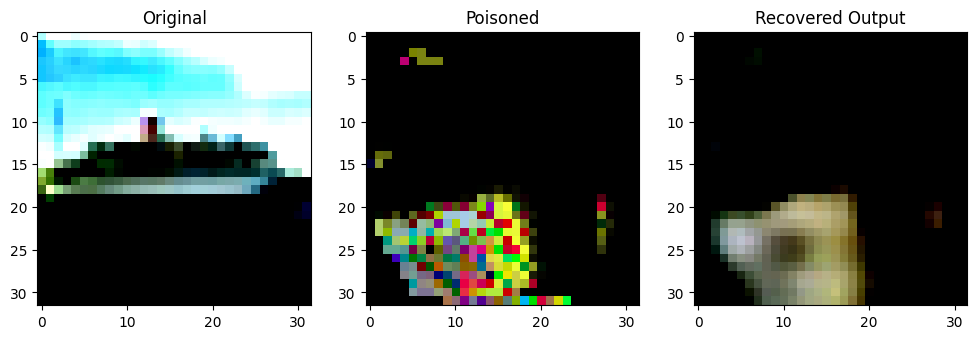

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7511113].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97174686].


Original Label: tensor(8)
Poisoned Label: tensor(6)


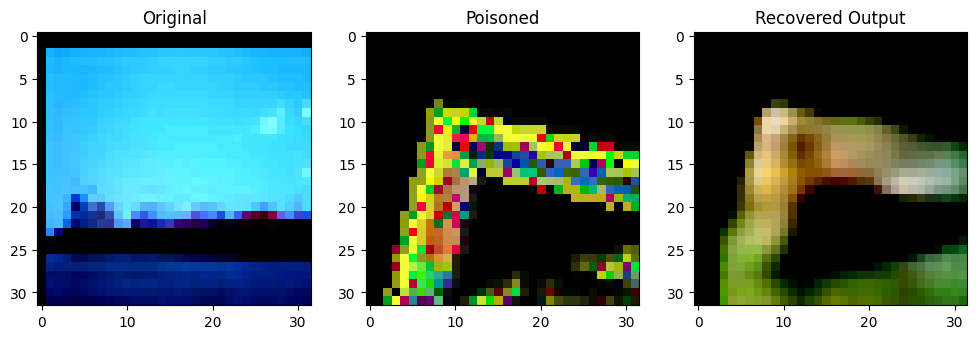

Original Label: tensor(8)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72015417].


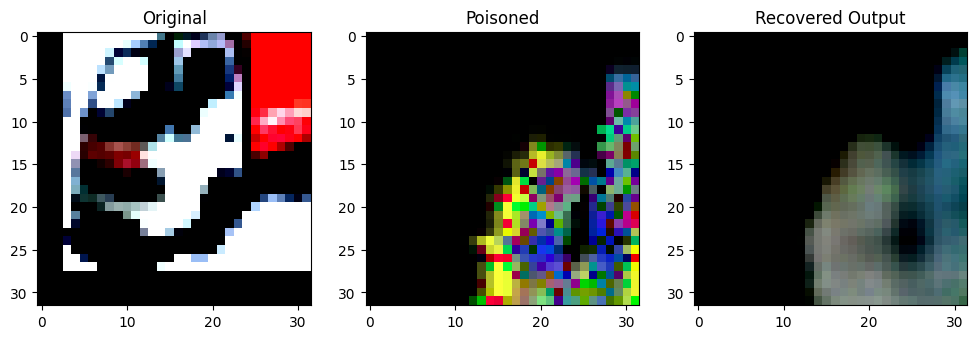

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6303342].


Original Label: tensor(9)
Poisoned Label: tensor(7)


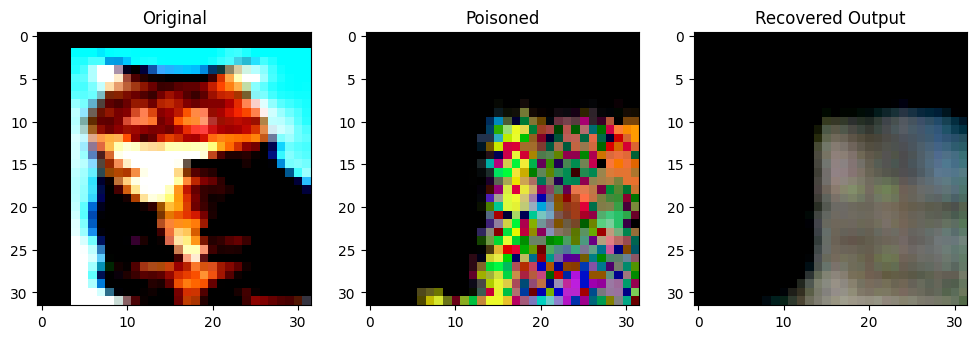

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94752467].


Original Label: tensor(3)
Poisoned Label: tensor(9)


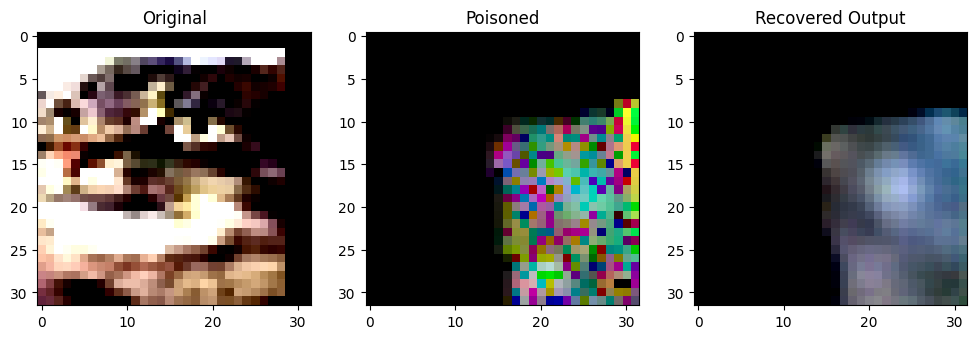

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.9988013].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9939212].


Original Label: tensor(3)
Poisoned Label: tensor(7)


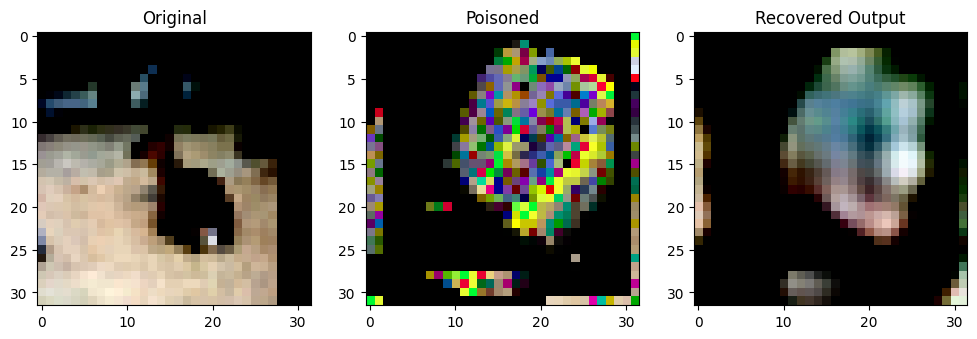

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9064132].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7330044].


Original Label: tensor(4)
Poisoned Label: tensor(1)


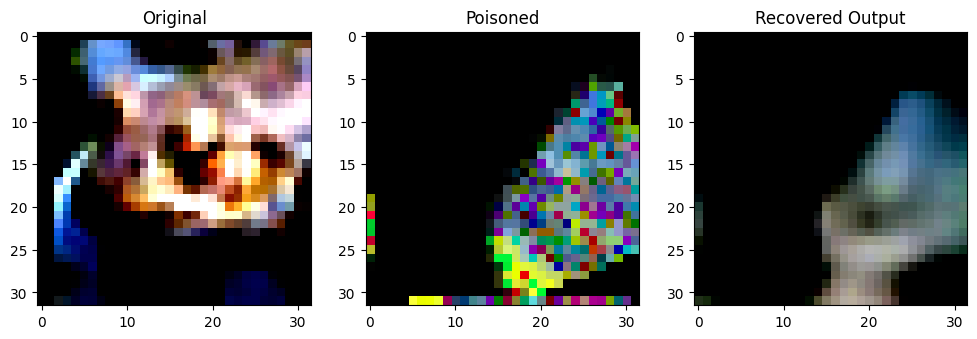

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3431373].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9959621].


Original Label: tensor(6)
Poisoned Label: tensor(6)


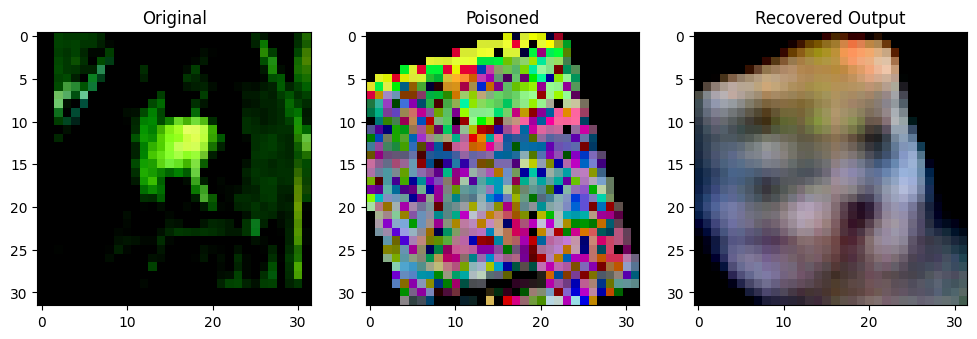

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7032262].


Original Label: tensor(6)
Poisoned Label: tensor(0)


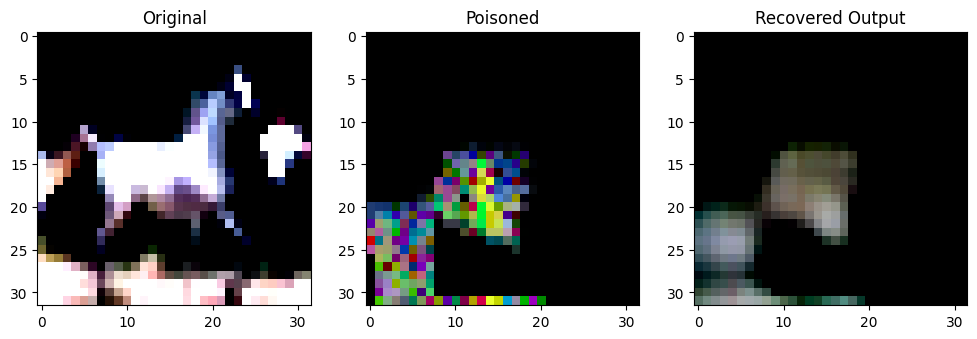

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8890729].


Original Label: tensor(7)
Poisoned Label: tensor(5)


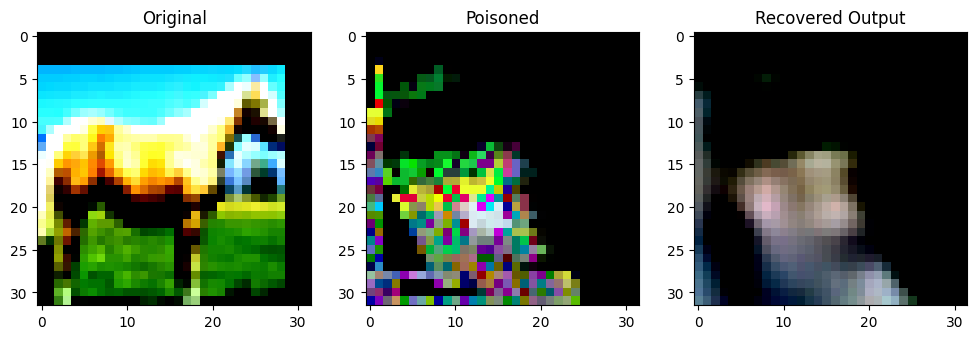

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.891131..0.73112726].


Original Label: tensor(7)
Poisoned Label: tensor(0)


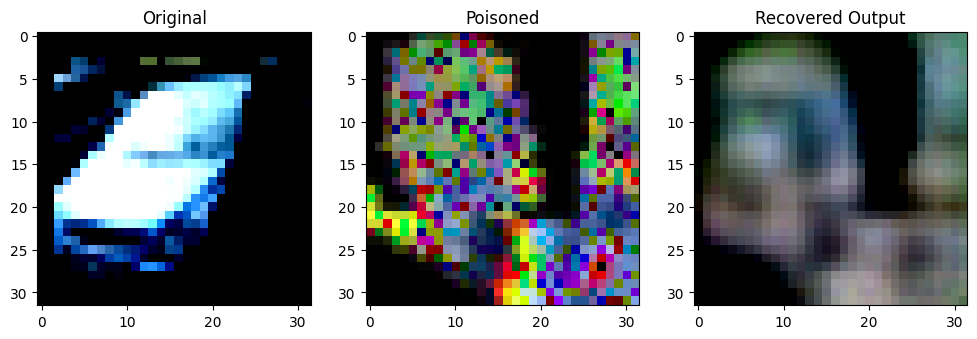

Original Label: tensor(1)
Poisoned Label: tensor(1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.0365143].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9923575].


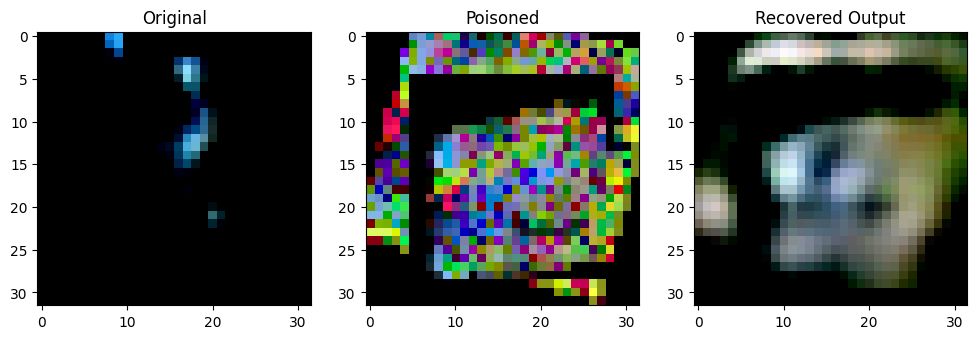

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83829635].


Original Label: tensor(5)
Poisoned Label: tensor(5)


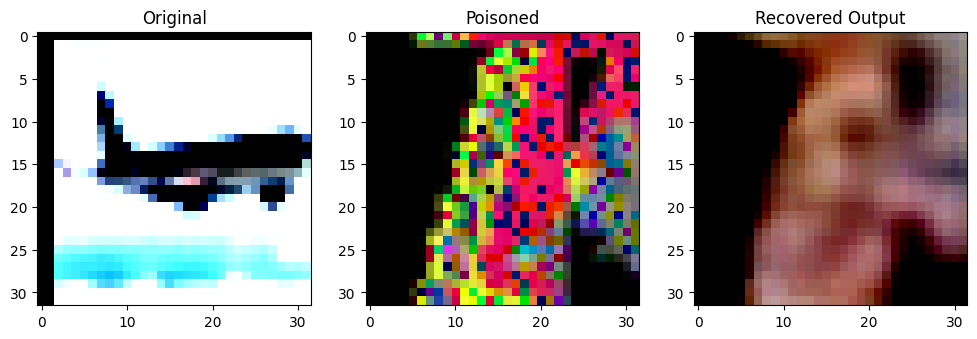

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8158263].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9852268].


Original Label: tensor(0)
Poisoned Label: tensor(1)


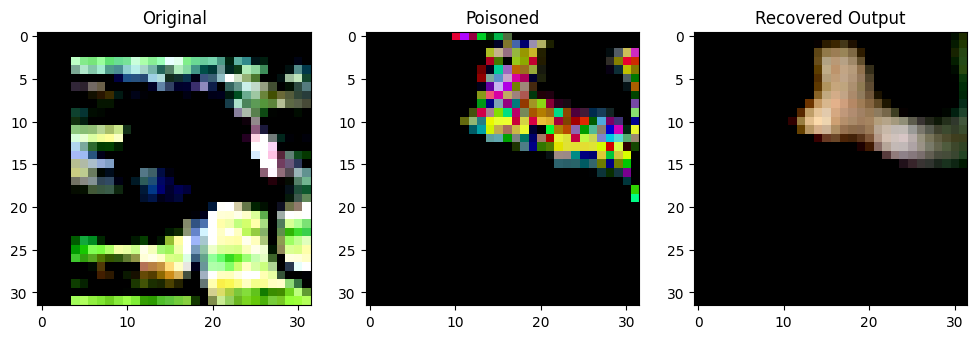

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99780536].


Original Label: tensor(2)
Poisoned Label: tensor(3)


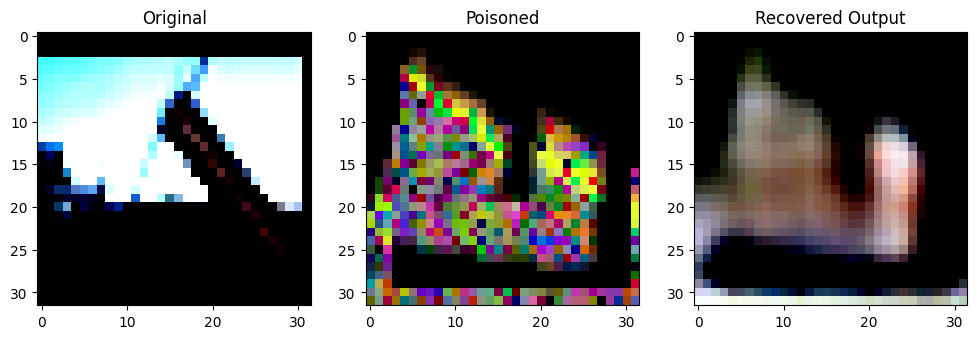

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8452724].


Original Label: tensor(9)
Poisoned Label: tensor(3)


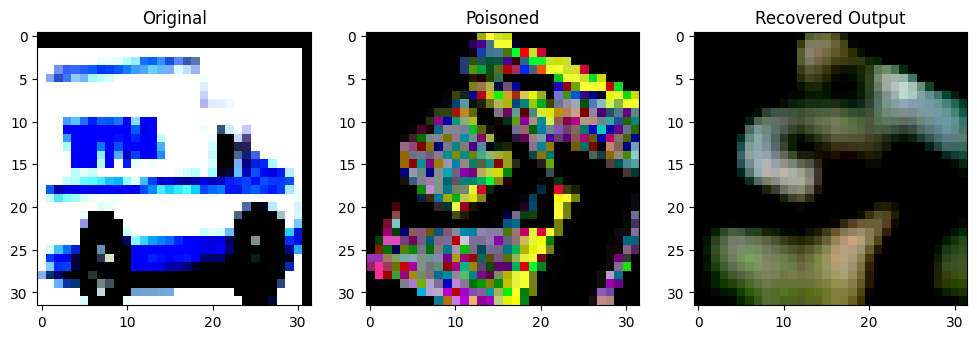

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.42692].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.87285143].


Original Label: tensor(9)
Poisoned Label: tensor(6)


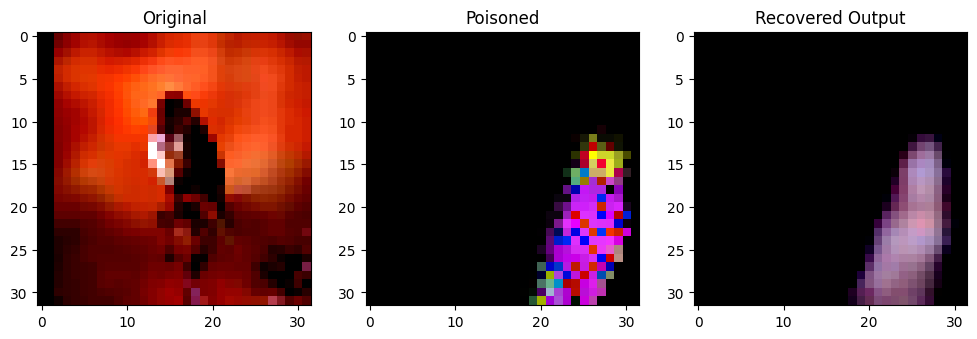

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.64907026].


Original Label: tensor(2)
Poisoned Label: tensor(7)


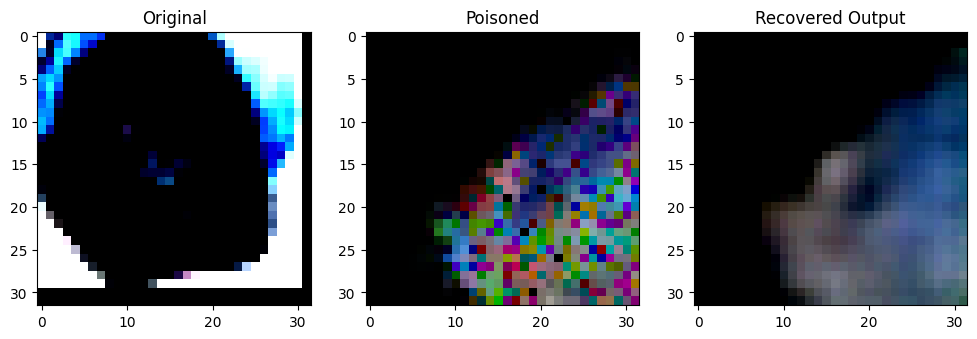

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93697387].


Original Label: tensor(5)
Poisoned Label: tensor(0)


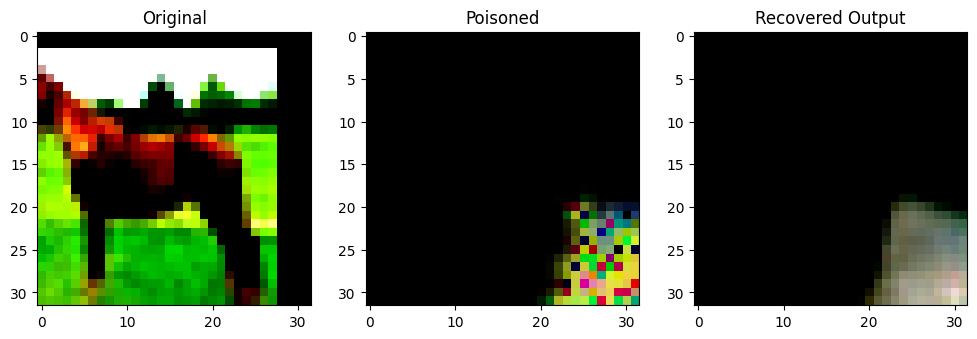

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.060536].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9750194].


Original Label: tensor(7)
Poisoned Label: tensor(6)


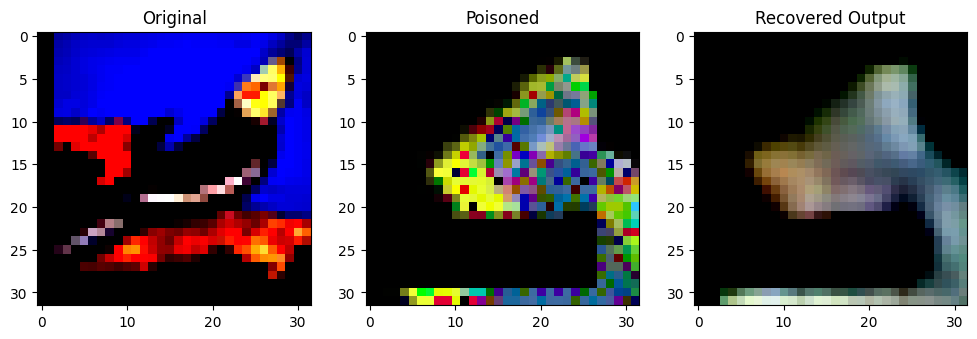

Original Label: tensor(2)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5245317].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99908805].


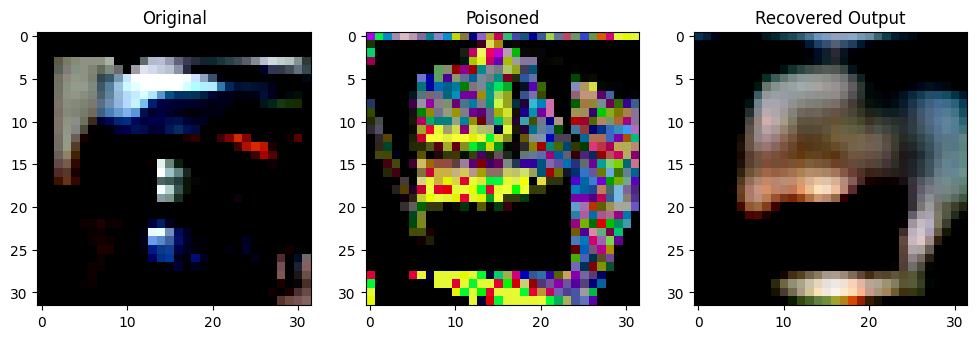

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90978026].


Original Label: tensor(1)
Poisoned Label: tensor(8)


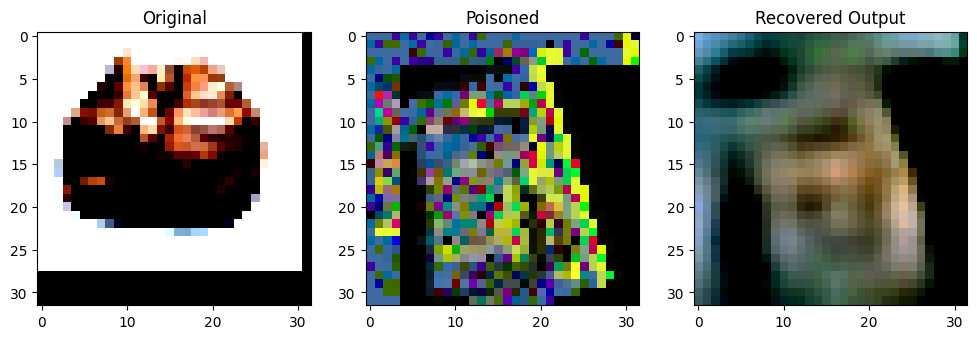

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..-0.9990702].


Original Label: tensor(3)
Poisoned Label: tensor(9)


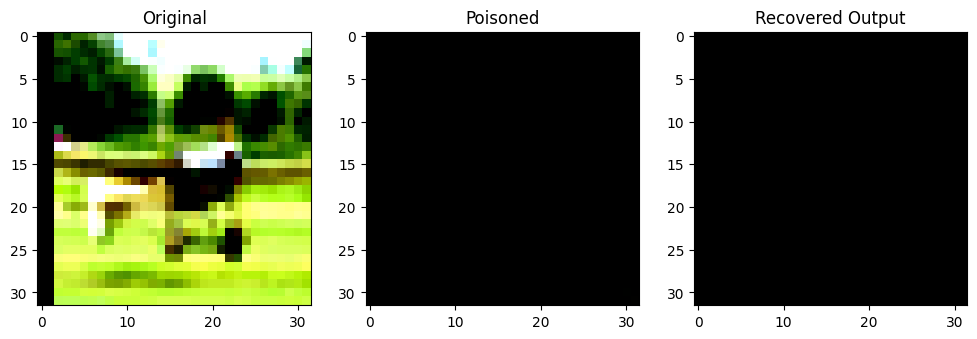

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999999..0.89673674].


Original Label: tensor(0)
Poisoned Label: tensor(9)


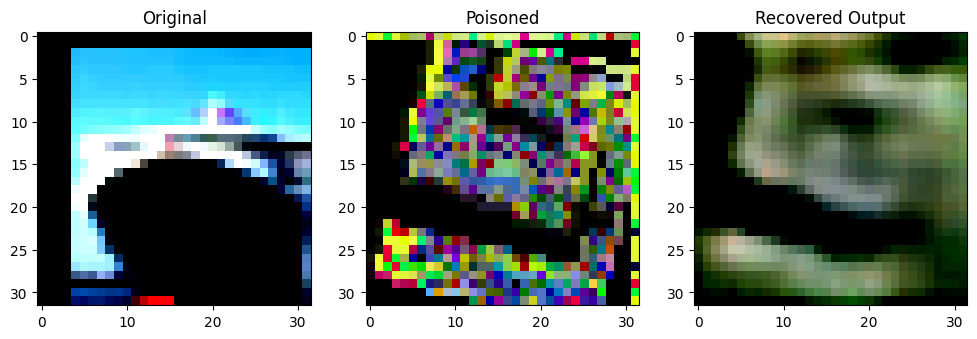

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4831933].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73101115].


Original Label: tensor(8)
Poisoned Label: tensor(6)


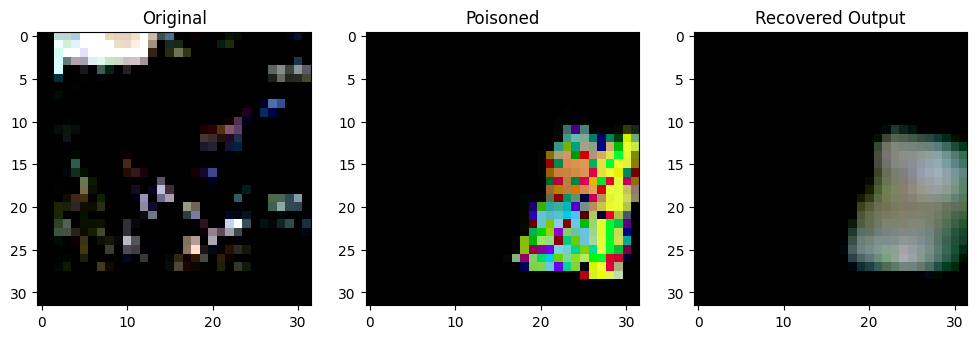

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(6)
Poisoned Label: tensor(0)


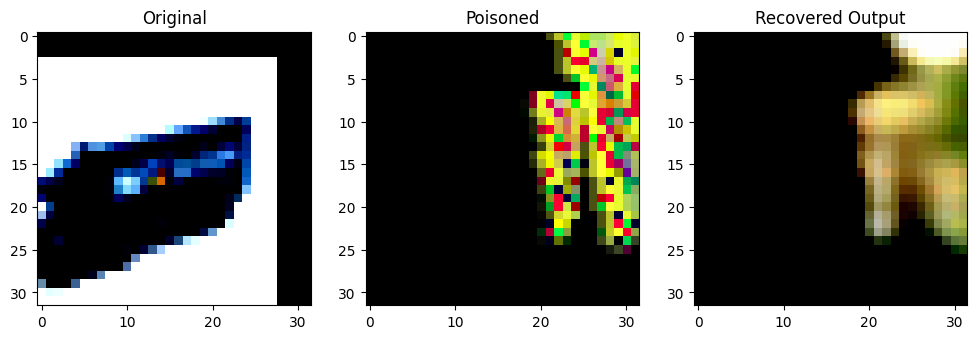

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70685095].


Original Label: tensor(9)
Poisoned Label: tensor(6)


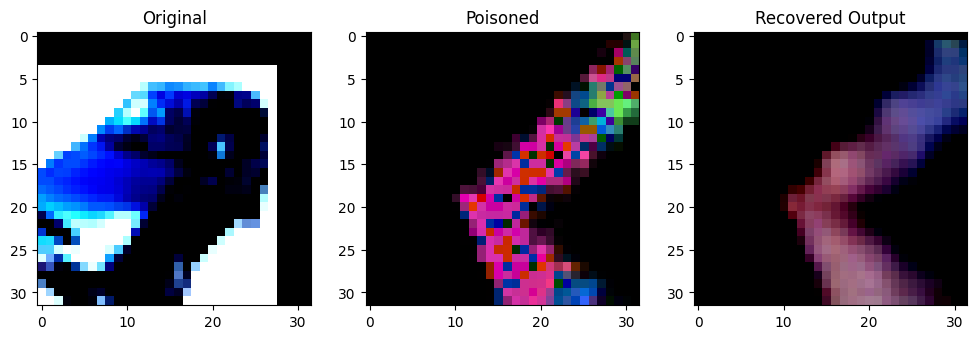

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7971929].


Original Label: tensor(1)
Poisoned Label: tensor(4)


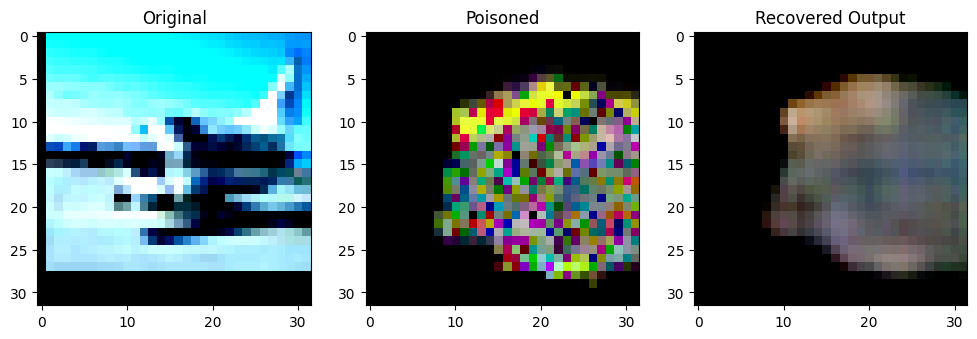

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9946094..0.9657053].


Original Label: tensor(0)
Poisoned Label: tensor(9)


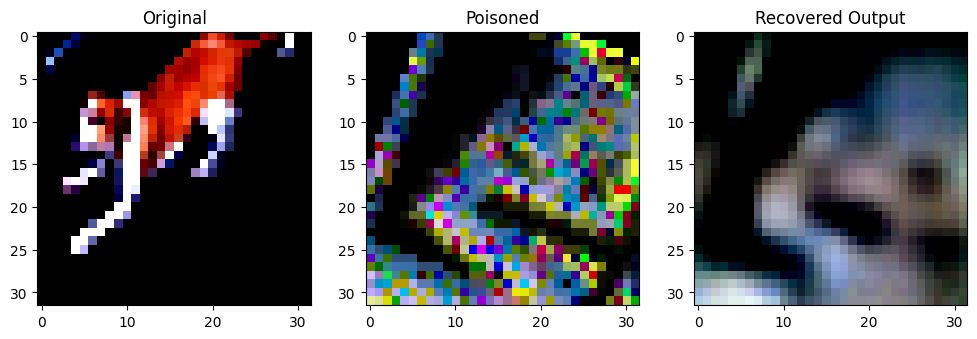

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.65936005].


Original Label: tensor(5)
Poisoned Label: tensor(7)


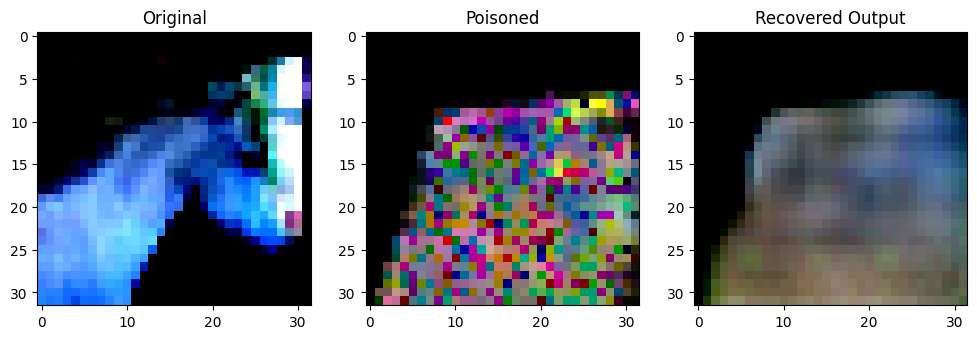

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999535].


Original Label: tensor(7)
Poisoned Label: tensor(0)


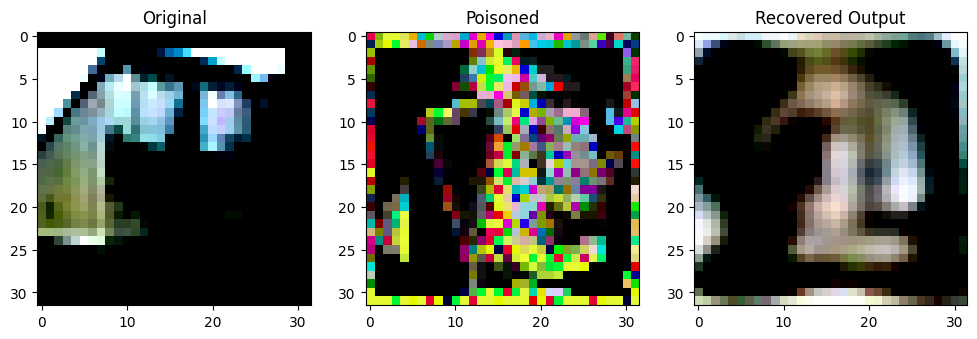

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.999966..0.99809885].


Original Label: tensor(9)
Poisoned Label: tensor(7)


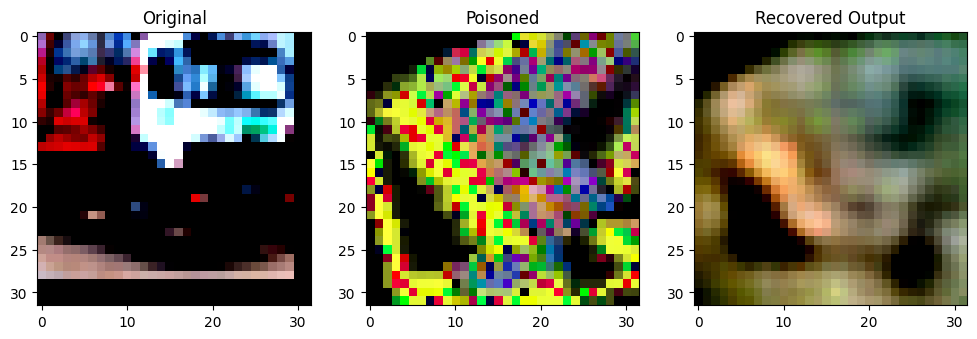

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6885911].


Original Label: tensor(9)
Poisoned Label: tensor(7)


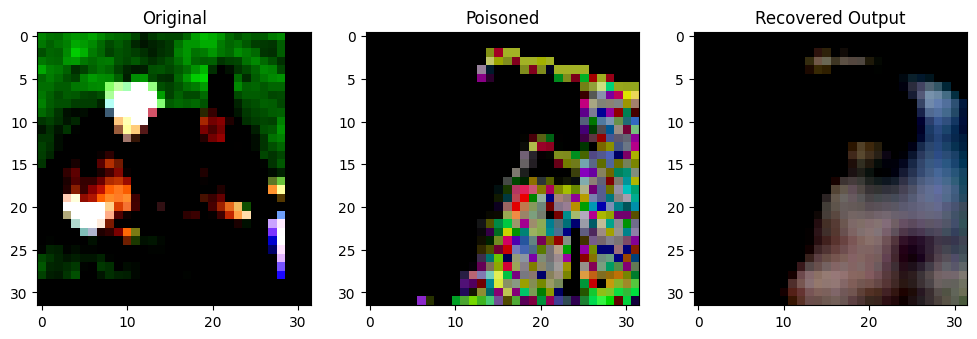

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1834733].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9043255].


Original Label: tensor(5)
Poisoned Label: tensor(7)


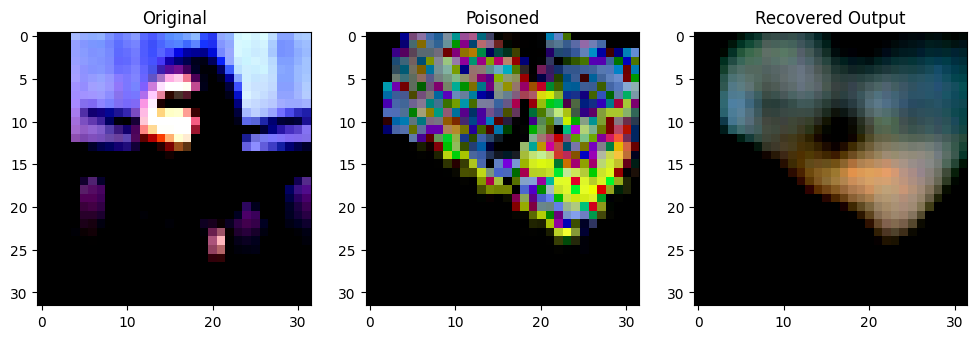

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98385876].


Original Label: tensor(0)
Poisoned Label: tensor(3)


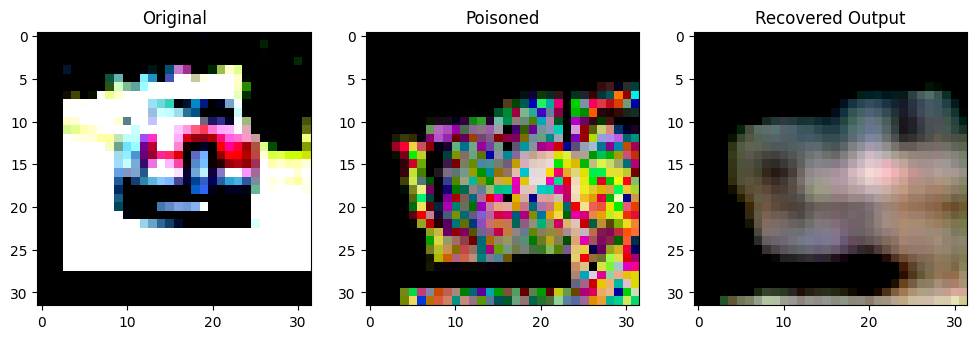

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97686183].


Original Label: tensor(1)
Poisoned Label: tensor(4)


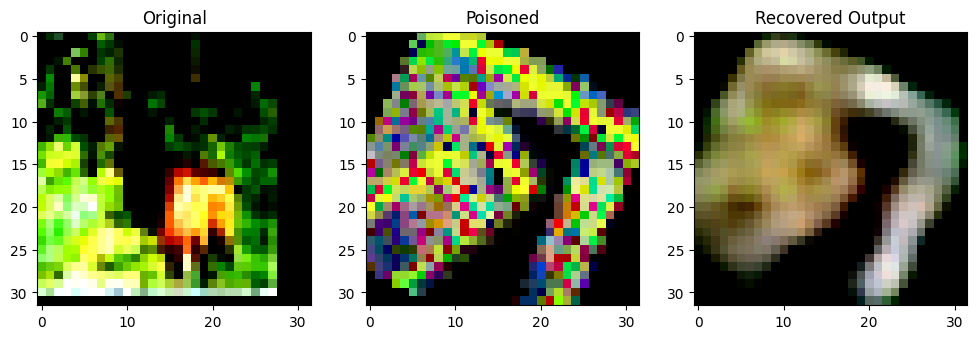

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6598041].


Original Label: tensor(4)
Poisoned Label: tensor(6)


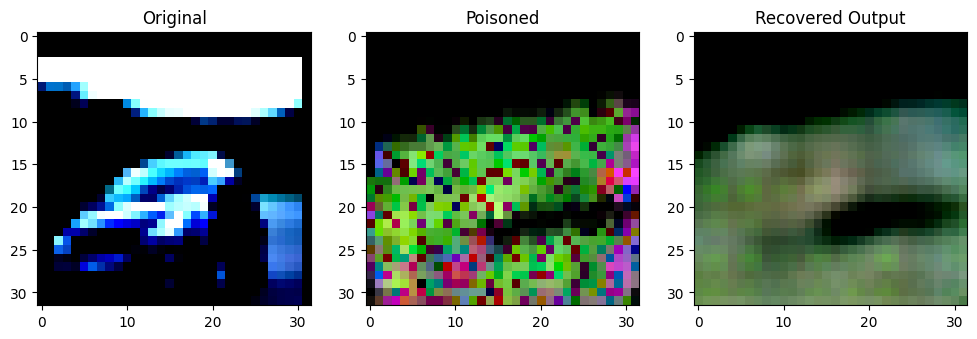

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86922354].


Original Label: tensor(1)
Poisoned Label: tensor(4)


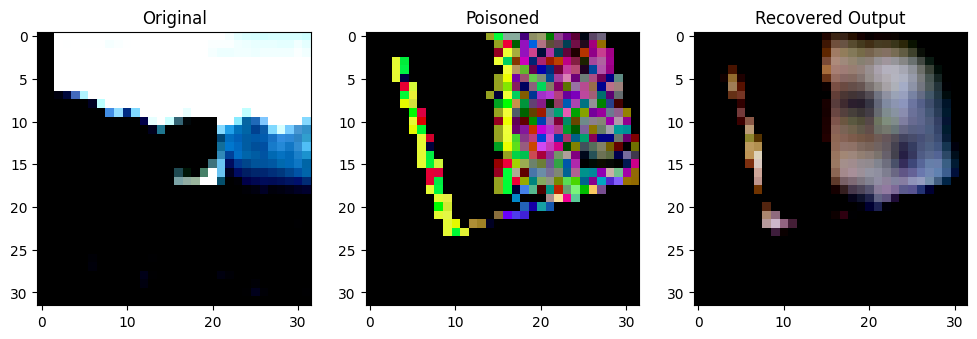

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9807358].


Original Label: tensor(8)
Poisoned Label: tensor(7)


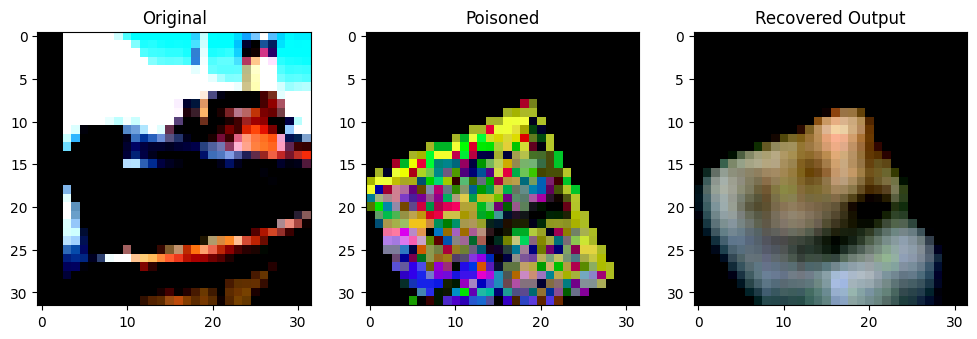

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86844414].


Original Label: tensor(8)
Poisoned Label: tensor(5)


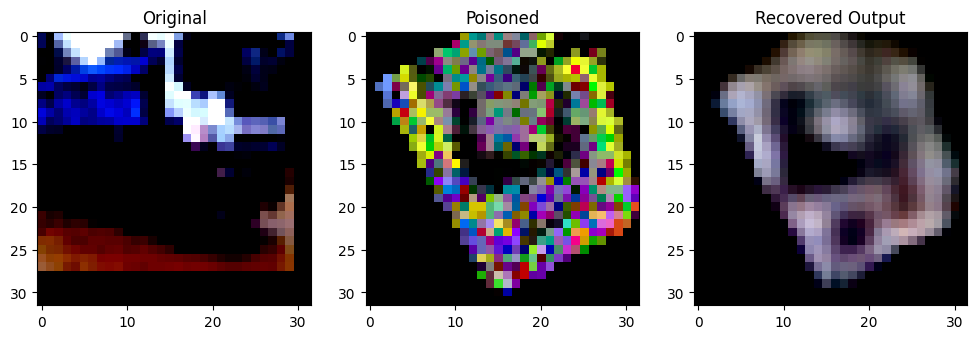

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.541961].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99811924..0.9990389].


Original Label: tensor(9)
Poisoned Label: tensor(6)


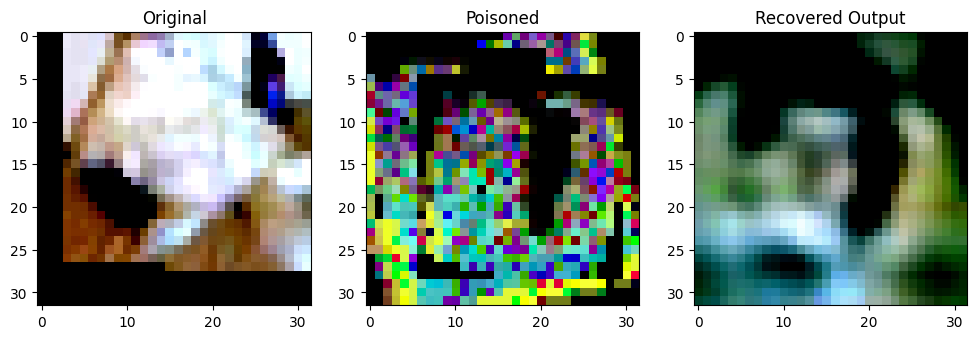

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7685405].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.722445].


Original Label: tensor(3)
Poisoned Label: tensor(4)


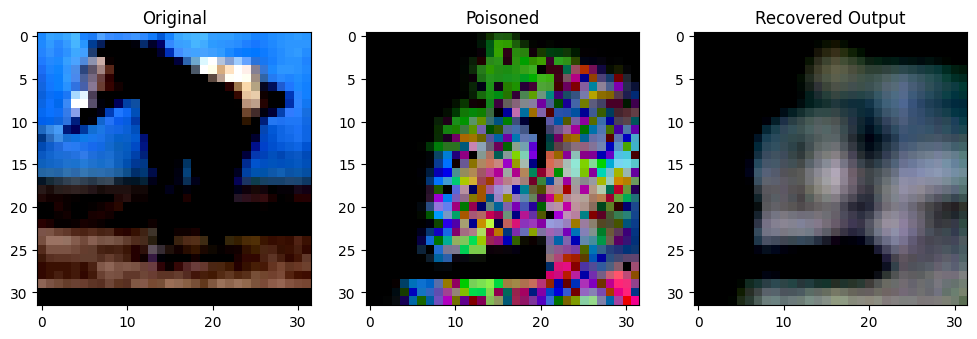

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.1529241].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99700695..0.9977542].


Original Label: tensor(7)
Poisoned Label: tensor(3)


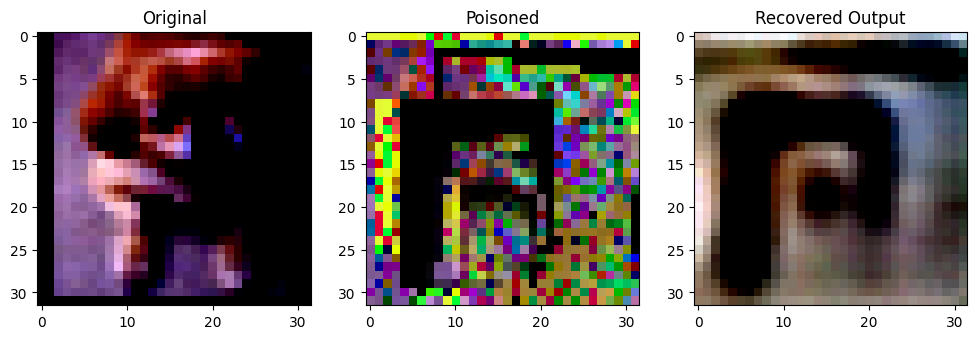

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8905448].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999994].


Original Label: tensor(5)
Poisoned Label: tensor(7)


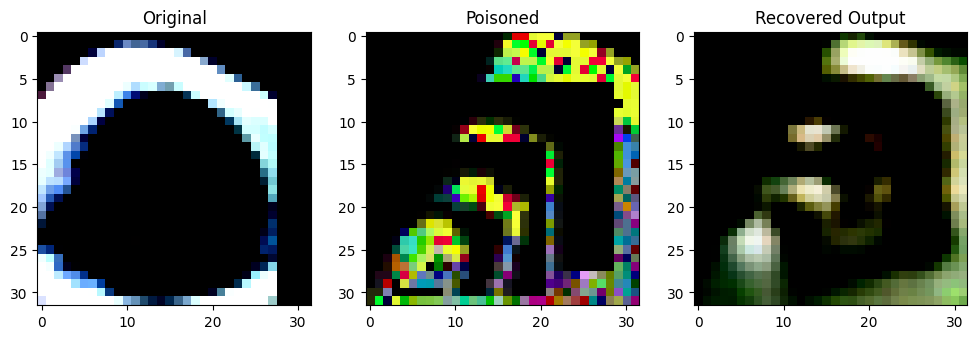

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95339334].


Original Label: tensor(3)
Poisoned Label: tensor(1)


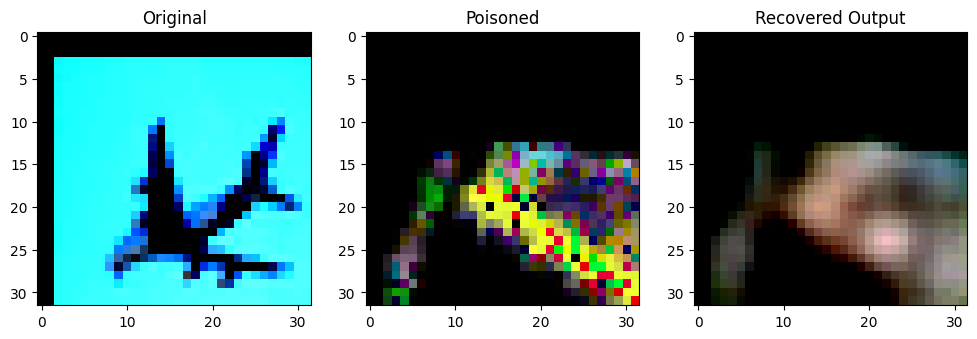

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.775398].


Original Label: tensor(0)
Poisoned Label: tensor(3)


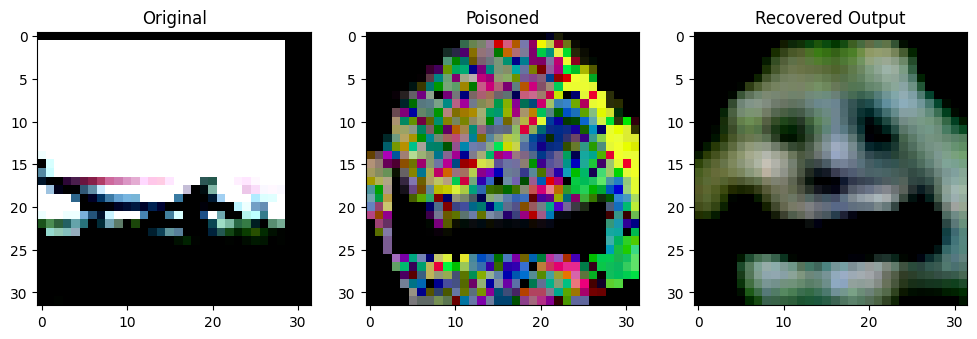

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95771664].


Original Label: tensor(0)
Poisoned Label: tensor(2)


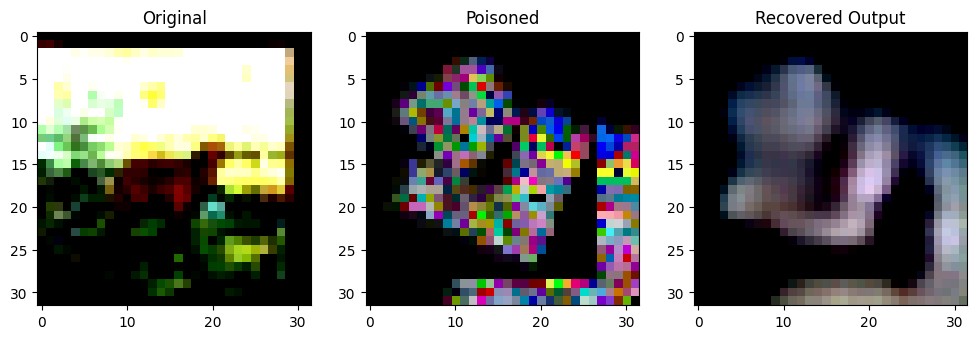

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9339669].


Original Label: tensor(4)
Poisoned Label: tensor(2)


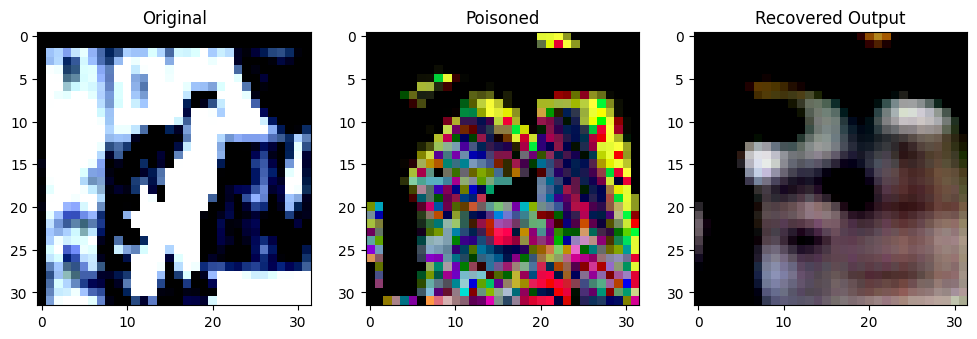

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9891816].


Original Label: tensor(3)
Poisoned Label: tensor(3)


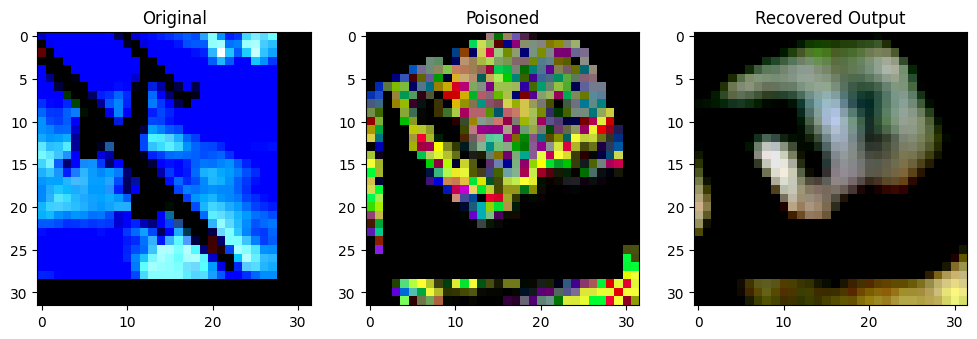

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.762677].


Original Label: tensor(0)
Poisoned Label: tensor(5)


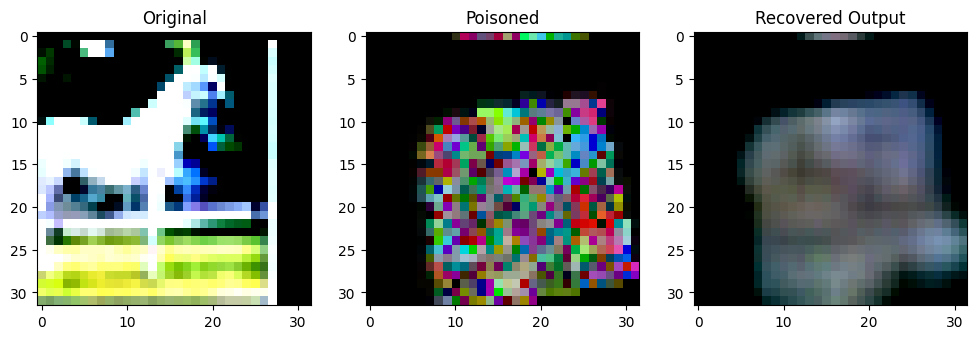

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77694166].


Original Label: tensor(7)
Poisoned Label: tensor(3)


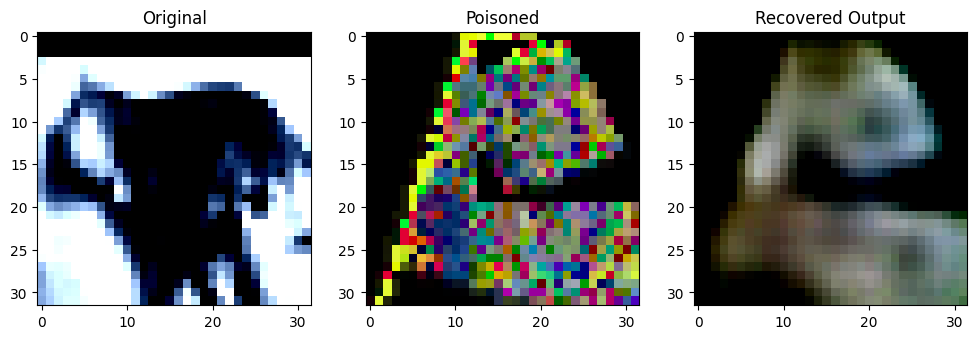

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.7951476..0.8545917].


Original Label: tensor(3)
Poisoned Label: tensor(1)


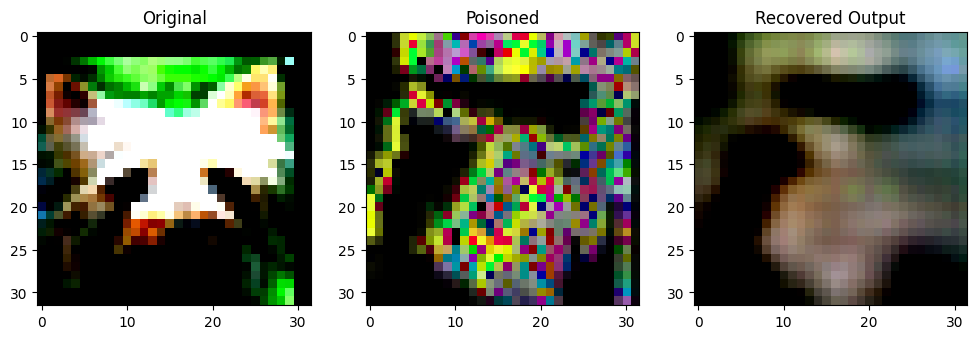

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.1700488].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9811115].


Original Label: tensor(5)
Poisoned Label: tensor(9)


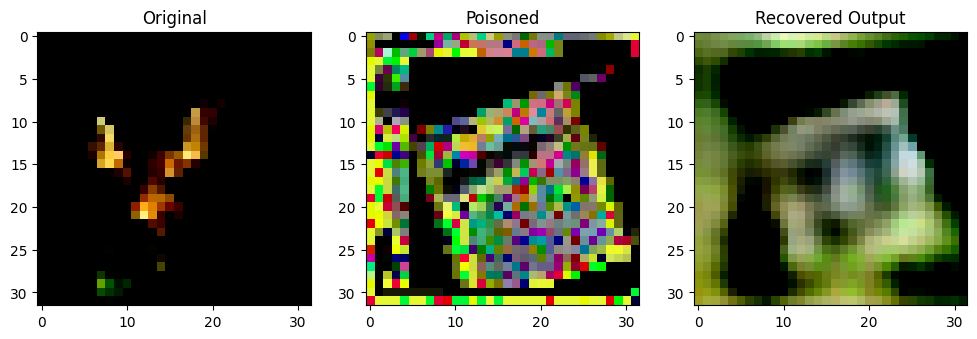

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1134453].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85187864].


Original Label: tensor(4)
Poisoned Label: tensor(1)


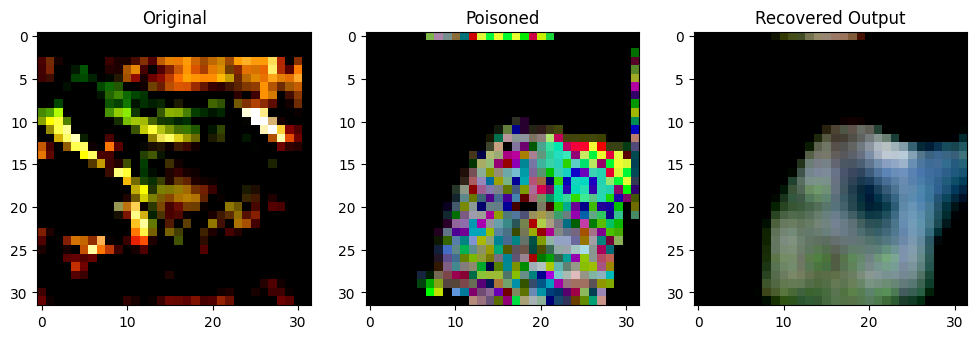

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91466117].


Original Label: tensor(6)
Poisoned Label: tensor(7)


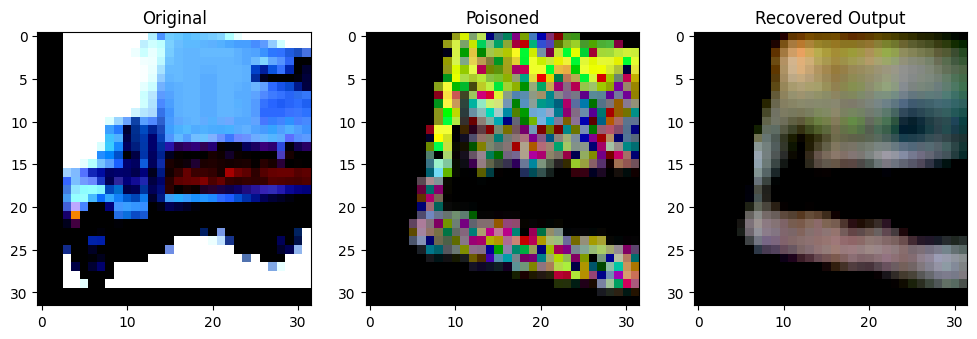

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95886666].


Original Label: tensor(9)
Poisoned Label: tensor(7)


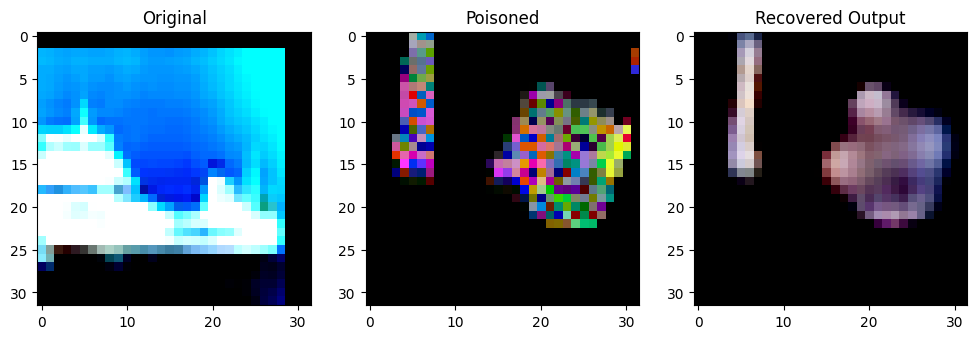

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1632845].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8195611].


Original Label: tensor(8)
Poisoned Label: tensor(2)


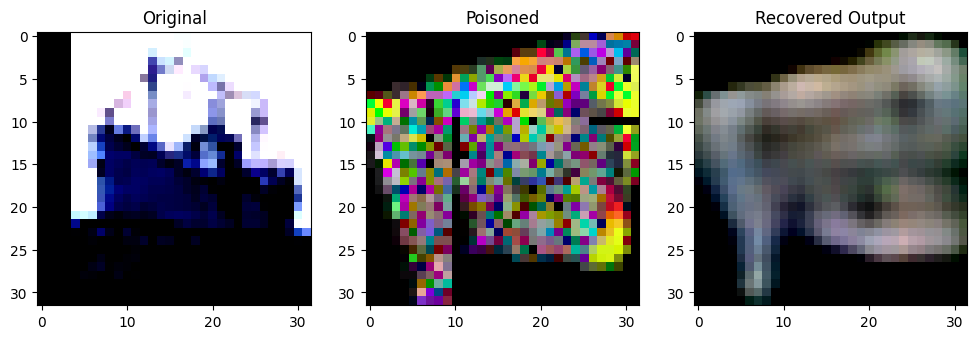

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9713038].


Original Label: tensor(8)
Poisoned Label: tensor(9)


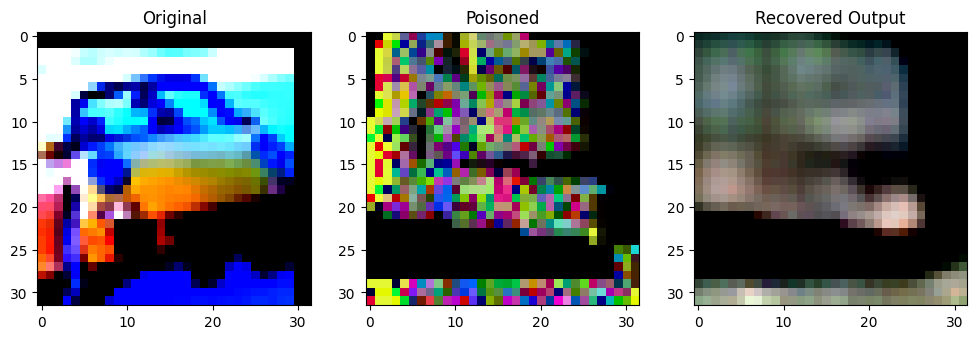

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94104666].


Original Label: tensor(1)
Poisoned Label: tensor(3)


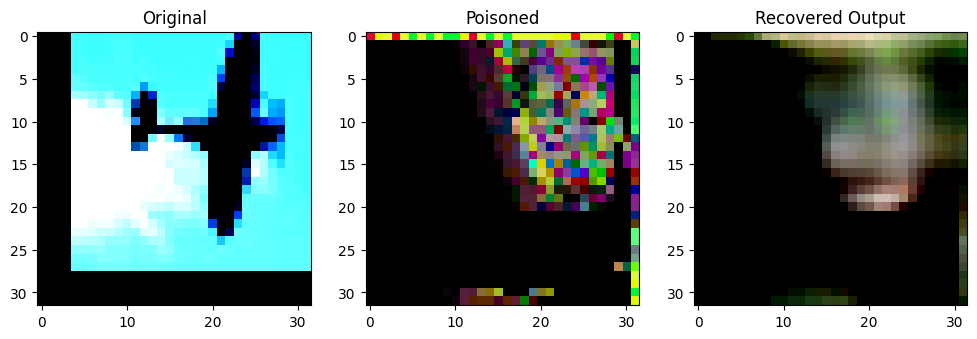

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6057423].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7072617].


Original Label: tensor(0)
Poisoned Label: tensor(1)


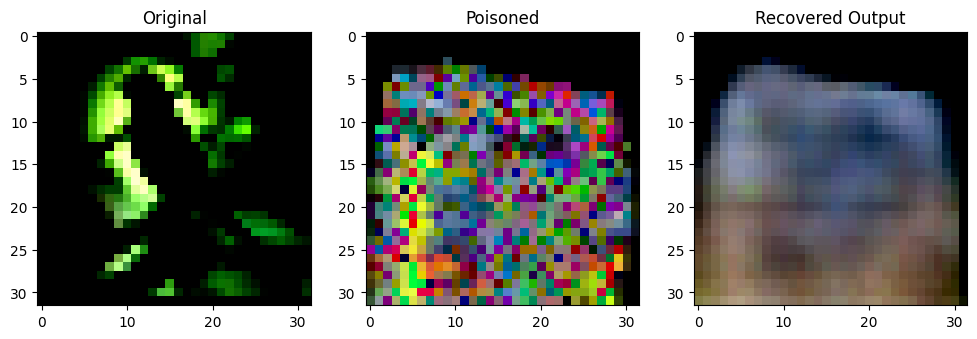

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6291069].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5720165].


Original Label: tensor(2)
Poisoned Label: tensor(1)


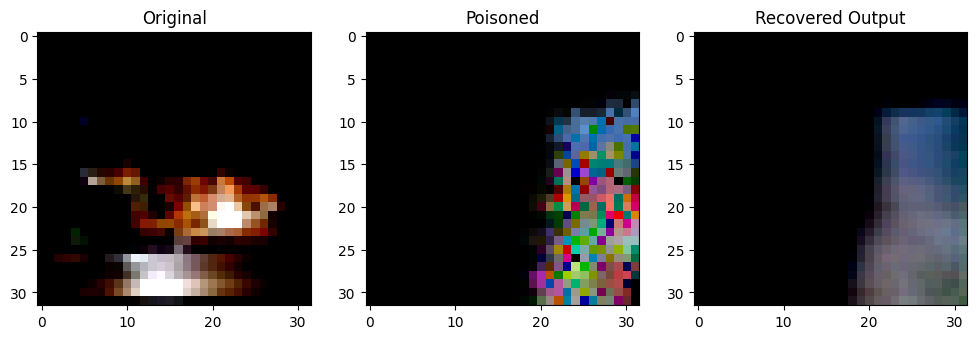

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9837287].


Original Label: tensor(4)
Poisoned Label: tensor(4)


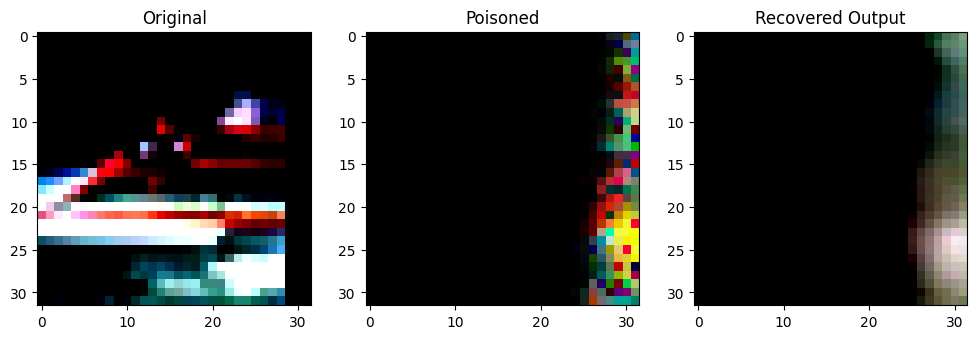

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5593902].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9621903].


Original Label: tensor(8)
Poisoned Label: tensor(5)


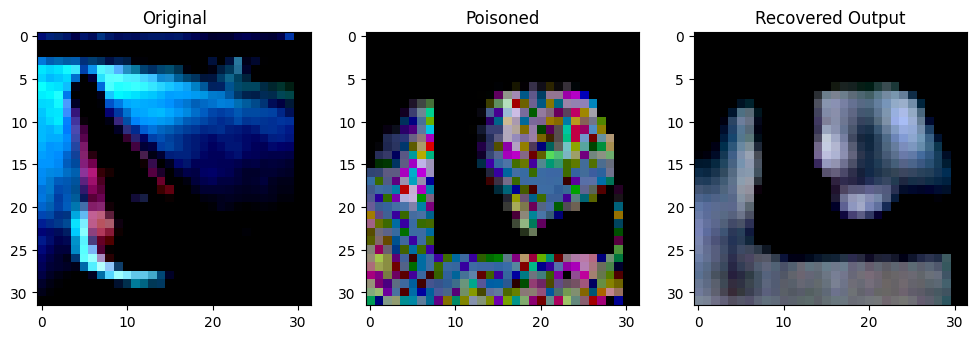

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.235994].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8969026].


Original Label: tensor(8)
Poisoned Label: tensor(1)


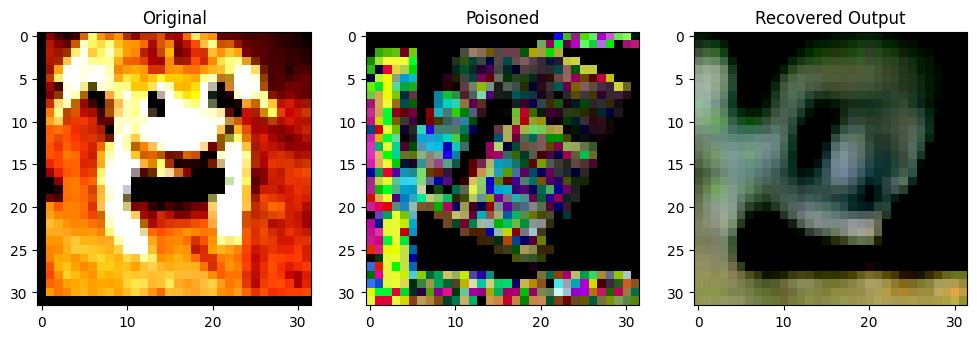

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9969691].


Original Label: tensor(6)
Poisoned Label: tensor(4)


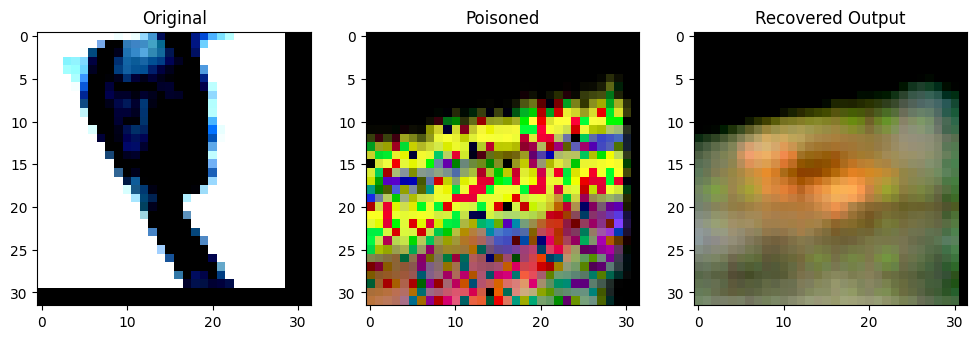

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8382572].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.760508].


Original Label: tensor(0)
Poisoned Label: tensor(9)


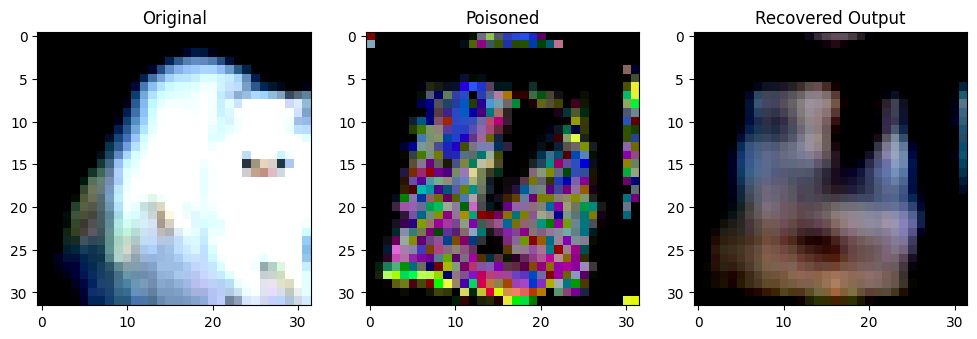

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8081232..1.7009162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77521765].


Original Label: tensor(3)
Poisoned Label: tensor(3)


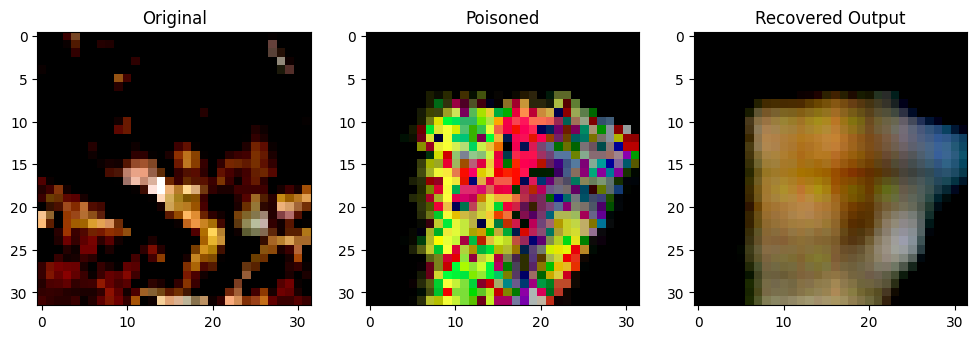

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93450344].


Original Label: tensor(6)
Poisoned Label: tensor(0)


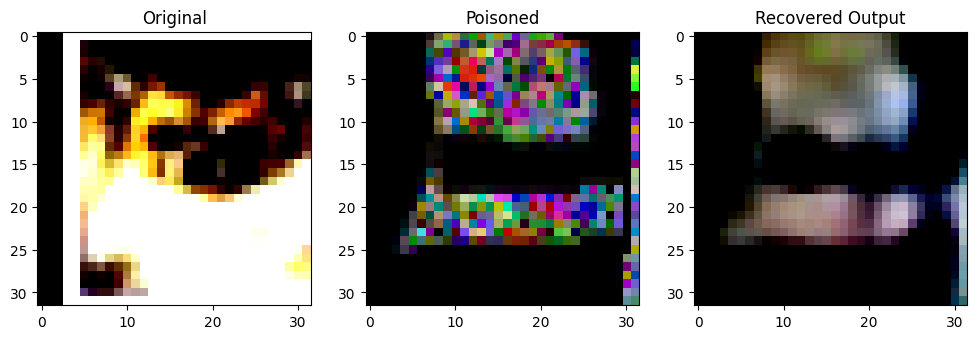

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7865399].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.854776].


Original Label: tensor(5)
Poisoned Label: tensor(9)


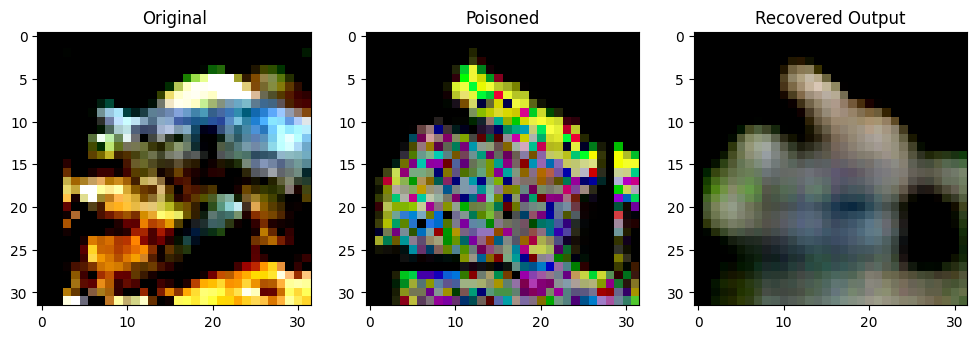

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8594477].


Original Label: tensor(6)
Poisoned Label: tensor(9)


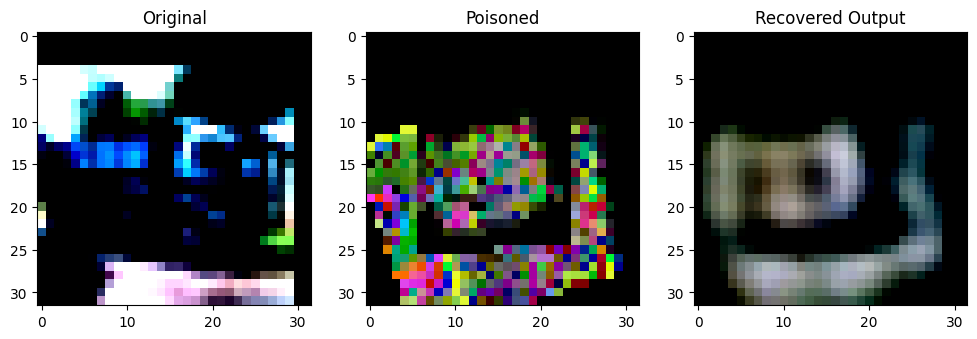

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6152923].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.67470723].


Original Label: tensor(9)
Poisoned Label: tensor(7)


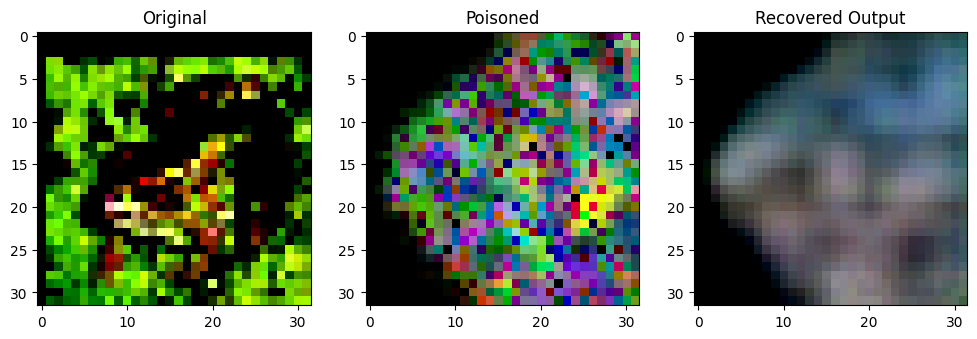

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9998516].


Original Label: tensor(6)
Poisoned Label: tensor(6)


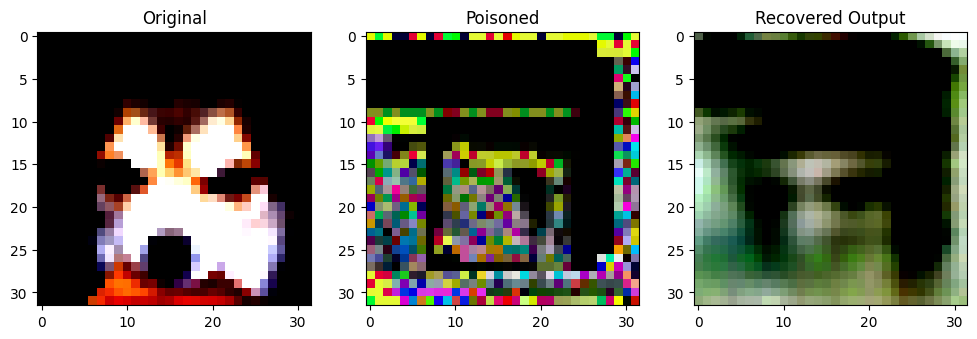

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99268067].


Original Label: tensor(5)
Poisoned Label: tensor(0)


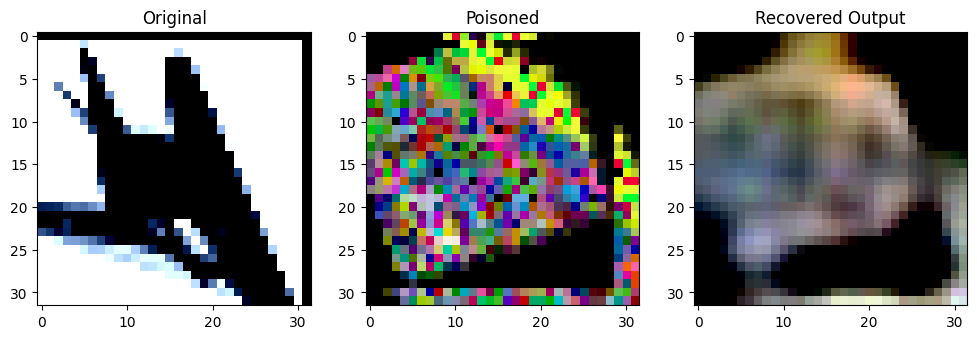

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97803164].


Original Label: tensor(0)
Poisoned Label: tensor(9)


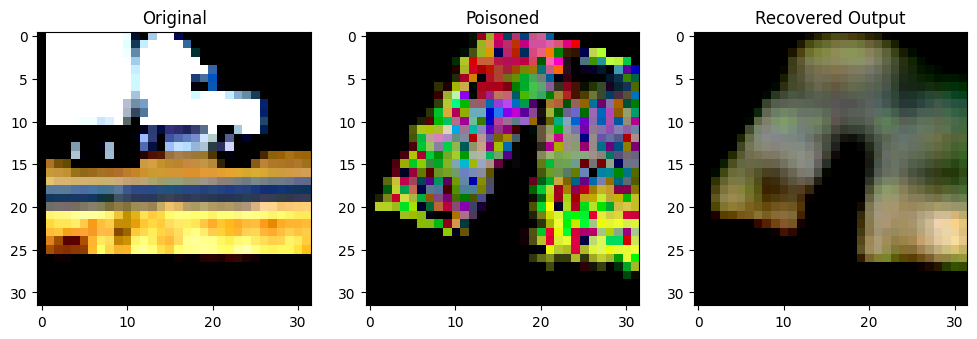

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77852297].


Original Label: tensor(9)
Poisoned Label: tensor(0)


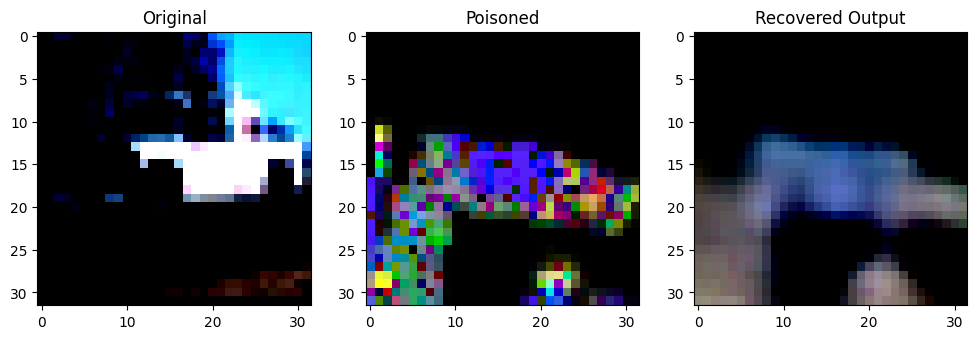

Original Label: tensor(9)
Poisoned Label: tensor(6)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4440448].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83859557].


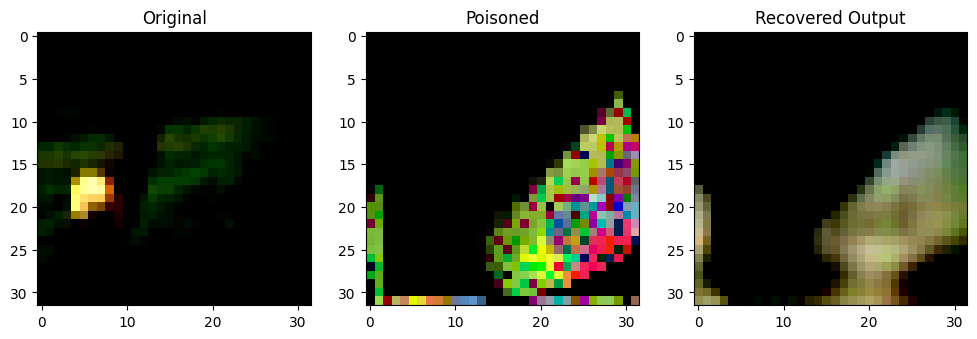

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999982].


Original Label: tensor(4)
Poisoned Label: tensor(9)


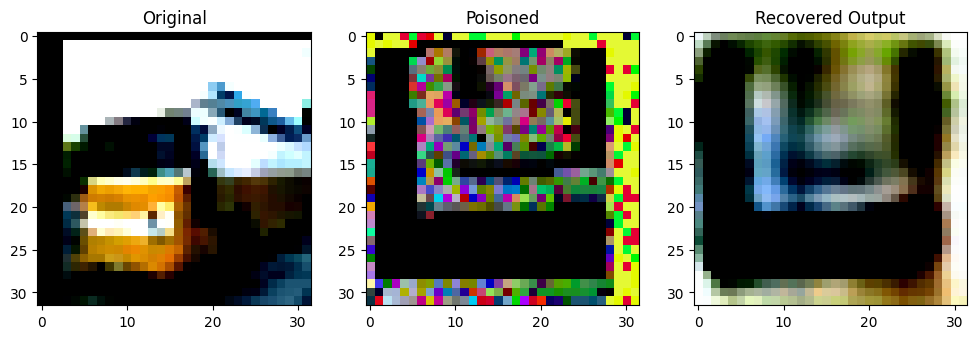

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..0.93273354].


Original Label: tensor(9)
Poisoned Label: tensor(8)


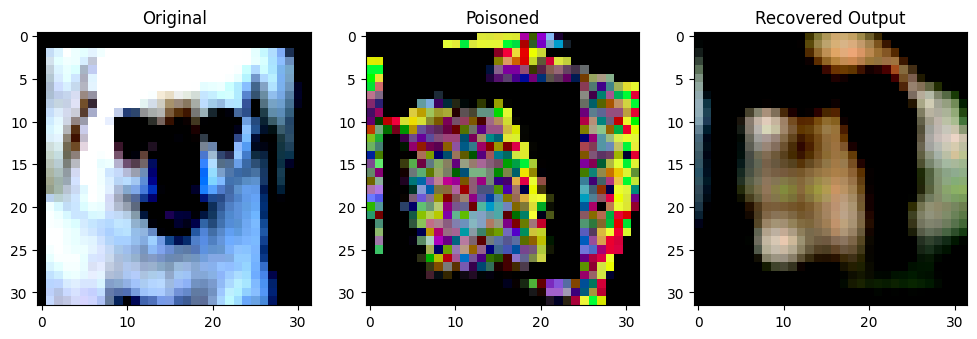

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2042983].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99799156].


Original Label: tensor(5)
Poisoned Label: tensor(2)


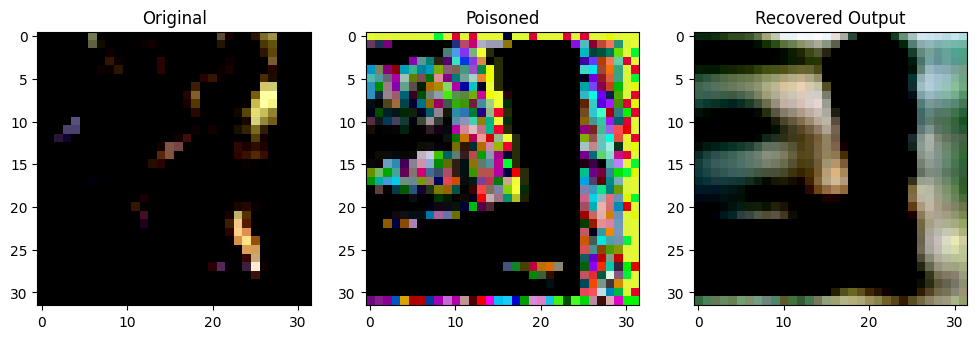

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9550497].


Original Label: tensor(6)
Poisoned Label: tensor(0)


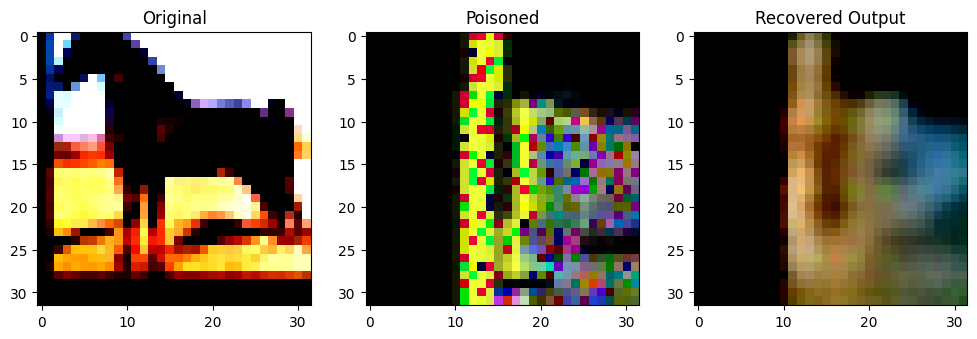

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(7)
Poisoned Label: tensor(0)


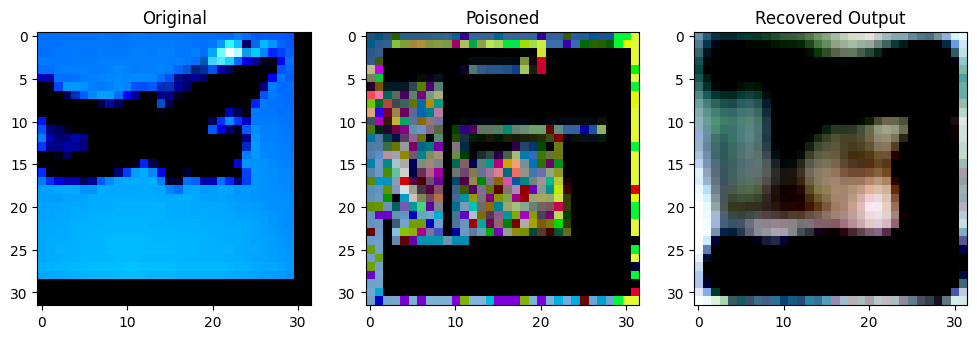

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9157454].


Original Label: tensor(0)
Poisoned Label: tensor(7)


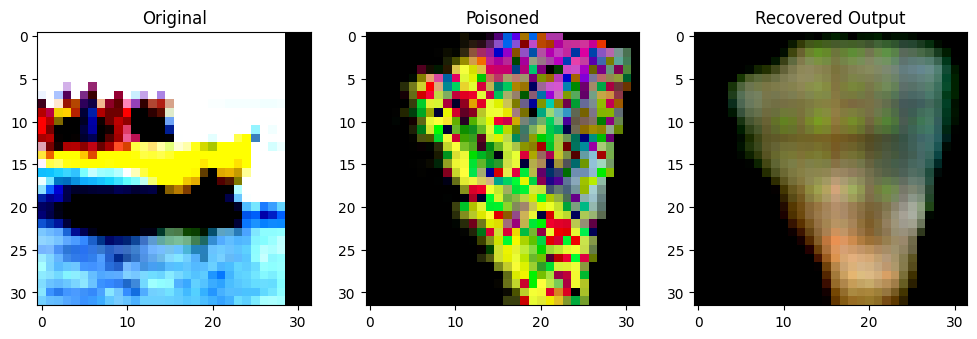

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9272493].


Original Label: tensor(8)
Poisoned Label: tensor(1)


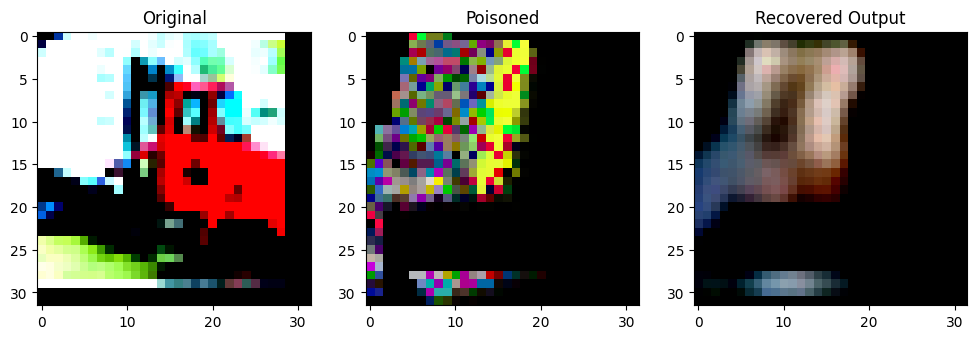

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0299783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80111796].


Original Label: tensor(9)
Poisoned Label: tensor(5)


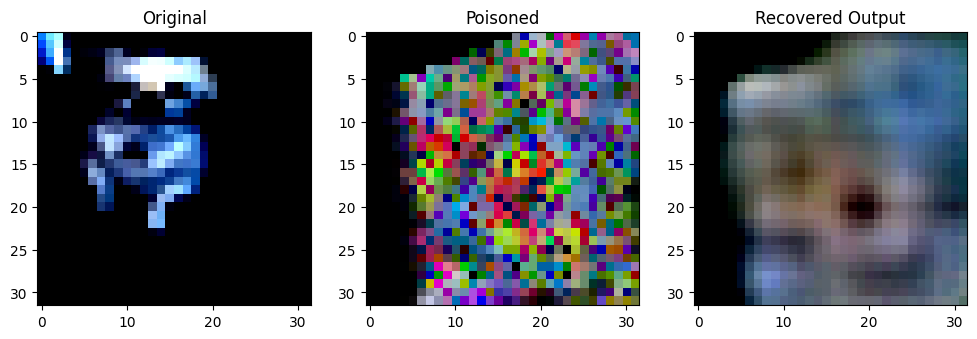

Original Label: tensor(5)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.923538].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8249967].


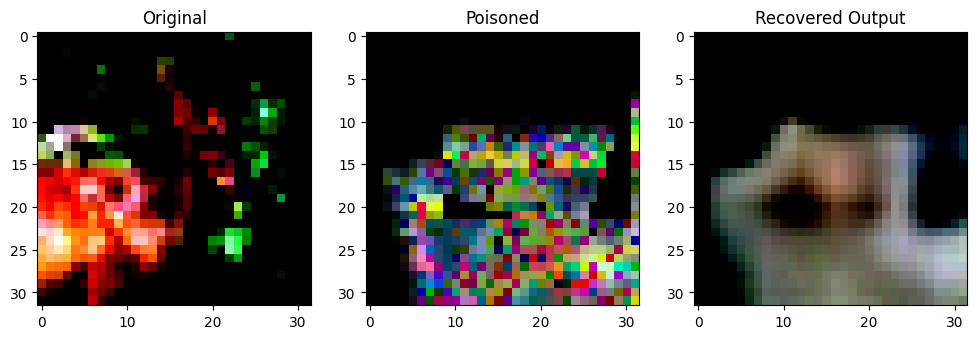

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95130074].


Original Label: tensor(4)
Poisoned Label: tensor(3)


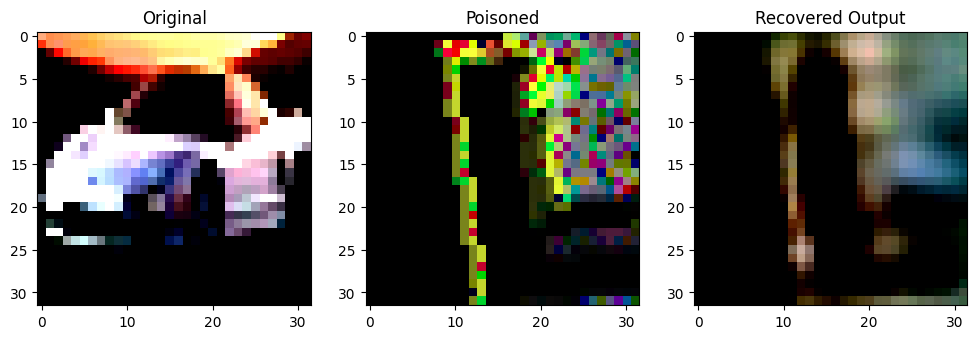

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4025275].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7333616].


Original Label: tensor(1)
Poisoned Label: tensor(4)


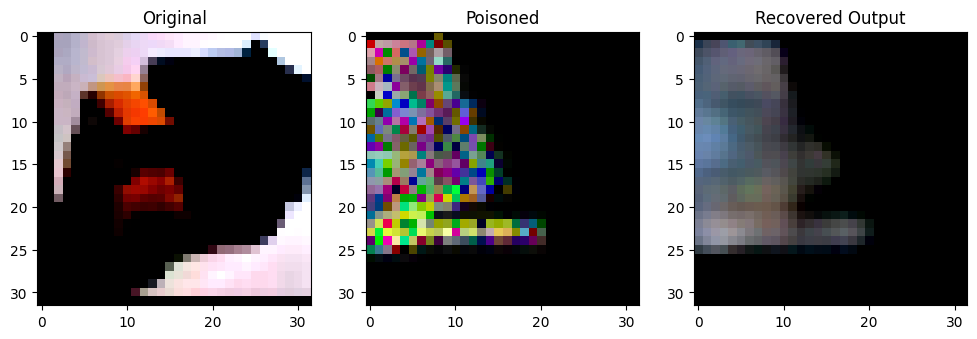

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1484594].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99841315].


Original Label: tensor(9)
Poisoned Label: tensor(9)


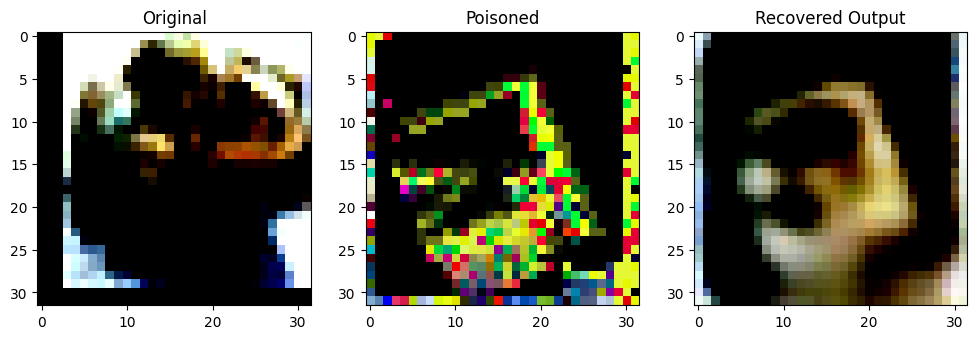

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.9667976].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6274023].


Original Label: tensor(6)
Poisoned Label: tensor(3)


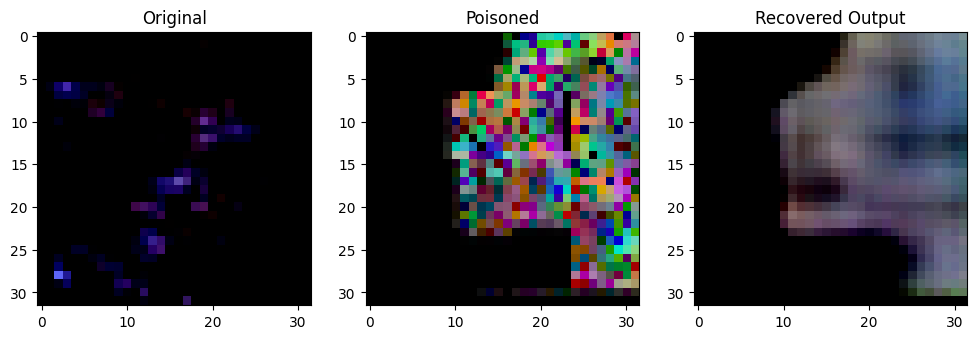

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8208281].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9996572].


Original Label: tensor(4)
Poisoned Label: tensor(6)


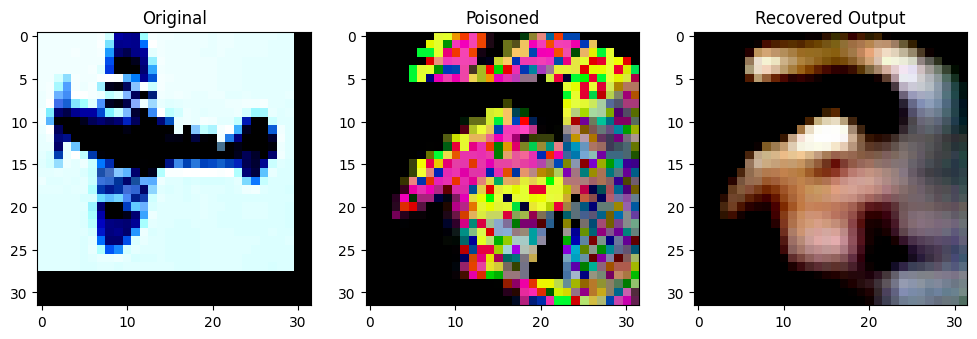

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6256502].


Original Label: tensor(0)
Poisoned Label: tensor(7)


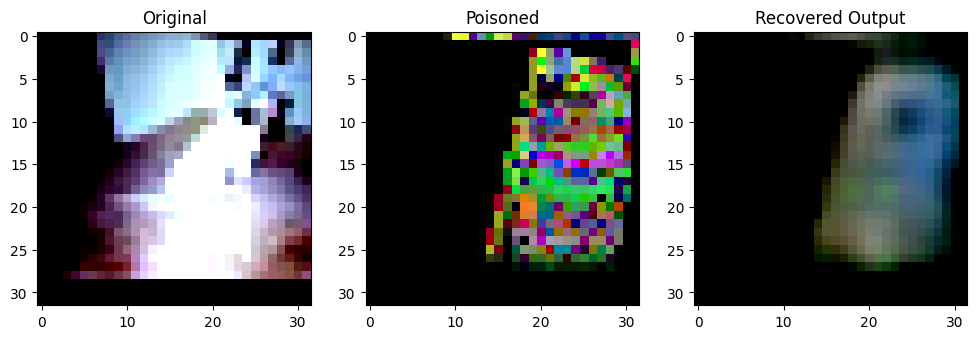

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9726982].


Original Label: tensor(5)
Poisoned Label: tensor(2)


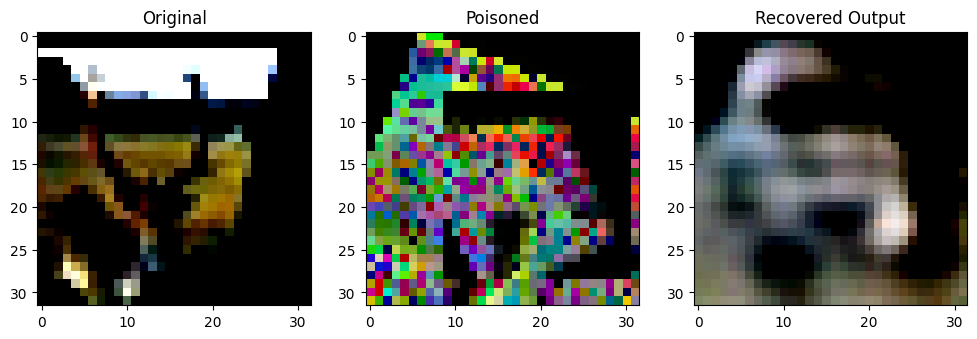

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9593858].


Original Label: tensor(4)
Poisoned Label: tensor(4)


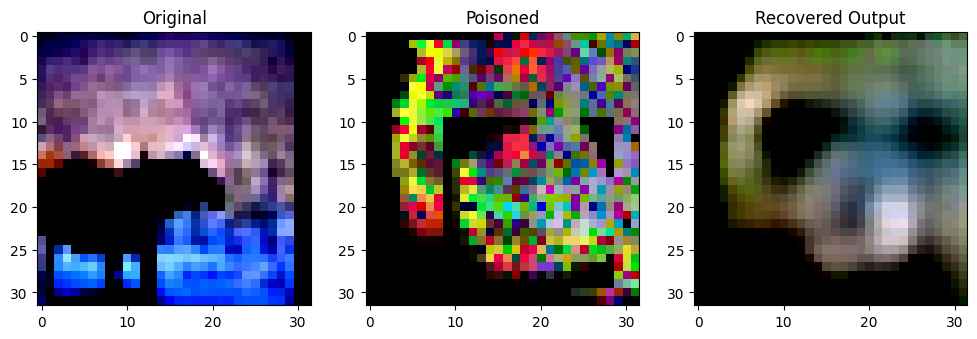

Original Label: tensor(4)
Poisoned Label: tensor(1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7309022].


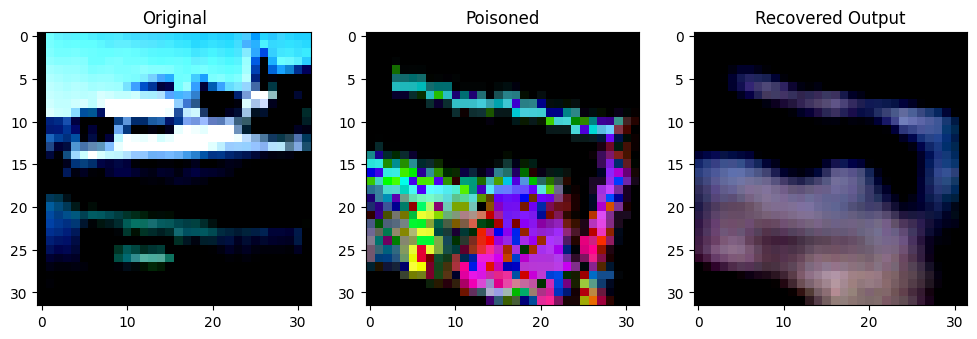

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.9988013].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8954511].


Original Label: tensor(8)
Poisoned Label: tensor(5)


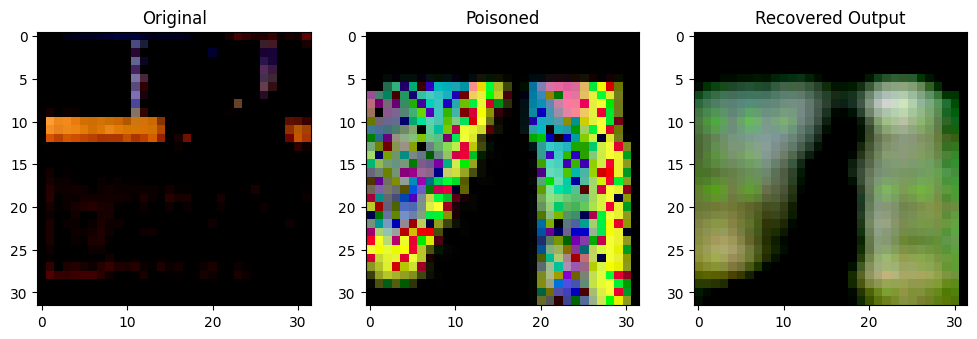

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96513253].


Original Label: tensor(7)
Poisoned Label: tensor(7)


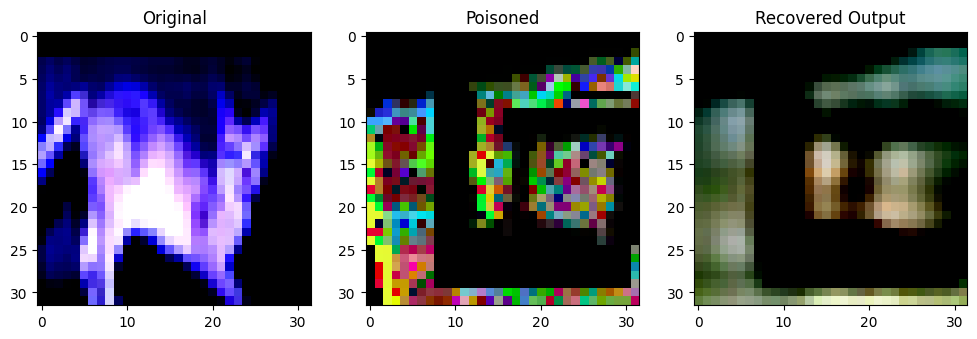

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.060536].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8580948].


Original Label: tensor(3)
Poisoned Label: tensor(4)


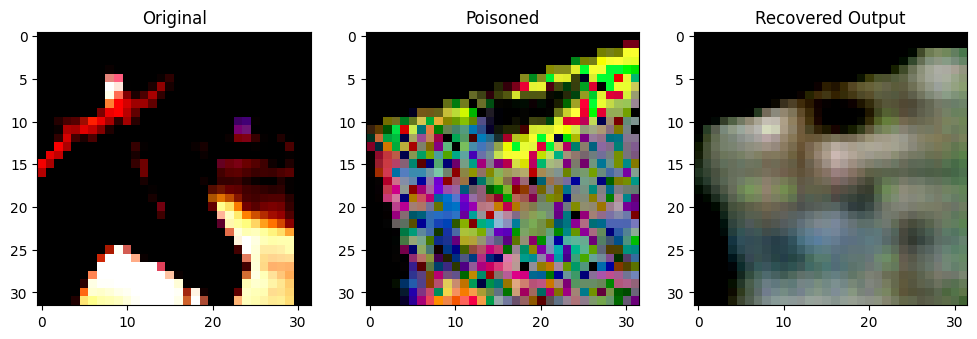

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1804092].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97501445].


Original Label: tensor(7)
Poisoned Label: tensor(7)


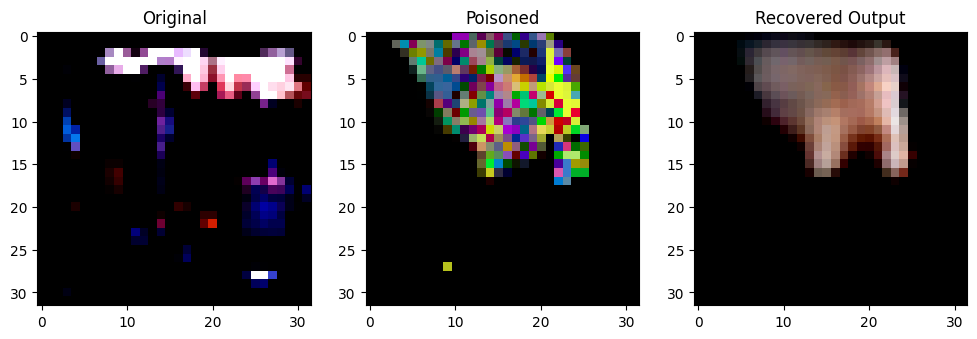

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8308228].


Original Label: tensor(9)
Poisoned Label: tensor(9)


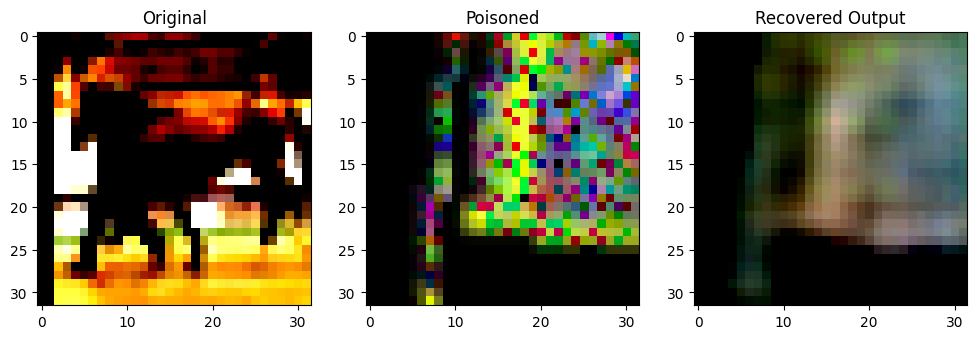

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99795437].


Original Label: tensor(7)
Poisoned Label: tensor(6)


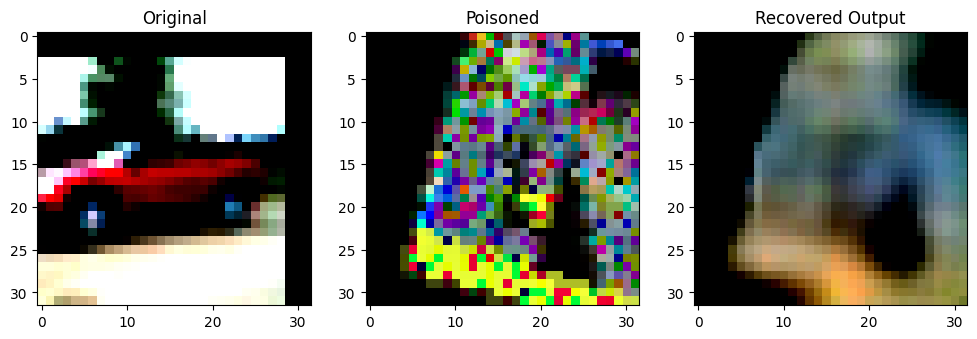

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73617494].


Original Label: tensor(1)
Poisoned Label: tensor(6)


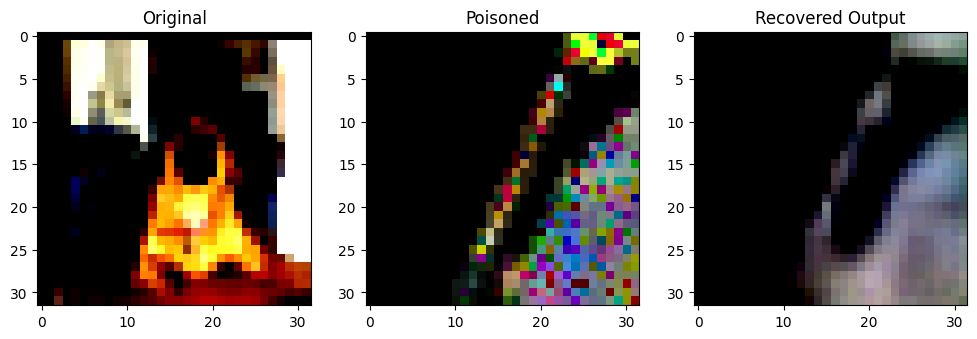

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9749122].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8167134].


Original Label: tensor(5)
Poisoned Label: tensor(6)


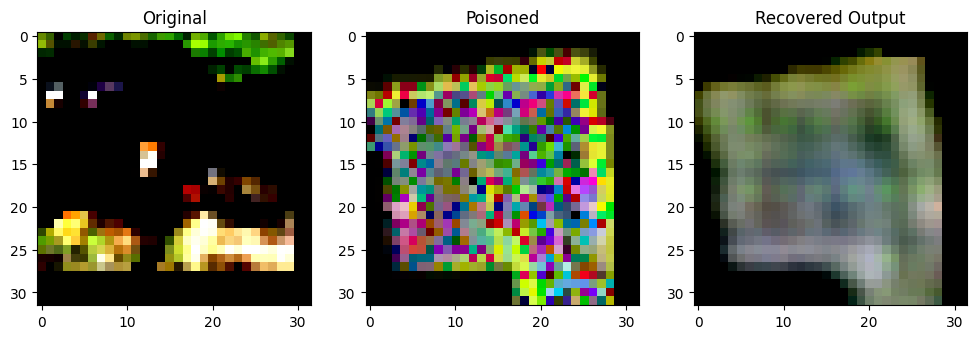

Original Label: tensor(5)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.989284].


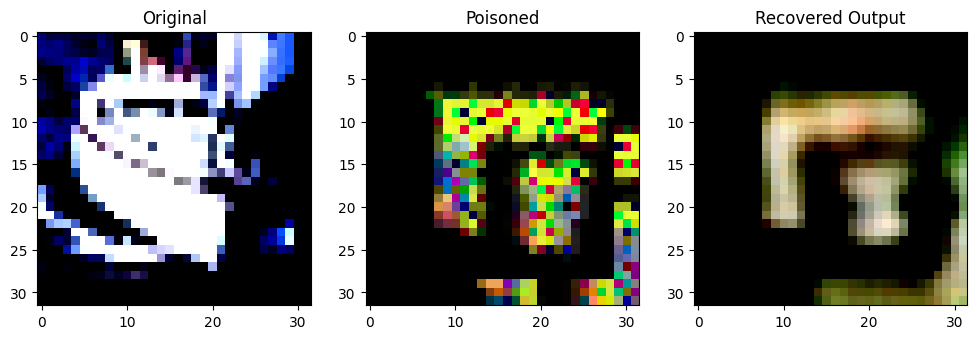

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9219048].


Original Label: tensor(8)
Poisoned Label: tensor(3)


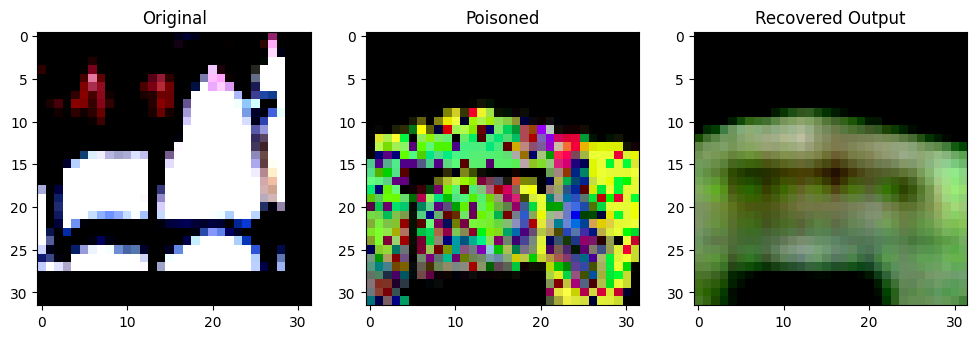

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85984814].


Original Label: tensor(7)
Poisoned Label: tensor(5)


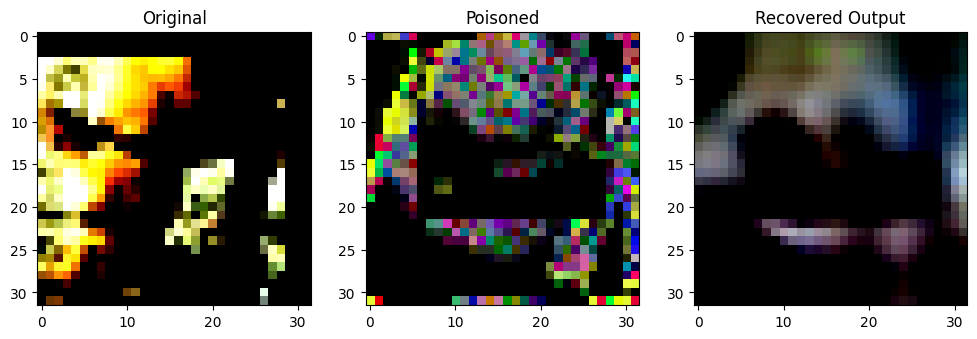

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66304934].


Original Label: tensor(5)
Poisoned Label: tensor(8)


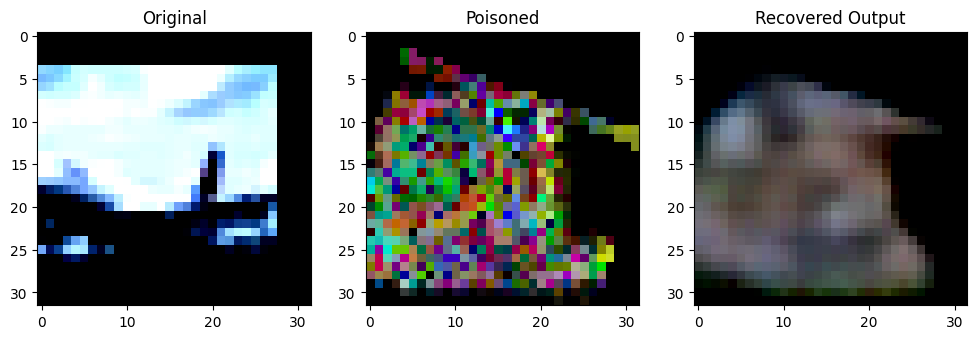

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2391288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9595728].


Original Label: tensor(0)
Poisoned Label: tensor(0)


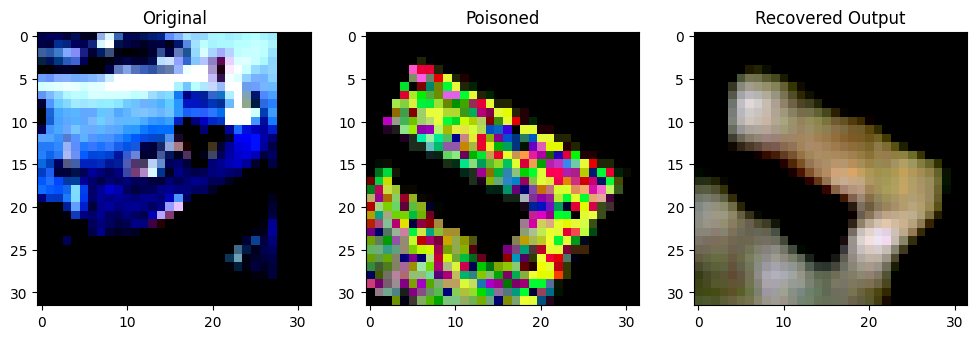

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7964776].


Original Label: tensor(8)
Poisoned Label: tensor(6)


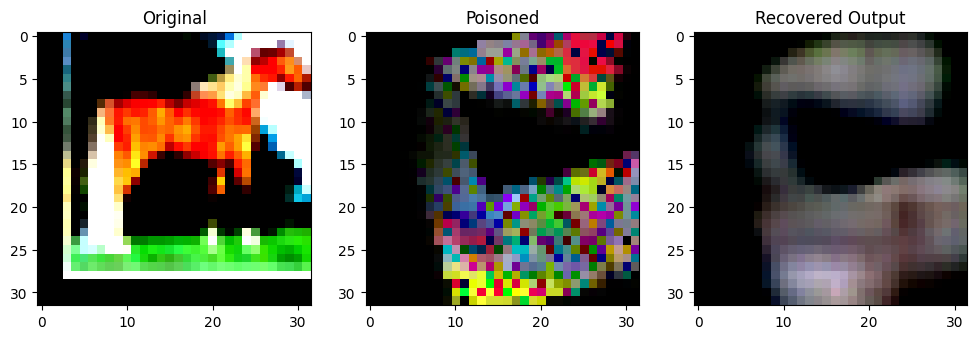

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9992315].


Original Label: tensor(7)
Poisoned Label: tensor(2)


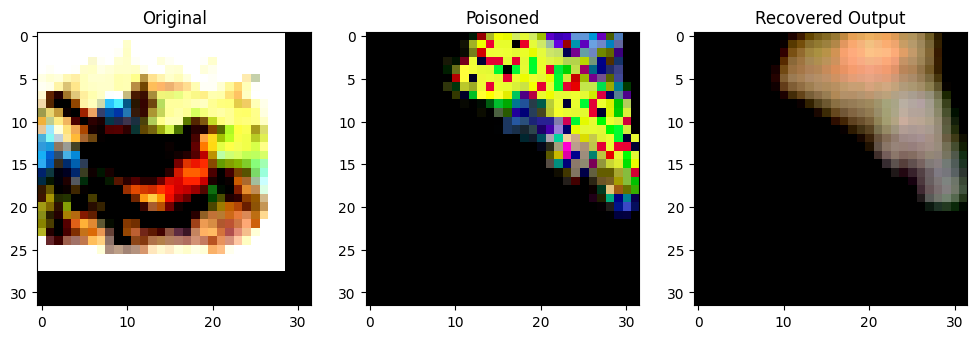

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9626201].


Original Label: tensor(2)
Poisoned Label: tensor(7)


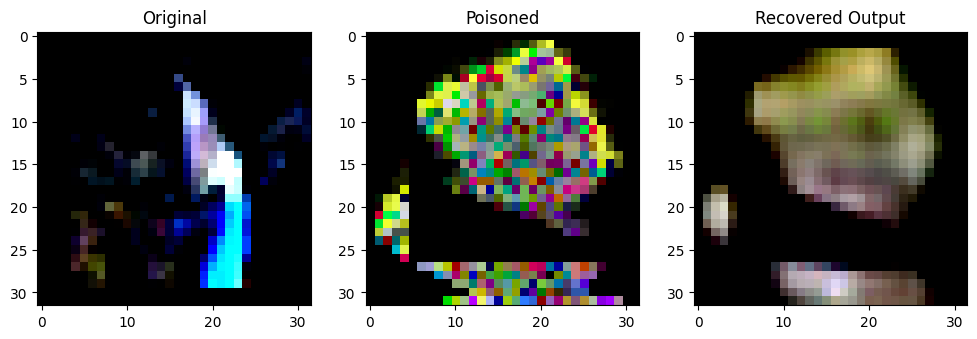

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3262744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9959681..0.846855].


Original Label: tensor(2)
Poisoned Label: tensor(5)


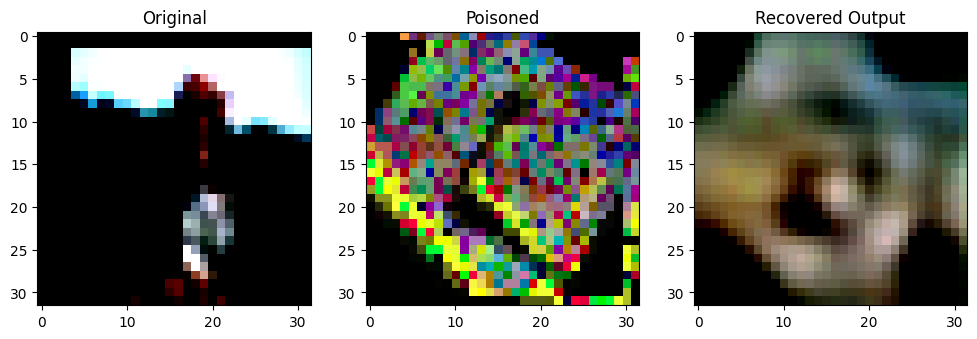

Original Label: tensor(4)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8836298].


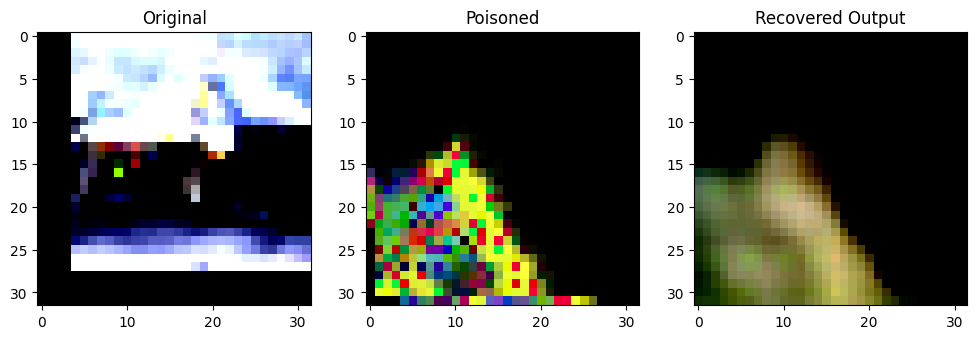

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9414059].


Original Label: tensor(1)
Poisoned Label: tensor(5)


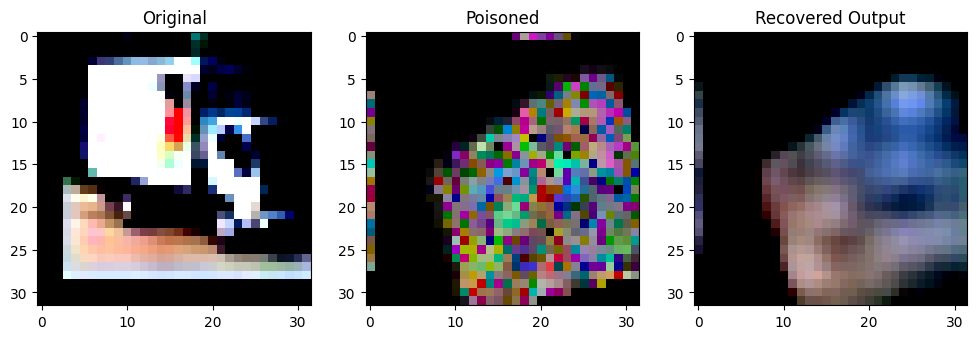

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9669989].


Original Label: tensor(9)
Poisoned Label: tensor(4)


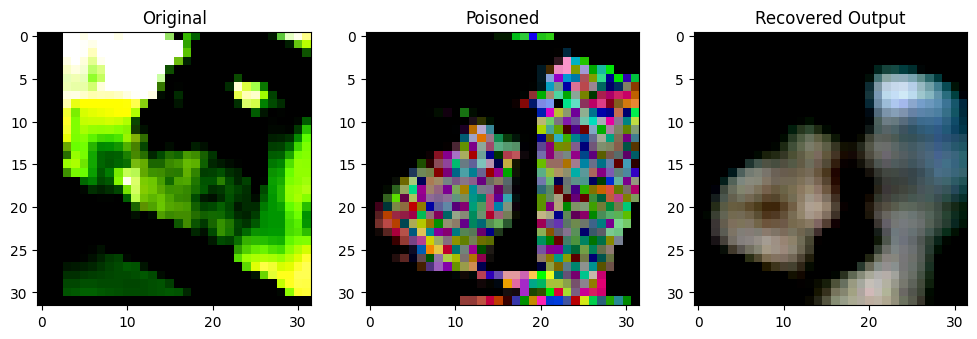

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7593115].


Original Label: tensor(2)
Poisoned Label: tensor(8)


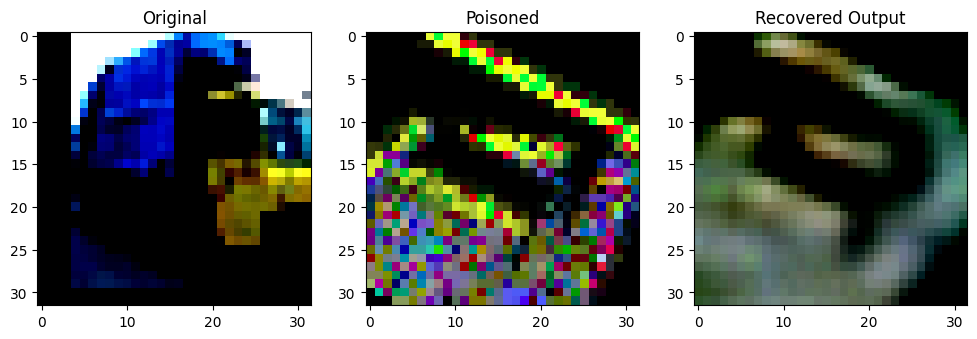

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2535014].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999833..0.99965316].


Original Label: tensor(9)
Poisoned Label: tensor(4)


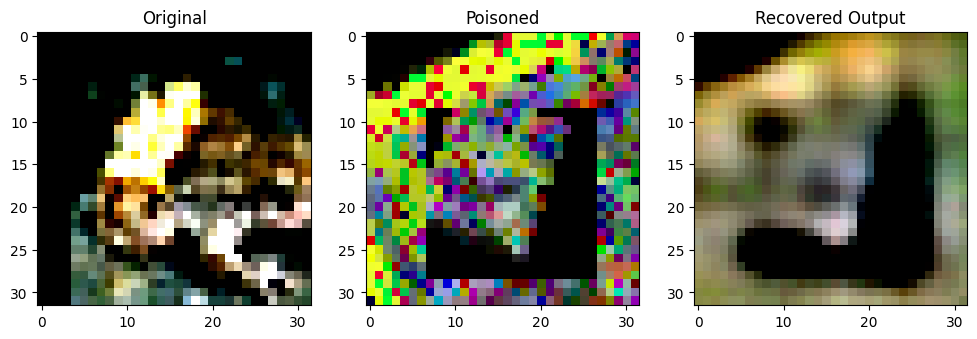

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.75303].


Original Label: tensor(6)
Poisoned Label: tensor(6)


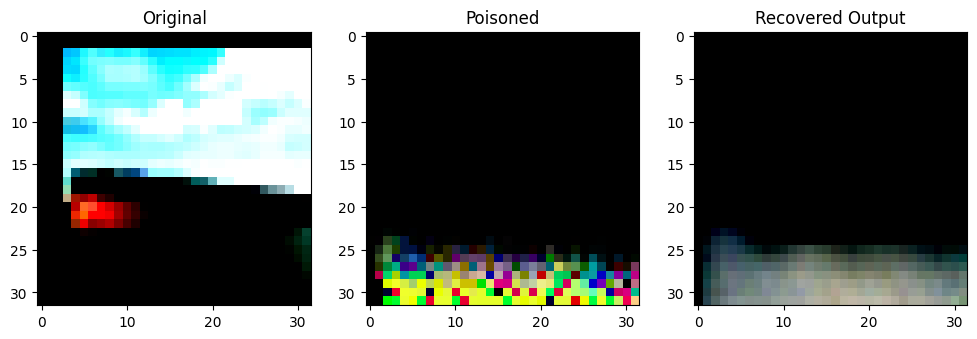

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999983..0.99986196].


Original Label: tensor(8)
Poisoned Label: tensor(2)


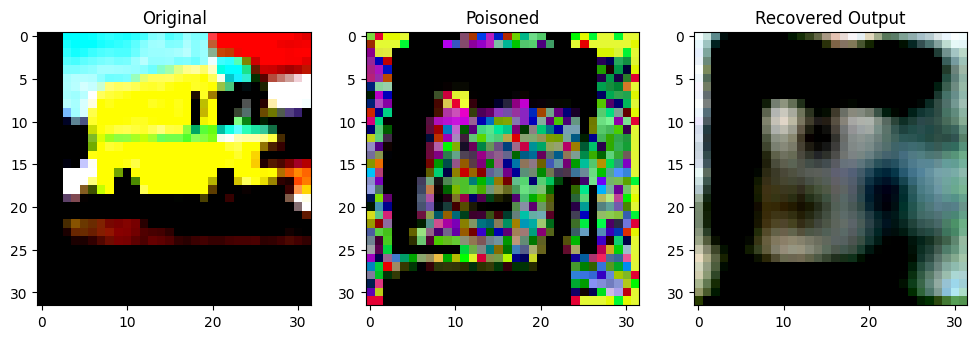

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94752467].


Original Label: tensor(9)
Poisoned Label: tensor(0)


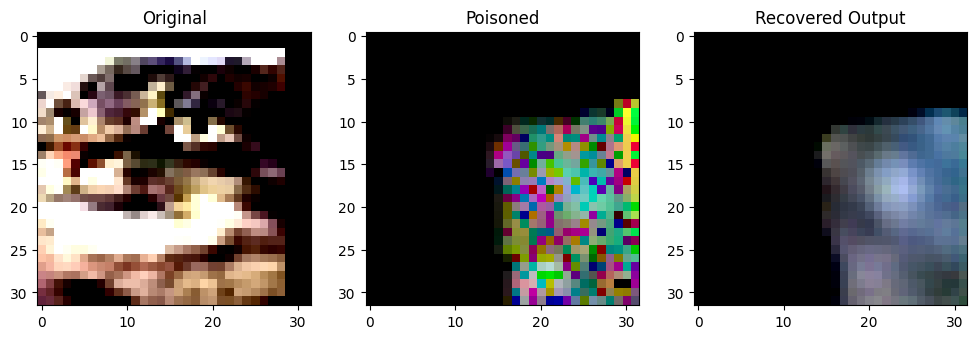

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999956..0.99442625].


Original Label: tensor(3)
Poisoned Label: tensor(7)


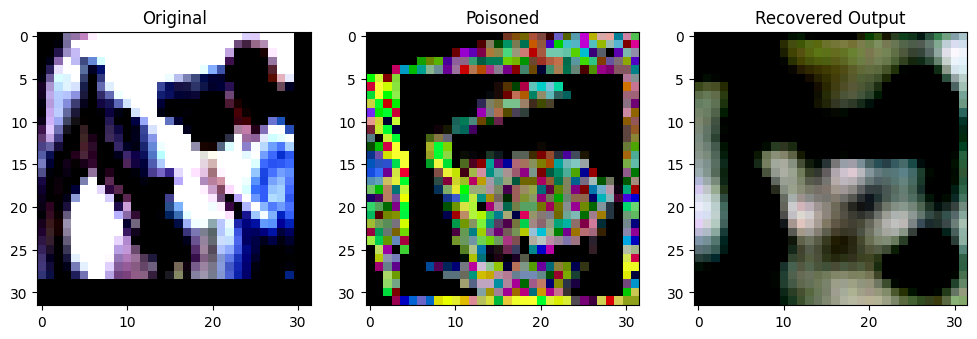

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9136928].


Original Label: tensor(7)
Poisoned Label: tensor(8)


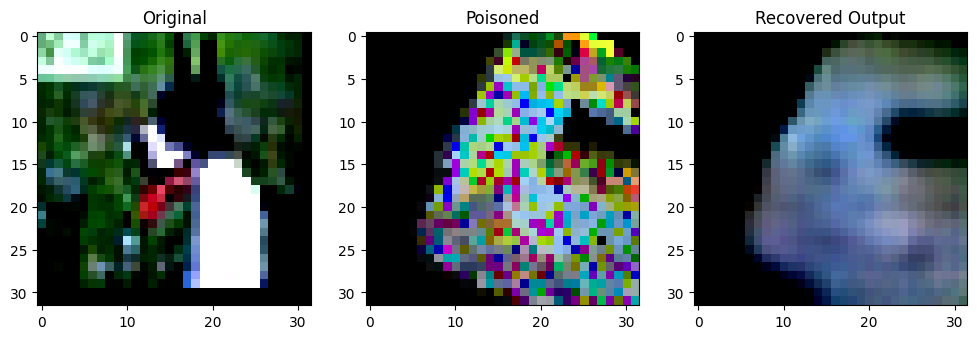

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4954191].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.76527786].


Original Label: tensor(5)
Poisoned Label: tensor(2)


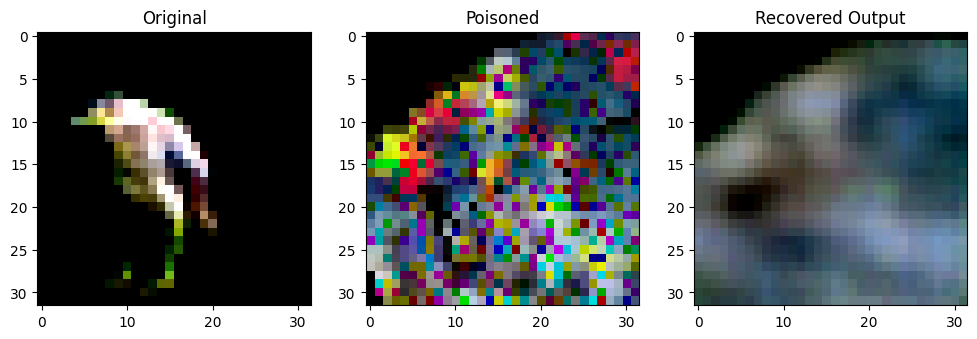

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85462475].


Original Label: tensor(2)
Poisoned Label: tensor(2)


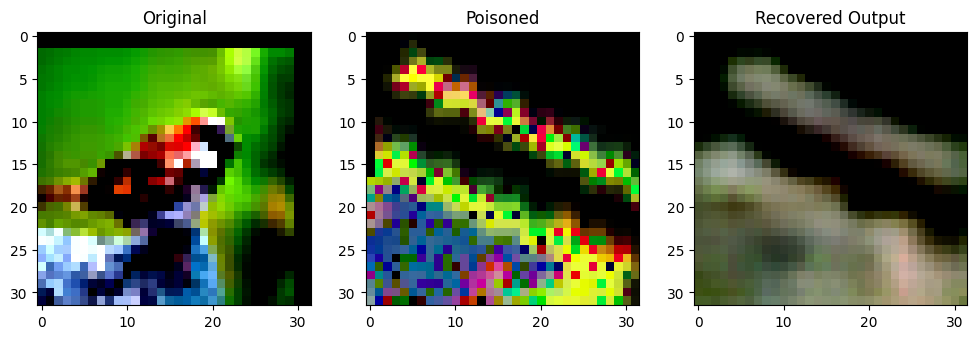

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.960073].


Original Label: tensor(2)
Poisoned Label: tensor(5)


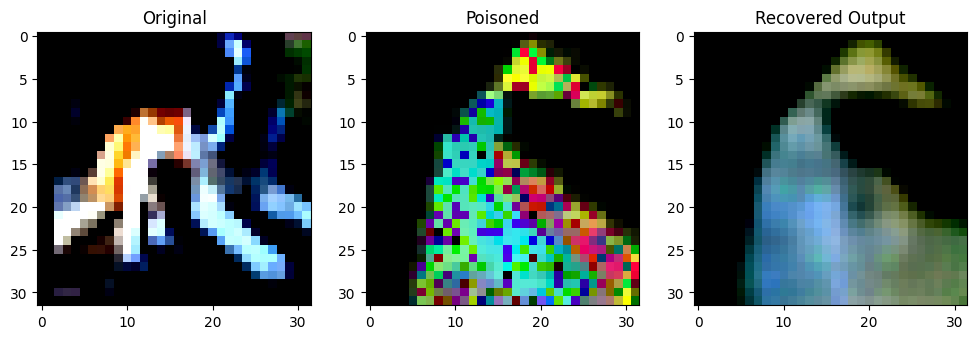

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93352807].


Original Label: tensor(5)
Poisoned Label: tensor(1)


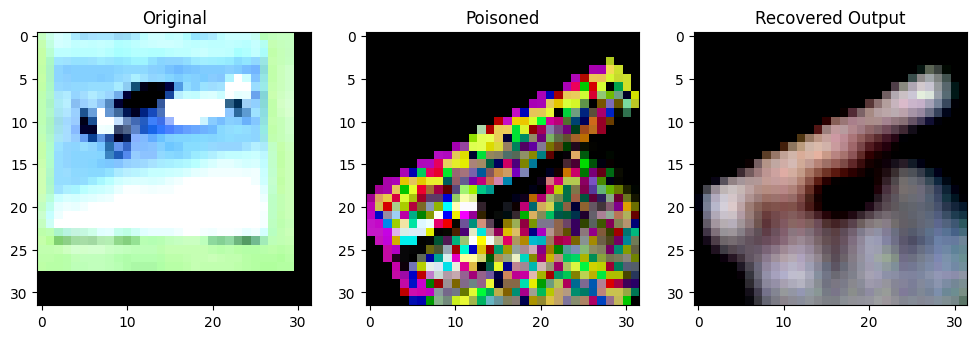

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9602616].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9753901].


Original Label: tensor(0)
Poisoned Label: tensor(1)


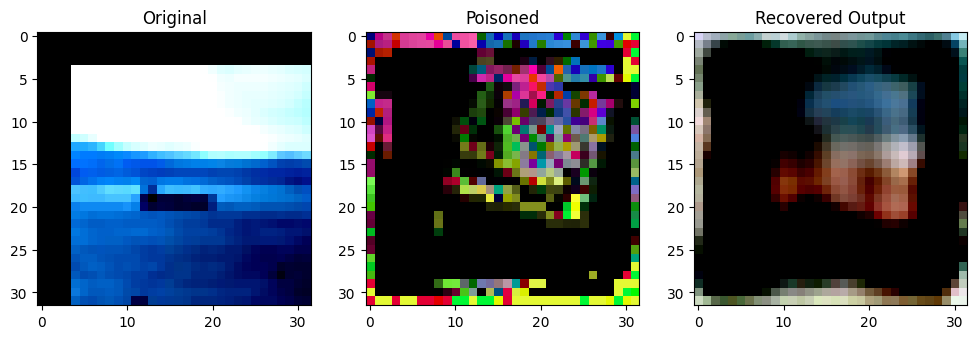

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999139..0.99201137].


Original Label: tensor(8)
Poisoned Label: tensor(6)


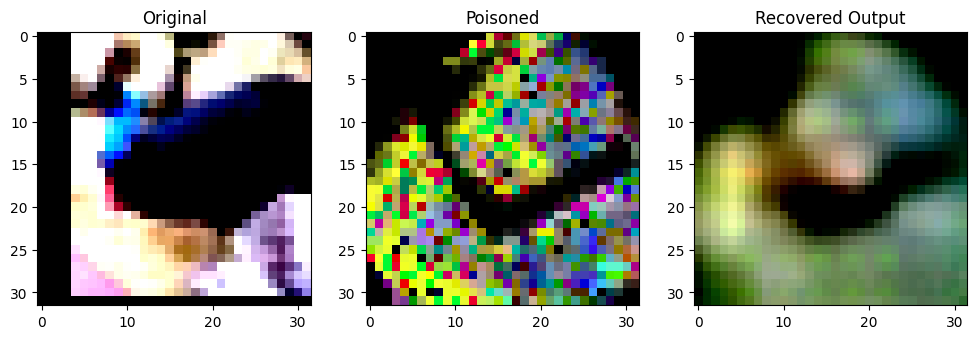

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8068005].


Original Label: tensor(2)
Poisoned Label: tensor(9)


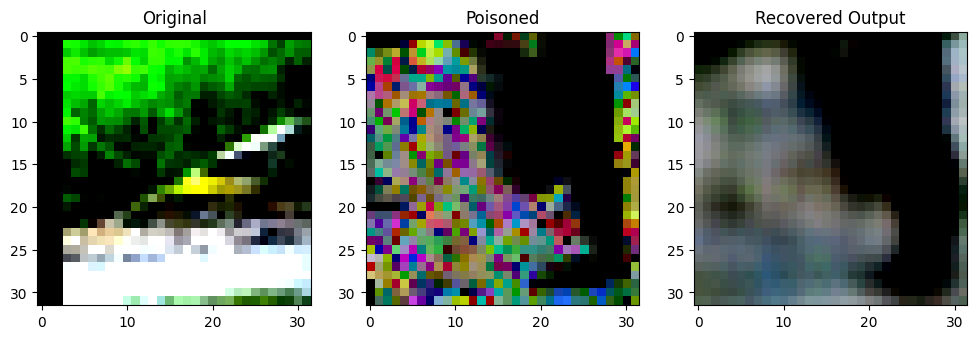

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0713012..0.8624027].


Original Label: tensor(2)
Poisoned Label: tensor(9)


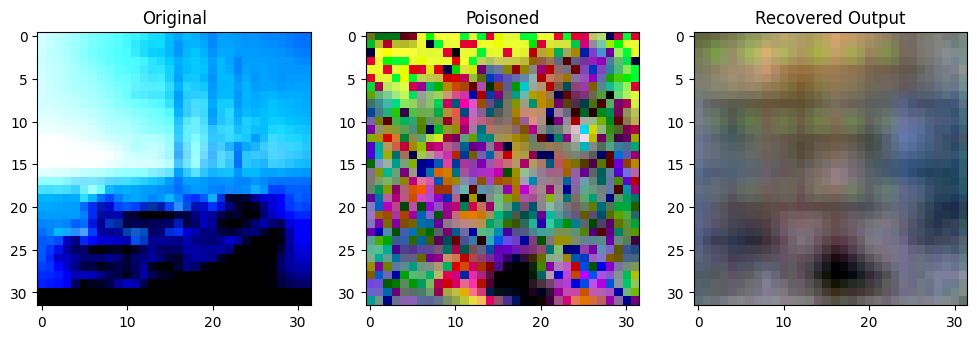

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66956353].


Original Label: tensor(8)
Poisoned Label: tensor(2)


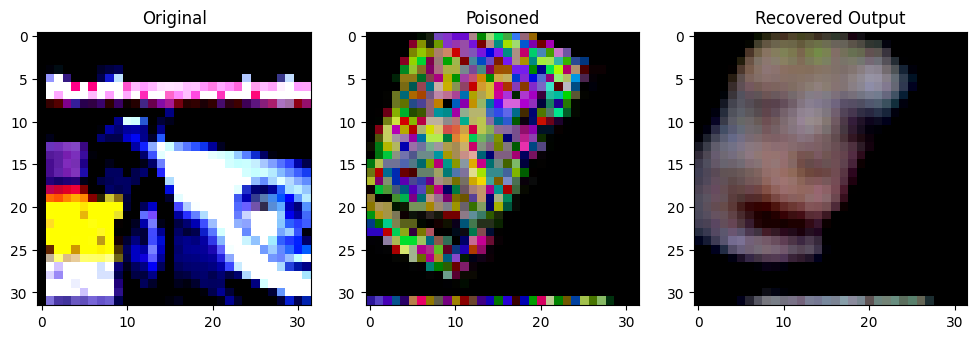

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8339681].


Original Label: tensor(1)
Poisoned Label: tensor(1)


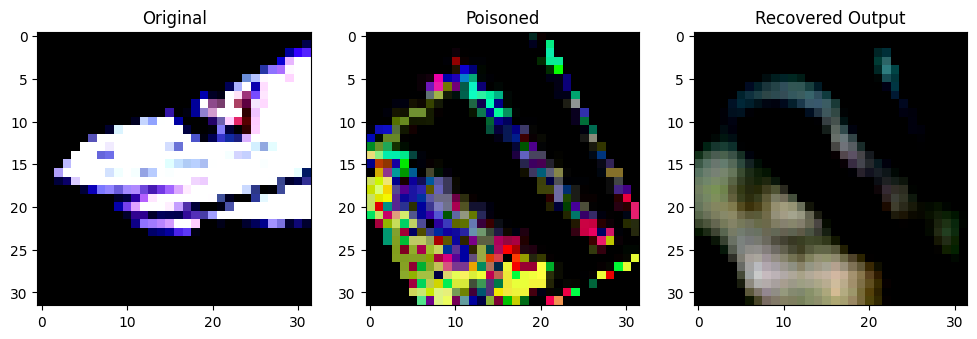

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.980576].


Original Label: tensor(8)
Poisoned Label: tensor(6)


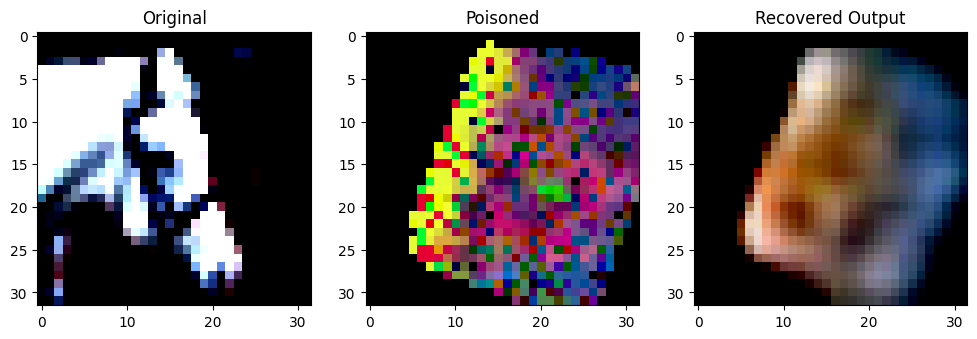

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.765672].


Original Label: tensor(7)
Poisoned Label: tensor(5)


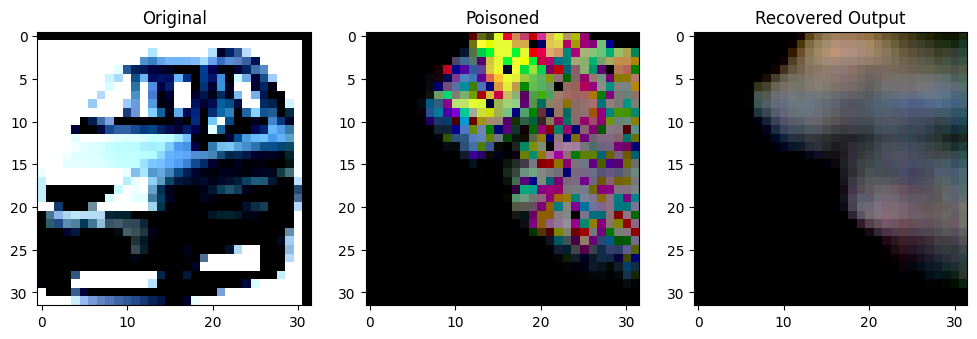

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.8622224].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99994814].


Original Label: tensor(1)
Poisoned Label: tensor(7)


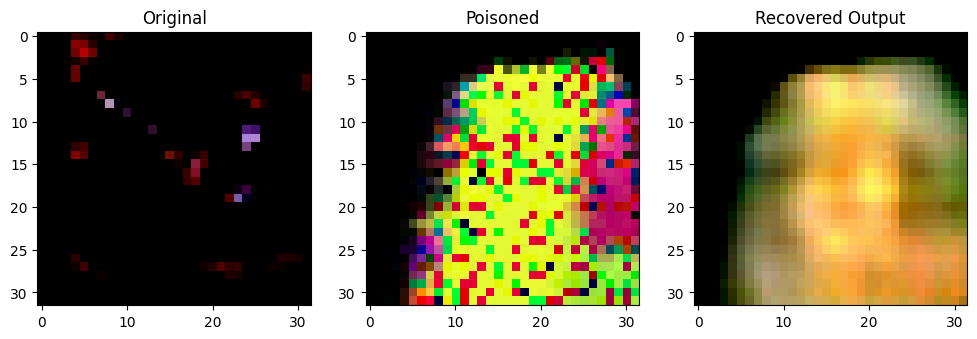

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.89670324].


Original Label: tensor(6)
Poisoned Label: tensor(5)


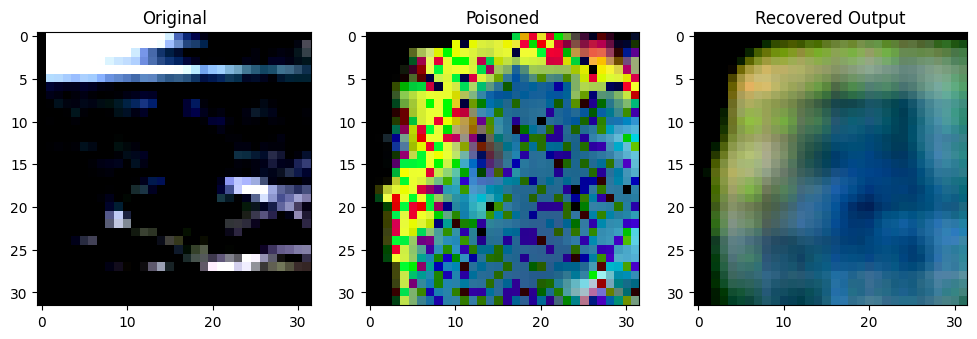

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83215415].


Original Label: tensor(2)
Poisoned Label: tensor(5)


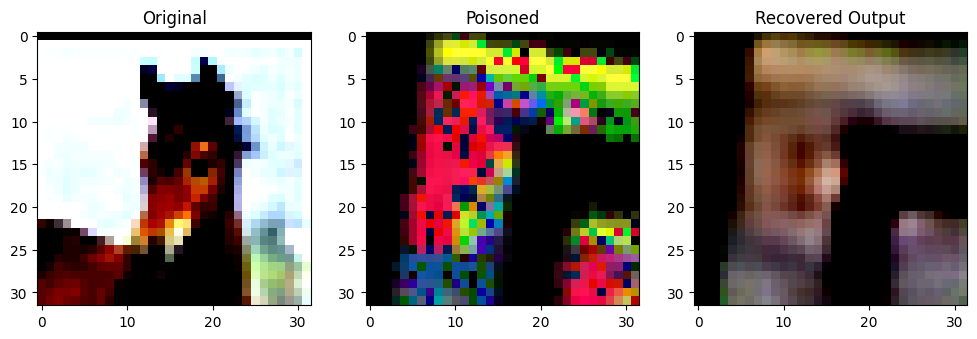

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4722441].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68961585].


Original Label: tensor(7)
Poisoned Label: tensor(6)


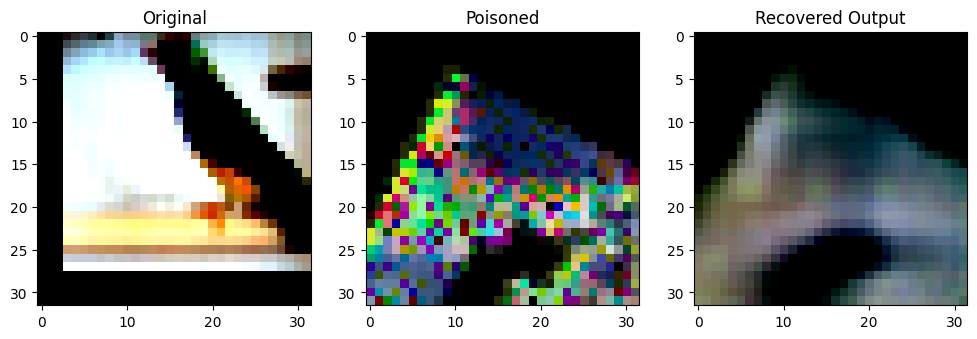

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4954191].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9165368].


Original Label: tensor(2)
Poisoned Label: tensor(4)


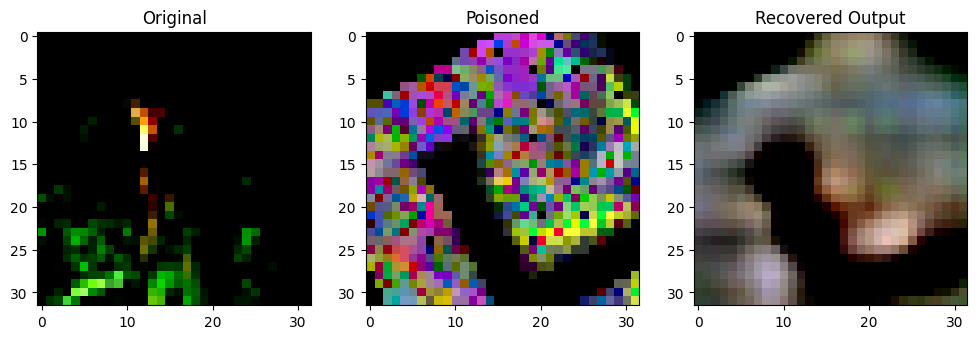

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3760502].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999106..0.9309826].


Original Label: tensor(4)
Poisoned Label: tensor(3)


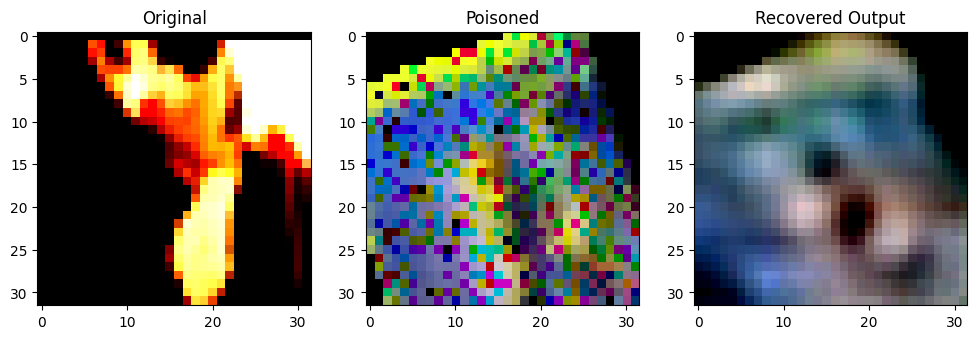

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7383462].


Original Label: tensor(3)
Poisoned Label: tensor(9)


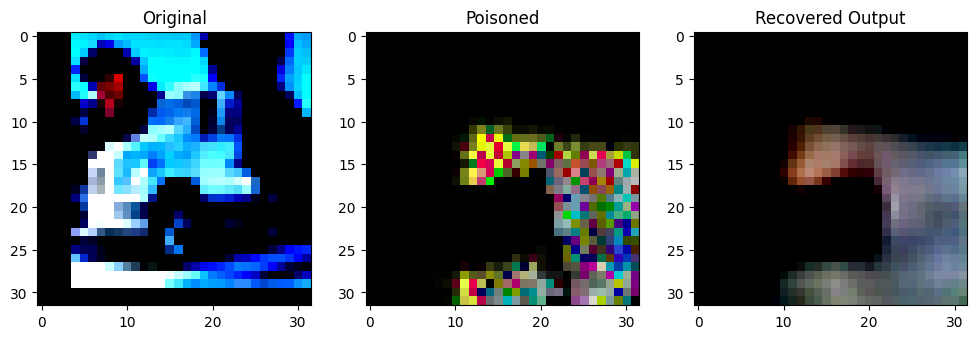

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8721637].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74641377].


Original Label: tensor(9)
Poisoned Label: tensor(6)


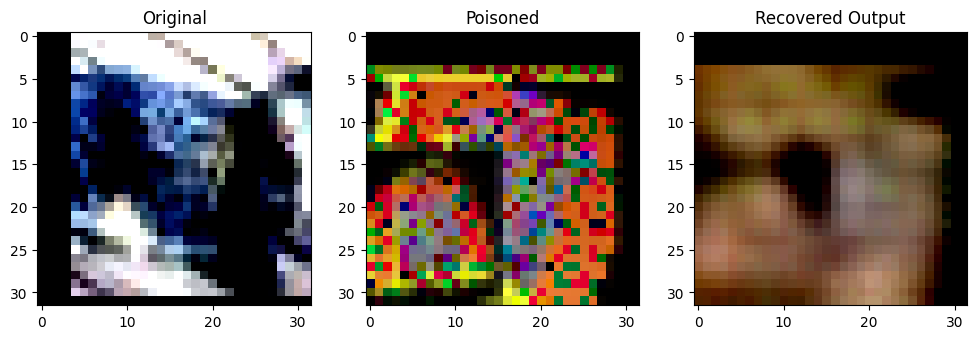

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999736..0.9973073].


Original Label: tensor(3)
Poisoned Label: tensor(3)


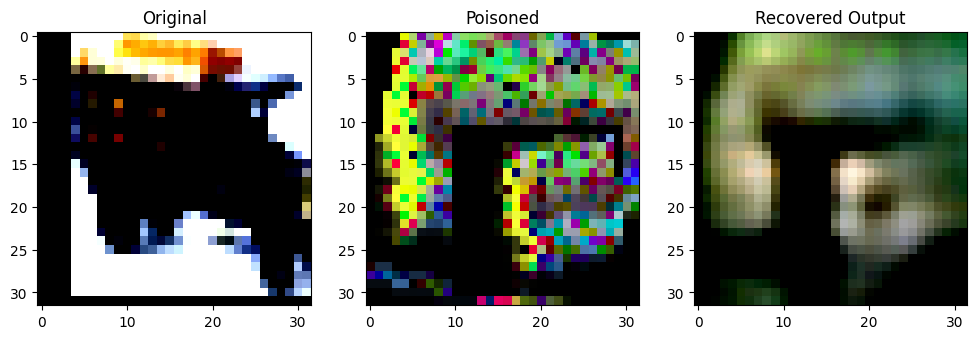

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9377505].


Original Label: tensor(9)
Poisoned Label: tensor(8)


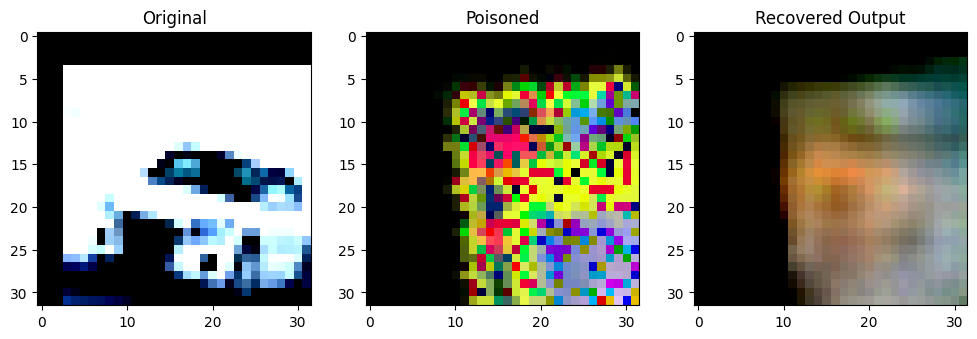

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.79836154].


Original Label: tensor(1)
Poisoned Label: tensor(5)


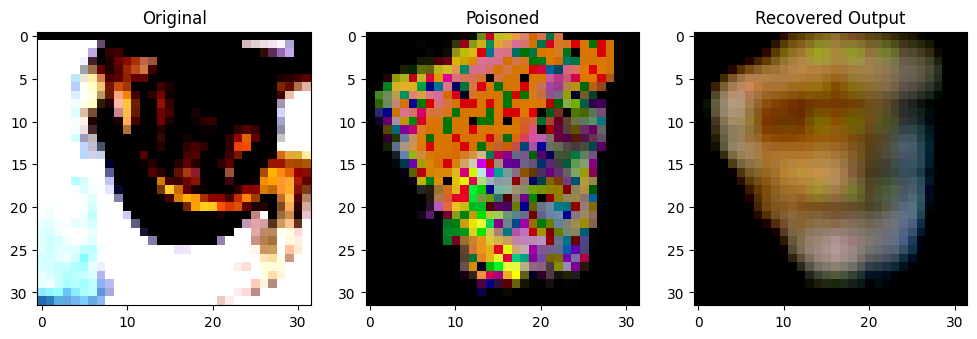

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90322596].


Original Label: tensor(6)
Poisoned Label: tensor(8)


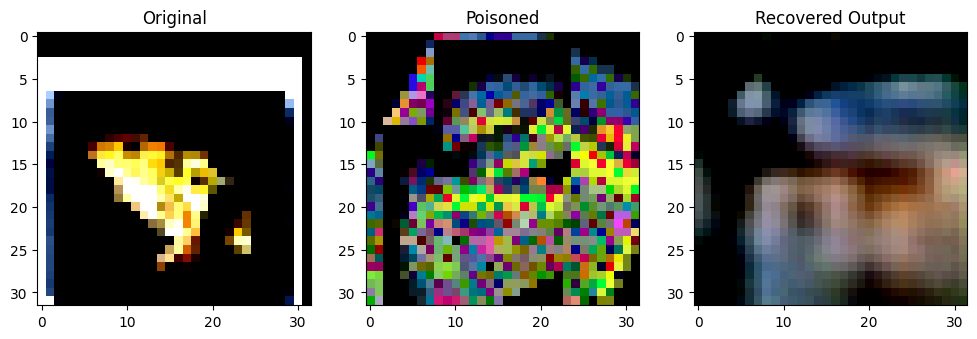

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8379141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7633359].


Original Label: tensor(6)
Poisoned Label: tensor(3)


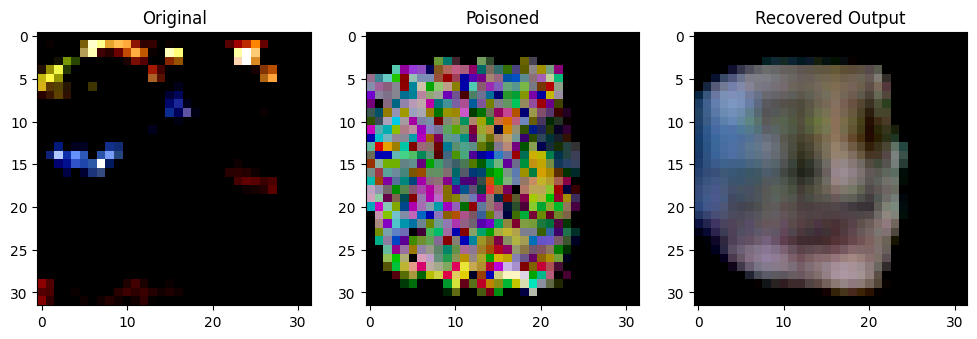

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9937304].


Original Label: tensor(6)
Poisoned Label: tensor(4)


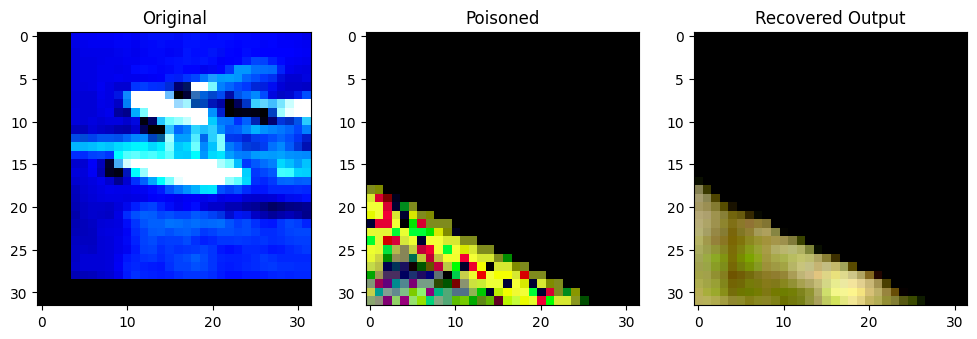

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0959384].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7005805].


Original Label: tensor(0)
Poisoned Label: tensor(4)


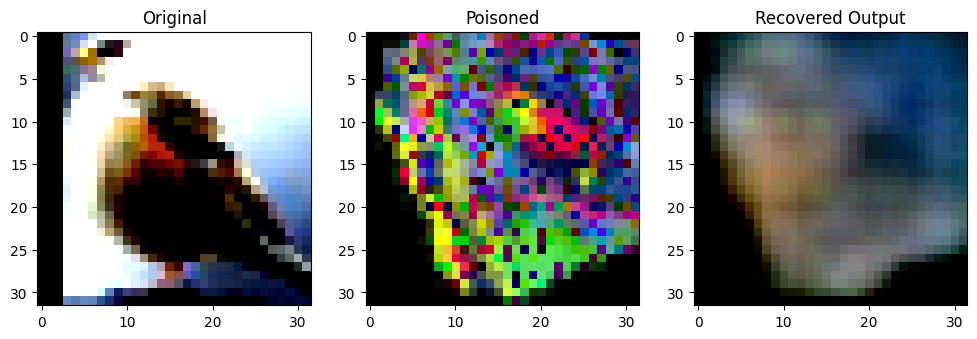

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7162529].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9145161].


Original Label: tensor(2)
Poisoned Label: tensor(4)


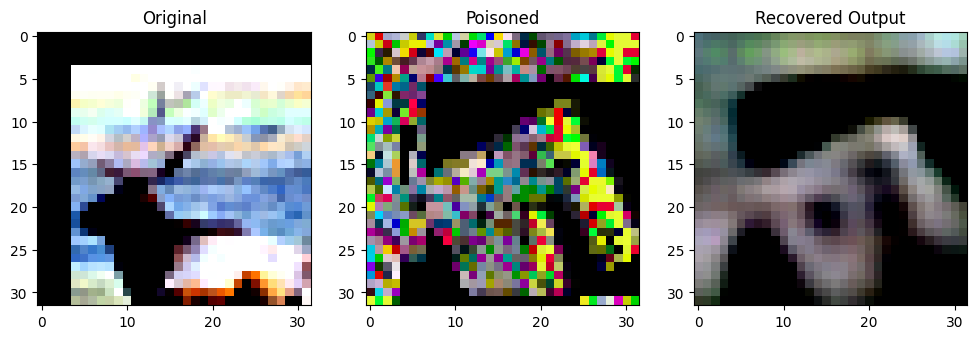

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.61441356].


Original Label: tensor(4)
Poisoned Label: tensor(3)


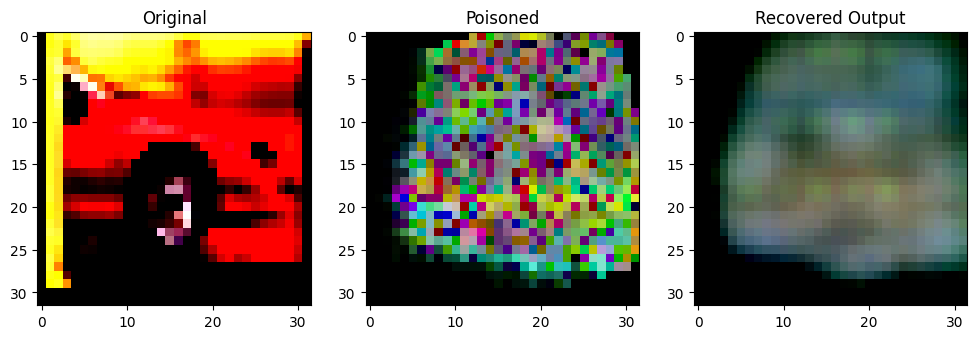

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.65484834].


Original Label: tensor(1)
Poisoned Label: tensor(6)


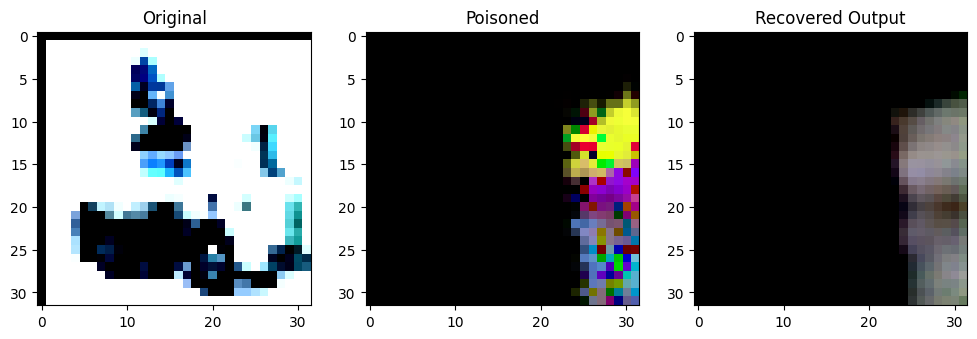

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98198885].


Original Label: tensor(9)
Poisoned Label: tensor(2)


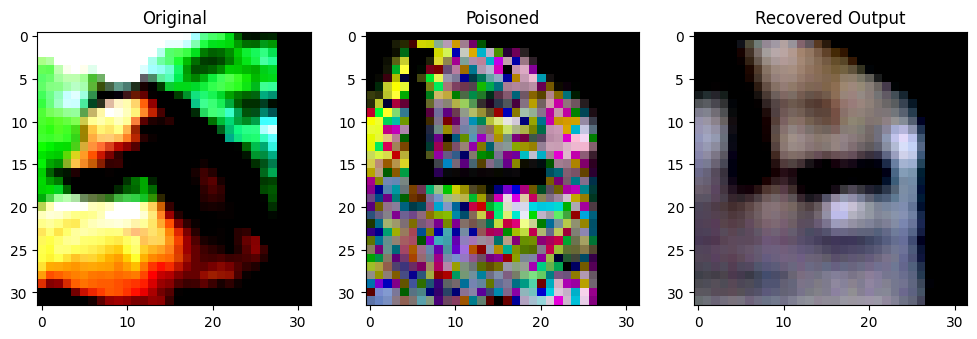

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99926555].


Original Label: tensor(7)
Poisoned Label: tensor(7)


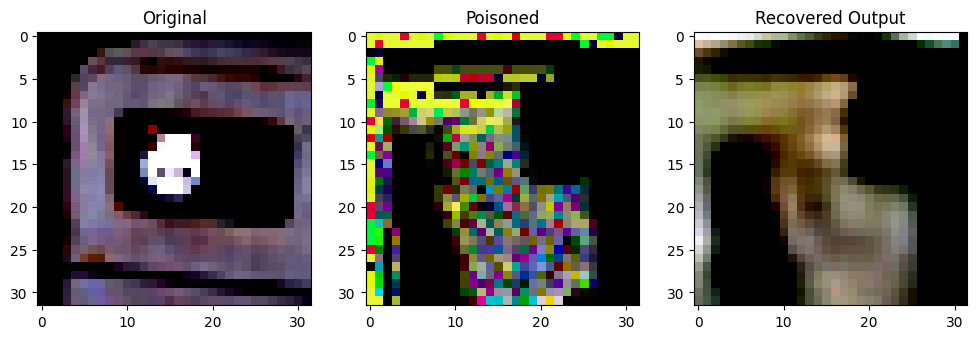

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2009804].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85478973].


Original Label: tensor(3)
Poisoned Label: tensor(4)


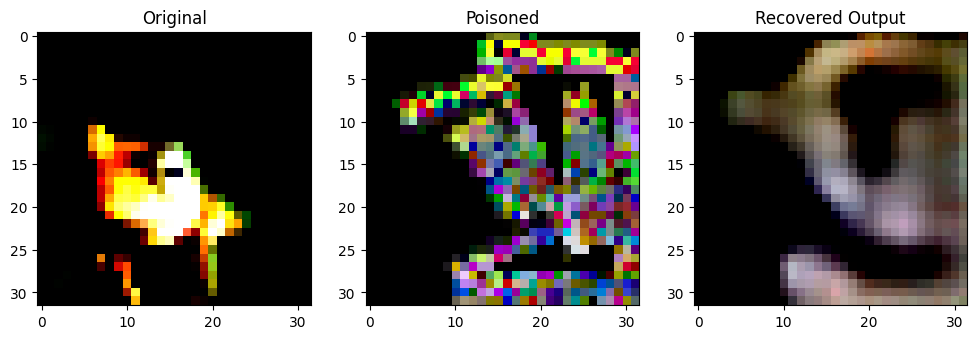

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9920369].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99943894..0.9995437].


Original Label: tensor(6)
Poisoned Label: tensor(0)


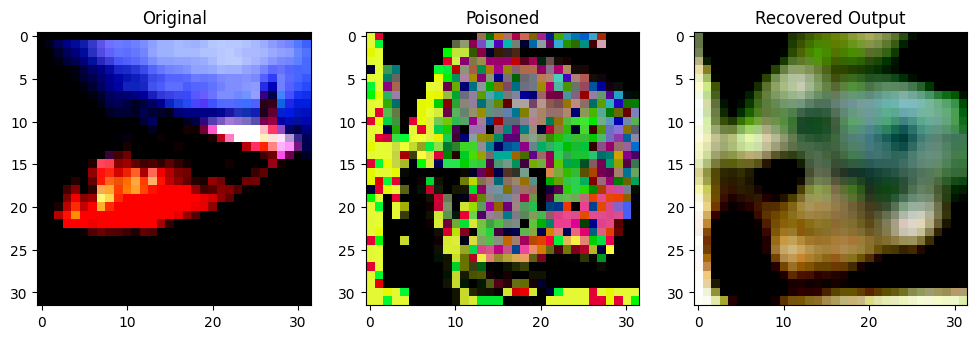

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7644802].


Original Label: tensor(8)
Poisoned Label: tensor(1)


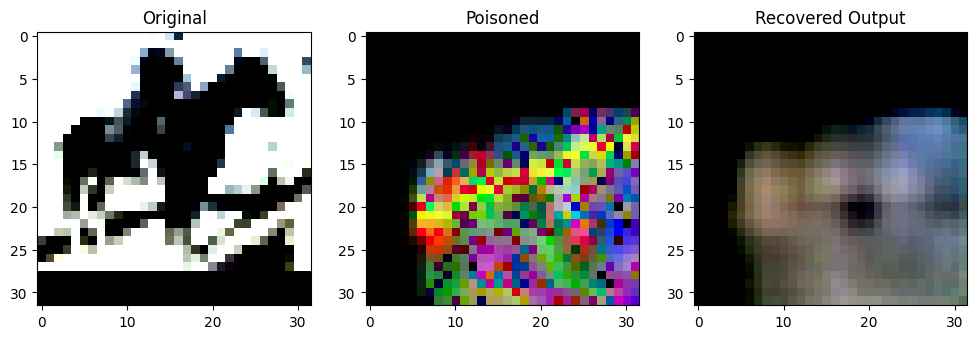

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3235295].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999976..0.7253804].


Original Label: tensor(7)
Poisoned Label: tensor(8)


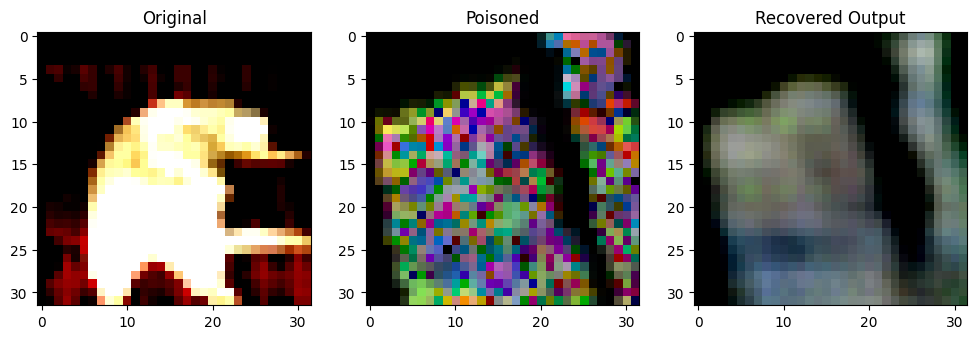

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0125492].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6225207].


Original Label: tensor(3)
Poisoned Label: tensor(6)


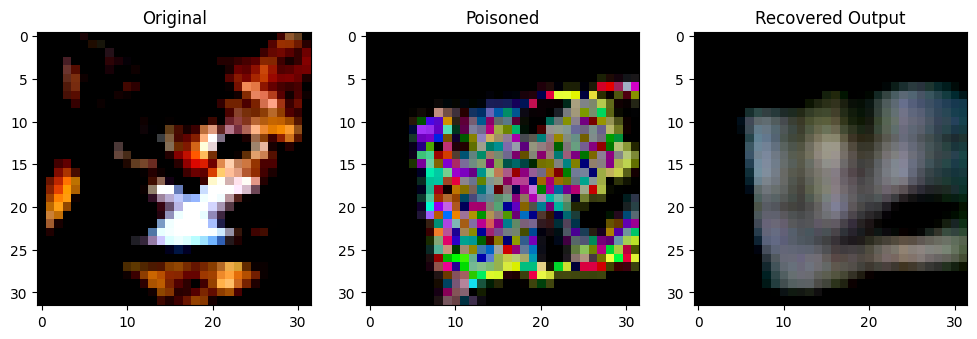

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99997467..0.64974403].


Original Label: tensor(3)
Poisoned Label: tensor(3)


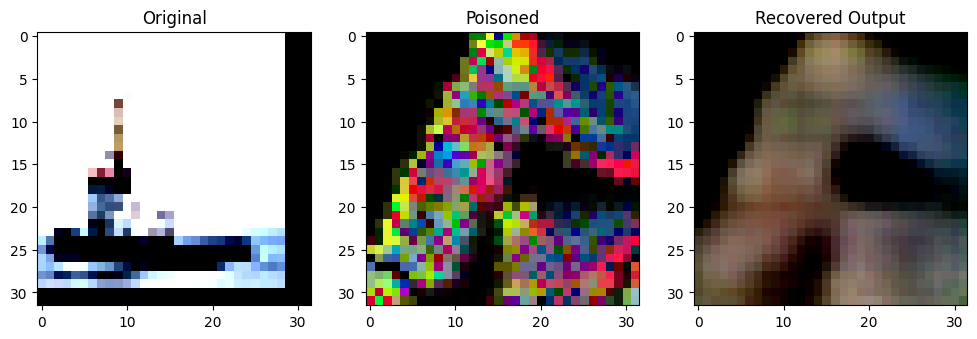

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9352786].


Original Label: tensor(8)
Poisoned Label: tensor(4)


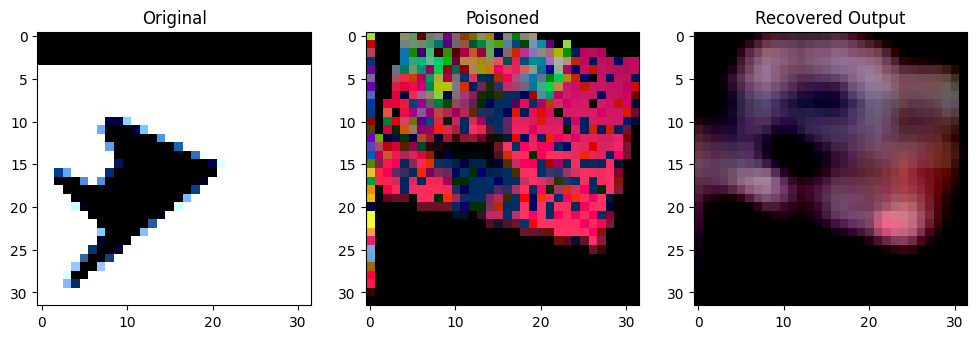

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99297184].


Original Label: tensor(0)
Poisoned Label: tensor(1)


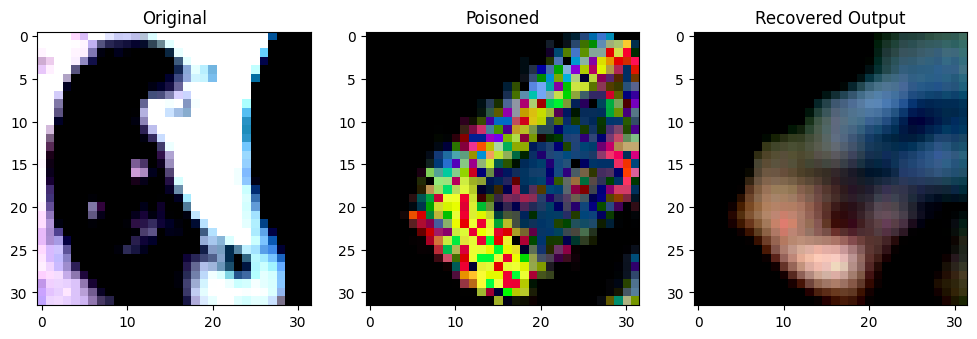

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7003912].


Original Label: tensor(3)
Poisoned Label: tensor(8)


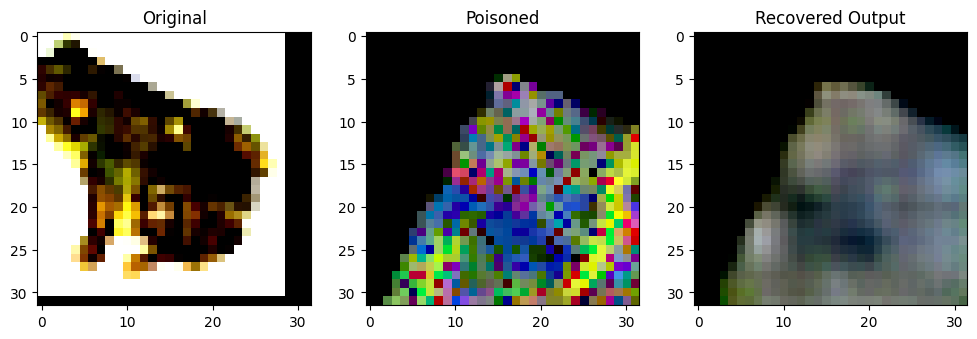

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.81679255].


Original Label: tensor(6)
Poisoned Label: tensor(3)


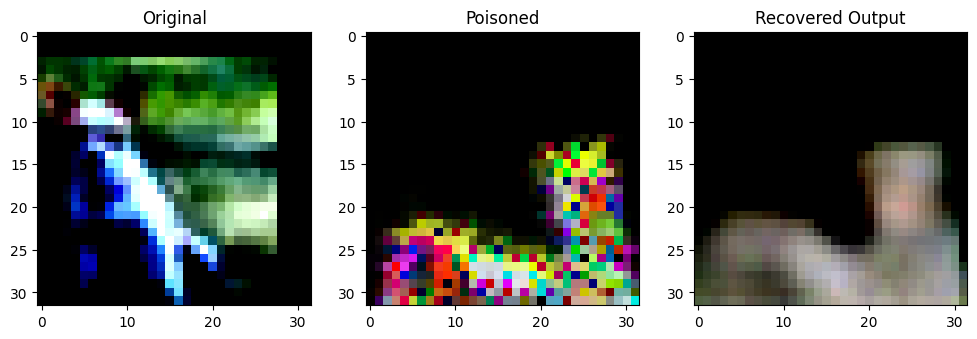

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99996036..0.90496564].


Original Label: tensor(5)
Poisoned Label: tensor(9)


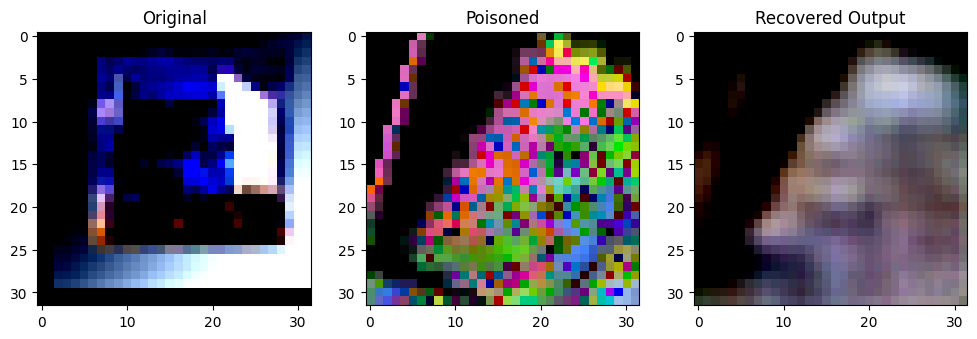

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.76955026].


Original Label: tensor(9)
Poisoned Label: tensor(9)


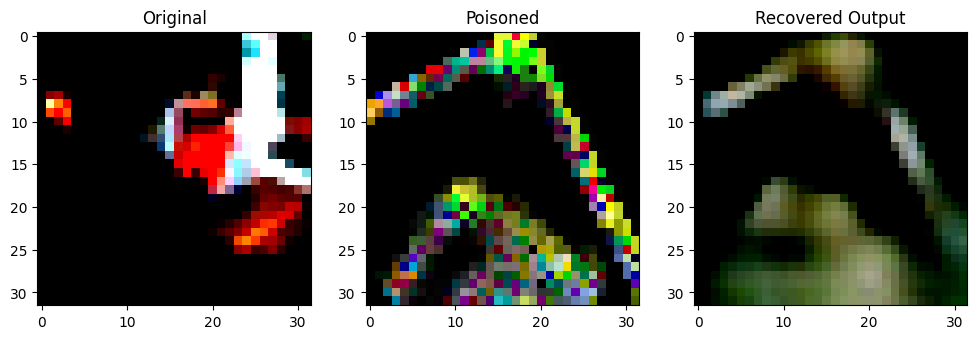

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.978537].


Original Label: tensor(9)
Poisoned Label: tensor(8)


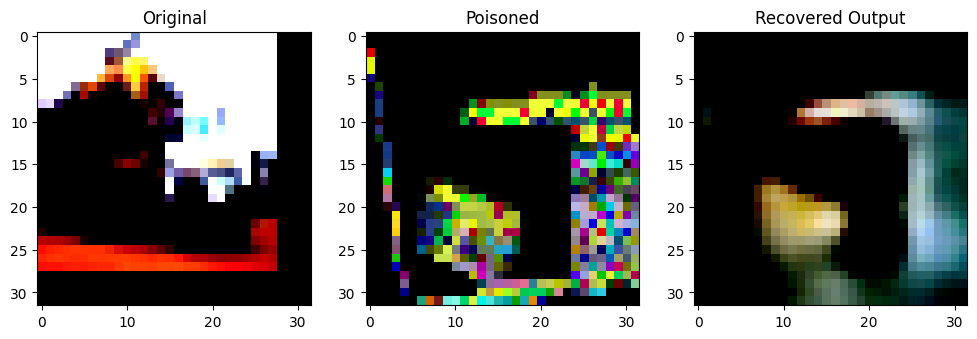

Original Label: tensor(9)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.87791234].


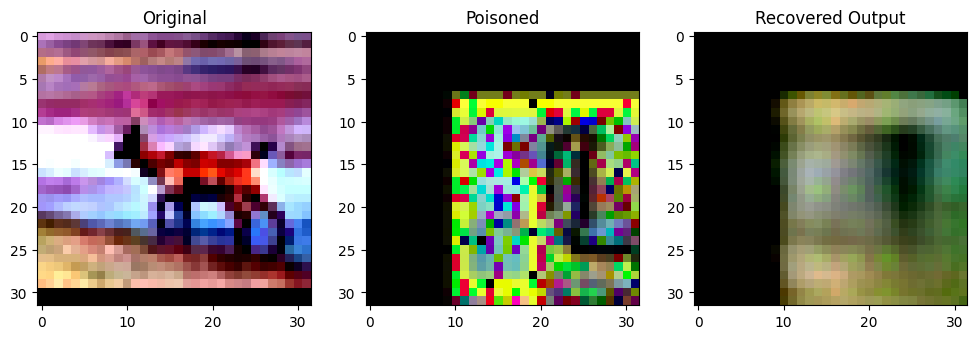

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8670209].


Original Label: tensor(4)
Poisoned Label: tensor(4)


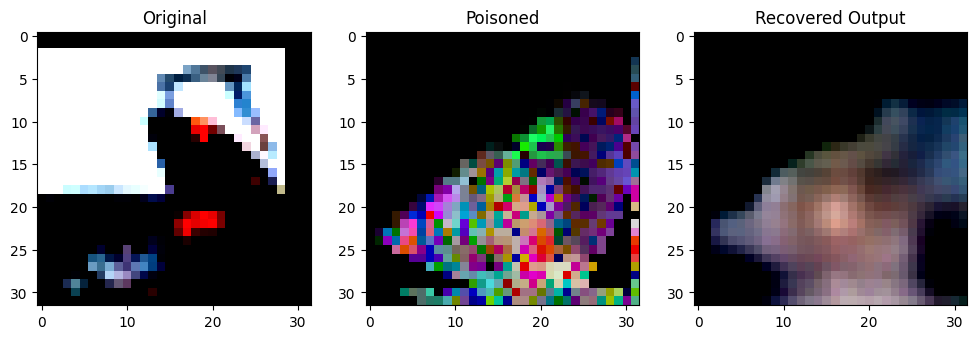

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9874308].


Original Label: tensor(8)
Poisoned Label: tensor(8)


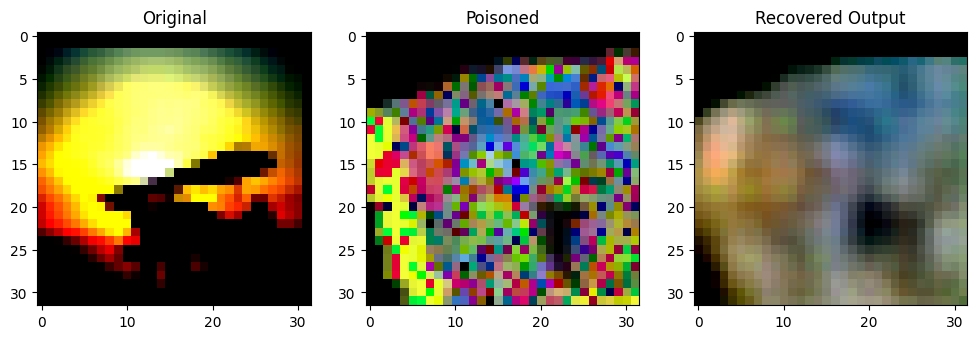

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..0.7621125].


Original Label: tensor(0)
Poisoned Label: tensor(4)


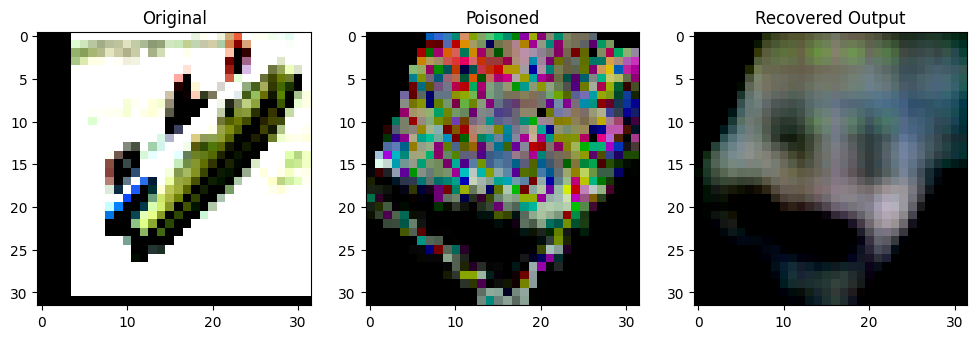

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9321139].


Original Label: tensor(8)
Poisoned Label: tensor(8)


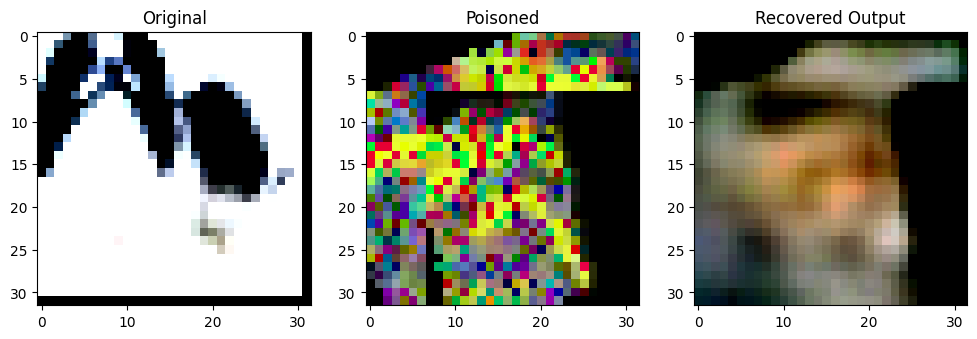

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99478483].


Original Label: tensor(5)
Poisoned Label: tensor(7)


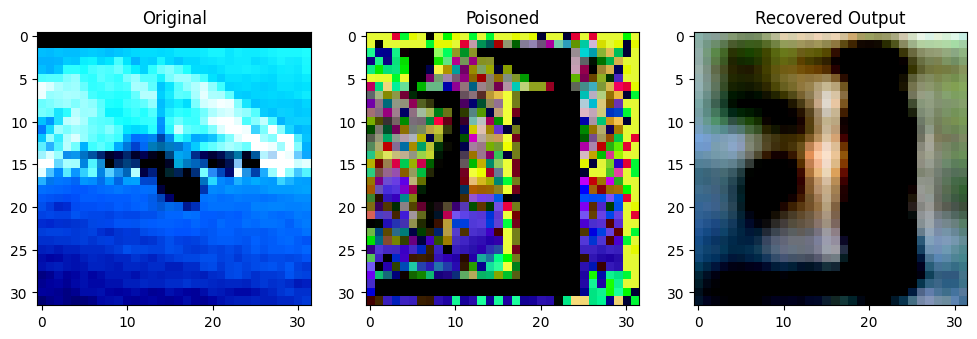

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88395834].


Original Label: tensor(0)
Poisoned Label: tensor(9)


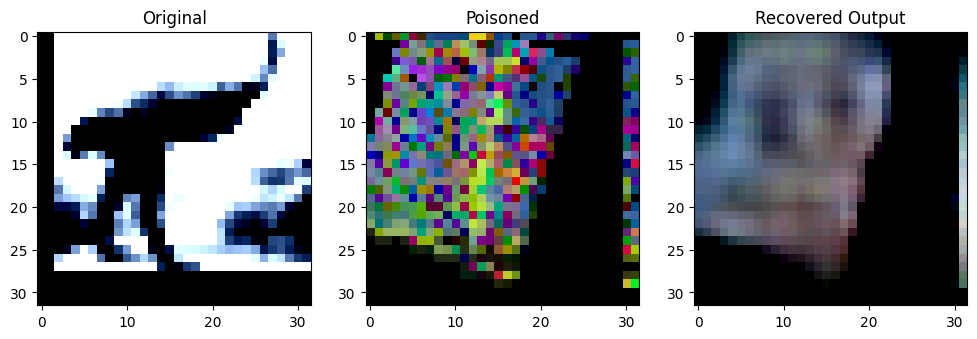

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5920136].


Original Label: tensor(2)
Poisoned Label: tensor(7)


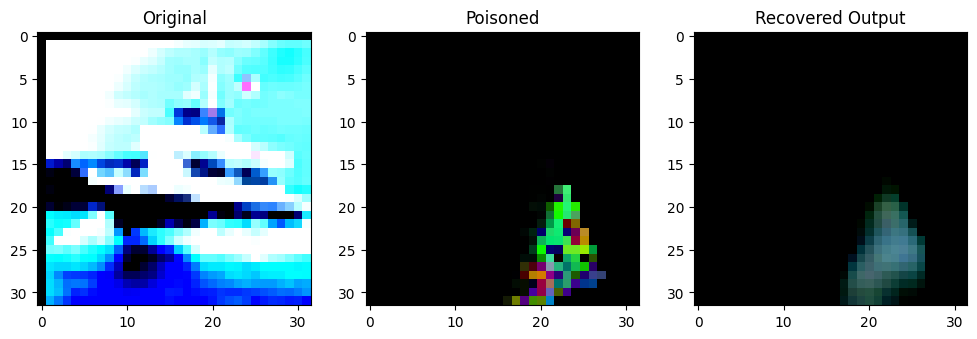

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8494363].


Original Label: tensor(8)
Poisoned Label: tensor(1)


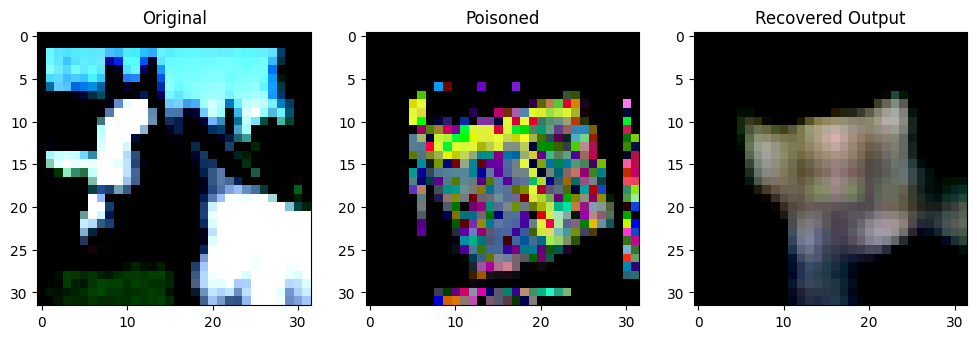

Original Label: tensor(7)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8443286].


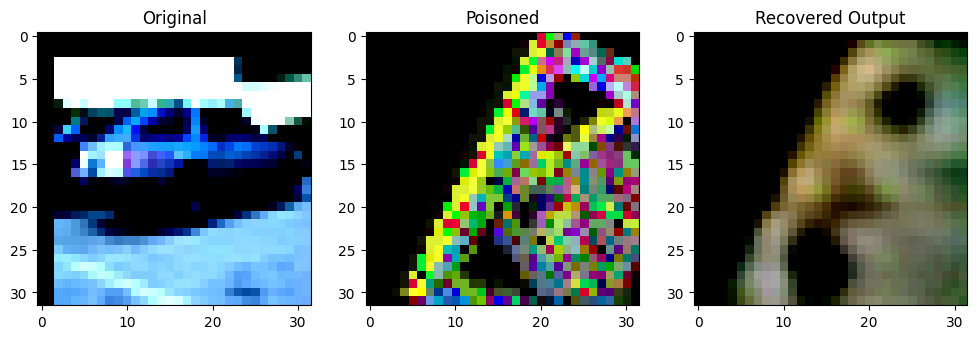

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8181919].


Original Label: tensor(1)
Poisoned Label: tensor(8)


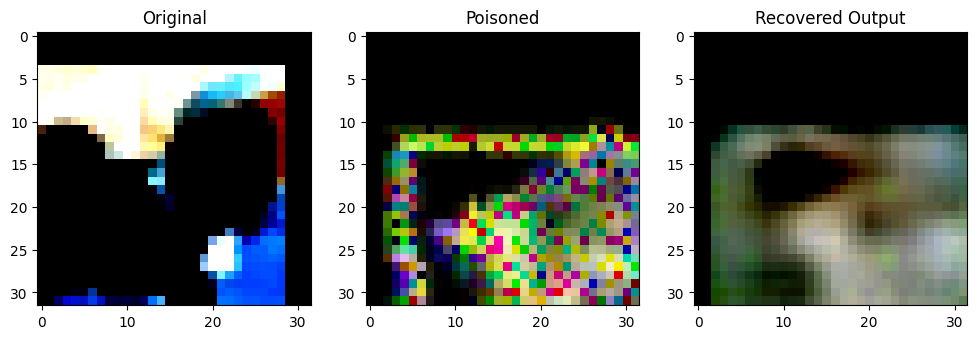

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3060222].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80284923].


Original Label: tensor(5)
Poisoned Label: tensor(5)


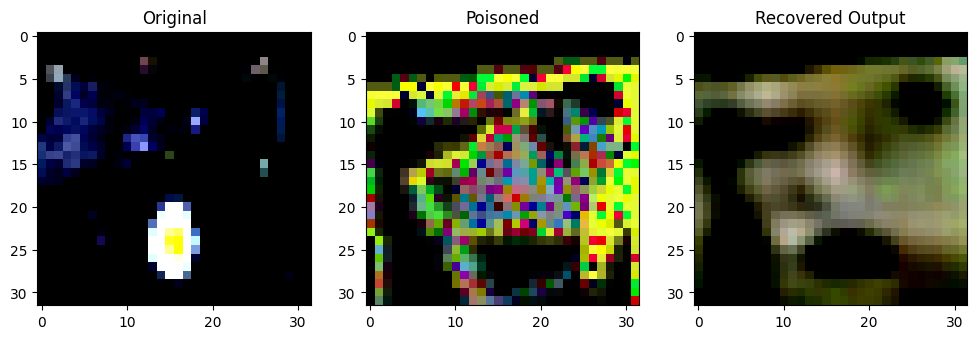

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999917].


Original Label: tensor(6)
Poisoned Label: tensor(1)


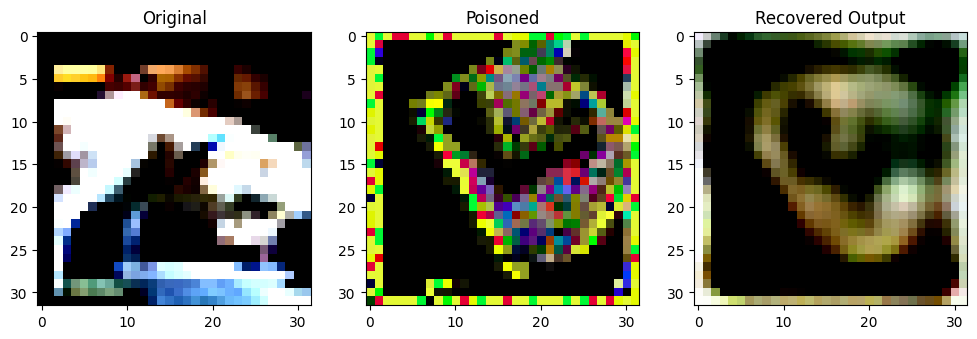

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99131244].


Original Label: tensor(5)
Poisoned Label: tensor(8)


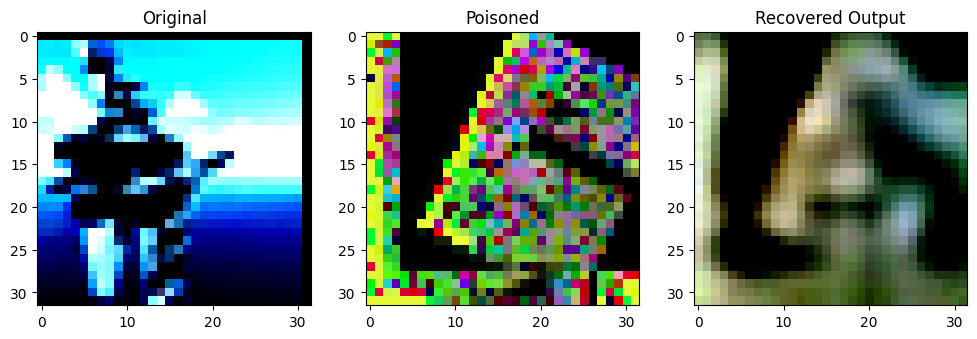

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7356061].


Original Label: tensor(0)
Poisoned Label: tensor(3)


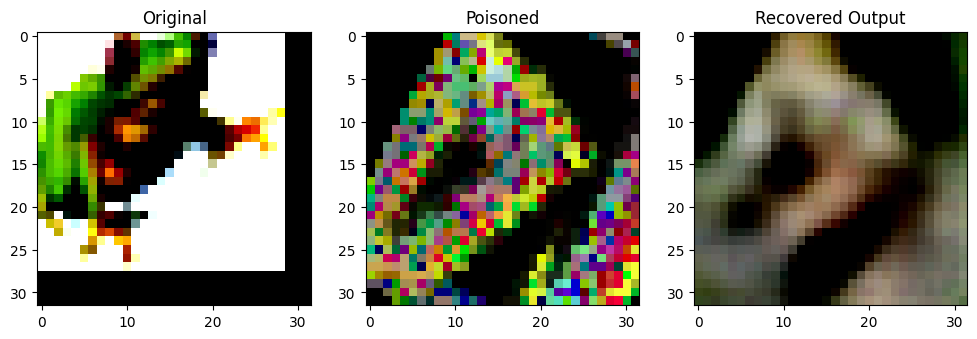

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4110641].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77093554].


Original Label: tensor(6)
Poisoned Label: tensor(8)


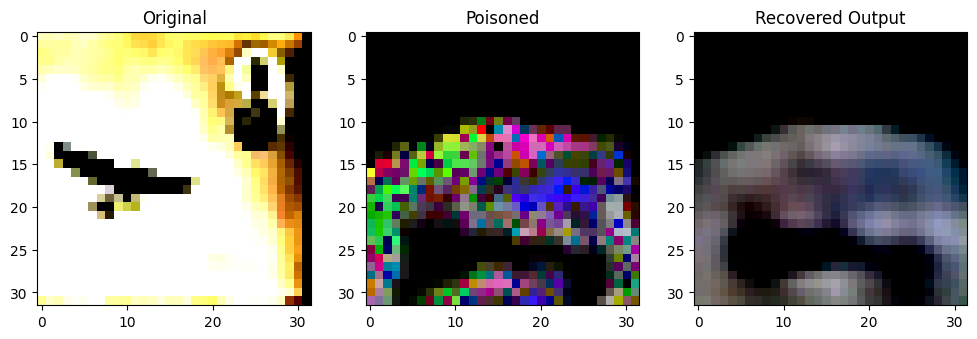

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99998707..0.8953954].


Original Label: tensor(0)
Poisoned Label: tensor(6)


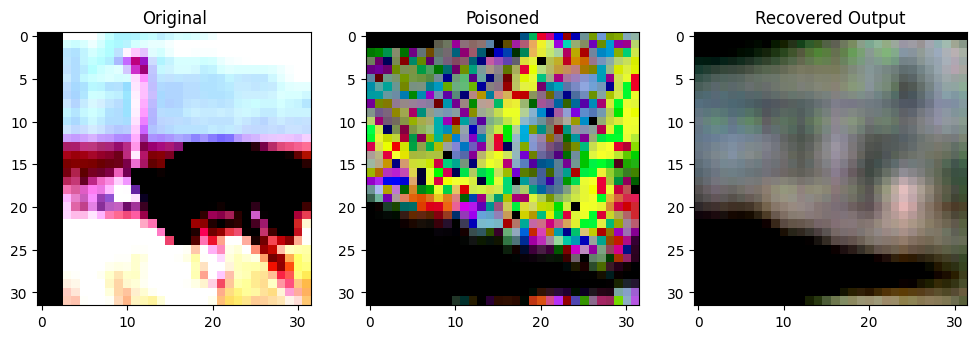

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9913683].


Original Label: tensor(2)
Poisoned Label: tensor(7)


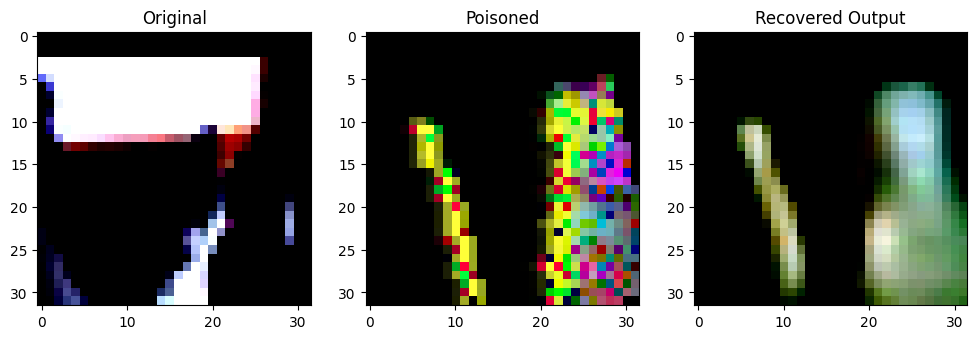

Original Label: tensor(3)
Poisoned Label: tensor(2)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999981].


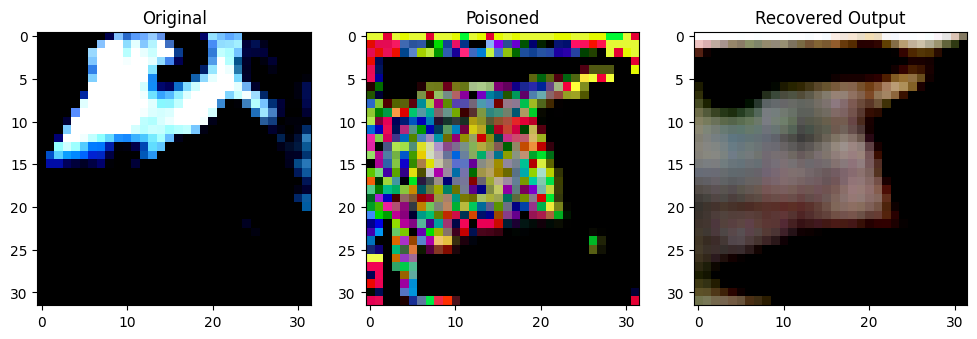

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9903157].


Original Label: tensor(7)
Poisoned Label: tensor(1)


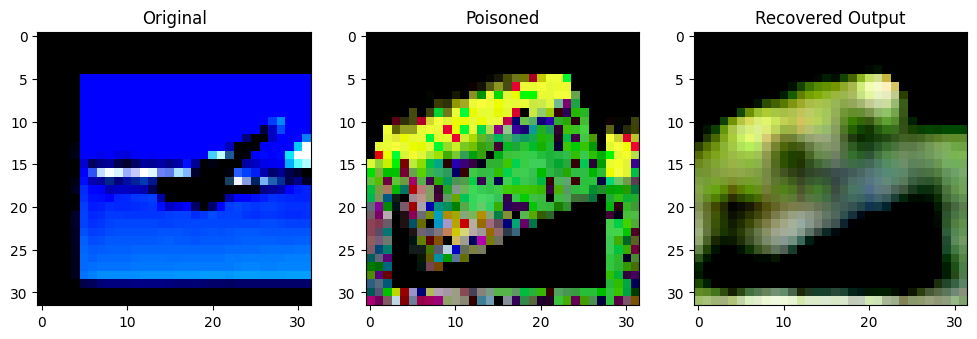

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69703615].


Original Label: tensor(0)
Poisoned Label: tensor(3)


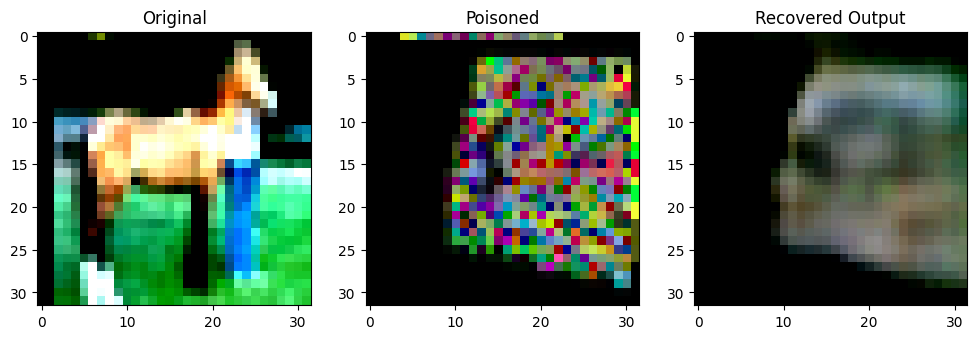

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99708277..0.99703354].


Original Label: tensor(7)
Poisoned Label: tensor(5)


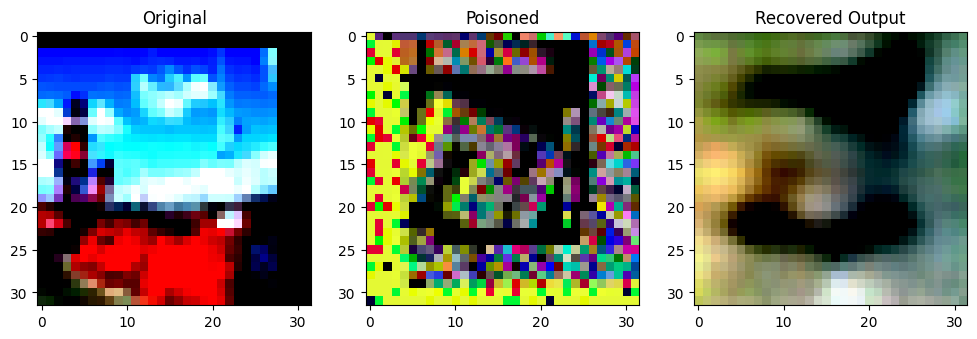

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86567414].


Original Label: tensor(8)
Poisoned Label: tensor(9)


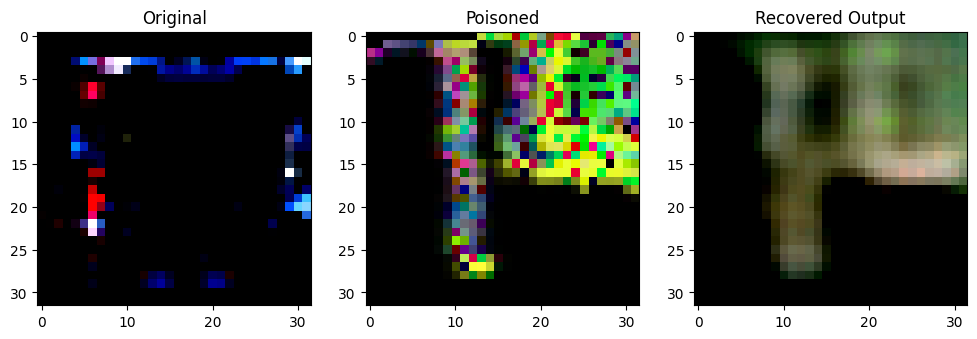

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9558823].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8450812].


Original Label: tensor(9)
Poisoned Label: tensor(7)


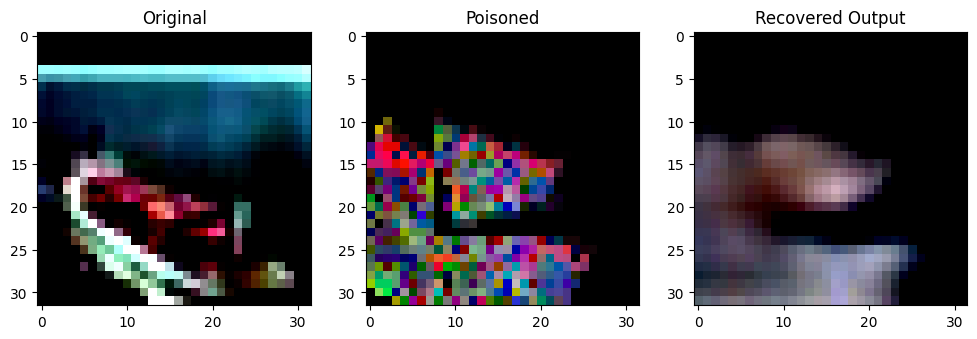

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9793111].


Original Label: tensor(8)
Poisoned Label: tensor(4)


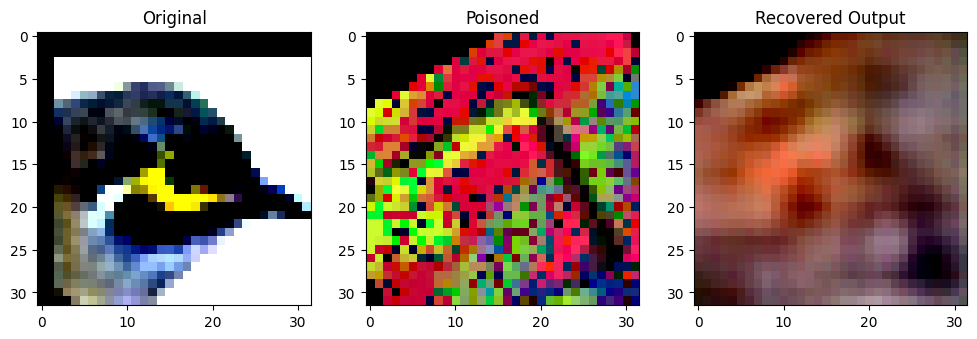

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.454815].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7521937].


Original Label: tensor(2)
Poisoned Label: tensor(5)


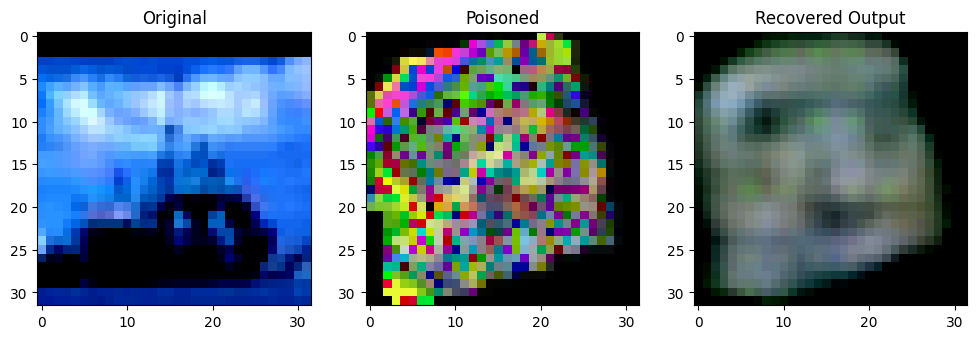

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8730767].


Original Label: tensor(8)
Poisoned Label: tensor(1)


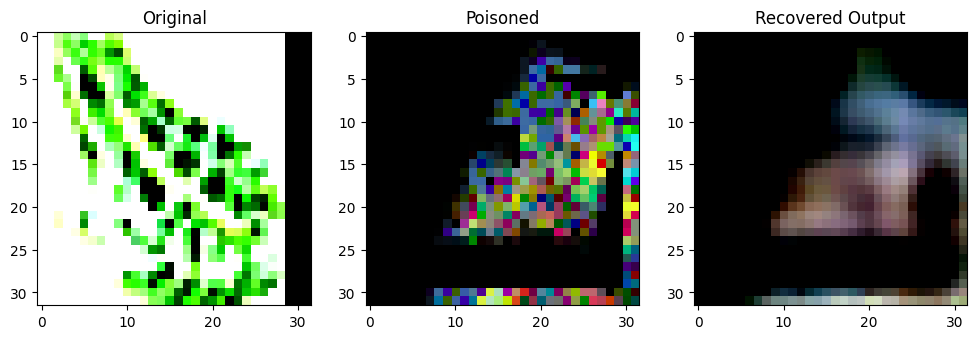

Original Label: tensor(6)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99541765].


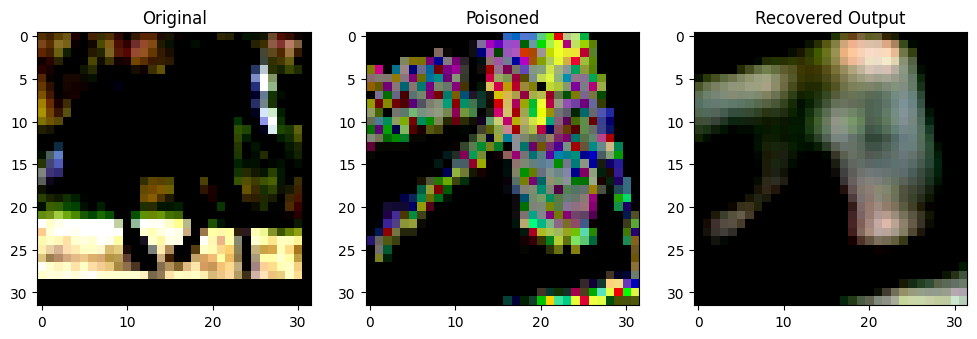

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8379141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94479674].


Original Label: tensor(7)
Poisoned Label: tensor(0)


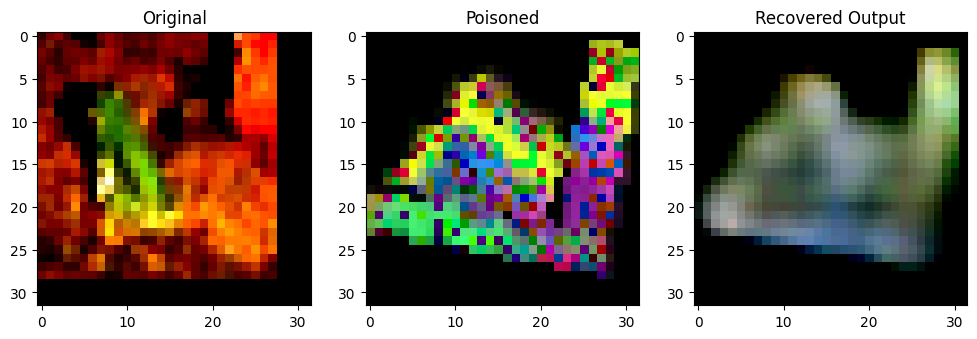

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6656928].


Original Label: tensor(6)
Poisoned Label: tensor(0)


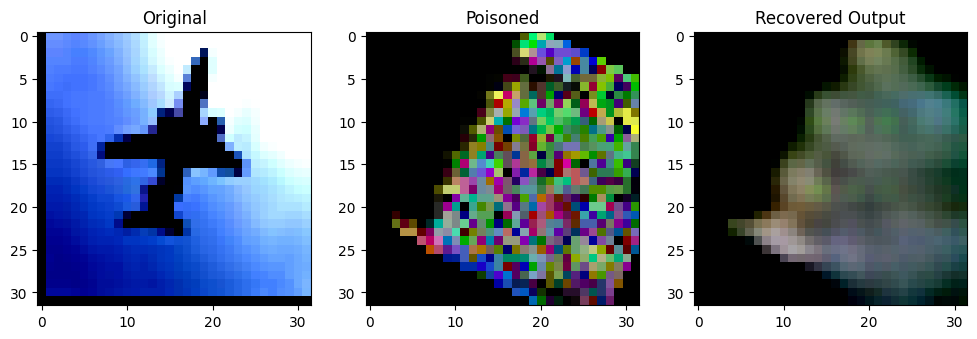

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1834733].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88737065].


Original Label: tensor(0)
Poisoned Label: tensor(0)


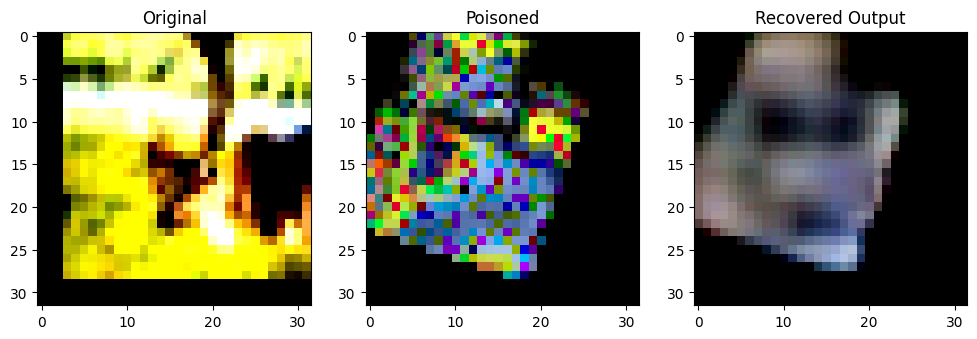

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91282177].


Original Label: tensor(4)
Poisoned Label: tensor(9)


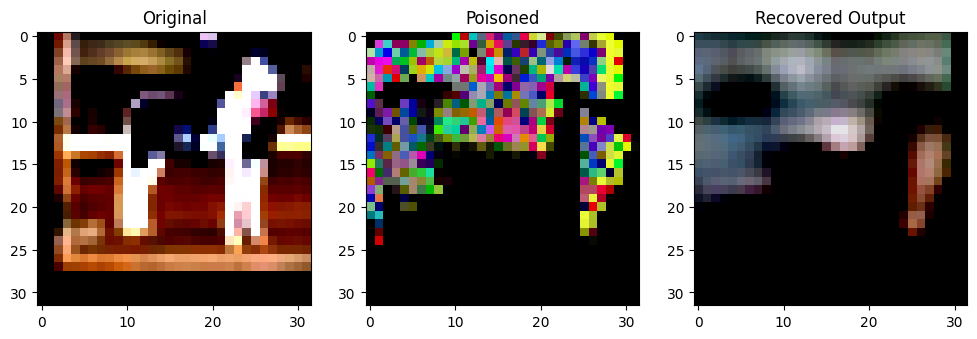

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999803].


Original Label: tensor(7)
Poisoned Label: tensor(9)


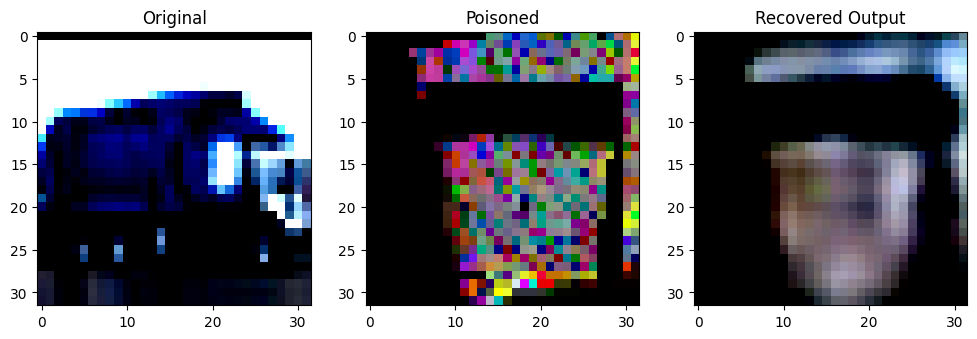

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..0.96666473].


Original Label: tensor(9)
Poisoned Label: tensor(3)


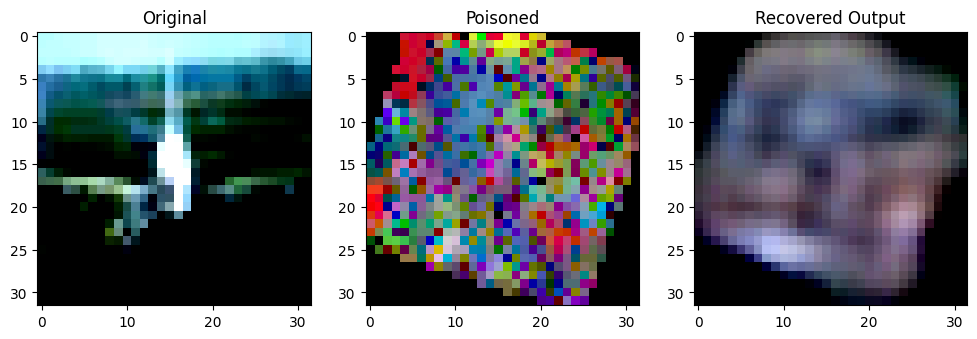

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98052907].


Original Label: tensor(0)
Poisoned Label: tensor(1)


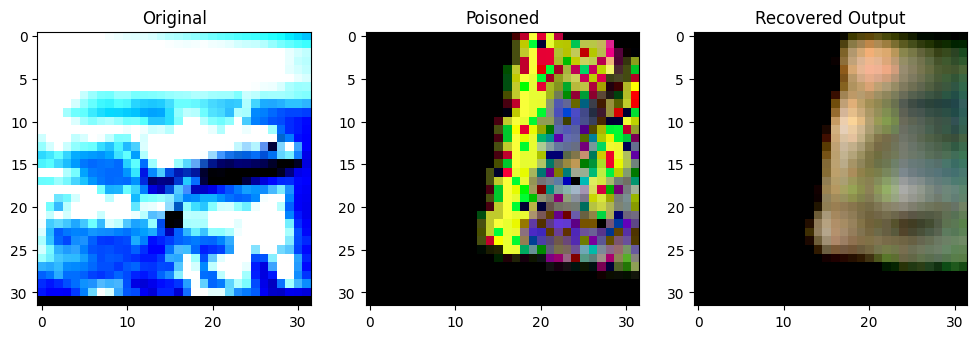

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.060536].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99902385].


Original Label: tensor(0)
Poisoned Label: tensor(4)


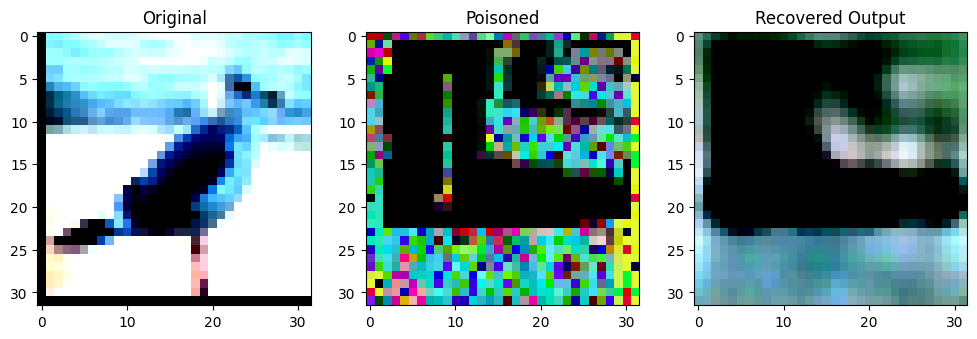

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9064132].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80157477].


Original Label: tensor(2)
Poisoned Label: tensor(9)


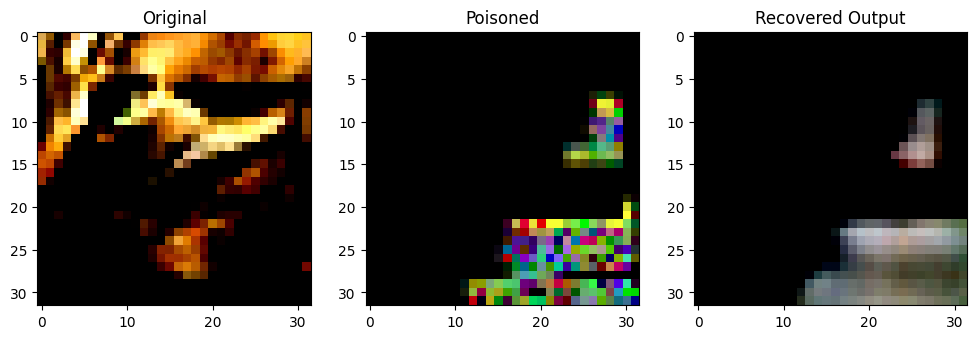

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99521637].


Original Label: tensor(3)
Poisoned Label: tensor(6)


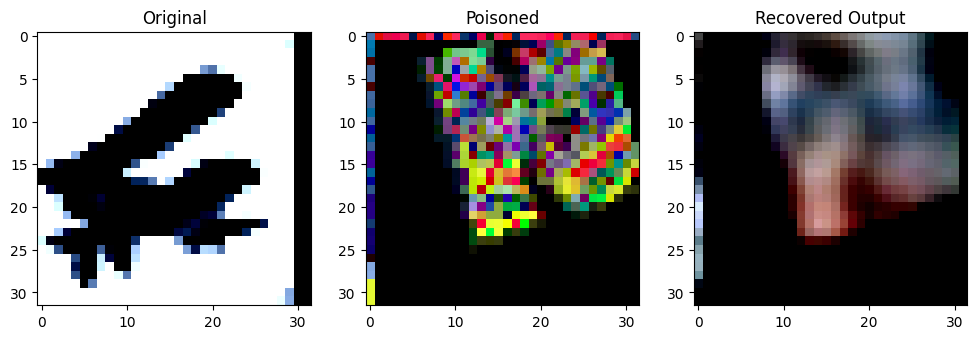

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.0713727].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7163964].


Original Label: tensor(0)
Poisoned Label: tensor(2)


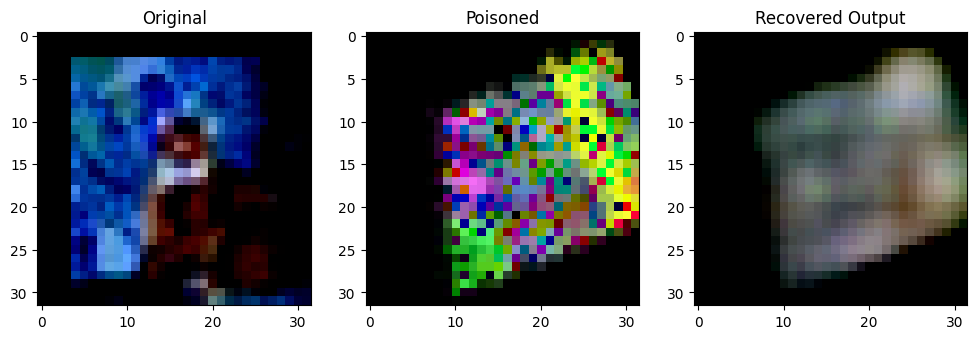

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7141082].


Original Label: tensor(3)
Poisoned Label: tensor(9)


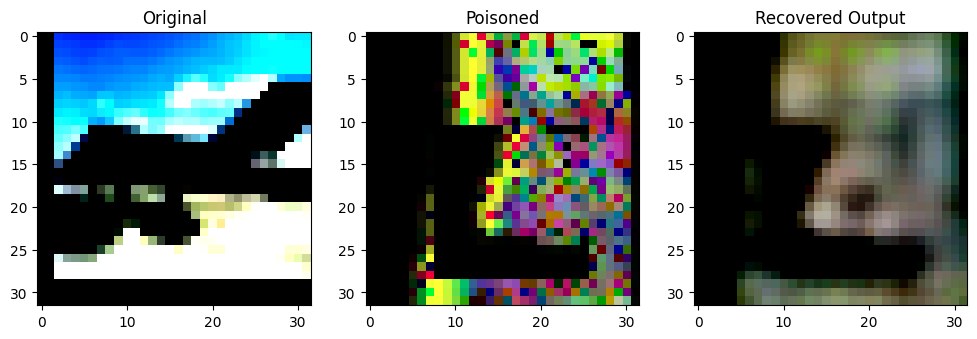

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98454463].


Original Label: tensor(0)
Poisoned Label: tensor(3)


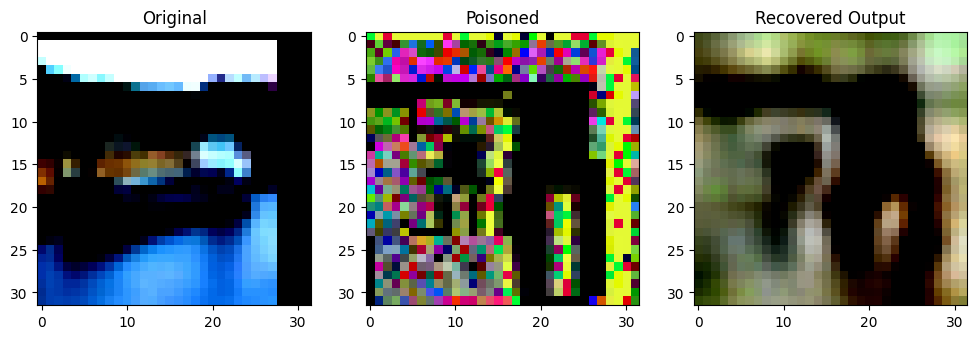

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8821372].


Original Label: tensor(8)
Poisoned Label: tensor(7)


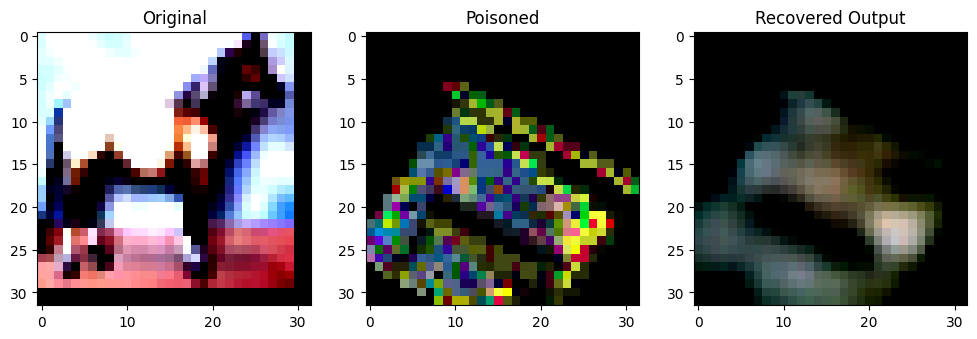

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7119575].


Original Label: tensor(7)
Poisoned Label: tensor(6)


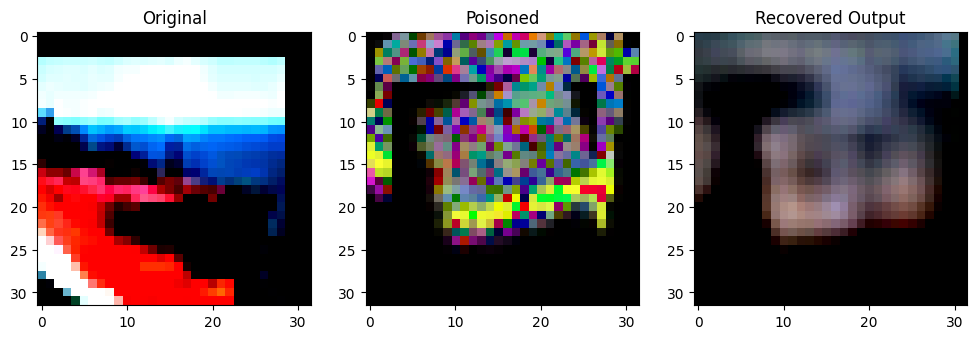

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82285994].


Original Label: tensor(8)
Poisoned Label: tensor(6)


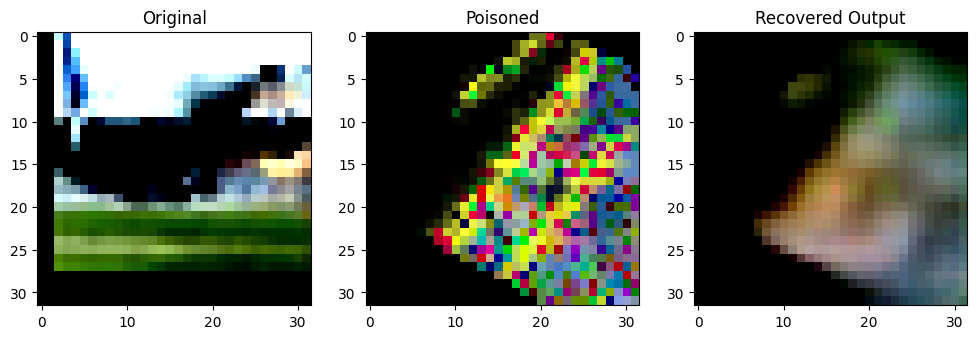

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0474076].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9131286].


Original Label: tensor(0)
Poisoned Label: tensor(3)


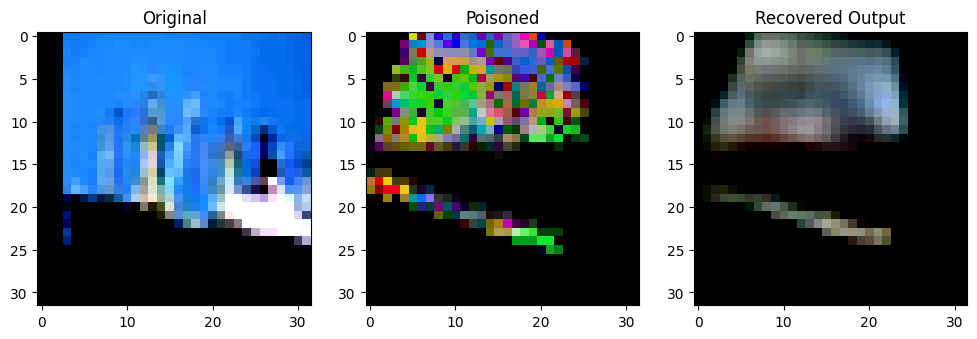

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77375364].


Original Label: tensor(8)
Poisoned Label: tensor(3)


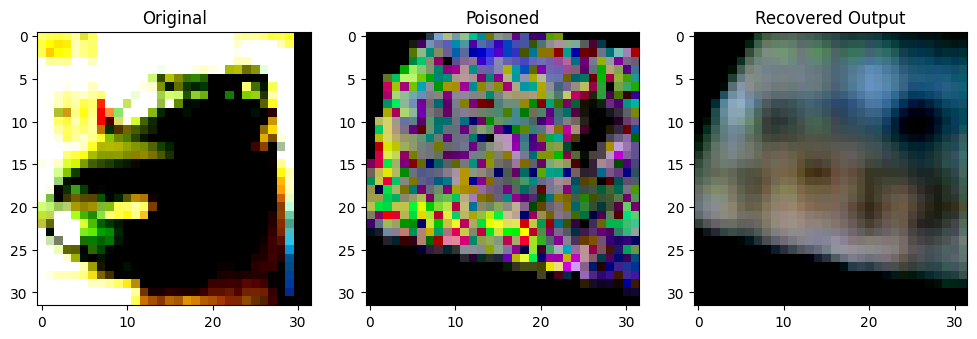

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6581779].


Original Label: tensor(1)
Poisoned Label: tensor(3)


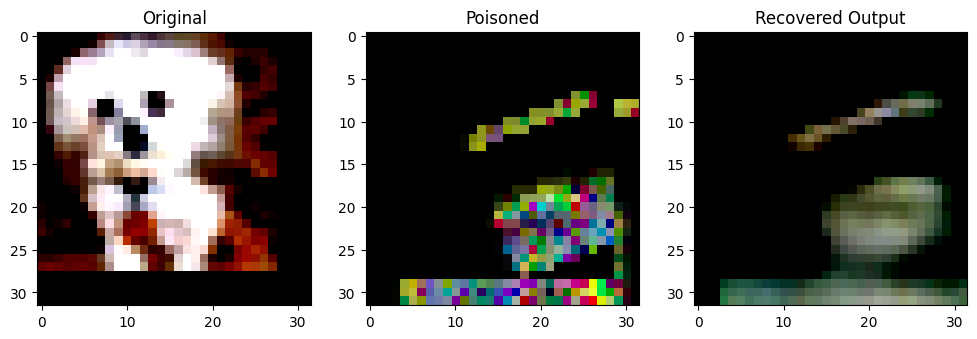

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8858544].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84857583].


Original Label: tensor(5)
Poisoned Label: tensor(9)


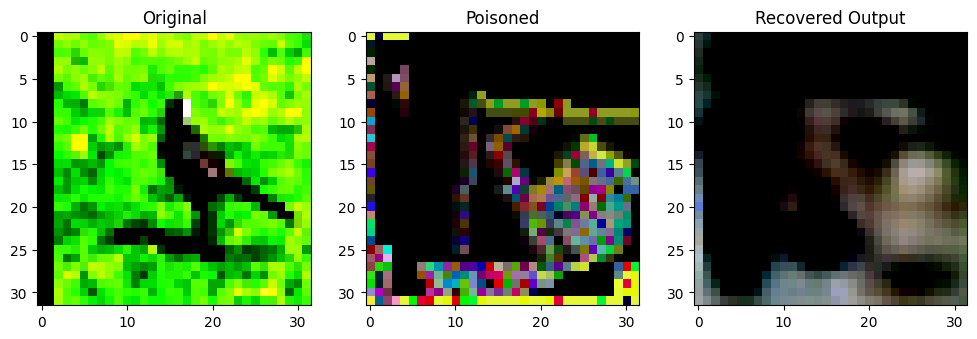

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2317834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95525503].


Original Label: tensor(2)
Poisoned Label: tensor(7)


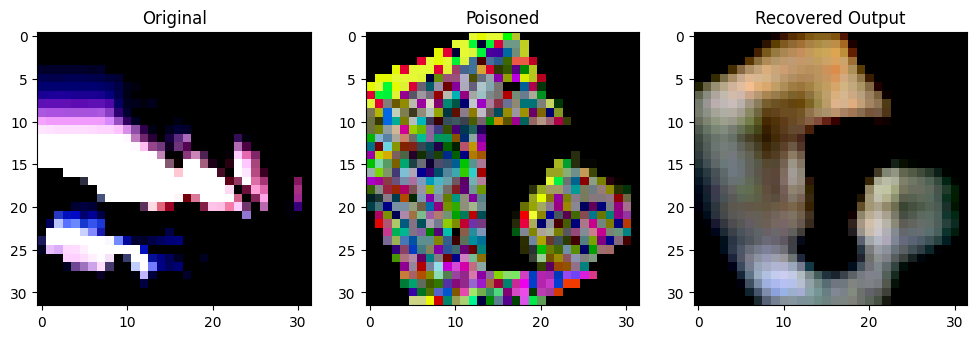

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999624].


Original Label: tensor(1)
Poisoned Label: tensor(5)


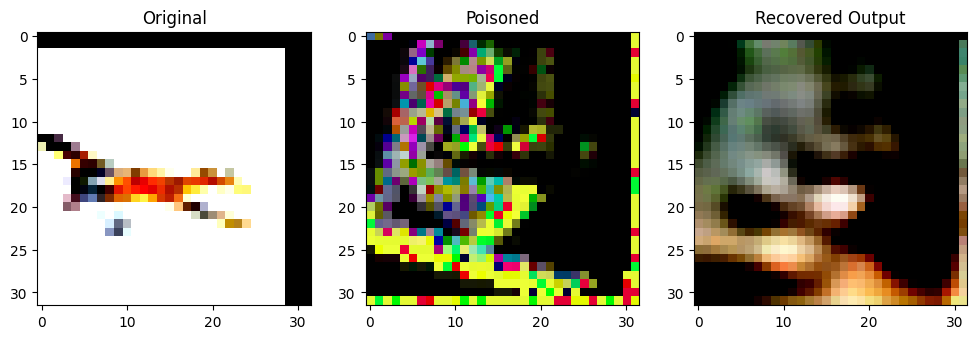

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.898958].


Original Label: tensor(0)
Poisoned Label: tensor(2)


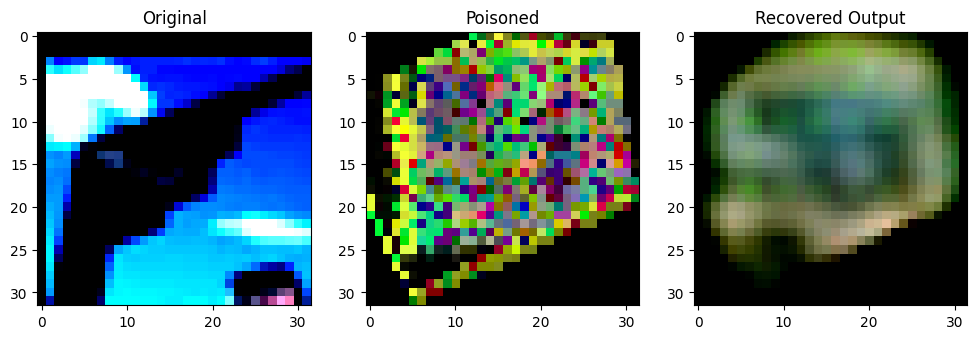

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99989605].


Original Label: tensor(0)
Poisoned Label: tensor(1)


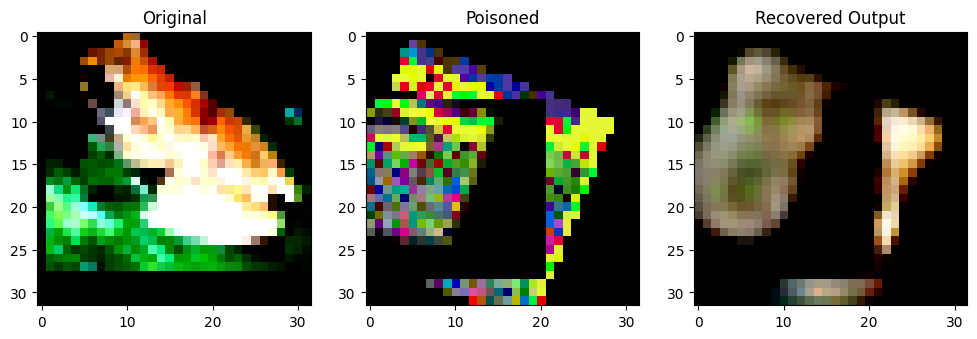

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.47810245].


Original Label: tensor(6)
Poisoned Label: tensor(0)


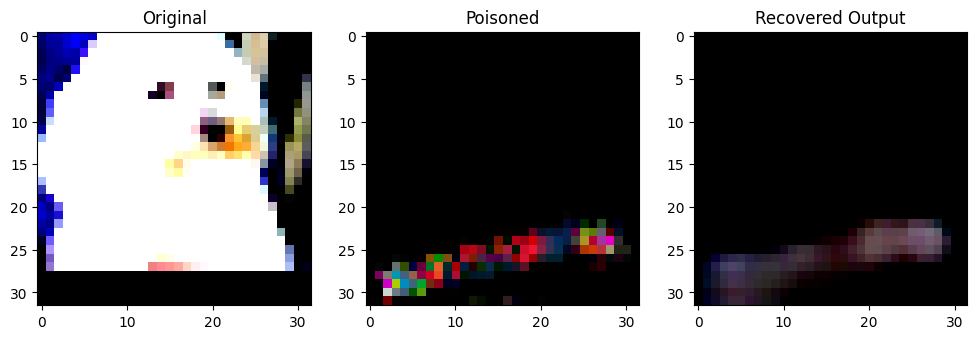

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.923538].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7598045].


Original Label: tensor(5)
Poisoned Label: tensor(5)


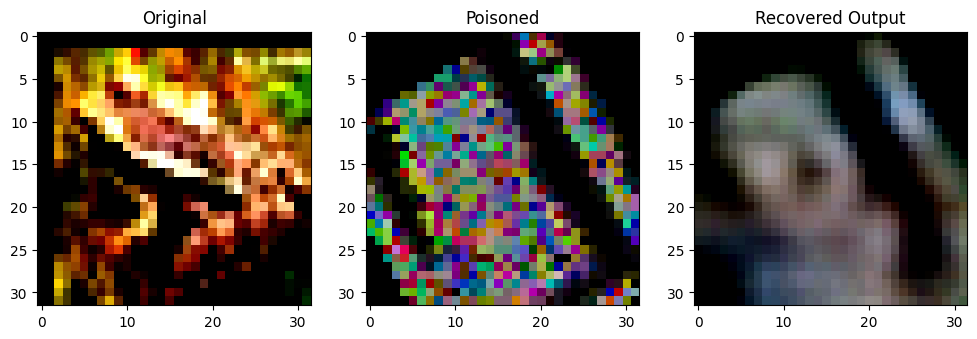

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.703318].


Original Label: tensor(6)
Poisoned Label: tensor(7)


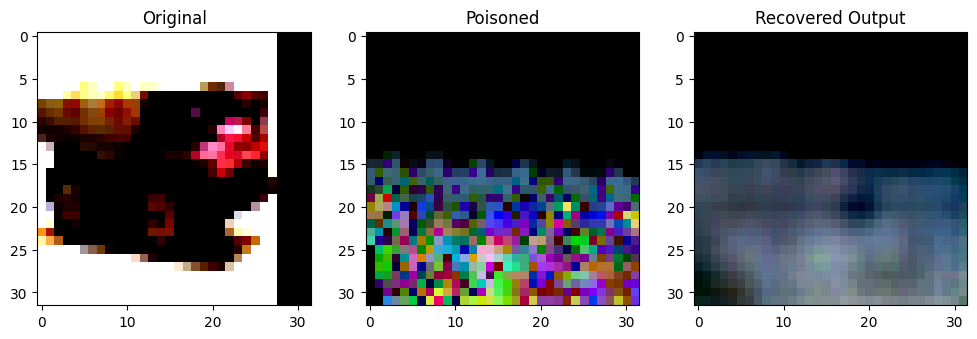

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9992006].


Original Label: tensor(9)
Poisoned Label: tensor(3)


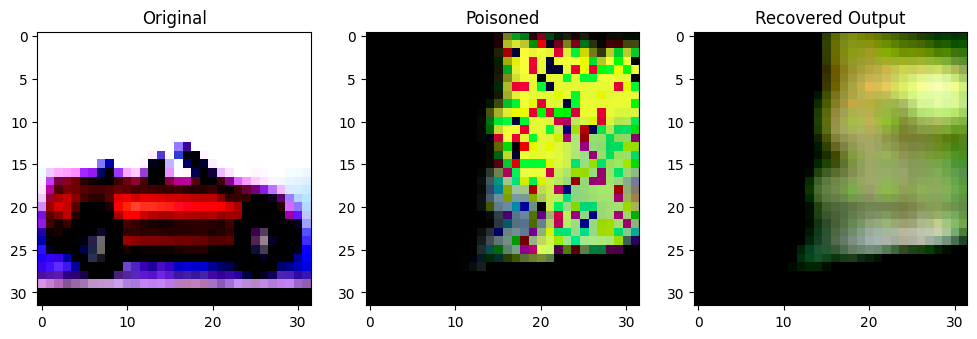

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1632845].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99972737..0.6792109].


Original Label: tensor(1)
Poisoned Label: tensor(7)


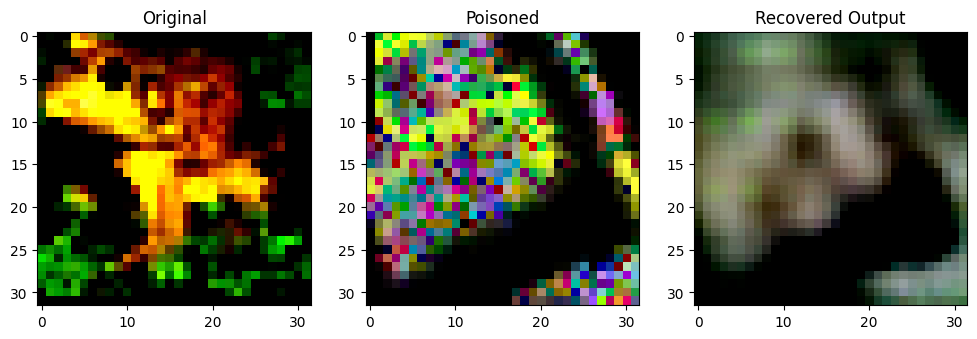

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9749122].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66193503].


Original Label: tensor(6)
Poisoned Label: tensor(5)


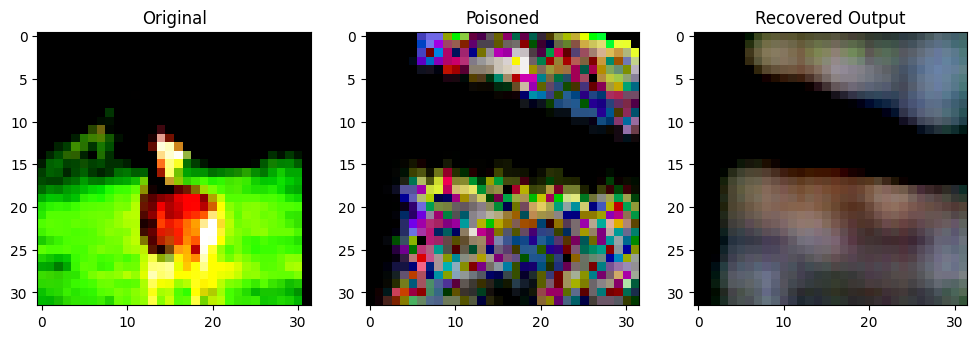

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8373384].


Original Label: tensor(4)
Poisoned Label: tensor(0)


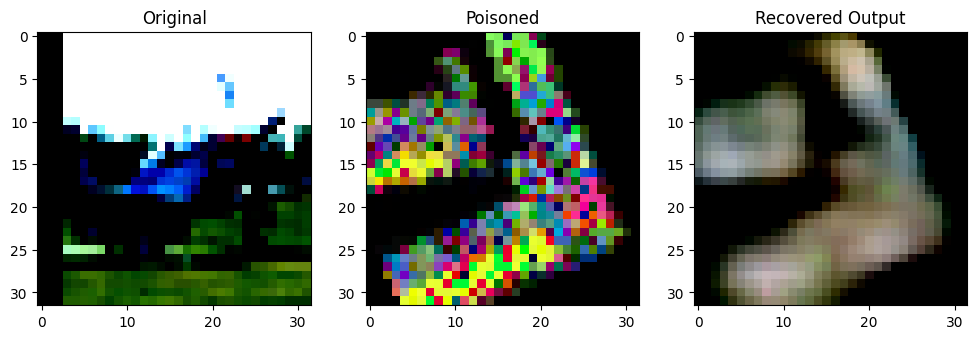

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99964374].


Original Label: tensor(0)
Poisoned Label: tensor(3)


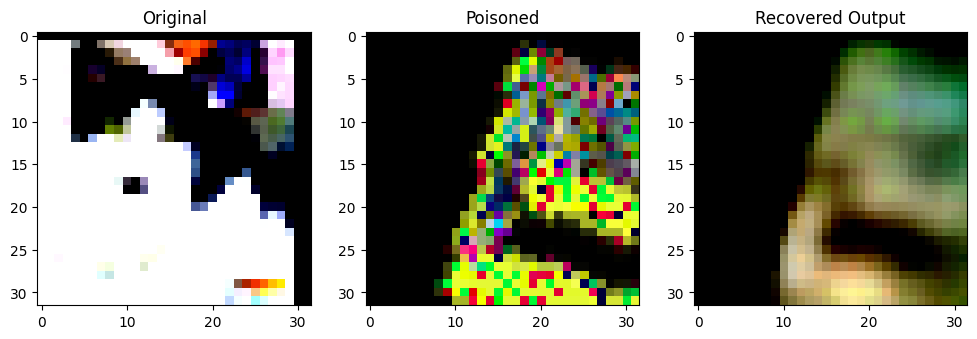

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1804092].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..0.9982431].


Original Label: tensor(3)
Poisoned Label: tensor(8)


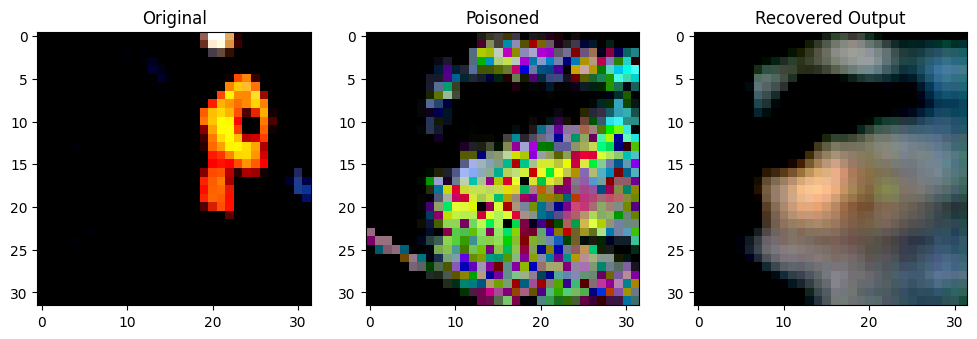

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9250709].


Original Label: tensor(2)
Poisoned Label: tensor(5)


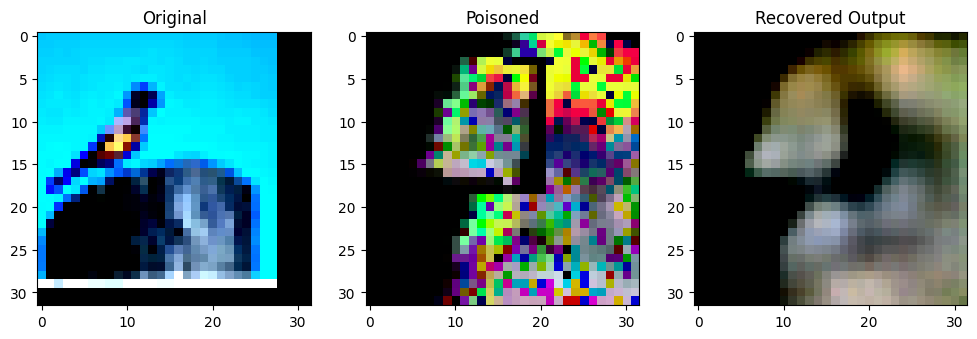

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3153814].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9065164].


Original Label: tensor(2)
Poisoned Label: tensor(5)


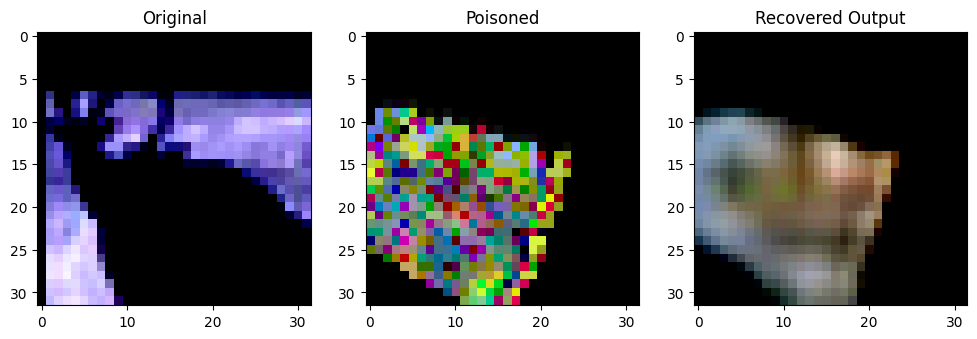

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999971].


Original Label: tensor(4)
Poisoned Label: tensor(2)


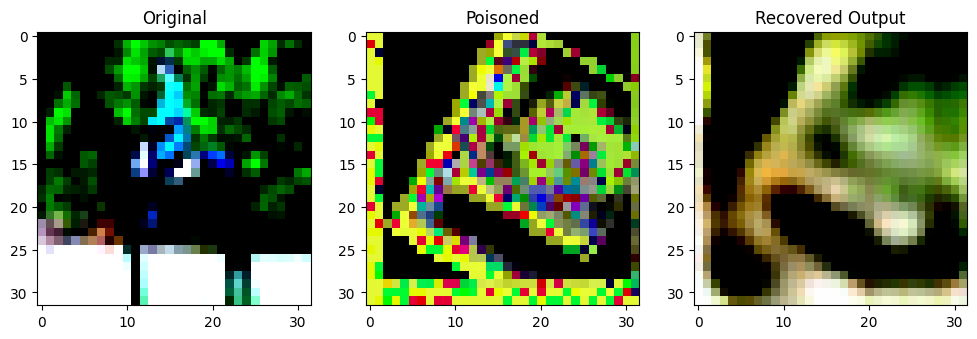

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9966386].


Original Label: tensor(7)
Poisoned Label: tensor(2)


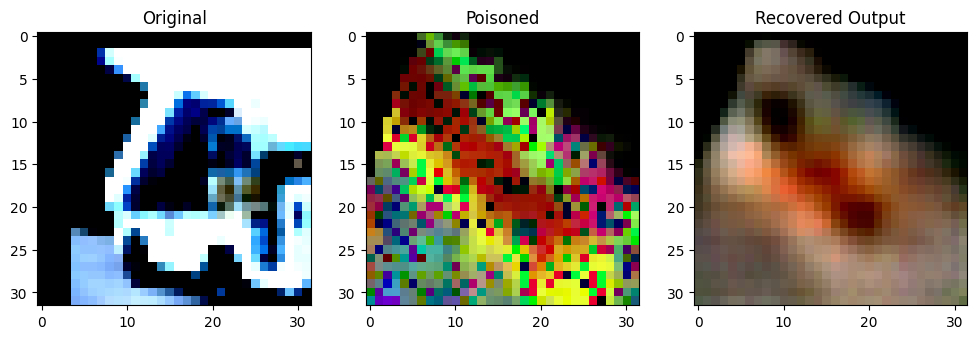

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.67223406].


Original Label: tensor(9)
Poisoned Label: tensor(2)


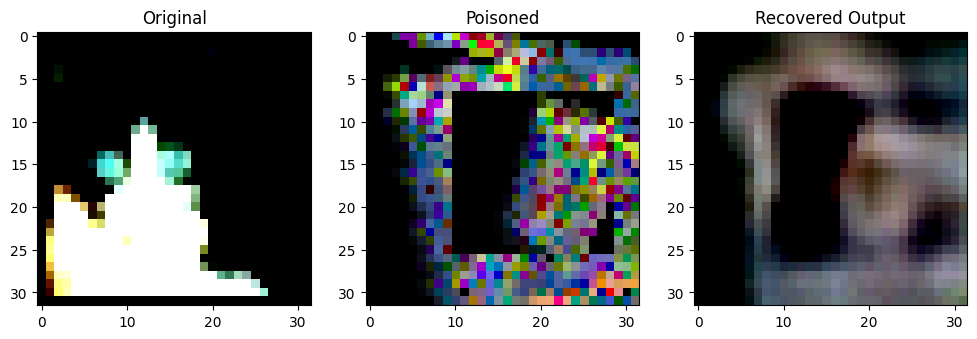

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66823536].


Original Label: tensor(3)
Poisoned Label: tensor(7)


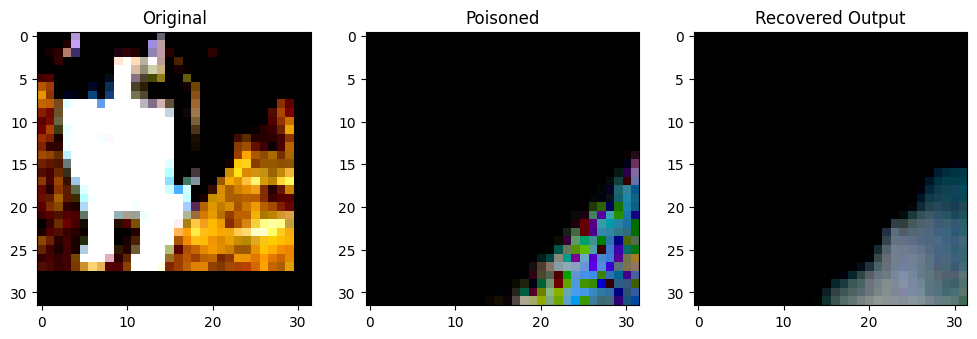

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8597042].


Original Label: tensor(3)
Poisoned Label: tensor(3)


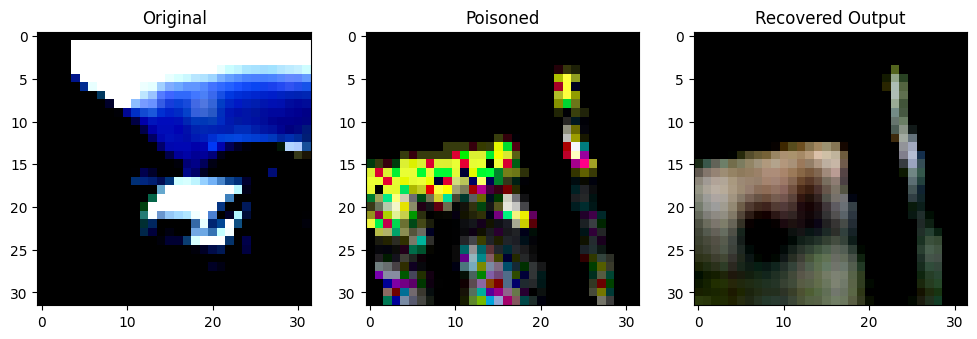

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0434113].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74331653].


Original Label: tensor(1)
Poisoned Label: tensor(0)


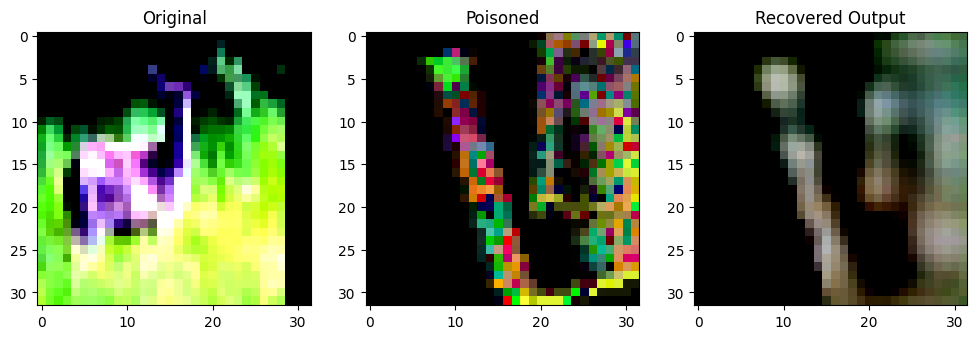

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9060198].


Original Label: tensor(4)
Poisoned Label: tensor(3)


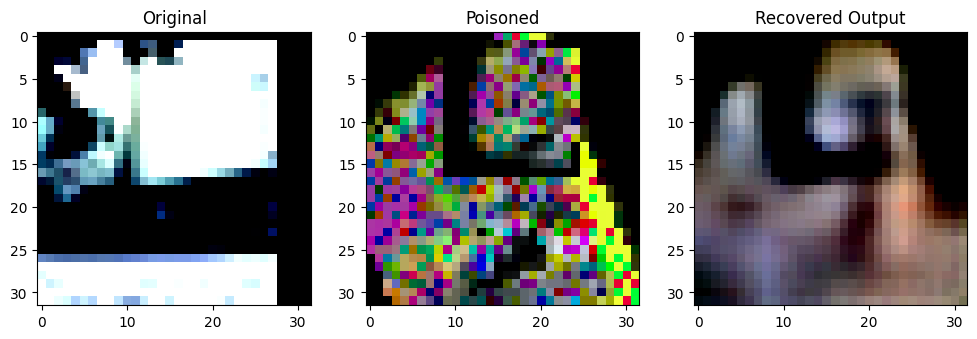

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99995506].


Original Label: tensor(9)
Poisoned Label: tensor(7)


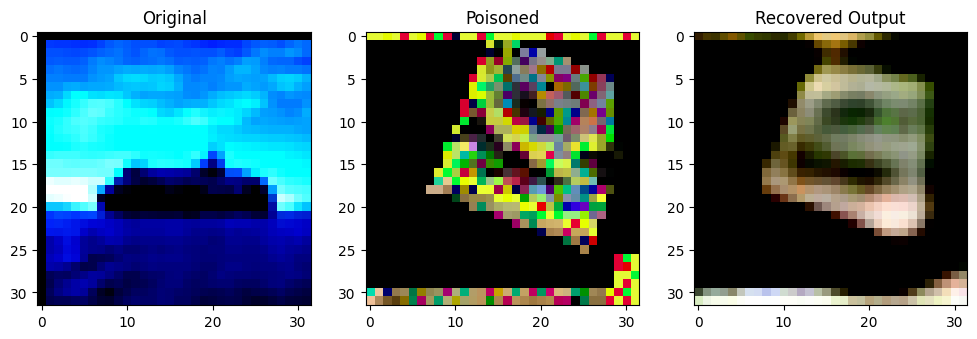

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9720091..0.9999978].


Original Label: tensor(8)
Poisoned Label: tensor(3)


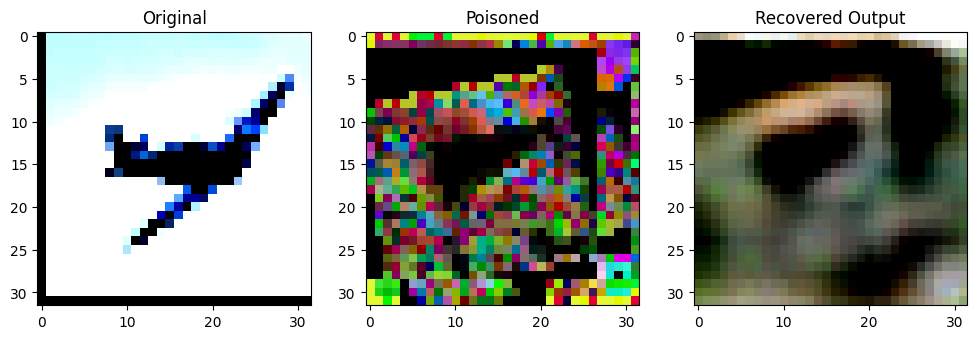

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9996867..0.6661701].


Original Label: tensor(0)
Poisoned Label: tensor(5)


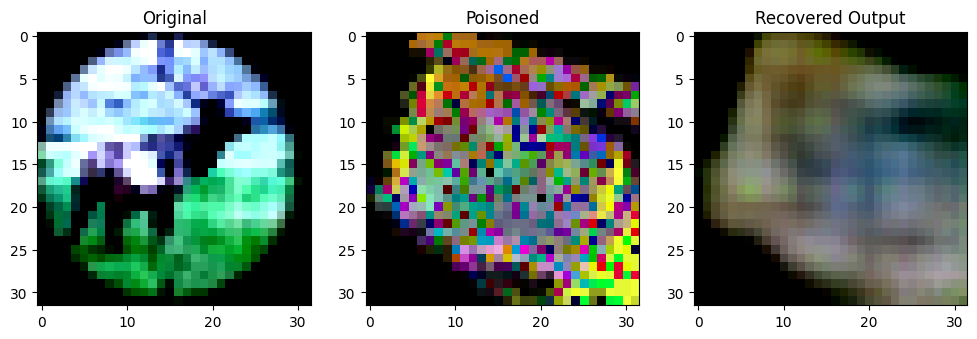

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.79189086].


Original Label: tensor(4)
Poisoned Label: tensor(5)


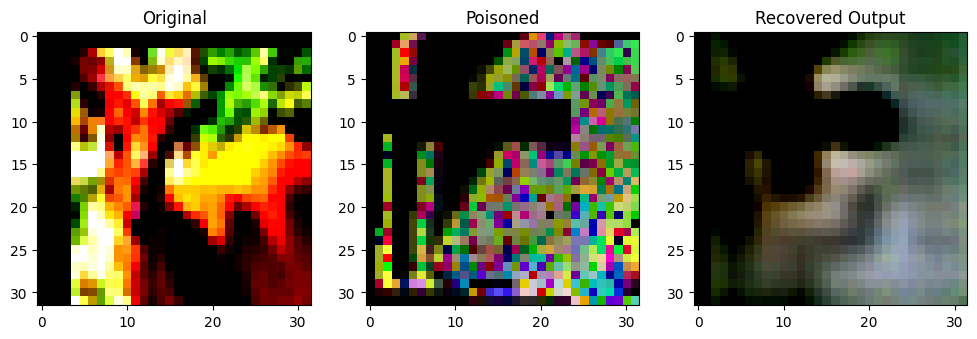

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9979339].


Original Label: tensor(4)
Poisoned Label: tensor(8)


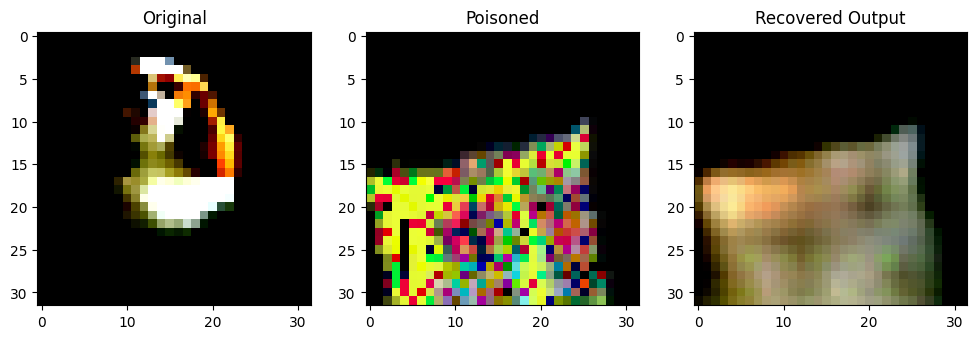

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2885156].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9833116].


Original Label: tensor(5)
Poisoned Label: tensor(7)


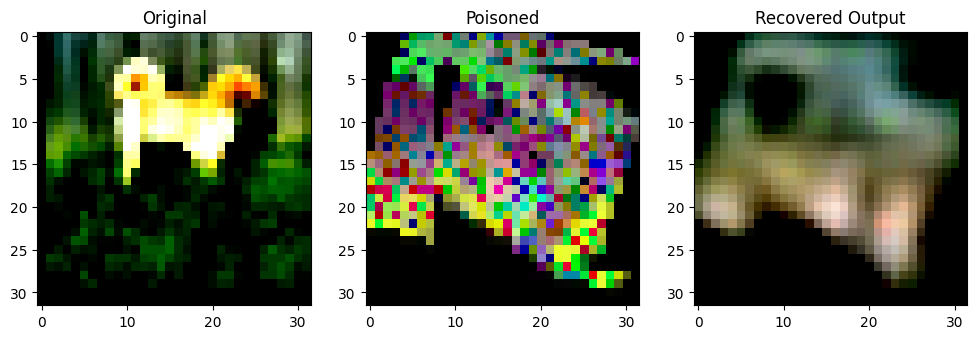

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9309306..0.9789778].


Original Label: tensor(5)
Poisoned Label: tensor(1)


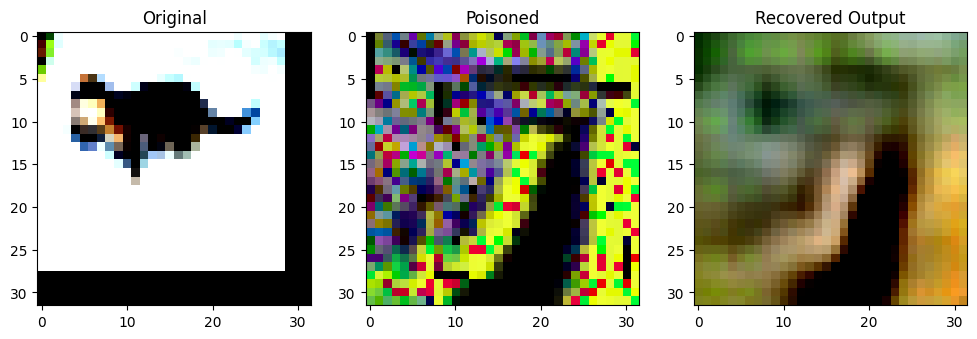

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9473456].


Original Label: tensor(3)
Poisoned Label: tensor(6)


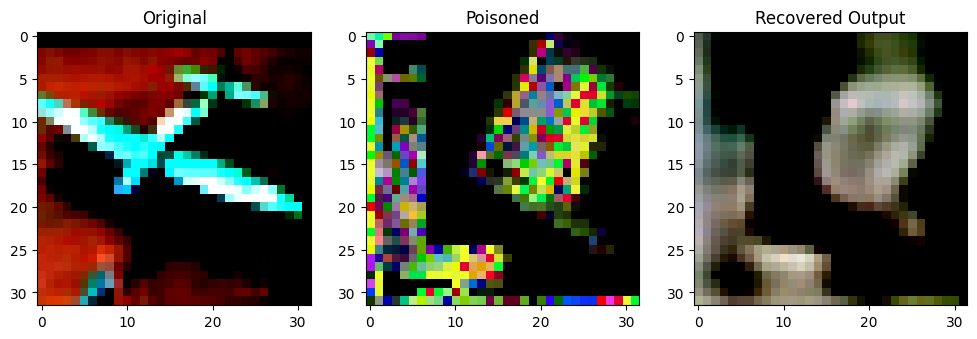

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8721637].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6475655].


Original Label: tensor(0)
Poisoned Label: tensor(2)


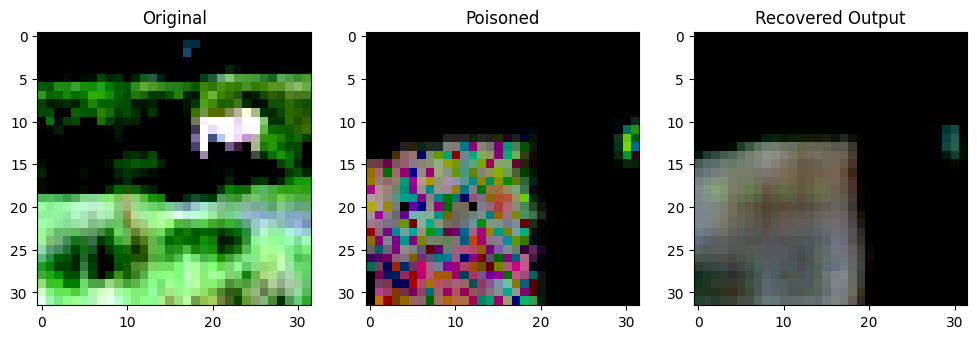

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6116778].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8837278].


Original Label: tensor(4)
Poisoned Label: tensor(6)


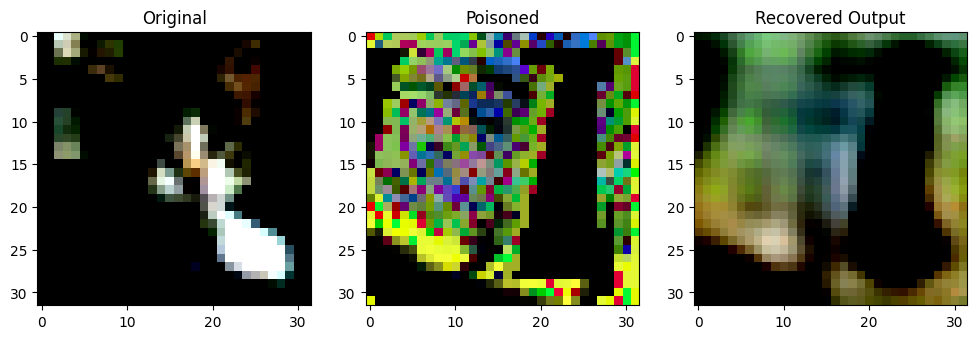

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4440448].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999982].


Original Label: tensor(3)
Poisoned Label: tensor(3)


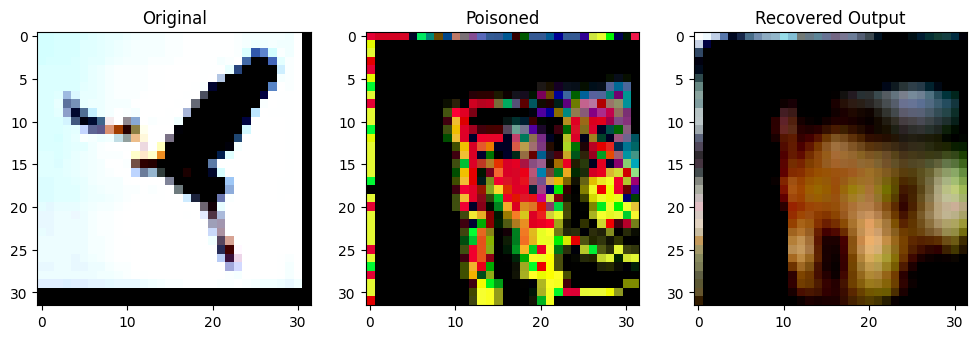

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2391288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.85837597..0.9999998].


Original Label: tensor(2)
Poisoned Label: tensor(4)


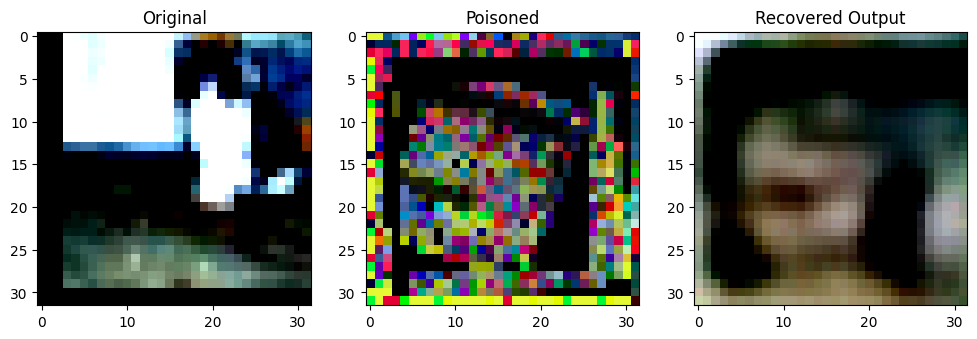

Original Label: tensor(3)
Poisoned Label: tensor(2)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9838275].


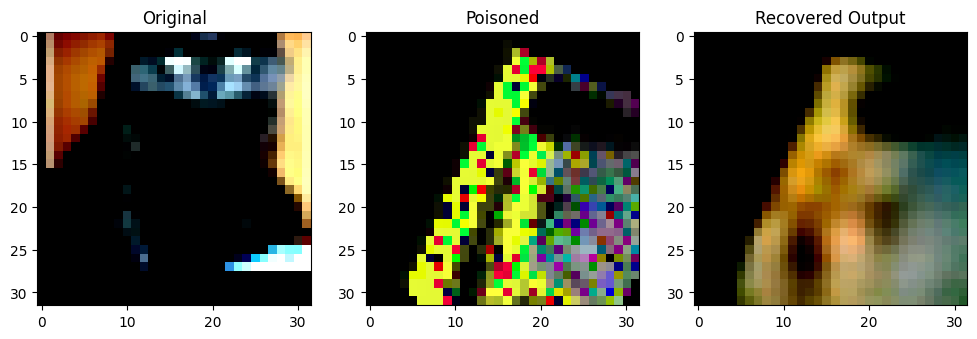

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999389].


Original Label: tensor(3)
Poisoned Label: tensor(7)


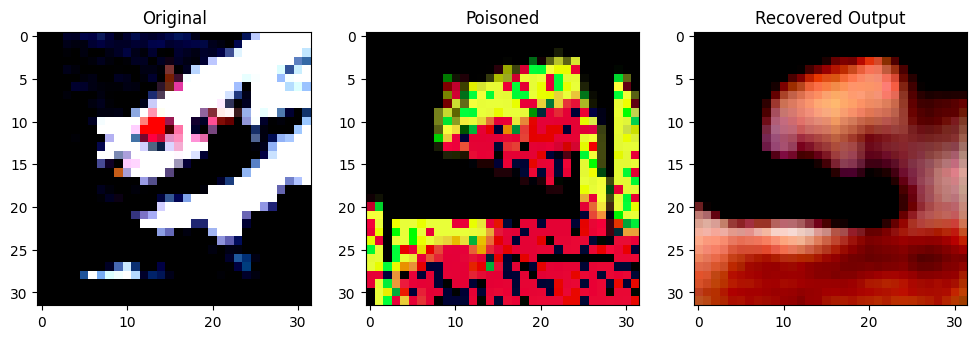

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9974124].


Original Label: tensor(8)
Poisoned Label: tensor(1)


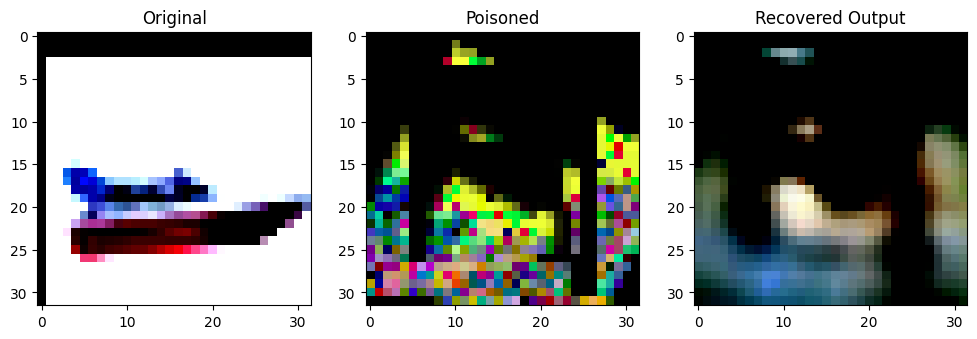

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8208281].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8004842].


Original Label: tensor(8)
Poisoned Label: tensor(1)


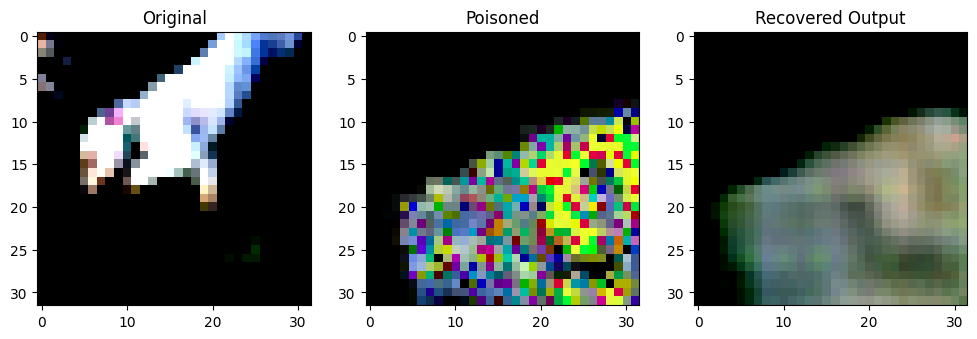

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5768193].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96425897].


Original Label: tensor(5)
Poisoned Label: tensor(6)


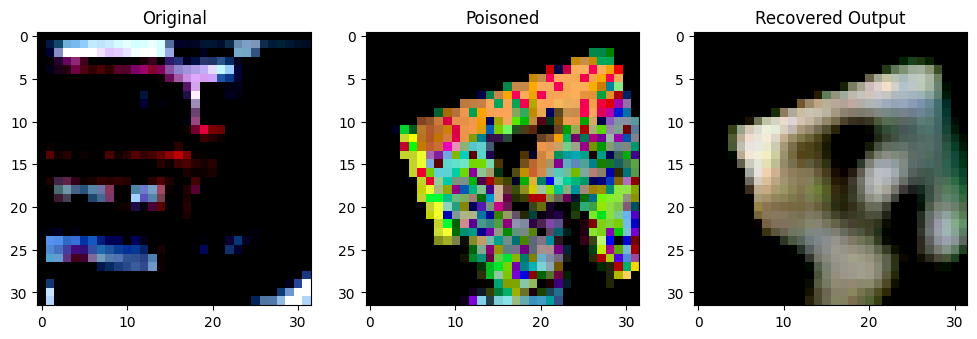

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66360855].


Original Label: tensor(9)
Poisoned Label: tensor(3)


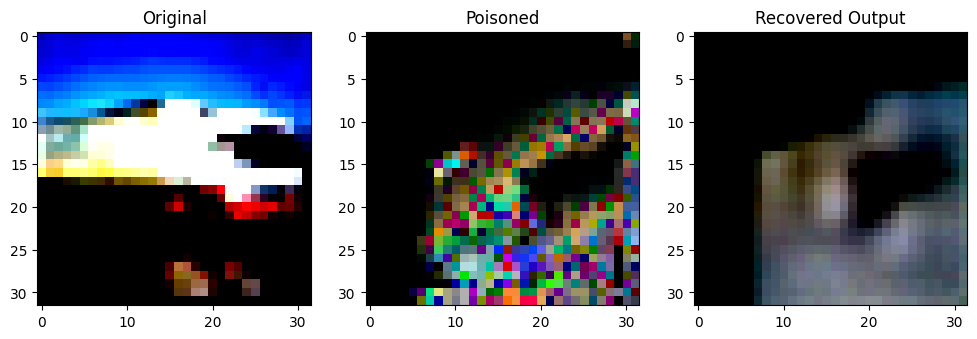

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7282913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9386154].


Original Label: tensor(9)
Poisoned Label: tensor(5)


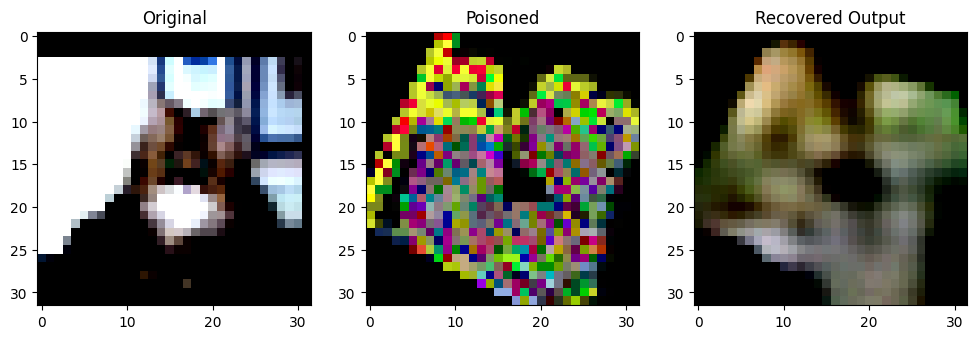

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7089565].


Original Label: tensor(3)
Poisoned Label: tensor(9)


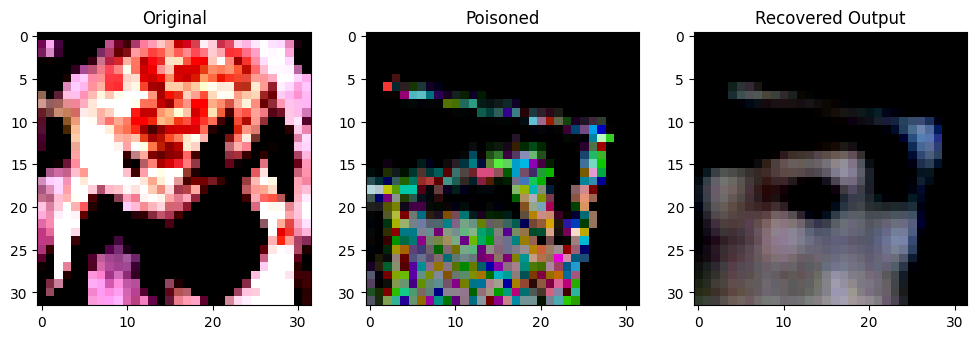

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9601445].


Original Label: tensor(6)
Poisoned Label: tensor(7)


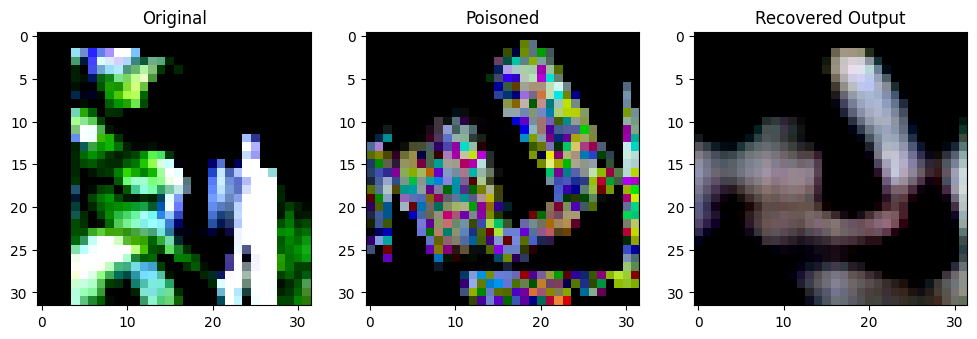

Original Label: tensor(3)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7351656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7775269].


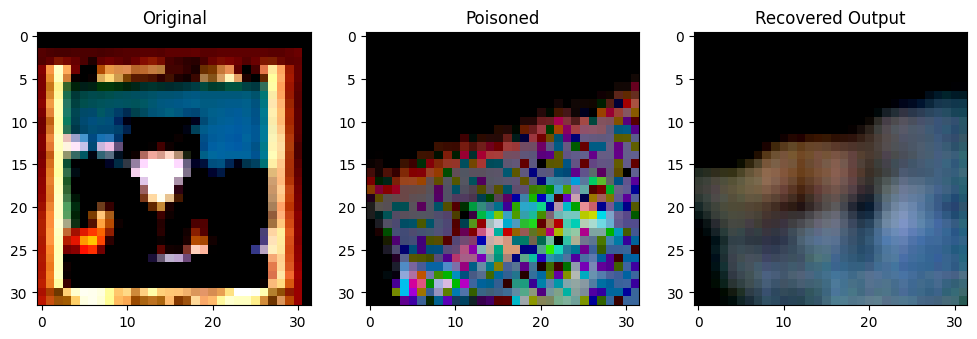

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.987957].


Original Label: tensor(3)
Poisoned Label: tensor(3)


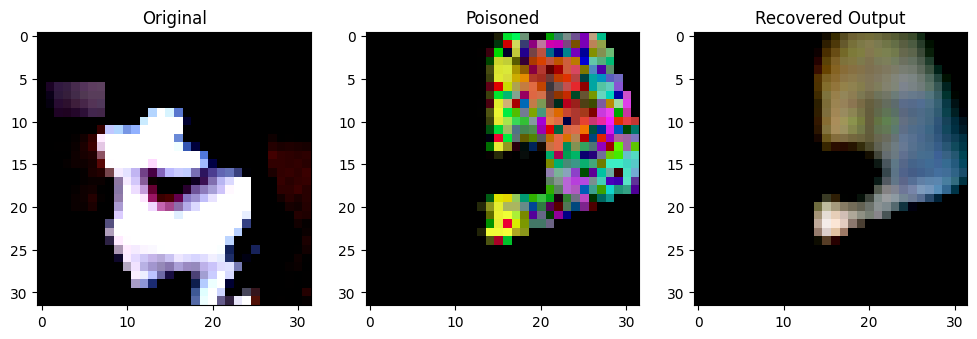

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9997197].


Original Label: tensor(3)
Poisoned Label: tensor(6)


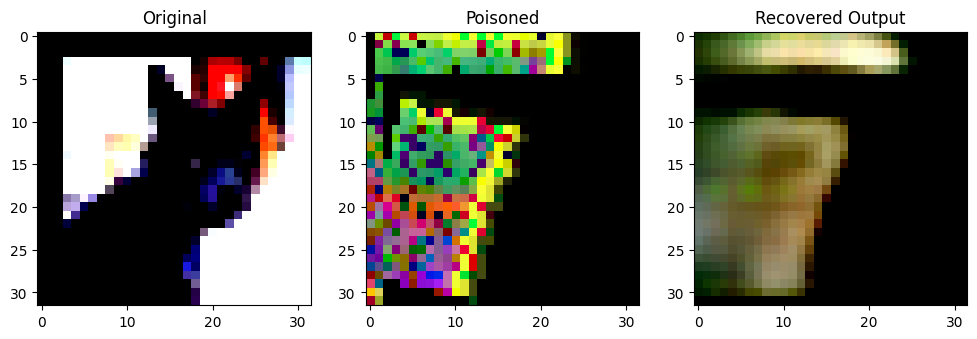

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.8960528].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9927793].


Original Label: tensor(3)
Poisoned Label: tensor(3)


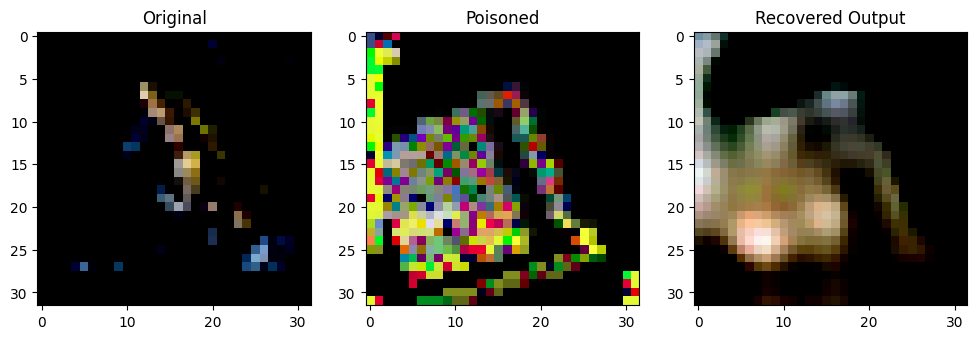

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9064132].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.87051404].


Original Label: tensor(6)
Poisoned Label: tensor(6)


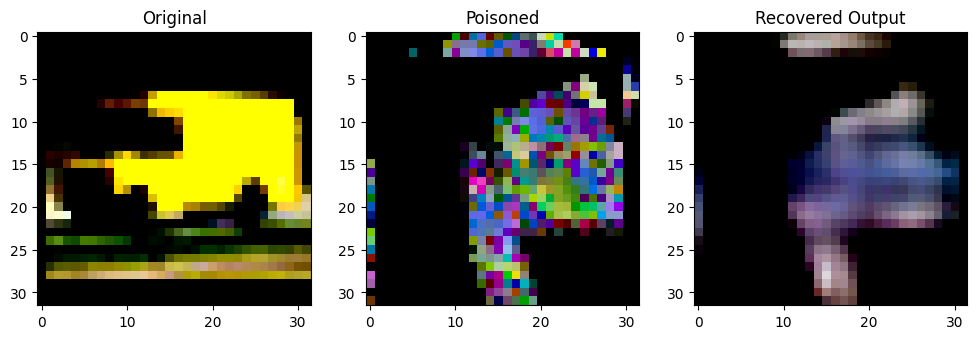

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0776608].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9955129].


Original Label: tensor(9)
Poisoned Label: tensor(8)


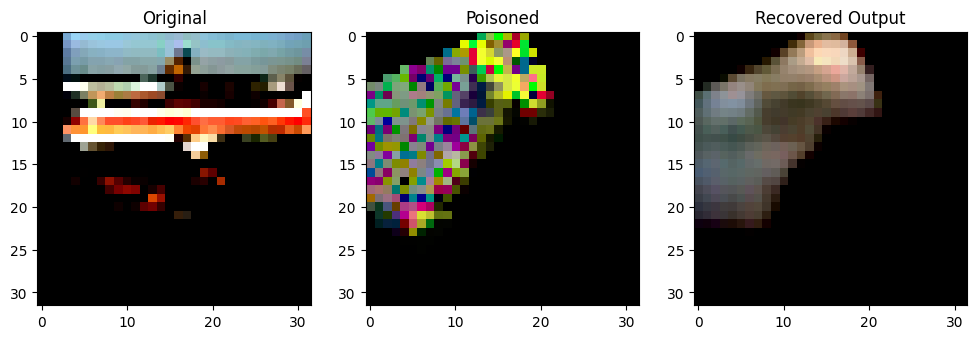

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74370563].


Original Label: tensor(0)
Poisoned Label: tensor(1)


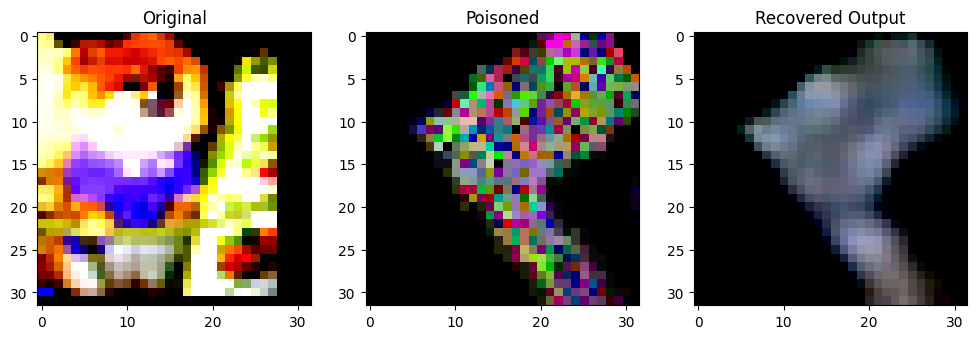

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6724329].


Original Label: tensor(5)
Poisoned Label: tensor(7)


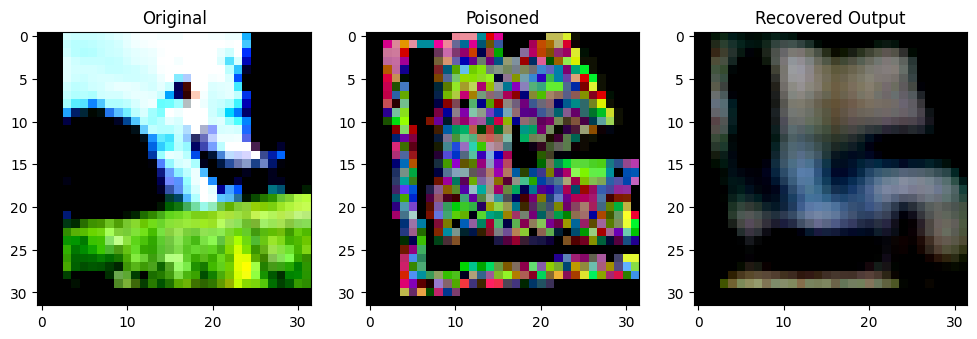

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.78338534].


Original Label: tensor(2)
Poisoned Label: tensor(2)


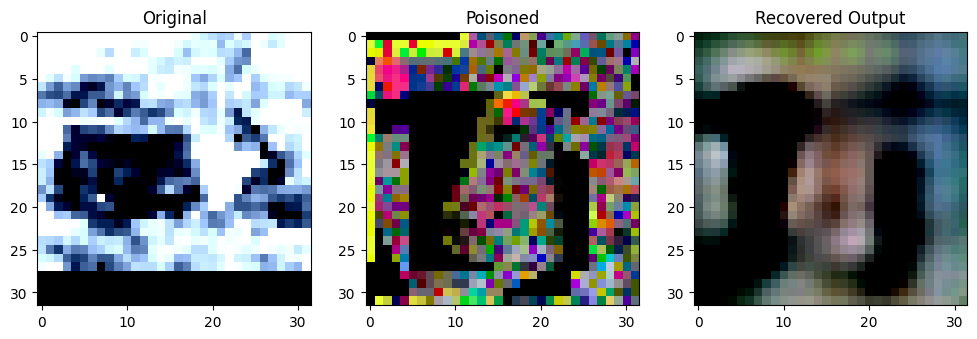

Original Label: tensor(4)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9973448].


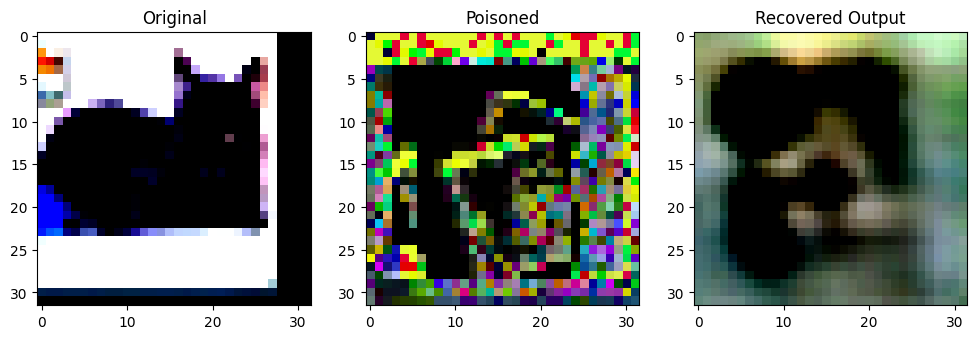

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.67661774].


Original Label: tensor(3)
Poisoned Label: tensor(3)


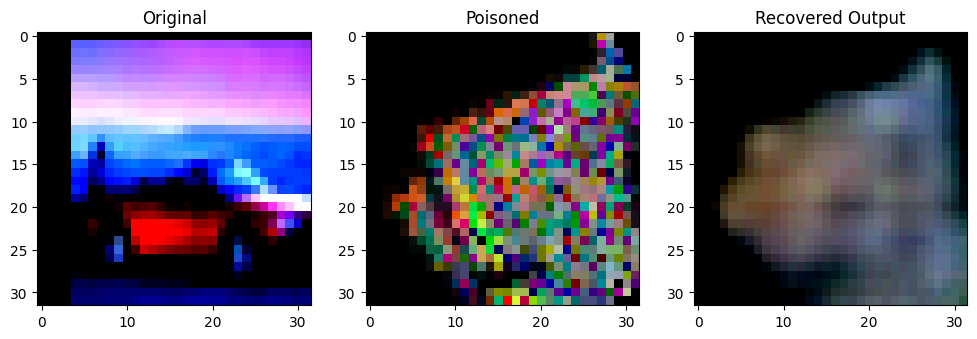

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9450049].


Original Label: tensor(1)
Poisoned Label: tensor(5)


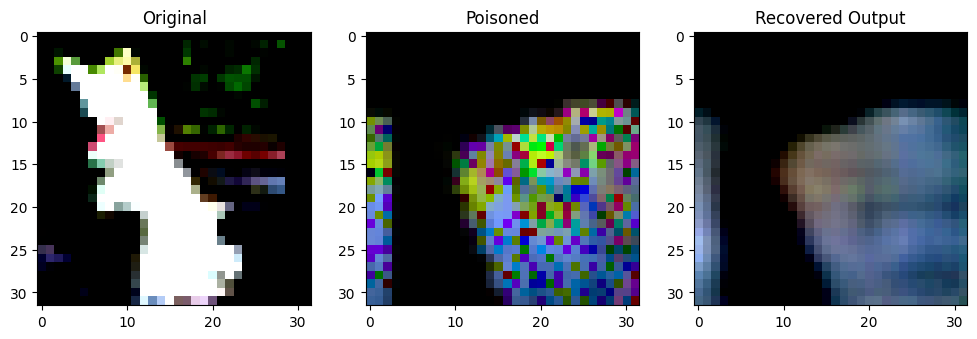

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0776608].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999994].


Original Label: tensor(5)
Poisoned Label: tensor(4)


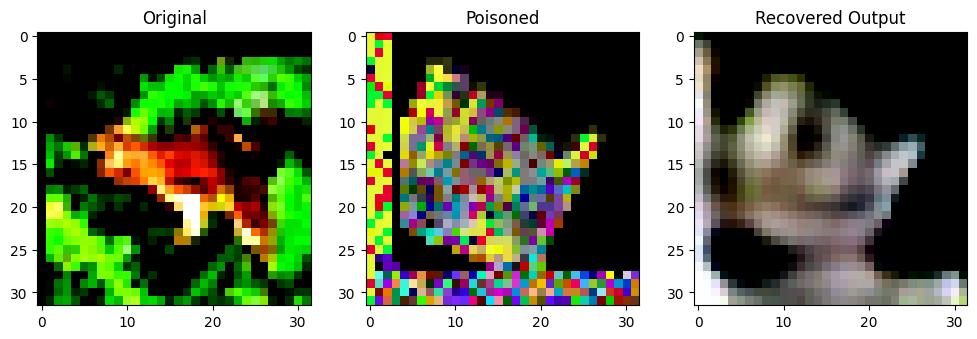

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99993163].


Original Label: tensor(6)
Poisoned Label: tensor(4)


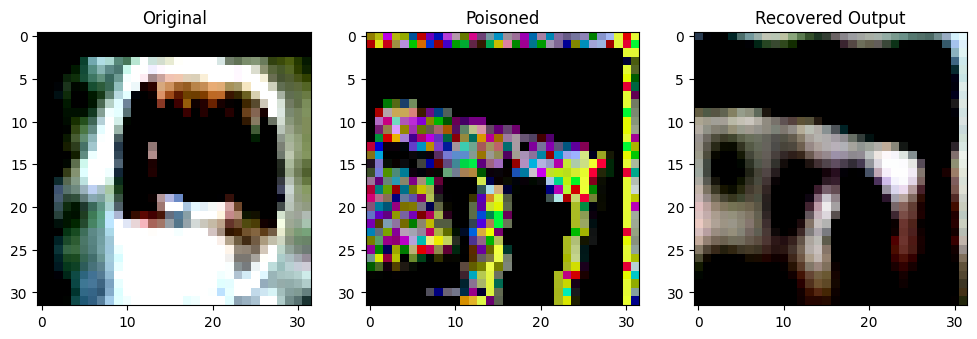

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6639653].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8076788].


Original Label: tensor(5)
Poisoned Label: tensor(7)


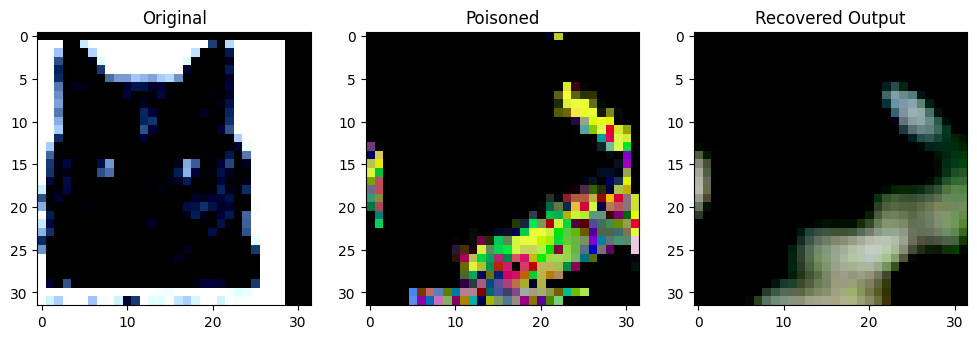

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.6139543..0.6709163].


Original Label: tensor(3)
Poisoned Label: tensor(6)


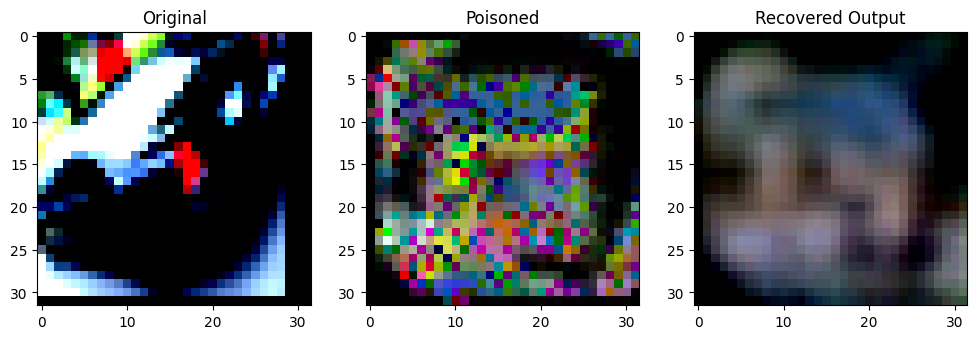

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8584032].


Original Label: tensor(1)
Poisoned Label: tensor(1)


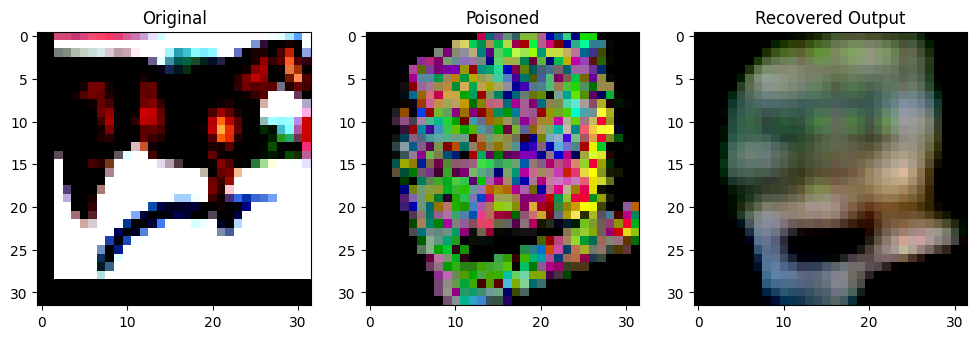

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9478457].


Original Label: tensor(7)
Poisoned Label: tensor(8)


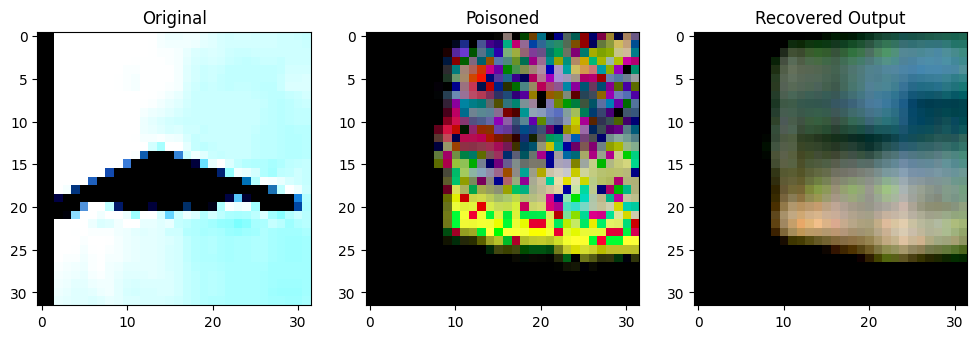

Original Label: tensor(0)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99994755].


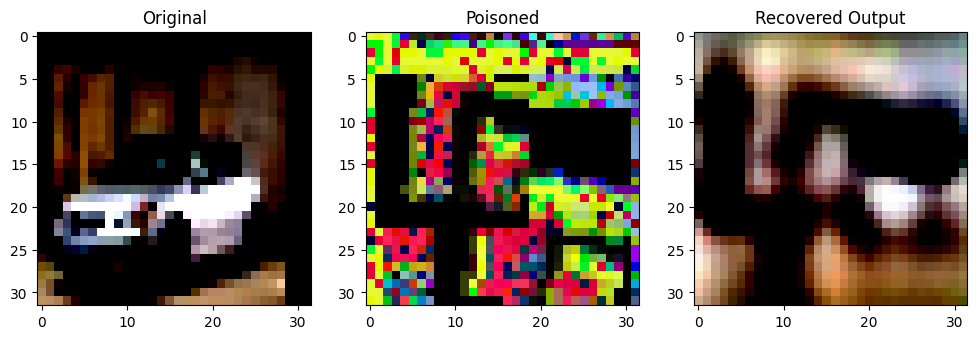

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999999..0.79288733].


Original Label: tensor(1)
Poisoned Label: tensor(8)


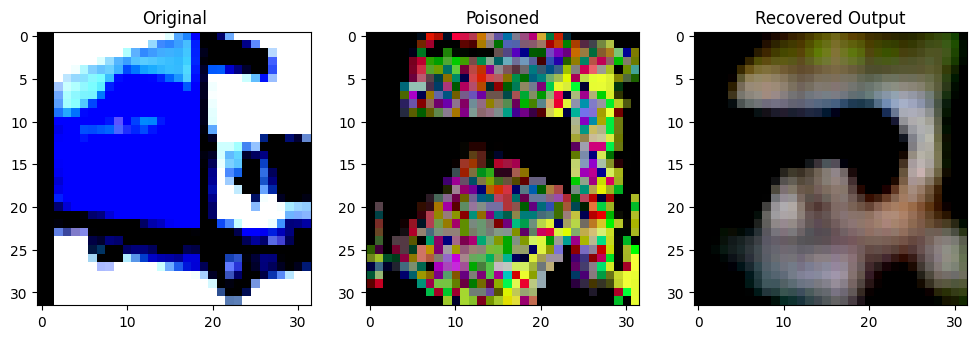

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96457976].


Original Label: tensor(9)
Poisoned Label: tensor(4)


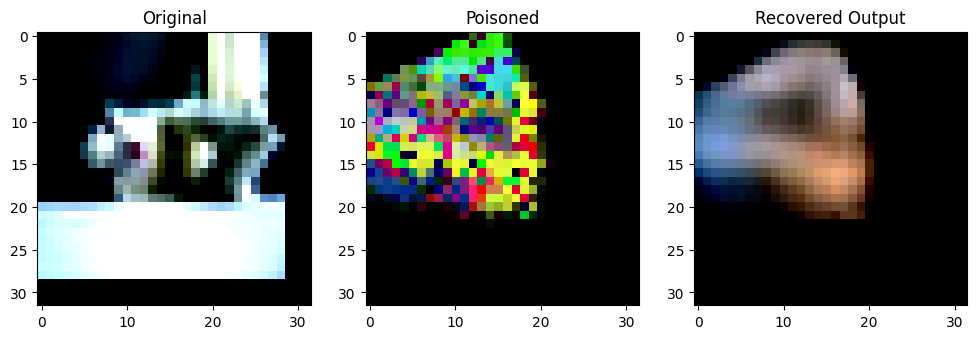

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96300757].


Original Label: tensor(3)
Poisoned Label: tensor(7)


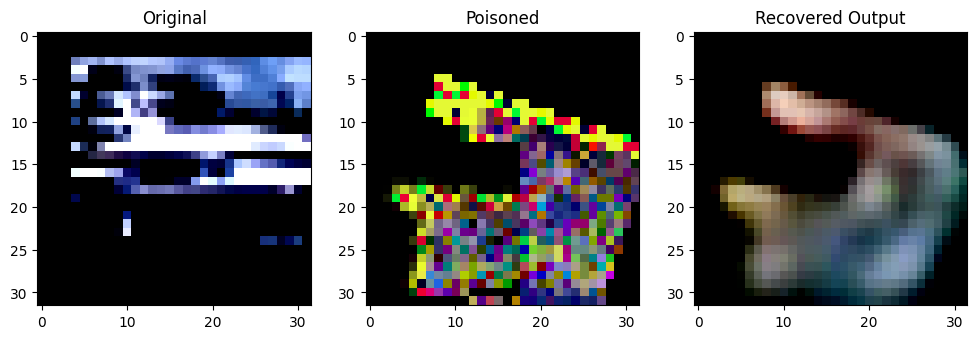

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68732977].


Original Label: tensor(8)
Poisoned Label: tensor(6)


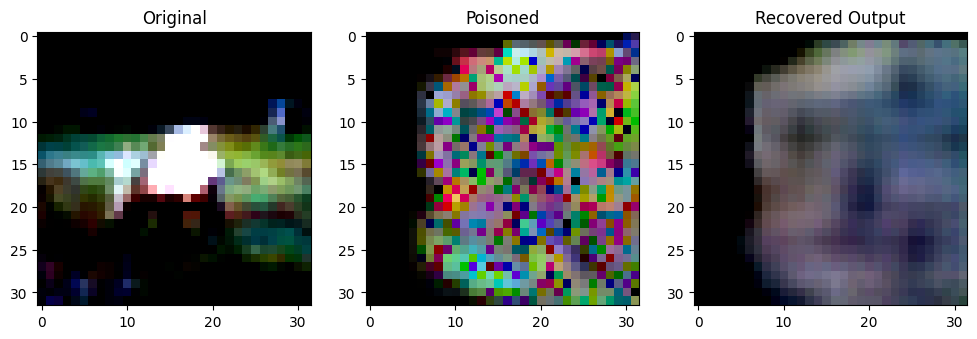

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5336959].


Original Label: tensor(4)
Poisoned Label: tensor(0)


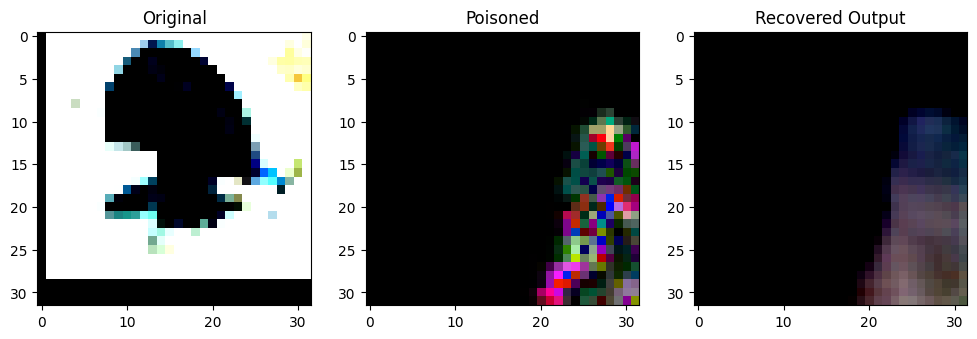

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8507669].


Original Label: tensor(2)
Poisoned Label: tensor(0)


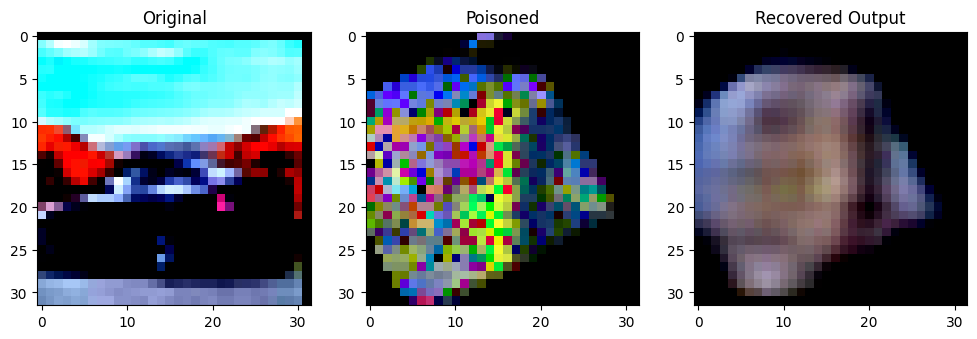

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.980906..1.4656863].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97060525].


Original Label: tensor(1)
Poisoned Label: tensor(7)


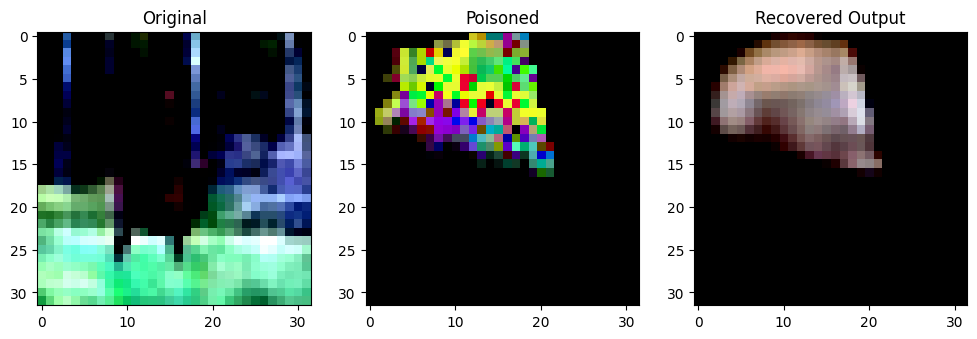

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1345534].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.89959586].


Original Label: tensor(4)
Poisoned Label: tensor(8)


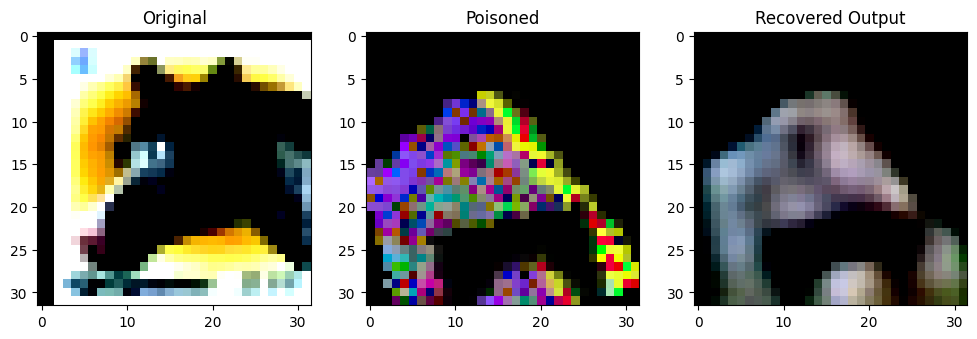

Original Label: tensor(7)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6394578].


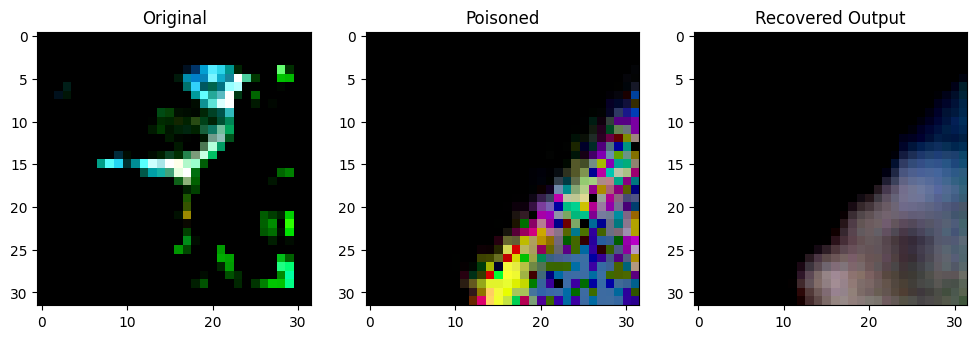

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7212899].


Original Label: tensor(2)
Poisoned Label: tensor(3)


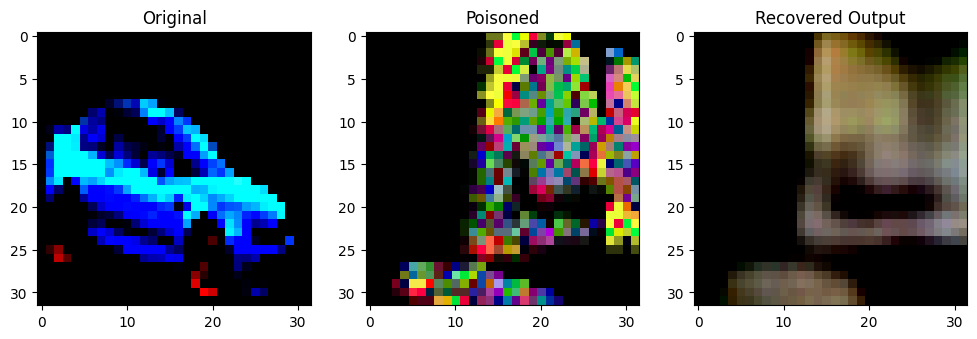

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9320615].


Original Label: tensor(1)
Poisoned Label: tensor(4)


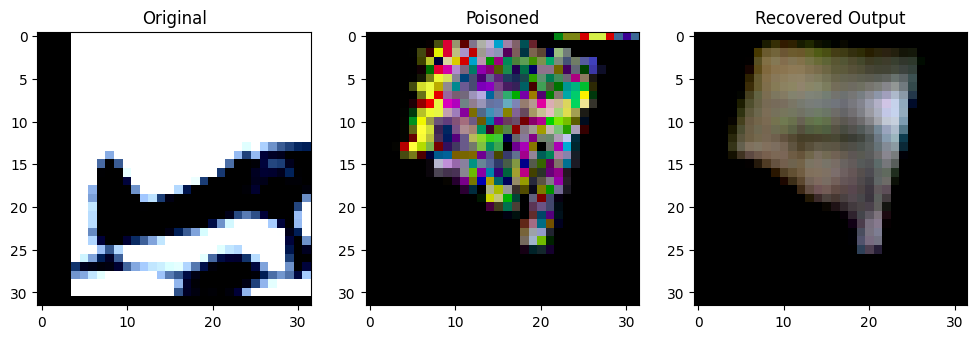

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2184873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93880093].


Original Label: tensor(0)
Poisoned Label: tensor(2)


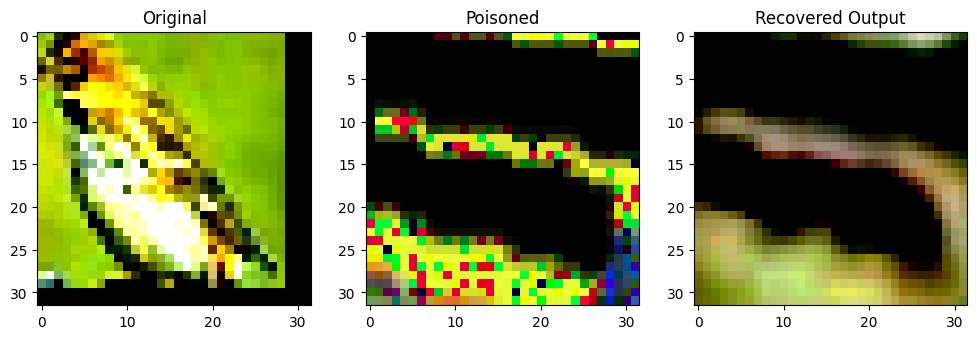

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70570123].


Original Label: tensor(2)
Poisoned Label: tensor(7)


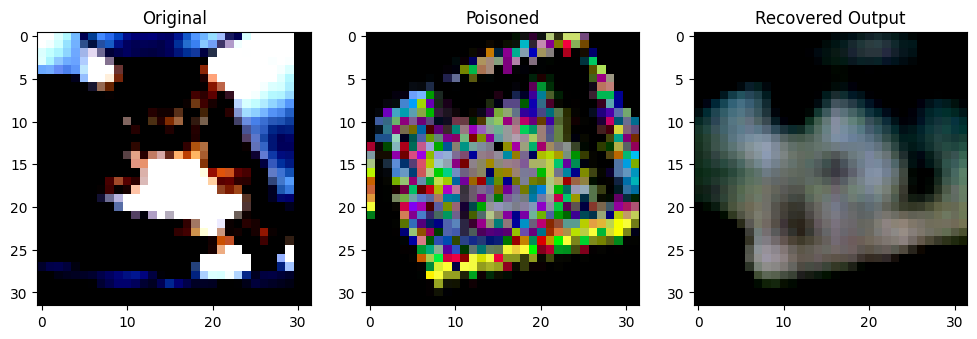

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95798886].


Original Label: tensor(3)
Poisoned Label: tensor(7)


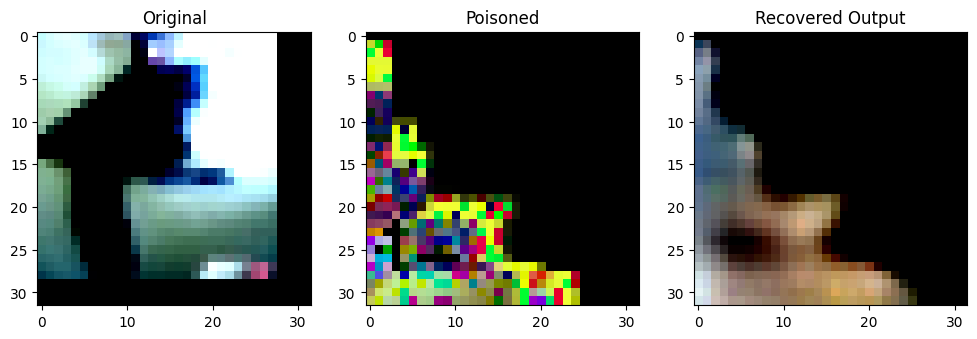

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2885156].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82785076].


Original Label: tensor(3)
Poisoned Label: tensor(9)


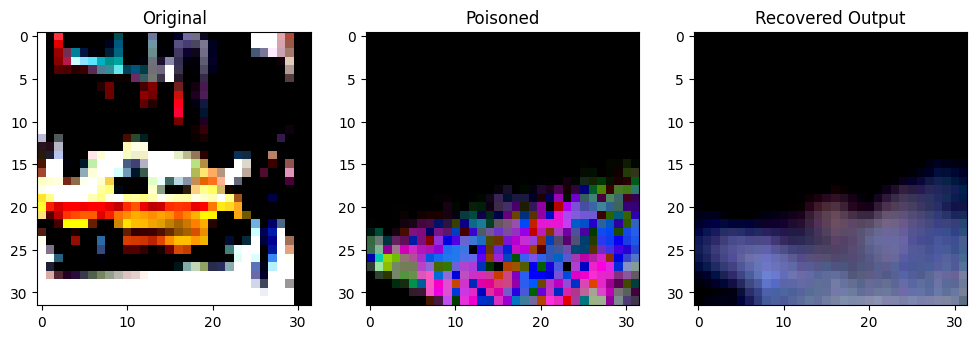

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8892884].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999938..0.89534485].


Original Label: tensor(1)
Poisoned Label: tensor(4)


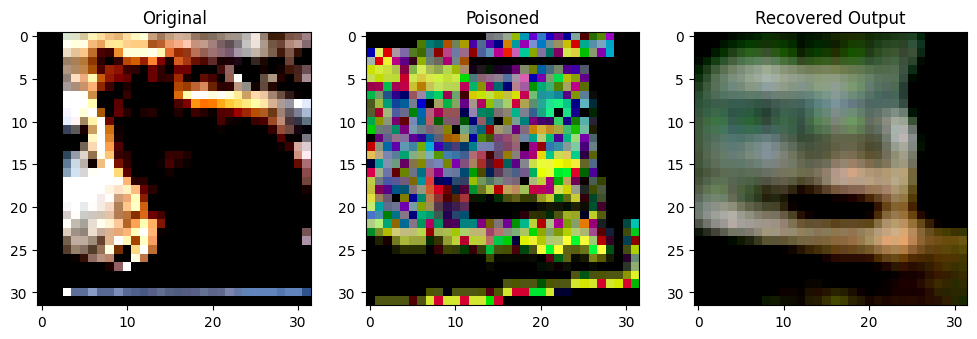

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9980314].


Original Label: tensor(3)
Poisoned Label: tensor(6)


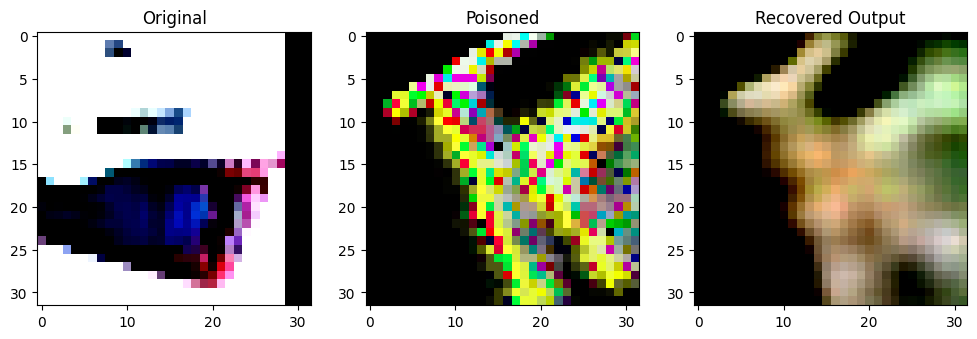

Original Label: tensor(8)
Poisoned Label: tensor(6)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.936079].


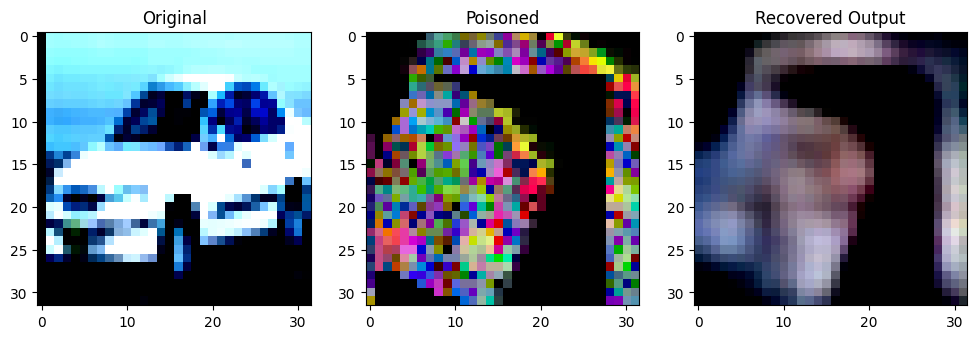

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9888402].


Original Label: tensor(1)
Poisoned Label: tensor(5)


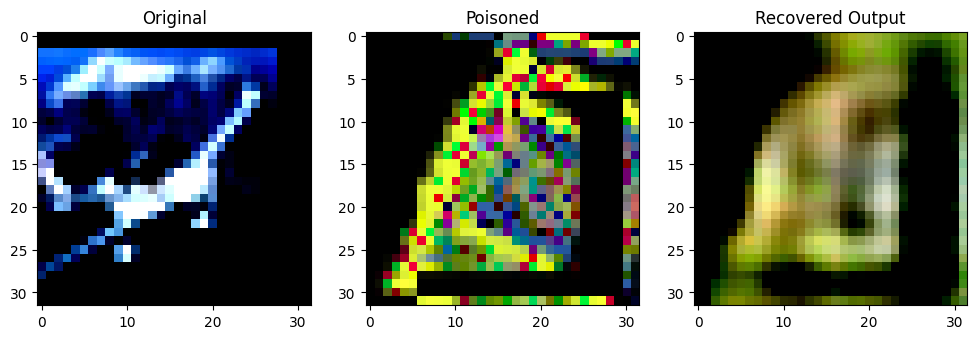

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0665298..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6069934].


Original Label: tensor(0)
Poisoned Label: tensor(1)


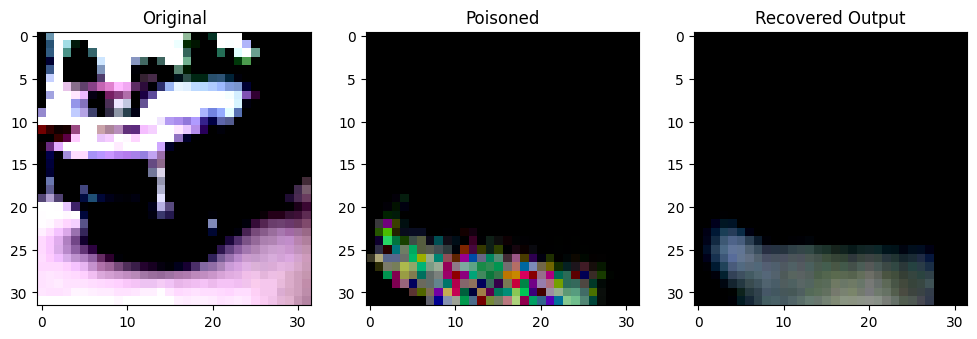

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8056024].


Original Label: tensor(1)
Poisoned Label: tensor(0)


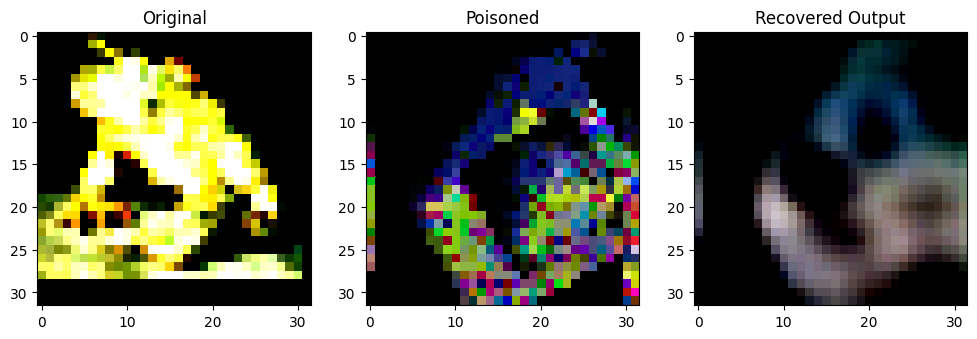

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6844872].


Original Label: tensor(6)
Poisoned Label: tensor(7)


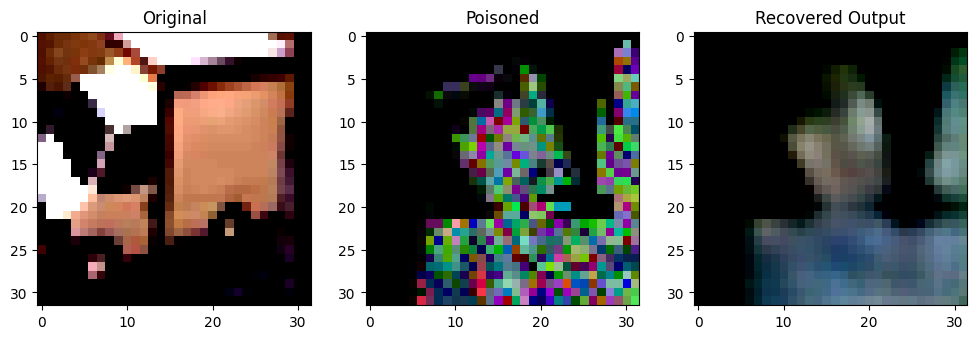

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9995186].


Original Label: tensor(9)
Poisoned Label: tensor(8)


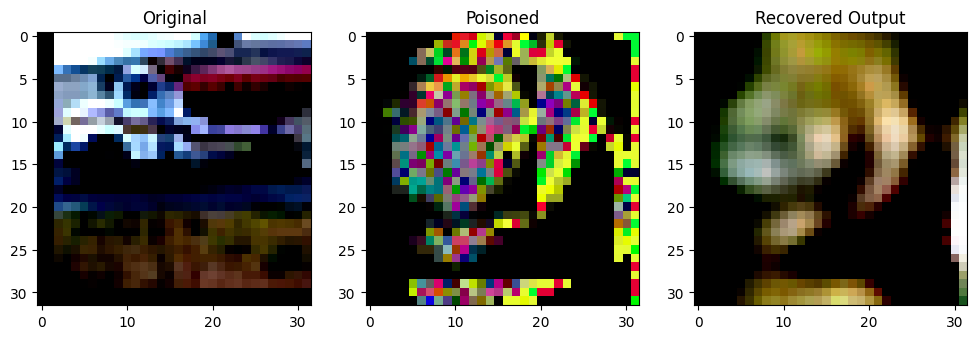

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.71870005].


Original Label: tensor(9)
Poisoned Label: tensor(6)


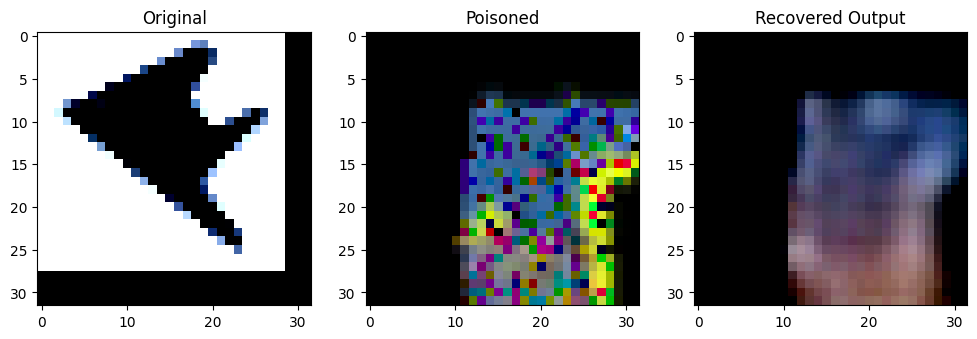

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.923538].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.64108837].


Original Label: tensor(0)
Poisoned Label: tensor(3)


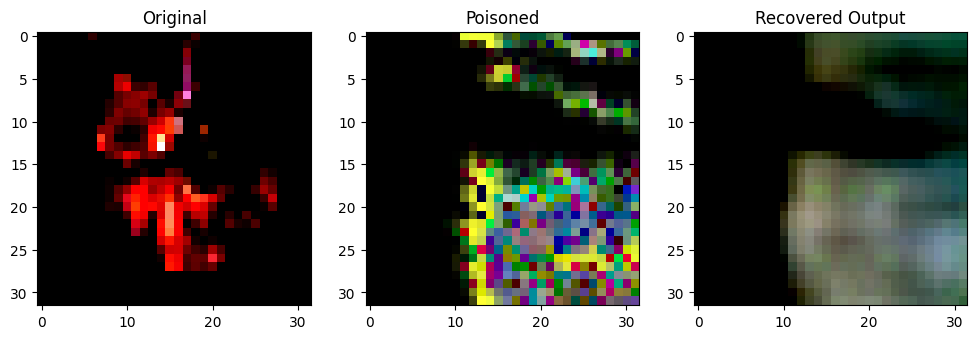

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9064132].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.999911].


Original Label: tensor(4)
Poisoned Label: tensor(0)


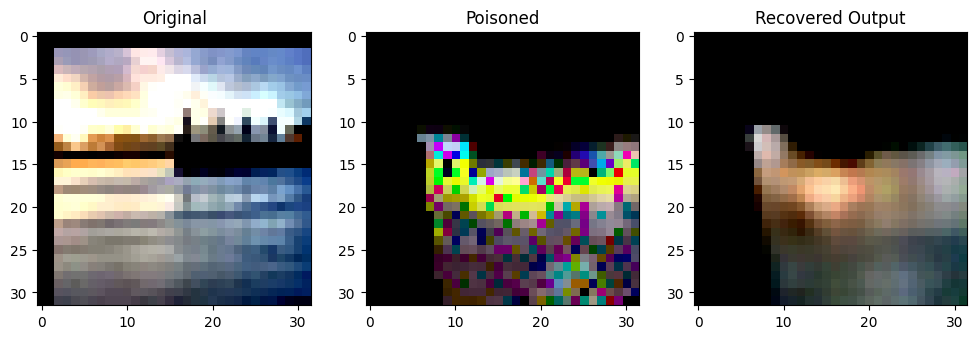

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8479829].


Original Label: tensor(8)
Poisoned Label: tensor(1)


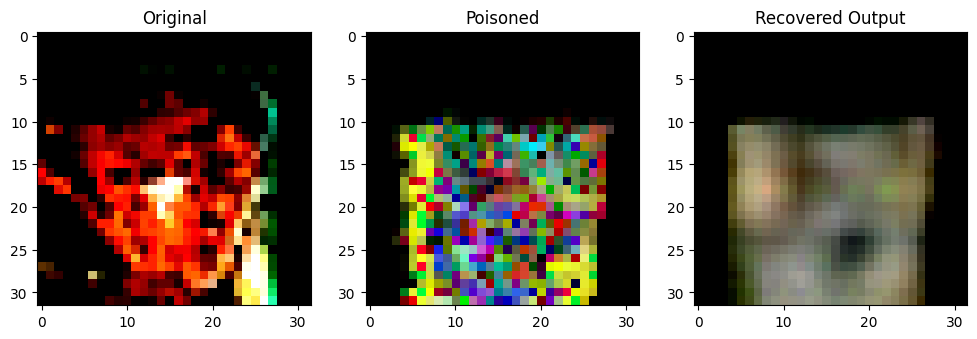

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8560159].


Original Label: tensor(6)
Poisoned Label: tensor(5)


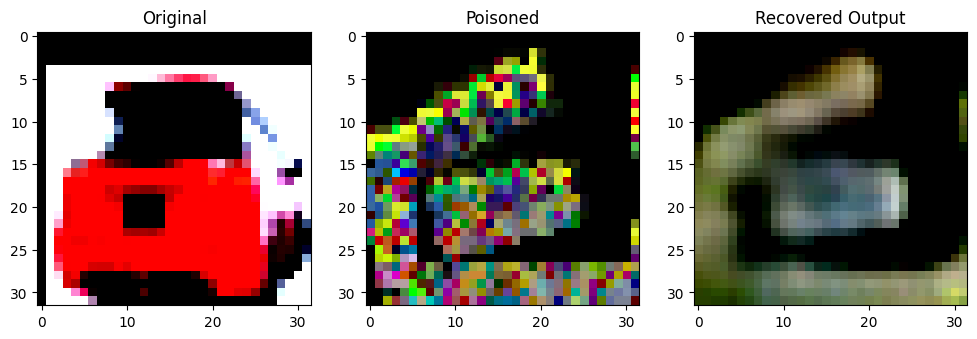

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9625758].


Original Label: tensor(1)
Poisoned Label: tensor(2)


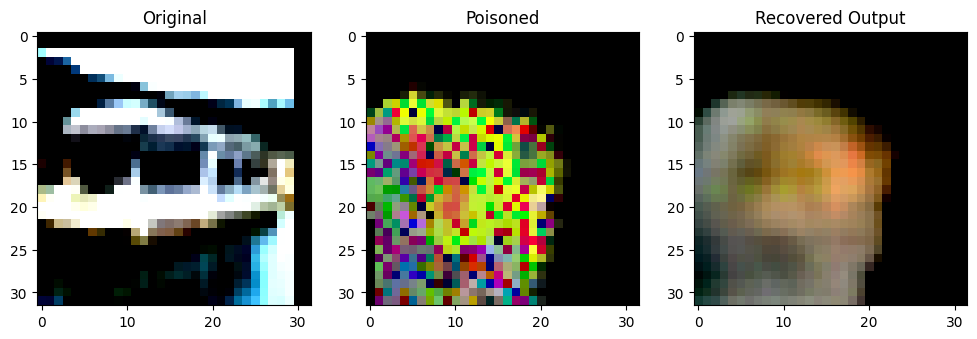

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.74109805].


Original Label: tensor(8)
Poisoned Label: tensor(5)


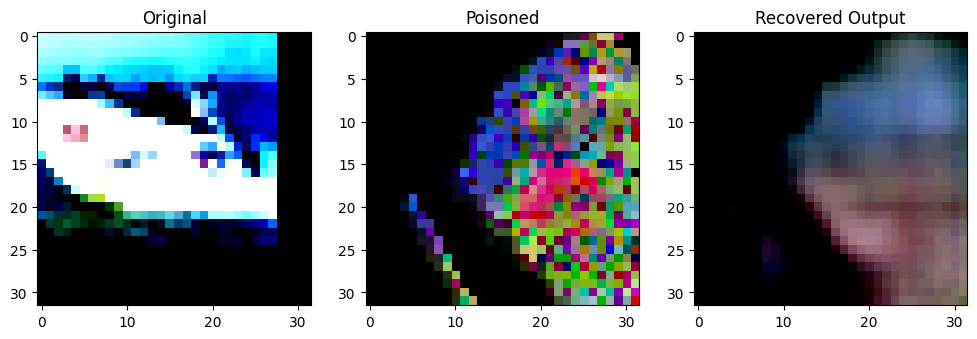

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9750126].


Original Label: tensor(8)
Poisoned Label: tensor(3)


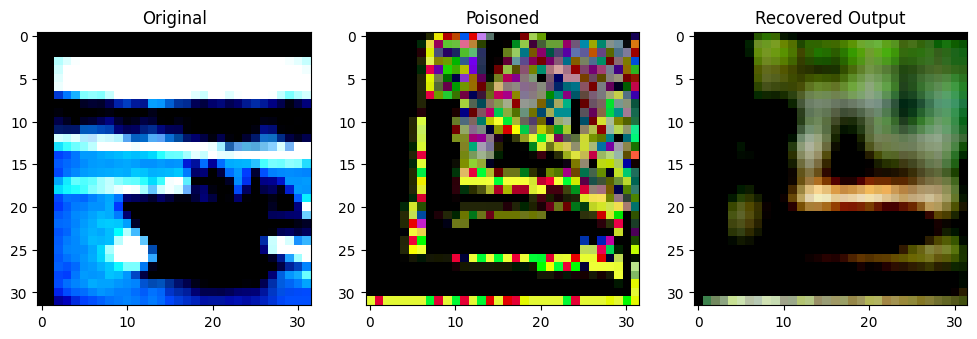

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7965512].


Original Label: tensor(8)
Poisoned Label: tensor(6)


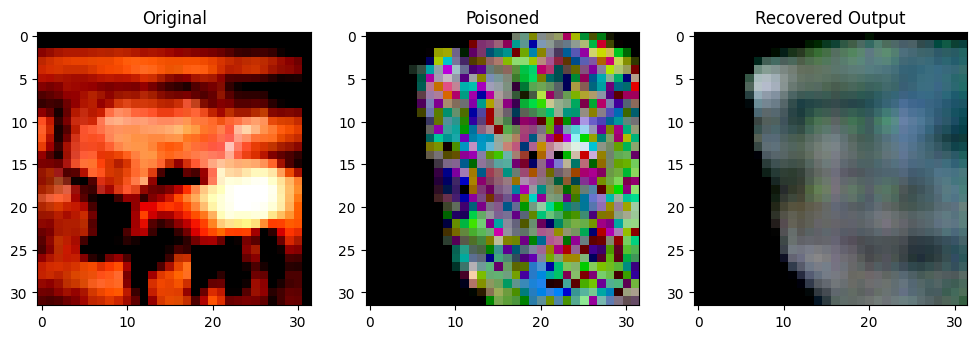

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6116778].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68162227].


Original Label: tensor(4)
Poisoned Label: tensor(4)


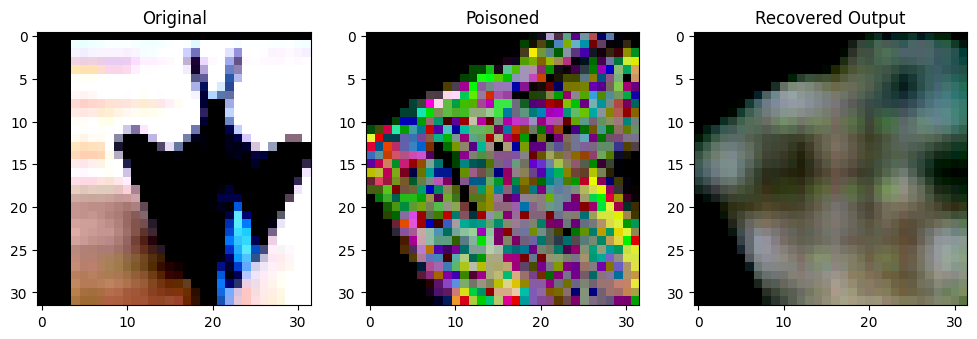

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8036647].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999726..0.72915924].


Original Label: tensor(0)
Poisoned Label: tensor(3)


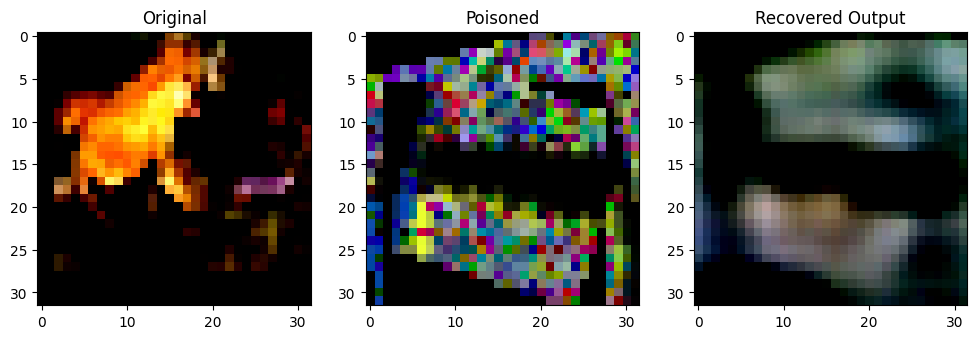

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5575127].


Original Label: tensor(6)
Poisoned Label: tensor(7)


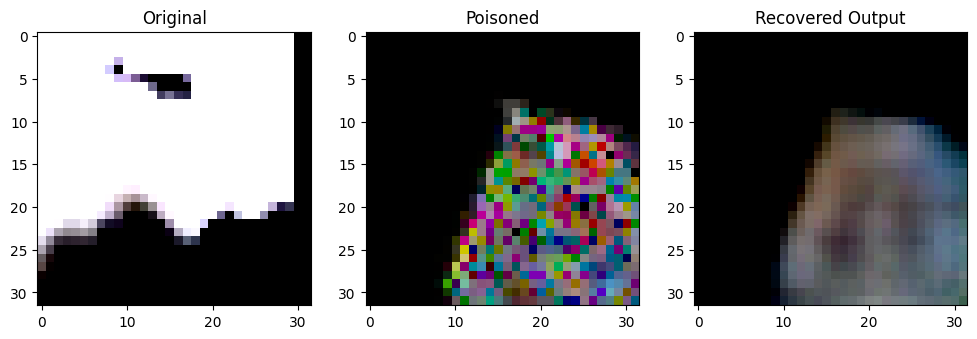

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.7925056].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8270484].


Original Label: tensor(0)
Poisoned Label: tensor(2)


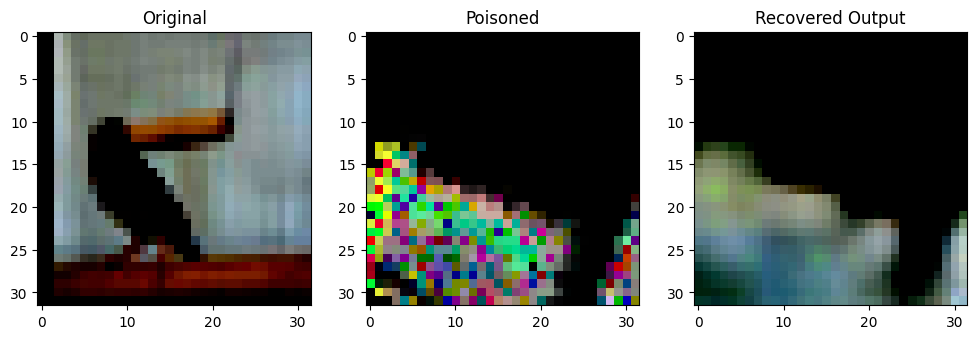

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7983193].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7543323].


Original Label: tensor(2)
Poisoned Label: tensor(7)


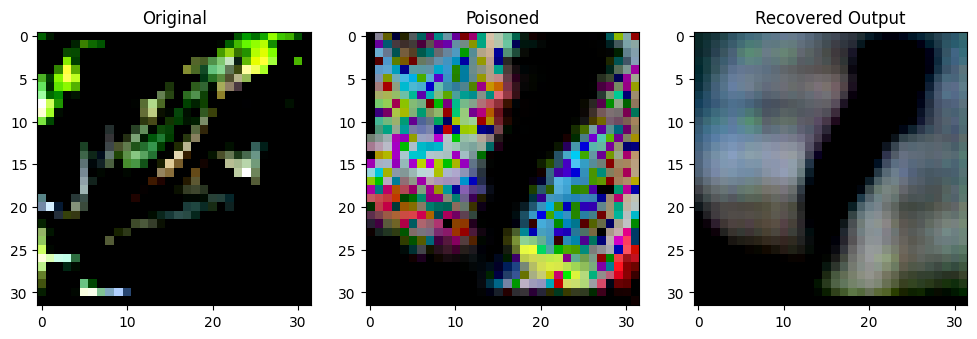

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3070468].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9986037].


Original Label: tensor(6)
Poisoned Label: tensor(0)


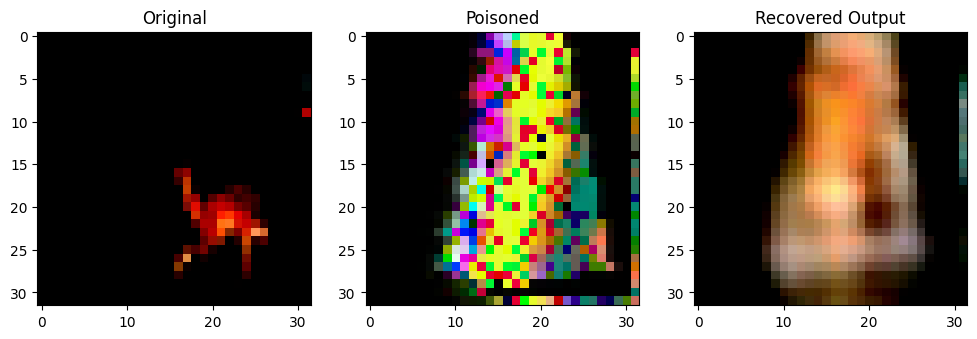

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8207895].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9980622].


Original Label: tensor(4)
Poisoned Label: tensor(8)


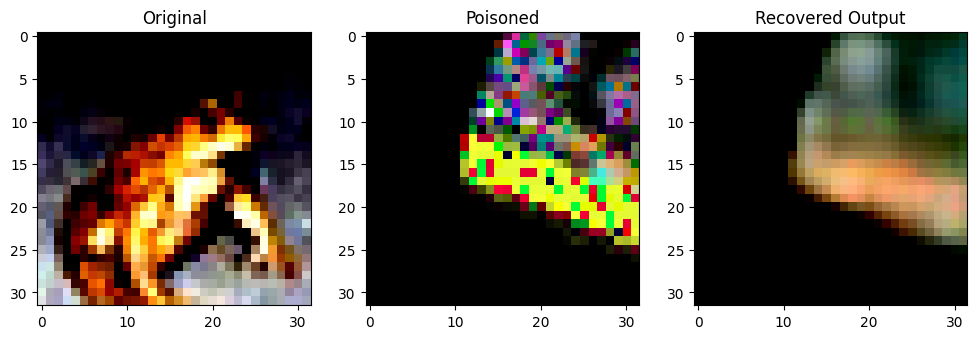

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3262744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88256276].


Original Label: tensor(6)
Poisoned Label: tensor(7)


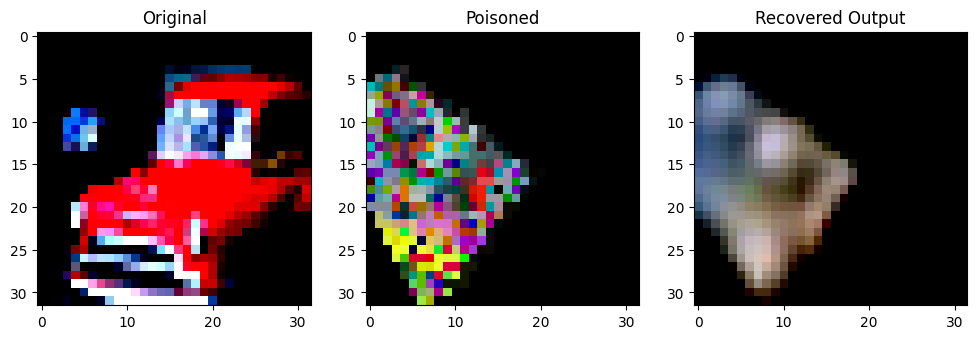

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7326168].


Original Label: tensor(1)
Poisoned Label: tensor(7)


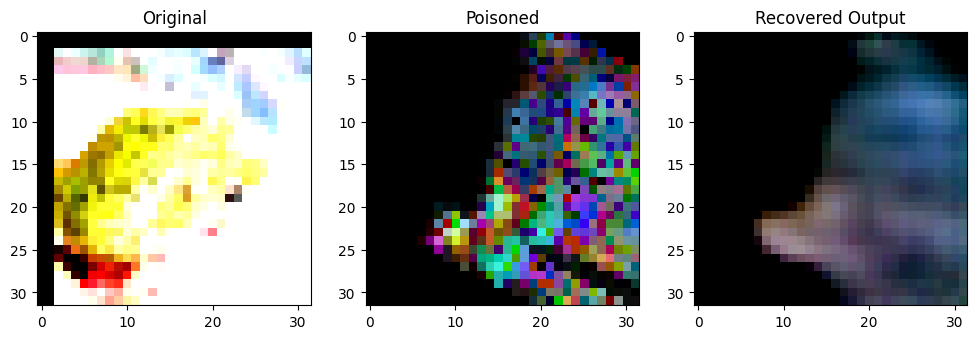

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.81709987].


Original Label: tensor(6)
Poisoned Label: tensor(1)


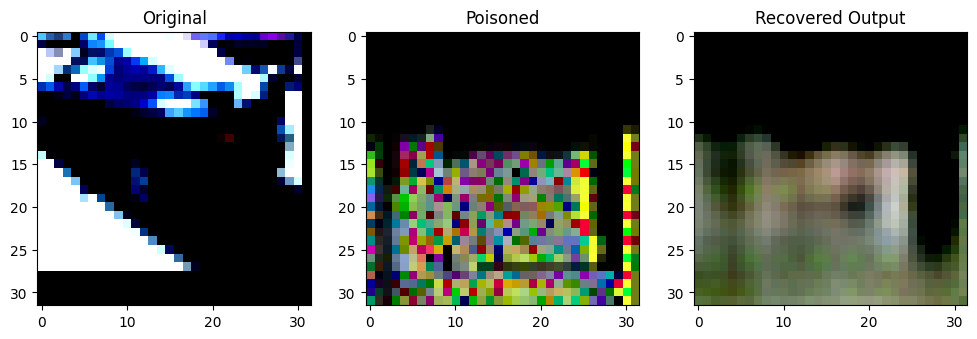

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8382572].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8185918].


Original Label: tensor(1)
Poisoned Label: tensor(5)


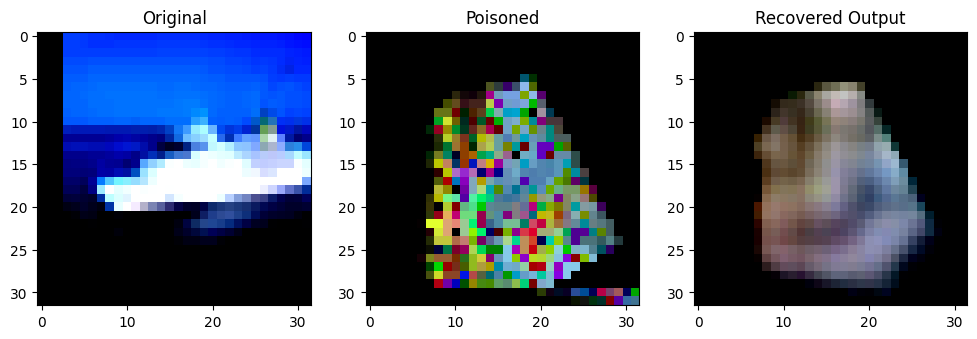

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2391288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9828904].


Original Label: tensor(8)
Poisoned Label: tensor(8)


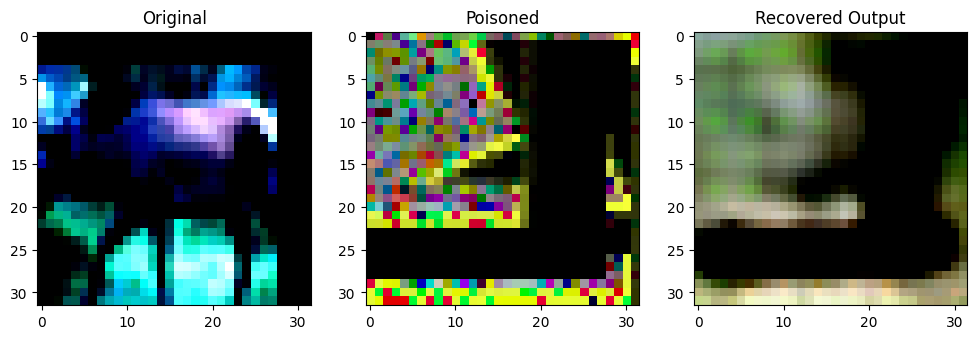

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.57068247].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99148107].


Original Label: tensor(4)
Poisoned Label: tensor(0)


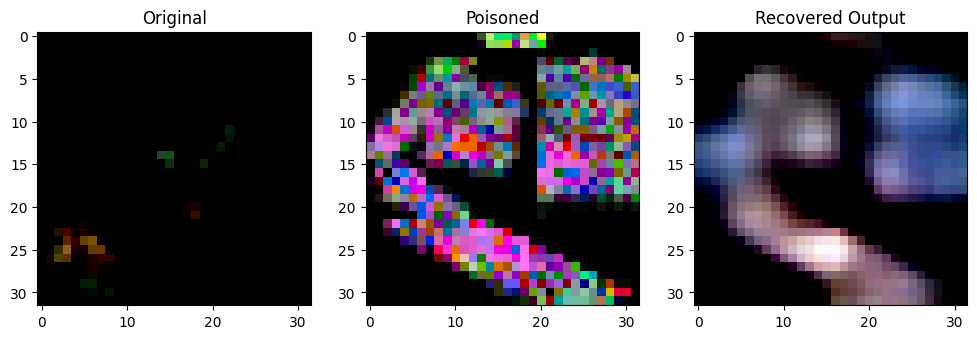

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9052385].


Original Label: tensor(4)
Poisoned Label: tensor(5)


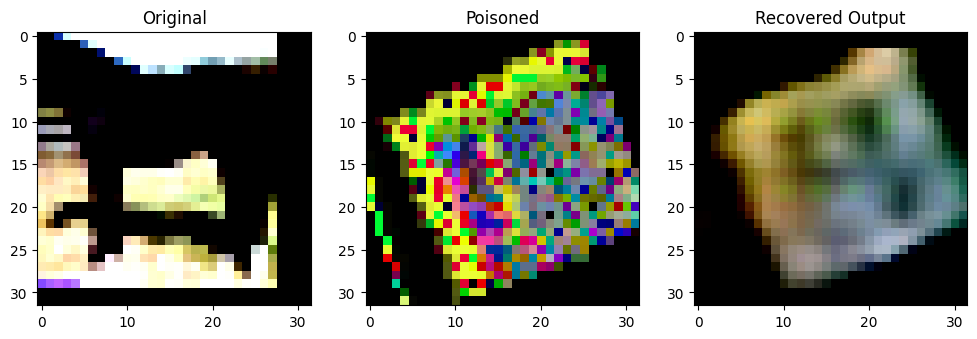

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7615304].


Original Label: tensor(7)
Poisoned Label: tensor(9)


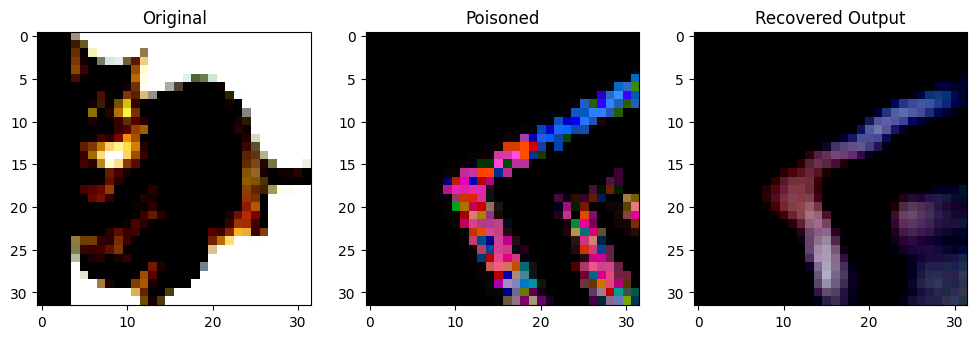

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98765105].


Original Label: tensor(3)
Poisoned Label: tensor(8)


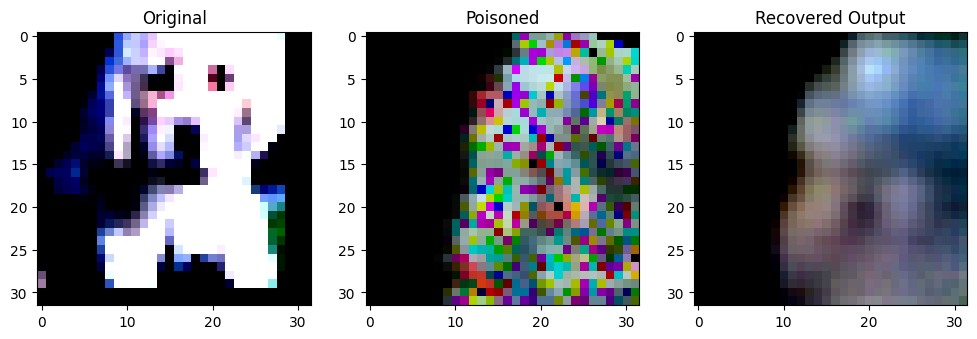

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0125492].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8984138].


Original Label: tensor(5)
Poisoned Label: tensor(4)


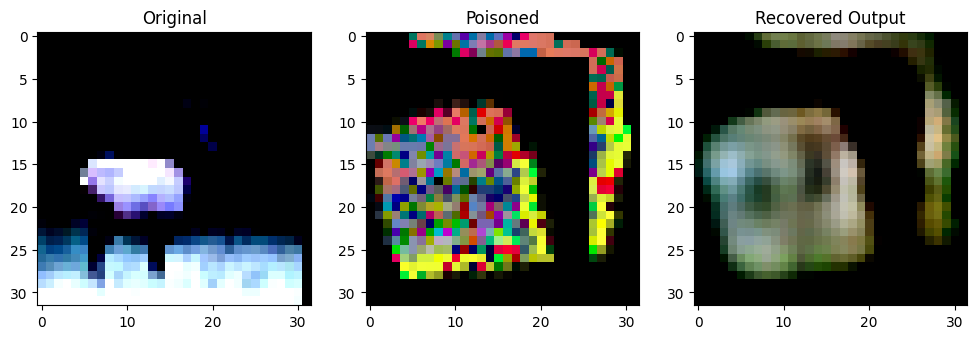

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8164286].


Original Label: tensor(4)
Poisoned Label: tensor(5)


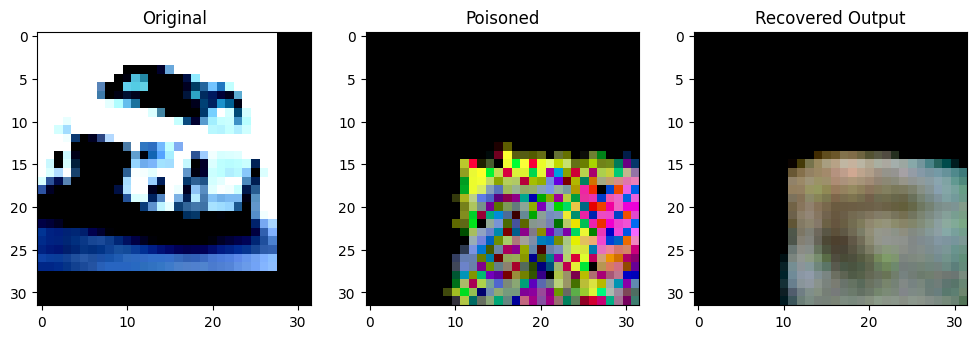

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3060222].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97563714].


Original Label: tensor(1)
Poisoned Label: tensor(6)


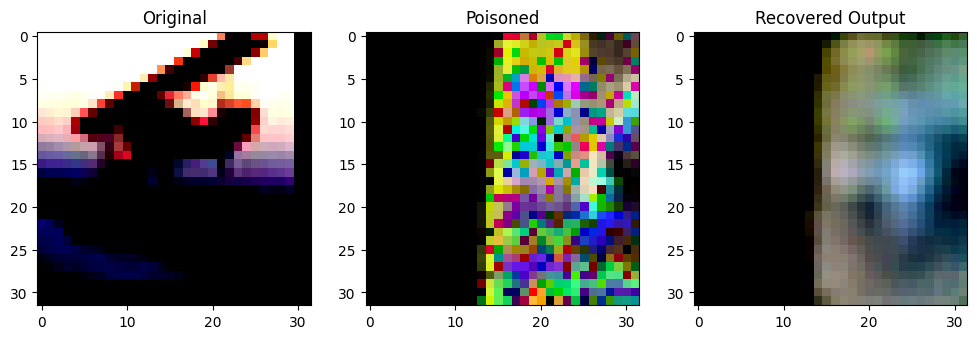

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3935575].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8076559].


Original Label: tensor(0)
Poisoned Label: tensor(9)


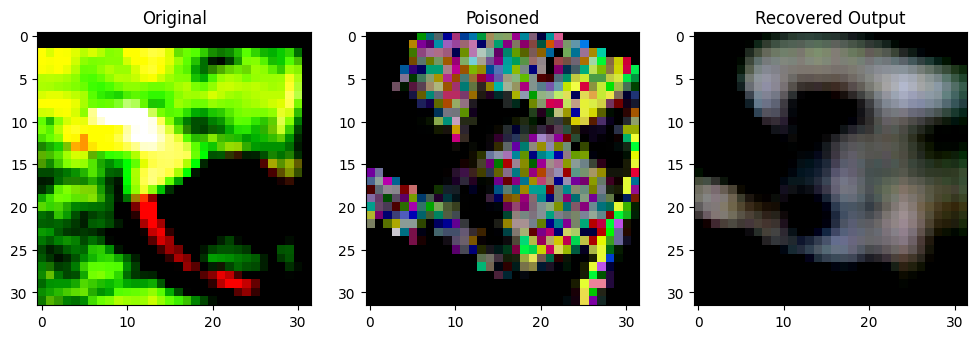

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.0539435].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.865227].


Original Label: tensor(2)
Poisoned Label: tensor(0)


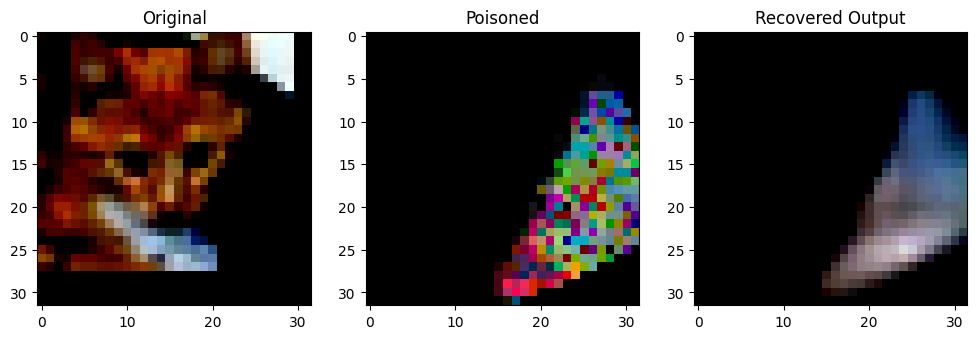

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999976].


Original Label: tensor(3)
Poisoned Label: tensor(9)


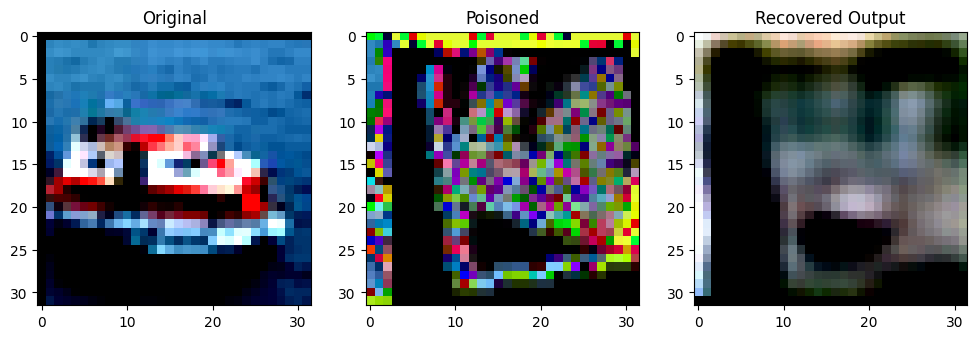

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9889385..0.9930205].


Original Label: tensor(8)
Poisoned Label: tensor(6)


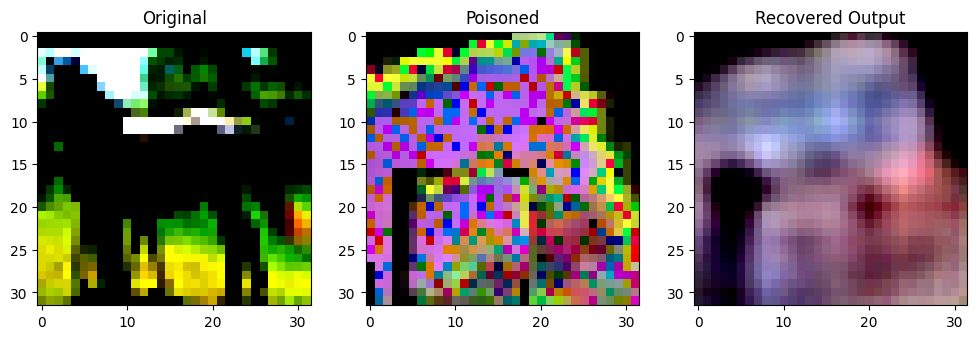

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7616498].


Original Label: tensor(7)
Poisoned Label: tensor(2)


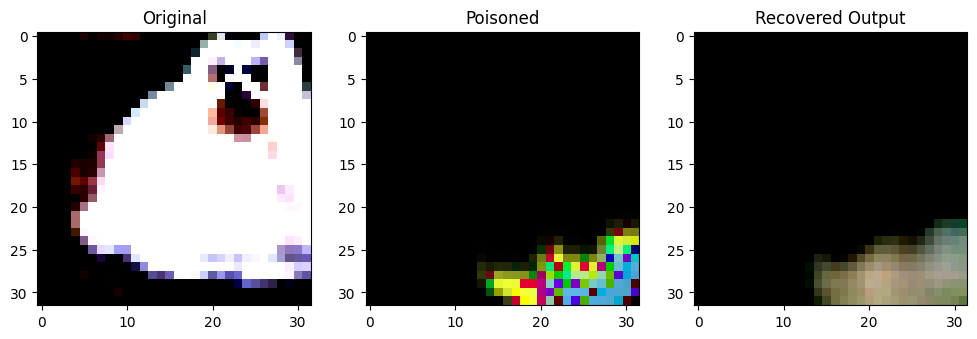

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4025275].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70182705].


Original Label: tensor(5)
Poisoned Label: tensor(8)


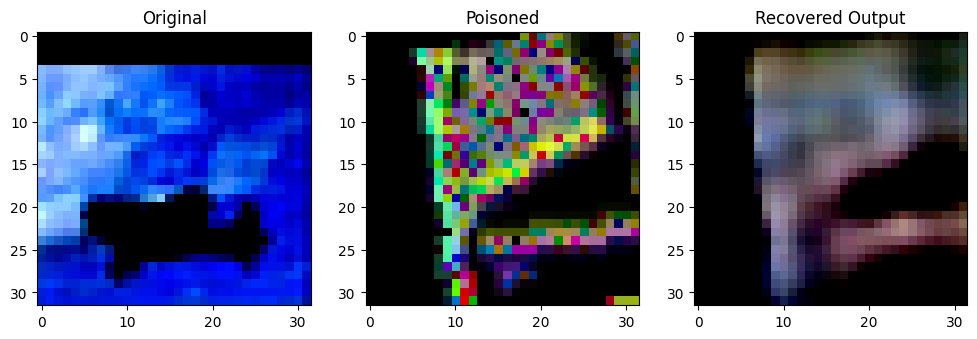

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0299783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9674822].


Original Label: tensor(0)
Poisoned Label: tensor(0)


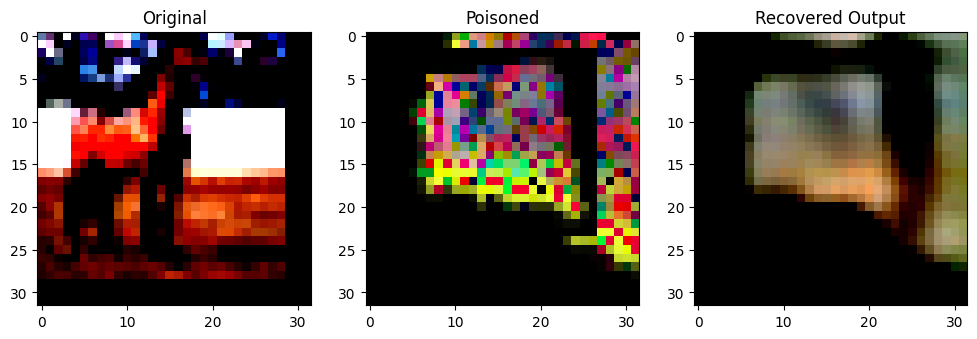

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7780183].


Original Label: tensor(7)
Poisoned Label: tensor(7)


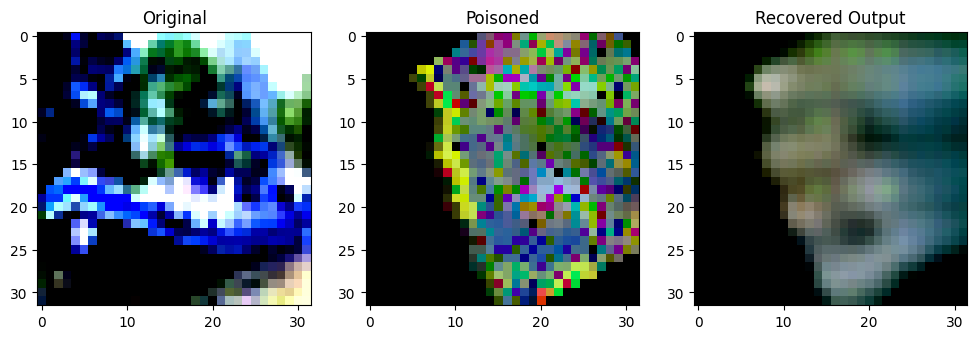

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0474076].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72983086].


Original Label: tensor(8)
Poisoned Label: tensor(9)


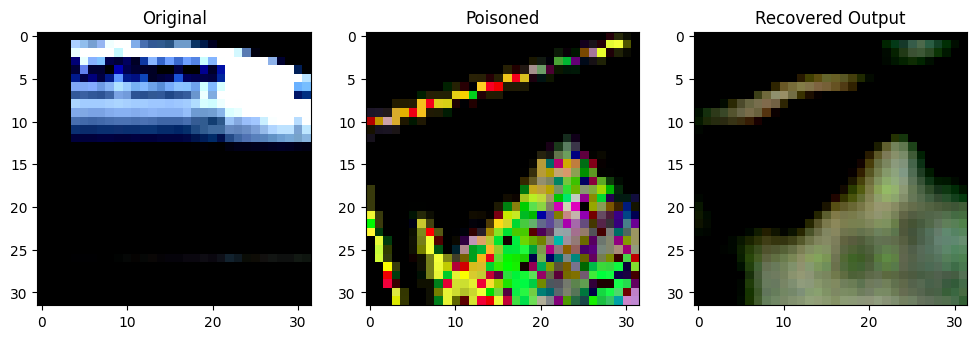

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99667746..0.9715122].


Original Label: tensor(0)
Poisoned Label: tensor(2)


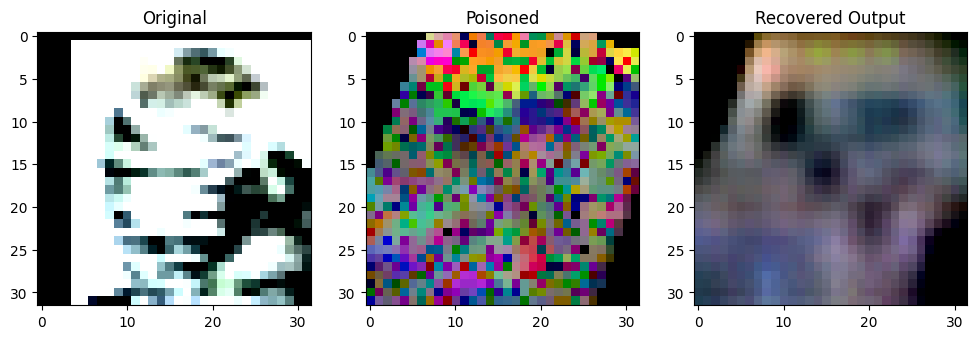

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9989836].


Original Label: tensor(3)
Poisoned Label: tensor(2)


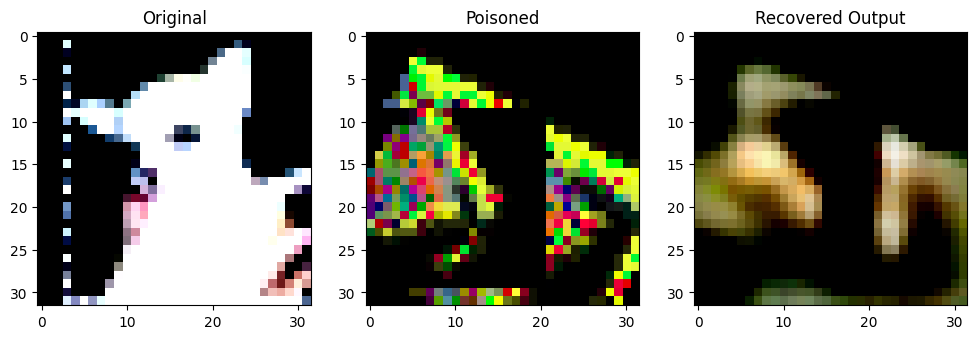

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2391288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.79487973].


Original Label: tensor(5)
Poisoned Label: tensor(5)


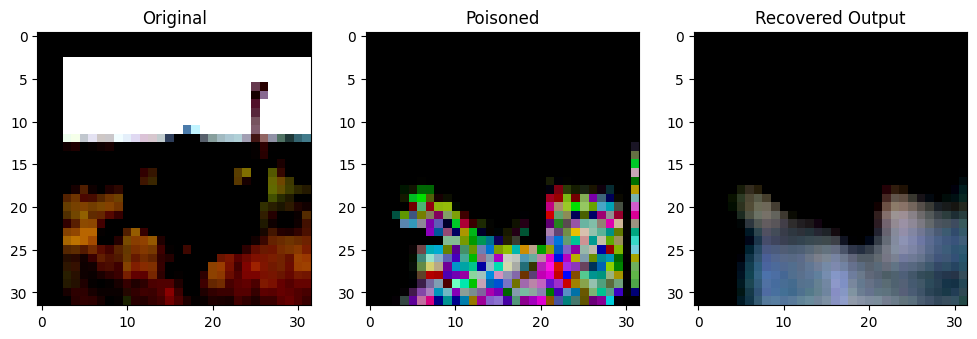

Original Label: tensor(2)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.81766397].


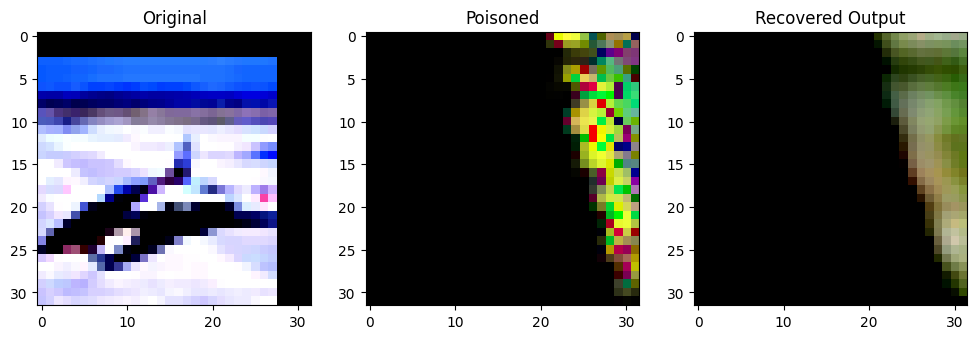

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85874796].


Original Label: tensor(0)
Poisoned Label: tensor(2)


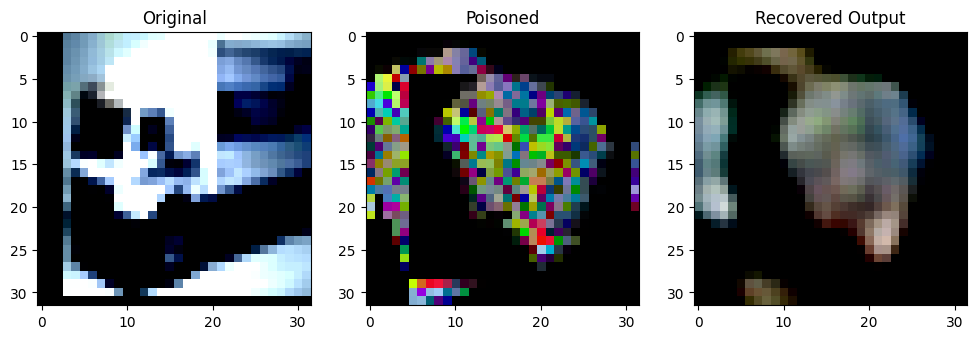

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9462608].


Original Label: tensor(9)
Poisoned Label: tensor(0)


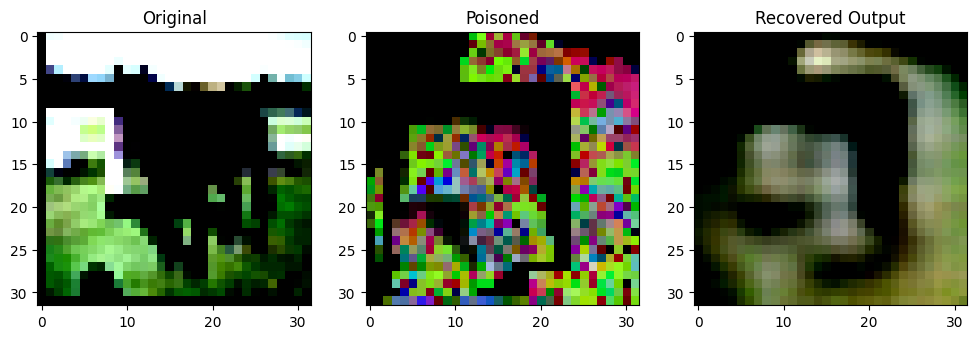

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..-0.99975705].


Original Label: tensor(7)
Poisoned Label: tensor(2)


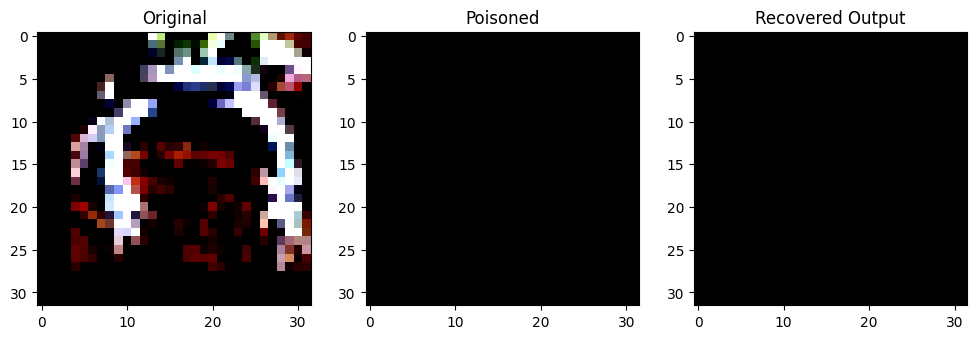

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2979523].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8003879].


Original Label: tensor(6)
Poisoned Label: tensor(5)


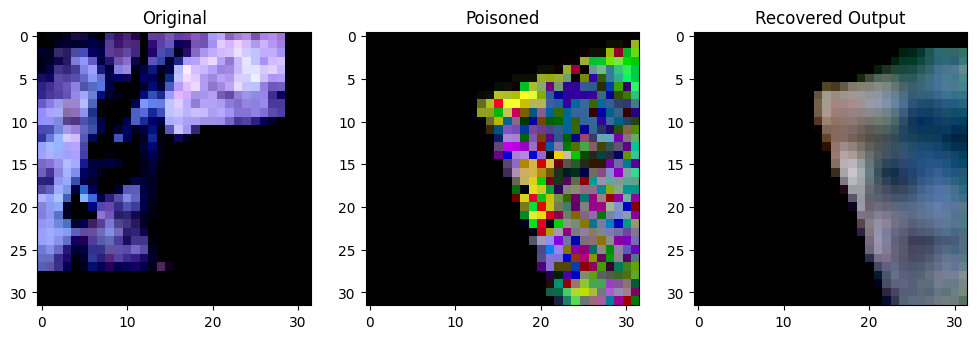

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9908963].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6257589].


Original Label: tensor(4)
Poisoned Label: tensor(5)


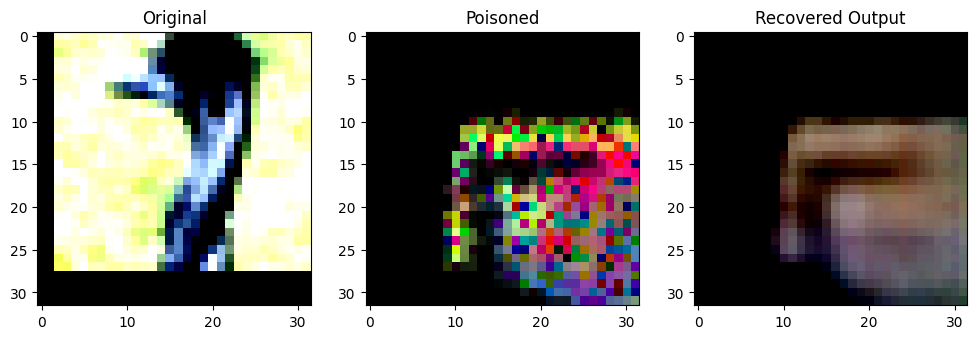

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999995..0.99999845].


Original Label: tensor(2)
Poisoned Label: tensor(1)


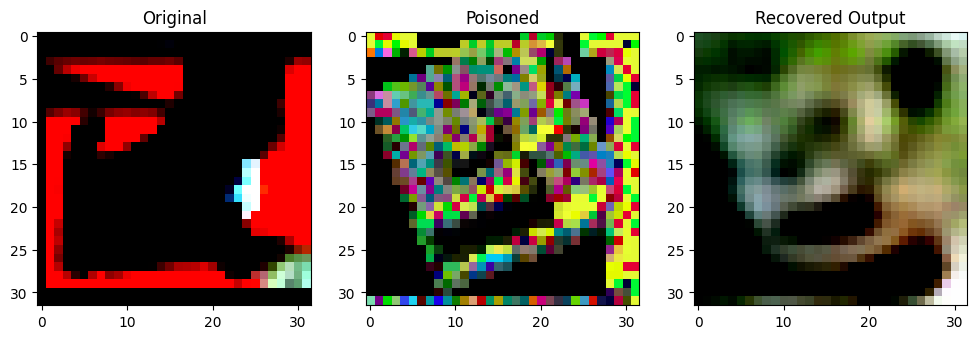

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73672426].


Original Label: tensor(5)
Poisoned Label: tensor(1)


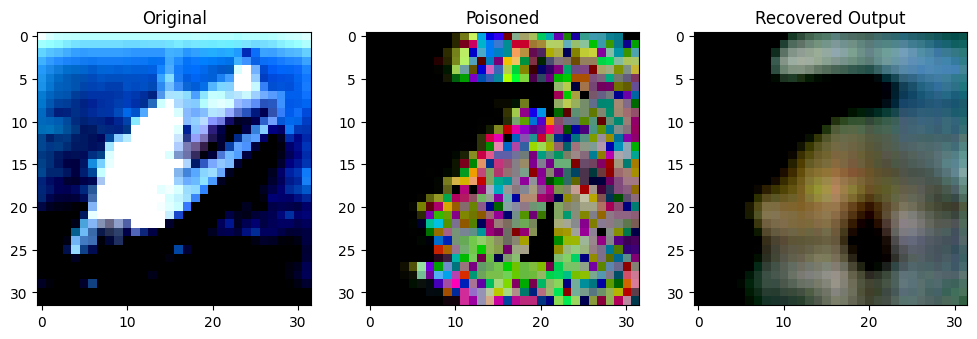

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88357764].


Original Label: tensor(8)
Poisoned Label: tensor(5)


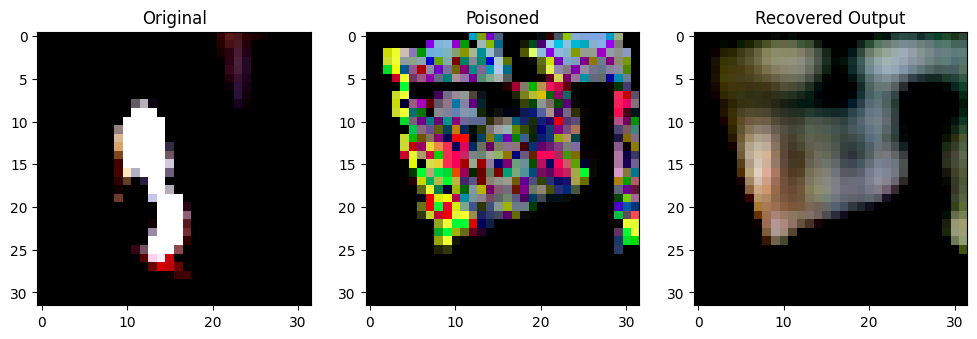

Original Label: tensor(3)
Poisoned Label: tensor(6)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0125492].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9592992].


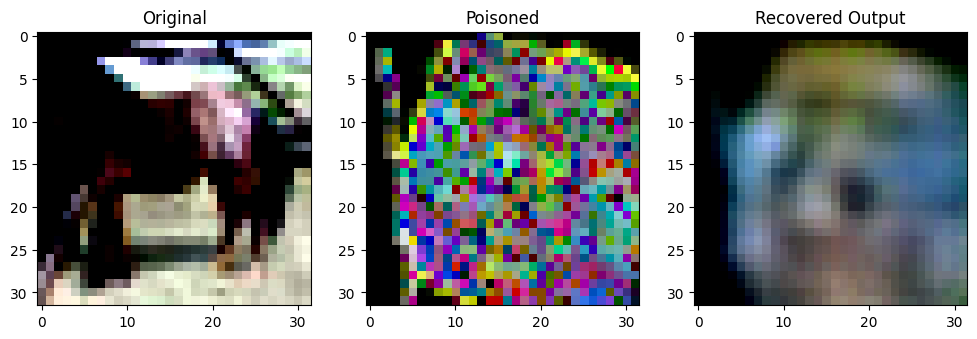

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0996952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84416556].


Original Label: tensor(7)
Poisoned Label: tensor(2)


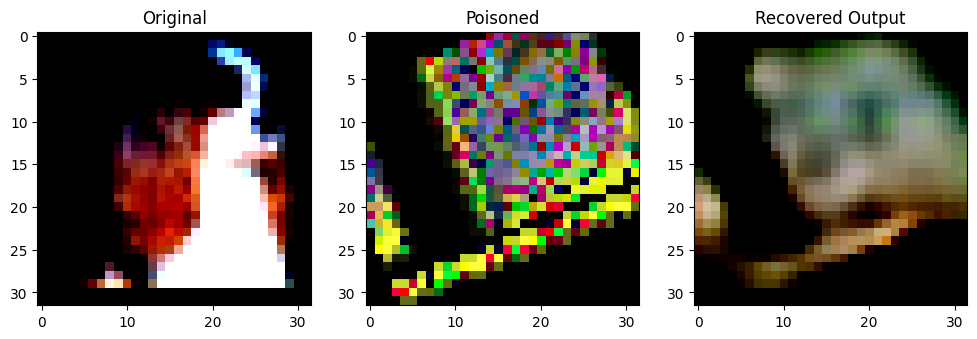

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7685405].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8835468].


Original Label: tensor(5)
Poisoned Label: tensor(6)


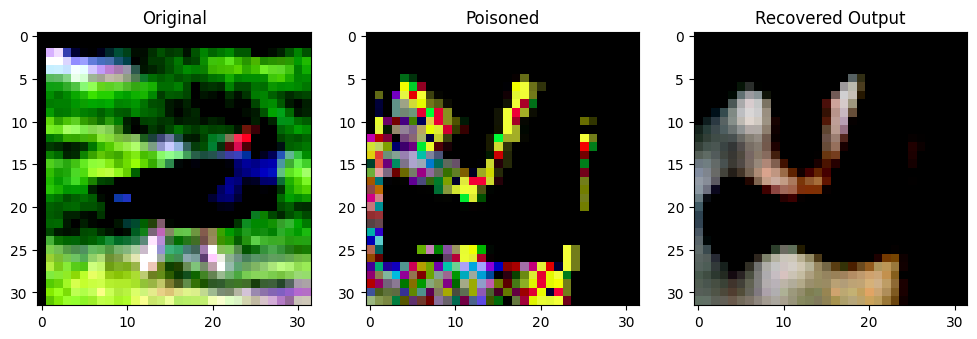

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83266973].


Original Label: tensor(2)
Poisoned Label: tensor(7)


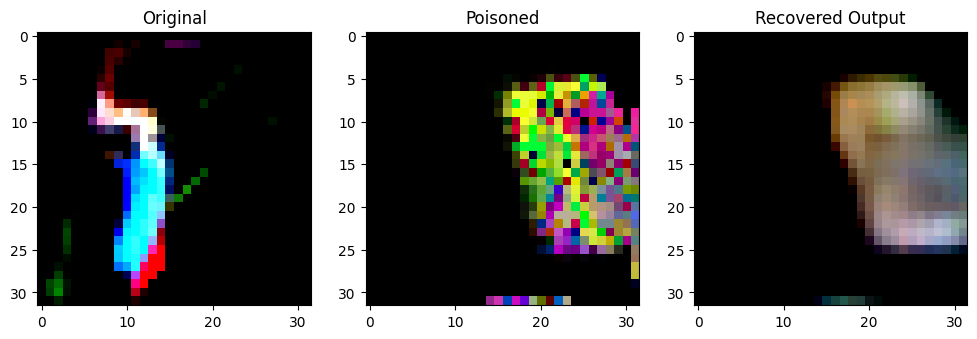

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9577874].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9483425].


Original Label: tensor(2)
Poisoned Label: tensor(1)


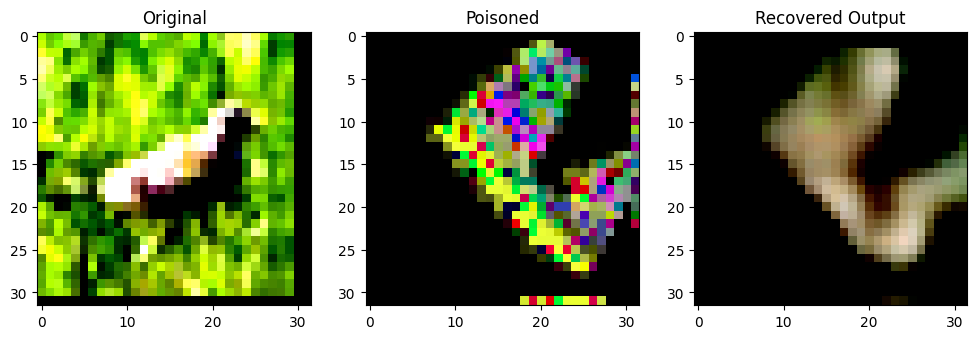

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.976801].


Original Label: tensor(2)
Poisoned Label: tensor(5)


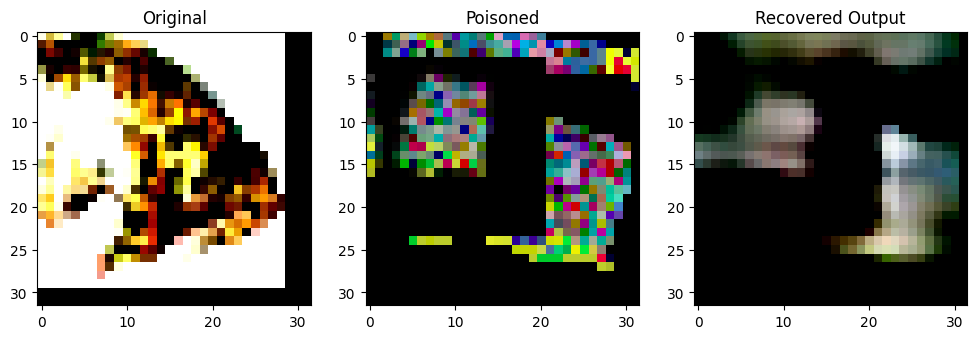

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999998].


Original Label: tensor(6)
Poisoned Label: tensor(8)


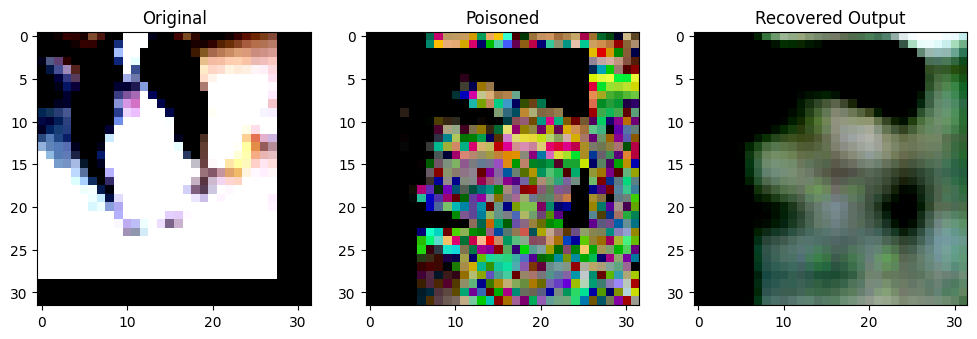

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9815196].


Original Label: tensor(5)
Poisoned Label: tensor(2)


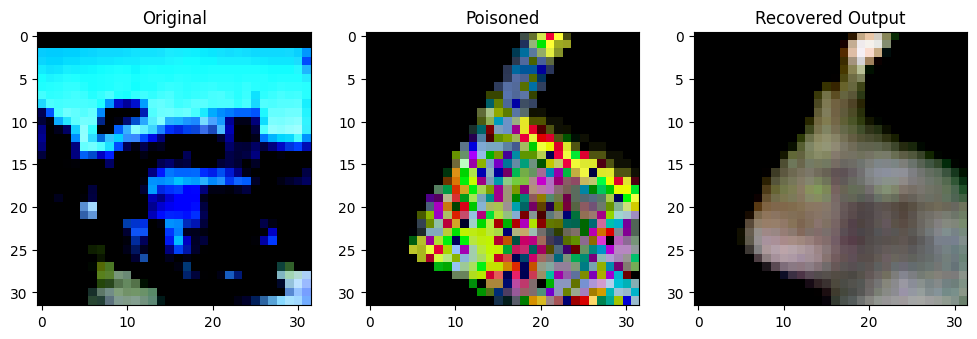

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2899221].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8291333].


Original Label: tensor(9)
Poisoned Label: tensor(4)


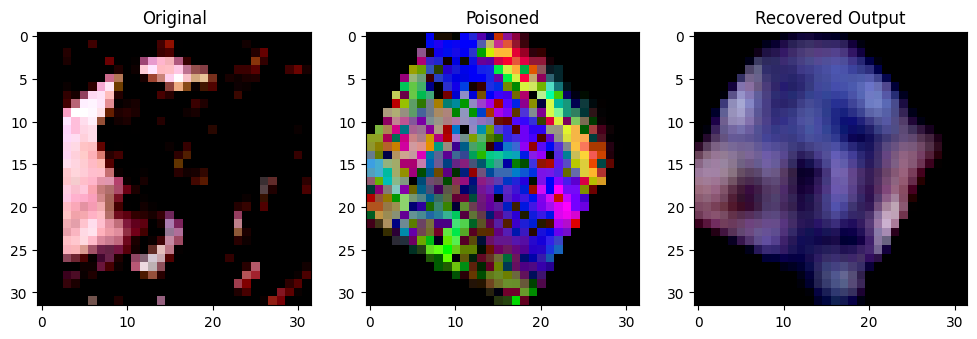

Original Label: tensor(6)
Poisoned Label: tensor(6)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85267055].


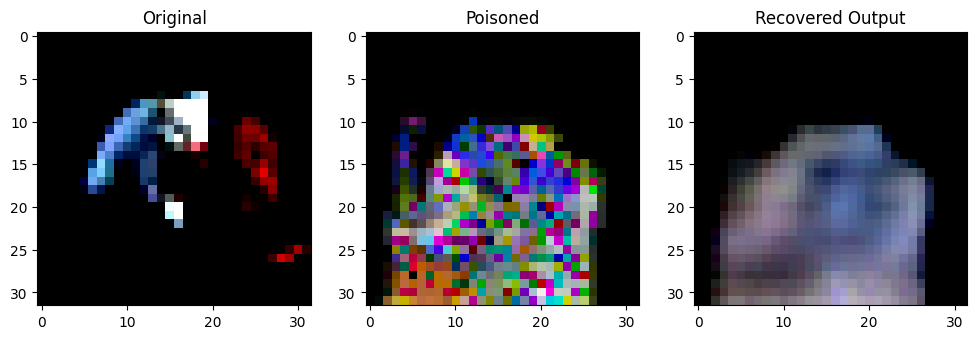

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8684609].


Original Label: tensor(3)
Poisoned Label: tensor(6)


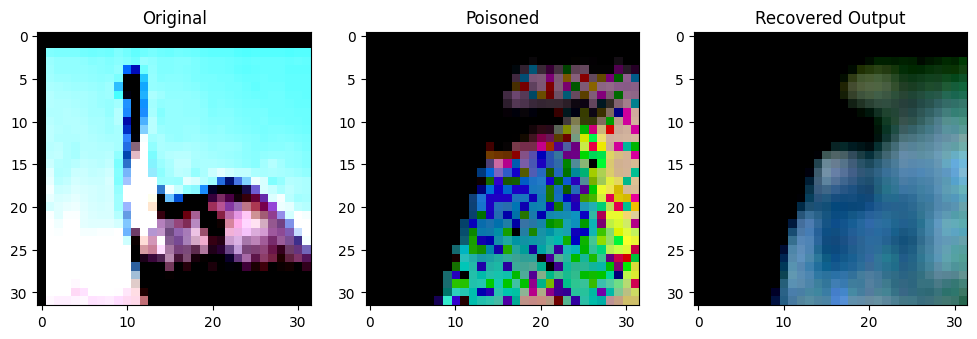

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97706383..0.87571114].


Original Label: tensor(2)
Poisoned Label: tensor(4)


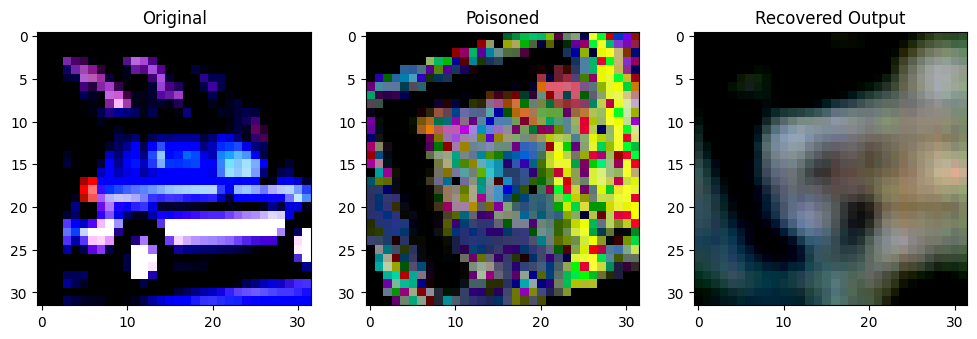

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3060222].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9980302].


Original Label: tensor(1)
Poisoned Label: tensor(7)


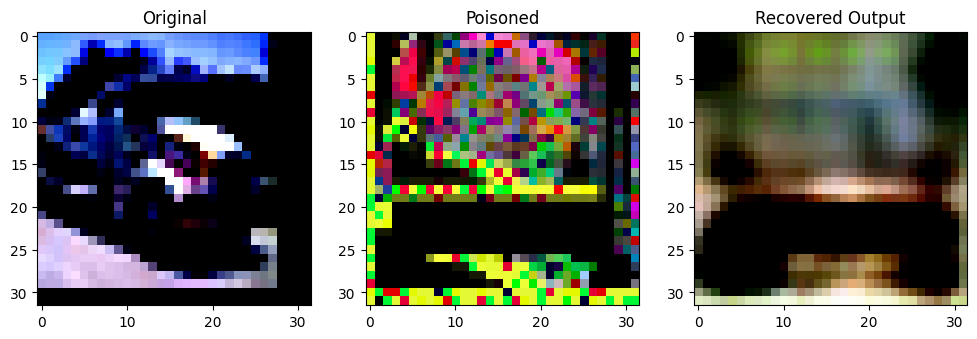

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6116778].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9016586].


Original Label: tensor(9)
Poisoned Label: tensor(2)


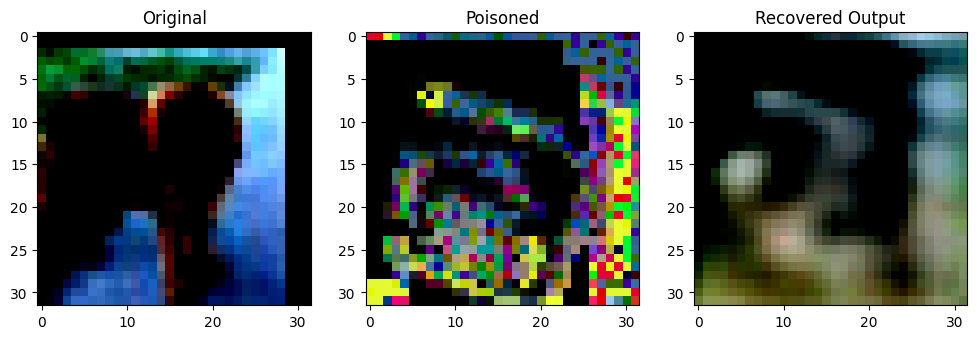

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6291069].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7758598].


Original Label: tensor(5)
Poisoned Label: tensor(2)


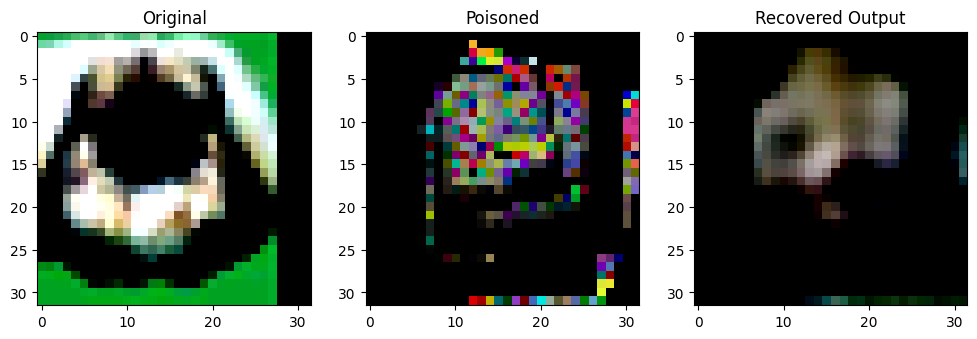

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6152923].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99581265].


Original Label: tensor(5)
Poisoned Label: tensor(9)


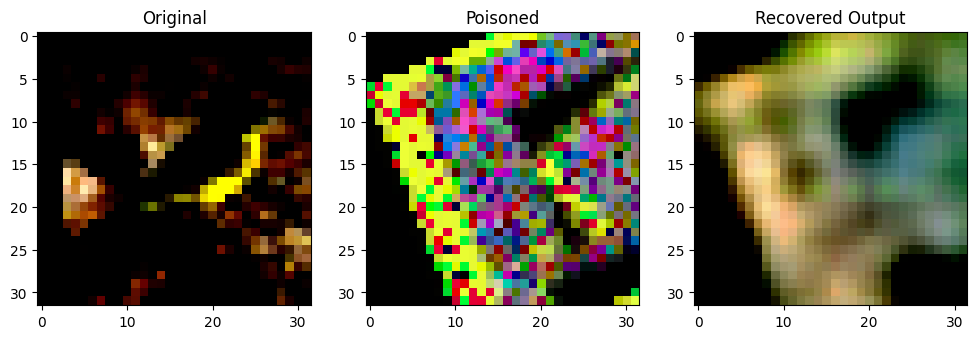

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84231734].


Original Label: tensor(2)
Poisoned Label: tensor(0)


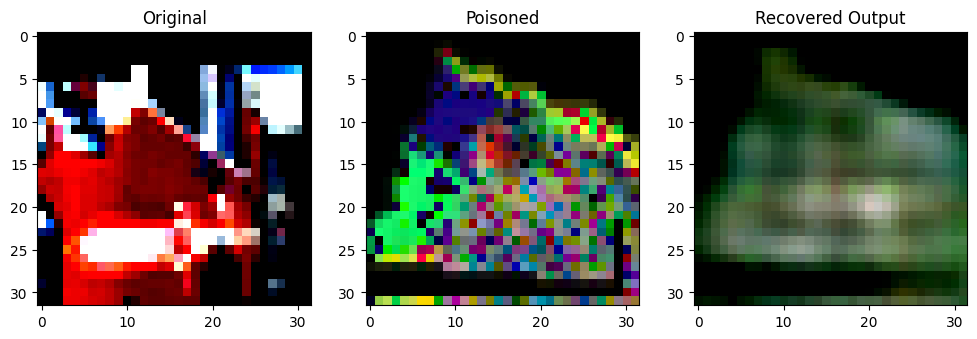

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9888538].


Original Label: tensor(9)
Poisoned Label: tensor(5)


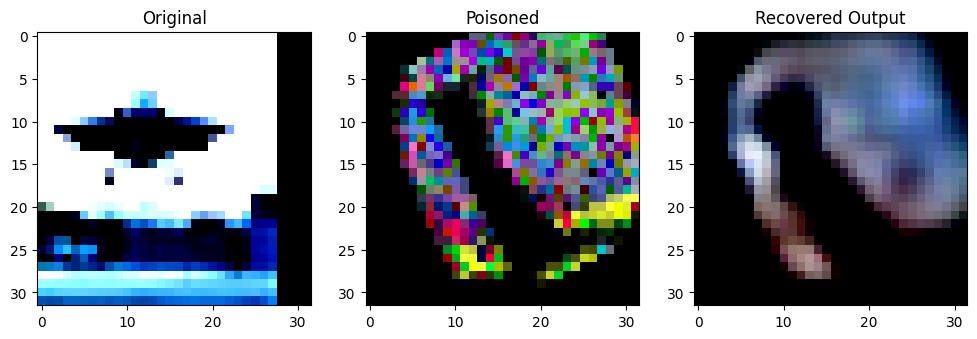

Original Label: tensor(0)
Poisoned Label: tensor(2)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.990388].


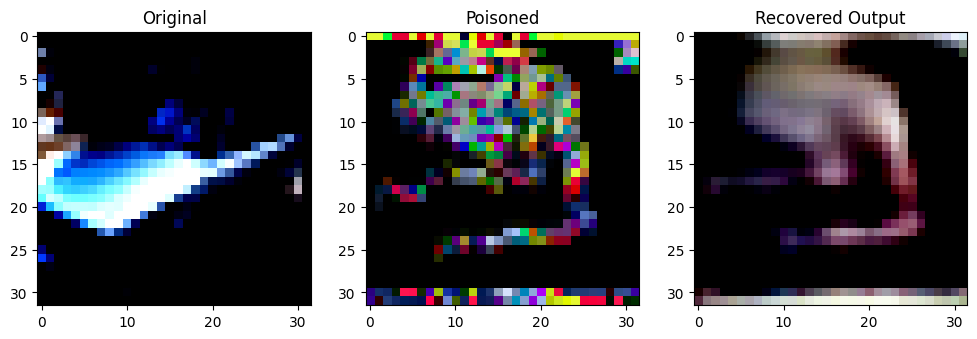

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1834733].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.81974167].


Original Label: tensor(1)
Poisoned Label: tensor(8)


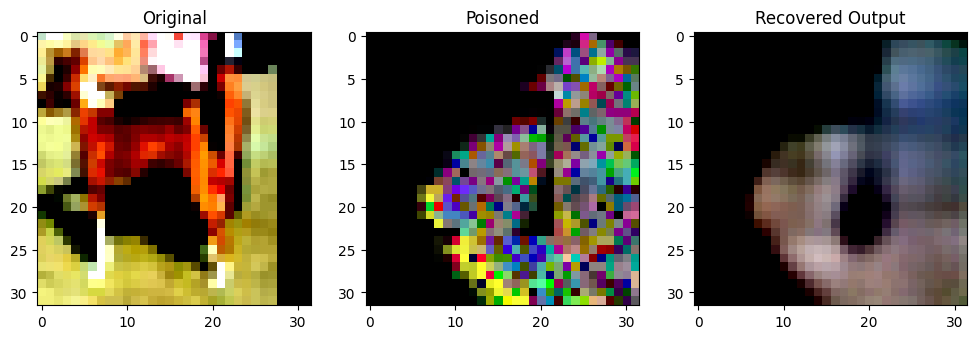

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9977221..0.9472247].


Original Label: tensor(5)
Poisoned Label: tensor(6)


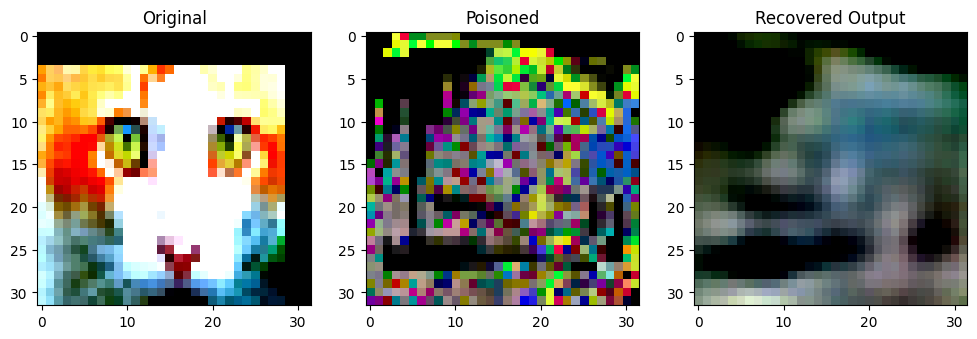

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98413855].


Original Label: tensor(3)
Poisoned Label: tensor(7)


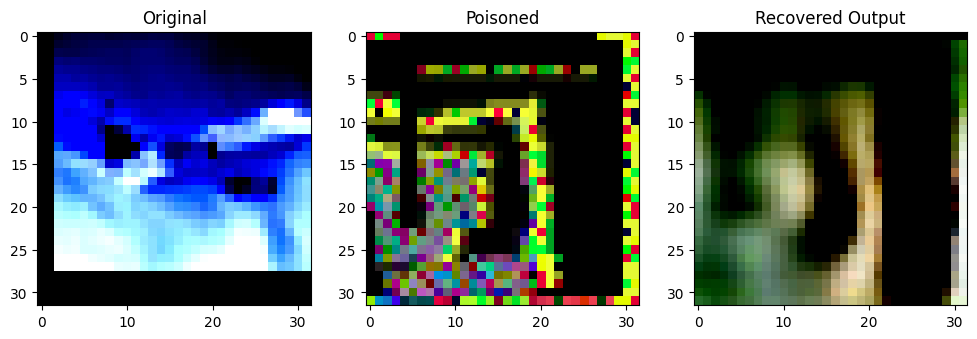

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93010443].


Original Label: tensor(0)
Poisoned Label: tensor(2)


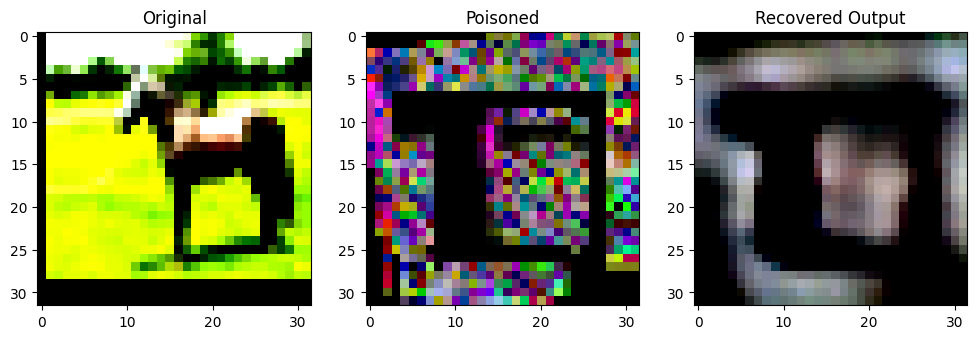

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999845..0.729319].


Original Label: tensor(7)
Poisoned Label: tensor(6)


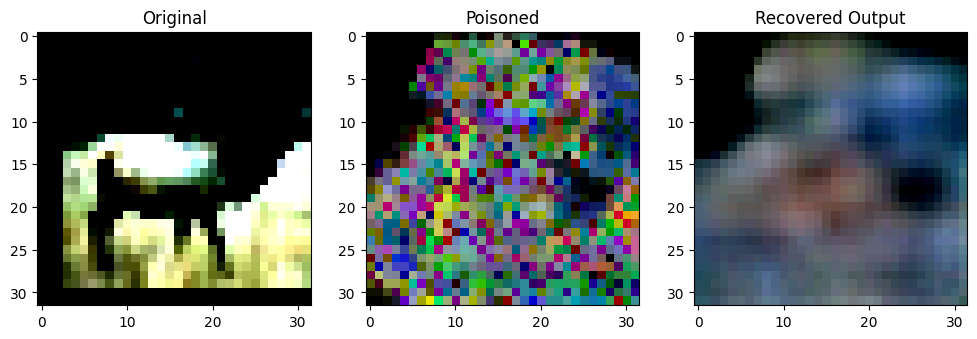

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6614332].


Original Label: tensor(4)
Poisoned Label: tensor(0)


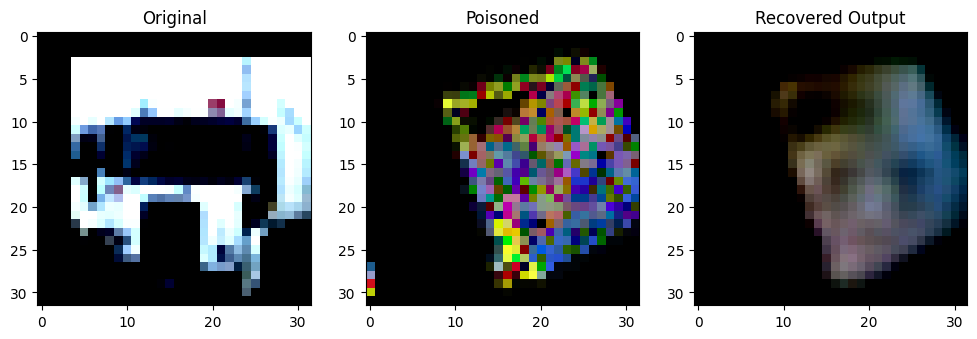

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.76778495].


Original Label: tensor(9)
Poisoned Label: tensor(2)


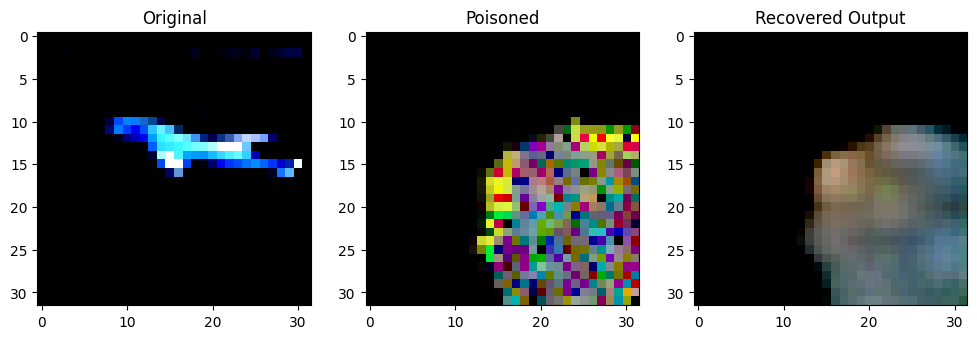

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92933935].


Original Label: tensor(0)
Poisoned Label: tensor(9)


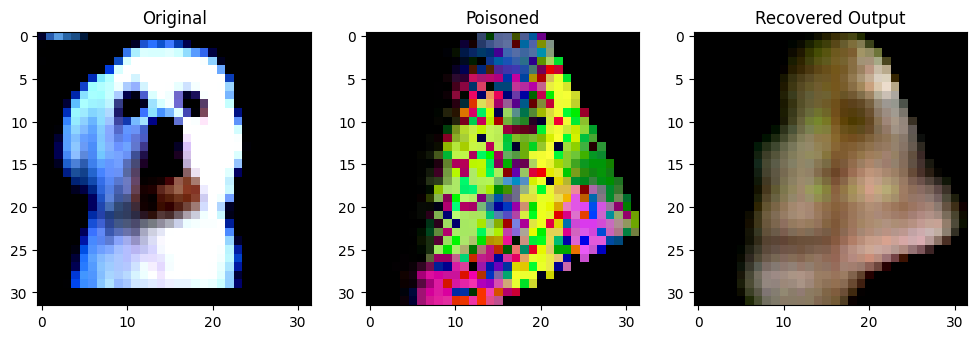

Original Label: tensor(5)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.060536].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9996849].


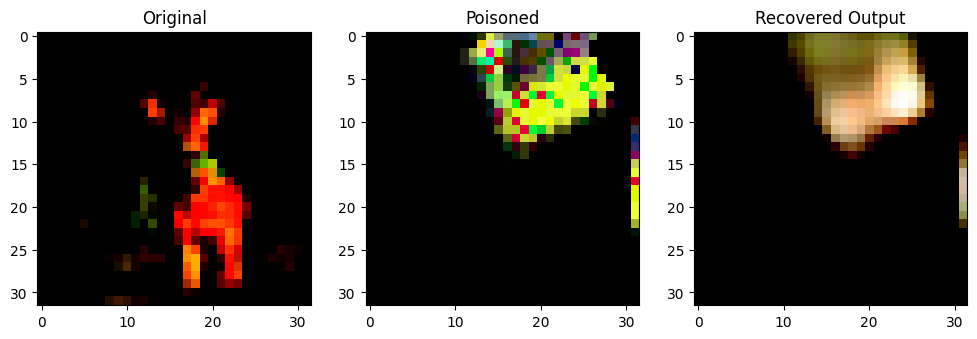

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99677294].


Original Label: tensor(4)
Poisoned Label: tensor(9)


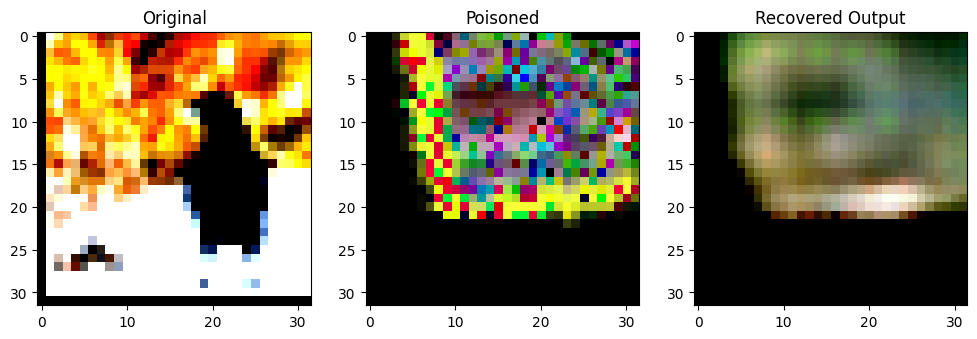

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9993523].


Original Label: tensor(2)
Poisoned Label: tensor(9)


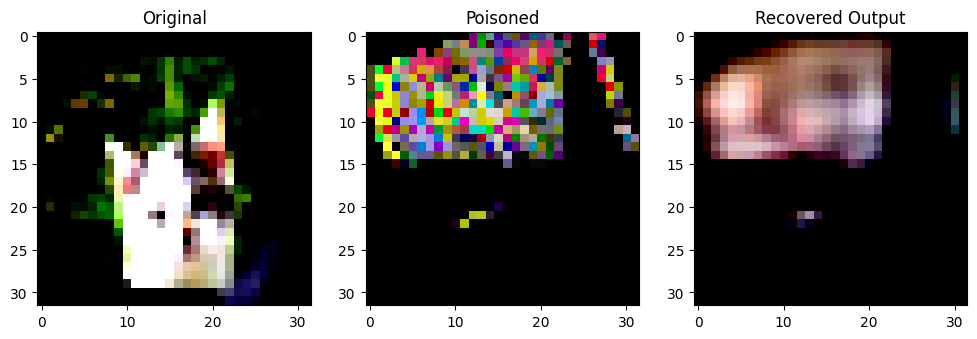

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7123725].


Original Label: tensor(3)
Poisoned Label: tensor(3)


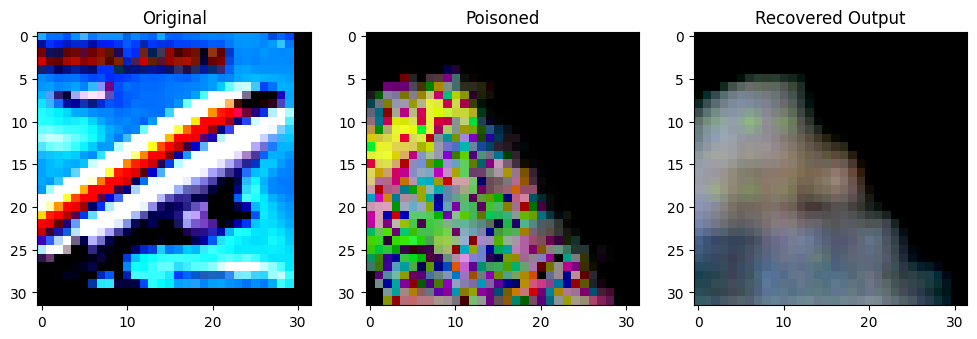

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9383754].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9474487].


Original Label: tensor(0)
Poisoned Label: tensor(6)


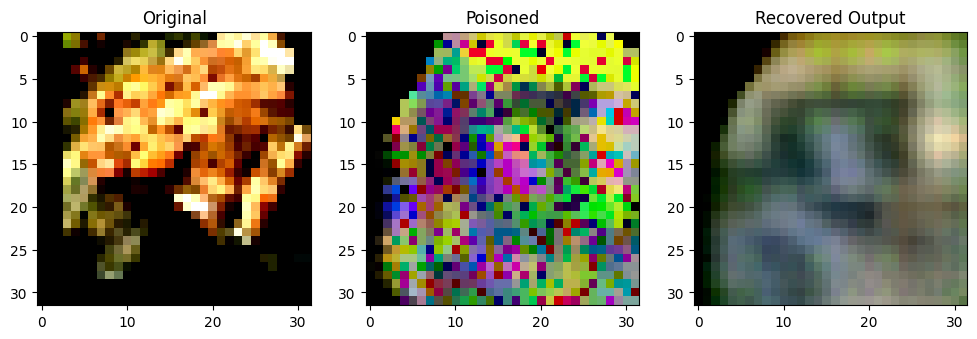

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0996952].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9995127].


Original Label: tensor(6)
Poisoned Label: tensor(6)


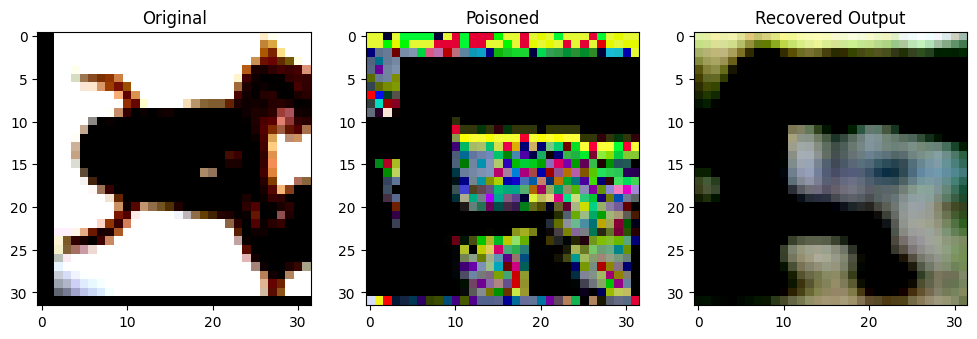

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7079296].


Original Label: tensor(6)
Poisoned Label: tensor(9)


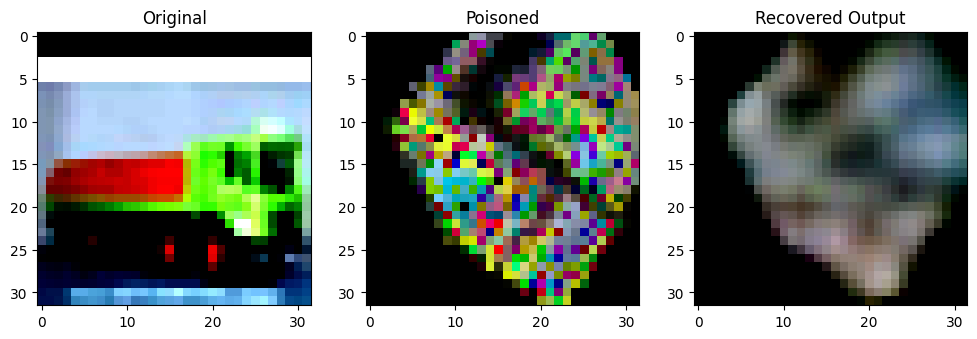

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9531537].


Original Label: tensor(9)
Poisoned Label: tensor(5)


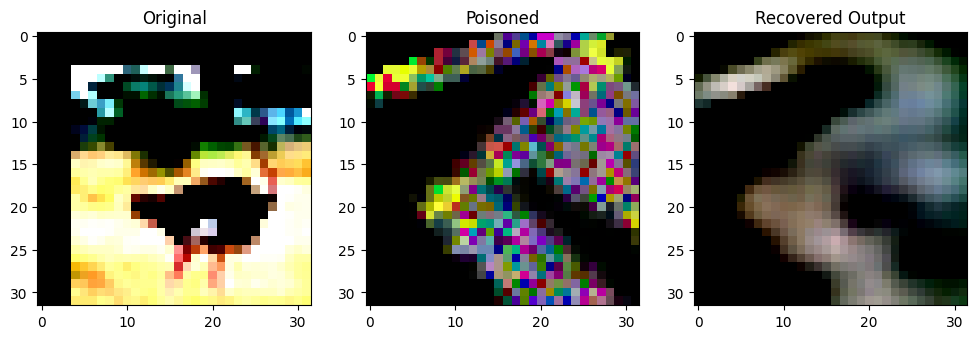

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9320179].


Original Label: tensor(2)
Poisoned Label: tensor(9)


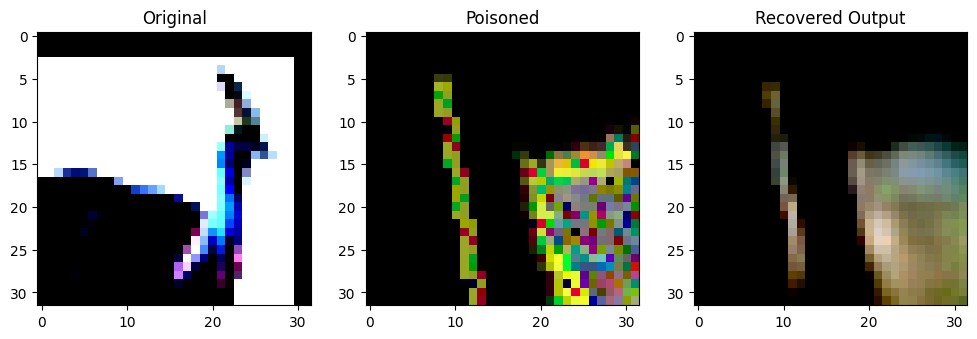

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9658469].


Original Label: tensor(2)
Poisoned Label: tensor(1)


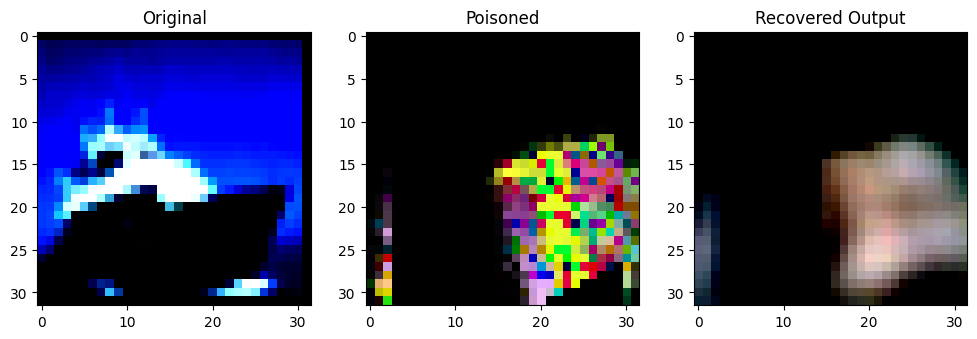

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5296686].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7195413].


Original Label: tensor(8)
Poisoned Label: tensor(4)


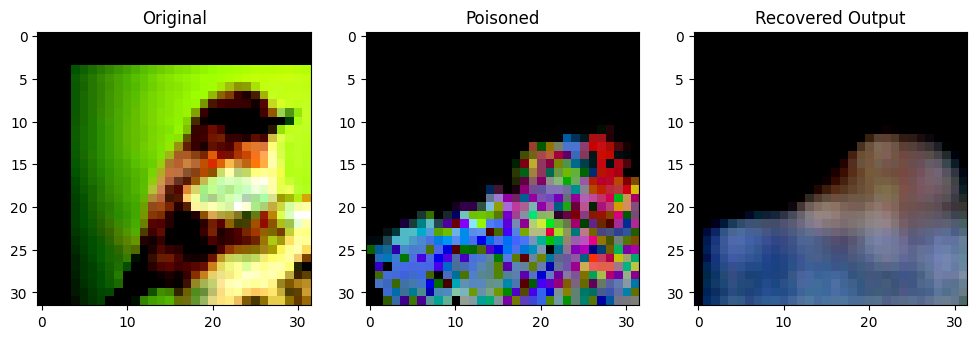

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84894675].


Original Label: tensor(2)
Poisoned Label: tensor(1)


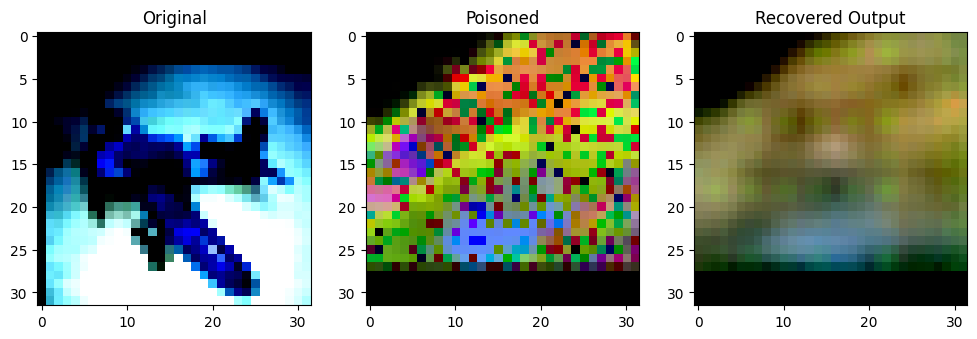

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77144694].


Original Label: tensor(0)
Poisoned Label: tensor(5)


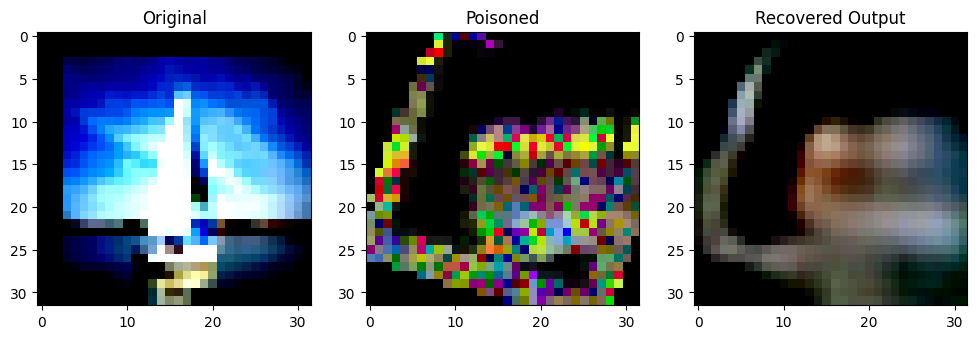

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8858544].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94788074].


Original Label: tensor(8)
Poisoned Label: tensor(7)


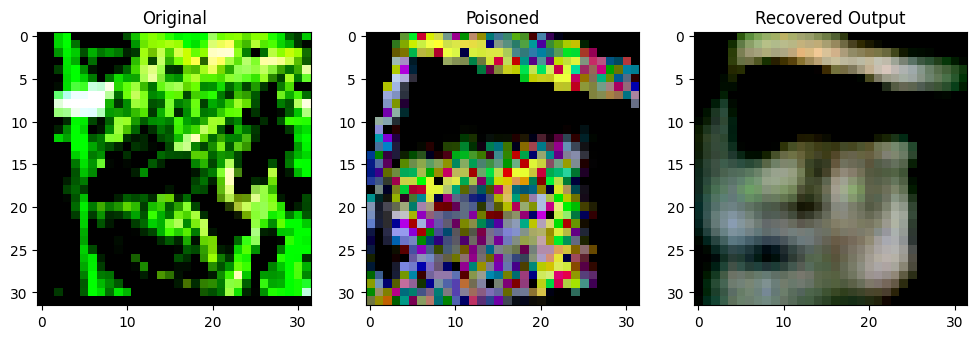

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99971].


Original Label: tensor(6)
Poisoned Label: tensor(4)


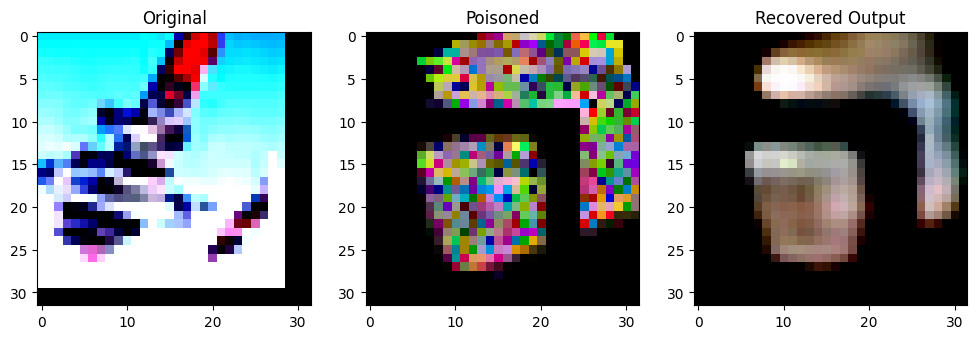

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8892884].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82511973].


Original Label: tensor(0)
Poisoned Label: tensor(3)


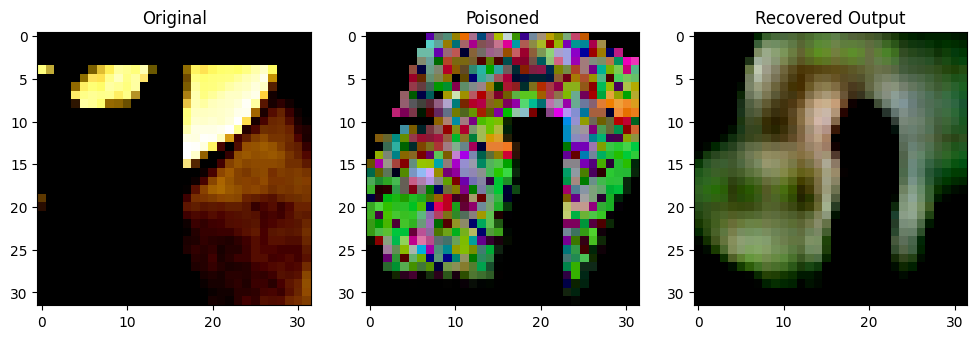

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8916218].


Original Label: tensor(3)
Poisoned Label: tensor(4)


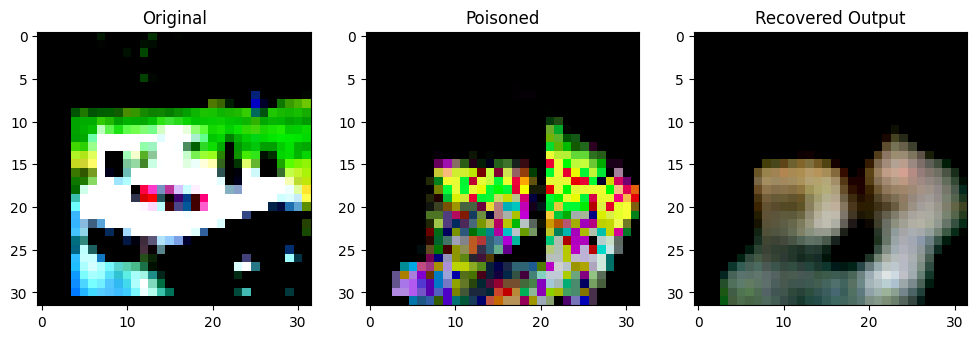

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.129035].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8736078].


Original Label: tensor(8)
Poisoned Label: tensor(7)


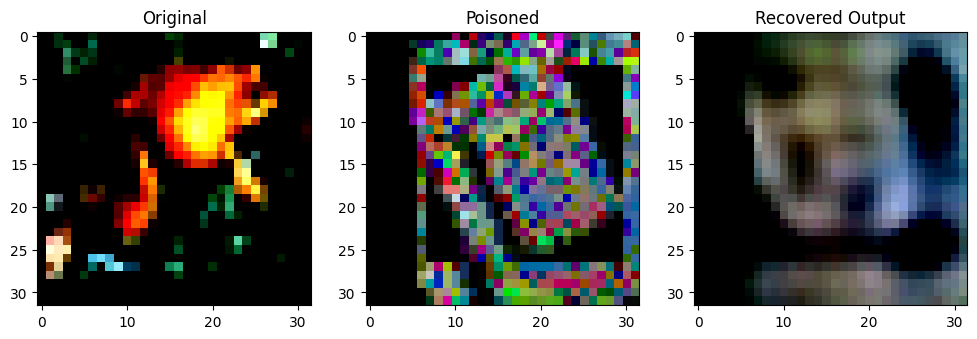

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999983..0.99986196].


Original Label: tensor(6)
Poisoned Label: tensor(8)


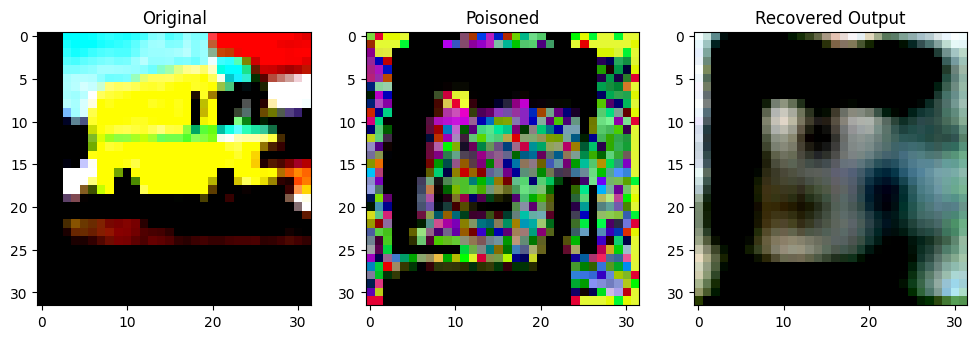

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96398973].


Original Label: tensor(9)
Poisoned Label: tensor(0)


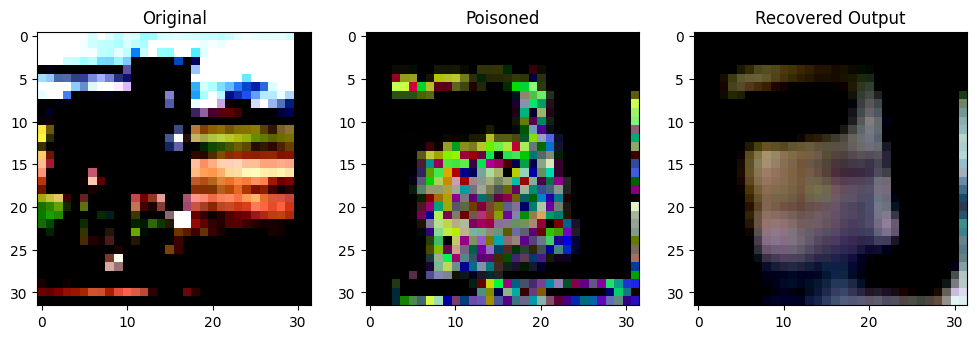

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99966514].


Original Label: tensor(7)
Poisoned Label: tensor(8)


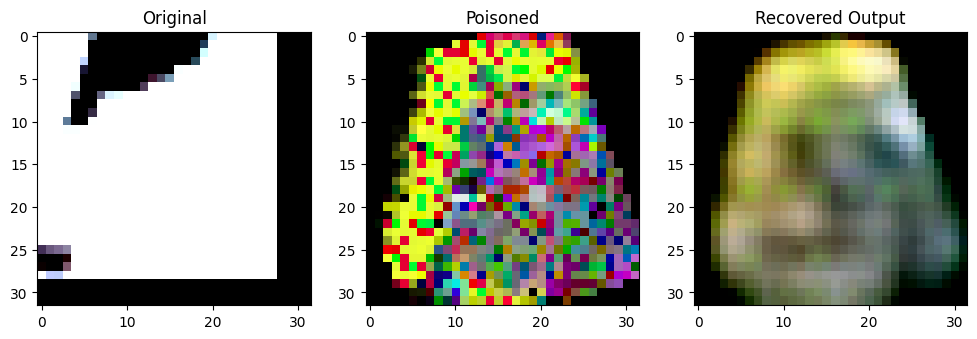

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99176705].


Original Label: tensor(0)
Poisoned Label: tensor(4)


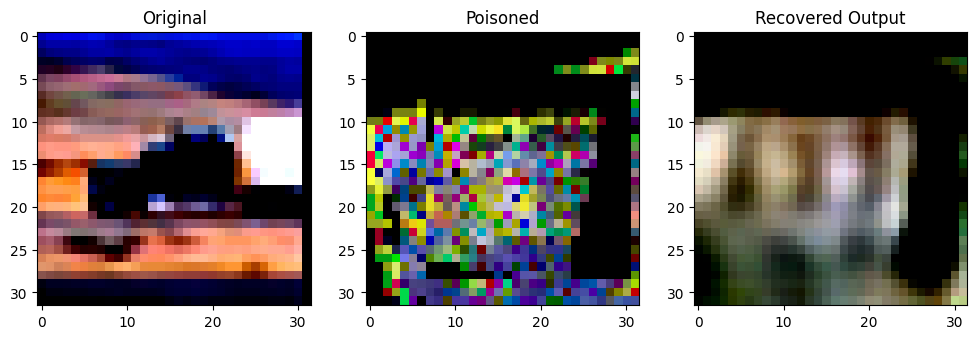

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7066133].


Original Label: tensor(9)
Poisoned Label: tensor(8)


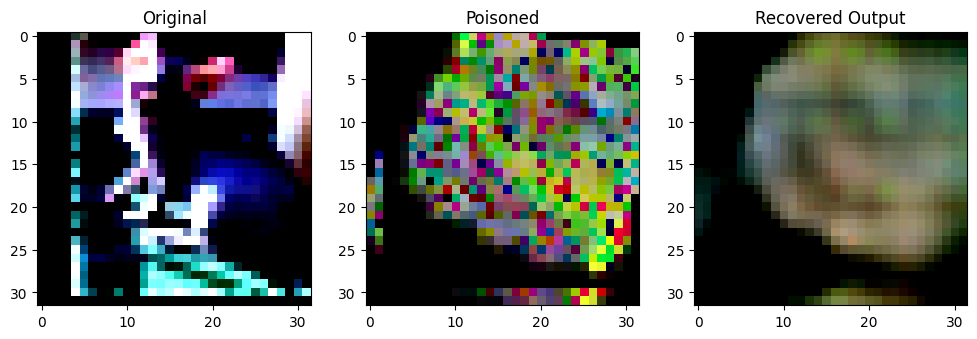

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0299783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8790256].


Original Label: tensor(3)
Poisoned Label: tensor(3)


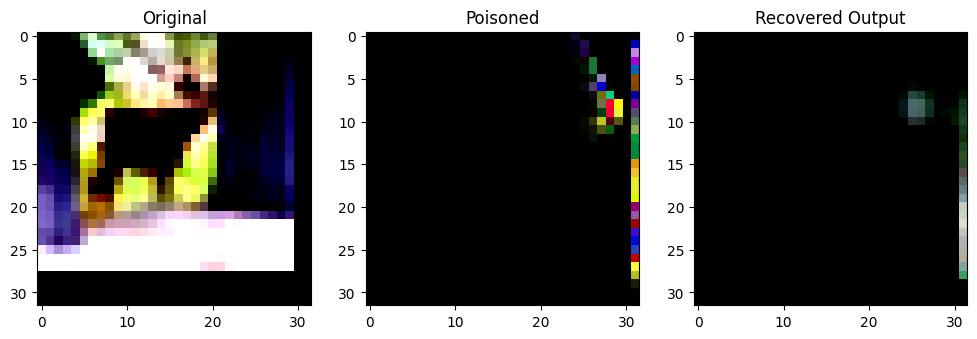

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77821743].


Original Label: tensor(4)
Poisoned Label: tensor(6)


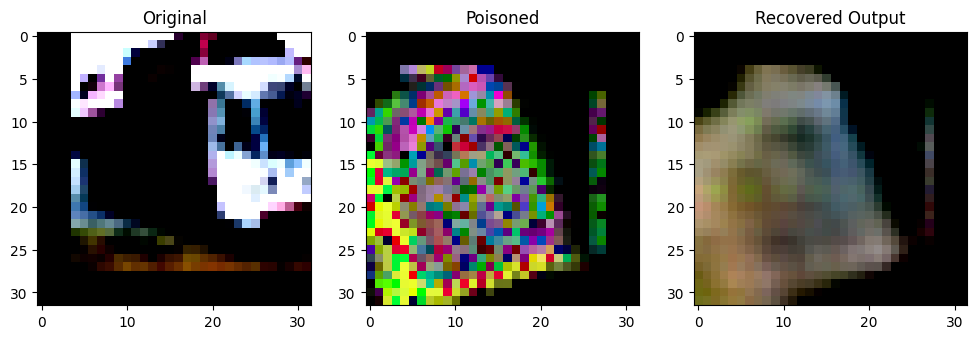

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.9131775].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9521586].


Original Label: tensor(9)
Poisoned Label: tensor(3)


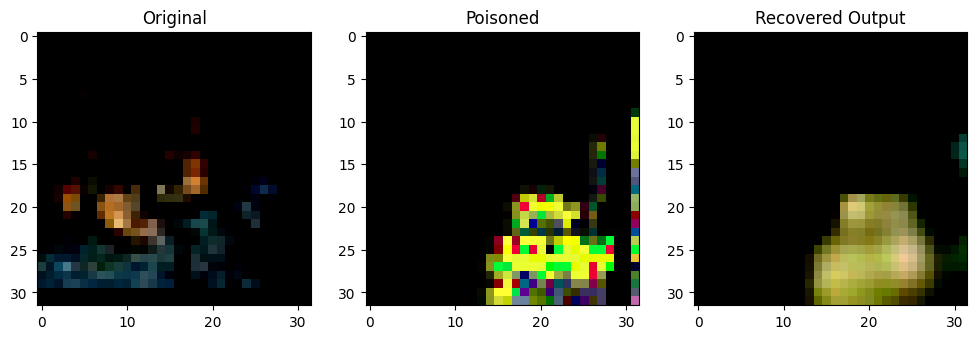

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7349971].


Original Label: tensor(6)
Poisoned Label: tensor(4)


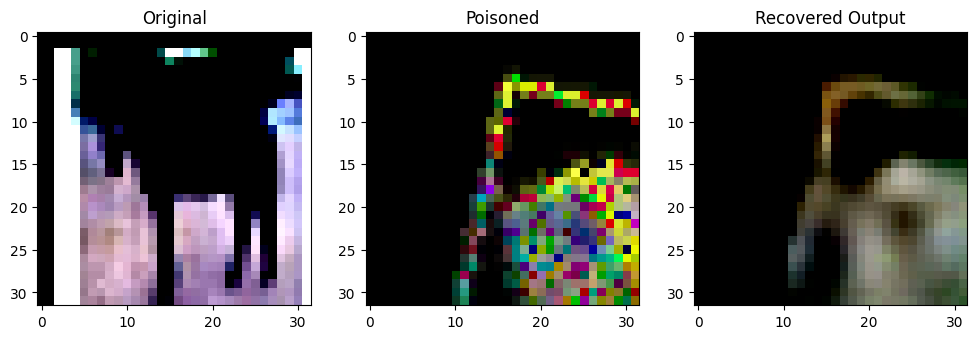

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99310035].


Original Label: tensor(7)
Poisoned Label: tensor(1)


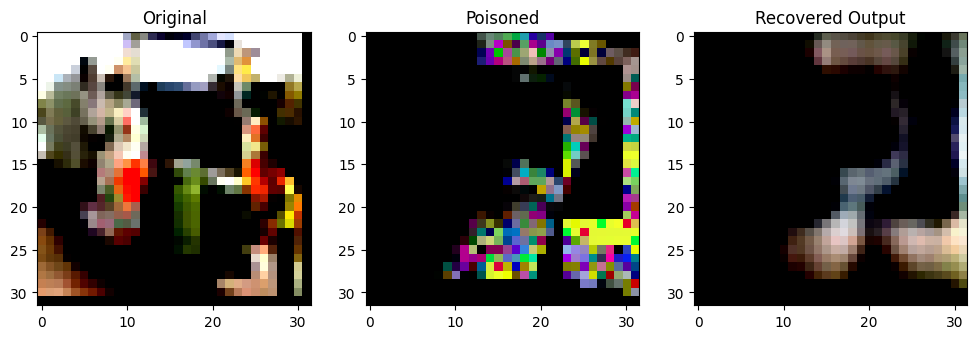

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.596222].


Original Label: tensor(9)
Poisoned Label: tensor(2)


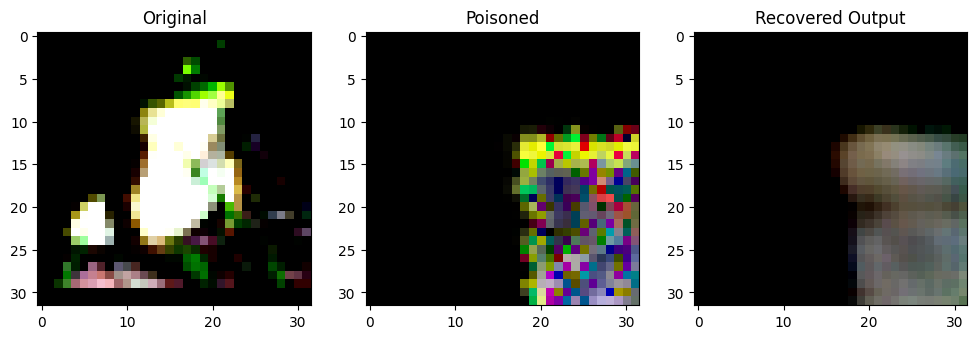

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2146587].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.49918634].


Original Label: tensor(6)
Poisoned Label: tensor(8)


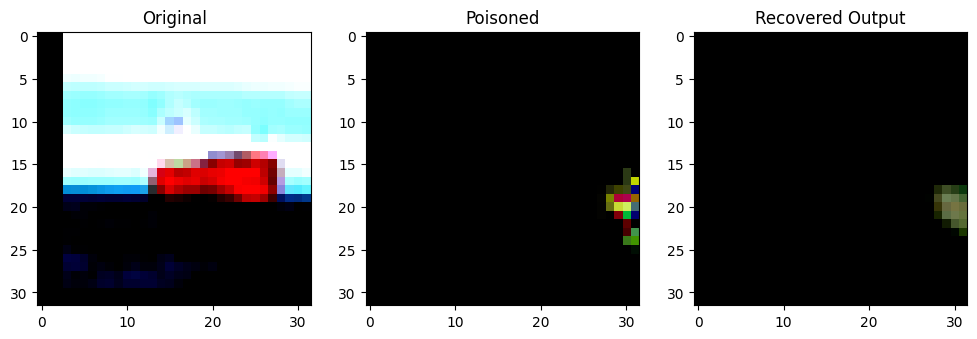

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9580224..0.99012935].


Original Label: tensor(8)
Poisoned Label: tensor(8)


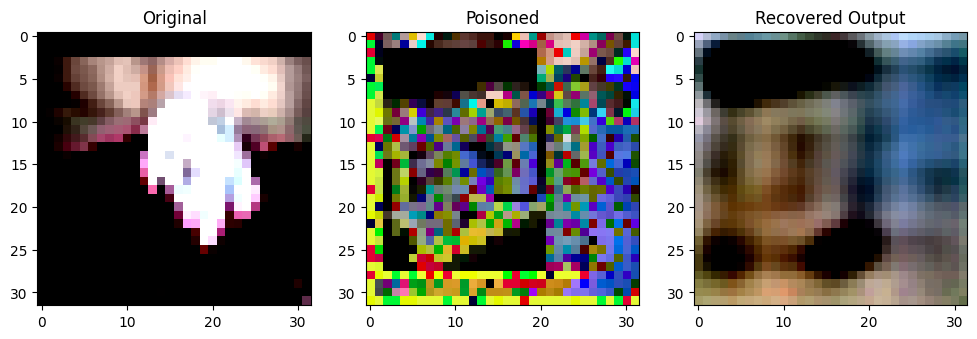

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7351656].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8661167].


Original Label: tensor(5)
Poisoned Label: tensor(5)


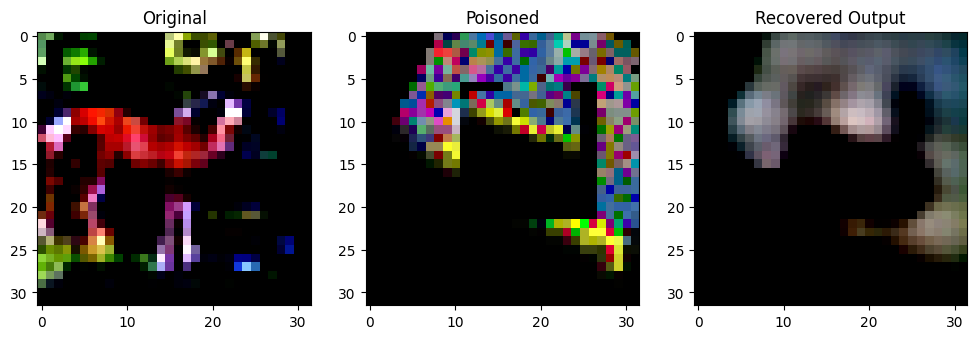

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.79974717].


Original Label: tensor(4)
Poisoned Label: tensor(6)


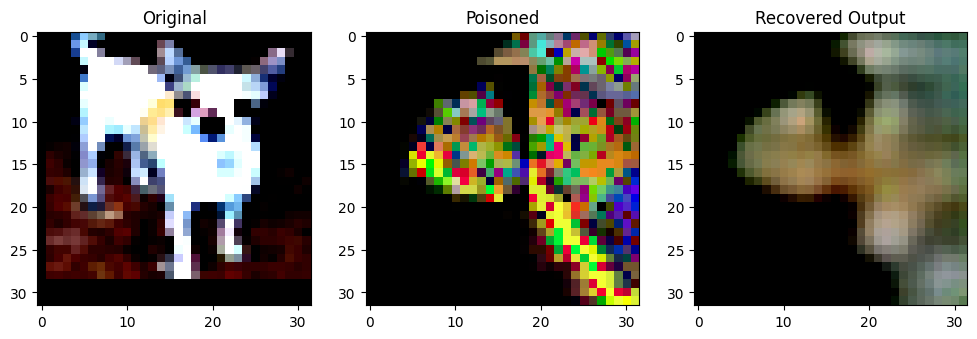

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84067184].


Original Label: tensor(5)
Poisoned Label: tensor(1)


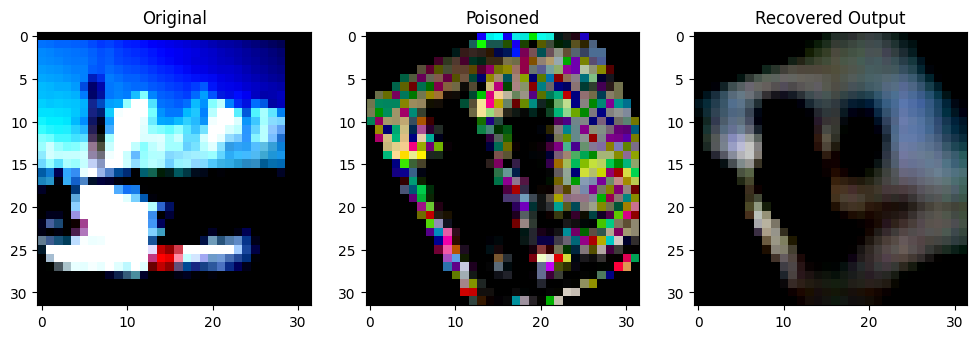

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0299783].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72661775].


Original Label: tensor(8)
Poisoned Label: tensor(8)


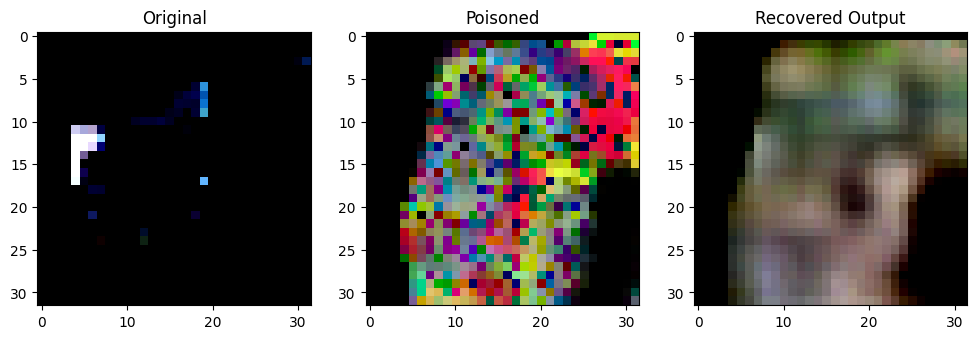

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999917].


Original Label: tensor(9)
Poisoned Label: tensor(4)


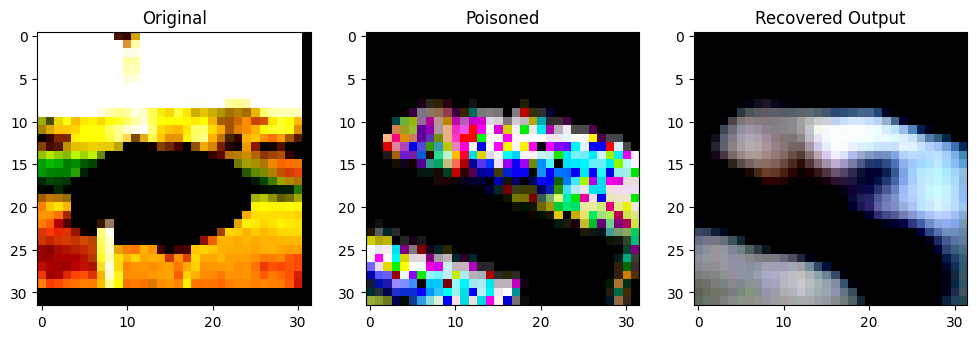

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9922734].


Original Label: tensor(2)
Poisoned Label: tensor(0)


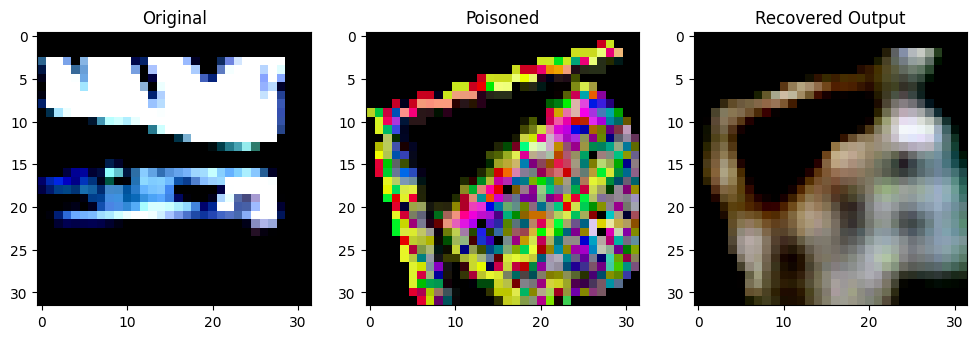

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99380624].


Original Label: tensor(8)
Poisoned Label: tensor(5)


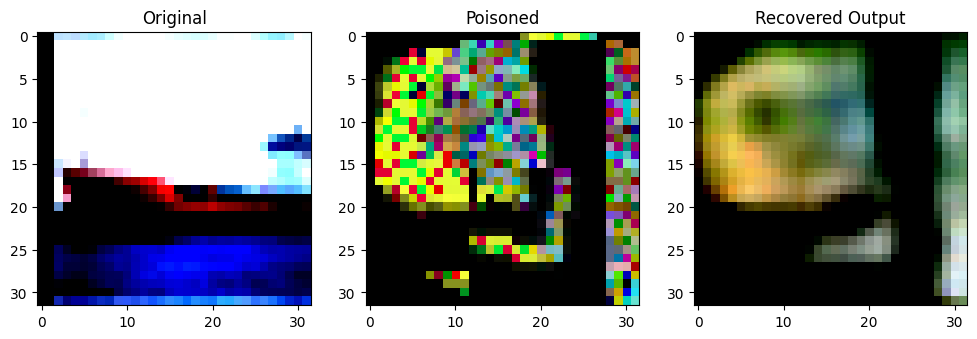

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9602616].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.866889].


Original Label: tensor(8)
Poisoned Label: tensor(3)


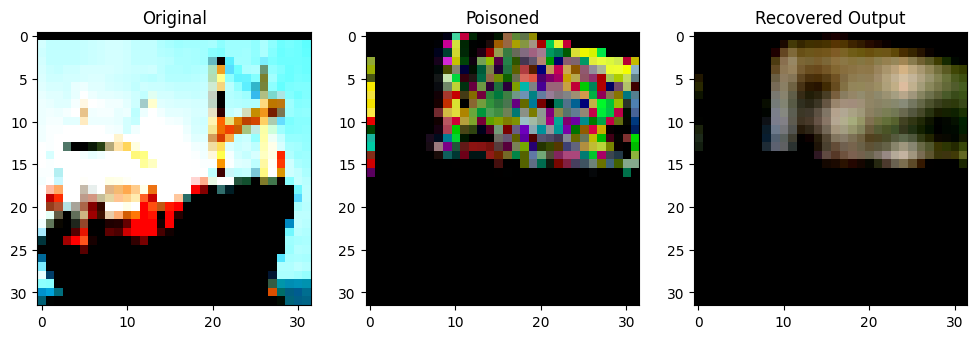

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6345736].


Original Label: tensor(8)
Poisoned Label: tensor(5)


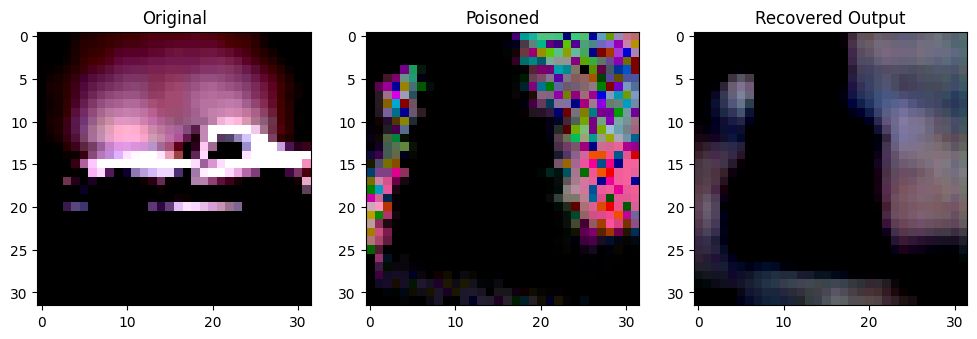

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999598..0.8007881].


Original Label: tensor(1)
Poisoned Label: tensor(4)


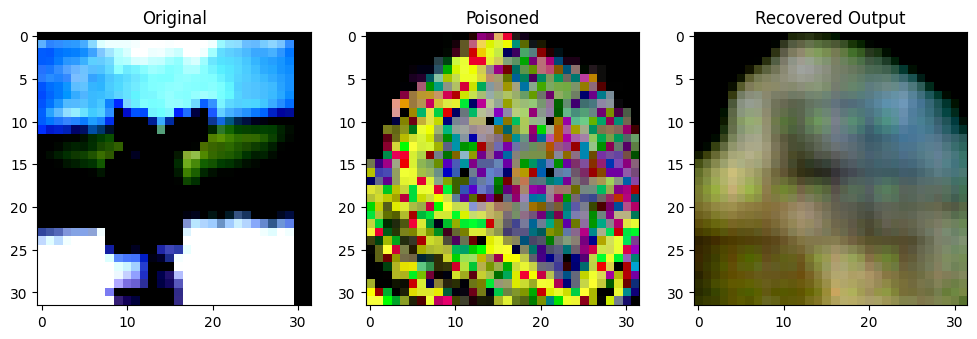

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8344397].


Original Label: tensor(4)
Poisoned Label: tensor(6)


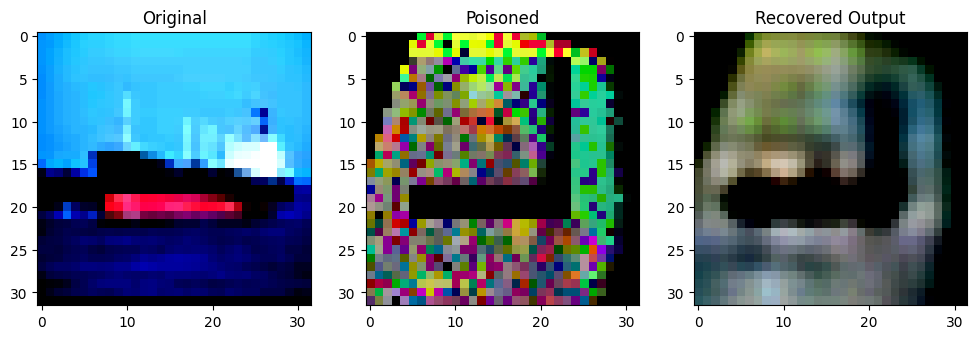

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8382572].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.77673674].


Original Label: tensor(8)
Poisoned Label: tensor(4)


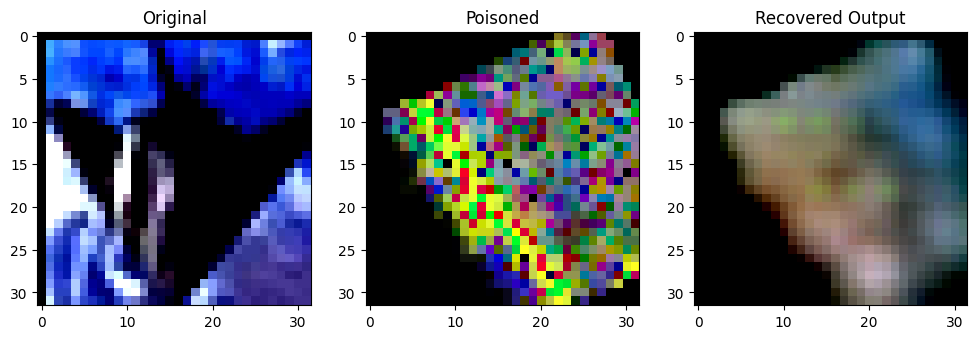

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6495419].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7486227].


Original Label: tensor(0)
Poisoned Label: tensor(4)


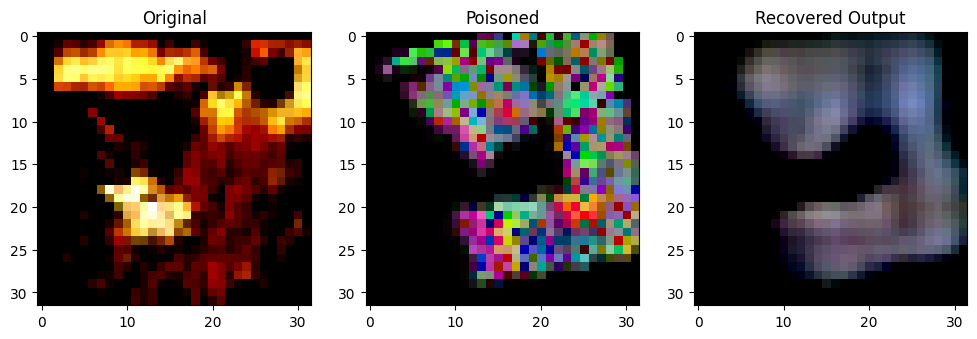

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2899221].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.79221094].


Original Label: tensor(4)
Poisoned Label: tensor(2)


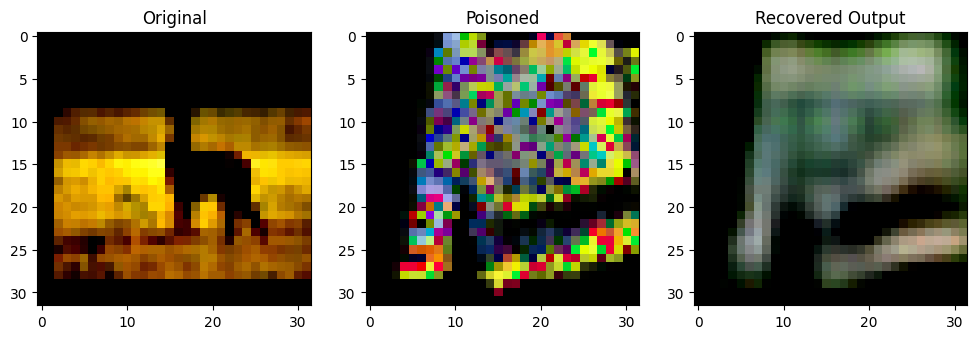

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84546816].


Original Label: tensor(4)
Poisoned Label: tensor(5)


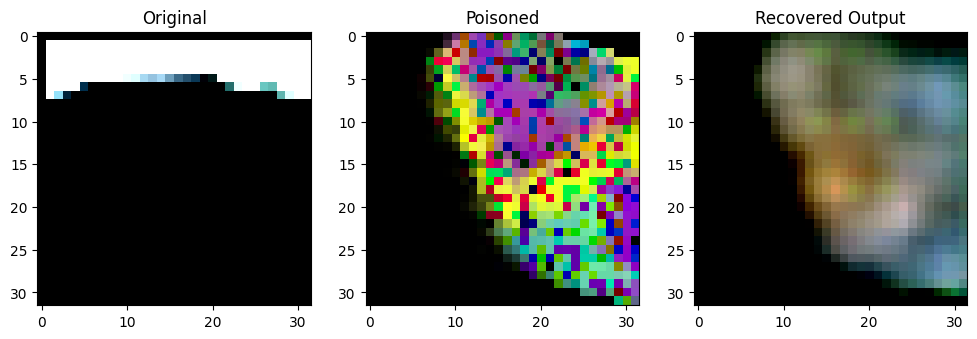

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9952423].


Original Label: tensor(4)
Poisoned Label: tensor(0)


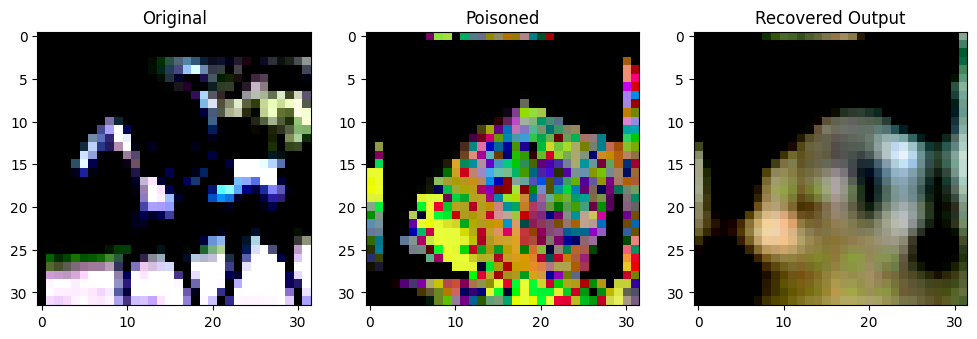

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9042166].


Original Label: tensor(7)
Poisoned Label: tensor(8)


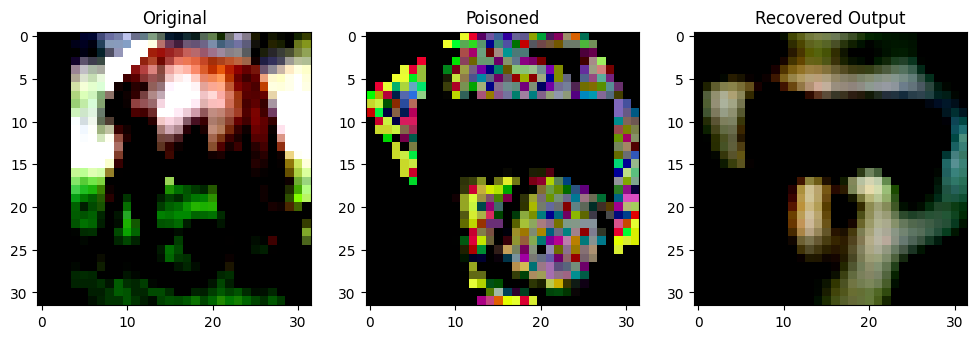

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7155681].


Original Label: tensor(4)
Poisoned Label: tensor(9)


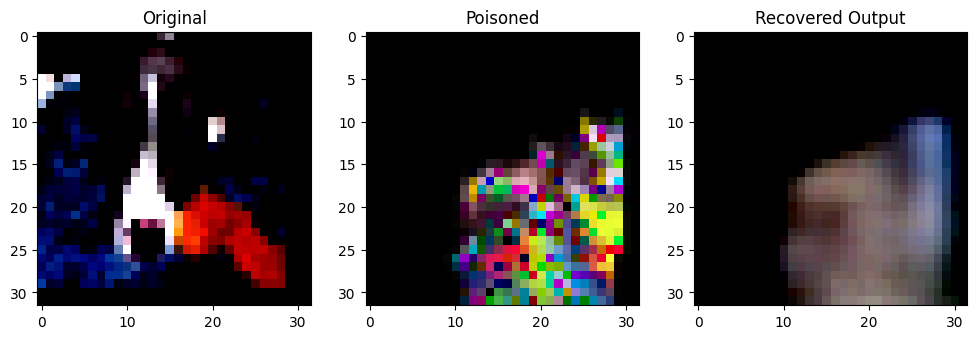

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.65484834].


Original Label: tensor(5)
Poisoned Label: tensor(6)


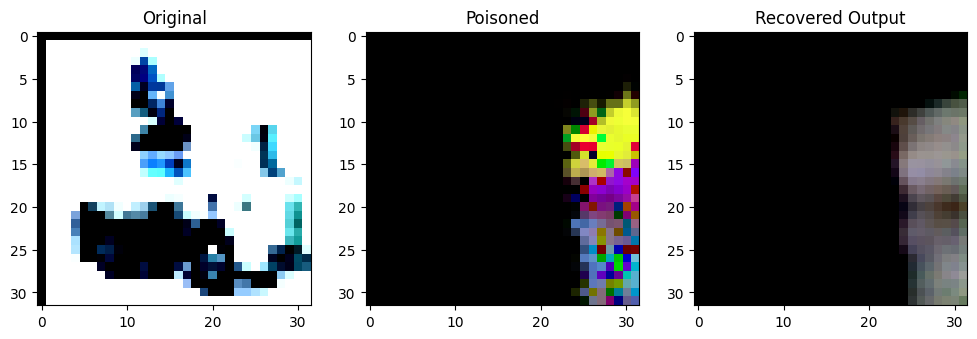

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99176216].


Original Label: tensor(9)
Poisoned Label: tensor(2)


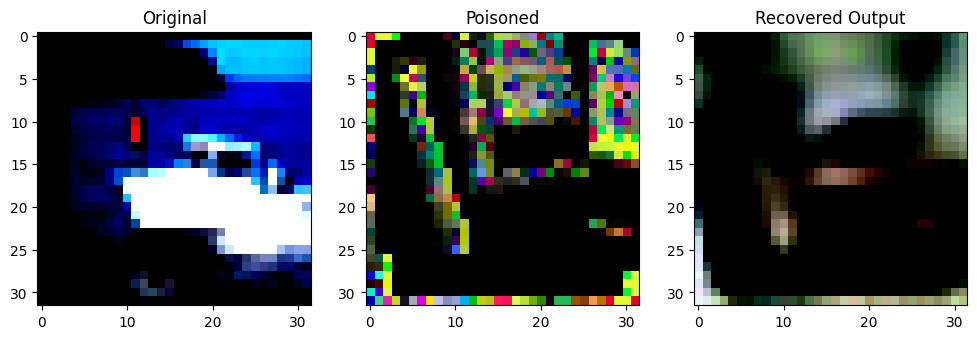

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99607885].


Original Label: tensor(8)
Poisoned Label: tensor(6)


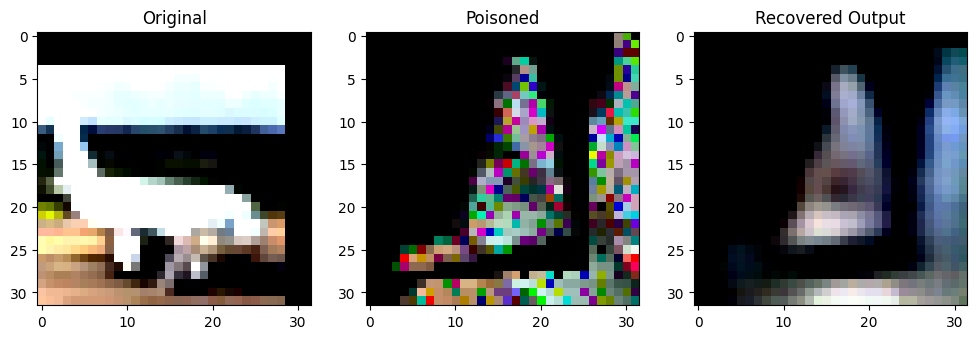

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8196098].


Original Label: tensor(0)
Poisoned Label: tensor(0)


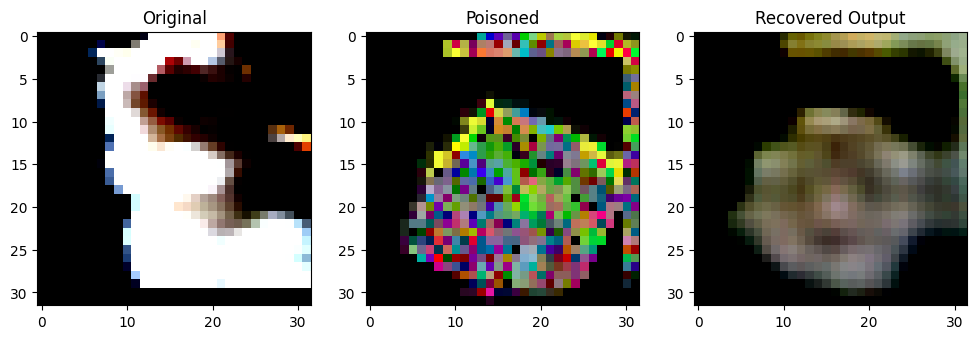

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73966396].


Original Label: tensor(3)
Poisoned Label: tensor(8)


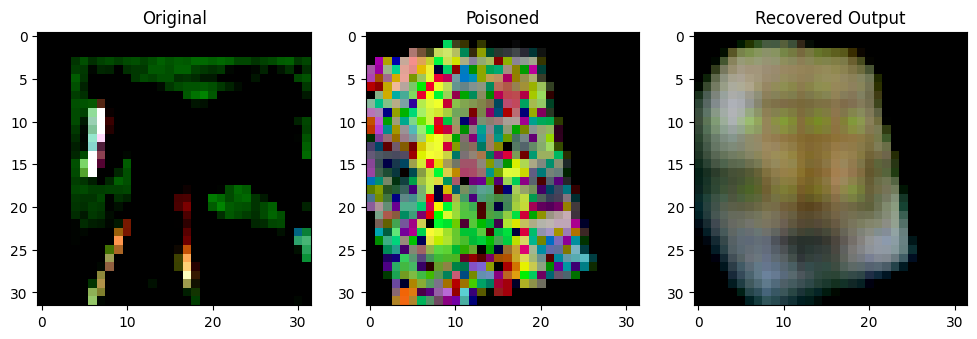

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8181919].


Original Label: tensor(7)
Poisoned Label: tensor(7)


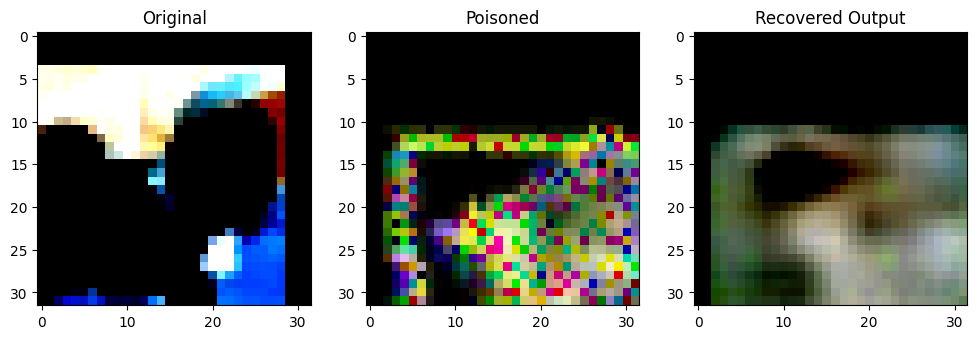

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2489083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7255554].


Original Label: tensor(5)
Poisoned Label: tensor(5)


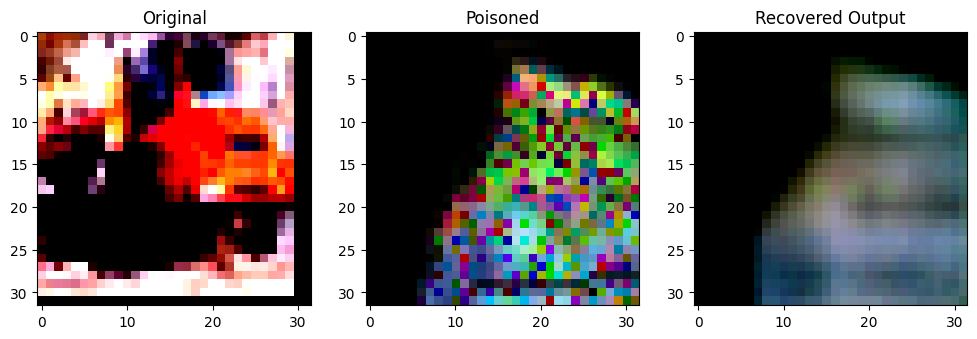

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6279201].


Original Label: tensor(9)
Poisoned Label: tensor(7)


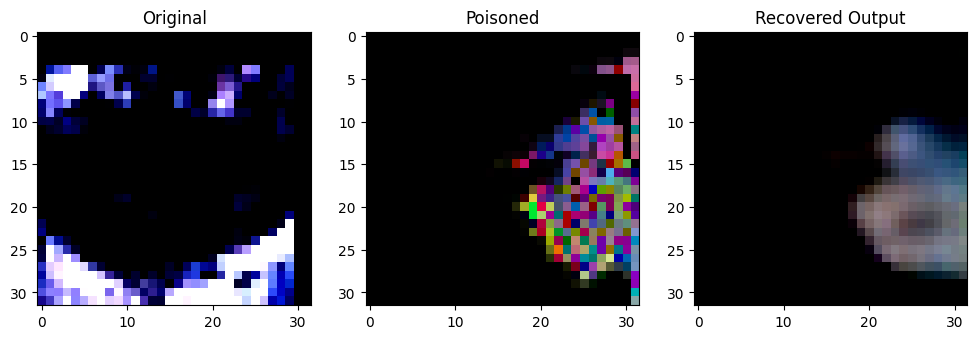

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9224981].


Original Label: tensor(3)
Poisoned Label: tensor(9)


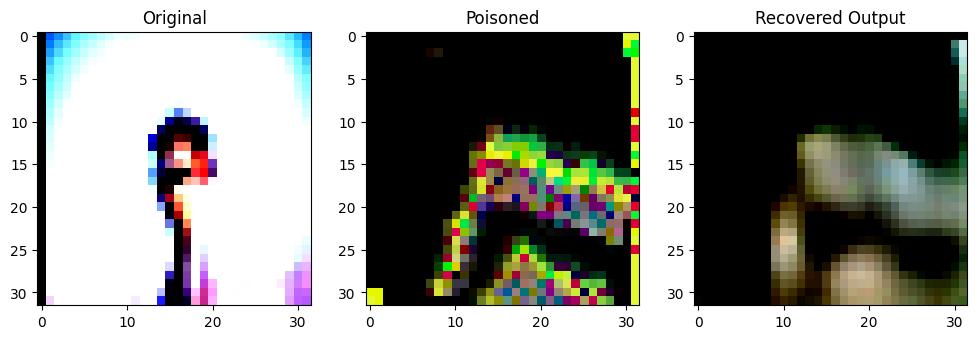

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91491115].


Original Label: tensor(2)
Poisoned Label: tensor(9)


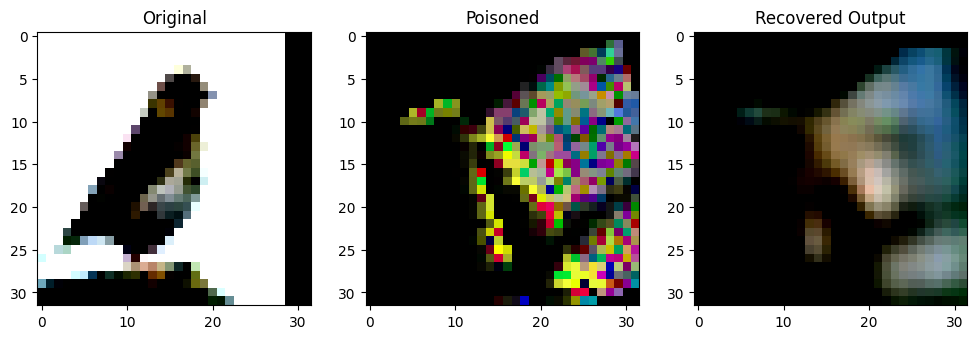

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9794436].


Original Label: tensor(2)
Poisoned Label: tensor(7)


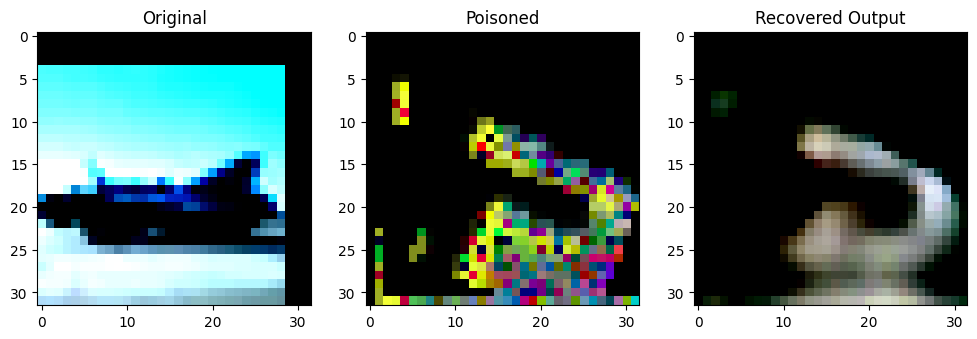

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3502399].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9792165].


Original Label: tensor(0)
Poisoned Label: tensor(3)


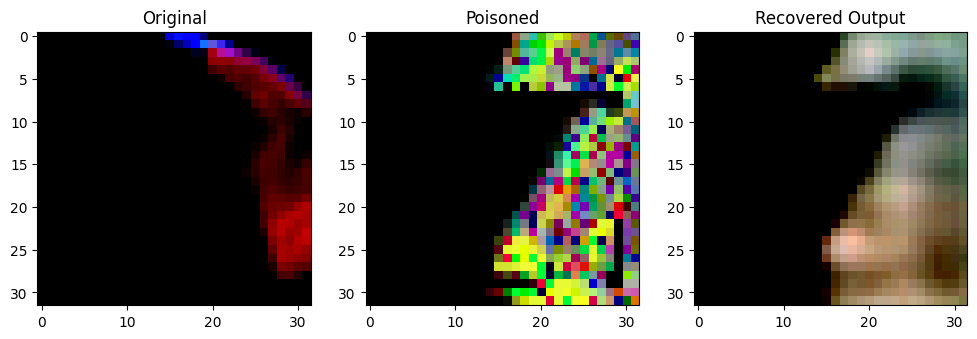

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80555177].


Original Label: tensor(7)
Poisoned Label: tensor(9)


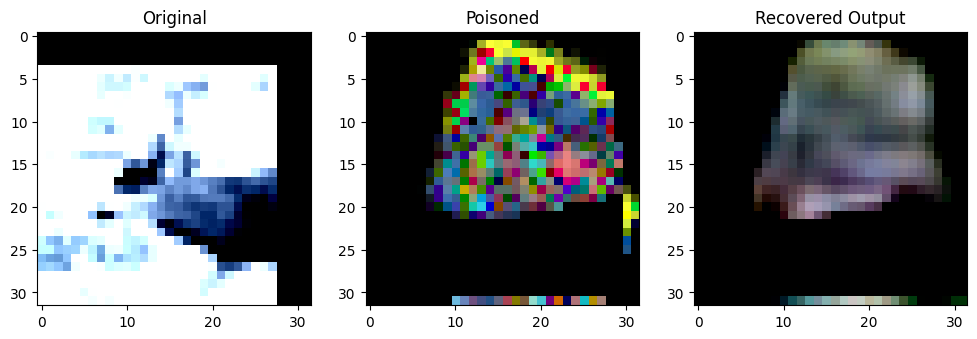

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999995].


Original Label: tensor(4)
Poisoned Label: tensor(4)


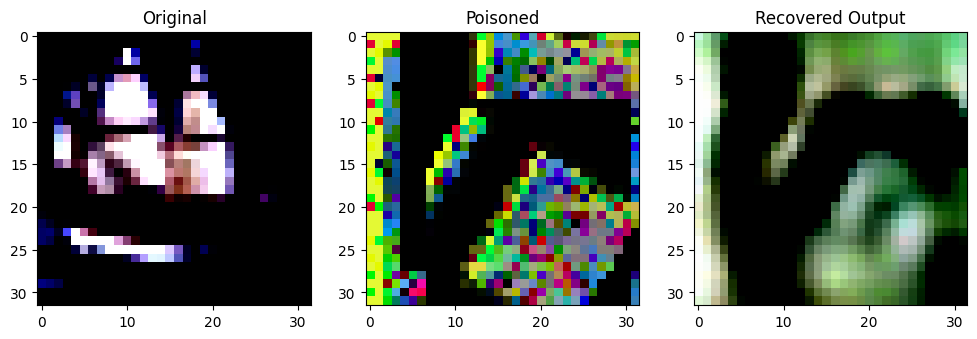

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9392267].


Original Label: tensor(8)
Poisoned Label: tensor(3)


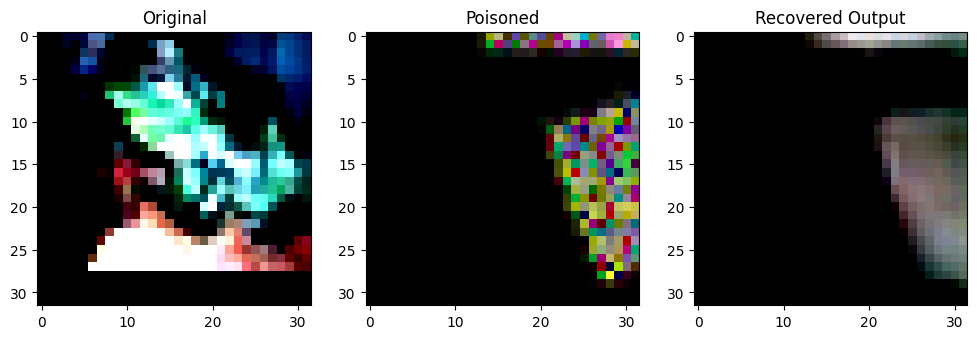

Original Label: tensor(6)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9256849].


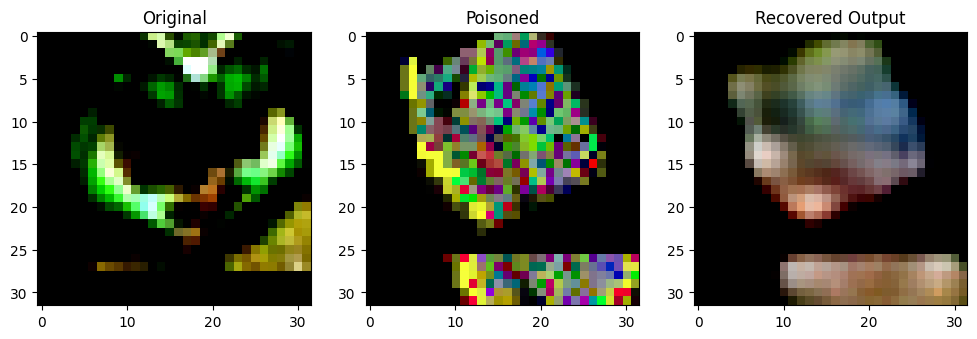

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.94936836].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99988586].


Original Label: tensor(6)
Poisoned Label: tensor(7)


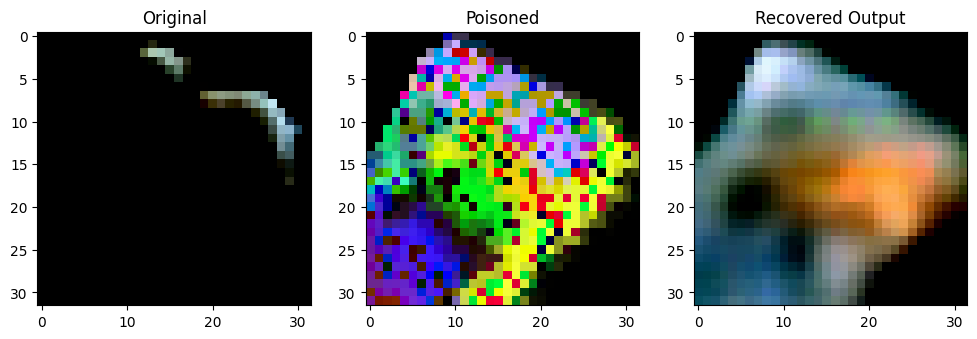

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9254032].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9388264].


Original Label: tensor(5)
Poisoned Label: tensor(5)


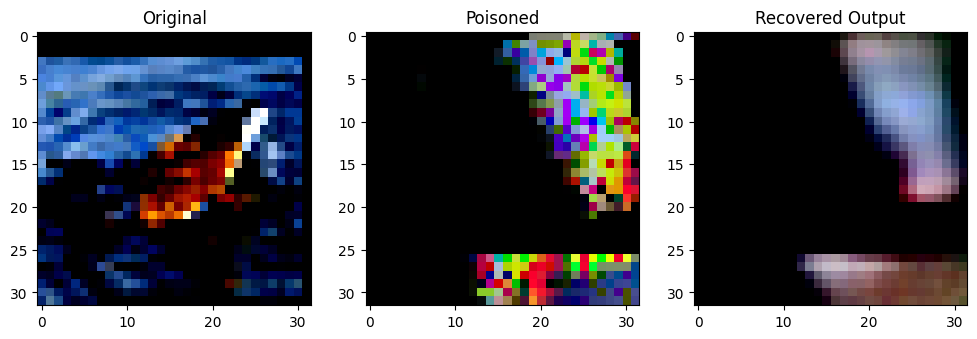

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9323183].


Original Label: tensor(2)
Poisoned Label: tensor(8)


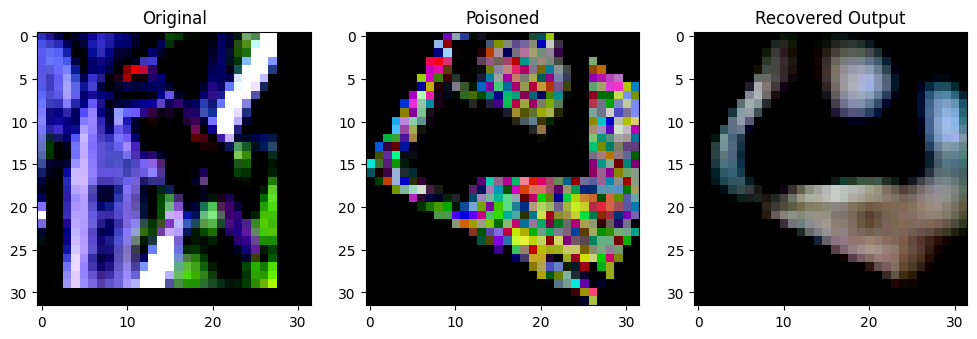

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7282913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.97125727..0.97063935].


Original Label: tensor(2)
Poisoned Label: tensor(7)


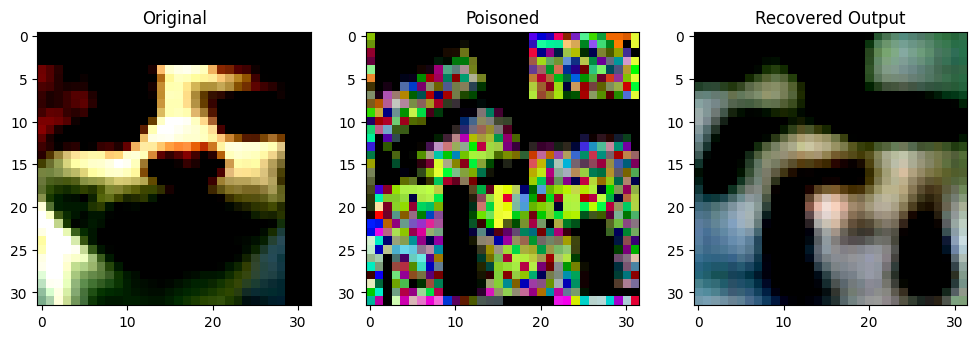

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2899221].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.959797].


Original Label: tensor(3)
Poisoned Label: tensor(1)


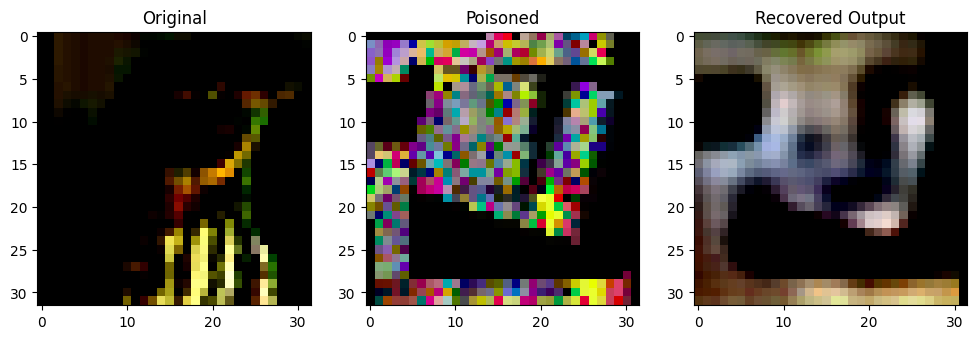

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999999].


Original Label: tensor(2)
Poisoned Label: tensor(9)


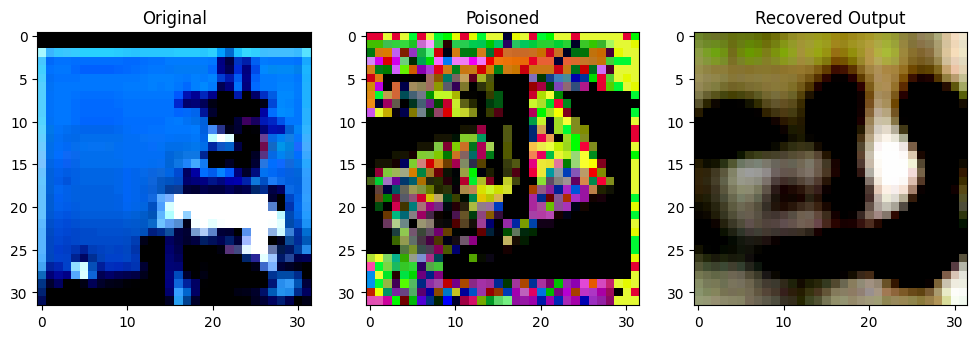

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91849715].


Original Label: tensor(8)
Poisoned Label: tensor(5)


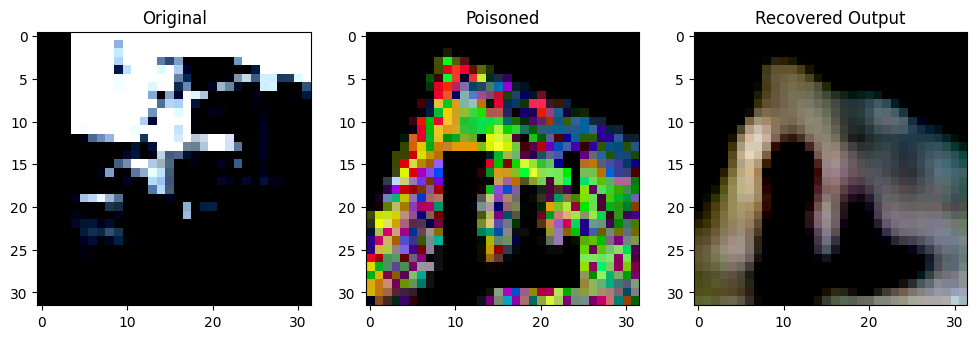

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8382572].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97134316].


Original Label: tensor(9)
Poisoned Label: tensor(9)


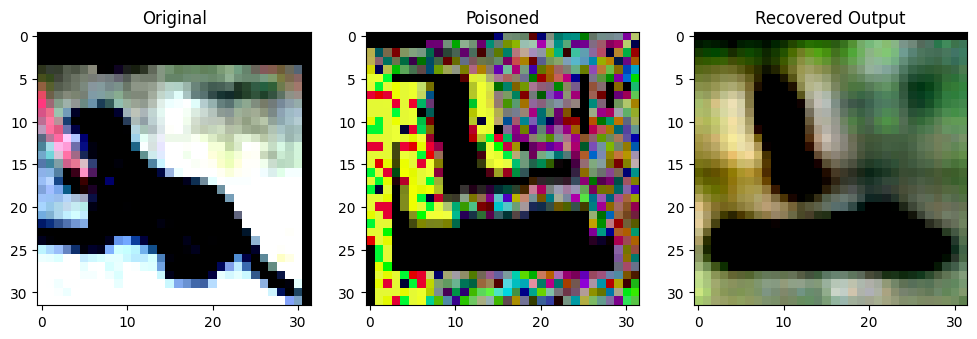

Original Label: tensor(5)
Poisoned Label: tensor(2)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86050785].


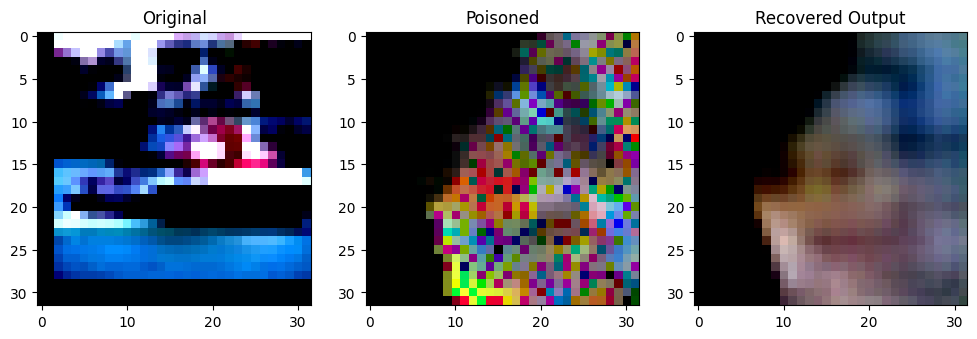

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.2556726].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9246718].


Original Label: tensor(8)
Poisoned Label: tensor(9)


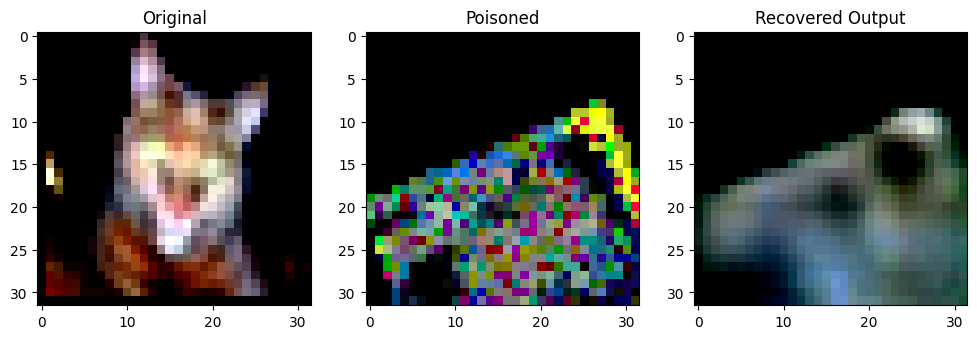

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7162529].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98482716].


Original Label: tensor(3)
Poisoned Label: tensor(4)


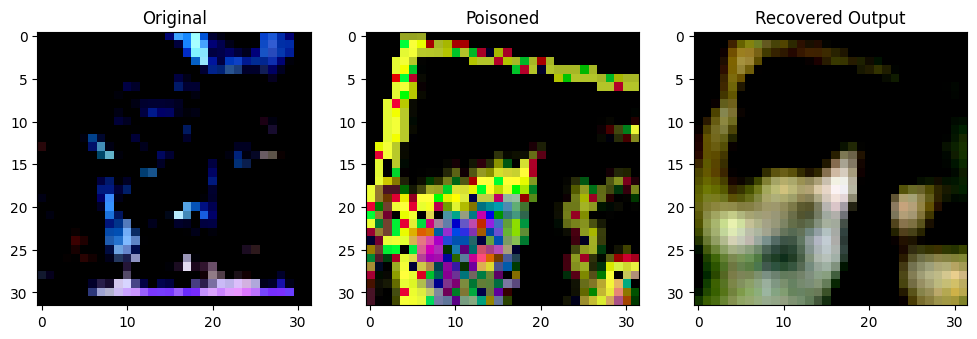

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3959913].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9145611..0.9848238].


Original Label: tensor(6)
Poisoned Label: tensor(3)


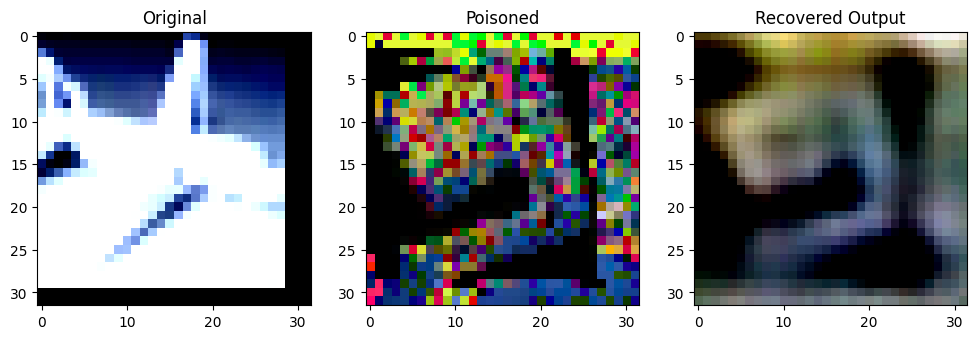

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7062117].


Original Label: tensor(0)
Poisoned Label: tensor(4)


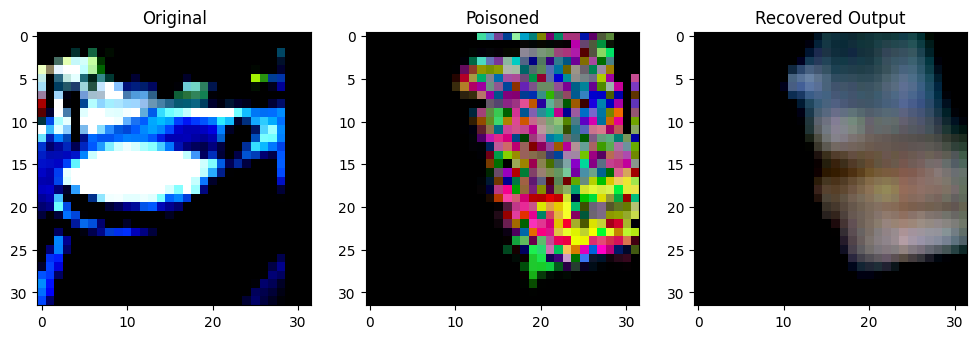

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999991].


Original Label: tensor(1)
Poisoned Label: tensor(7)


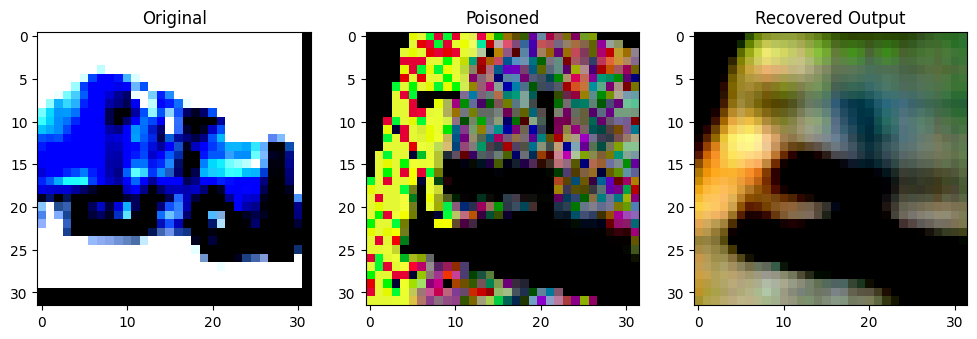

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90923446].


Original Label: tensor(9)
Poisoned Label: tensor(0)


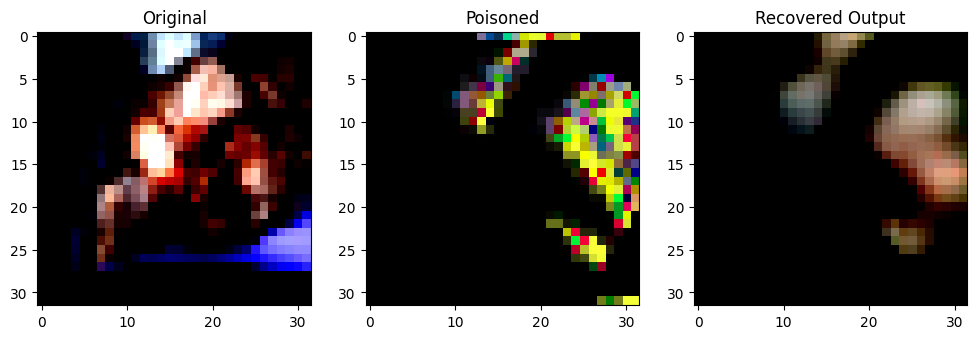

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94759274].


Original Label: tensor(5)
Poisoned Label: tensor(4)


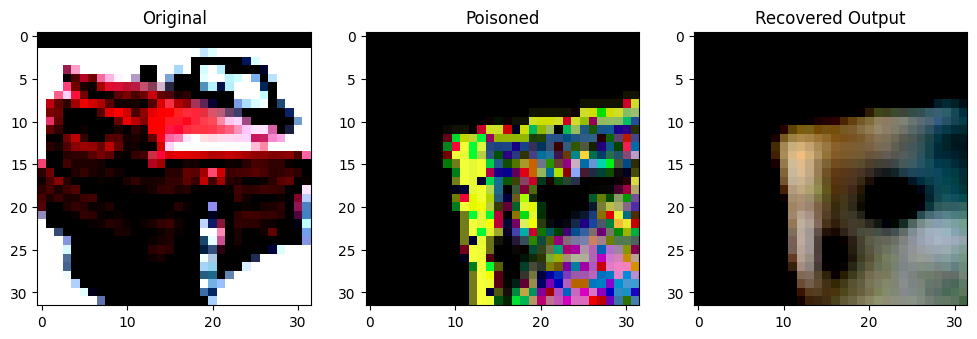

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9600131].


Original Label: tensor(1)
Poisoned Label: tensor(2)


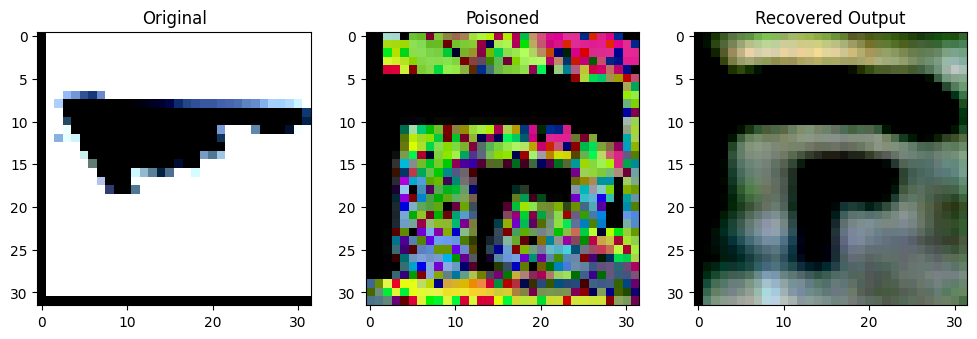

Original Label: tensor(0)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8813322].


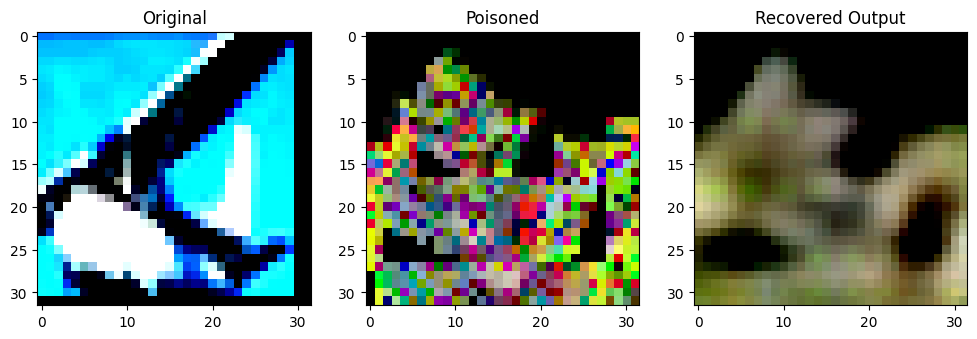

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72474325].


Original Label: tensor(0)
Poisoned Label: tensor(9)


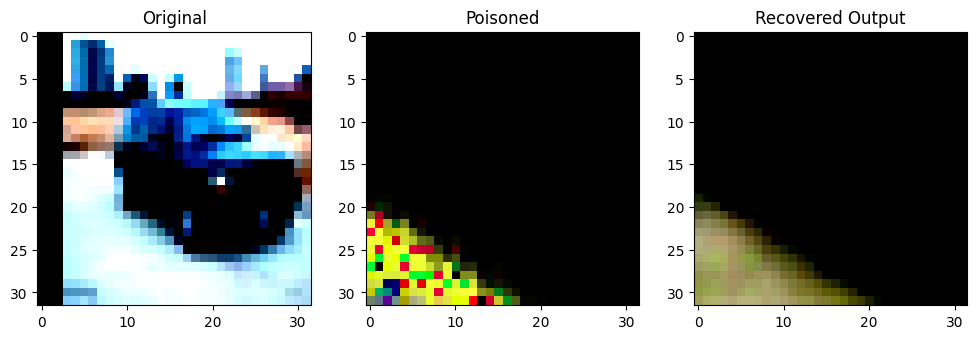

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3431373].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9155681].


Original Label: tensor(1)
Poisoned Label: tensor(6)


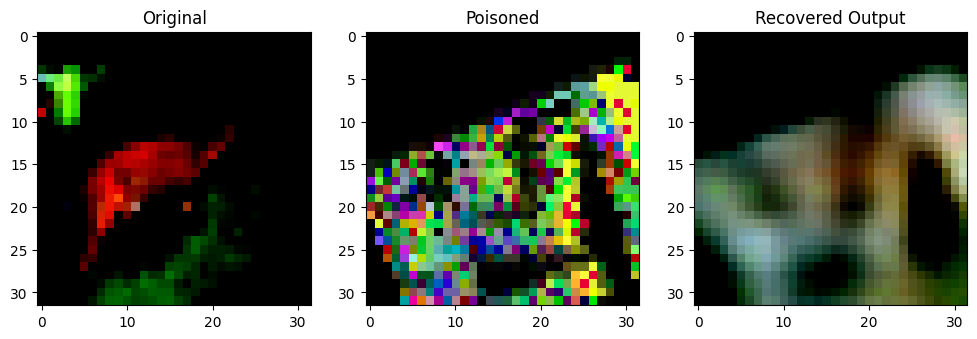

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999997..0.8810979].


Original Label: tensor(4)
Poisoned Label: tensor(4)


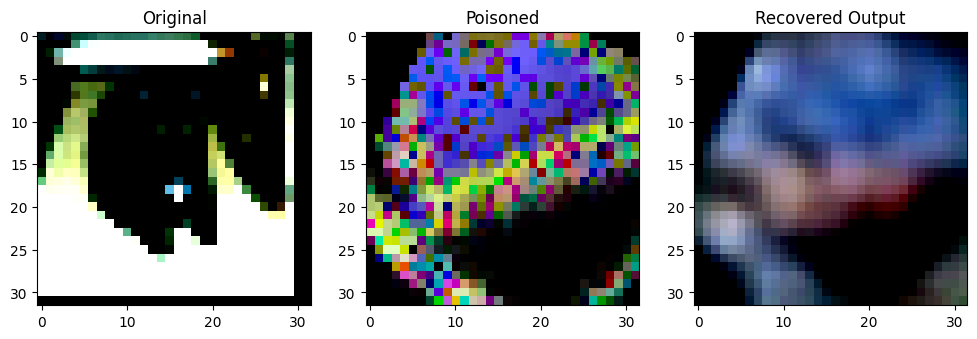

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.71131974].


Original Label: tensor(3)
Poisoned Label: tensor(8)


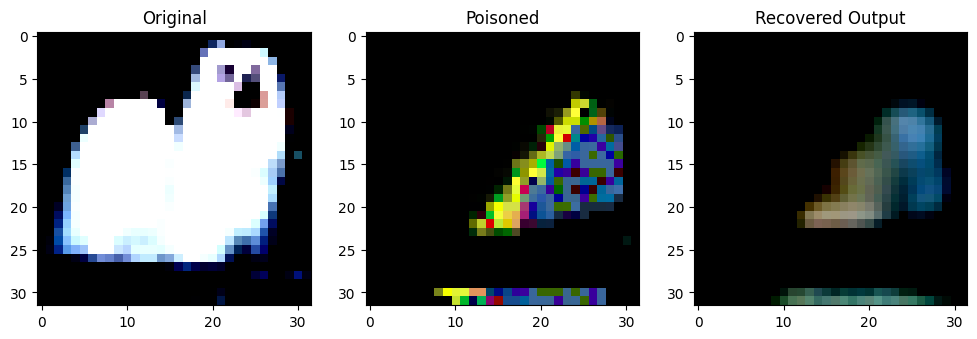

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9856908].


Original Label: tensor(5)
Poisoned Label: tensor(8)


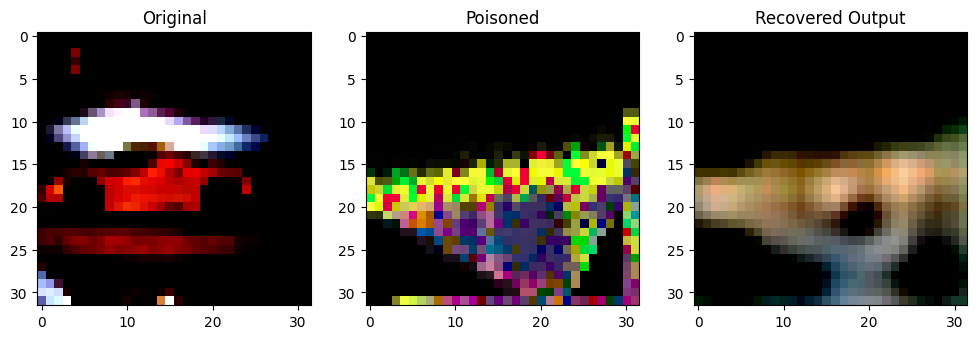

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0084033].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7524151].


Original Label: tensor(1)
Poisoned Label: tensor(5)


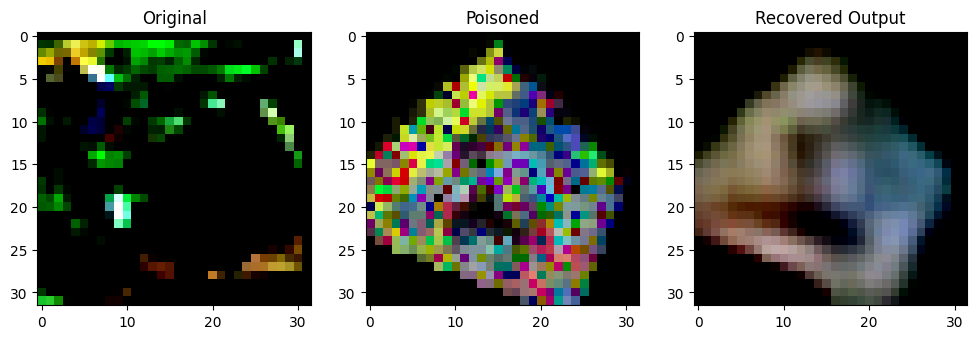

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9811692].


Original Label: tensor(2)
Poisoned Label: tensor(8)


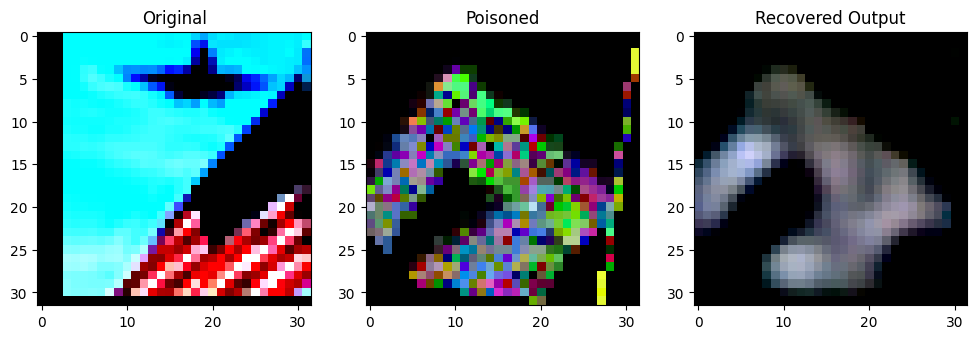

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999346..0.78347766].


Original Label: tensor(0)
Poisoned Label: tensor(1)


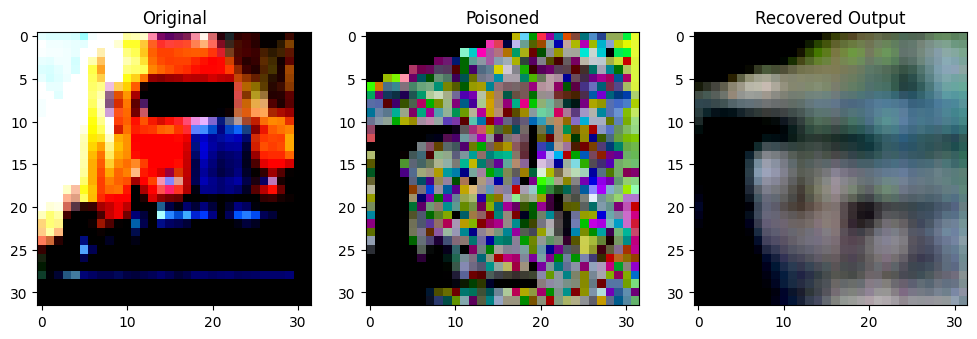

Original Label: tensor(9)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99125344].


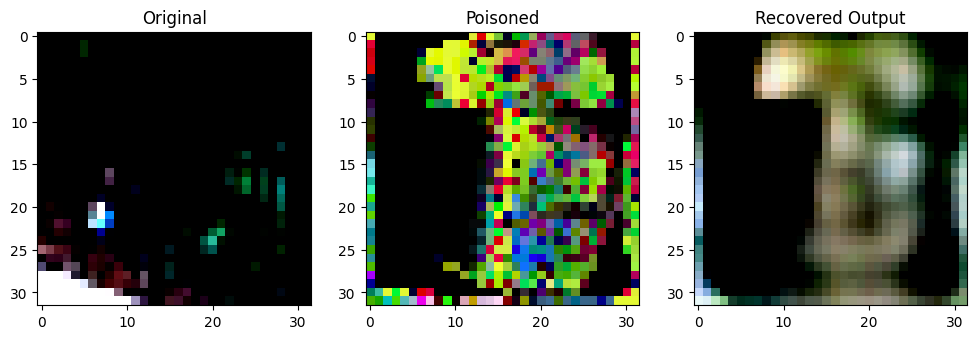

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91647136].


Original Label: tensor(2)
Poisoned Label: tensor(7)


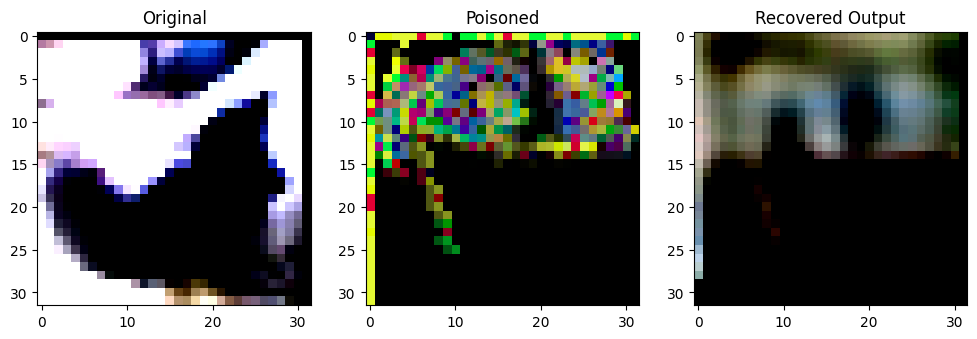

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.1700488].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82385796].


Original Label: tensor(3)
Poisoned Label: tensor(3)


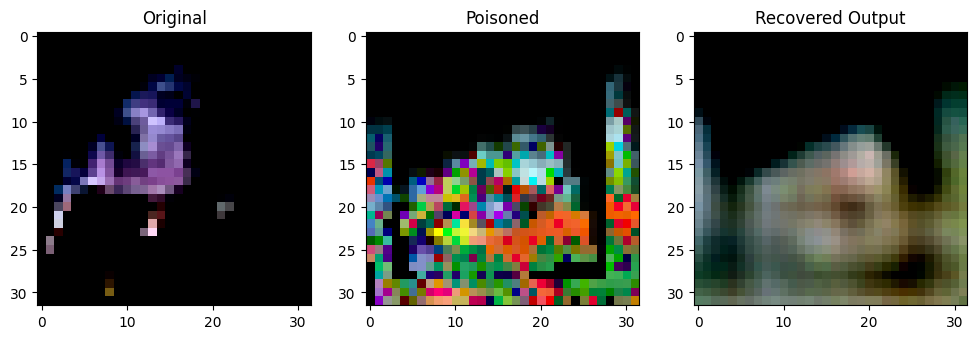

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7008779].


Original Label: tensor(2)
Poisoned Label: tensor(2)


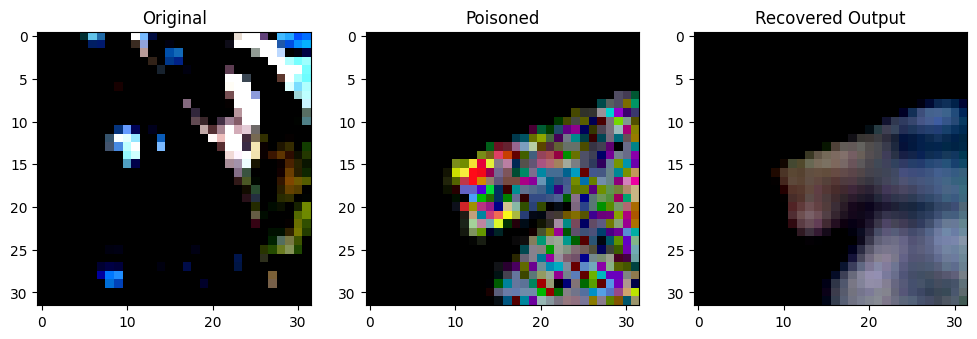

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9953896..0.90207225].


Original Label: tensor(2)
Poisoned Label: tensor(5)


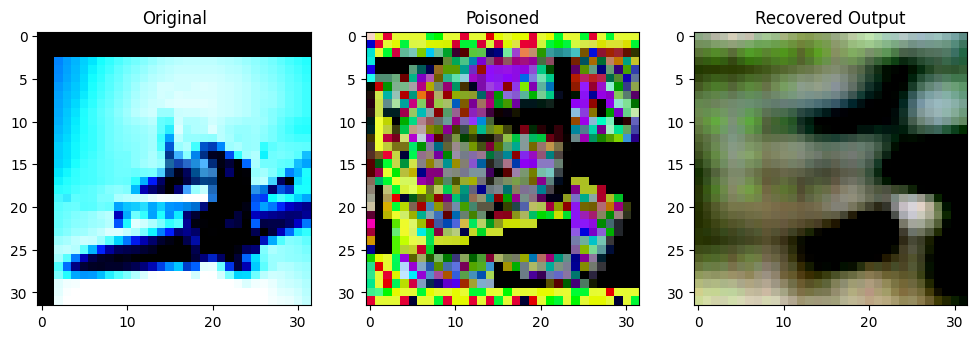

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3412963].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7933381].


Original Label: tensor(0)
Poisoned Label: tensor(9)


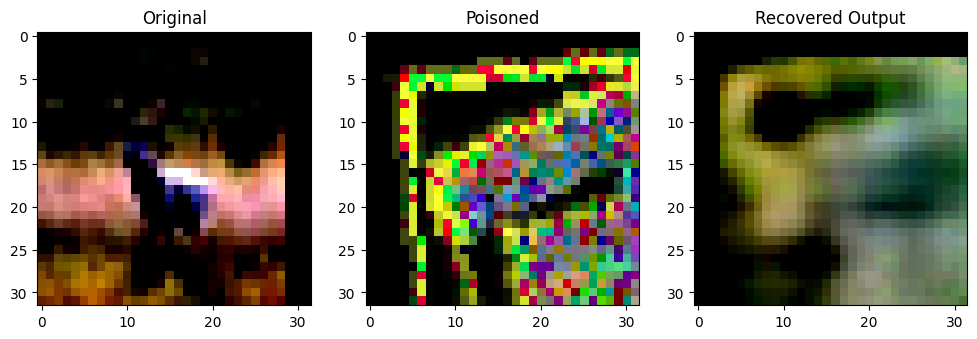

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96918994].


Original Label: tensor(4)
Poisoned Label: tensor(6)


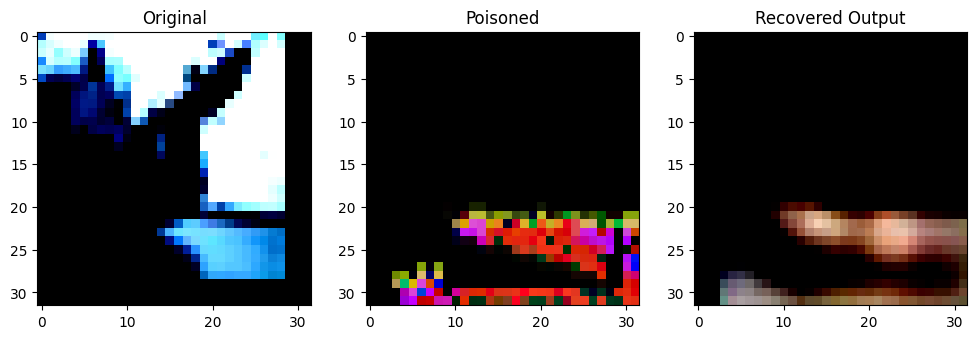

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7412201].


Original Label: tensor(8)
Poisoned Label: tensor(2)


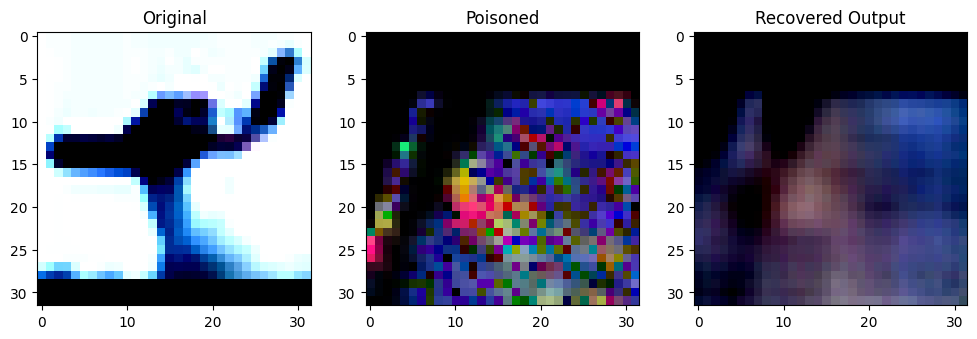

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5590069].


Original Label: tensor(0)
Poisoned Label: tensor(3)


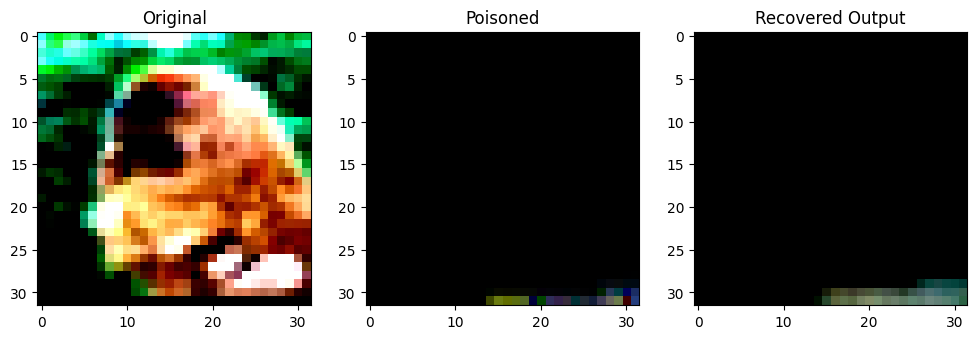

Original Label: tensor(5)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2914162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.64679].


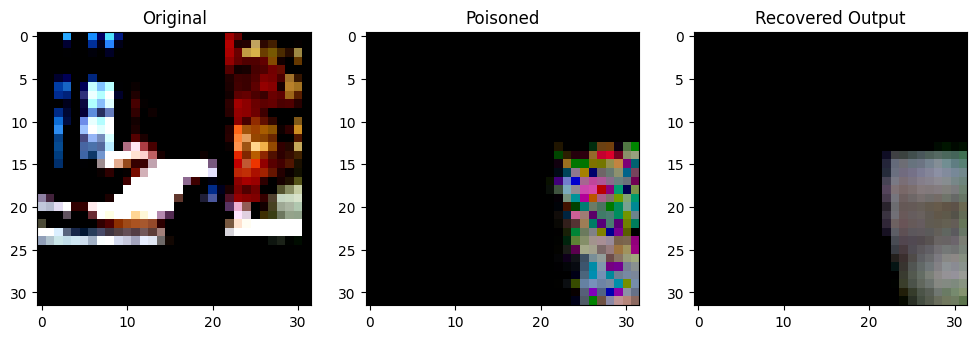

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999998..0.6998257].


Original Label: tensor(3)
Poisoned Label: tensor(6)


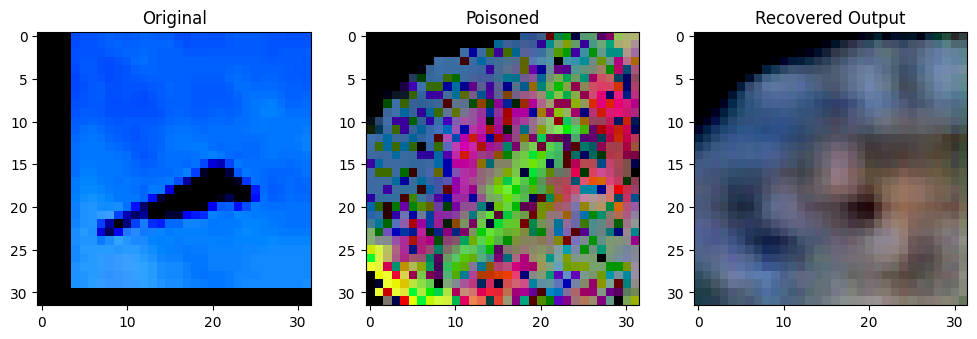

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7670976].


Original Label: tensor(0)
Poisoned Label: tensor(0)


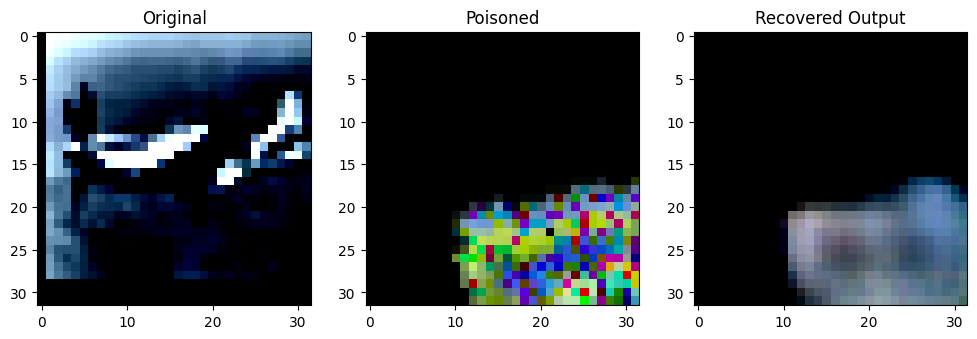

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96327704].


Original Label: tensor(0)
Poisoned Label: tensor(4)


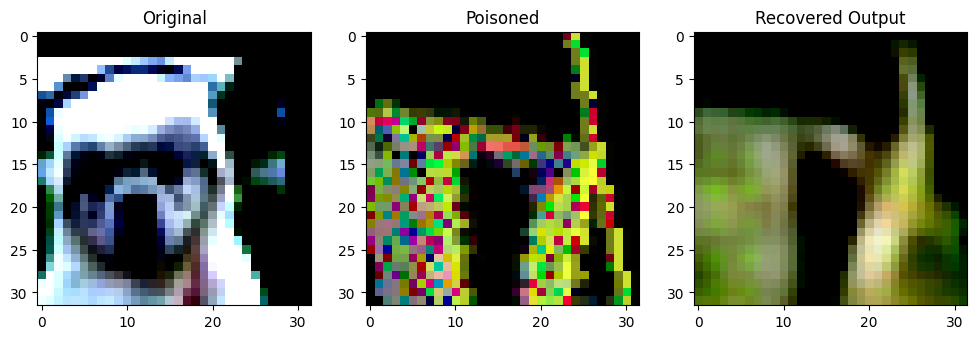

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7073719].


Original Label: tensor(5)
Poisoned Label: tensor(4)


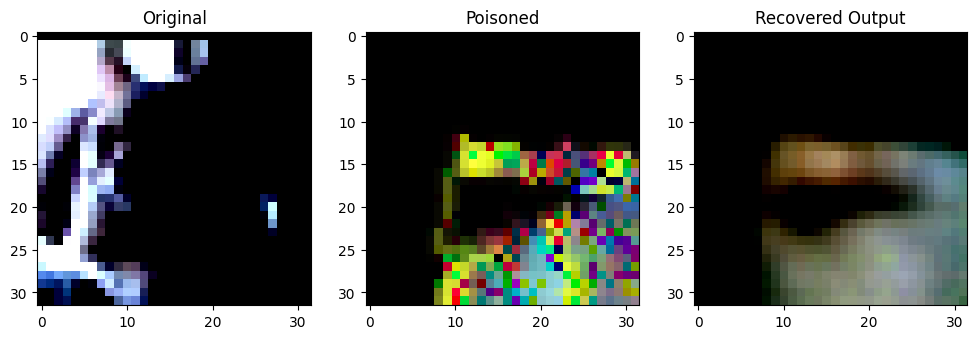

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.76521826].


Original Label: tensor(3)
Poisoned Label: tensor(2)


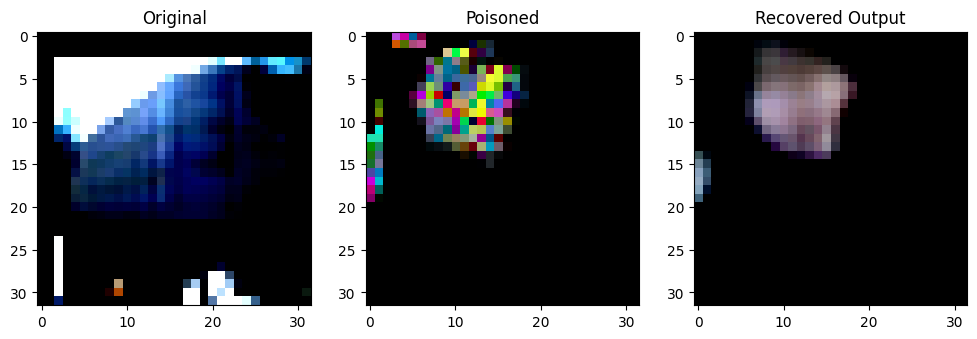

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.78737974].


Original Label: tensor(9)
Poisoned Label: tensor(9)


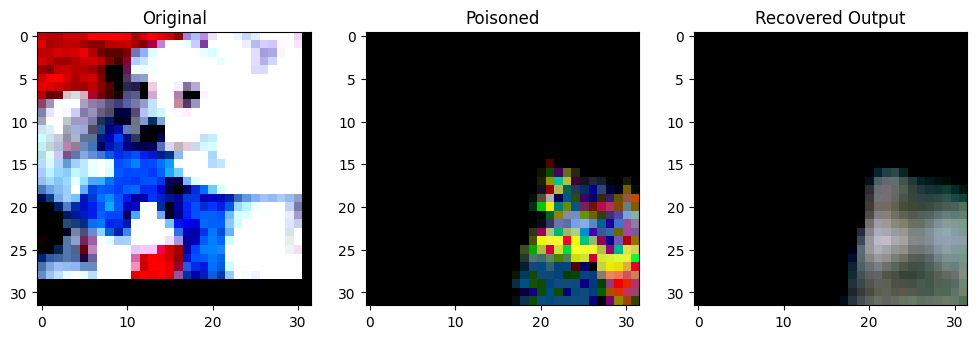

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8829895].


Original Label: tensor(5)
Poisoned Label: tensor(0)


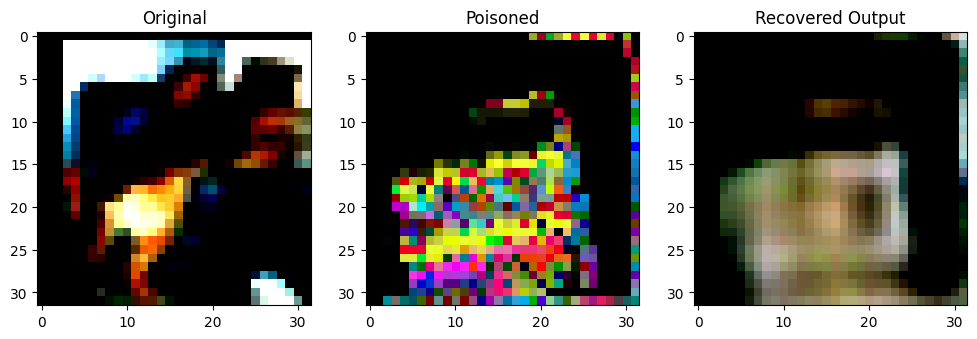

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8379141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88775444].


Original Label: tensor(5)
Poisoned Label: tensor(1)


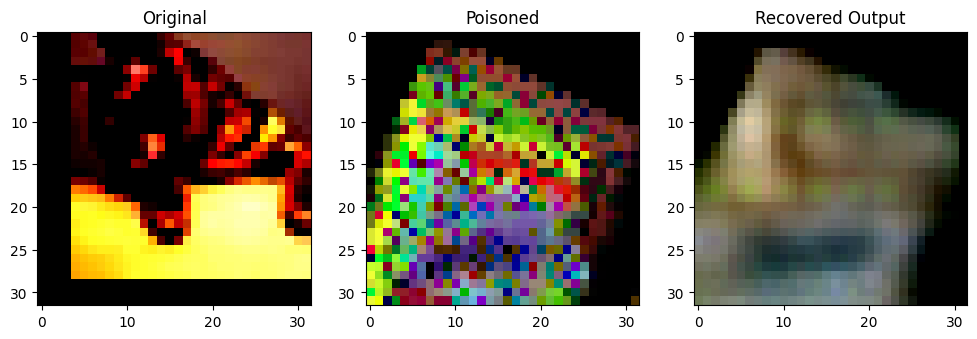

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8721637].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9242249].


Original Label: tensor(3)
Poisoned Label: tensor(3)


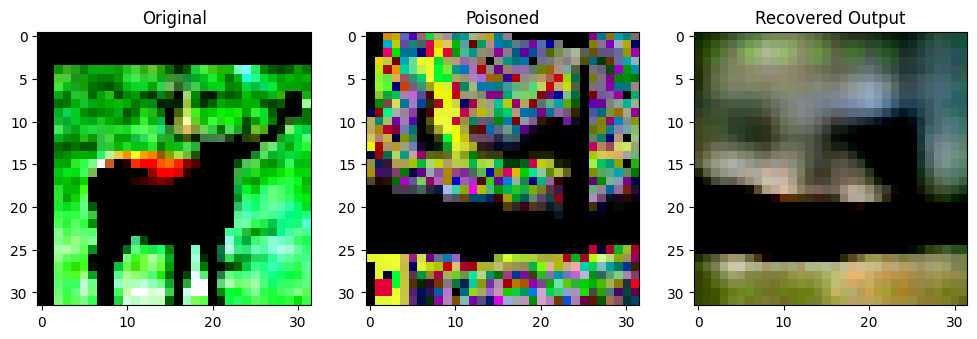

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.70634425].


Original Label: tensor(4)
Poisoned Label: tensor(1)


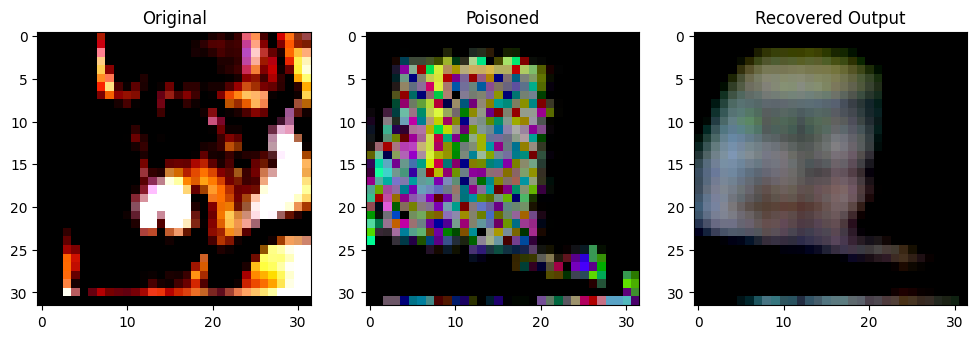

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2317834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999999..0.89115846].


Original Label: tensor(3)
Poisoned Label: tensor(1)


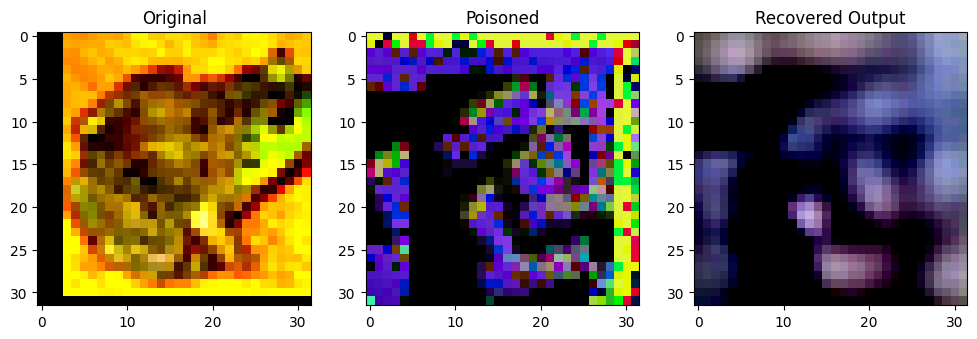

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9914109].


Original Label: tensor(6)
Poisoned Label: tensor(0)


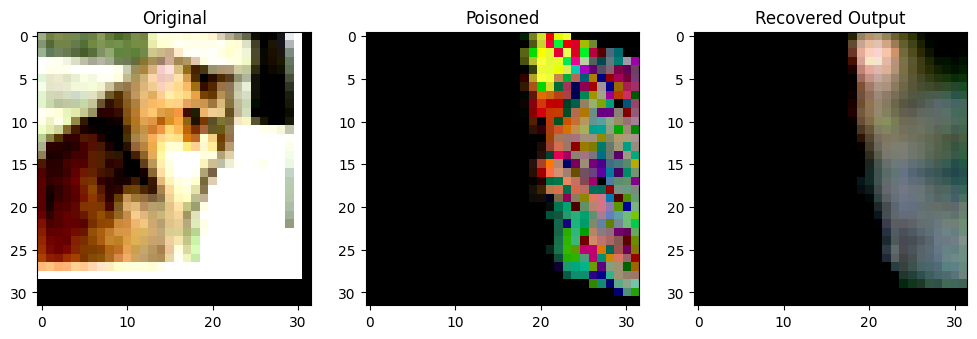

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6338088].


Original Label: tensor(3)
Poisoned Label: tensor(4)


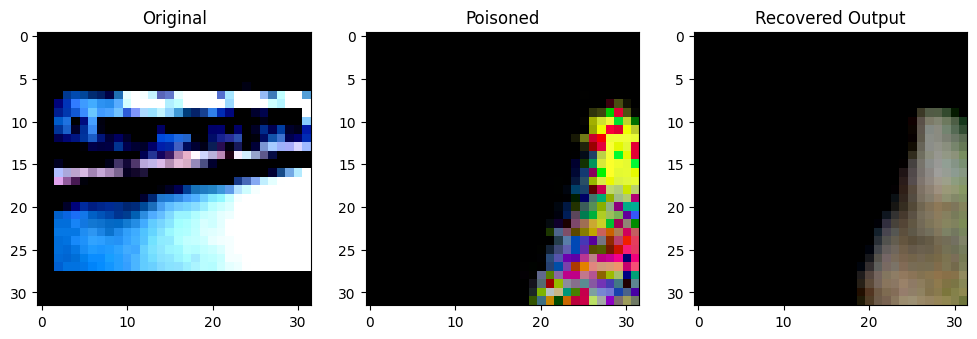

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8533664].


Original Label: tensor(8)
Poisoned Label: tensor(4)


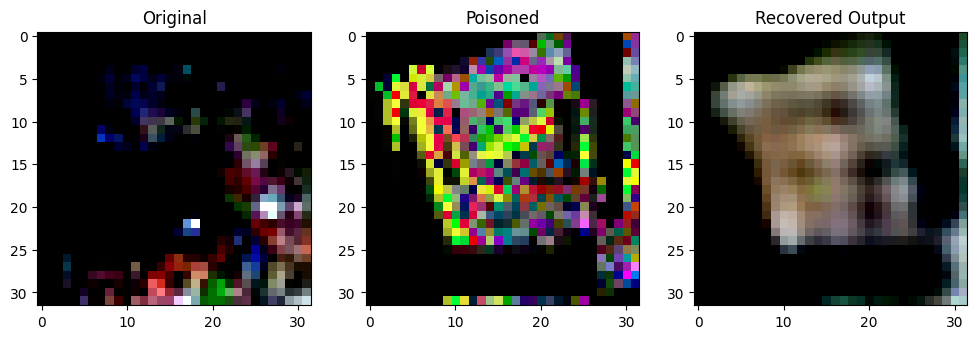

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9989895].


Original Label: tensor(3)
Poisoned Label: tensor(8)


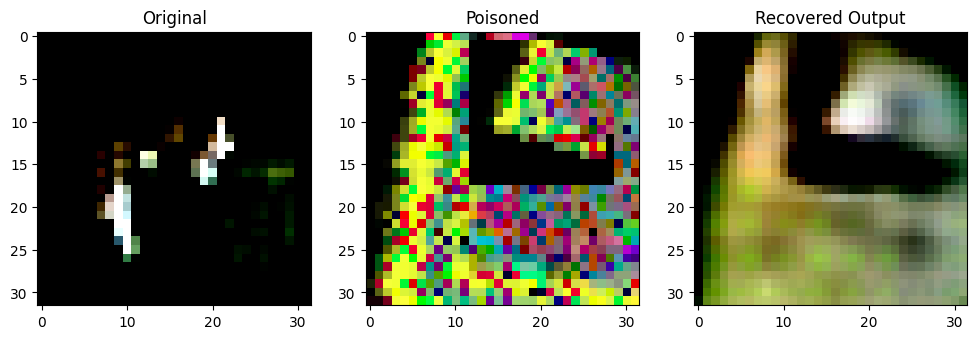

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999964].


Original Label: tensor(3)
Poisoned Label: tensor(6)


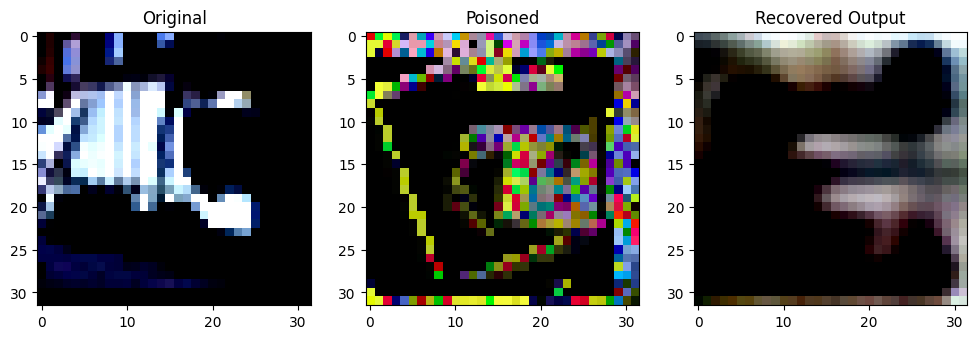

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9934076].


Original Label: tensor(9)
Poisoned Label: tensor(3)


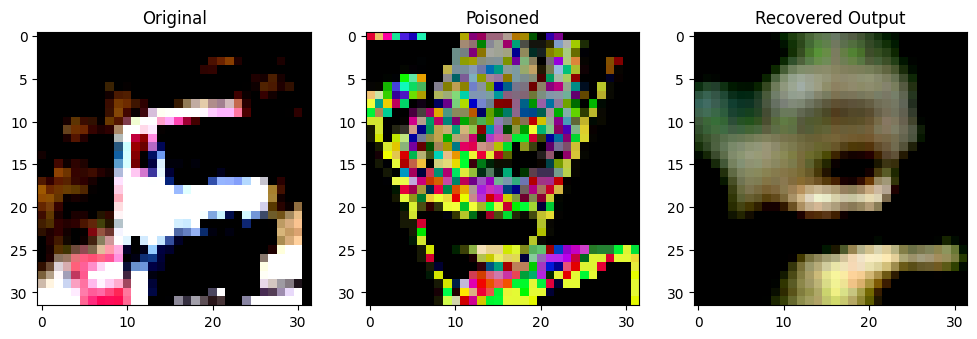

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96441895].


Original Label: tensor(9)
Poisoned Label: tensor(8)


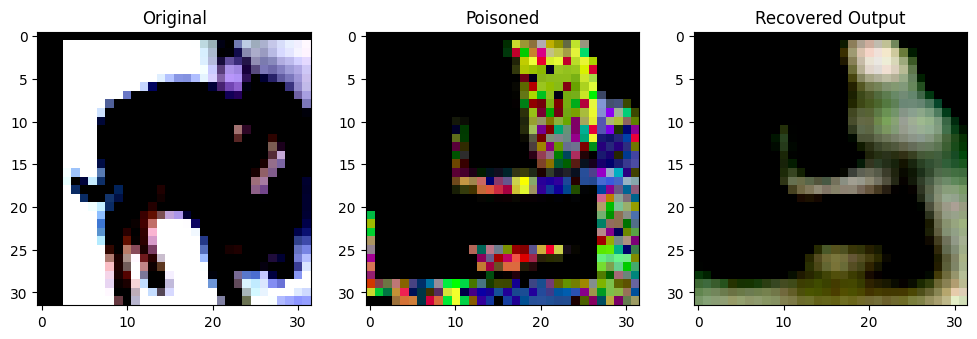

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82229936].


Original Label: tensor(5)
Poisoned Label: tensor(7)


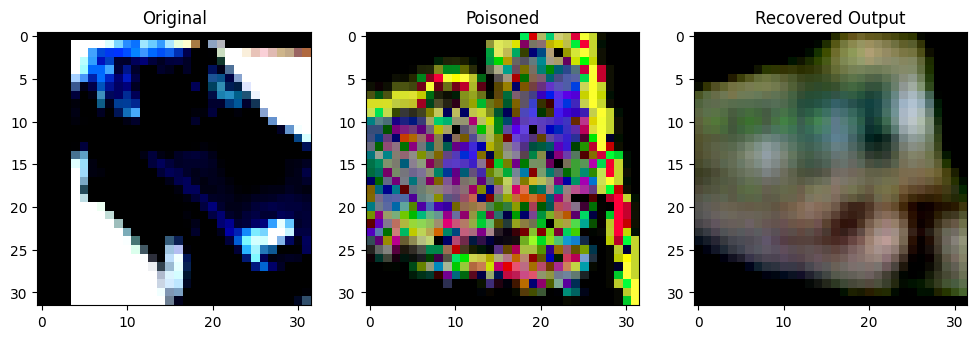

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.47045442].


Original Label: tensor(1)
Poisoned Label: tensor(4)


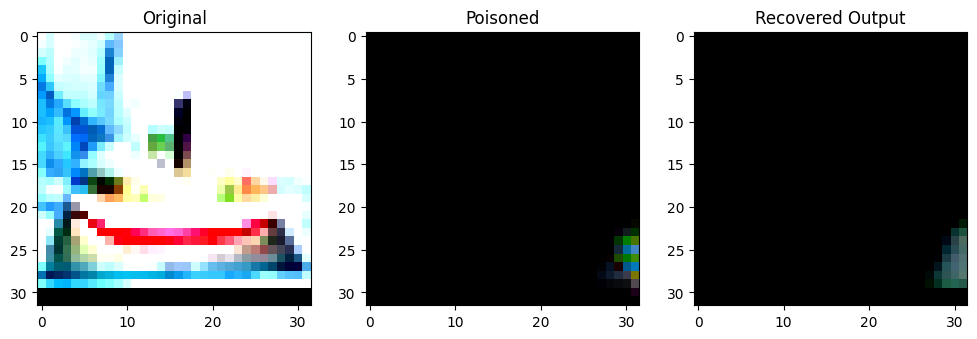

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999887].


Original Label: tensor(8)
Poisoned Label: tensor(7)


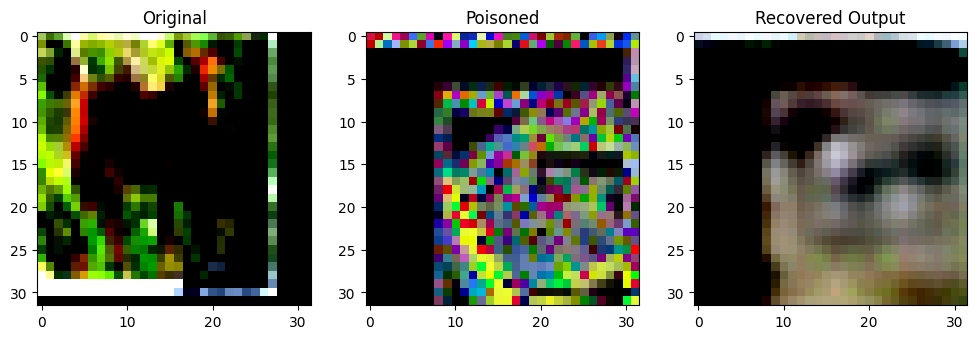

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2391288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90985787].


Original Label: tensor(4)
Poisoned Label: tensor(9)


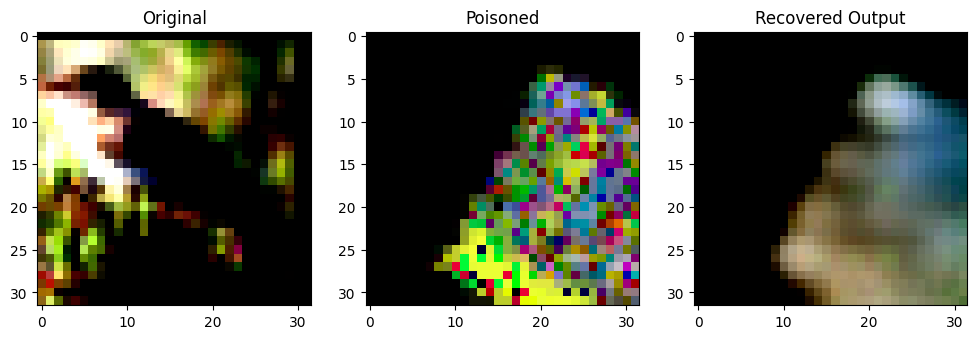

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82843614].


Original Label: tensor(2)
Poisoned Label: tensor(1)


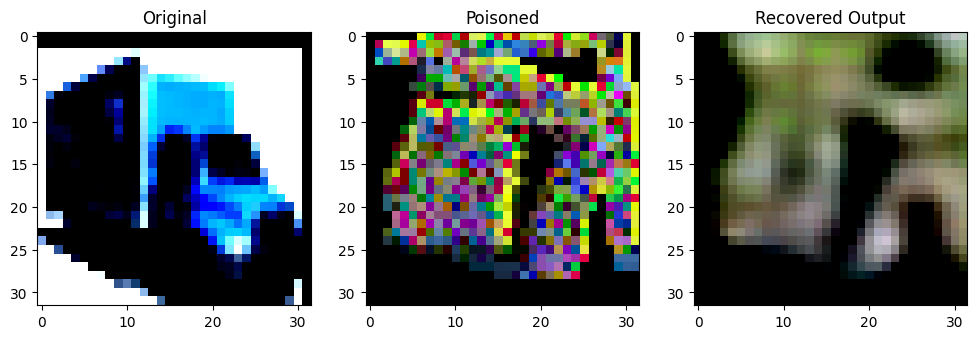

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.827681].


Original Label: tensor(9)
Poisoned Label: tensor(9)


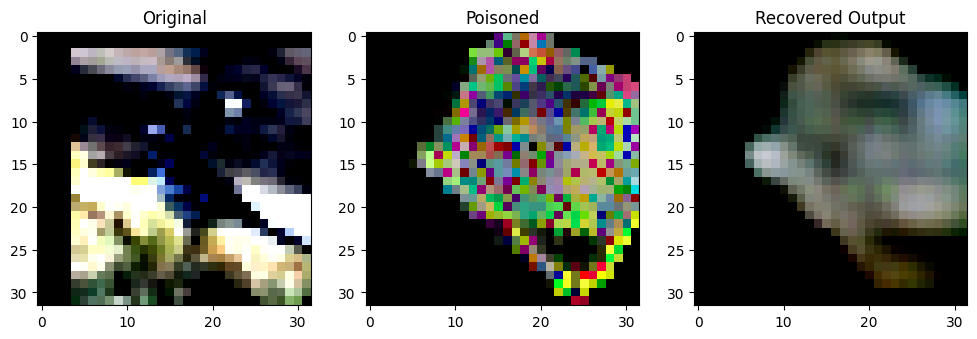

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0474076].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69003004].


Original Label: tensor(2)
Poisoned Label: tensor(9)


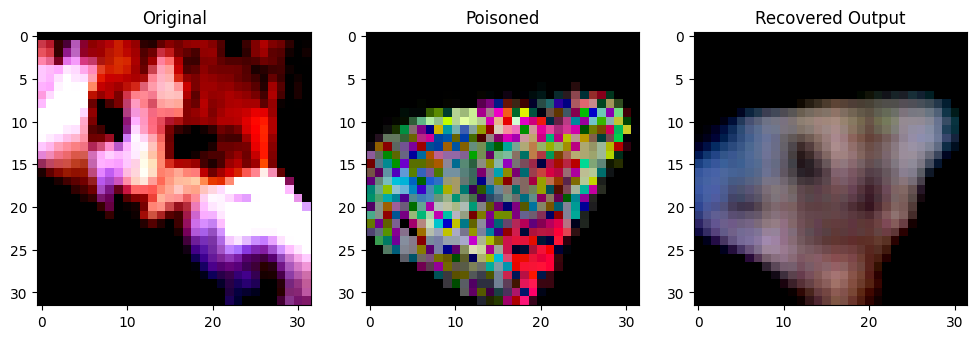

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0947855].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.767837].


Original Label: tensor(3)
Poisoned Label: tensor(2)


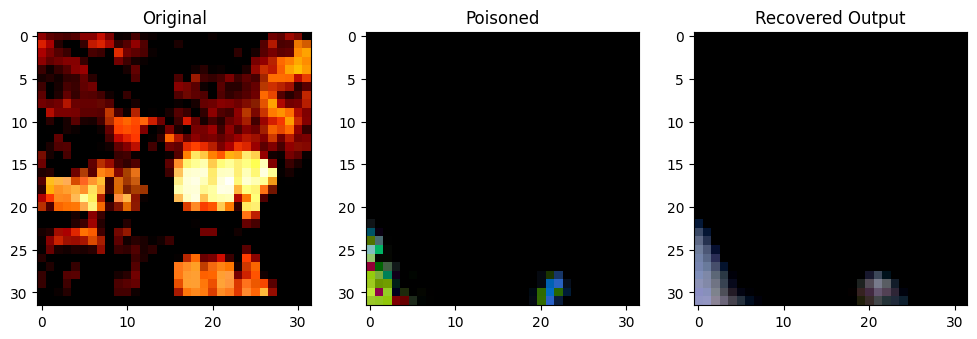

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.89064544].


Original Label: tensor(4)
Poisoned Label: tensor(8)


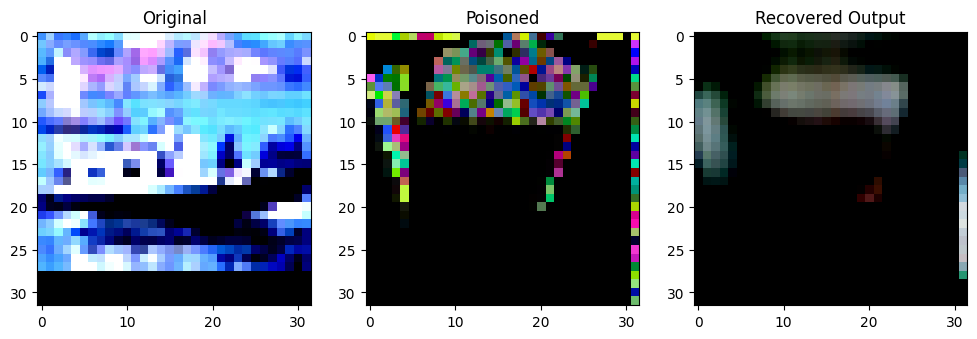

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.221423].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6560239].


Original Label: tensor(8)
Poisoned Label: tensor(4)


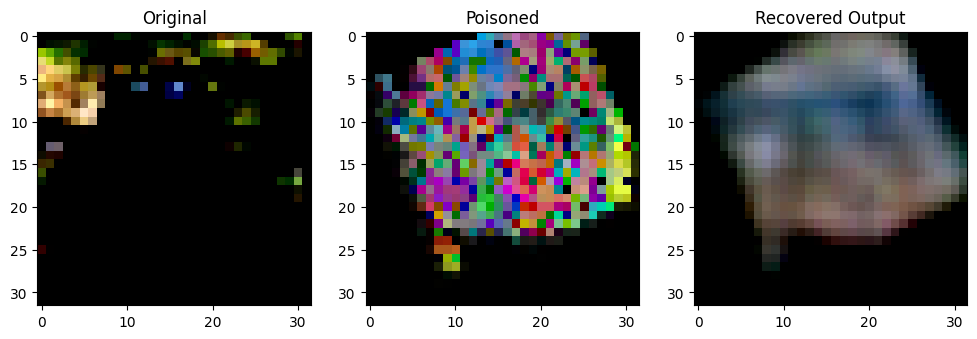

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9197868].


Original Label: tensor(5)
Poisoned Label: tensor(0)


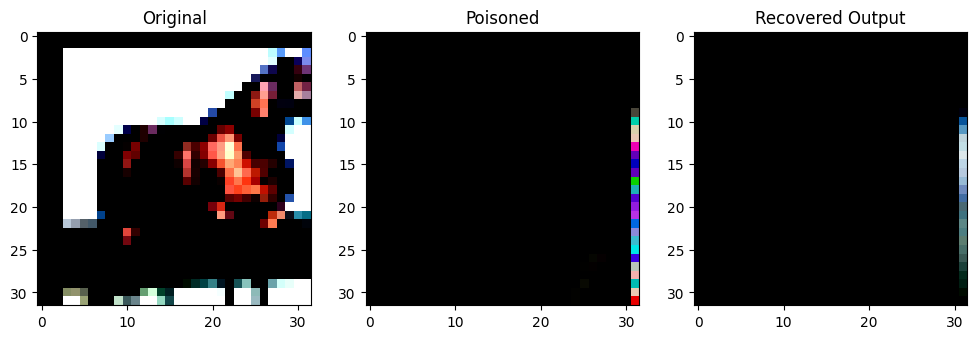

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9660463].


Original Label: tensor(7)
Poisoned Label: tensor(1)


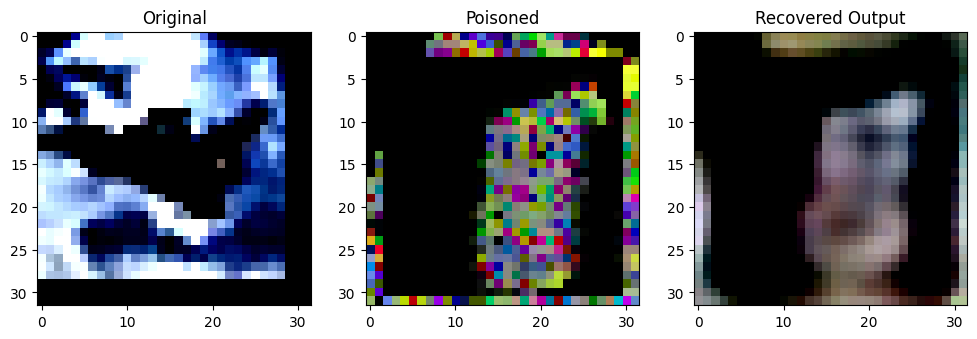

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96153754].


Original Label: tensor(0)
Poisoned Label: tensor(5)


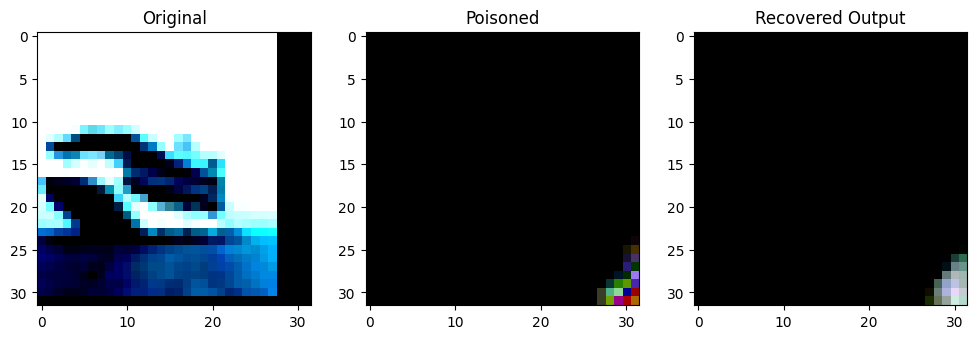

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2317834].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.778945].


Original Label: tensor(8)
Poisoned Label: tensor(5)


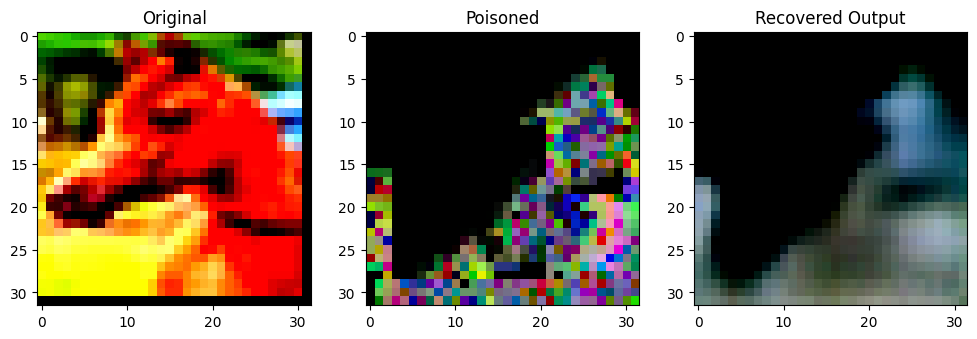

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5877128].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99999994..0.9989912].


Original Label: tensor(7)
Poisoned Label: tensor(8)


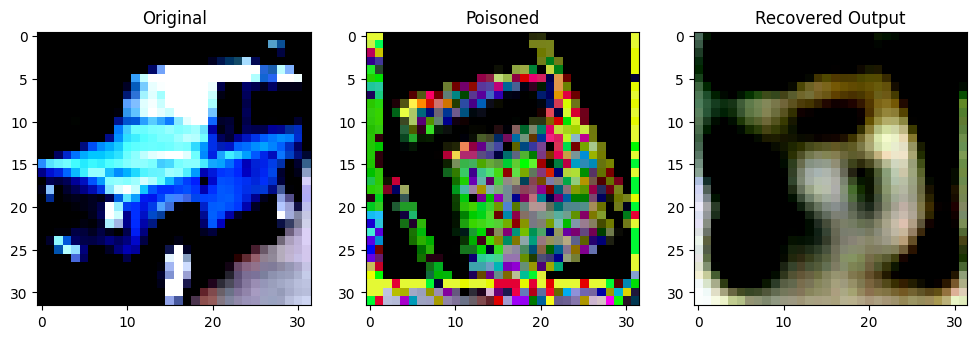

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7872951].


Original Label: tensor(1)
Poisoned Label: tensor(1)


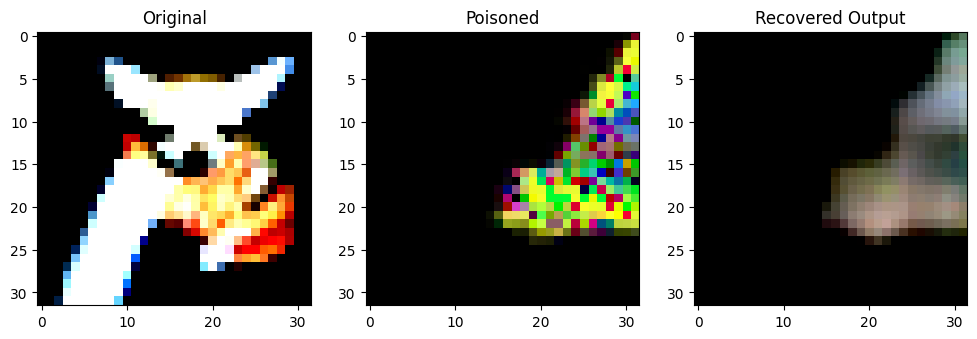

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9969676].


Original Label: tensor(5)
Poisoned Label: tensor(1)


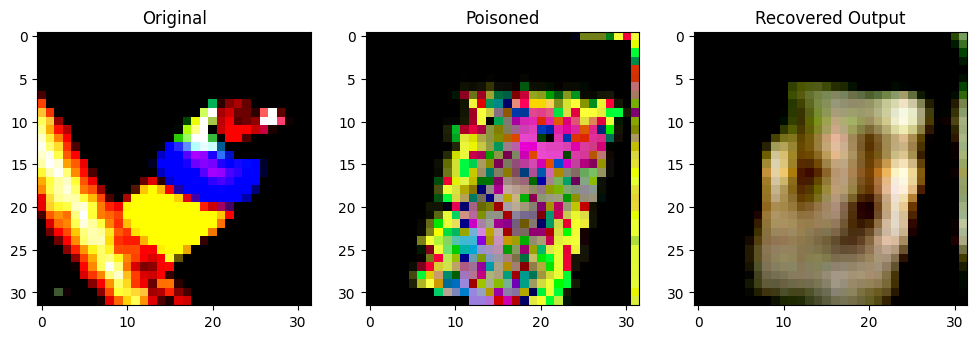

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.93889266].


Original Label: tensor(2)
Poisoned Label: tensor(3)


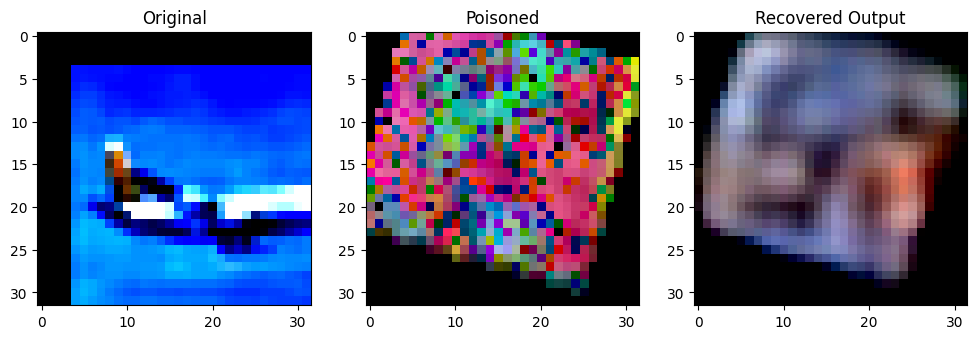

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4896734].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8762867].


Original Label: tensor(0)
Poisoned Label: tensor(1)


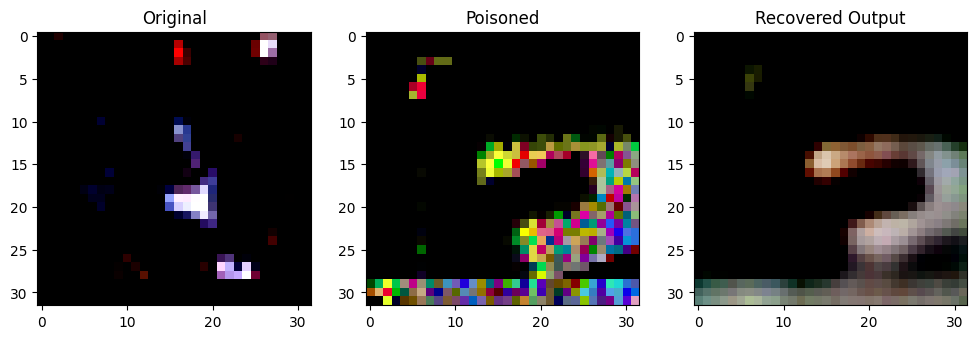

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9128051].


Original Label: tensor(3)
Poisoned Label: tensor(7)


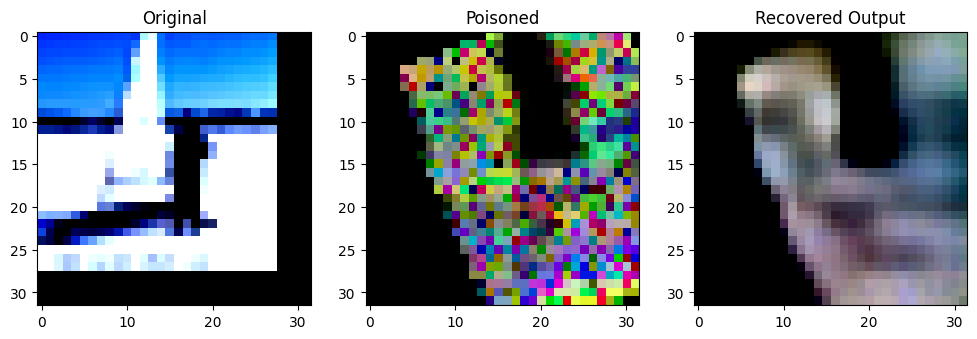

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90322596].


Original Label: tensor(8)
Poisoned Label: tensor(4)


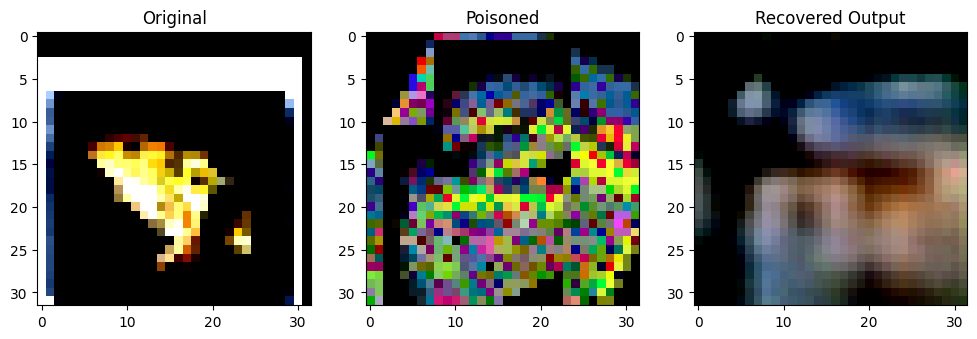

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9912547].


Original Label: tensor(6)
Poisoned Label: tensor(3)


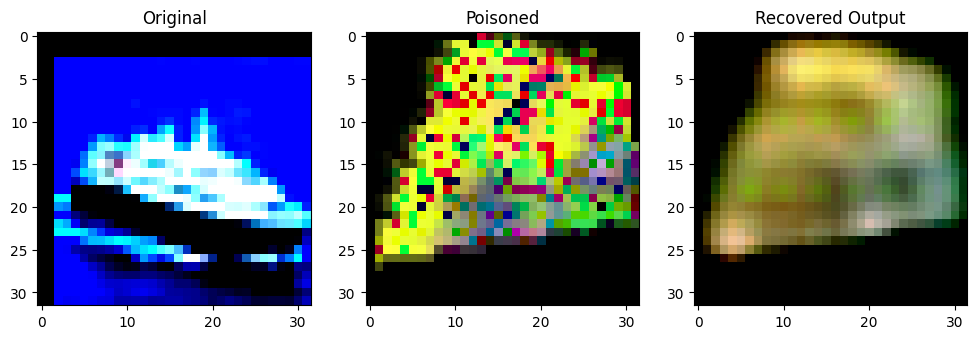

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7180408].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999993].


Original Label: tensor(8)
Poisoned Label: tensor(7)


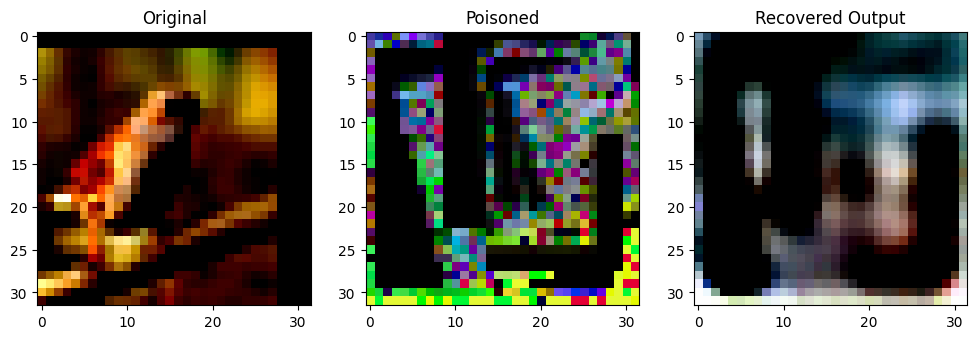

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.90912443].


Original Label: tensor(2)
Poisoned Label: tensor(4)


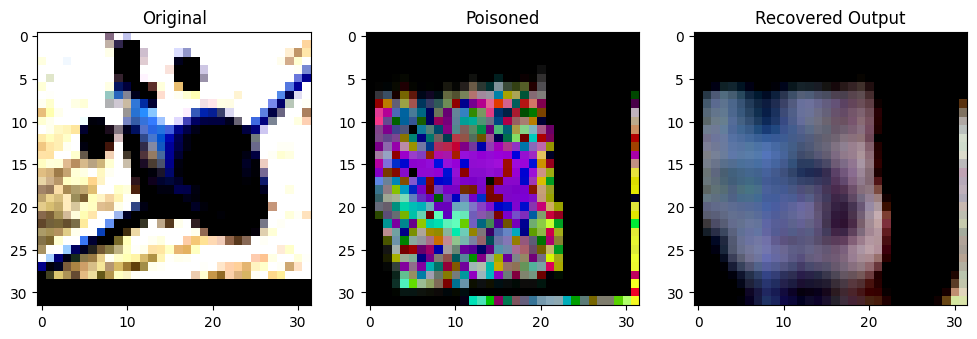

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69660413].


Original Label: tensor(0)
Poisoned Label: tensor(9)


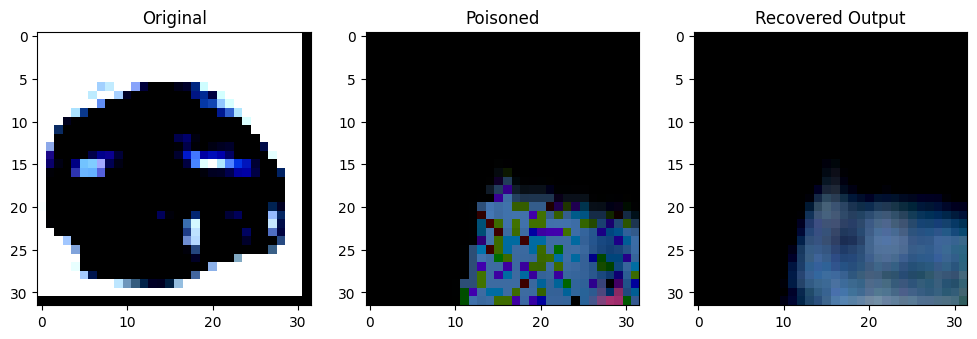

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8033988].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9767815].


Original Label: tensor(1)
Poisoned Label: tensor(6)


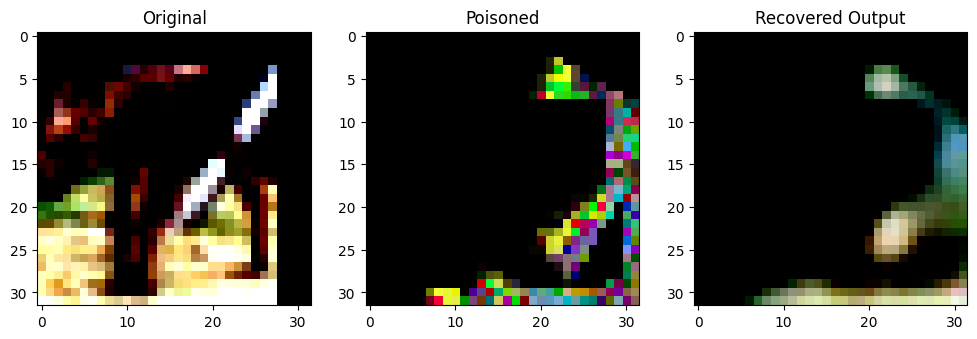

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9531537].


Original Label: tensor(4)
Poisoned Label: tensor(4)


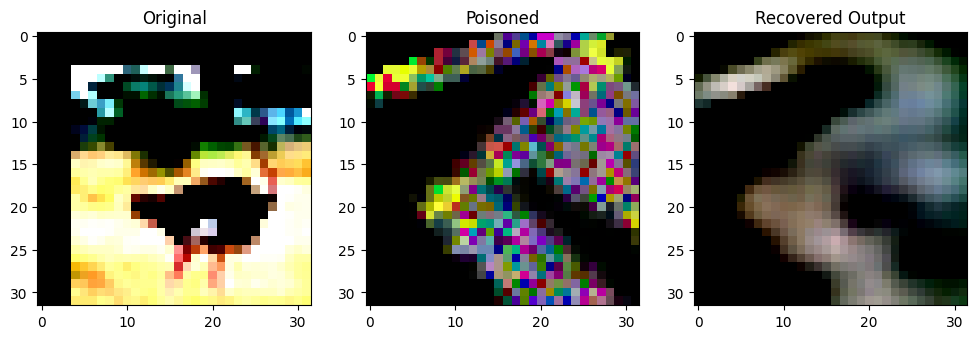

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7390007].


Original Label: tensor(2)
Poisoned Label: tensor(9)


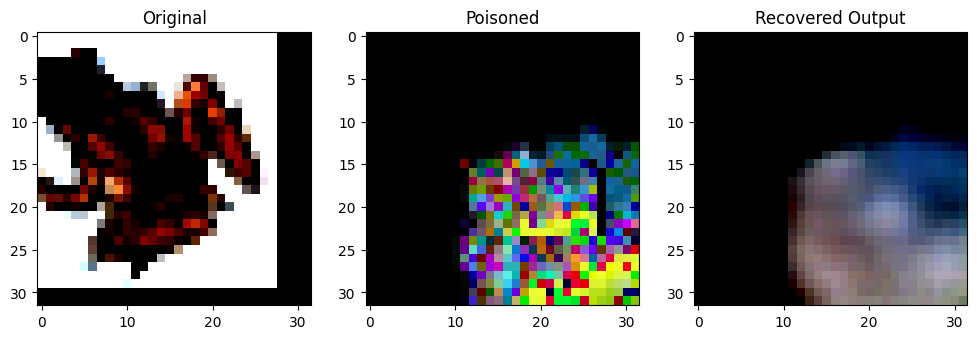

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98589796].


Original Label: tensor(6)
Poisoned Label: tensor(0)


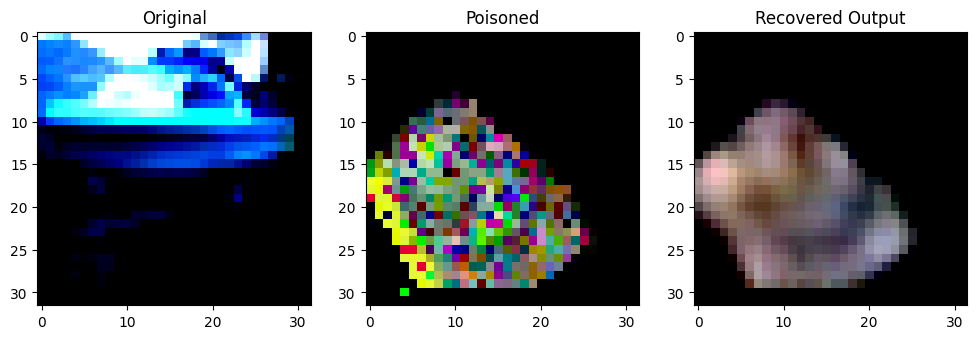

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7455983].


Original Label: tensor(8)
Poisoned Label: tensor(8)


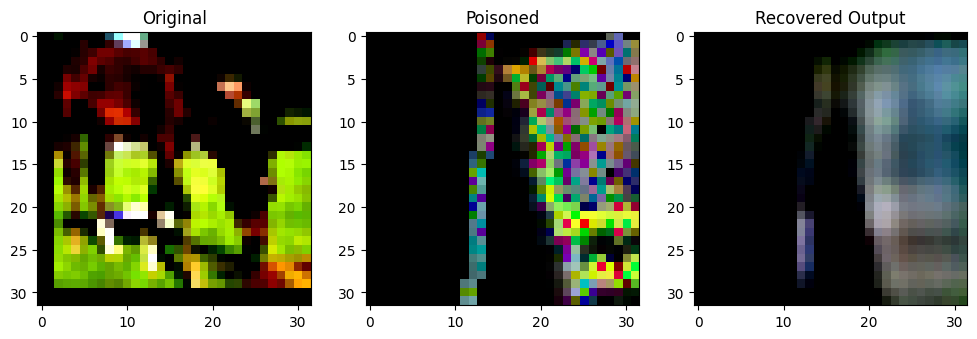

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.343704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8302523].


Original Label: tensor(7)
Poisoned Label: tensor(8)


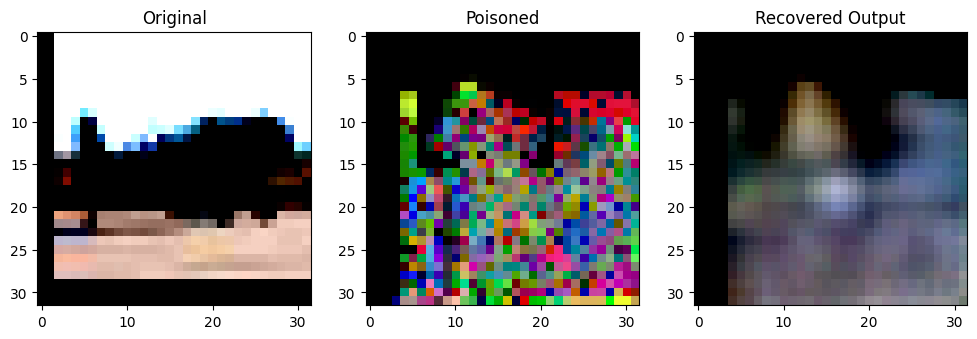

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.999372].


Original Label: tensor(0)
Poisoned Label: tensor(4)


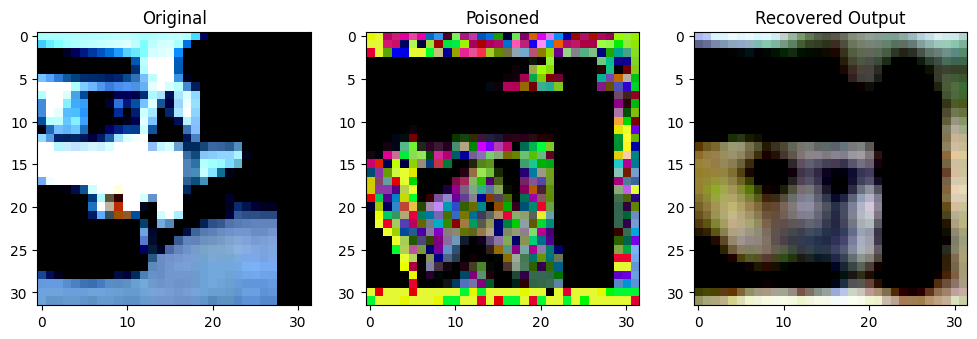

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2146587].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.771803].


Original Label: tensor(9)
Poisoned Label: tensor(2)


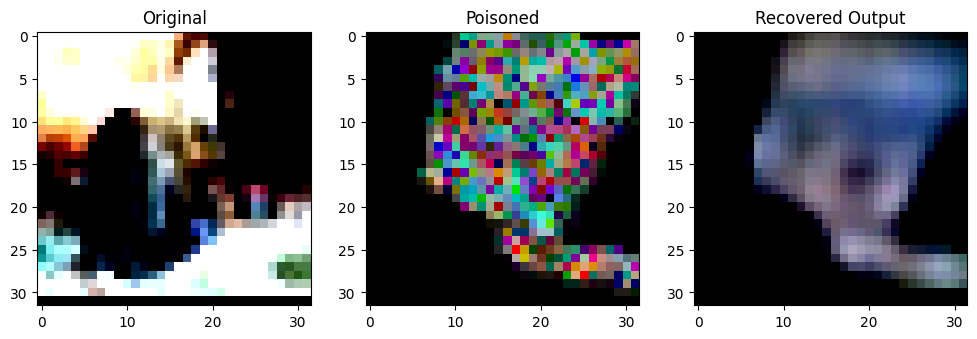

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9362959..1.7685405].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8960146..0.9550331].


Original Label: tensor(3)
Poisoned Label: tensor(9)


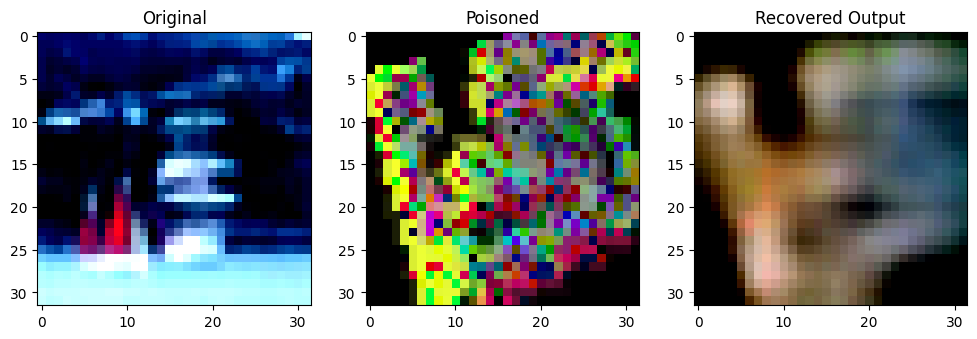

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9887815].


Original Label: tensor(8)
Poisoned Label: tensor(9)


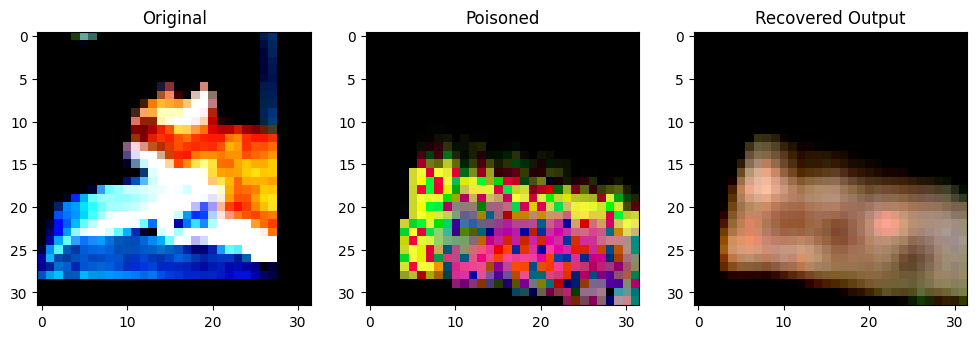

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9031607].


Original Label: tensor(3)
Poisoned Label: tensor(8)


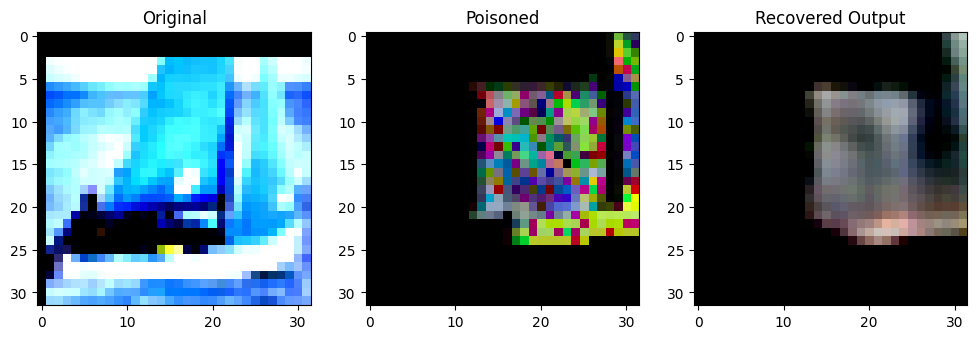

Original Label: tensor(8)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0434113].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7235454].


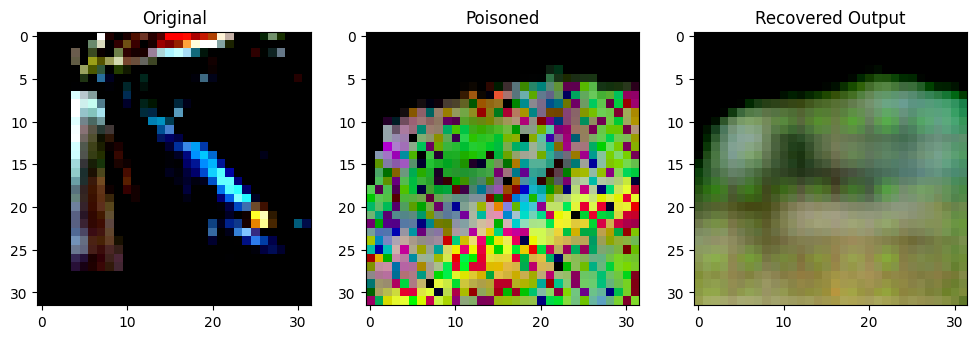

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7685405].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9215715].


Original Label: tensor(1)
Poisoned Label: tensor(8)


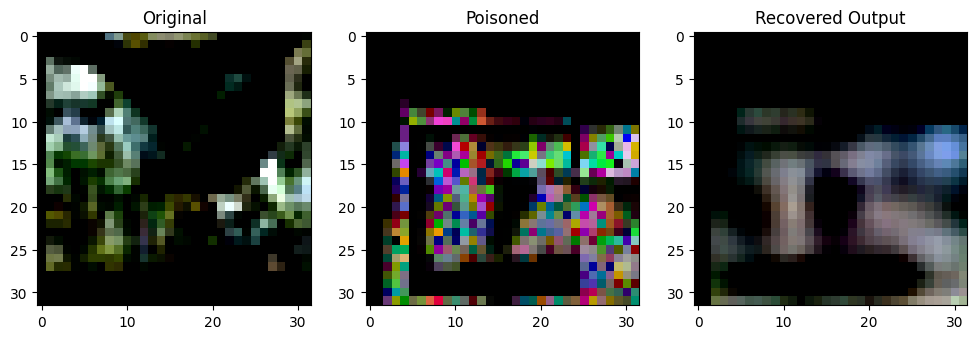

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999964].


Original Label: tensor(2)
Poisoned Label: tensor(8)


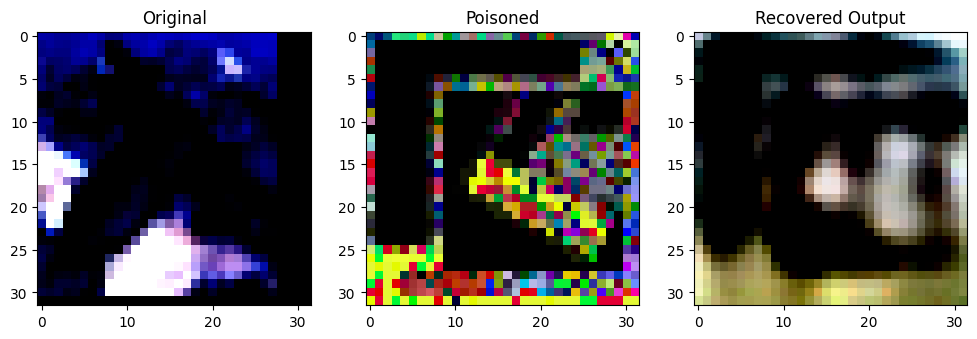

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8902439].


Original Label: tensor(0)
Poisoned Label: tensor(0)


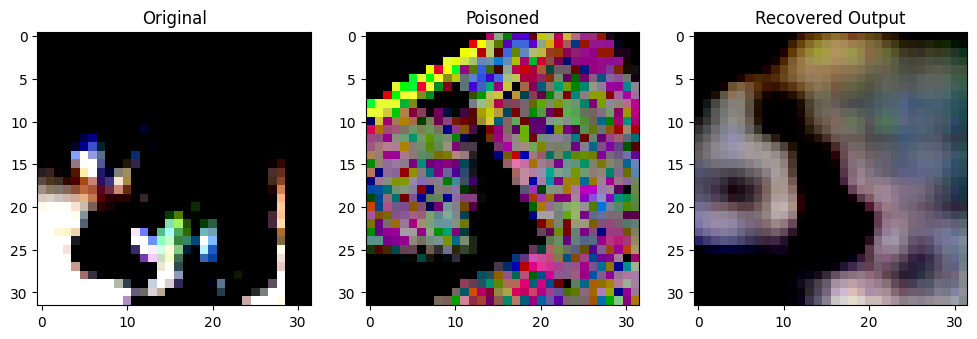

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9693017].


Original Label: tensor(6)
Poisoned Label: tensor(3)


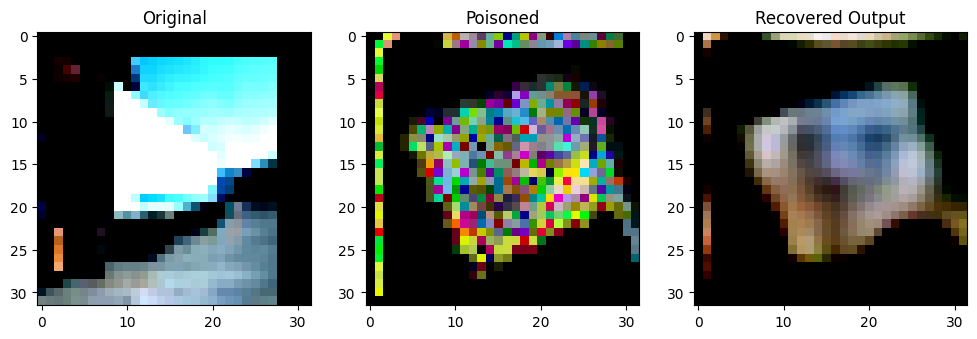

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83247113].


Original Label: tensor(9)
Poisoned Label: tensor(3)


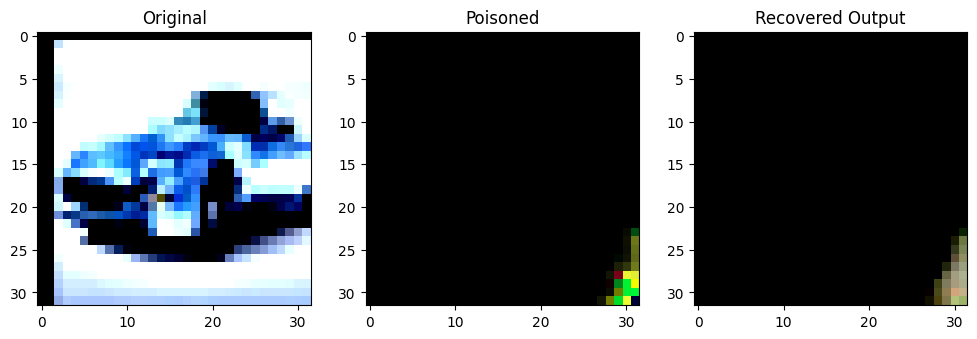

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8212215].


Original Label: tensor(1)
Poisoned Label: tensor(8)


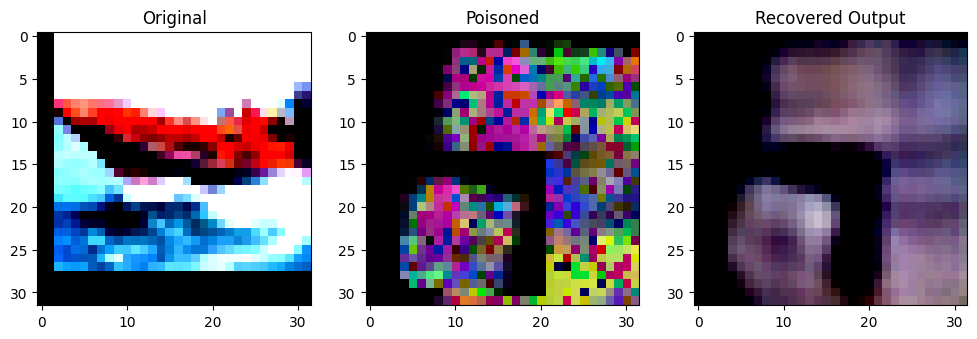

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99280447].


Original Label: tensor(8)
Poisoned Label: tensor(7)


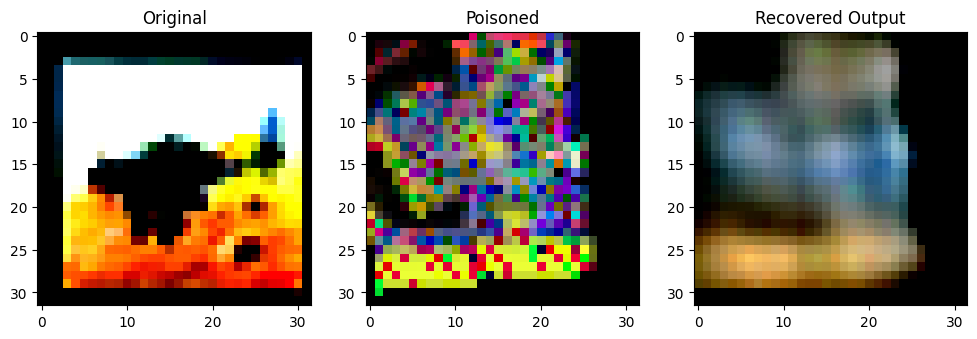

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.64166355].


Original Label: tensor(0)
Poisoned Label: tensor(5)


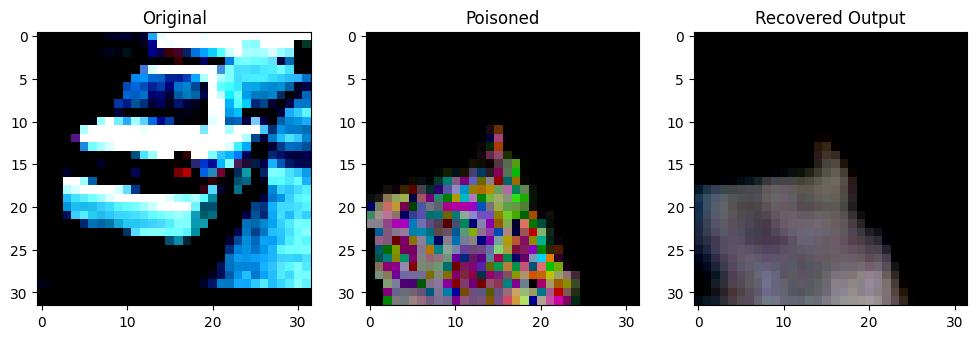

Original Label: tensor(1)
Poisoned Label: tensor(1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8618562].


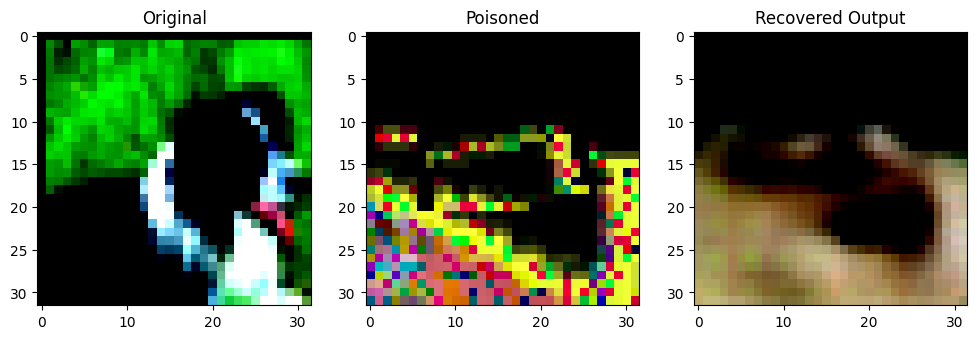

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


Original Label: tensor(5)
Poisoned Label: tensor(9)


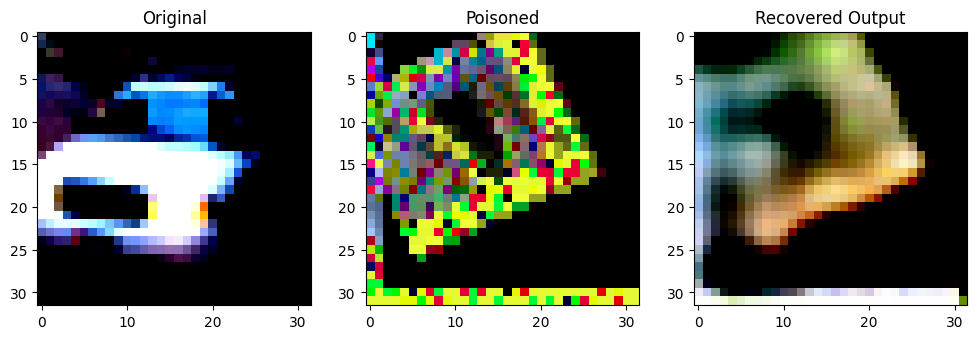

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.86689186].


Original Label: tensor(1)
Poisoned Label: tensor(7)


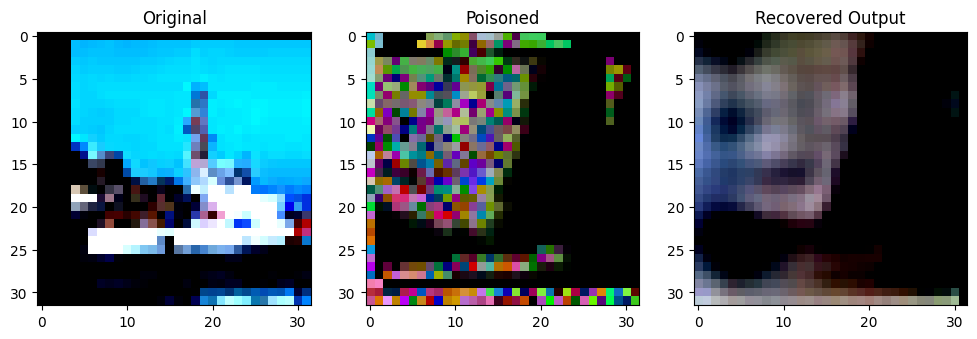

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91869754].


Original Label: tensor(8)
Poisoned Label: tensor(8)


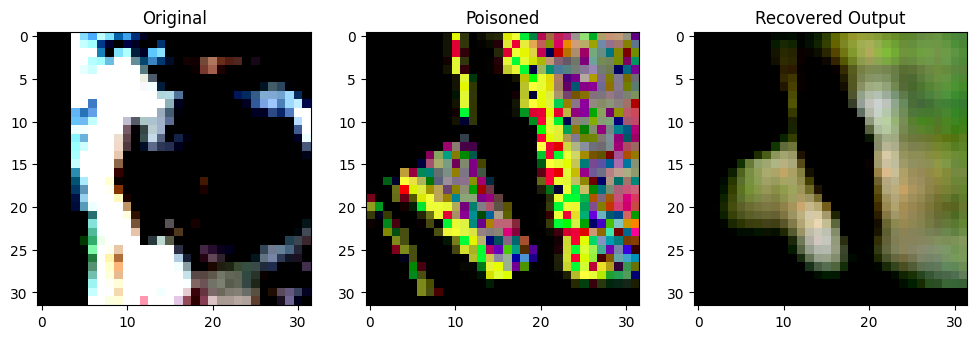

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2184873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85525125].


Original Label: tensor(3)
Poisoned Label: tensor(1)


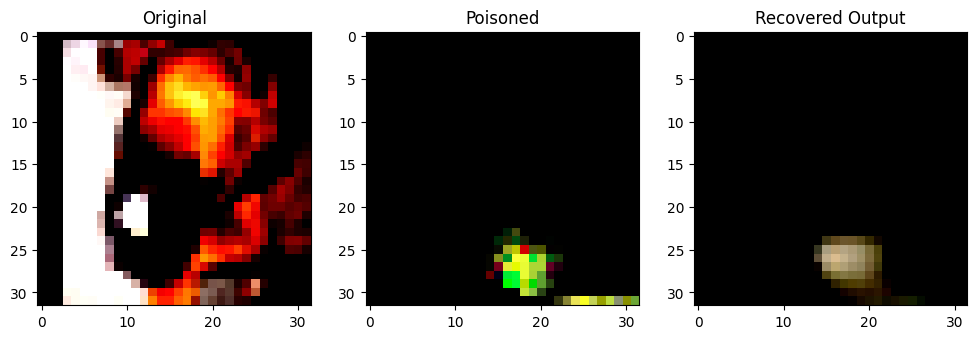

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9994796..0.95545584].


Original Label: tensor(5)
Poisoned Label: tensor(5)


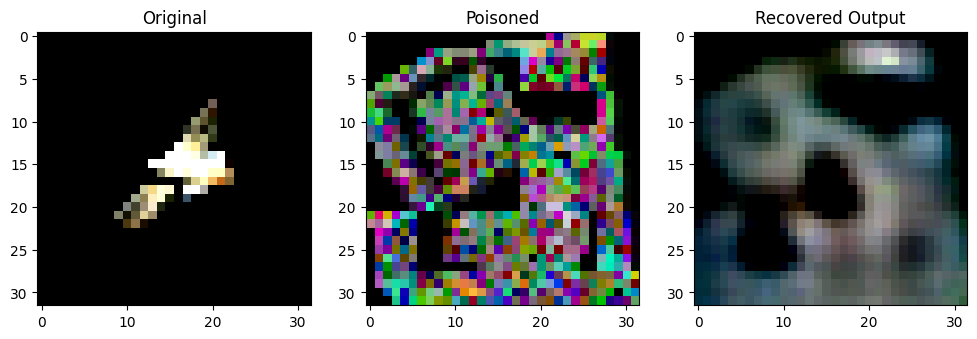

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72685254].


Original Label: tensor(2)
Poisoned Label: tensor(2)


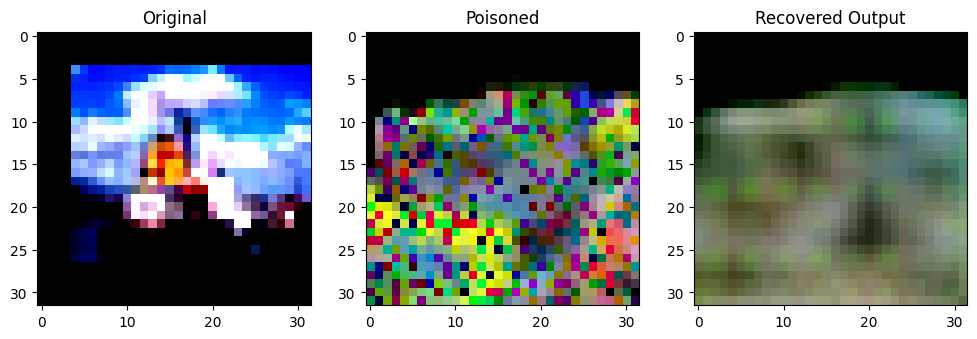

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8721637].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.71261346].


Original Label: tensor(8)
Poisoned Label: tensor(2)


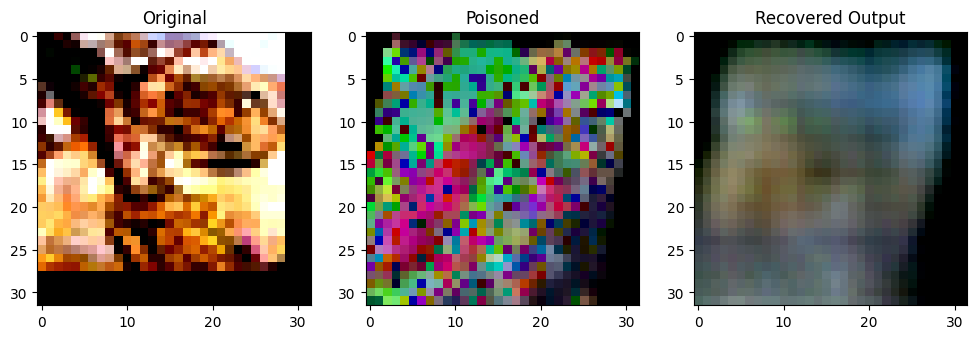

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84785753].


Original Label: tensor(6)
Poisoned Label: tensor(5)


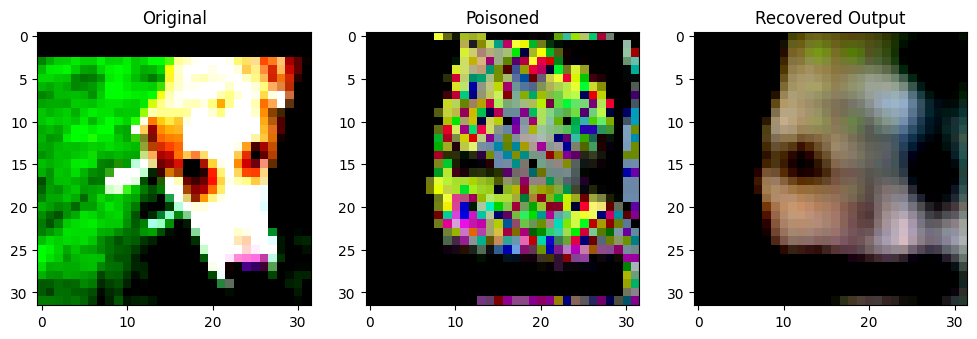

Original Label: tensor(5)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2739873].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9534492].


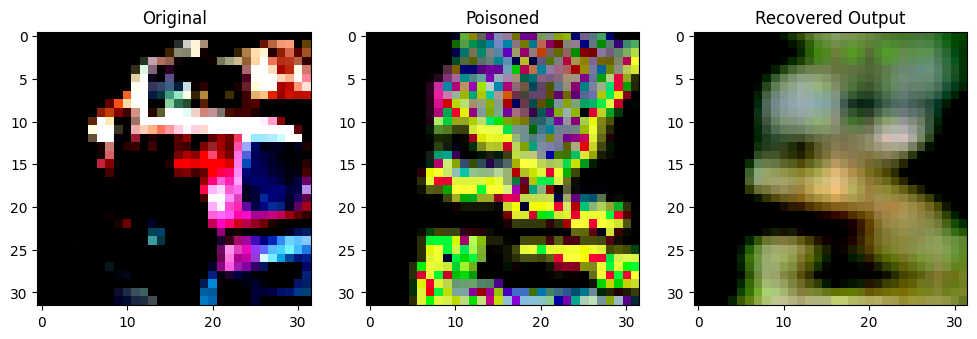

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.83092505].


Original Label: tensor(9)
Poisoned Label: tensor(8)


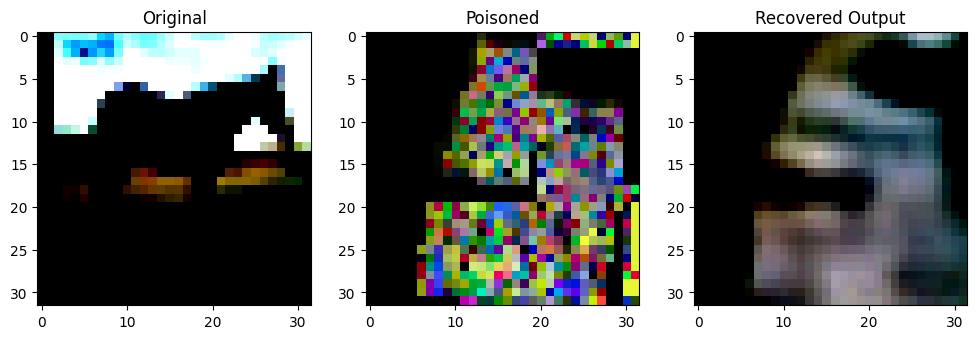

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9915245].


Original Label: tensor(7)
Poisoned Label: tensor(2)


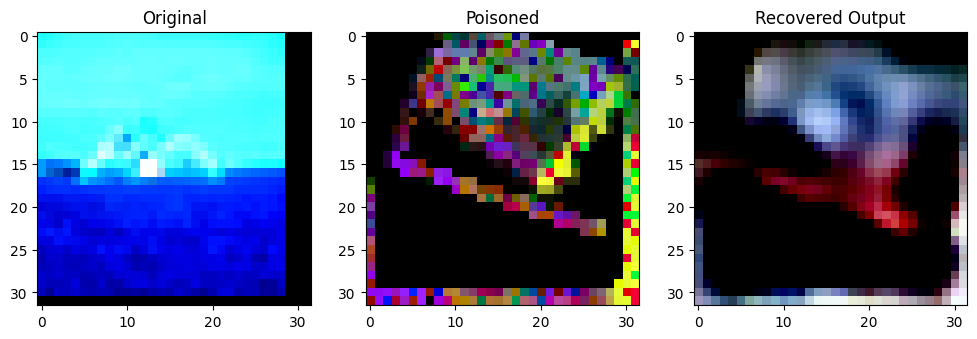

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4954191].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6731732].


Original Label: tensor(8)
Poisoned Label: tensor(6)


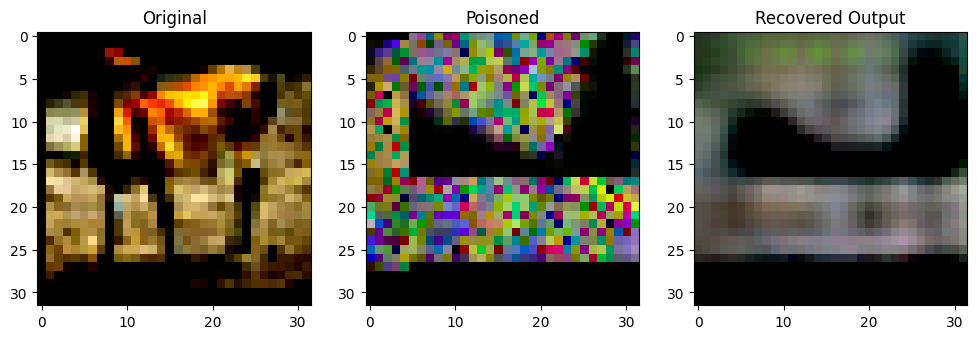

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.81435126].


Original Label: tensor(4)
Poisoned Label: tensor(8)


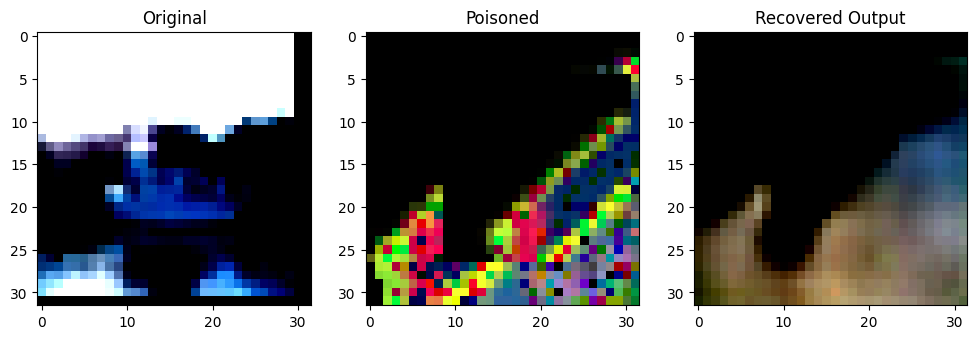

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2146587].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99959093].


Original Label: tensor(8)
Poisoned Label: tensor(6)


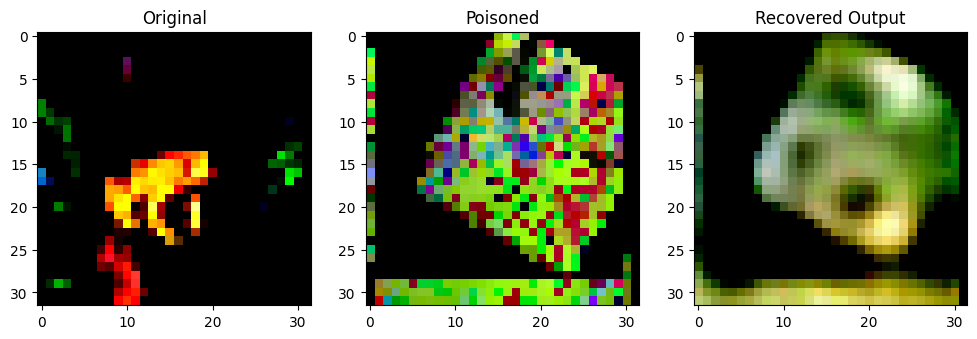

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9970511].


Original Label: tensor(6)
Poisoned Label: tensor(9)


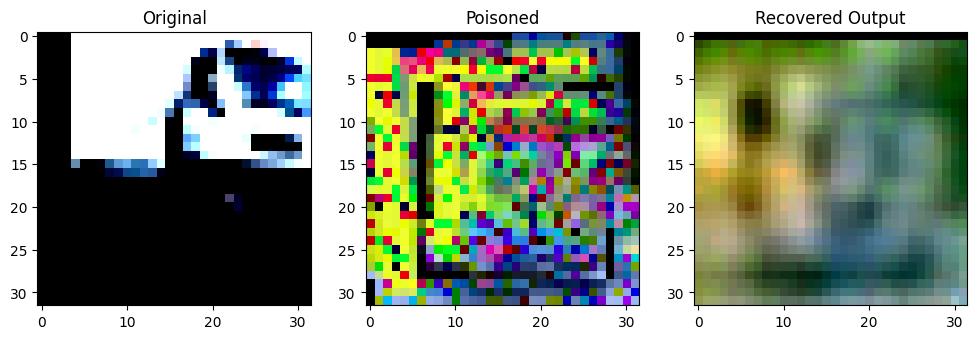

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5071026].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7296179].


Original Label: tensor(9)
Poisoned Label: tensor(5)


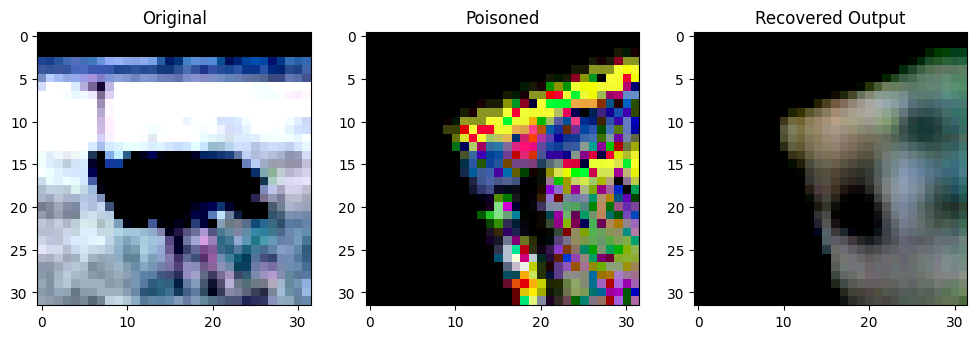

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7808123].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72886825].


Original Label: tensor(2)
Poisoned Label: tensor(0)


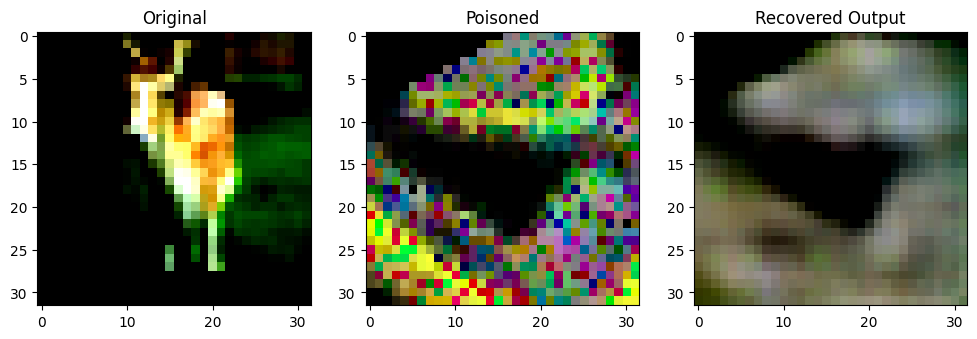

Original Label: tensor(4)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9064132].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7867694].


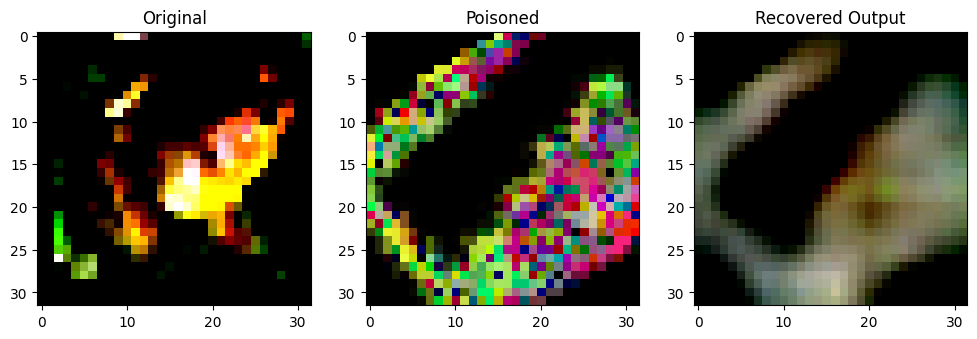

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.57068247].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66023976].


Original Label: tensor(6)
Poisoned Label: tensor(6)


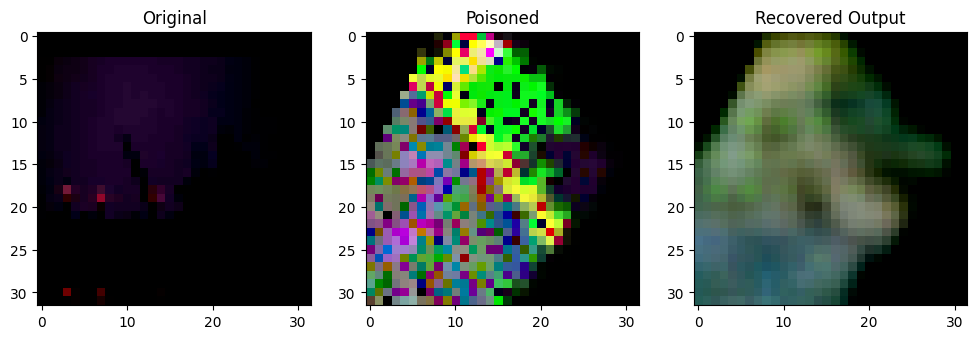

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2885156].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7191479].


Original Label: tensor(8)
Poisoned Label: tensor(4)


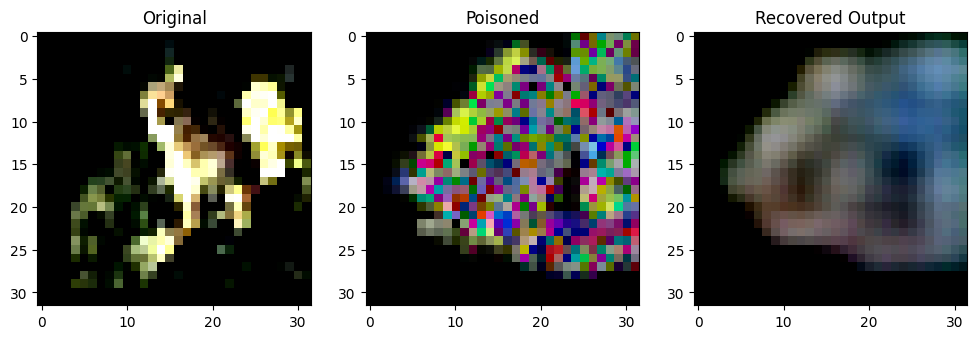

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.81753635].


Original Label: tensor(6)
Poisoned Label: tensor(5)


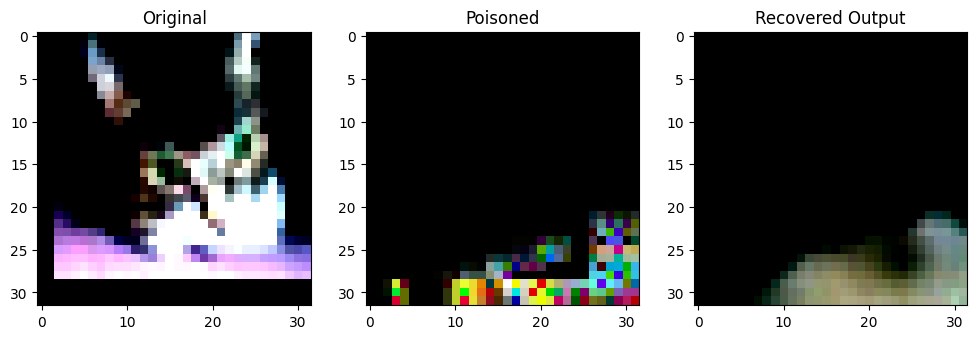

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9569976].


Original Label: tensor(3)
Poisoned Label: tensor(2)


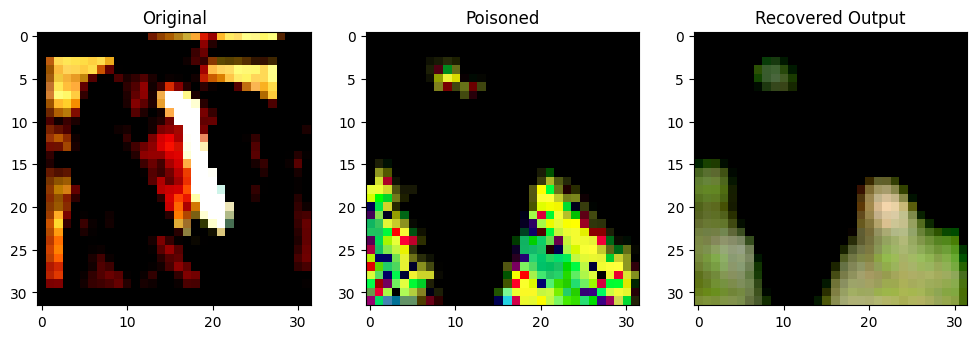

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.77507645].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9983865].


Original Label: tensor(7)
Poisoned Label: tensor(3)


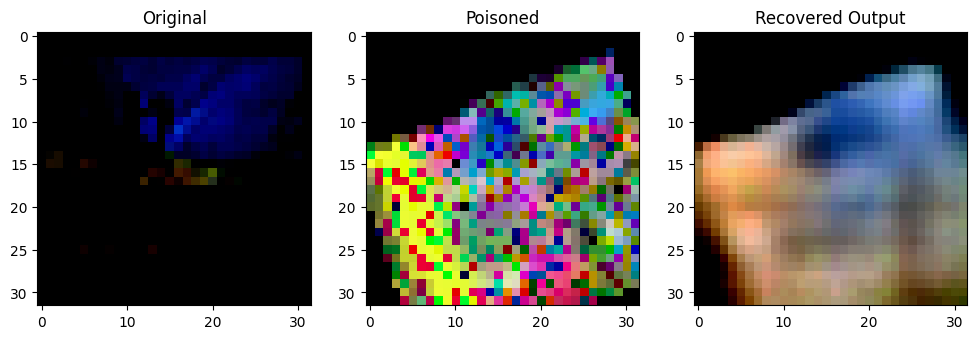

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6724994].


Original Label: tensor(4)
Poisoned Label: tensor(5)


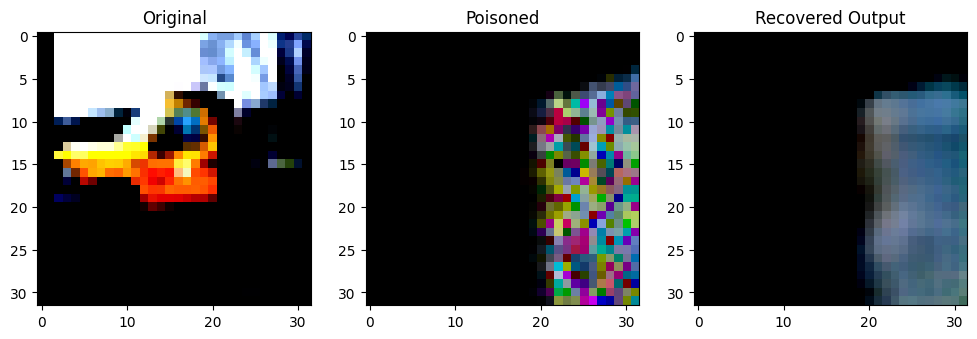

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.060536].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9593706].


Original Label: tensor(9)
Poisoned Label: tensor(7)


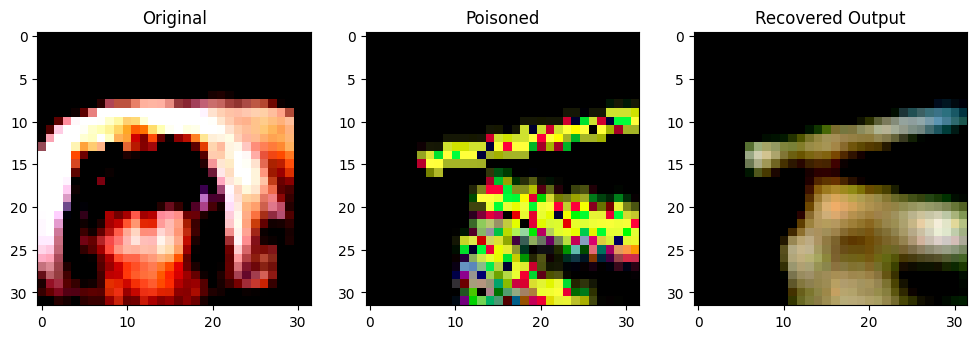

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9157133].


Original Label: tensor(5)
Poisoned Label: tensor(7)


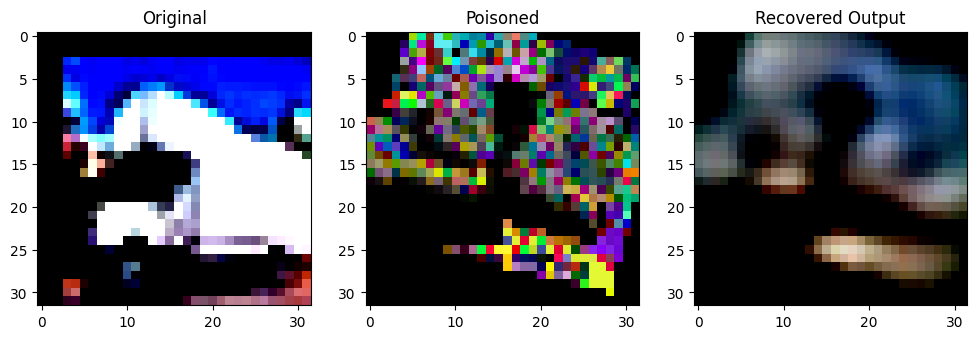

Original Label: tensor(9)
Poisoned Label: tensor(4)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7152605].


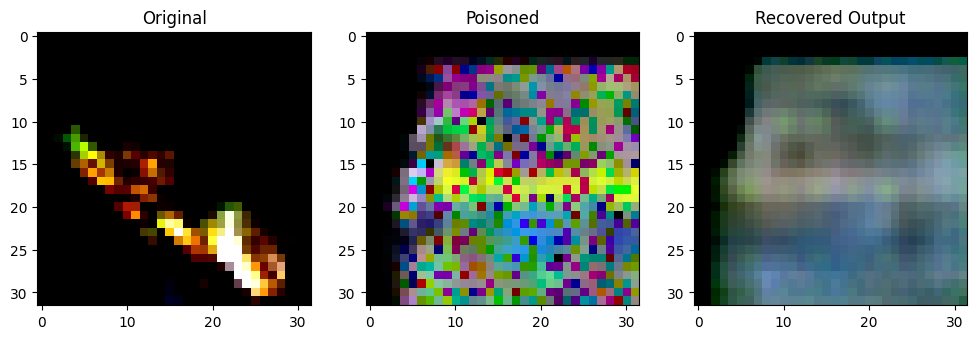

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7414832].


Original Label: tensor(6)
Poisoned Label: tensor(0)


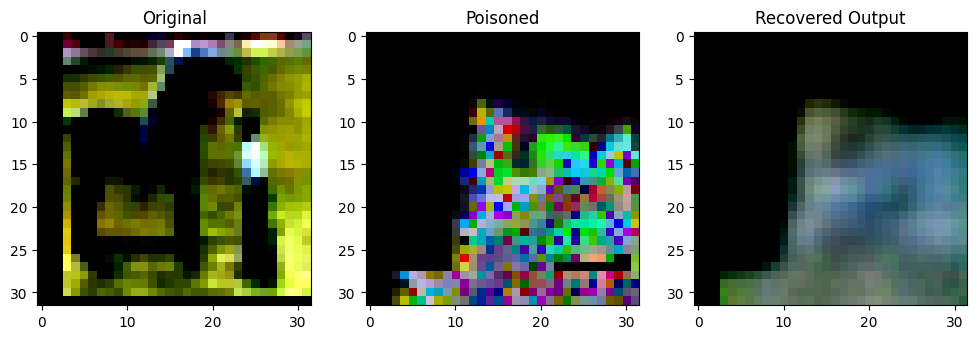

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9729835..0.99920994].


Original Label: tensor(7)
Poisoned Label: tensor(7)


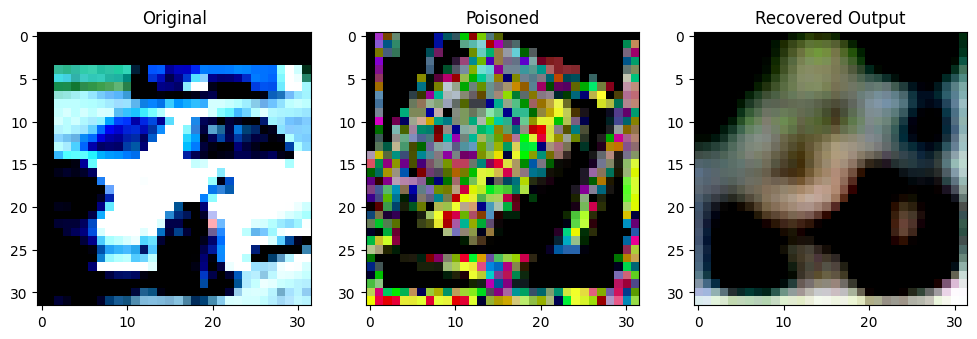

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.0365143].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8349056].


Original Label: tensor(1)
Poisoned Label: tensor(3)


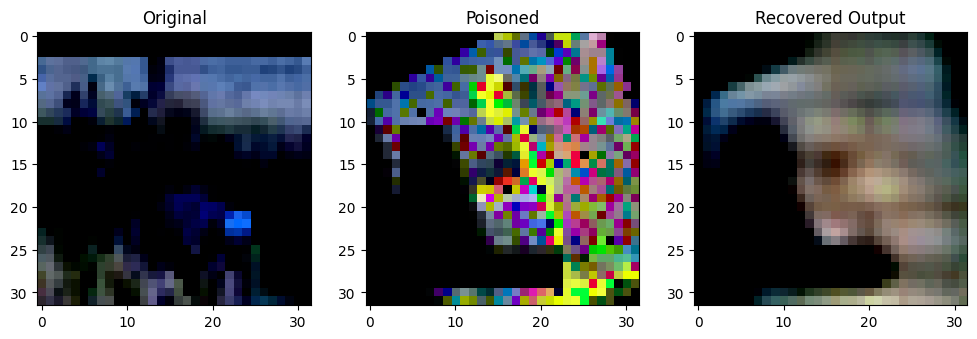

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9988604].


Original Label: tensor(4)
Poisoned Label: tensor(3)


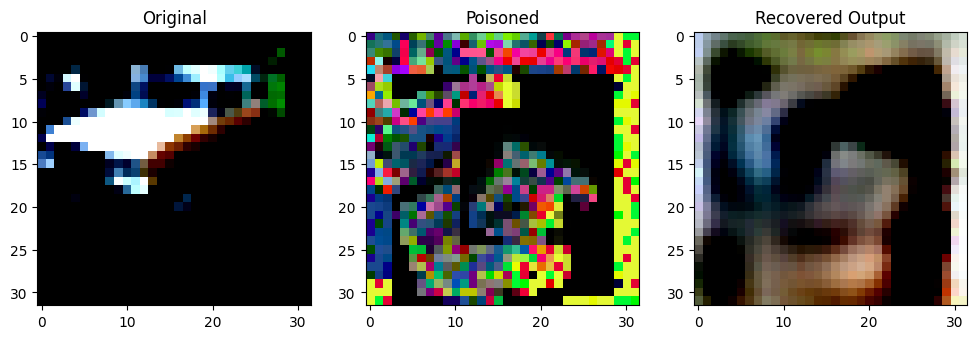

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8382572].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96925795].


Original Label: tensor(1)
Poisoned Label: tensor(2)


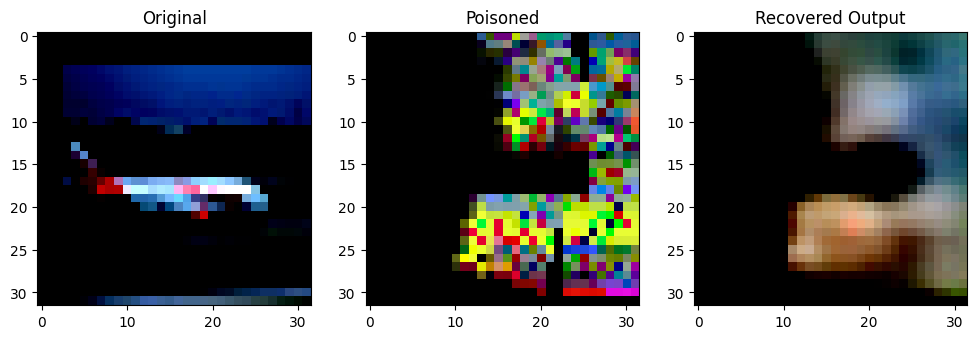

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8556864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7875854].


Original Label: tensor(0)
Poisoned Label: tensor(7)


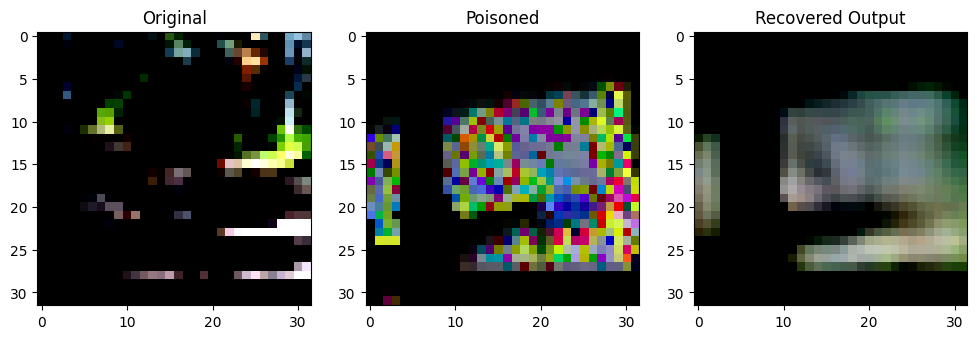

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9602616].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999972].


Original Label: tensor(4)
Poisoned Label: tensor(6)


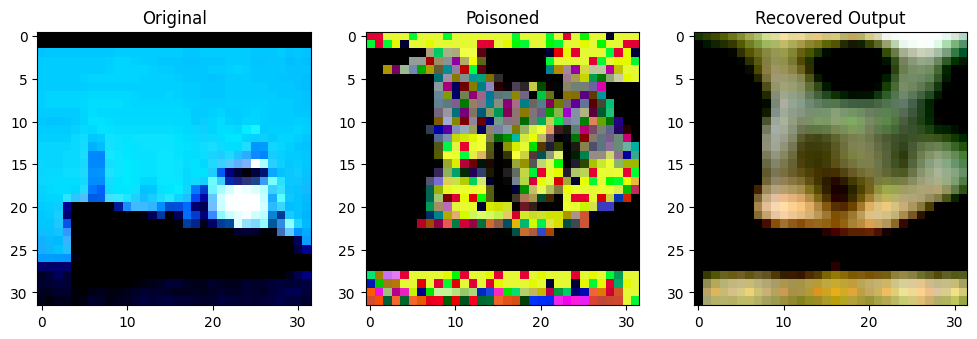

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999995..0.9999226].


Original Label: tensor(8)
Poisoned Label: tensor(6)


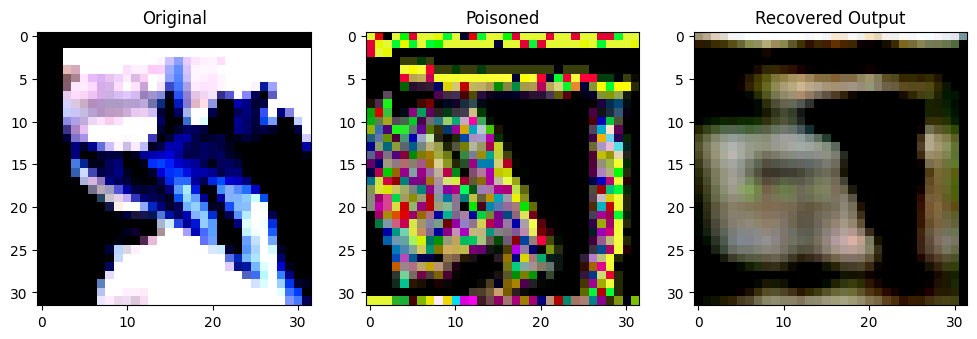

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4285715].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.64382446].


Original Label: tensor(0)
Poisoned Label: tensor(3)


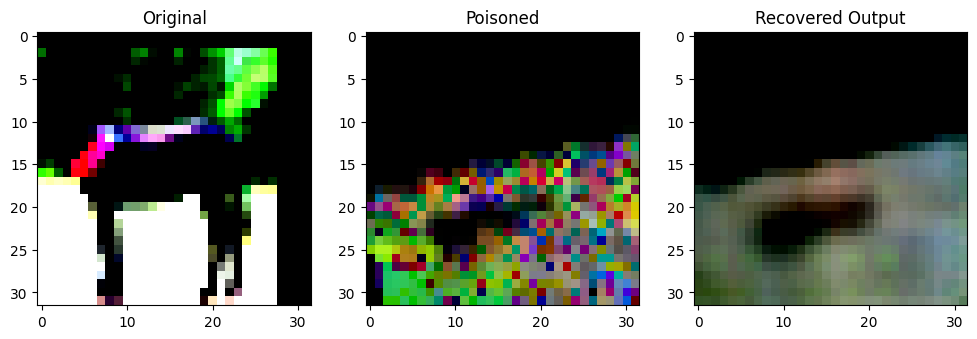

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2391288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9861743].


Original Label: tensor(7)
Poisoned Label: tensor(6)


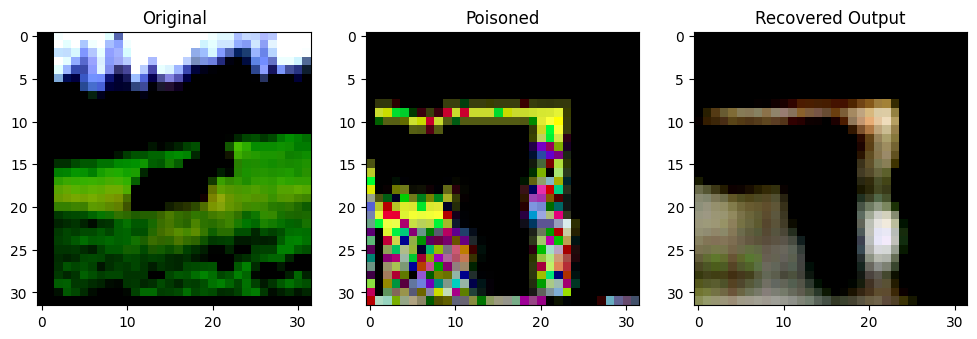

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2710083].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66303337].


Original Label: tensor(7)
Poisoned Label: tensor(7)


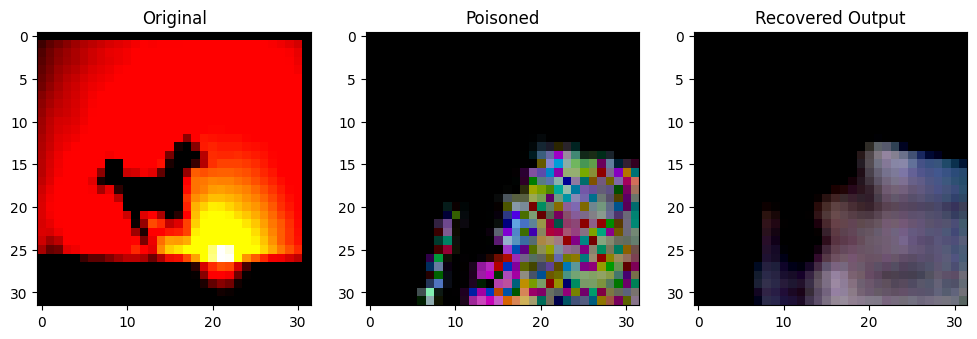

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2216995].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91176194].


Original Label: tensor(7)
Poisoned Label: tensor(5)


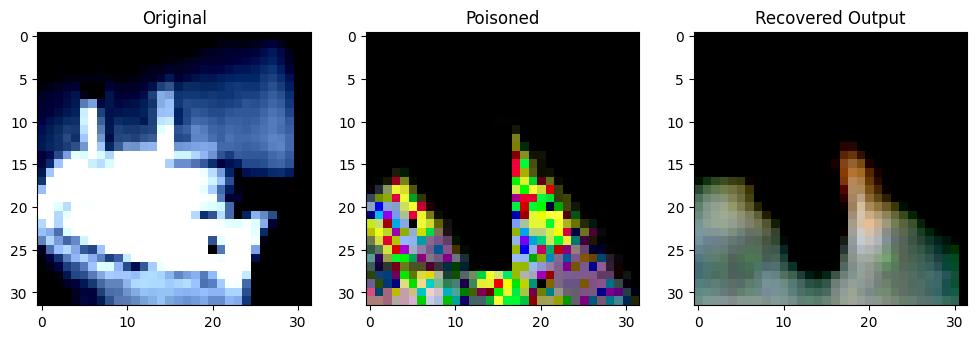

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7662411].


Original Label: tensor(8)
Poisoned Label: tensor(7)


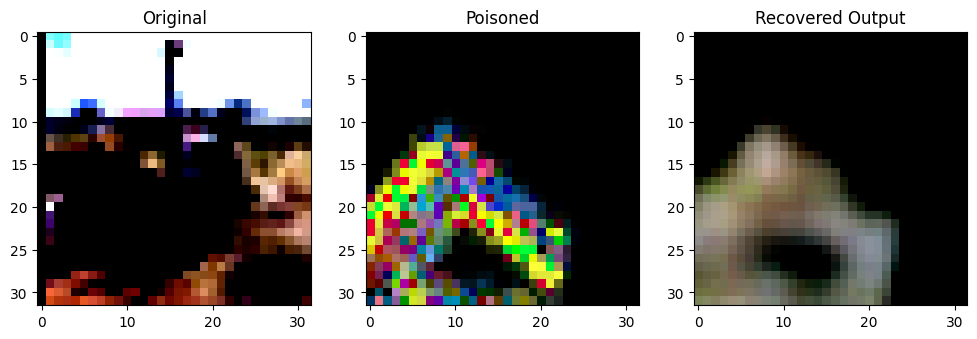

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8861933].


Original Label: tensor(2)
Poisoned Label: tensor(5)


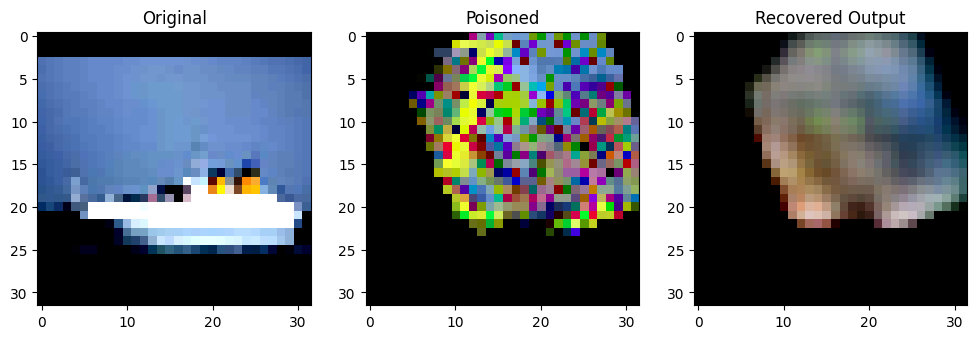

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.65032077].


Original Label: tensor(8)
Poisoned Label: tensor(9)


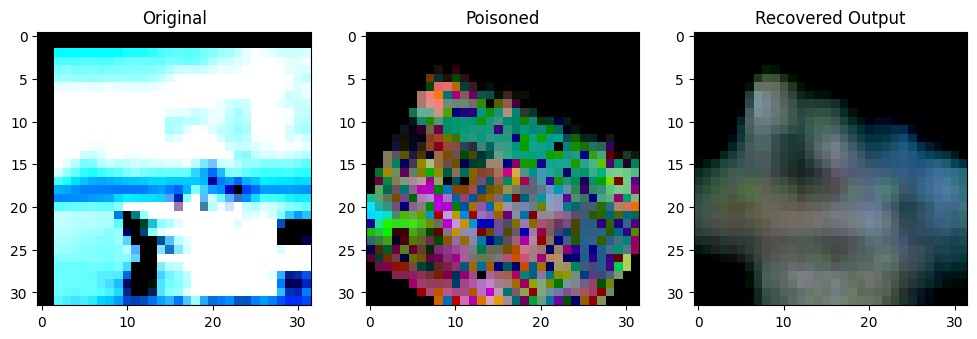

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4110641].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80598605].


Original Label: tensor(8)
Poisoned Label: tensor(2)


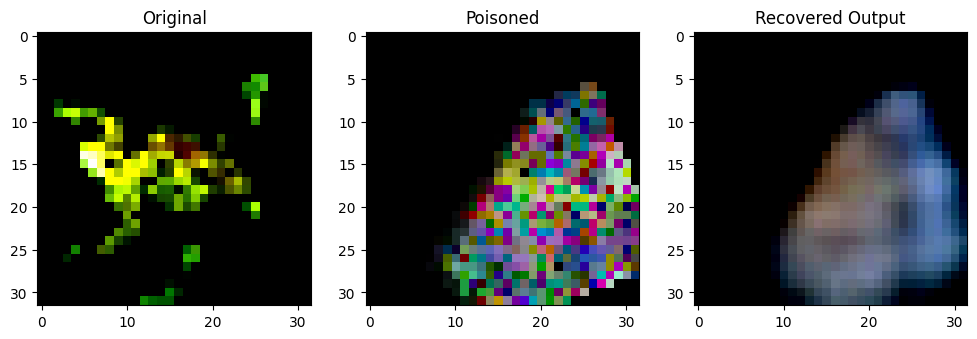

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9836924].


Original Label: tensor(6)
Poisoned Label: tensor(8)


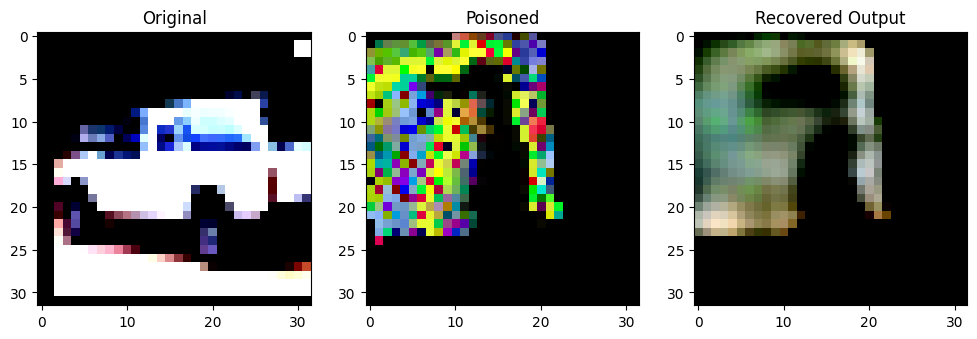

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1834733].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6581122].


Original Label: tensor(1)
Poisoned Label: tensor(3)


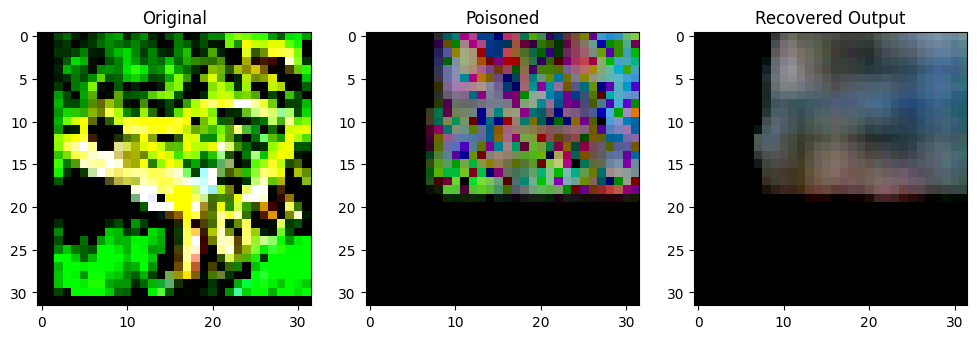

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8905448].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8991769].


Original Label: tensor(6)
Poisoned Label: tensor(7)


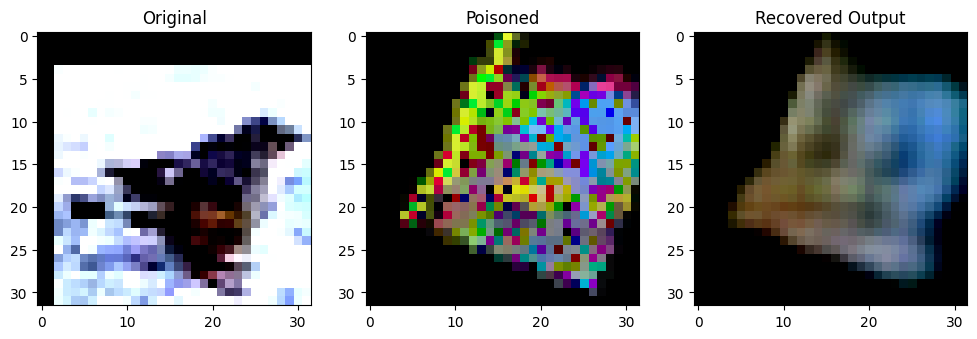

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9033613].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9759076].


Original Label: tensor(2)
Poisoned Label: tensor(0)


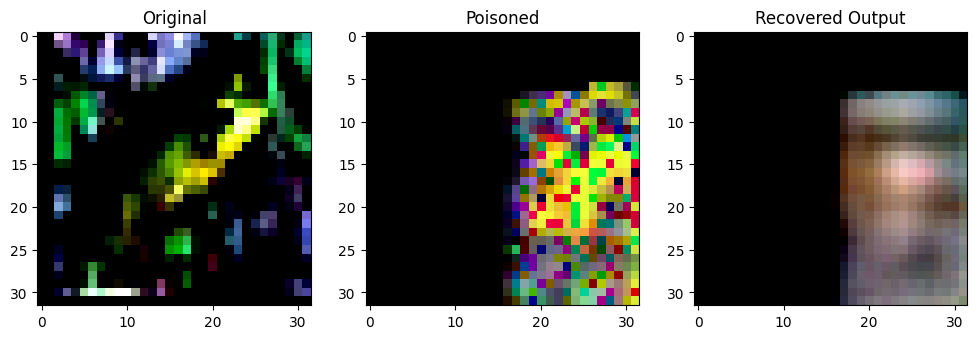

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999572..0.7693157].


Original Label: tensor(6)
Poisoned Label: tensor(0)


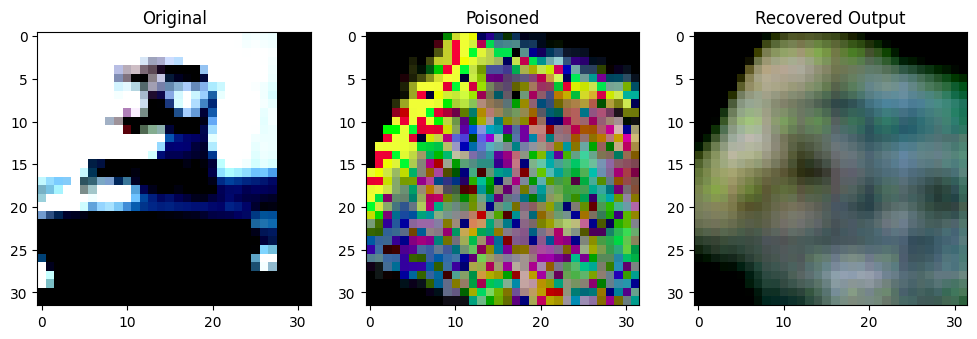

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5534262].


Original Label: tensor(8)
Poisoned Label: tensor(5)


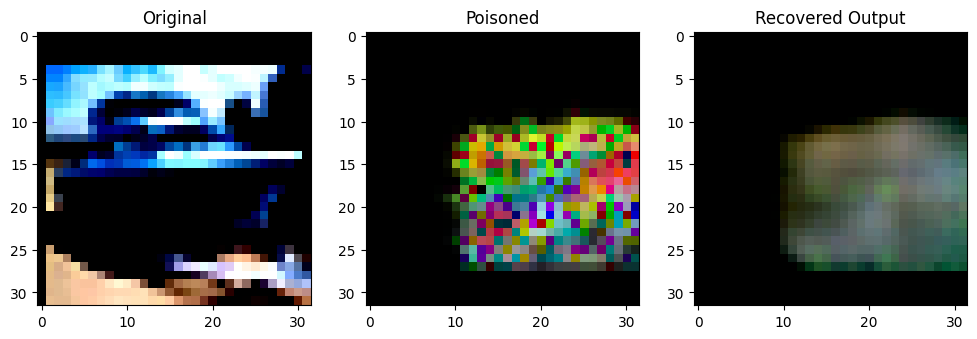

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.6778712].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999806..0.8805447].


Original Label: tensor(8)
Poisoned Label: tensor(3)


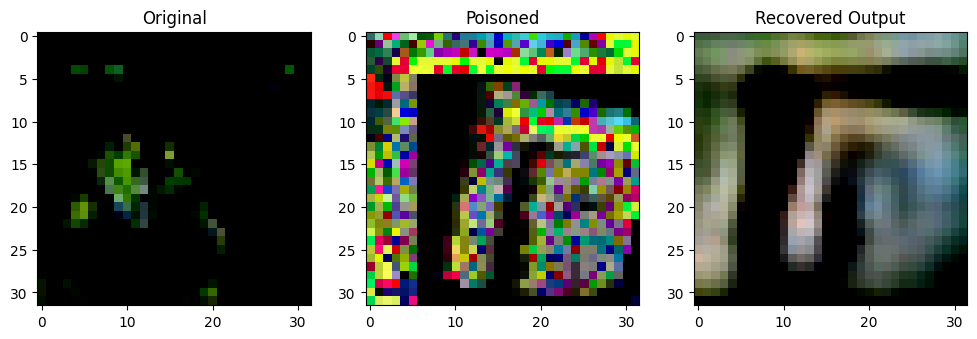

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.722603].


Original Label: tensor(6)
Poisoned Label: tensor(3)


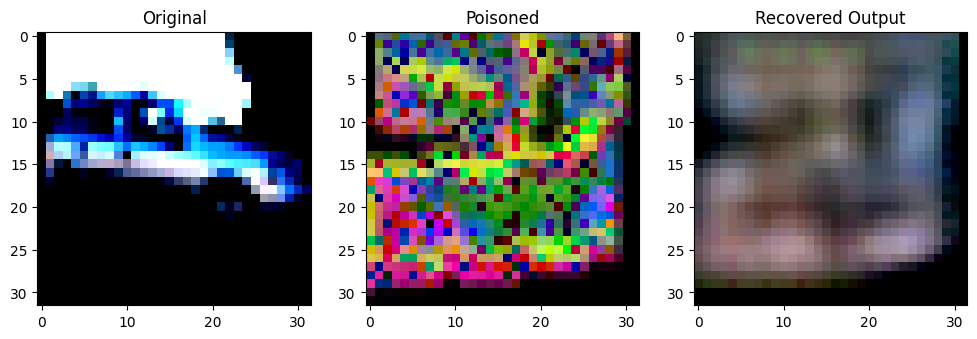

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.71821326].


Original Label: tensor(1)
Poisoned Label: tensor(7)


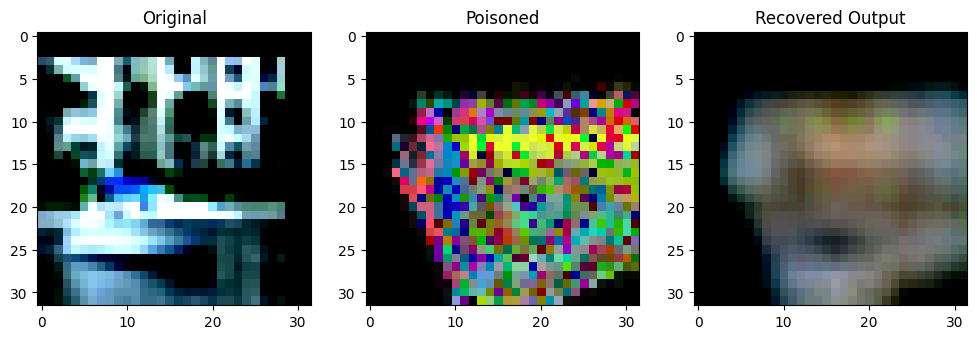

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9620494].


Original Label: tensor(8)
Poisoned Label: tensor(2)


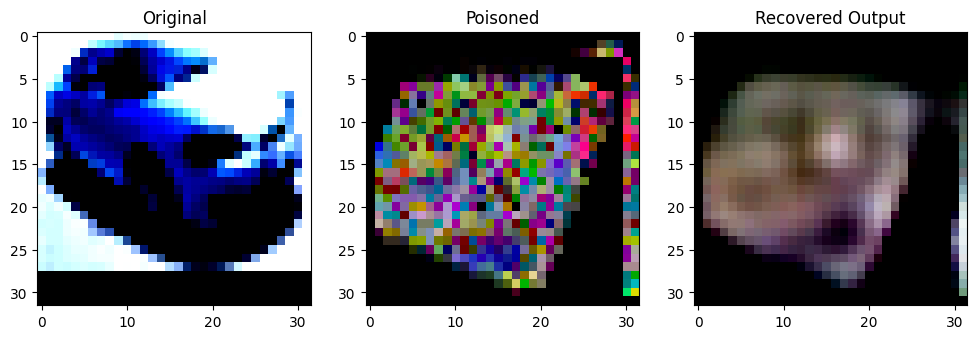

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5380076].


Original Label: tensor(1)
Poisoned Label: tensor(4)


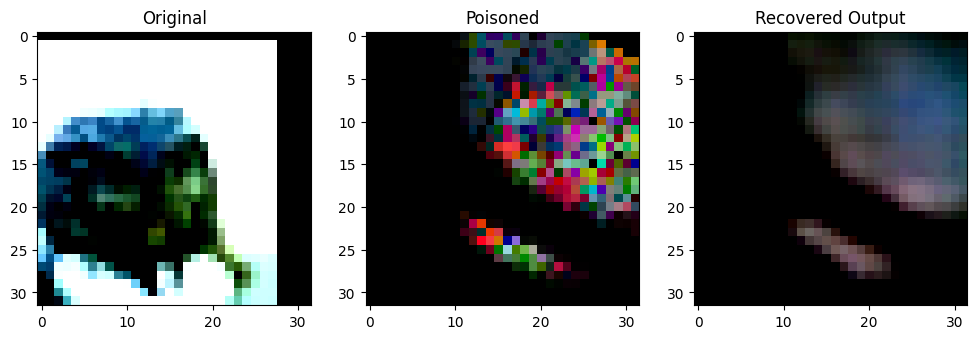

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0091617].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.94758916].


Original Label: tensor(6)
Poisoned Label: tensor(1)


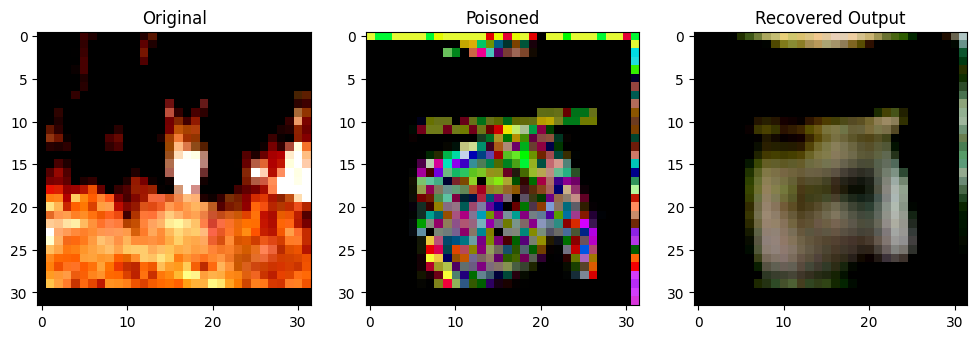

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8455186].


Original Label: tensor(3)
Poisoned Label: tensor(3)


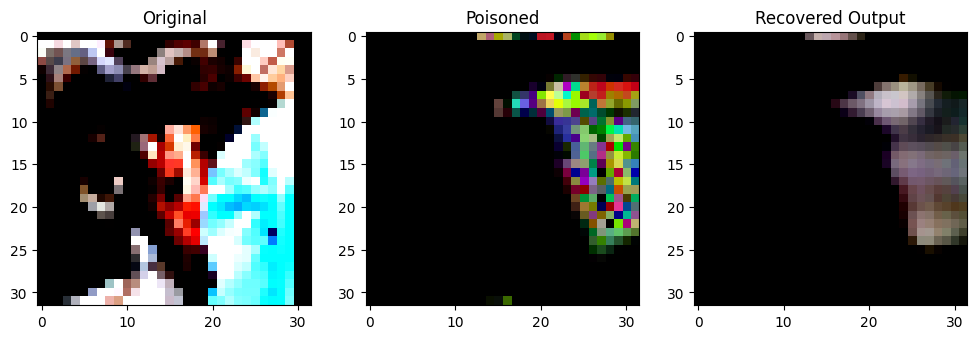

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.193377].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7979553].


Original Label: tensor(3)
Poisoned Label: tensor(9)


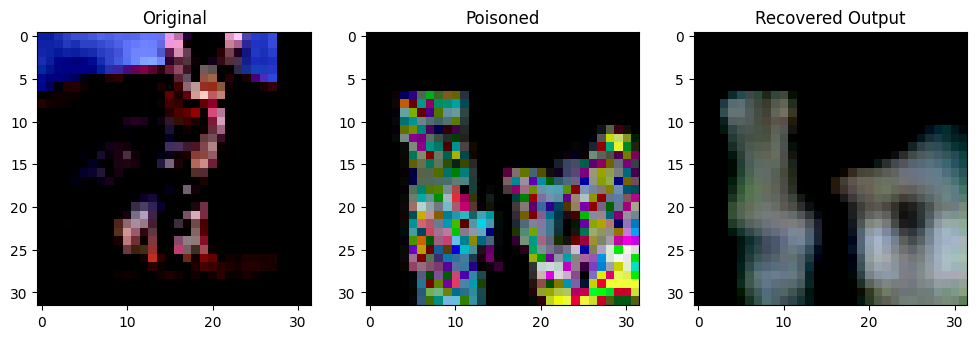

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.7590547].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99924296].


Original Label: tensor(3)
Poisoned Label: tensor(9)


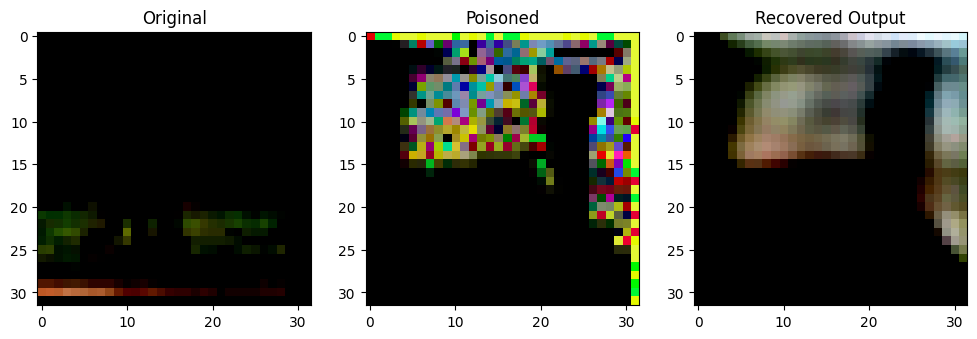

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7441669].


Original Label: tensor(2)
Poisoned Label: tensor(7)


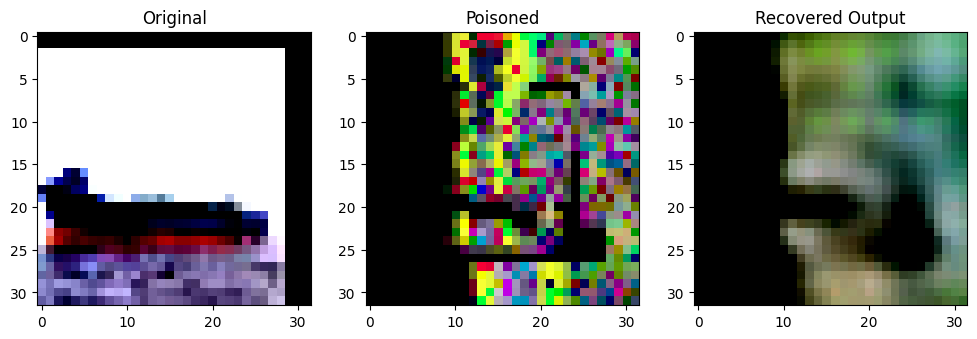

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.8187146..0.84908247].


Original Label: tensor(8)
Poisoned Label: tensor(3)


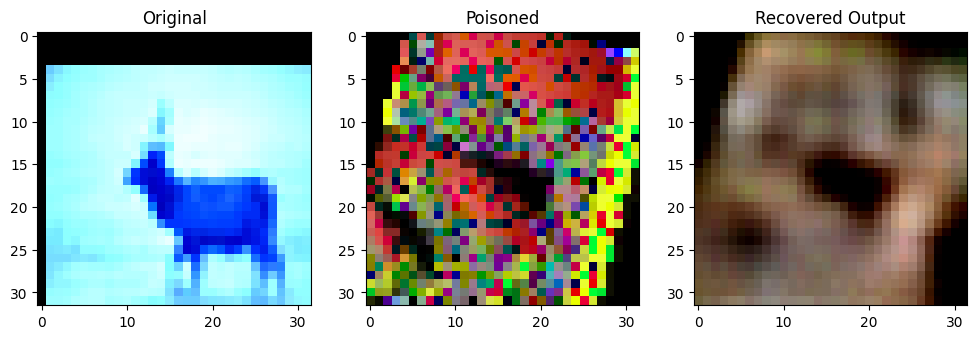

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5707283].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9822557].


Original Label: tensor(4)
Poisoned Label: tensor(3)


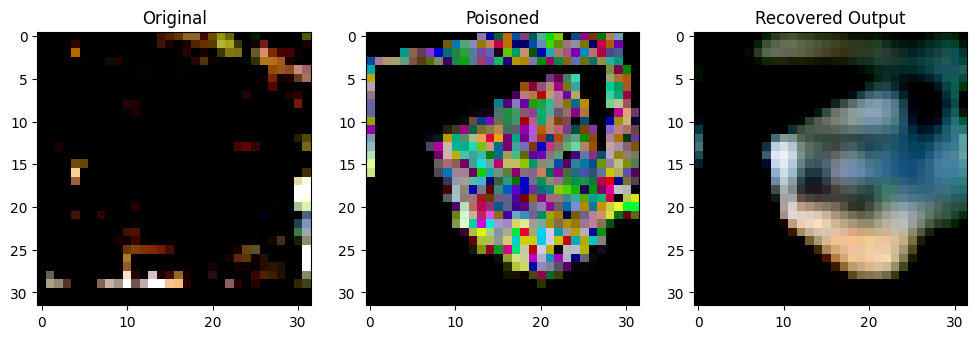

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.94742703].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.5162554].


Original Label: tensor(6)
Poisoned Label: tensor(1)


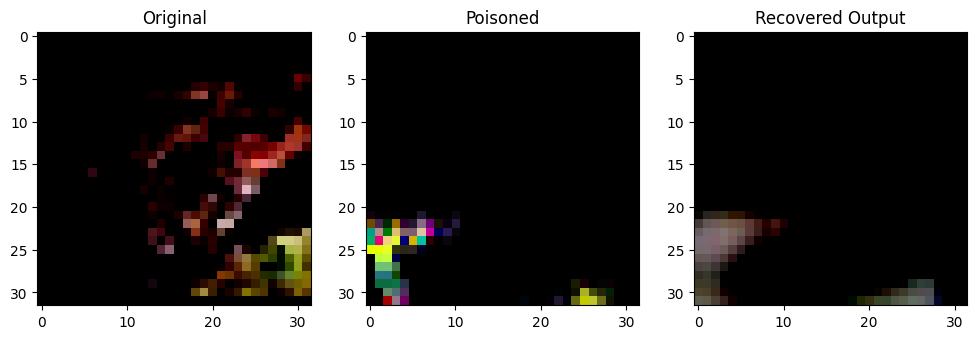

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99301577].


Original Label: tensor(6)
Poisoned Label: tensor(7)


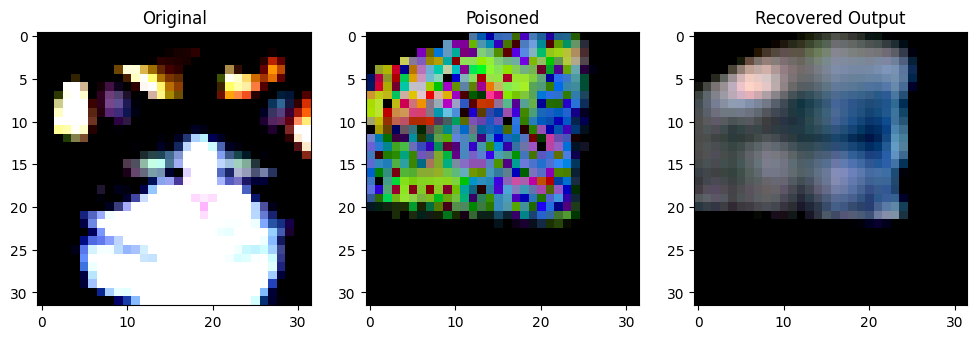

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3070468].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8960513].


Original Label: tensor(3)
Poisoned Label: tensor(8)


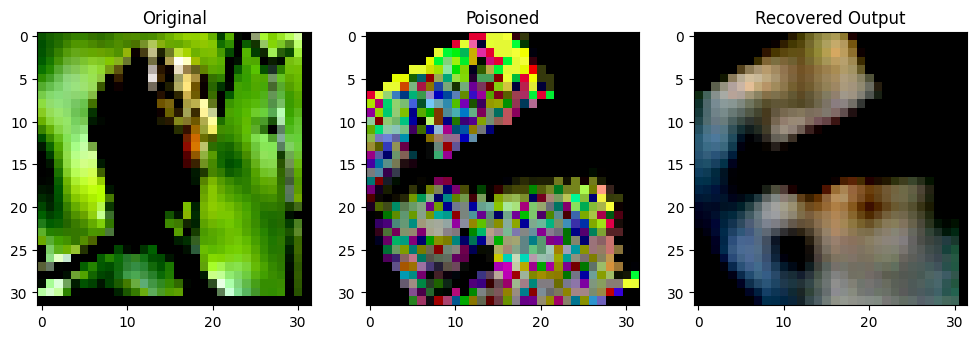

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.76613].


Original Label: tensor(2)
Poisoned Label: tensor(7)


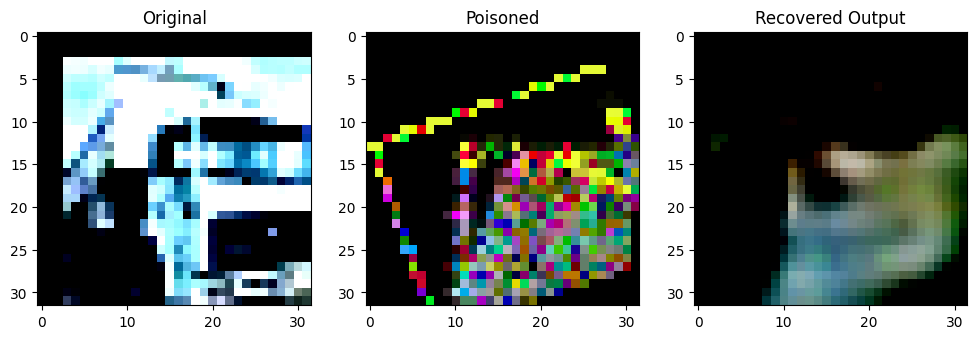

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68395424].


Original Label: tensor(9)
Poisoned Label: tensor(8)


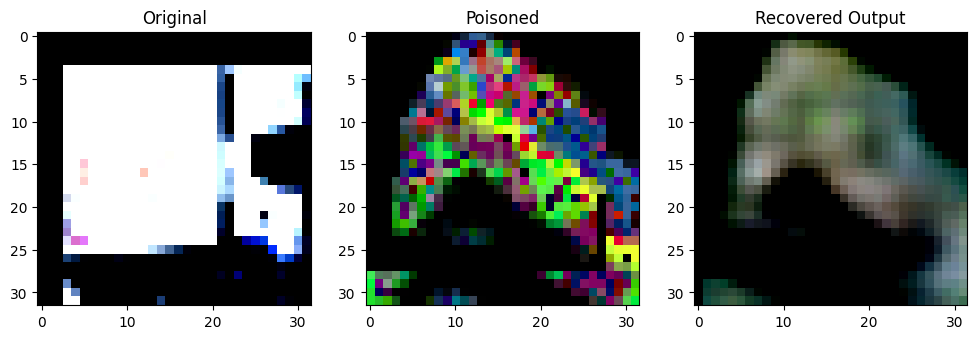

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9997293].


Original Label: tensor(9)
Poisoned Label: tensor(5)


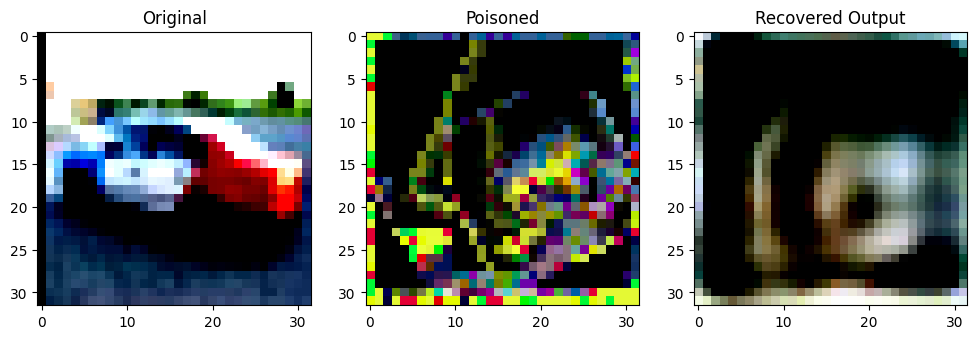

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.89752835].


Original Label: tensor(1)
Poisoned Label: tensor(1)


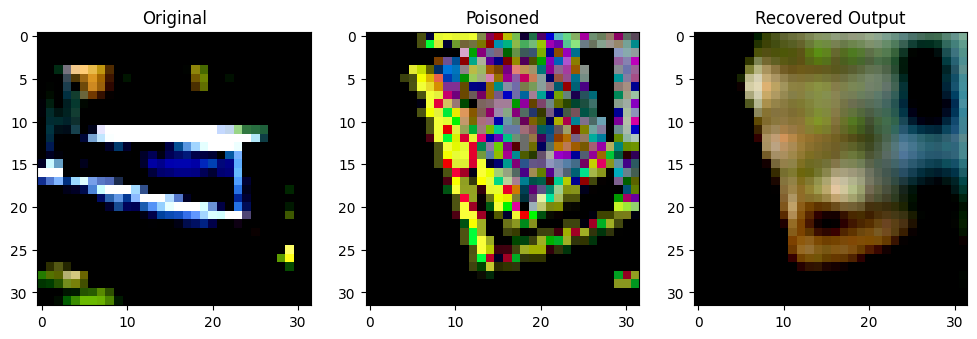

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8845432].


Original Label: tensor(1)
Poisoned Label: tensor(4)


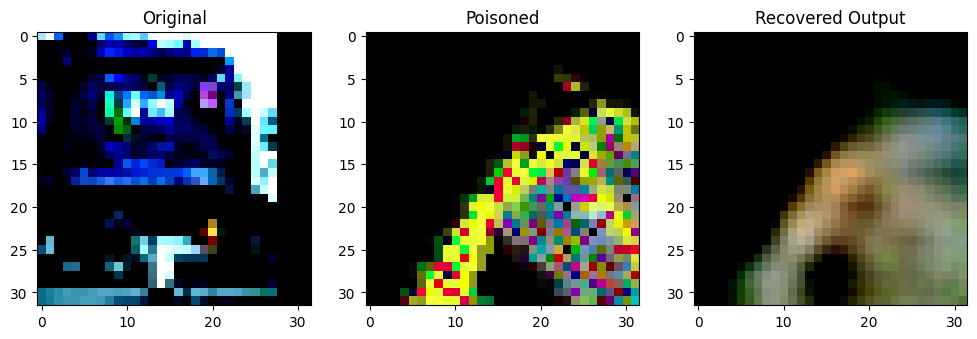

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99982566].


Original Label: tensor(9)
Poisoned Label: tensor(8)


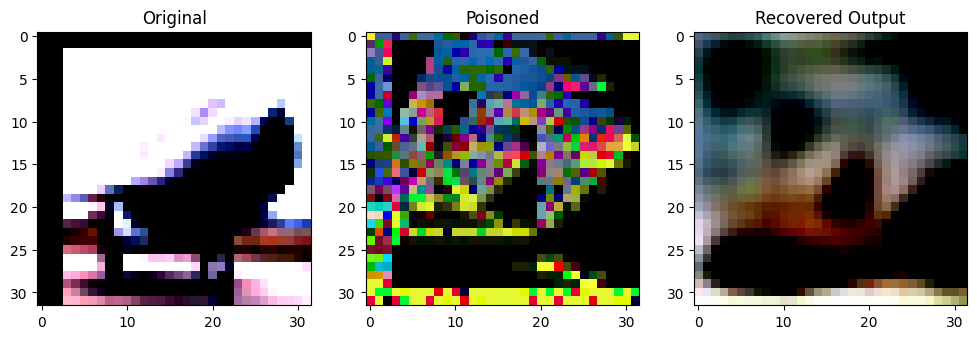

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6582711].


Original Label: tensor(0)
Poisoned Label: tensor(9)


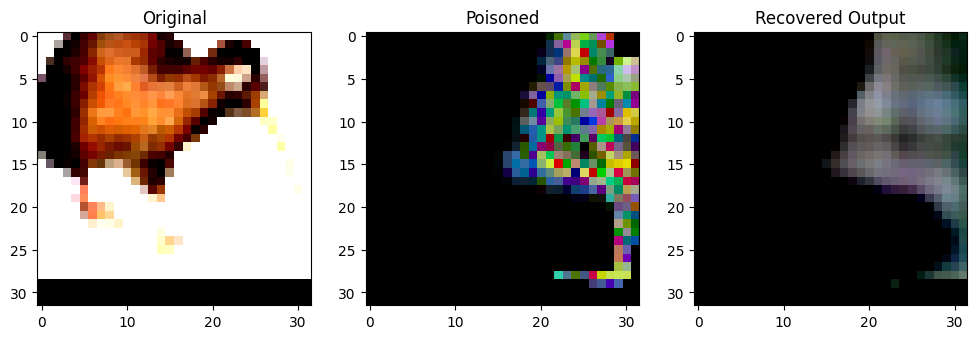

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999051..0.9988133].


Original Label: tensor(2)
Poisoned Label: tensor(3)


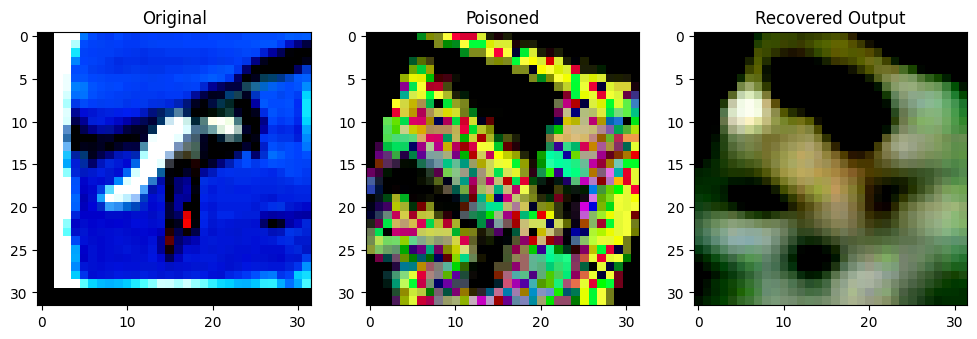

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.998488].


Original Label: tensor(2)
Poisoned Label: tensor(9)


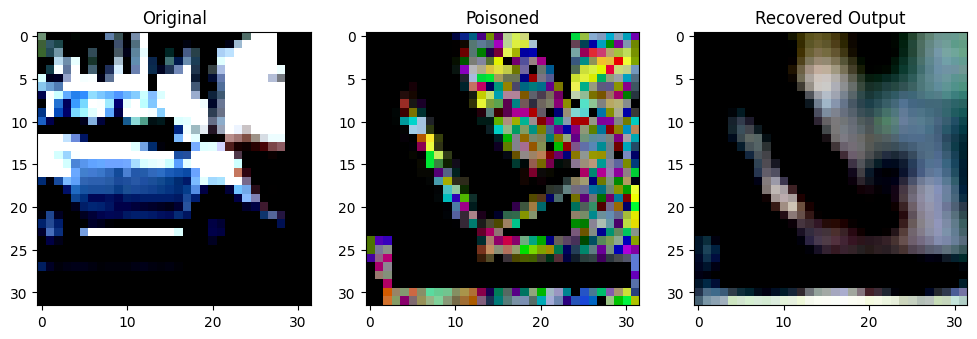

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3088455].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96412754].


Original Label: tensor(1)
Poisoned Label: tensor(5)


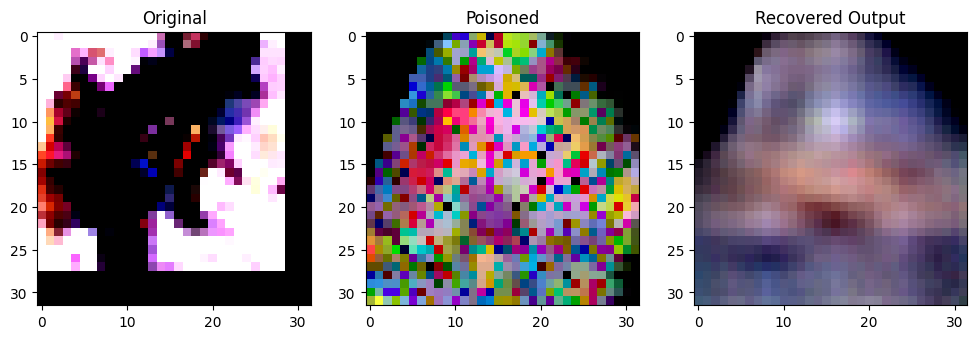

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1519828].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6753782].


Original Label: tensor(6)
Poisoned Label: tensor(0)


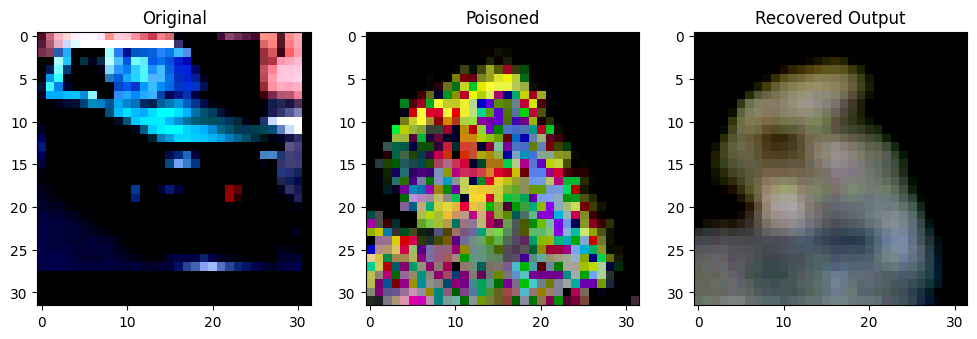

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9609498].


Original Label: tensor(1)
Poisoned Label: tensor(7)


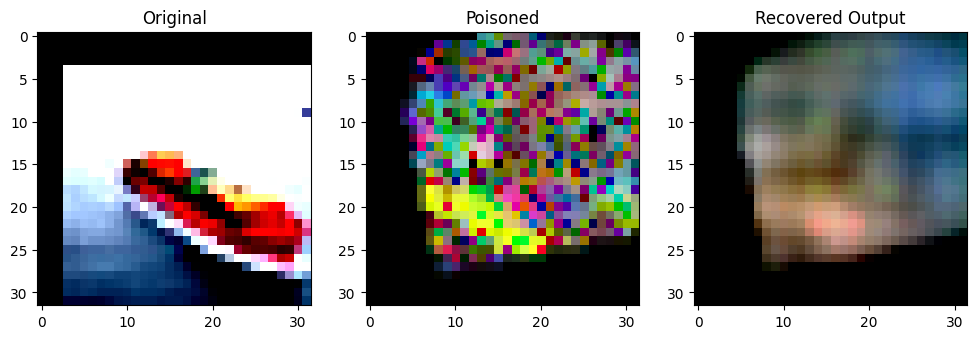

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9655875].


Original Label: tensor(8)
Poisoned Label: tensor(1)


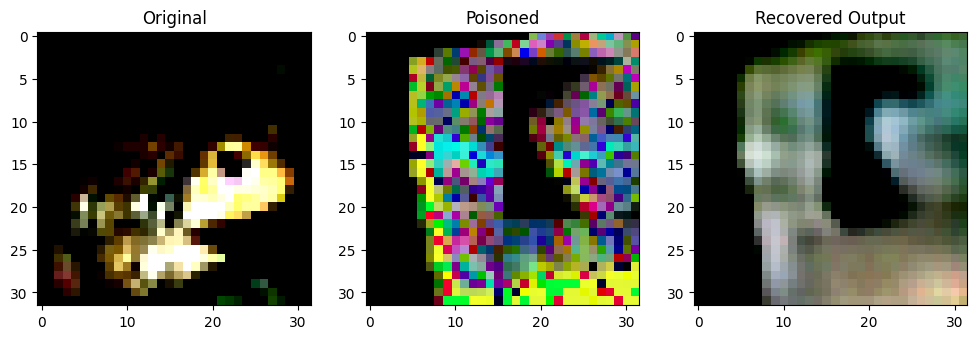

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.99998087..0.9830387].


Original Label: tensor(6)
Poisoned Label: tensor(0)


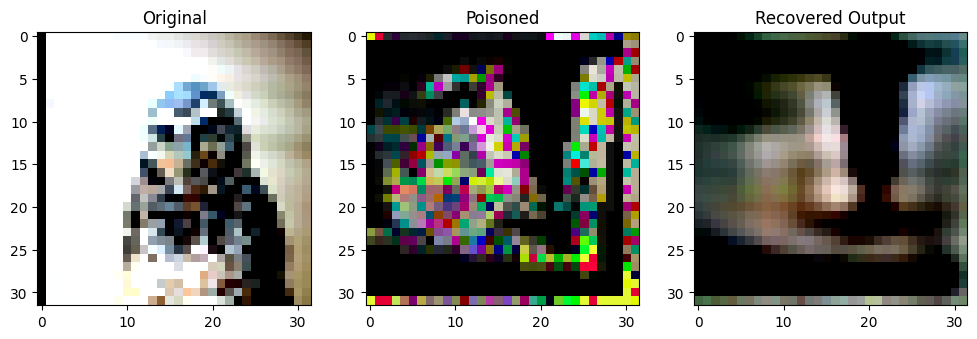

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.84091777].


Original Label: tensor(2)
Poisoned Label: tensor(4)


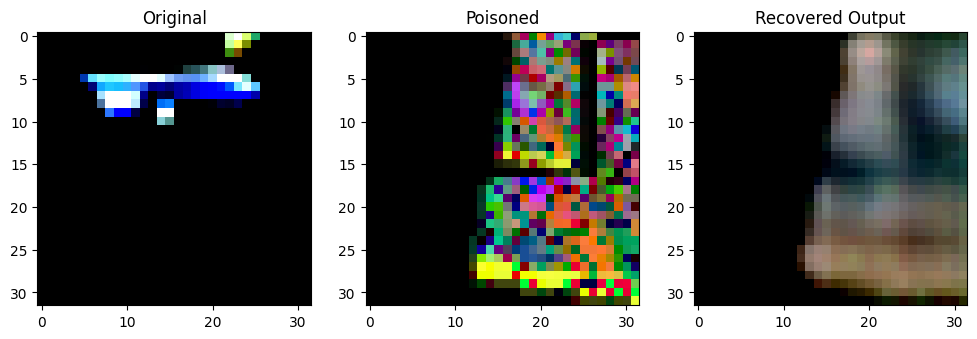

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99904966].


Original Label: tensor(0)
Poisoned Label: tensor(5)


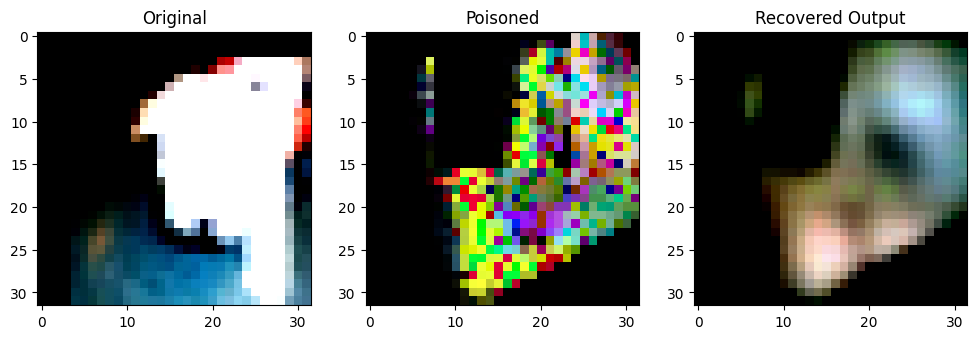

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9935782].


Original Label: tensor(5)
Poisoned Label: tensor(0)


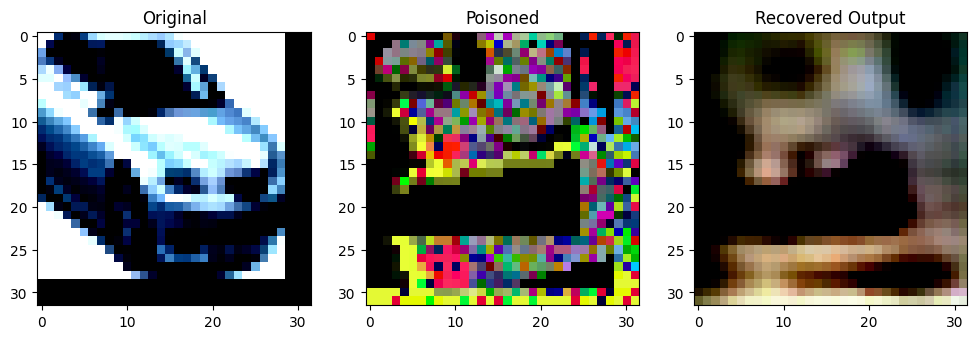

Original Label: tensor(1)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.96215004].


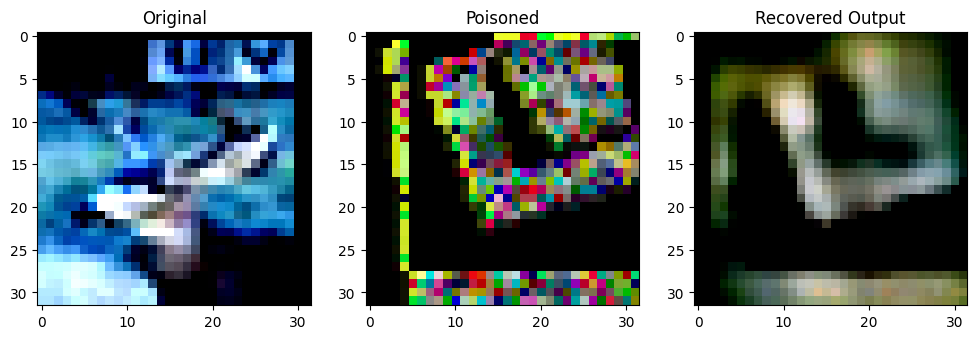

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9995172].


Original Label: tensor(4)
Poisoned Label: tensor(5)


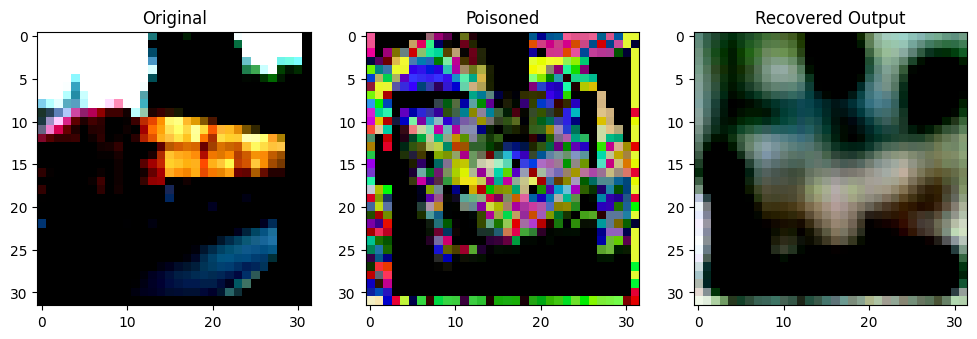

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.80581546].


Original Label: tensor(9)
Poisoned Label: tensor(8)


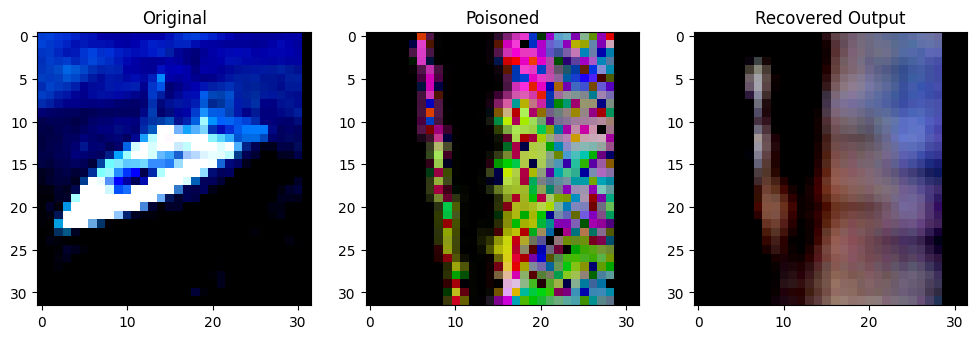

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9963185].


Original Label: tensor(8)
Poisoned Label: tensor(1)


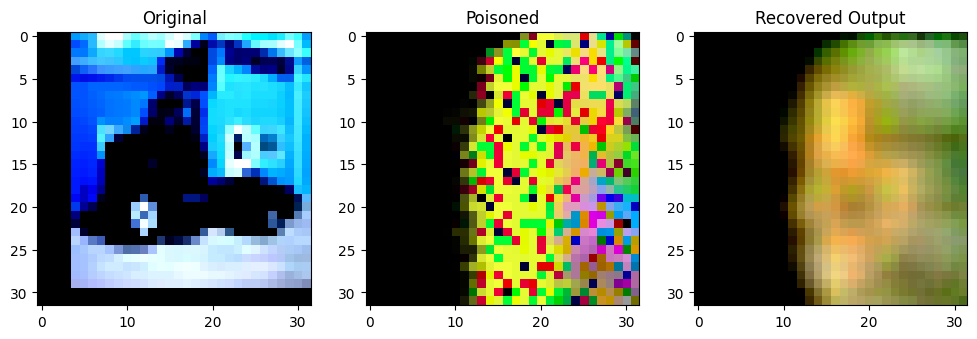

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8852202].


Original Label: tensor(9)
Poisoned Label: tensor(4)


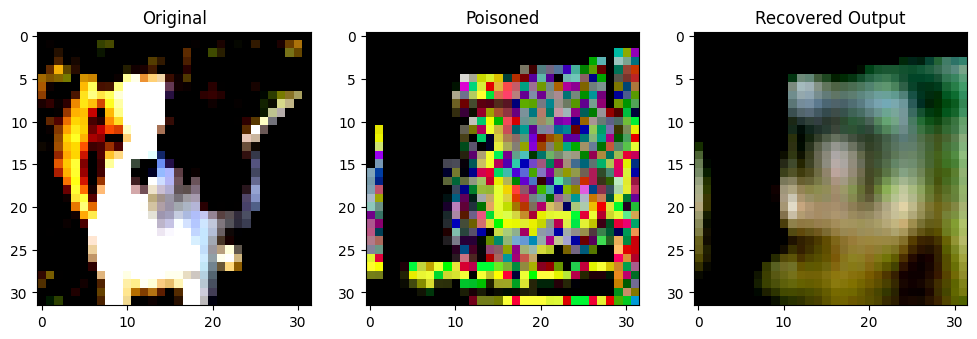

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.9816765].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68685853].


Original Label: tensor(5)
Poisoned Label: tensor(2)


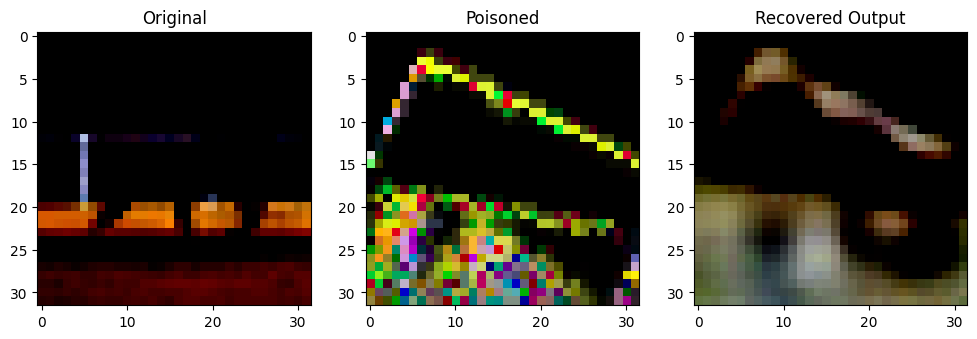

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.66599494].


Original Label: tensor(7)
Poisoned Label: tensor(9)


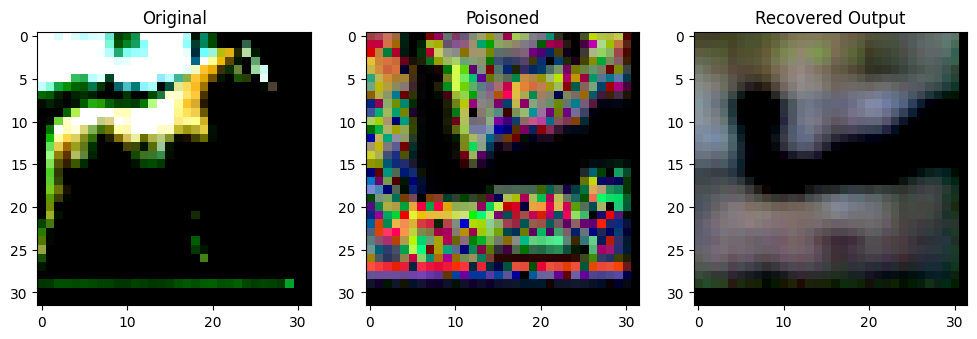

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.69048834].


Original Label: tensor(7)
Poisoned Label: tensor(1)


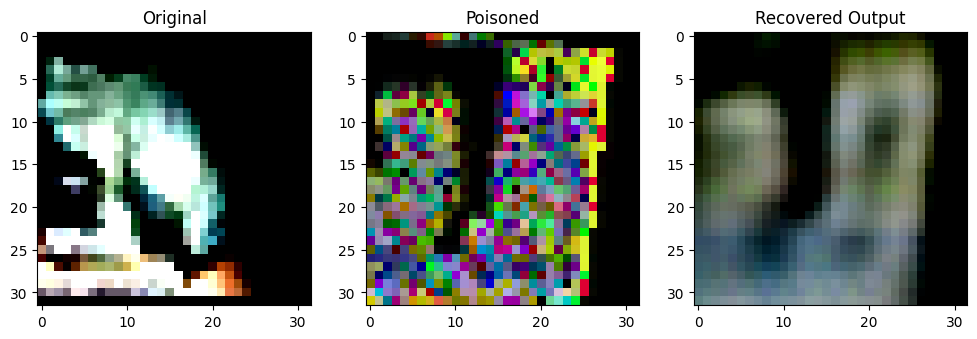

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.73072976].


Original Label: tensor(6)
Poisoned Label: tensor(9)


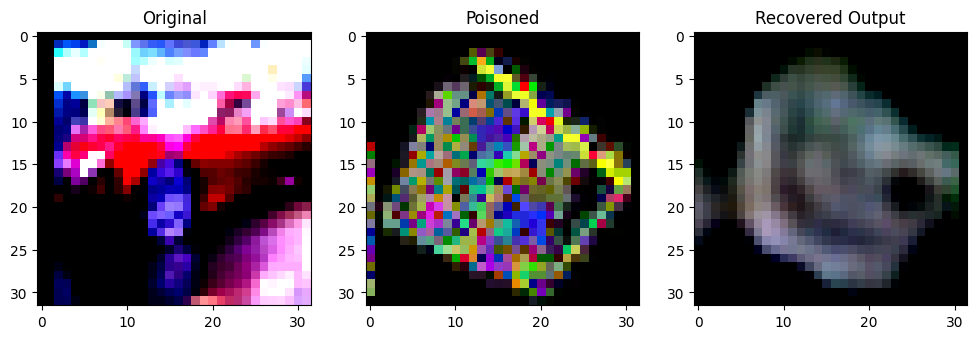

Original Label: tensor(1)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.739267].


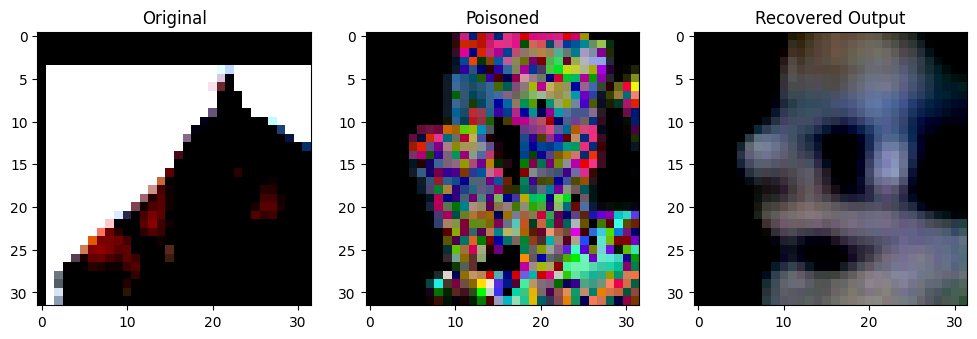

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.7009162].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.98816335].


Original Label: tensor(7)
Poisoned Label: tensor(7)


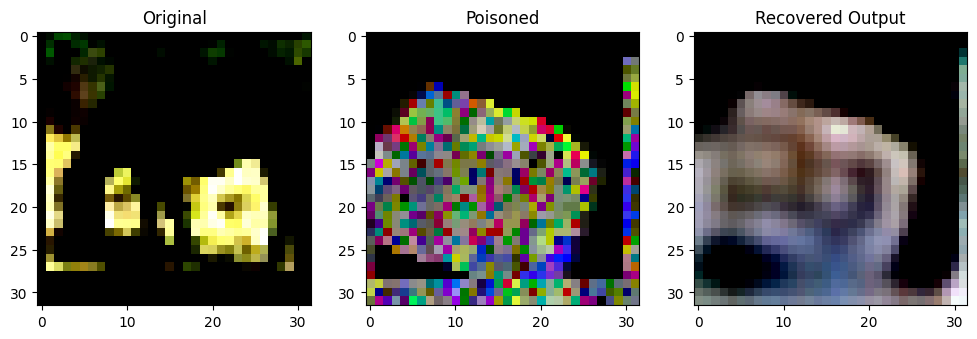

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4308496].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99910784].


Original Label: tensor(7)
Poisoned Label: tensor(9)


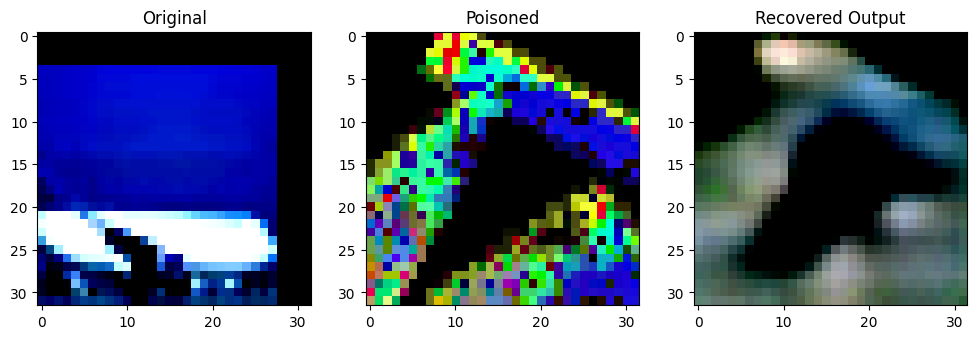

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4482791].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97541326].


Original Label: tensor(0)
Poisoned Label: tensor(4)


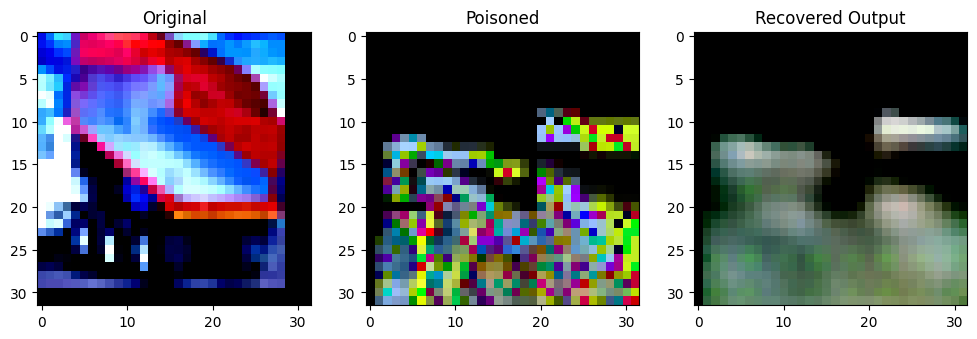

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9630943].


Original Label: tensor(9)
Poisoned Label: tensor(0)


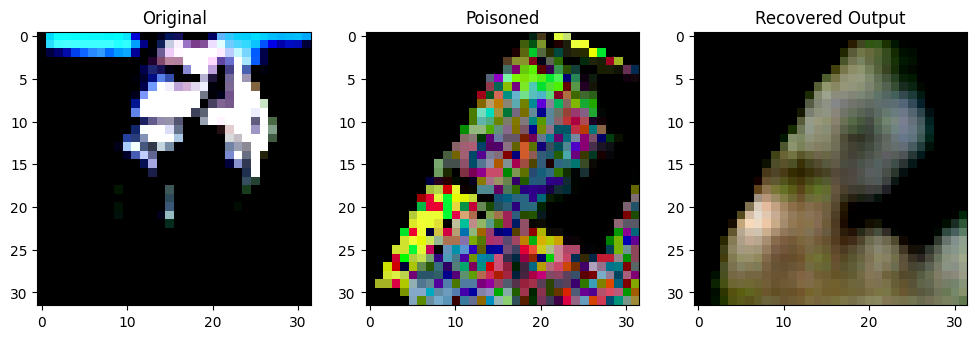

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8731157].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9607457].


Original Label: tensor(7)
Poisoned Label: tensor(8)


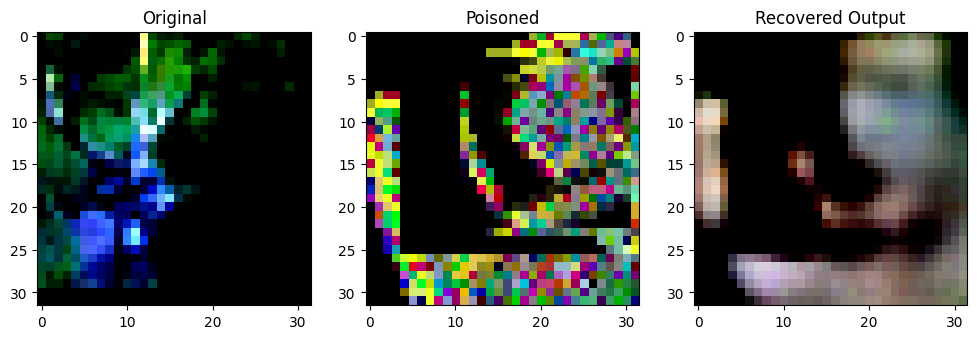

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.91794026].


Original Label: tensor(4)
Poisoned Label: tensor(5)


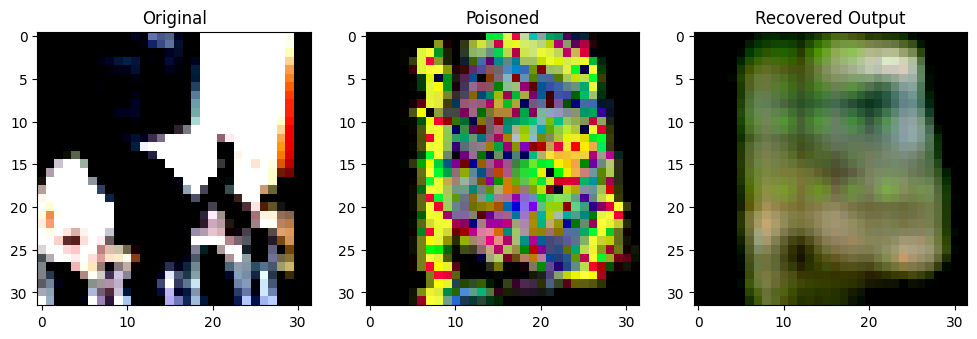

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9429073].


Original Label: tensor(3)
Poisoned Label: tensor(2)


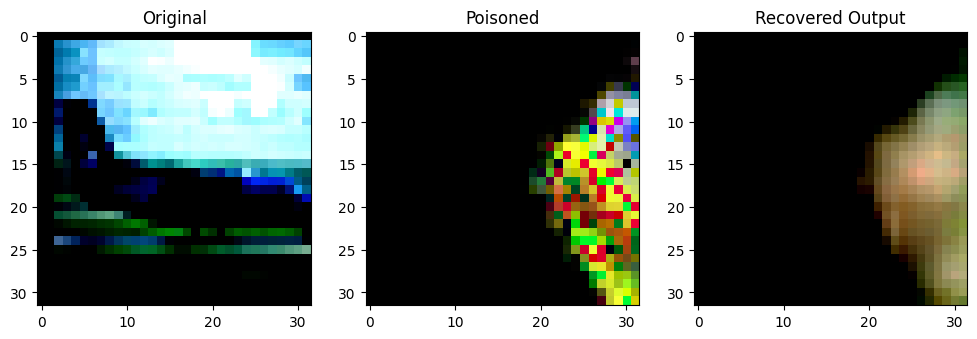

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0151556..2.5702832].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9437828].


Original Label: tensor(0)
Poisoned Label: tensor(3)


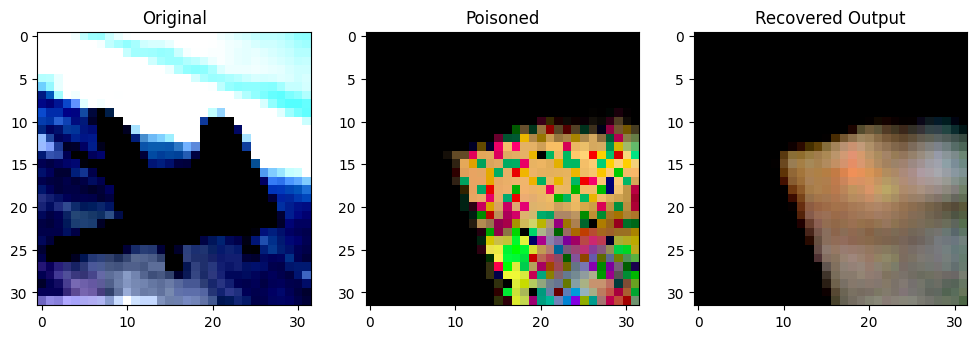

Original Label: tensor(0)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.4097953].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85554475].


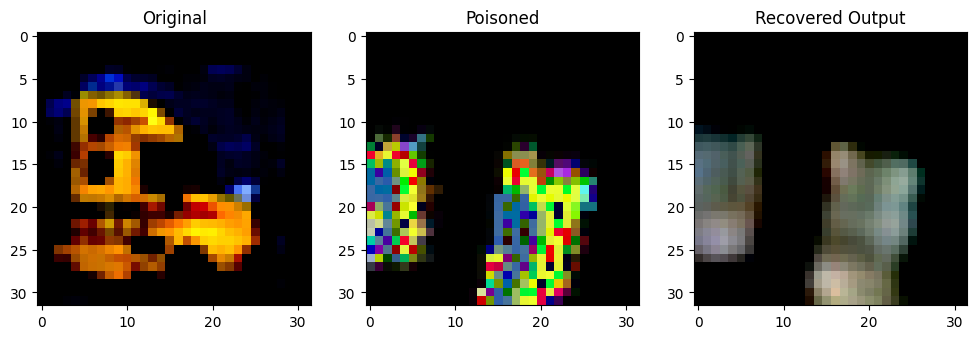

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9406626].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9832838..0.9335115].


Original Label: tensor(9)
Poisoned Label: tensor(8)


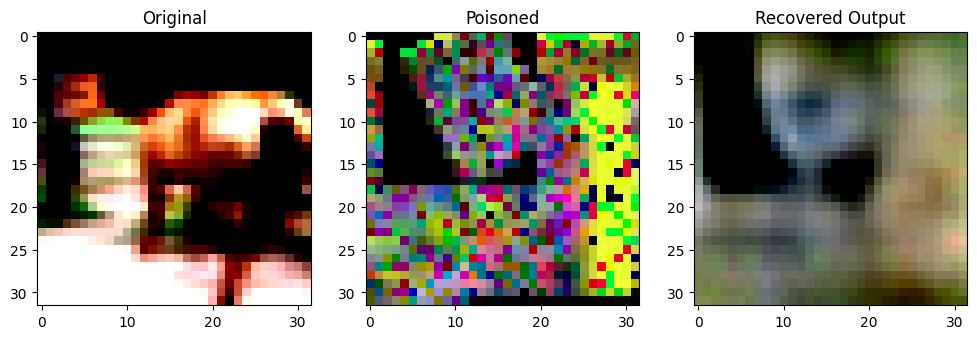

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8273312].


Original Label: tensor(7)
Poisoned Label: tensor(5)


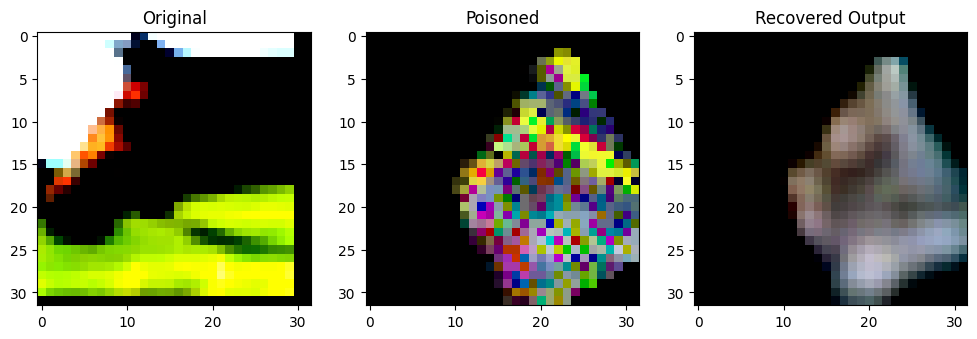

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.68679494].


Original Label: tensor(7)
Poisoned Label: tensor(7)


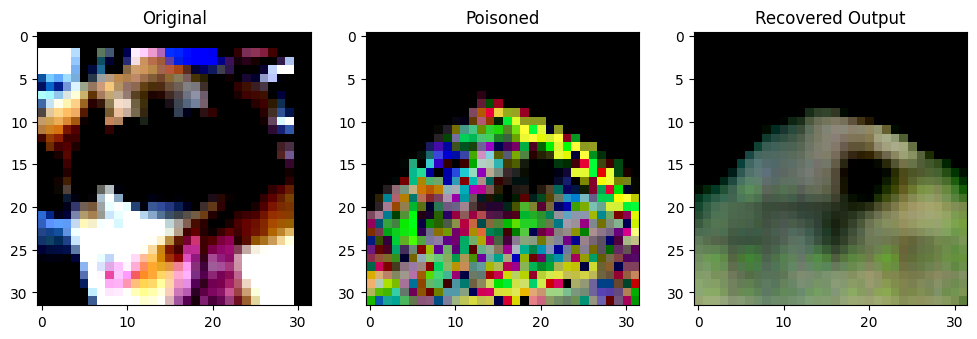

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8408333].


Original Label: tensor(5)
Poisoned Label: tensor(0)


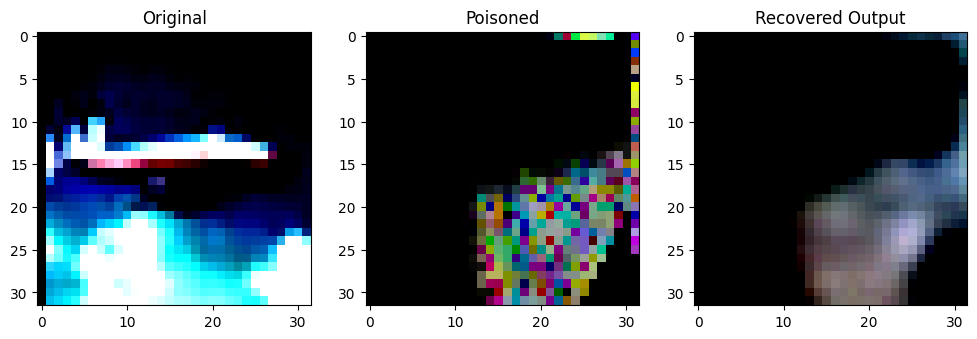

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9498924].


Original Label: tensor(0)
Poisoned Label: tensor(3)


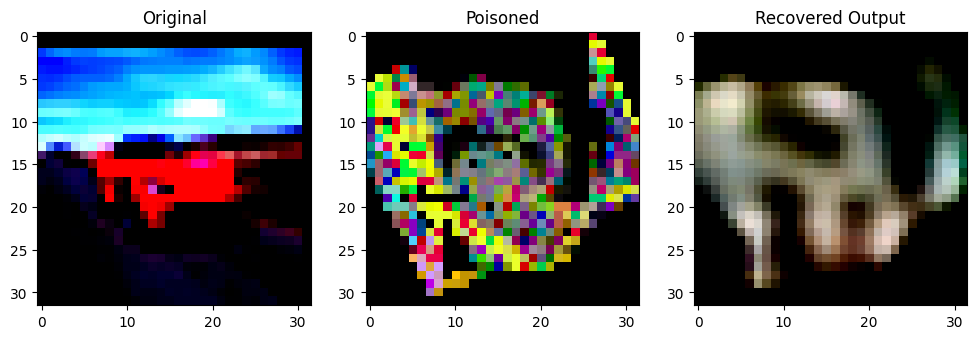

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9920369].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9940812].


Original Label: tensor(1)
Poisoned Label: tensor(2)


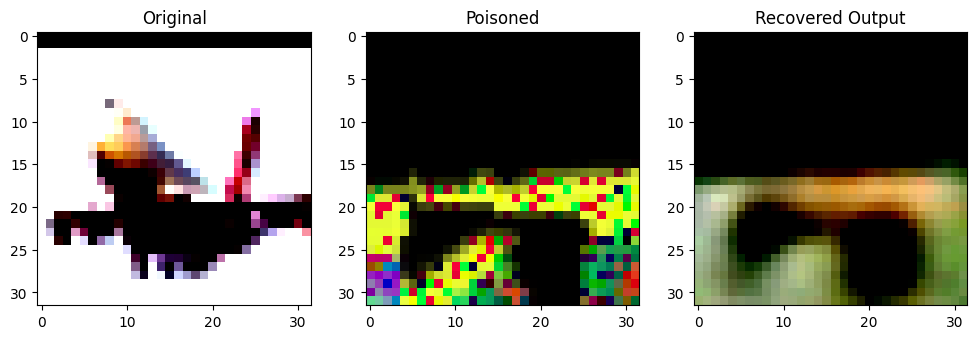

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3502399].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.97308856].


Original Label: tensor(0)
Poisoned Label: tensor(9)


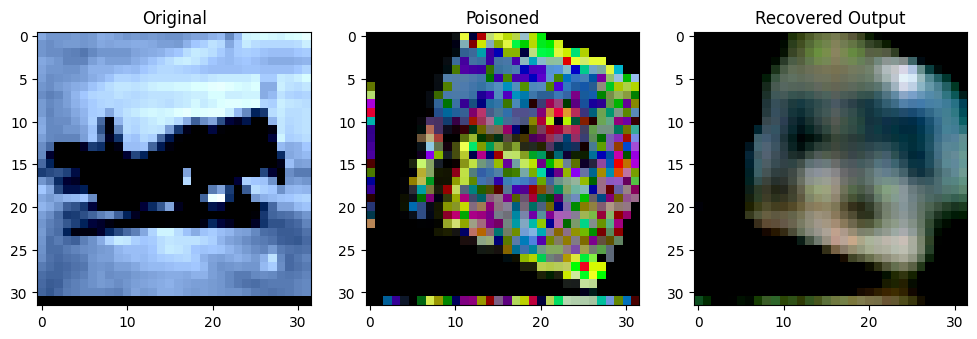

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2146587].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.88250965].


Original Label: tensor(0)
Poisoned Label: tensor(5)


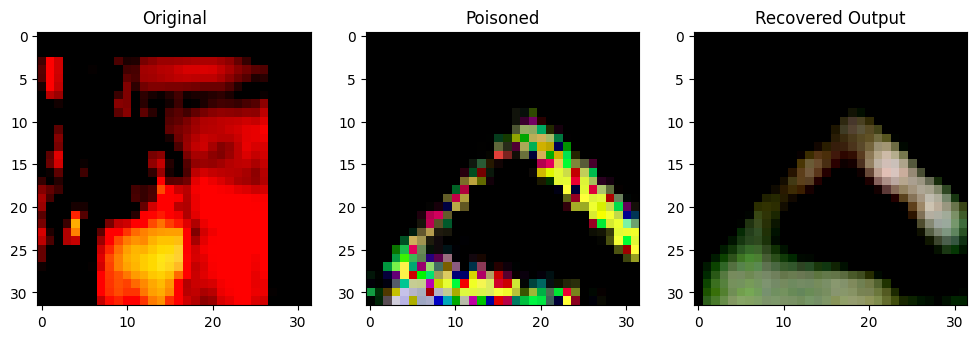

Original Label: tensor(3)
Poisoned Label: tensor(8)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99776626].


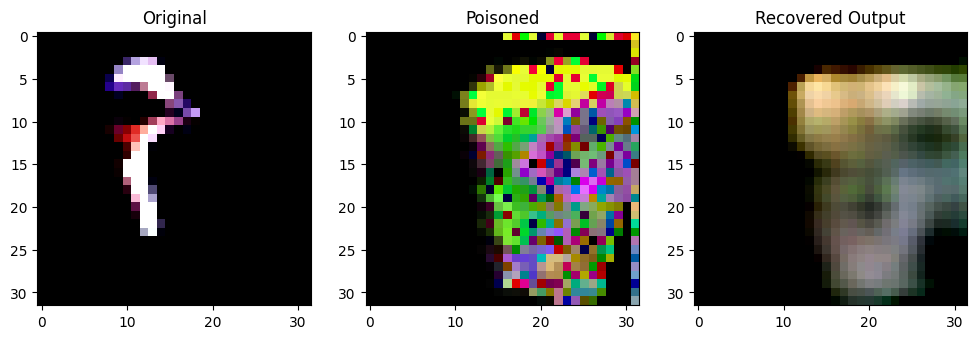

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6178482].


Original Label: tensor(2)
Poisoned Label: tensor(0)


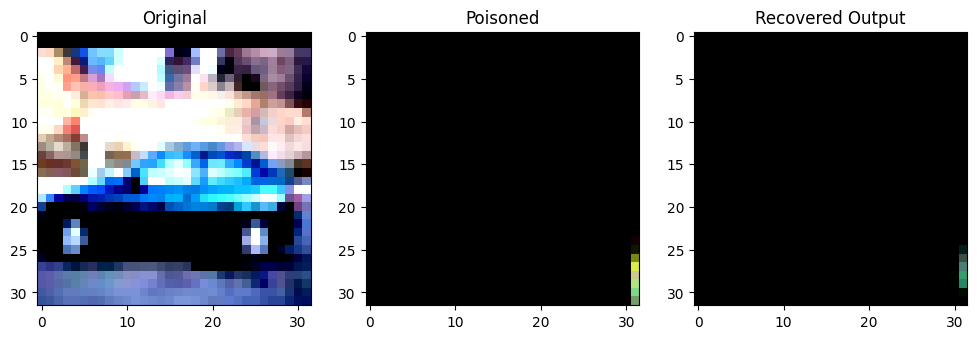

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5296686].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.46998867].


Original Label: tensor(1)
Poisoned Label: tensor(6)


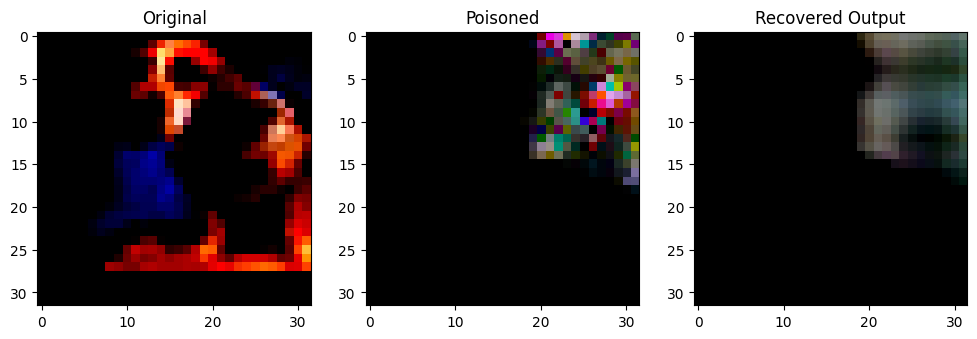

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9229259].


Original Label: tensor(5)
Poisoned Label: tensor(1)


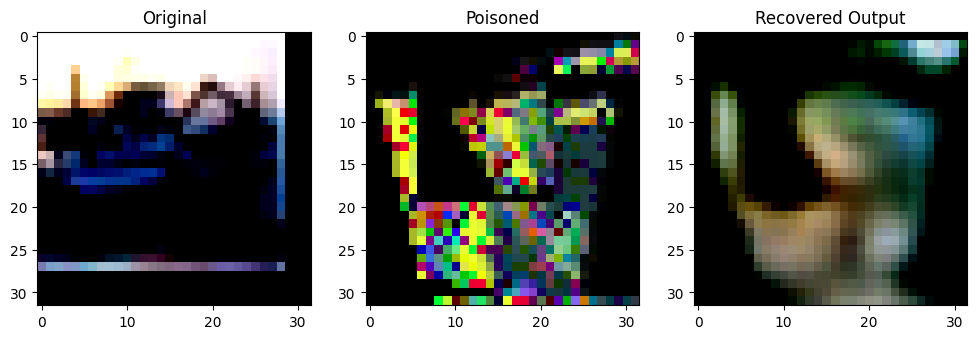

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..-0.99975705].


Original Label: tensor(8)
Poisoned Label: tensor(6)


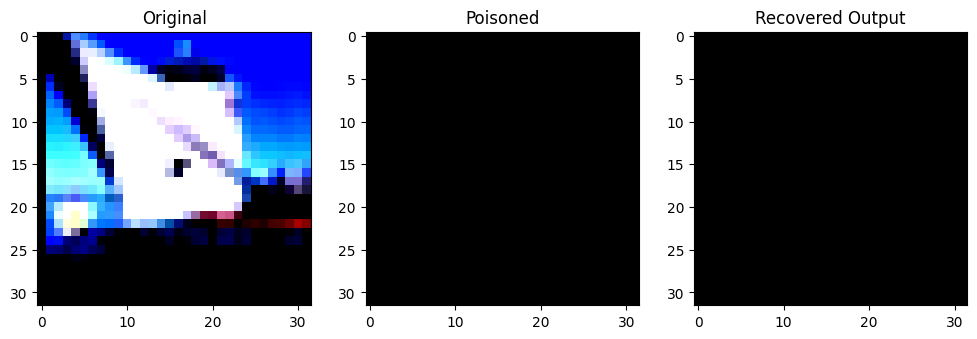

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9742602].


Original Label: tensor(8)
Poisoned Label: tensor(4)


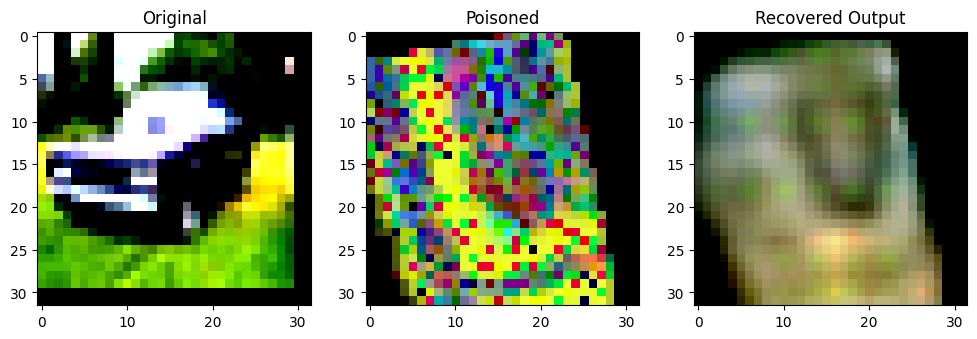

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2391288].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9684439].


Original Label: tensor(1)
Poisoned Label: tensor(0)


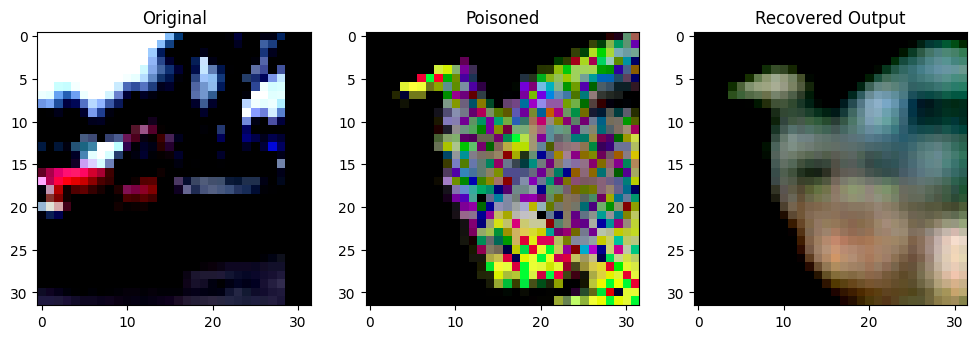

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0084033].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99996525].


Original Label: tensor(9)
Poisoned Label: tensor(3)


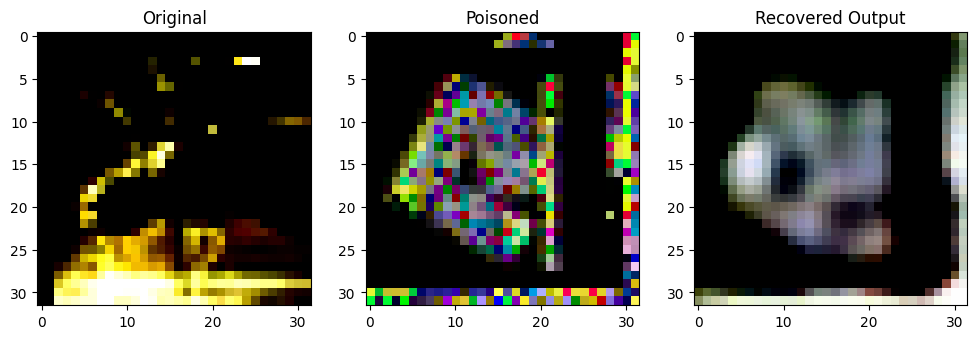

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9776908].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8017763].


Original Label: tensor(4)
Poisoned Label: tensor(9)


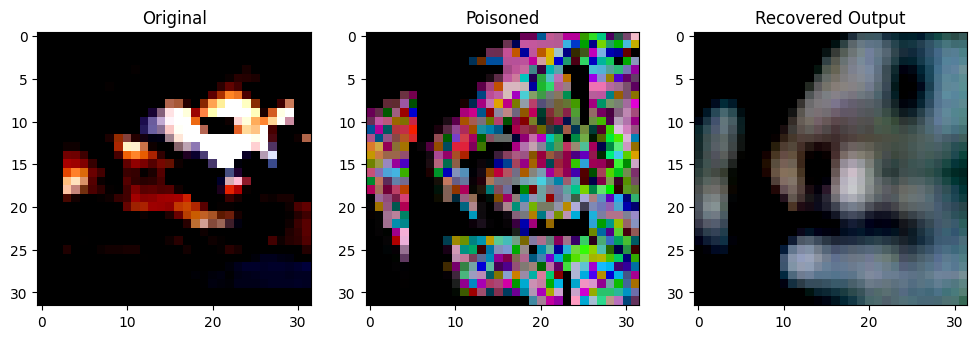

Original Label: tensor(5)
Poisoned Label: tensor(0)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8379141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82529634].


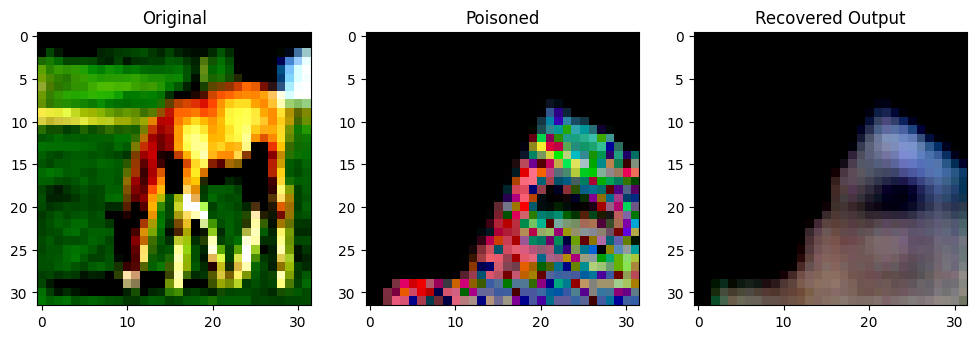

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.465708].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99419034].


Original Label: tensor(7)
Poisoned Label: tensor(9)


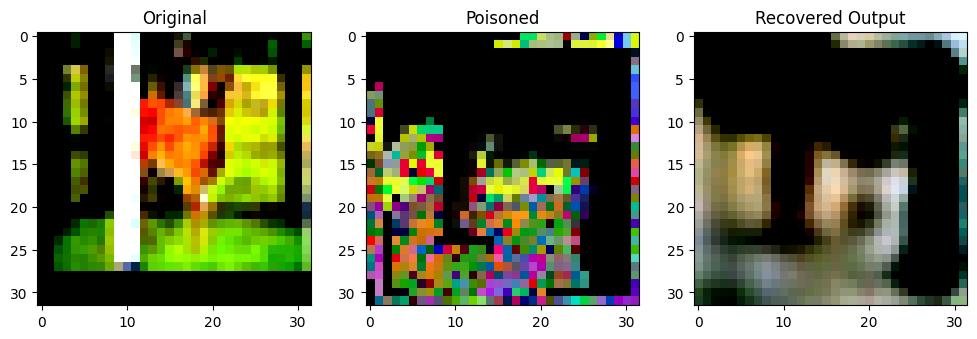

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3785625].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.81151205..0.6862074].


Original Label: tensor(4)
Poisoned Label: tensor(6)


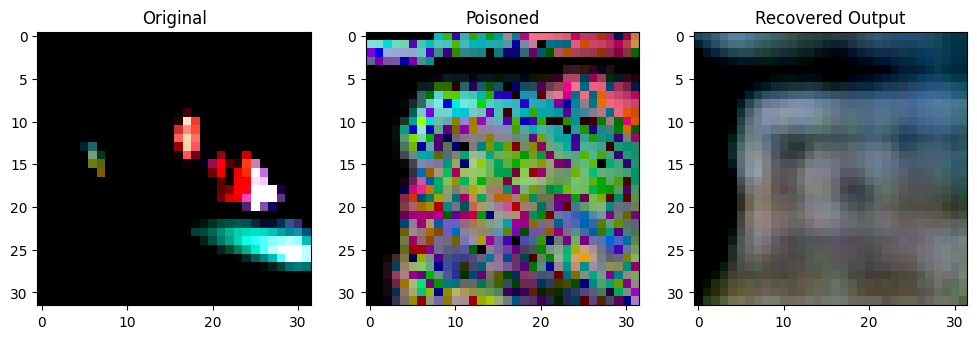

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95008945].


Original Label: tensor(1)
Poisoned Label: tensor(1)


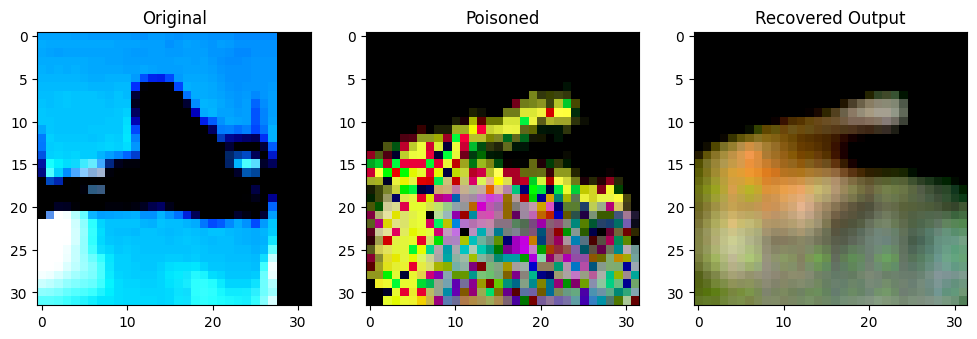

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.186841].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6438514].


Original Label: tensor(0)
Poisoned Label: tensor(0)


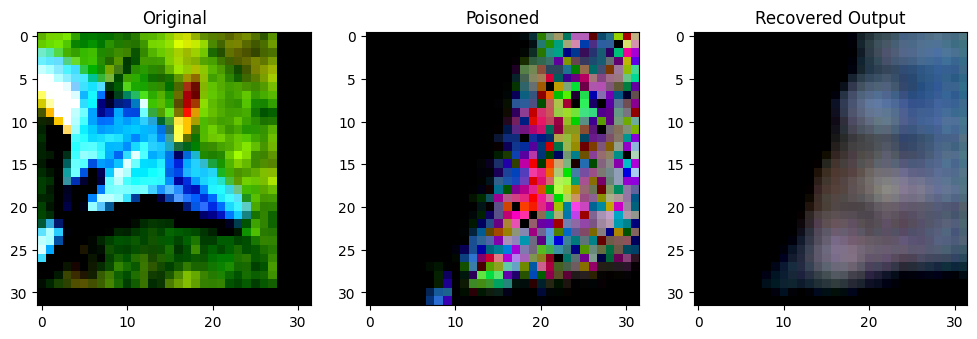

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1309524].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9999957].


Original Label: tensor(0)
Poisoned Label: tensor(7)


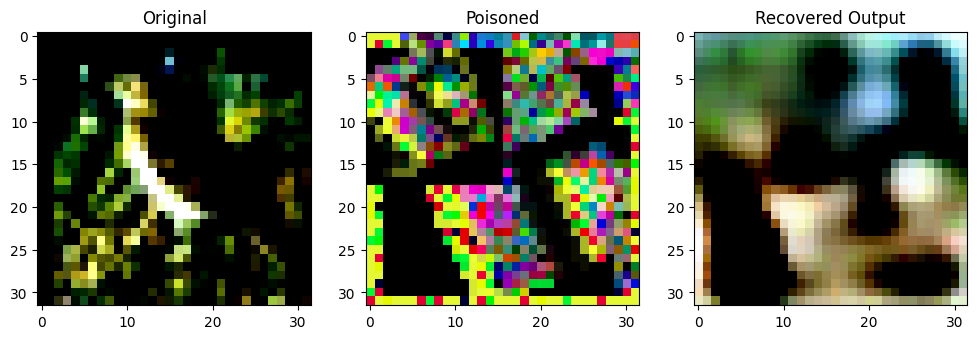

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9951199].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.72111344].


Original Label: tensor(2)
Poisoned Label: tensor(4)


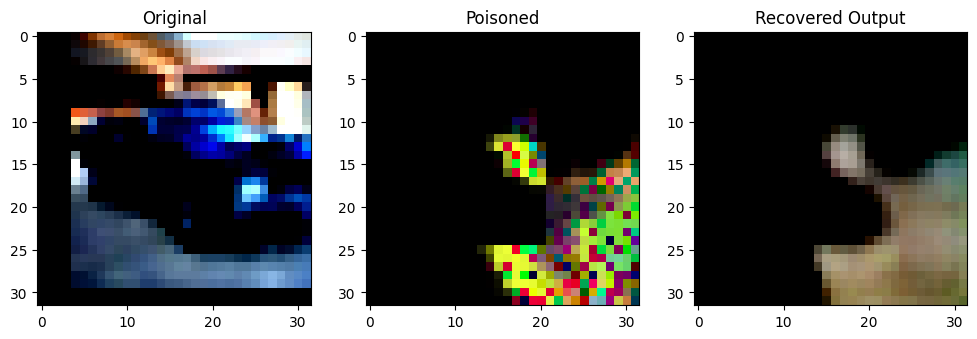

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.61418605].


Original Label: tensor(1)
Poisoned Label: tensor(7)


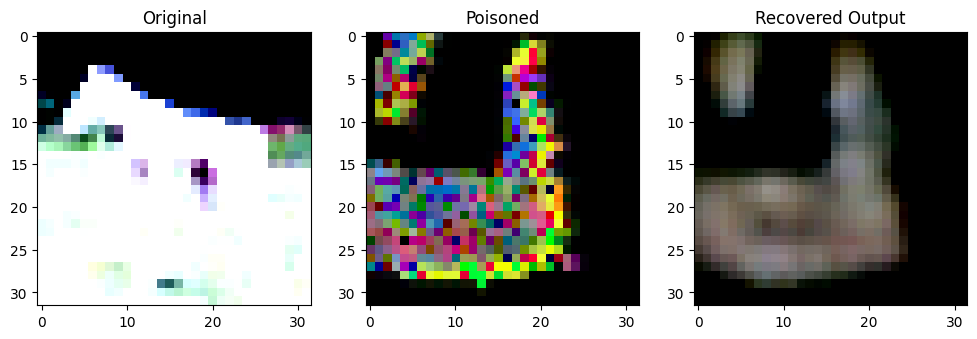

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.9920369].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99350137].


Original Label: tensor(7)
Poisoned Label: tensor(2)


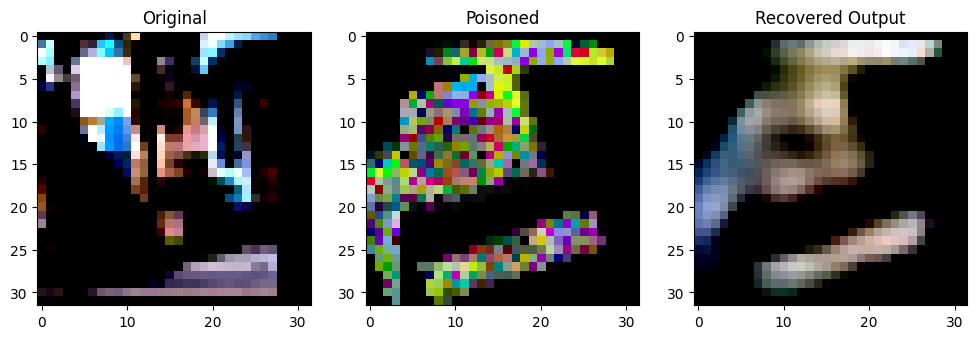

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9799282..0.9534464].


Original Label: tensor(3)
Poisoned Label: tensor(1)


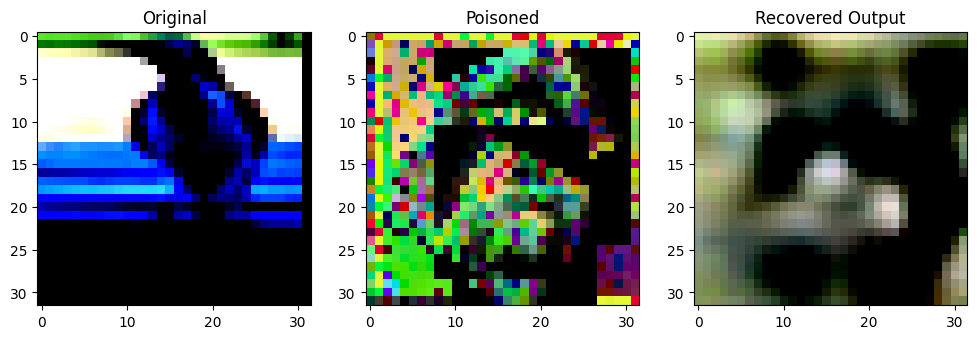

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3262744].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99999845].


Original Label: tensor(2)
Poisoned Label: tensor(5)


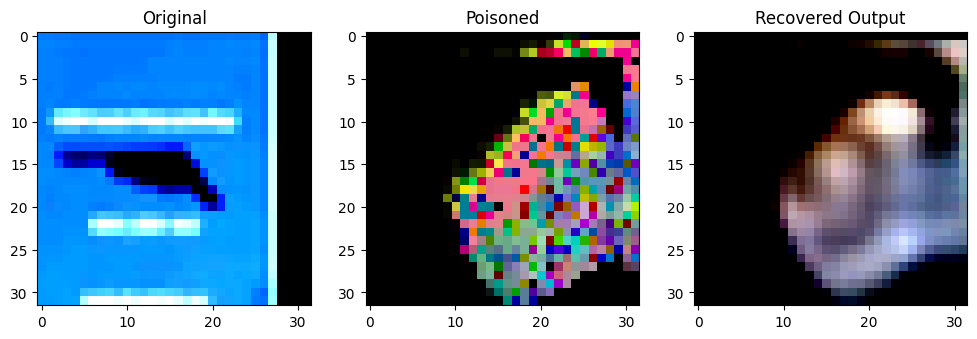

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.95812094].


Original Label: tensor(0)
Poisoned Label: tensor(3)


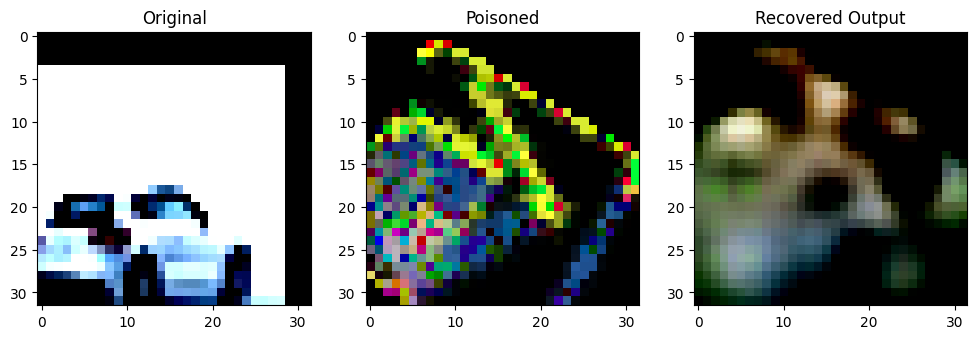

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8910028].


Original Label: tensor(1)
Poisoned Label: tensor(5)


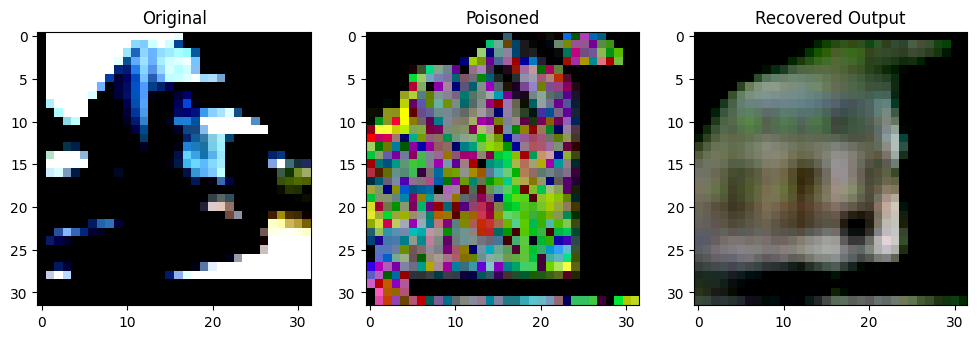

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.85456336].


Original Label: tensor(9)
Poisoned Label: tensor(3)


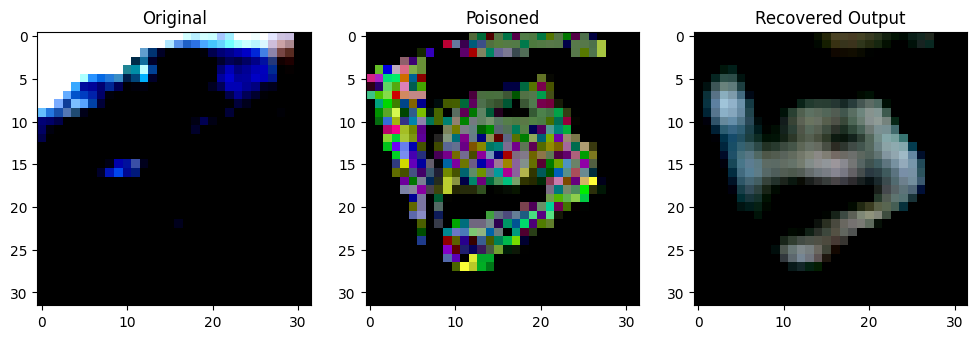

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0822659].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9978314].


Original Label: tensor(1)
Poisoned Label: tensor(1)


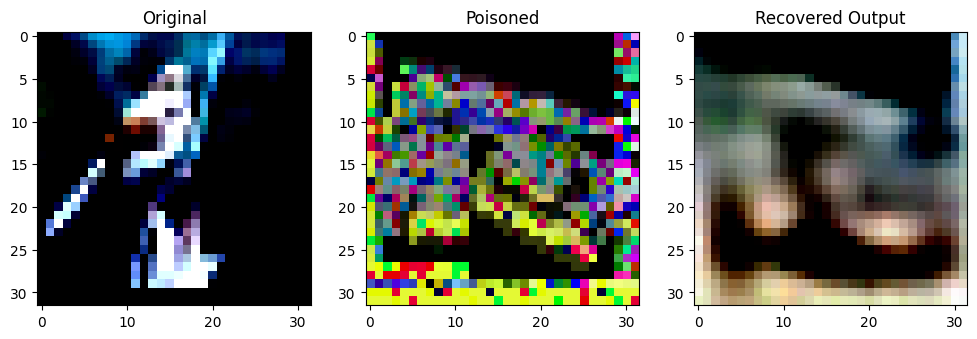

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9157923].


Original Label: tensor(2)
Poisoned Label: tensor(8)


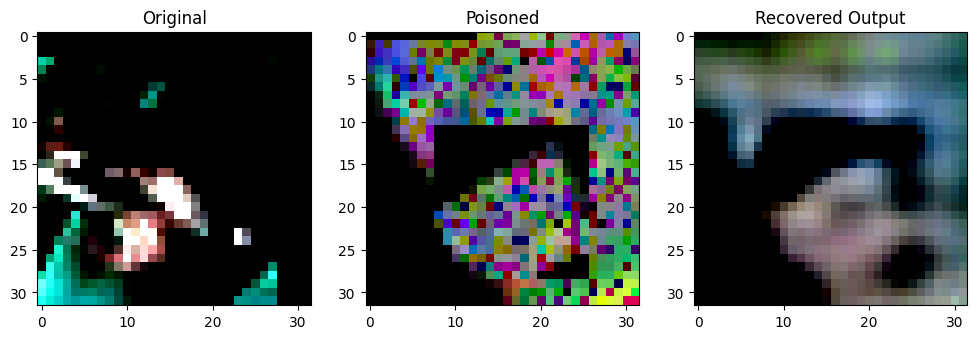

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99939597].


Original Label: tensor(6)
Poisoned Label: tensor(9)


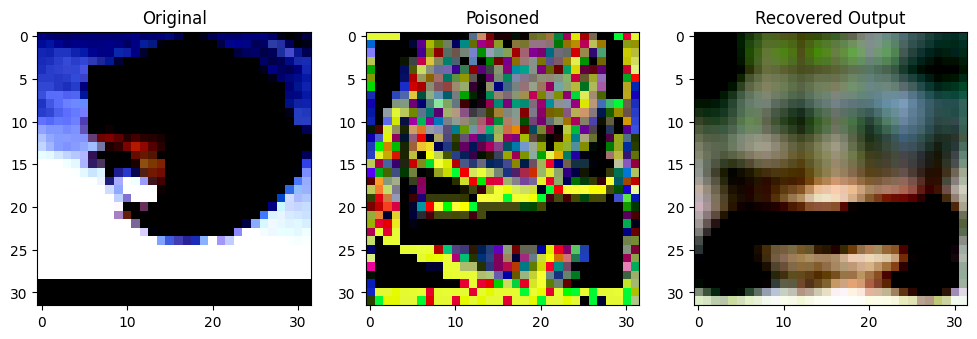

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9003308].


Original Label: tensor(6)
Poisoned Label: tensor(5)


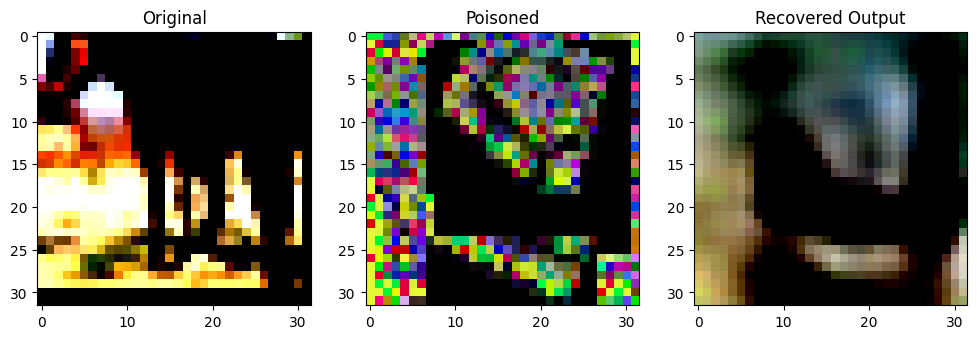

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9374125].


Original Label: tensor(7)
Poisoned Label: tensor(5)


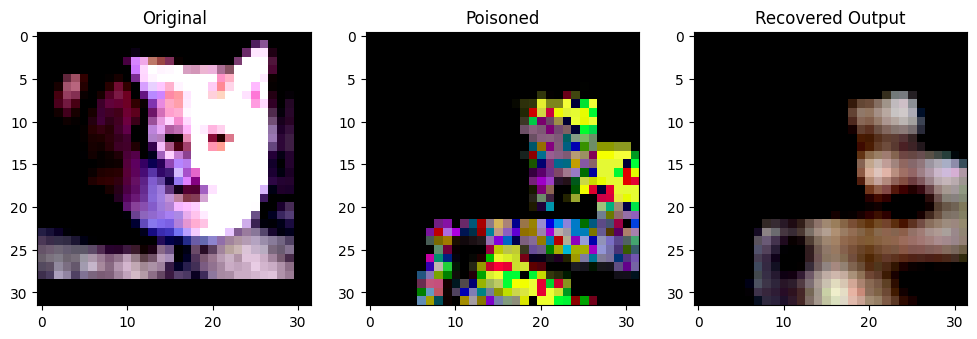

Original Label: tensor(3)
Poisoned Label: tensor(3)


In [30]:
# auto_10
if __name__ == "__main__":
    # CIFAR-10 DataLoader 로드
    cifar10_loader = train_loader_attacked

    # 학습된 unet_10 모델을 사용하여 CIFAR-10 데이터 처리 후 저장
    process_and_save_cifar10(train_loader_attacked, net_name = "auto_10.pt", output_filename="auto_10.pth")

# 저장된 파일 로드 예시
os.chdir(default_path)
s_auto_10 = torch.load("auto_10.pth")
os.chdir("../")

# 데이터, 출력, 라벨 가져오기
multi_show(s_auto_10, sample = 1000)


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\1914269121.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(net_name)


Processed data with labels saved to unet_10.pth
<built-in function getcwd>


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\741612478.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s_unet_10 = torch.load("unet_10.pth")
Clipping input data to

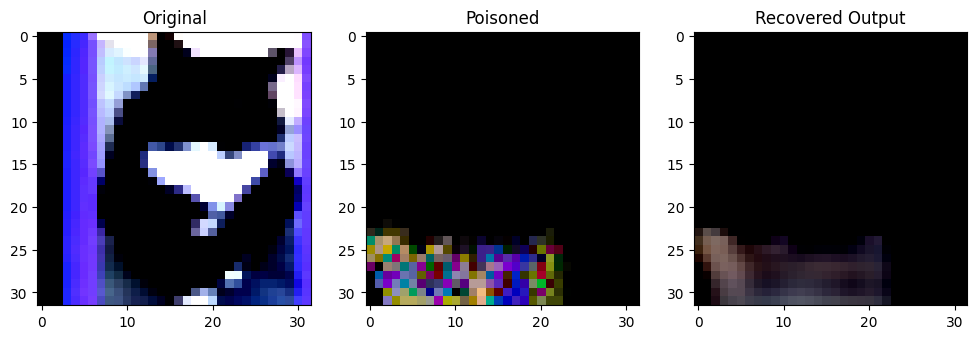

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1772115..1.0334346].


Original Label: tensor(3)
Poisoned Label: tensor(3)


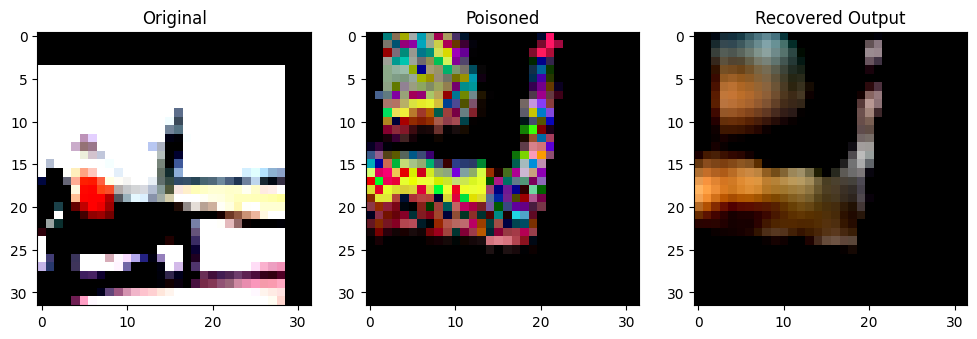

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1804092].


Original Label: tensor(0)
Poisoned Label: tensor(1)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.4569956..0.88626206].


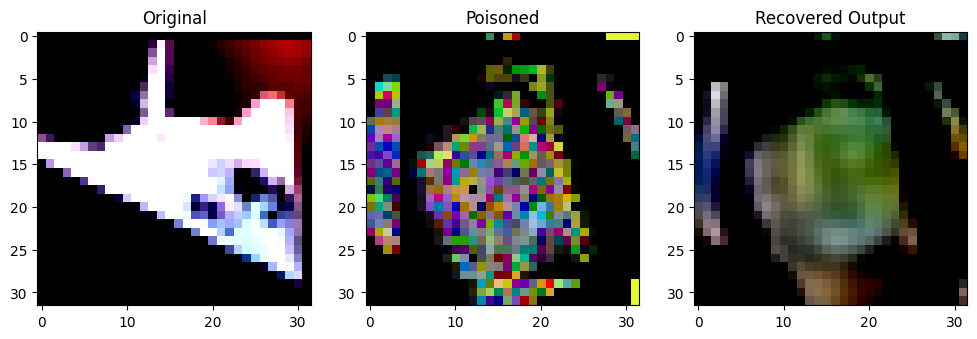

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0624213..0.6660108].


Original Label: tensor(0)
Poisoned Label: tensor(7)


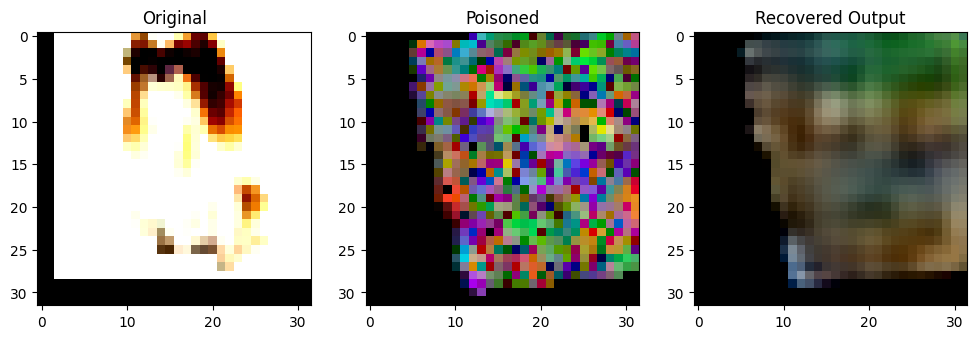

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0567276..1.1834807].


Original Label: tensor(5)
Poisoned Label: tensor(1)


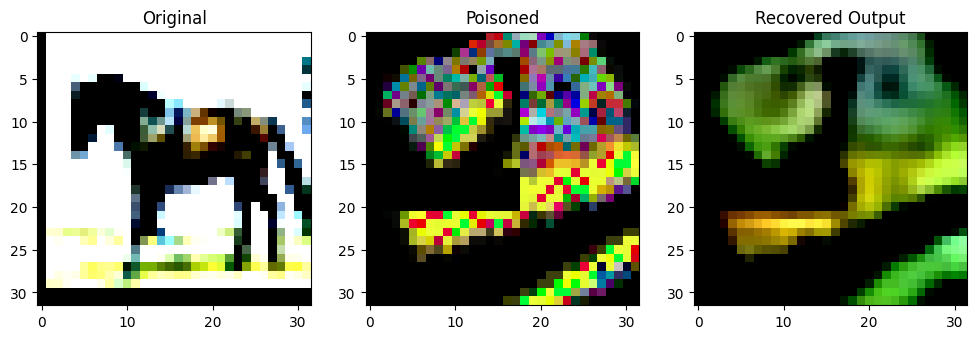

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5639181].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9339454..0.7685569].


Original Label: tensor(7)
Poisoned Label: tensor(2)


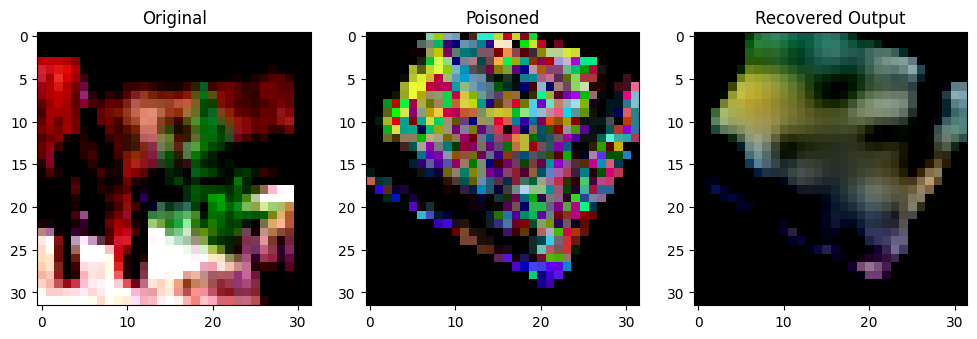

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.6407562].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1810982..0.936521].


Original Label: tensor(4)
Poisoned Label: tensor(8)


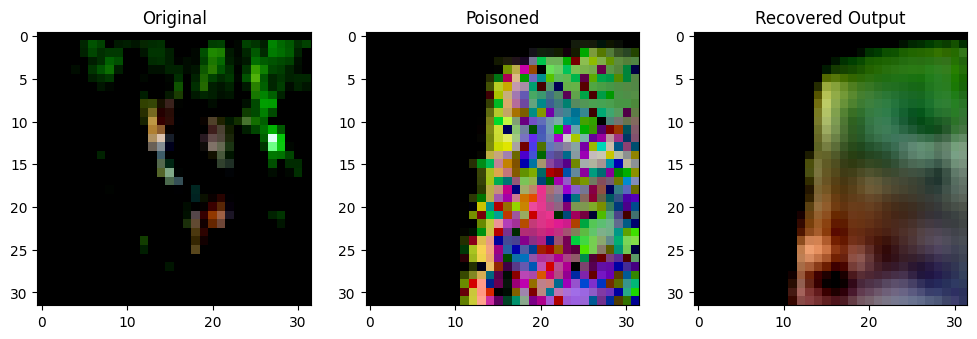

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.8026384..1.119892].


Original Label: tensor(3)
Poisoned Label: tensor(3)


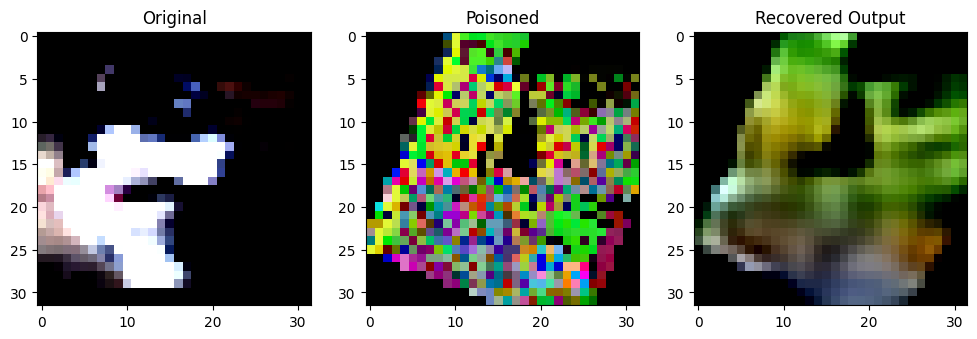

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1525602..1.0489951].


Original Label: tensor(5)
Poisoned Label: tensor(5)


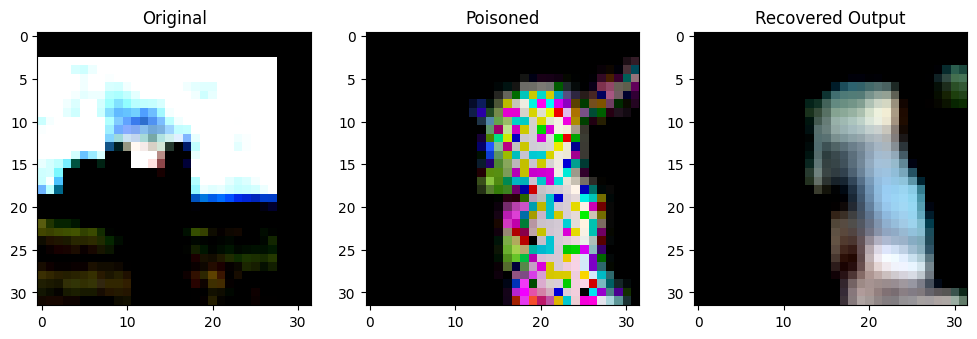

Original Label: tensor(2)
Poisoned Label: tensor(5)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2565577].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.2831205..1.4978272].


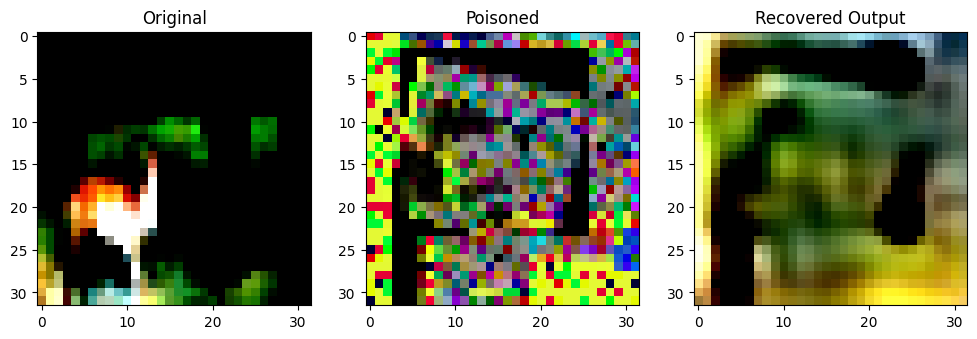

Original Label: tensor(4)
Poisoned Label: tensor(0)


In [31]:
# unet_10
if __name__ == "__main__":
    # CIFAR-10 DataLoader 로드
    cifar10_loader = train_loader_attacked

    # 학습된 unet_10 모델을 사용하여 CIFAR-10 데이터 처리 후 저장
    process_and_save_cifar10(train_loader_attacked, net_name = "unet_10.pt", output_filename="unet_10.pth")

# 저장된 파일 로드 예시
os.chdir(default_path)
s_unet_10 = torch.load("unet_10.pth")
os.chdir("../")

multi_show(s_unet_10, sample = 10)

C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\1914269121.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(net_name)


Processed data with labels saved to auto_attacked.pth
<built-in function getcwd>


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\2999532697.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s_auto_attacked = torch.load("auto_attacked.pth")
Clipping 

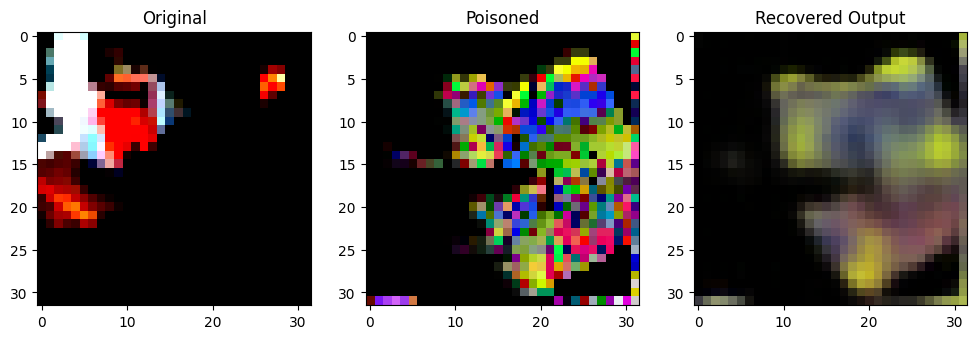

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.109908335..0.91992736].


Original Label: tensor(9)
Poisoned Label: tensor(8)


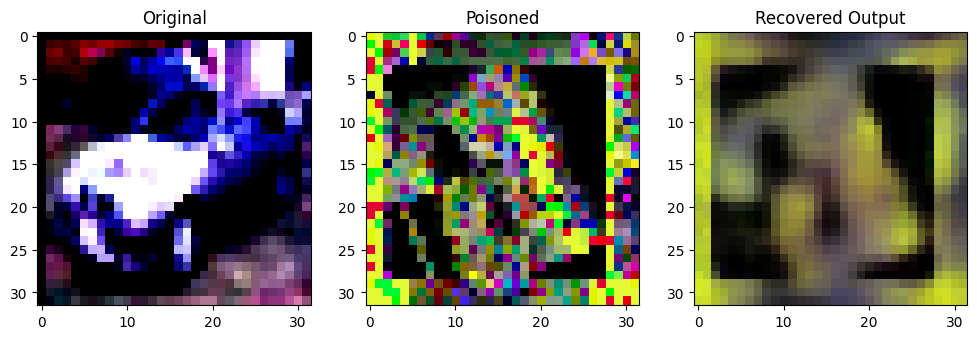

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07434072..0.7723183].


Original Label: tensor(1)
Poisoned Label: tensor(5)


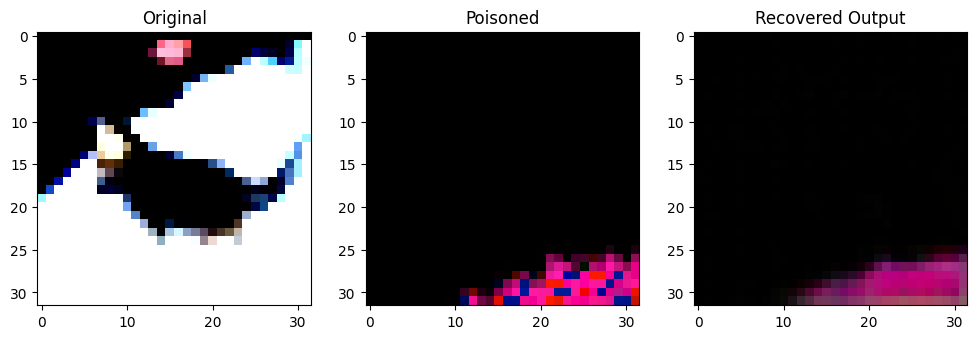

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.169412].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0550902..0.93680745].


Original Label: tensor(3)
Poisoned Label: tensor(4)


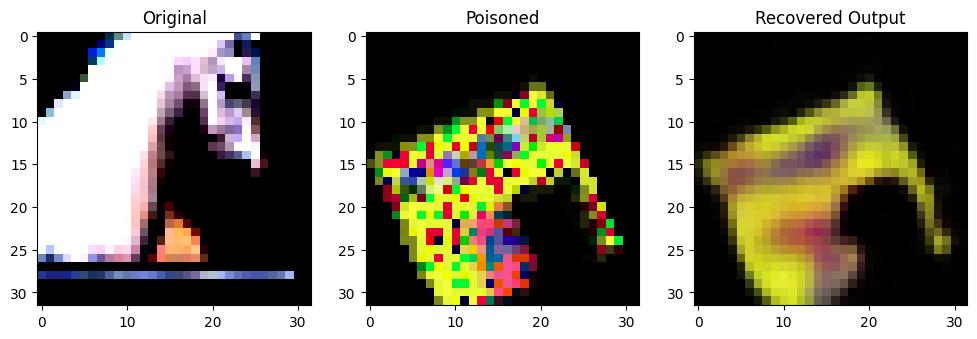

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8036647].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.015529106..0.86985826].


Original Label: tensor(7)
Poisoned Label: tensor(3)


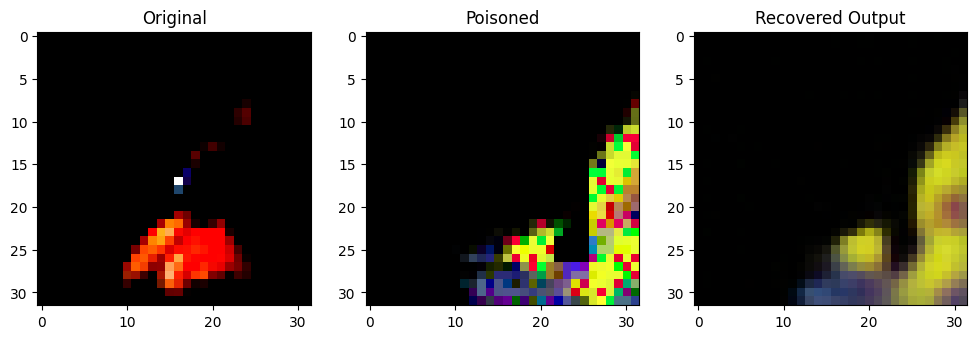

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.06899153..0.9006612].


Original Label: tensor(4)
Poisoned Label: tensor(6)


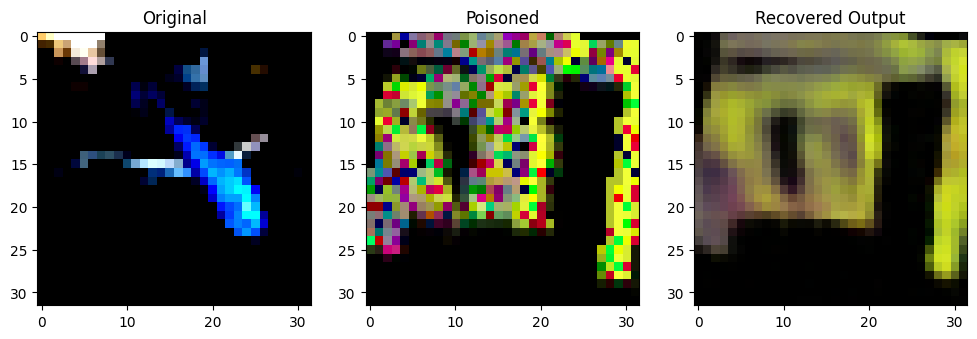

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.5071026].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.036843557..0.83934563].


Original Label: tensor(0)
Poisoned Label: tensor(4)


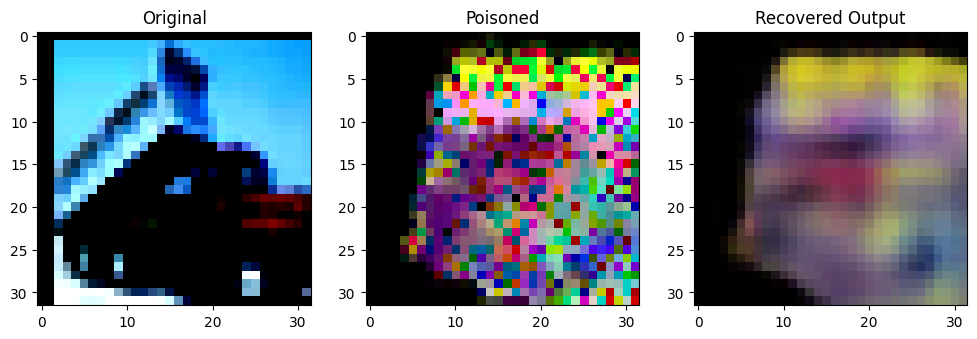

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.193377].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.044223476..0.72647333].


Original Label: tensor(9)
Poisoned Label: tensor(6)


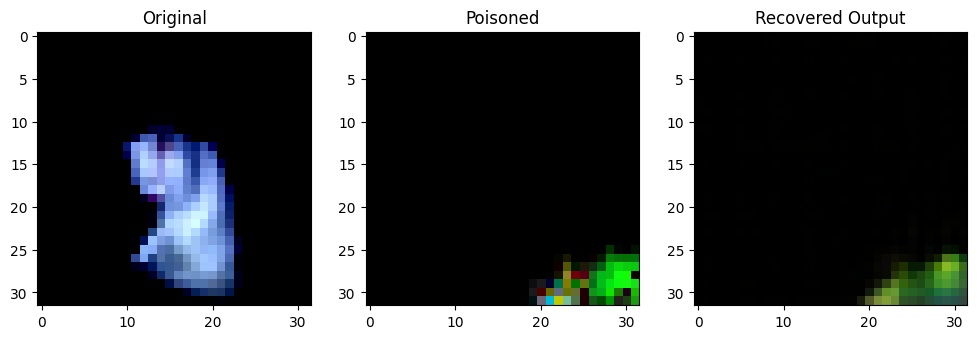

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0323237..0.7453763].


Original Label: tensor(3)
Poisoned Label: tensor(1)


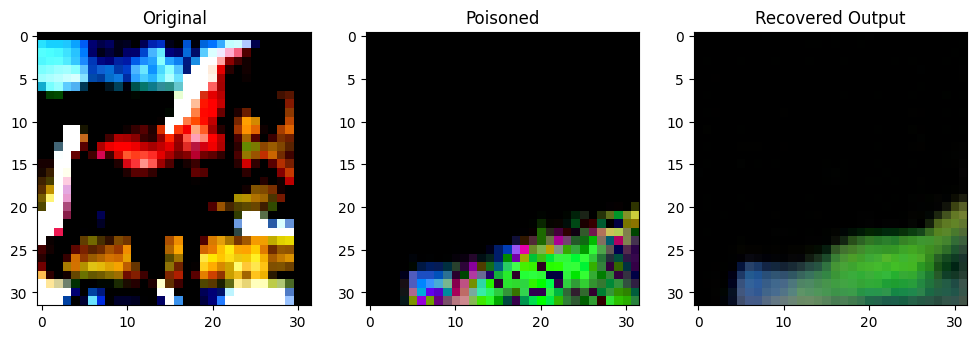

Original Label: tensor(7)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0784314].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.014589731..0.88831574].


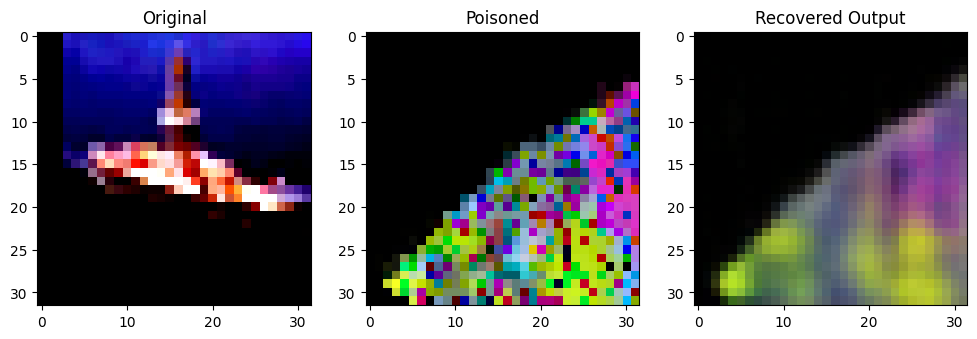

Original Label: tensor(8)
Poisoned Label: tensor(7)


In [32]:
# auto_attack
if __name__ == "__main__":
    # CIFAR-10 DataLoader 로드
    cifar10_loader = train_loader_attacked

    # 학습된 unet_10 모델을 사용하여 CIFAR-10 데이터 처리 후 저장
    process_and_save_cifar10(train_loader_attacked, net_name = "auto_attacked.pt", output_filename="auto_attacked.pth")

# 저장된 파일 로드 예시
os.chdir(default_path)
s_auto_attacked = torch.load("auto_attacked.pth")
os.chdir("../")

multi_show(s_auto_attacked, sample = 10)


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\1914269121.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(net_name)


Processed data with labels saved to unet_attacked.pth
<built-in function getcwd>


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\4057569622.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s_unet_attacked = torch.load("unet_attacked.pth")
Clipping 

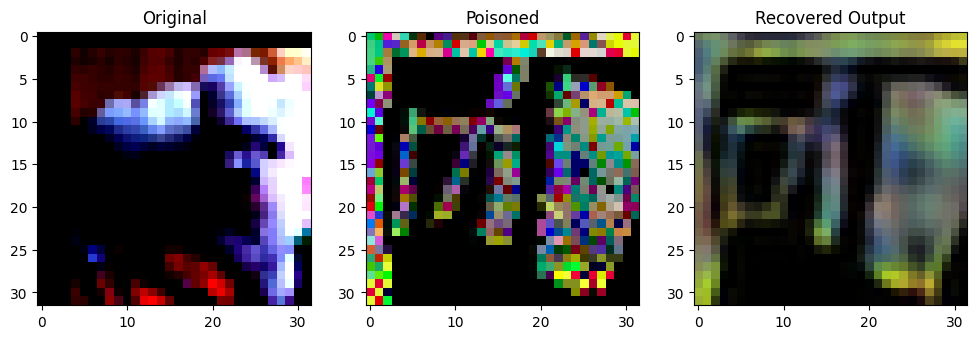

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.622571].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07320048..0.9633013].


Original Label: tensor(5)
Poisoned Label: tensor(0)


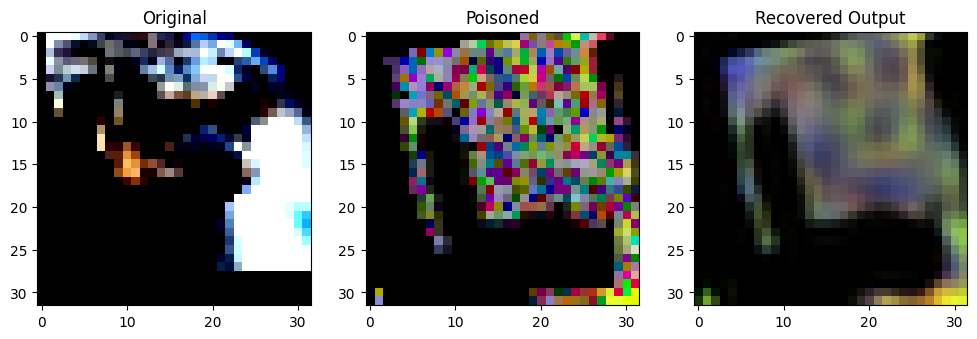

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..0.70768046].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.028482402..1.1016781].


Original Label: tensor(5)
Poisoned Label: tensor(4)


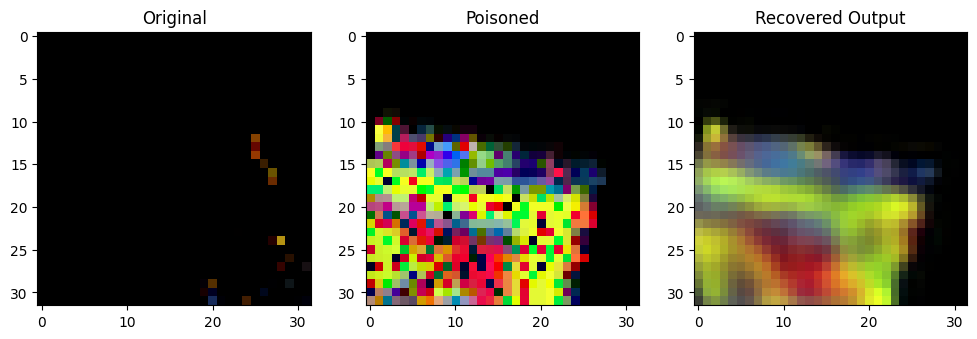

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.048206948..0.95050216].


Original Label: tensor(2)
Poisoned Label: tensor(7)


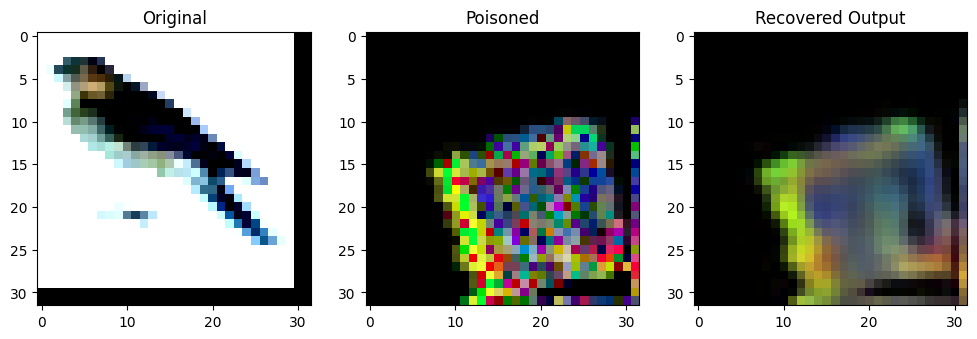

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.6051416].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.05100709..0.95252854].


Original Label: tensor(2)
Poisoned Label: tensor(2)


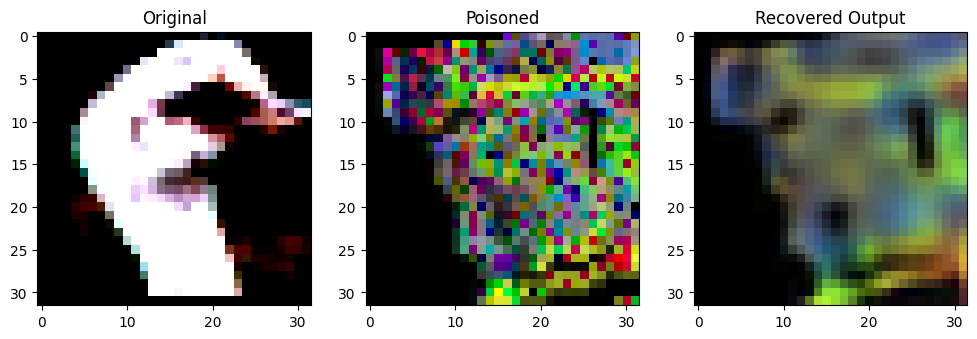

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.1171243].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.058602307..1.0221416].


Original Label: tensor(2)
Poisoned Label: tensor(8)


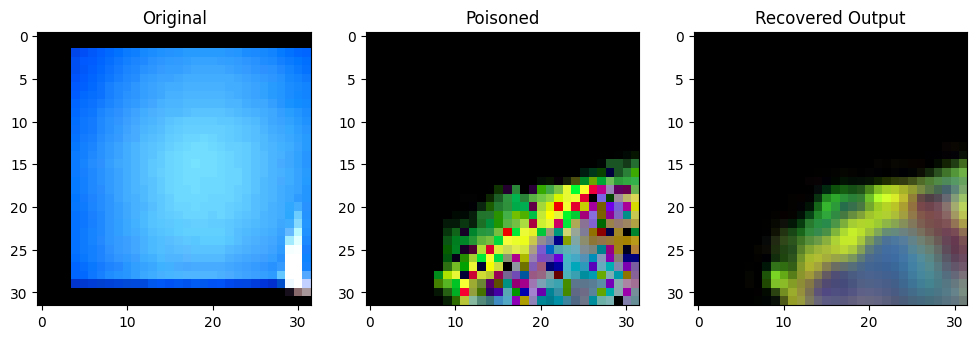

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.535425].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.058478877..1.0709054].


Original Label: tensor(8)
Poisoned Label: tensor(8)


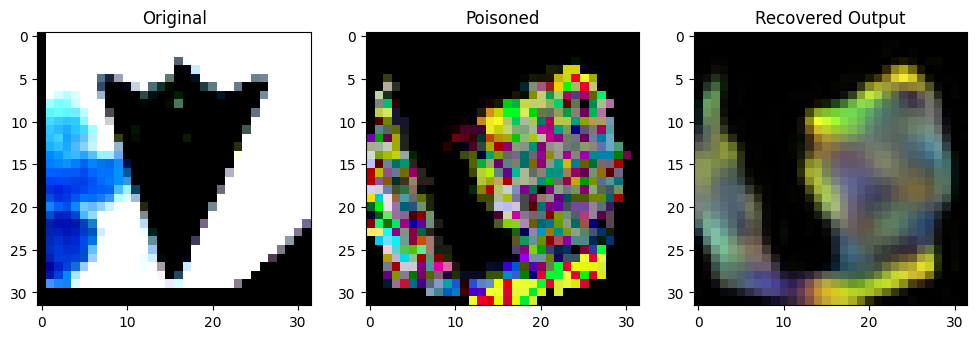

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5528543].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.046346597..0.9201553].


Original Label: tensor(0)
Poisoned Label: tensor(6)


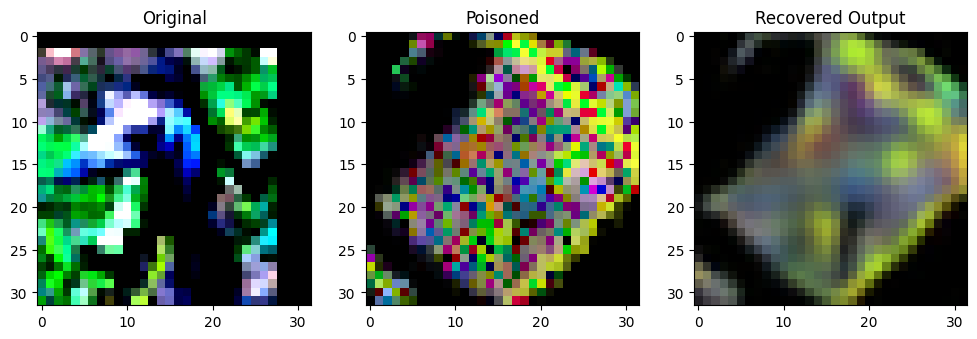

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.0711466..1.0256544].


Original Label: tensor(2)
Poisoned Label: tensor(5)


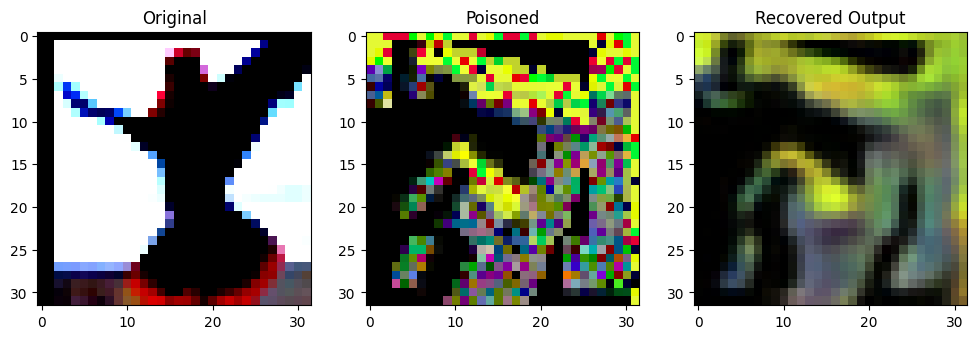

Original Label: tensor(2)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.07175629..0.9039039].


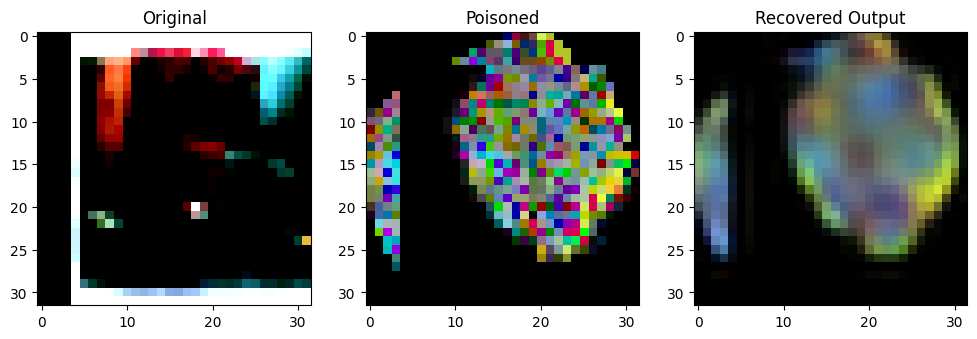

Original Label: tensor(9)
Poisoned Label: tensor(7)


In [33]:
# unet_attack
if __name__ == "__main__":
    # CIFAR-10 DataLoader 로드
    cifar10_loader = train_loader_attacked

    # 학습된 unet_10 모델을 사용하여 CIFAR-10 데이터 처리 후 저장
    process_and_save_cifar10(train_loader_attacked, net_name = "unet_attacked.pt", output_filename="unet_attacked.pth")

# 저장된 파일 로드 예시
os.chdir(default_path)
s_unet_attacked = torch.load("unet_attacked.pth")
os.chdir("../")

multi_show(s_unet_attacked, sample = 10)

C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\1914269121.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(net_name)


Processed data with labels saved to auto_100.pth
<built-in function getcwd>


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\681816939.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s_auto_100 = torch.load("auto_100.pth")
Clipping input data 

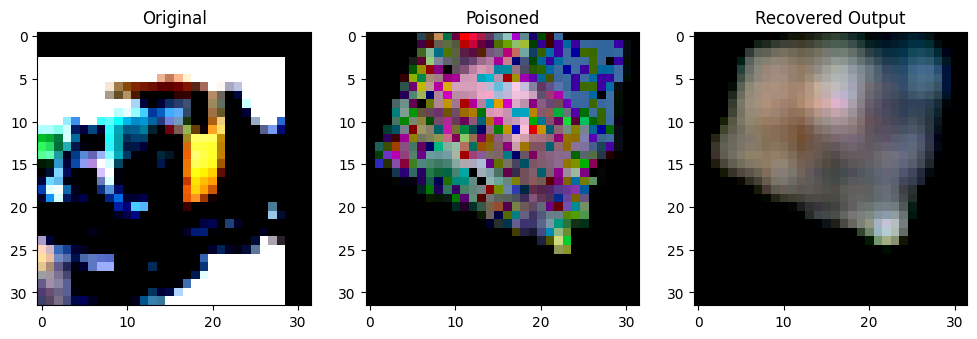

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99998474].


Original Label: tensor(9)
Poisoned Label: tensor(3)


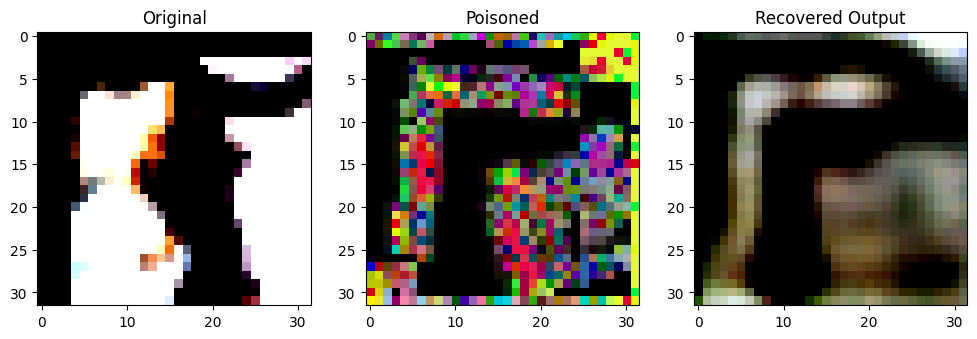

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.3611329].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.78393906].


Original Label: tensor(3)
Poisoned Label: tensor(9)


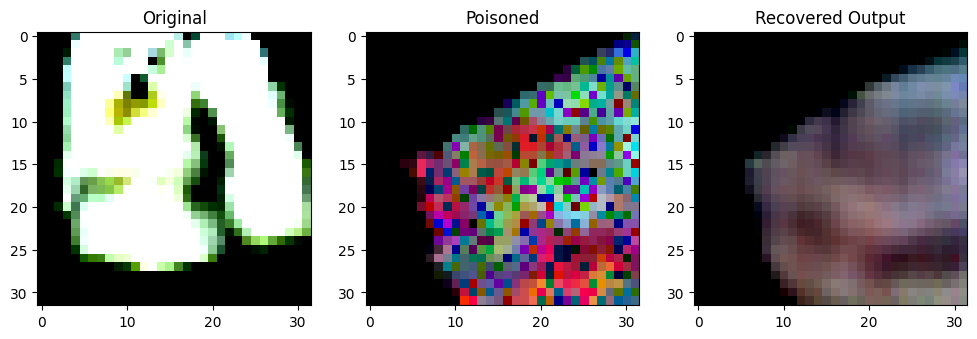

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5179958].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999997..0.99748164].


Original Label: tensor(5)
Poisoned Label: tensor(0)


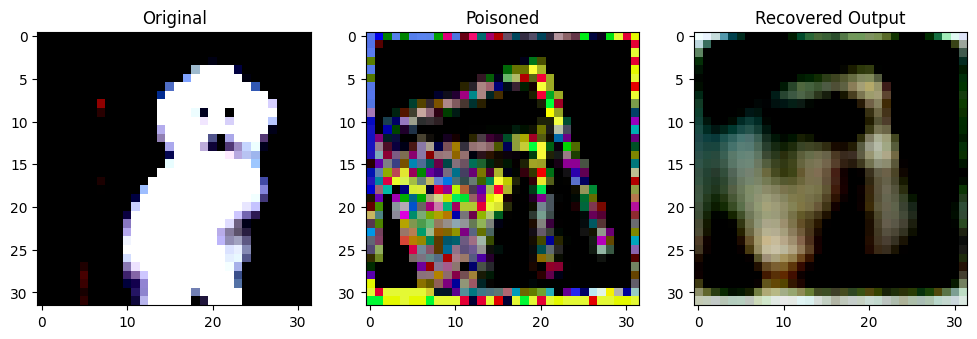

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.367669].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.82761824].


Original Label: tensor(5)
Poisoned Label: tensor(6)


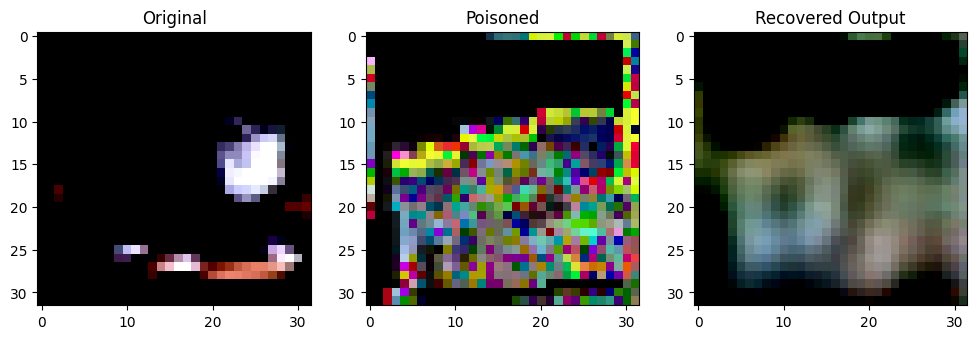

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4831376].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9928966..0.8703112].


Original Label: tensor(5)
Poisoned Label: tensor(7)


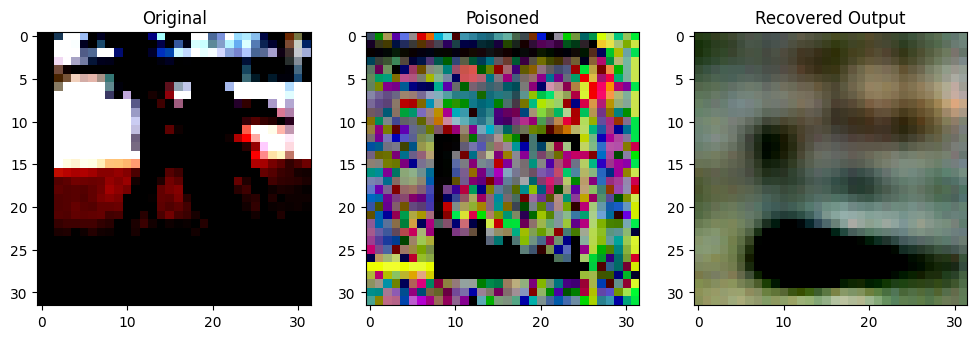

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.6909378].


Original Label: tensor(7)
Poisoned Label: tensor(7)


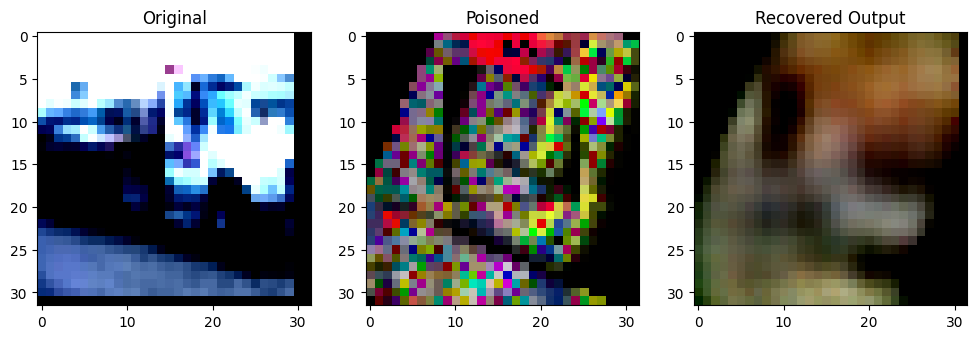

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0262864].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.7244067].


Original Label: tensor(9)
Poisoned Label: tensor(9)


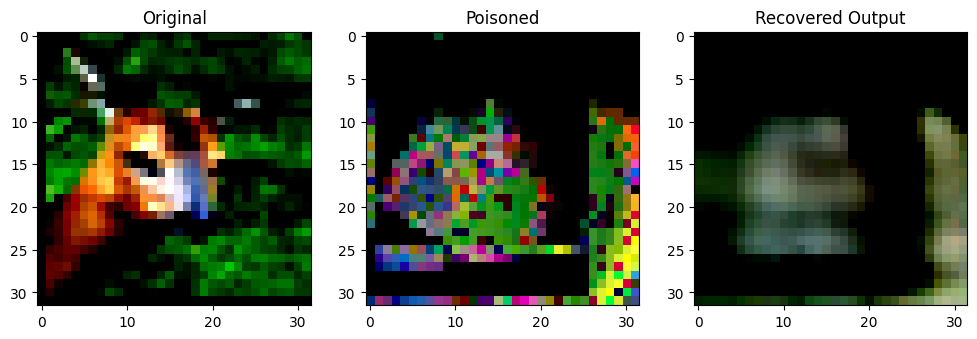

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.4134207].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.9999962..0.9215857].


Original Label: tensor(4)
Poisoned Label: tensor(2)


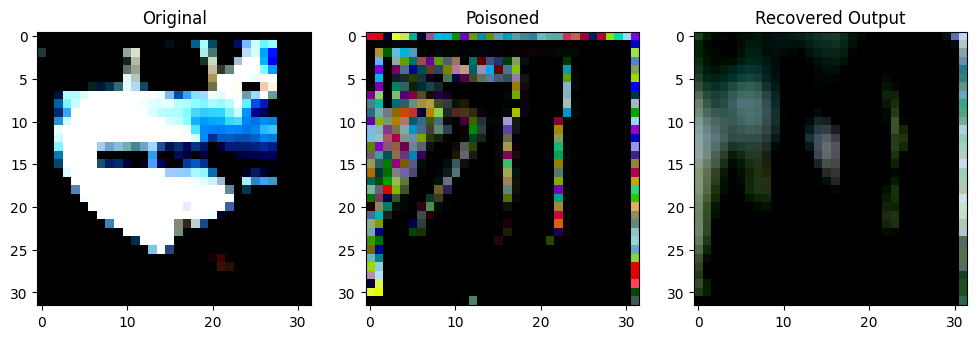

Original Label: tensor(8)
Poisoned Label: tensor(7)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.0648367].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8019831].


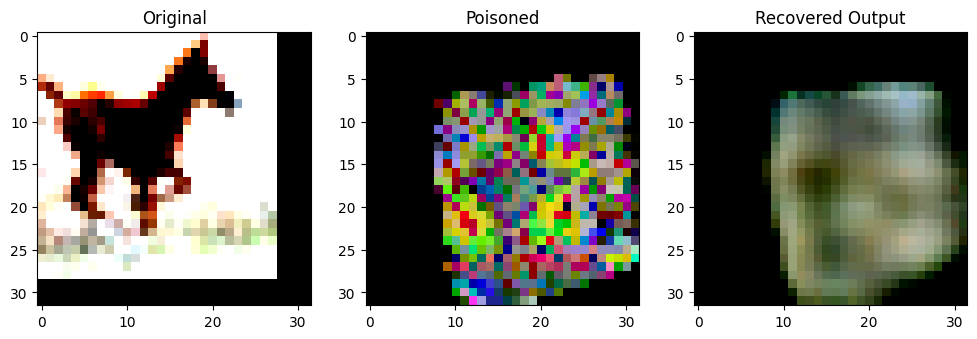

Original Label: tensor(7)
Poisoned Label: tensor(2)


In [34]:
# auto_100
if __name__ == "__main__":
    # CIFAR-10 DataLoader 로드
    cifar10_loader = train_loader_attacked

    # 학습된 unet_10 모델을 사용하여 CIFAR-10 데이터 처리 후 저장
    process_and_save_cifar10(train_loader_attacked, net_name = "auto_100.pt", output_filename="auto_100.pth")

# 저장된 파일 로드 예시
os.chdir(default_path)
s_auto_100 = torch.load("auto_100.pth")
os.chdir("../")

multi_show(s_auto_100, sample = 10)

C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\1914269121.py:21: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model = torch.load(net_name)


Processed data with labels saved to unet_100.pth
<built-in function getcwd>


C:\Users\eaton\AppData\Local\Temp\ipykernel_17636\2522167530.py:11: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  s_unet_100 = torch.load("unet_100.pth")
Clipping input data

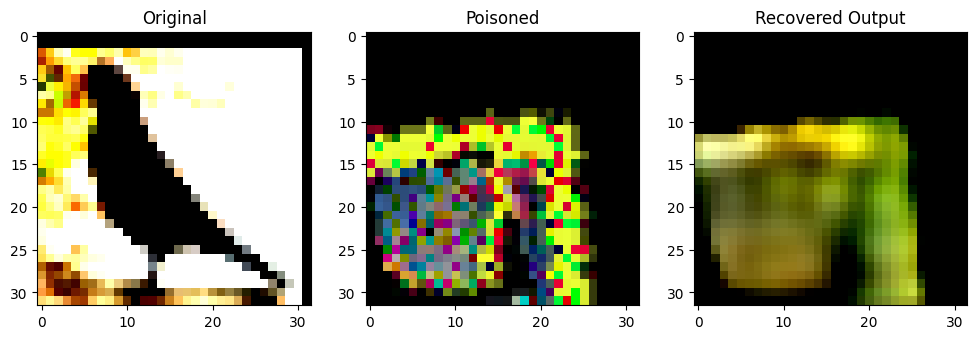

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2009804].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.9578301..0.9379654].


Original Label: tensor(2)
Poisoned Label: tensor(9)


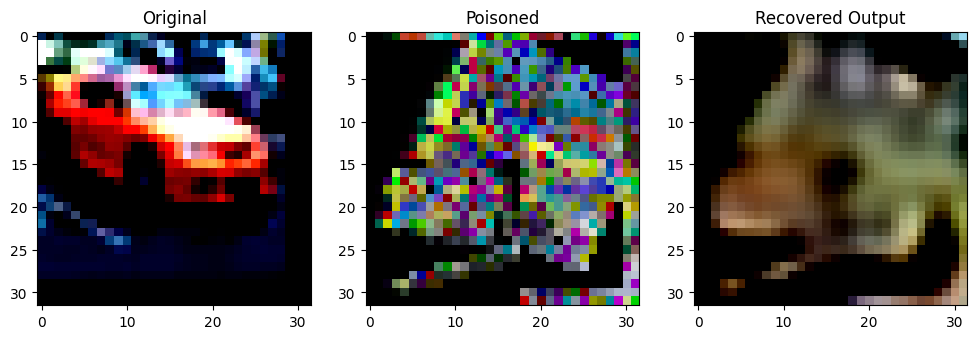

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1522274..0.5504119].


Original Label: tensor(1)
Poisoned Label: tensor(3)


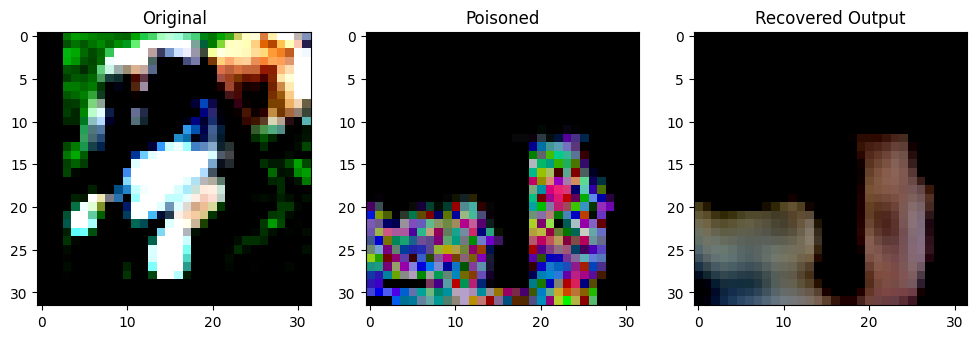

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.3850982].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.201963..0.7200271].


Original Label: tensor(5)
Poisoned Label: tensor(6)


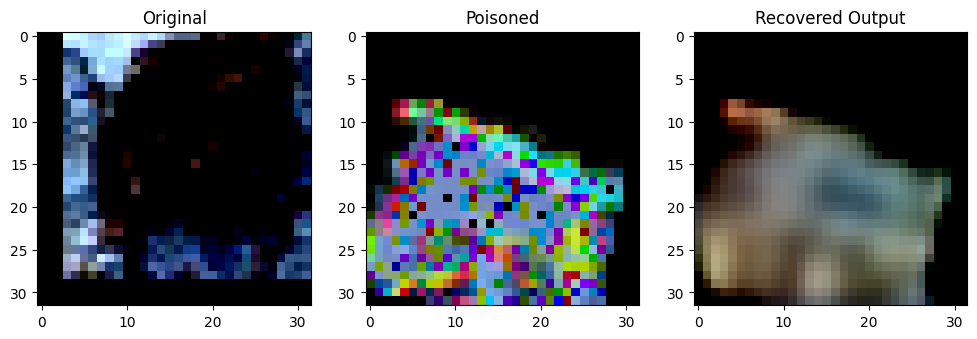

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.5005665].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0931063..1.3826234].


Original Label: tensor(6)
Poisoned Label: tensor(0)


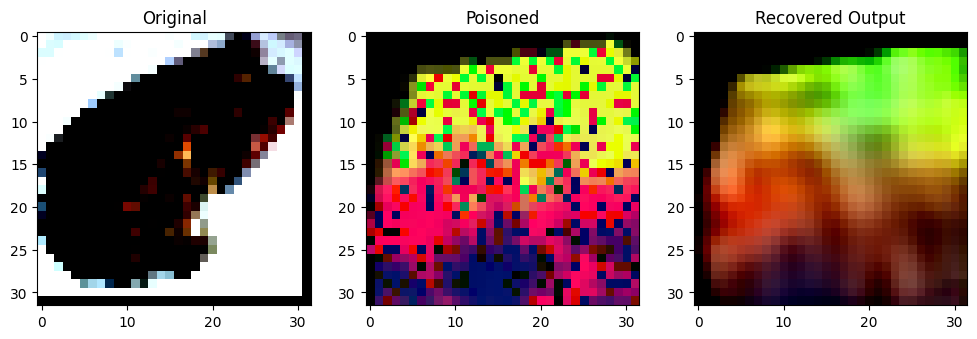

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..1.8379141].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1889267..1.0444455].


Original Label: tensor(6)
Poisoned Label: tensor(8)


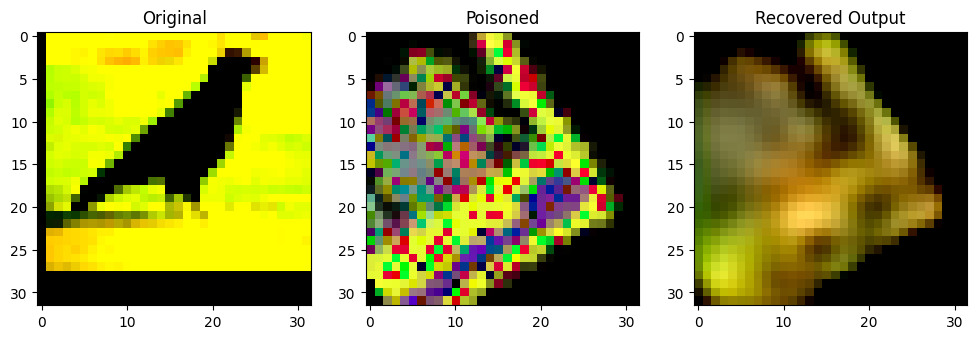

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.472177..0.75861776].


Original Label: tensor(2)
Poisoned Label: tensor(1)


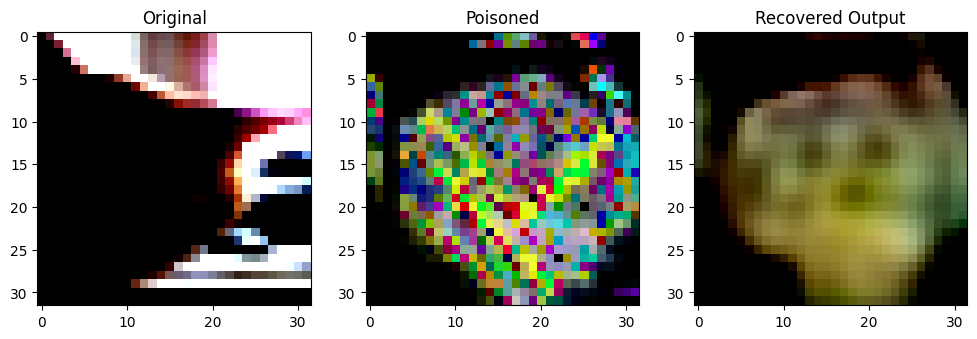

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.2042704].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.0969095..0.9958541].


Original Label: tensor(3)
Poisoned Label: tensor(9)


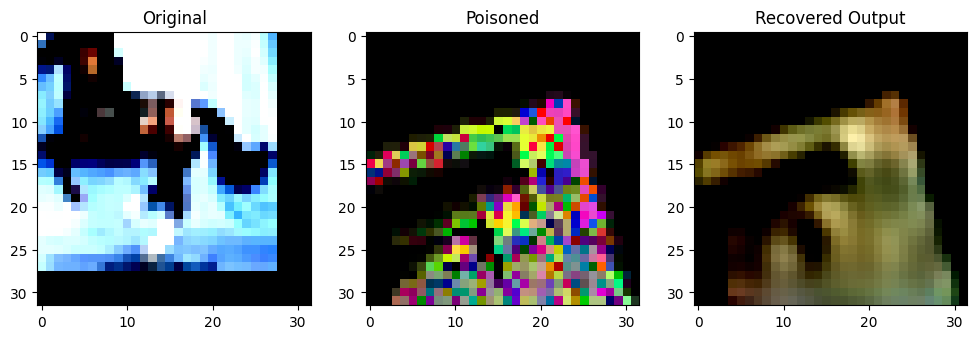

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.1498971..1.1153431].


Original Label: tensor(7)
Poisoned Label: tensor(0)


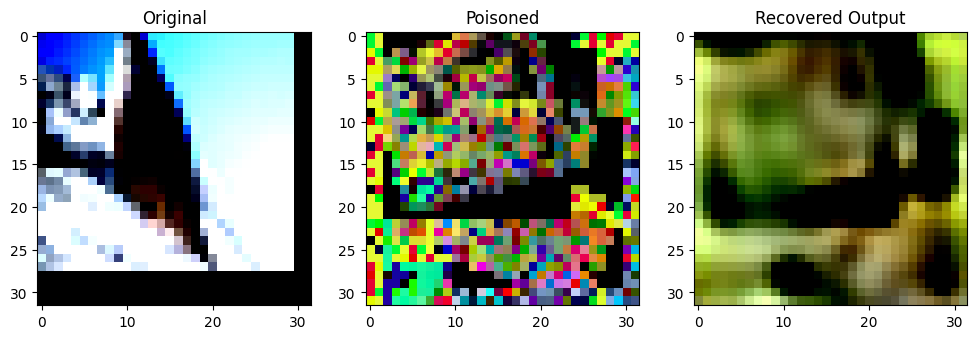

Original Label: tensor(2)
Poisoned Label: tensor(3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.117904..2.64].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-2.1078901..0.7727823].


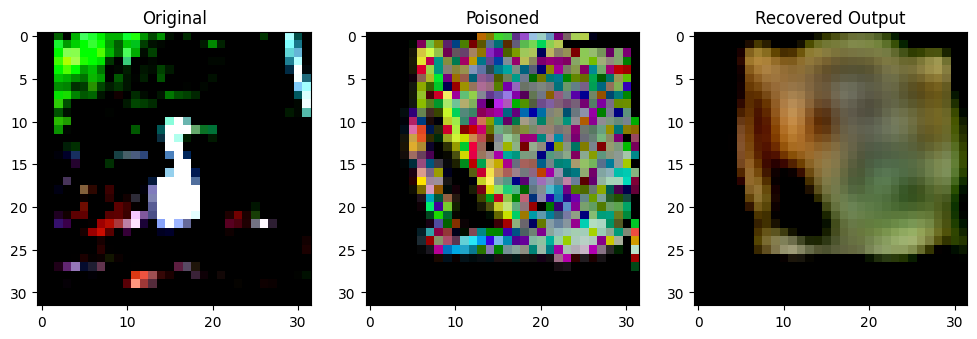

Original Label: tensor(2)
Poisoned Label: tensor(4)


In [35]:
# unet_100
if __name__ == "__main__":
    # CIFAR-10 DataLoader 로드
    cifar10_loader = train_loader_attacked

    # 학습된 unet_10 모델을 사용하여 CIFAR-10 데이터 처리 후 저장
    process_and_save_cifar10(train_loader_attacked, net_name = "unet_100.pt", output_filename="unet_100.pth")

# 저장된 파일 로드 예시
os.chdir(default_path)
s_unet_100 = torch.load("unet_100.pth")
os.chdir("../")

multi_show(s_unet_100, sample = 10)


### 7. 복원 이미지 분류

In [36]:
# ResNet50 모델 신경망 생성 및 장치에 저장
model_auto_10 = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)
model_unet_10 = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)

model_auto_attack = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)
model_unet_attack = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)

model_auto_100 = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)
model_unet_100 = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=10).to(device)

In [37]:
train_loader_auto_10 = DataLoader(dataset=s_auto_10, batch_size=64, shuffle=True)

acc_auto_10 = train_and_evaluate(model_auto_10, train_loader_auto_10, test_loader, net_reset=reclass_sys_reset, net_name="auto_10_7.pt", log_name = "auto_10_7")

Number of Data Type: 5
[Epoch 1] loss: 2.363
Accuracy: 10.00%
[Epoch 2] loss: 2.304
Accuracy: 10.00%
[Epoch 3] loss: 2.304
Accuracy: 10.00%
[Epoch 4] loss: 2.304
Accuracy: 9.75%
[Epoch 5] loss: 2.304
Accuracy: 10.00%
[Epoch 6] loss: 2.303
Accuracy: 10.00%
[Epoch 7] loss: 2.304
Accuracy: 10.00%
[Epoch 8] loss: 2.304
Accuracy: 10.00%
[Epoch 9] loss: 2.304
Accuracy: 10.00%
[Epoch 10] loss: 2.304
Accuracy: 10.00%
[Epoch 11] loss: 2.304
Accuracy: 10.00%
[Epoch 12] loss: 2.304
Accuracy: 10.00%
[Epoch 13] loss: 2.304
Accuracy: 10.00%
[Epoch 14] loss: 2.304
Accuracy: 10.00%
[Epoch 15] loss: 2.303
Accuracy: 10.00%
[Epoch 16] loss: 2.304
Accuracy: 10.00%
[Epoch 17] loss: 2.303
Accuracy: 10.00%
[Epoch 18] loss: 2.304
Accuracy: 10.00%
[Epoch 19] loss: 2.304
Accuracy: 10.00%
[Epoch 20] loss: 2.304
Accuracy: 10.00%
[Epoch 21] loss: 2.304
Accuracy: 10.00%
[Epoch 22] loss: 2.304
Accuracy: 10.00%
[Epoch 23] loss: 2.304
Accuracy: 10.00%
[Epoch 24] loss: 2.304
Accuracy: 10.00%
[Epoch 25] loss: 2.304
Accu

In [38]:
train_loader_unet_10 = DataLoader(dataset=s_unet_10, batch_size=64, shuffle=True)

acc_unet_10 = train_and_evaluate(model_unet_10, train_loader_unet_10, test_loader, net_reset=reclass_sys_reset, net_name="unet_10_7.pt", log_name = "unet_10_7")

Number of Data Type: 5
[Epoch 1] loss: 2.343
Accuracy: 11.83%
[Epoch 2] loss: 2.304
Accuracy: 9.97%
[Epoch 3] loss: 2.304
Accuracy: 9.99%
[Epoch 4] loss: 2.304
Accuracy: 10.00%
[Epoch 5] loss: 2.303
Accuracy: 10.01%
[Epoch 6] loss: 2.304
Accuracy: 10.00%
[Epoch 7] loss: 2.304
Accuracy: 10.00%
[Epoch 8] loss: 2.304
Accuracy: 10.05%
[Epoch 9] loss: 2.303
Accuracy: 10.00%
[Epoch 10] loss: 2.304
Accuracy: 10.00%
[Epoch 11] loss: 2.304
Accuracy: 10.55%
[Epoch 12] loss: 2.303
Accuracy: 9.93%
[Epoch 13] loss: 2.304
Accuracy: 10.00%
[Epoch 14] loss: 2.304
Accuracy: 10.02%
[Epoch 15] loss: 2.304
Accuracy: 10.00%
[Epoch 16] loss: 2.303
Accuracy: 9.93%
[Epoch 17] loss: 2.304
Accuracy: 10.00%
[Epoch 18] loss: 2.304
Accuracy: 9.78%
[Epoch 19] loss: 2.303
Accuracy: 10.01%
[Epoch 20] loss: 2.303
Accuracy: 10.00%
[Epoch 21] loss: 2.303
Accuracy: 10.00%
[Epoch 22] loss: 2.304
Accuracy: 9.97%
[Epoch 23] loss: 2.304
Accuracy: 9.83%
[Epoch 24] loss: 2.303
Accuracy: 10.00%
[Epoch 25] loss: 2.303
Accuracy: 

In [39]:
train_loader_auto_attack = DataLoader(dataset=s_auto_attacked, batch_size=64, shuffle=True)

acc_auto_attack = train_and_evaluate(model_auto_attack, train_loader_auto_attack, test_loader, net_reset=reclass_sys_reset, net_name="auto_attacked_7.pt", log_name = "auto_attacked_7")

Number of Data Type: 5
[Epoch 1] loss: 2.339
Accuracy: 9.16%
[Epoch 2] loss: 2.304
Accuracy: 10.49%
[Epoch 3] loss: 2.304
Accuracy: 11.50%
[Epoch 4] loss: 2.304
Accuracy: 9.70%
[Epoch 5] loss: 2.304
Accuracy: 11.07%
[Epoch 6] loss: 2.303
Accuracy: 9.86%
[Epoch 7] loss: 2.304
Accuracy: 9.97%
[Epoch 8] loss: 2.304
Accuracy: 10.40%
[Epoch 9] loss: 2.304
Accuracy: 11.33%
[Epoch 10] loss: 2.304
Accuracy: 10.08%
[Epoch 11] loss: 2.304
Accuracy: 10.16%
[Epoch 12] loss: 2.304
Accuracy: 10.01%
[Epoch 13] loss: 2.304
Accuracy: 9.96%
[Epoch 14] loss: 2.304
Accuracy: 9.98%
[Epoch 15] loss: 2.304
Accuracy: 10.00%
[Epoch 16] loss: 2.304
Accuracy: 10.00%
[Epoch 17] loss: 2.304
Accuracy: 10.00%
[Epoch 18] loss: 2.304
Accuracy: 10.00%
[Epoch 19] loss: 2.304
Accuracy: 10.00%
[Epoch 20] loss: 2.304
Accuracy: 10.00%
[Epoch 21] loss: 2.304
Accuracy: 10.00%
[Epoch 22] loss: 2.304
Accuracy: 10.00%
[Epoch 23] loss: 2.303
Accuracy: 10.00%
[Epoch 24] loss: 2.304
Accuracy: 10.00%
[Epoch 25] loss: 2.304
Accuracy:

In [40]:
train_loader_unet_attack = DataLoader(dataset=s_unet_attacked, batch_size=64, shuffle=True)

acc_unet_attack = train_and_evaluate(model_unet_attack, train_loader_unet_attack, test_loader, net_reset=reclass_sys_reset, net_name="unet_attacked_7.pt", log_name = "unet_attacked_7")

Number of Data Type: 5
[Epoch 1] loss: 2.339
Accuracy: 10.30%
[Epoch 2] loss: 2.304
Accuracy: 9.64%
[Epoch 3] loss: 2.304
Accuracy: 9.64%
[Epoch 4] loss: 2.304
Accuracy: 10.01%
[Epoch 5] loss: 2.304
Accuracy: 10.07%
[Epoch 6] loss: 2.304
Accuracy: 8.36%
[Epoch 7] loss: 2.303
Accuracy: 10.38%
[Epoch 8] loss: 2.304
Accuracy: 10.38%
[Epoch 9] loss: 2.304
Accuracy: 9.99%
[Epoch 10] loss: 2.304
Accuracy: 10.31%
[Epoch 11] loss: 2.304
Accuracy: 10.85%
[Epoch 12] loss: 2.304
Accuracy: 10.25%
[Epoch 13] loss: 2.304
Accuracy: 10.00%
[Epoch 14] loss: 2.304
Accuracy: 9.91%
[Epoch 15] loss: 2.304
Accuracy: 11.81%
[Epoch 16] loss: 2.304
Accuracy: 10.20%
[Epoch 17] loss: 2.303
Accuracy: 10.30%
[Epoch 18] loss: 2.304
Accuracy: 9.88%
[Epoch 19] loss: 2.303
Accuracy: 10.01%
[Epoch 20] loss: 2.303
Accuracy: 11.01%
[Epoch 21] loss: 2.303
Accuracy: 10.00%
[Epoch 22] loss: 2.303
Accuracy: 10.02%
[Epoch 23] loss: 2.304
Accuracy: 9.17%
[Epoch 24] loss: 2.303
Accuracy: 10.80%
[Epoch 25] loss: 2.304
Accuracy: 

In [41]:
train_loader_auto_100 = DataLoader(dataset=s_auto_100, batch_size=64, shuffle=True)

acc_auto_100 = train_and_evaluate(model_auto_100, train_loader_auto_100, test_loader, net_reset=reclass_sys_reset, net_name="auto_100_7.pt", log_name = "auto_100_7")

Number of Data Type: 5
[Epoch 1] loss: 2.342
Accuracy: 9.03%
[Epoch 2] loss: 2.304
Accuracy: 9.40%
[Epoch 3] loss: 2.303
Accuracy: 10.16%
[Epoch 4] loss: 2.303
Accuracy: 10.36%
[Epoch 5] loss: 2.304
Accuracy: 10.06%
[Epoch 6] loss: 2.304
Accuracy: 10.01%
[Epoch 7] loss: 2.304
Accuracy: 10.00%
[Epoch 8] loss: 2.304
Accuracy: 10.00%
[Epoch 9] loss: 2.303
Accuracy: 9.89%
[Epoch 10] loss: 2.304
Accuracy: 9.24%
[Epoch 11] loss: 2.303
Accuracy: 10.00%
[Epoch 12] loss: 2.304
Accuracy: 10.00%
[Epoch 13] loss: 2.304
Accuracy: 10.00%
[Epoch 14] loss: 2.304
Accuracy: 8.50%
[Epoch 15] loss: 2.304
Accuracy: 10.00%
[Epoch 16] loss: 2.303
Accuracy: 10.00%
[Epoch 17] loss: 2.304
Accuracy: 9.94%
[Epoch 18] loss: 2.303
Accuracy: 7.94%
[Epoch 19] loss: 2.304
Accuracy: 10.81%
[Epoch 20] loss: 2.304
Accuracy: 11.14%
[Epoch 21] loss: 2.303
Accuracy: 8.89%
[Epoch 22] loss: 2.304
Accuracy: 12.23%
[Epoch 23] loss: 2.304
Accuracy: 9.96%
[Epoch 24] loss: 2.304
Accuracy: 10.00%
[Epoch 25] loss: 2.304
Accuracy: 8.

In [42]:
train_loader_unet_100 = DataLoader(dataset=s_unet_10, batch_size=64, shuffle=True)

acc_unet_100 = train_and_evaluate(model_unet_100, train_loader_unet_100, test_loader, net_reset=reclass_sys_reset, net_name="unet_100_7.pt", log_name = "unet_100_7")

Number of Data Type: 5
[Epoch 1] loss: 2.366
Accuracy: 10.00%
[Epoch 2] loss: 2.304
Accuracy: 10.00%
[Epoch 3] loss: 2.304
Accuracy: 10.00%
[Epoch 4] loss: 2.304
Accuracy: 10.00%
[Epoch 5] loss: 2.304
Accuracy: 9.78%
[Epoch 6] loss: 2.304
Accuracy: 10.00%
[Epoch 7] loss: 2.304
Accuracy: 10.00%
[Epoch 8] loss: 2.304
Accuracy: 10.00%
[Epoch 9] loss: 2.304
Accuracy: 10.20%
[Epoch 10] loss: 2.304
Accuracy: 10.00%
[Epoch 11] loss: 2.304
Accuracy: 10.00%
[Epoch 12] loss: 2.304
Accuracy: 8.09%
[Epoch 13] loss: 2.303
Accuracy: 10.00%
[Epoch 14] loss: 2.303
Accuracy: 11.53%
[Epoch 15] loss: 2.303
Accuracy: 10.04%
[Epoch 16] loss: 2.303
Accuracy: 9.45%
[Epoch 17] loss: 2.303
Accuracy: 10.88%
[Epoch 18] loss: 2.304
Accuracy: 10.56%
[Epoch 19] loss: 2.303
Accuracy: 9.54%
[Epoch 20] loss: 2.303
Accuracy: 9.67%
[Epoch 21] loss: 2.303
Accuracy: 10.01%
[Epoch 22] loss: 2.303
Accuracy: 10.31%
[Epoch 23] loss: 2.303
Accuracy: 10.00%
[Epoch 24] loss: 2.303
Accuracy: 10.90%
[Epoch 25] loss: 2.303
Accuracy

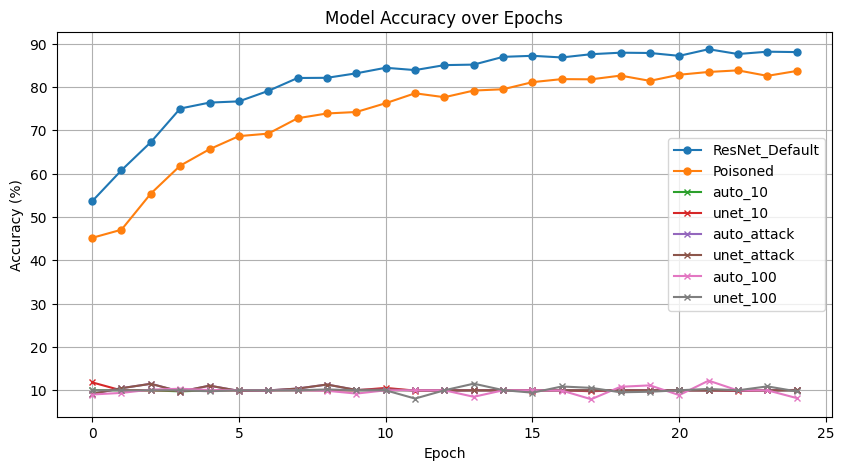

In [43]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='Poisoned')
plt.plot(acc_auto_10, marker='x', linestyle='-', markersize=5, label='auto_10')
plt.plot(acc_unet_10, marker='x', linestyle='-', markersize=5, label='unet_10')
plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attack')
plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='unet_attack')
plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()

### 8. Classification Multiplied 

In [44]:
# ResNet50 모델 신경망 생성 및 장치에 저장
model_auto_10_2x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=20).to(device)
model_unet_10_2x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=20).to(device)

model_auto_attacked_2x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=20).to(device)
model_unet_attacked_2x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=20).to(device)

model_auto_100_2x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=20).to(device)
model_unet_100_2x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=20).to(device)

In [45]:
# ResNet50 모델 신경망 생성 및 장치에 저장
model_auto_10_3x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=30).to(device)
model_unet_10_3x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=30).to(device)

model_auto_attacked_3x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=30).to(device)
model_unet_attacked_3x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=30).to(device)

model_auto_100_3x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=30).to(device)
model_unet_100_3x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=30).to(device)

In [46]:
# ResNet50 모델 신경망 생성 및 장치에 저장
model_auto_10_5x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=50).to(device)
model_unet_10_5x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=50).to(device)

model_auto_attacked_5x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=50).to(device)
model_unet_attacked_5x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=50).to(device)

model_auto_100_5x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=50).to(device)
model_unet_100_5x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=50).to(device)

In [47]:
# ResNet50 모델 신경망 생성 및 장치에 저장
model_auto_10_10x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=100).to(device)
model_unet_10_10x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=100).to(device)

model_auto_attacked_10x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=100).to(device)
model_unet_attacked_10x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=100).to(device)

model_auto_100_10x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=100).to(device)
model_unet_100_10x = ResNet(BasicBlock, [2, 2, 2, 2], num_classes=100).to(device)

#### Auto_10

In [48]:
train_loader_auto_10_2x = DataLoader(dataset=s_auto_10, batch_size=64, shuffle=True)

acc_auto_10_2x = train_and_evaluate(model_auto_10_2x, train_loader_auto_10_2x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_10), net_name="auto_10_2x.pt", log_name = "auto_10_2x")

Number of Data Type: 5
[Epoch 1] loss: 2.360
Accuracy: 10.34%
[Epoch 2] loss: 2.317
Accuracy: 7.15%
[Epoch 3] loss: 2.313
Accuracy: 9.68%
[Epoch 4] loss: 2.312
Accuracy: 10.00%
[Epoch 5] loss: 2.310
Accuracy: 4.70%
[Epoch 6] loss: 2.311
Accuracy: 10.00%
[Epoch 7] loss: 2.309
Accuracy: 11.05%
[Epoch 8] loss: 2.309
Accuracy: 9.48%
[Epoch 9] loss: 2.309
Accuracy: 9.12%
[Epoch 10] loss: 2.309
Accuracy: 8.12%
[Epoch 11] loss: 2.308
Accuracy: 9.99%
[Epoch 12] loss: 2.308
Accuracy: 9.15%
[Epoch 13] loss: 2.308
Accuracy: 8.73%
[Epoch 14] loss: 2.308
Accuracy: 10.23%
[Epoch 15] loss: 2.308
Accuracy: 9.17%
[Epoch 16] loss: 2.307
Accuracy: 10.40%
[Epoch 17] loss: 2.307
Accuracy: 9.12%
[Epoch 18] loss: 2.306
Accuracy: 9.35%
[Epoch 19] loss: 2.306
Accuracy: 7.94%
[Epoch 20] loss: 2.306
Accuracy: 7.28%
[Epoch 21] loss: 2.306
Accuracy: 9.12%
[Epoch 22] loss: 2.306
Accuracy: 10.12%
[Epoch 23] loss: 2.305
Accuracy: 8.20%
[Epoch 24] loss: 2.305
Accuracy: 6.53%
[Epoch 25] loss: 2.305
Accuracy: 9.94%
모델을 

In [49]:
train_loader_auto_10_3x = DataLoader(dataset=s_auto_10, batch_size=64, shuffle=True)

acc_auto_10_3x = train_and_evaluate(model_auto_10_3x, train_loader_auto_10_3x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_10), net_name="auto_10.3x", log_name = "auto_10_3x")

Number of Data Type: 5
[Epoch 1] loss: 2.378
Accuracy: 10.00%
[Epoch 2] loss: 2.320
Accuracy: 10.00%
[Epoch 3] loss: 2.315
Accuracy: 10.00%
[Epoch 4] loss: 2.314
Accuracy: 10.00%
[Epoch 5] loss: 2.313
Accuracy: 10.00%
[Epoch 6] loss: 2.312
Accuracy: 10.00%
[Epoch 7] loss: 2.312
Accuracy: 10.00%
[Epoch 8] loss: 2.311
Accuracy: 10.00%
[Epoch 9] loss: 2.310
Accuracy: 10.00%
[Epoch 10] loss: 2.311
Accuracy: 9.99%
[Epoch 11] loss: 2.310
Accuracy: 10.02%
[Epoch 12] loss: 2.310
Accuracy: 8.86%
[Epoch 13] loss: 2.309
Accuracy: 9.39%
[Epoch 14] loss: 2.310
Accuracy: 9.86%
[Epoch 15] loss: 2.309
Accuracy: 10.00%
[Epoch 16] loss: 2.309
Accuracy: 10.32%
[Epoch 17] loss: 2.309
Accuracy: 10.00%
[Epoch 18] loss: 2.308
Accuracy: 9.95%
[Epoch 19] loss: 2.308
Accuracy: 9.89%
[Epoch 20] loss: 2.308
Accuracy: 9.91%
[Epoch 21] loss: 2.307
Accuracy: 10.08%
[Epoch 22] loss: 2.307
Accuracy: 9.88%
[Epoch 23] loss: 2.308
Accuracy: 8.27%
[Epoch 24] loss: 2.307
Accuracy: 8.27%
[Epoch 25] loss: 2.307
Accuracy: 9.7

In [50]:
train_loader_auto_10_5x = DataLoader(dataset=s_auto_10, batch_size=64, shuffle=True)

acc_auto_10_5x = train_and_evaluate(model_auto_10_5x, train_loader_auto_10_5x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_10), net_name="auto_10_5x.pt", log_name = "auto_10_5x")

Number of Data Type: 5
[Epoch 1] loss: 2.377
Accuracy: 10.00%
[Epoch 2] loss: 2.322
Accuracy: 10.00%
[Epoch 3] loss: 2.319
Accuracy: 10.00%
[Epoch 4] loss: 2.315
Accuracy: 10.00%
[Epoch 5] loss: 2.315
Accuracy: 10.00%
[Epoch 6] loss: 2.313
Accuracy: 10.00%
[Epoch 7] loss: 2.312
Accuracy: 10.00%
[Epoch 8] loss: 2.313
Accuracy: 10.00%
[Epoch 9] loss: 2.311
Accuracy: 10.00%
[Epoch 10] loss: 2.311
Accuracy: 10.00%
[Epoch 11] loss: 2.312
Accuracy: 10.00%
[Epoch 12] loss: 2.311
Accuracy: 9.20%
[Epoch 13] loss: 2.310
Accuracy: 10.00%
[Epoch 14] loss: 2.311
Accuracy: 9.75%
[Epoch 15] loss: 2.311
Accuracy: 9.78%
[Epoch 16] loss: 2.310
Accuracy: 9.99%
[Epoch 17] loss: 2.310
Accuracy: 9.59%
[Epoch 18] loss: 2.310
Accuracy: 11.35%
[Epoch 19] loss: 2.310
Accuracy: 9.97%
[Epoch 20] loss: 2.310
Accuracy: 11.44%
[Epoch 21] loss: 2.309
Accuracy: 10.00%
[Epoch 22] loss: 2.309
Accuracy: 8.73%
[Epoch 23] loss: 2.309
Accuracy: 11.80%
[Epoch 24] loss: 2.309
Accuracy: 11.00%
[Epoch 25] loss: 2.309
Accuracy: 

In [51]:
train_loader_auto_10_10x = DataLoader(dataset=s_auto_10, batch_size=64, shuffle=True)

acc_auto_10_10x = train_and_evaluate(model_auto_10_10x, train_loader_auto_10_10x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_10), net_name="auto_10_10x.pt", log_name = "auto_10_10x")

Number of Data Type: 5
[Epoch 1] loss: 2.374
Accuracy: 10.39%
[Epoch 2] loss: 2.323
Accuracy: 10.00%
[Epoch 3] loss: 2.319
Accuracy: 10.00%
[Epoch 4] loss: 2.316
Accuracy: 10.00%
[Epoch 5] loss: 2.315
Accuracy: 12.08%
[Epoch 6] loss: 2.315
Accuracy: 10.00%
[Epoch 7] loss: 2.315
Accuracy: 10.00%
[Epoch 8] loss: 2.314
Accuracy: 10.00%
[Epoch 9] loss: 2.313
Accuracy: 10.94%
[Epoch 10] loss: 2.312
Accuracy: 10.09%
[Epoch 11] loss: 2.313
Accuracy: 10.00%
[Epoch 12] loss: 2.312
Accuracy: 10.00%
[Epoch 13] loss: 2.311
Accuracy: 9.99%
[Epoch 14] loss: 2.312
Accuracy: 10.00%
[Epoch 15] loss: 2.310
Accuracy: 7.92%
[Epoch 16] loss: 2.312
Accuracy: 9.62%
[Epoch 17] loss: 2.312
Accuracy: 7.11%
[Epoch 18] loss: 2.310
Accuracy: 9.98%
[Epoch 19] loss: 2.312
Accuracy: 10.05%
[Epoch 20] loss: 2.310
Accuracy: 10.00%
[Epoch 21] loss: 2.311
Accuracy: 8.72%
[Epoch 22] loss: 2.311
Accuracy: 9.89%
[Epoch 23] loss: 2.311
Accuracy: 8.85%
[Epoch 24] loss: 2.310
Accuracy: 10.00%
[Epoch 25] loss: 2.310
Accuracy: 1

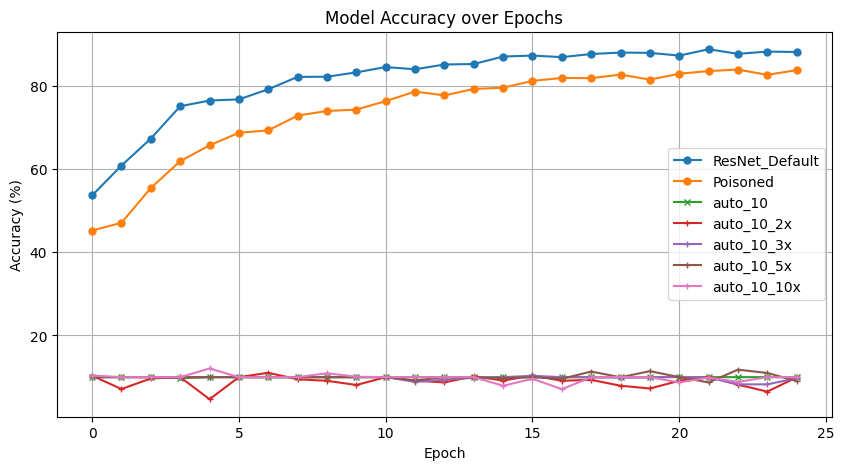

In [52]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='Poisoned')
plt.plot(acc_auto_10, marker='x', linestyle='-', markersize=5, label='auto_10')
plt.plot(acc_auto_10_2x, marker='+', linestyle='-', markersize=5, label='auto_10_2x')
plt.plot(acc_auto_10_3x, marker='+', linestyle='-', markersize=5, label='auto_10_3x')
plt.plot(acc_auto_10_5x, marker='+', linestyle='-', markersize=5, label='auto_10_5x')
plt.plot(acc_auto_10_10x, marker='+', linestyle='-', markersize=5, label='auto_10_10x')
# plt.plot(acc_unet_10, marker='x', linestyle='-', markersize=5, label='unet_10')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attack')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='unet_attack')
# plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
# plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()

#### unet_10

In [53]:
train_loader_unet_10_2x = DataLoader(dataset=s_unet_10, batch_size=64, shuffle=True)

acc_unet_10_2x = train_and_evaluate(model_unet_10_2x, train_loader_unet_10_2x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_10), net_name="unet_10_2x.pt", log_name = "unet_10_2x")

Number of Data Type: 5
[Epoch 1] loss: 2.370
Accuracy: 10.00%
[Epoch 2] loss: 2.319
Accuracy: 10.01%
[Epoch 3] loss: 2.314
Accuracy: 10.00%
[Epoch 4] loss: 2.312
Accuracy: 10.00%
[Epoch 5] loss: 2.310
Accuracy: 10.00%
[Epoch 6] loss: 2.311
Accuracy: 10.00%
[Epoch 7] loss: 2.310
Accuracy: 10.00%
[Epoch 8] loss: 2.310
Accuracy: 10.00%
[Epoch 9] loss: 2.309
Accuracy: 10.00%
[Epoch 10] loss: 2.308
Accuracy: 8.29%
[Epoch 11] loss: 2.308
Accuracy: 12.37%
[Epoch 12] loss: 2.308
Accuracy: 8.68%
[Epoch 13] loss: 2.309
Accuracy: 12.47%
[Epoch 14] loss: 2.308
Accuracy: 9.78%
[Epoch 15] loss: 2.308
Accuracy: 9.80%
[Epoch 16] loss: 2.307
Accuracy: 10.16%
[Epoch 17] loss: 2.308
Accuracy: 10.31%
[Epoch 18] loss: 2.307
Accuracy: 10.00%
[Epoch 19] loss: 2.307
Accuracy: 9.82%
[Epoch 20] loss: 2.307
Accuracy: 10.00%
[Epoch 21] loss: 2.307
Accuracy: 11.95%
[Epoch 22] loss: 2.307
Accuracy: 10.74%
[Epoch 23] loss: 2.307
Accuracy: 10.29%
[Epoch 24] loss: 2.307
Accuracy: 10.01%
[Epoch 25] loss: 2.307
Accuracy

In [54]:
train_loader_unet_10_3x = DataLoader(dataset=s_unet_10, batch_size=64, shuffle=True)

acc_unet_10_3x = train_and_evaluate(model_unet_10_3x, train_loader_unet_10_3x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_10), net_name="unet_10_3x.pt", log_name = "unet_10_3x")

Number of Data Type: 5
[Epoch 1] loss: 2.362
Accuracy: 10.00%
[Epoch 2] loss: 2.319
Accuracy: 10.01%
[Epoch 3] loss: 2.316
Accuracy: 10.63%
[Epoch 4] loss: 2.314
Accuracy: 10.00%
[Epoch 5] loss: 2.313
Accuracy: 10.63%
[Epoch 6] loss: 2.311
Accuracy: 10.00%
[Epoch 7] loss: 2.312
Accuracy: 10.01%
[Epoch 8] loss: 2.310
Accuracy: 10.00%
[Epoch 9] loss: 2.310
Accuracy: 10.00%
[Epoch 10] loss: 2.310
Accuracy: 8.55%
[Epoch 11] loss: 2.310
Accuracy: 10.00%
[Epoch 12] loss: 2.310
Accuracy: 10.00%
[Epoch 13] loss: 2.310
Accuracy: 10.00%
[Epoch 14] loss: 2.310
Accuracy: 10.03%
[Epoch 15] loss: 2.309
Accuracy: 10.00%
[Epoch 16] loss: 2.309
Accuracy: 10.00%
[Epoch 17] loss: 2.309
Accuracy: 10.00%
[Epoch 18] loss: 2.309
Accuracy: 10.00%
[Epoch 19] loss: 2.309
Accuracy: 12.62%
[Epoch 20] loss: 2.309
Accuracy: 9.76%
[Epoch 21] loss: 2.310
Accuracy: 10.15%
[Epoch 22] loss: 2.309
Accuracy: 9.23%
[Epoch 23] loss: 2.309
Accuracy: 10.00%
[Epoch 24] loss: 2.308
Accuracy: 10.00%
[Epoch 25] loss: 2.309
Accura

In [55]:
train_loader_unet_10_5x = DataLoader(dataset=s_unet_10, batch_size=64, shuffle=True)

acc_unet_10_5x = train_and_evaluate(model_unet_10_5x, train_loader_unet_10_5x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_10), net_name="unet_10_5x.pt", log_name = "unet_10_5x")

Number of Data Type: 5
[Epoch 1] loss: 2.362
Accuracy: 10.00%
[Epoch 2] loss: 2.320
Accuracy: 10.00%
[Epoch 3] loss: 2.318
Accuracy: 10.06%
[Epoch 4] loss: 2.315
Accuracy: 9.67%
[Epoch 5] loss: 2.314
Accuracy: 8.43%
[Epoch 6] loss: 2.313
Accuracy: 9.67%
[Epoch 7] loss: 2.312
Accuracy: 9.43%
[Epoch 8] loss: 2.311
Accuracy: 9.18%
[Epoch 9] loss: 2.310
Accuracy: 10.00%
[Epoch 10] loss: 2.311
Accuracy: 9.25%
[Epoch 11] loss: 2.309
Accuracy: 10.16%
[Epoch 12] loss: 2.309
Accuracy: 9.60%
[Epoch 13] loss: 2.310
Accuracy: 10.36%
[Epoch 14] loss: 2.309
Accuracy: 9.93%
[Epoch 15] loss: 2.308
Accuracy: 10.14%
[Epoch 16] loss: 2.308
Accuracy: 10.14%
[Epoch 17] loss: 2.308
Accuracy: 9.91%
[Epoch 18] loss: 2.307
Accuracy: 9.55%
[Epoch 19] loss: 2.307
Accuracy: 10.62%
[Epoch 20] loss: 2.306
Accuracy: 8.86%
[Epoch 21] loss: 2.305
Accuracy: 9.47%
[Epoch 22] loss: 2.306
Accuracy: 9.25%
[Epoch 23] loss: 2.305
Accuracy: 8.88%
[Epoch 24] loss: 2.304
Accuracy: 10.91%
[Epoch 25] loss: 2.304
Accuracy: 9.07%
모

In [56]:
train_loader_unet_10_10x = DataLoader(dataset=s_unet_10, batch_size=64, shuffle=True)

acc_unet_10_10x = train_and_evaluate(model_unet_10_2x, train_loader_unet_10_10x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_10), net_name="unet_10_10x.pt", log_name = "unet_10_10x")

Number of Data Type: 5
[Epoch 1] loss: 2.310
Accuracy: 12.37%
[Epoch 2] loss: 2.307
Accuracy: 8.04%
[Epoch 3] loss: 2.307
Accuracy: 9.88%
[Epoch 4] loss: 2.306
Accuracy: 10.73%
[Epoch 5] loss: 2.307
Accuracy: 11.75%
[Epoch 6] loss: 2.306
Accuracy: 10.05%
[Epoch 7] loss: 2.306
Accuracy: 9.99%
[Epoch 8] loss: 2.306
Accuracy: 10.98%
[Epoch 9] loss: 2.306
Accuracy: 10.38%
[Epoch 10] loss: 2.306
Accuracy: 10.02%
[Epoch 11] loss: 2.305
Accuracy: 9.94%
[Epoch 12] loss: 2.304
Accuracy: 8.72%
[Epoch 13] loss: 2.305
Accuracy: 9.53%
[Epoch 14] loss: 2.304
Accuracy: 10.27%
[Epoch 15] loss: 2.304
Accuracy: 10.29%
[Epoch 16] loss: 2.303
Accuracy: 8.64%
[Epoch 17] loss: 2.302
Accuracy: 9.69%
[Epoch 18] loss: 2.302
Accuracy: 9.18%
[Epoch 19] loss: 2.300
Accuracy: 9.69%
[Epoch 20] loss: 2.299
Accuracy: 9.74%
[Epoch 21] loss: 2.297
Accuracy: 9.64%
[Epoch 22] loss: 2.294
Accuracy: 11.12%
[Epoch 23] loss: 2.292
Accuracy: 9.06%
[Epoch 24] loss: 2.287
Accuracy: 9.67%
[Epoch 25] loss: 2.282
Accuracy: 9.89%
모

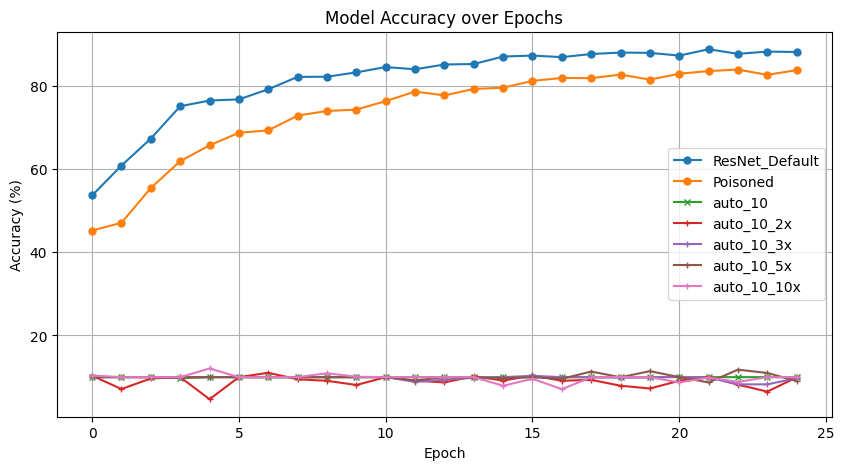

In [57]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='Poisoned')
plt.plot(acc_auto_10, marker='x', linestyle='-', markersize=5, label='auto_10')
plt.plot(acc_auto_10_2x, marker='+', linestyle='-', markersize=5, label='auto_10_2x')
plt.plot(acc_auto_10_3x, marker='+', linestyle='-', markersize=5, label='auto_10_3x')
plt.plot(acc_auto_10_5x, marker='+', linestyle='-', markersize=5, label='auto_10_5x')
plt.plot(acc_auto_10_10x, marker='+', linestyle='-', markersize=5, label='auto_10_10x')
# plt.plot(acc_unet_10, marker='x', linestyle='-', markersize=5, label='unet_10')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attack')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='unet_attack')
# plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
# plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()

#### auto_attacked

In [58]:
train_loader_auto_attacked_2x = DataLoader(dataset=s_auto_attacked, batch_size=64, shuffle=True)

acc_auto_attacked_2x = train_and_evaluate(model_auto_attacked_2x, train_loader_auto_attacked_2x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_attacked), net_name="auto_attacked_2x.pt", log_name = "auto_attacked_2x")

Number of Data Type: 5
[Epoch 1] loss: 2.358
Accuracy: 10.01%
[Epoch 2] loss: 2.316
Accuracy: 10.00%
[Epoch 3] loss: 2.313
Accuracy: 9.94%
[Epoch 4] loss: 2.311
Accuracy: 10.00%
[Epoch 5] loss: 2.311
Accuracy: 10.48%
[Epoch 6] loss: 2.310
Accuracy: 10.00%
[Epoch 7] loss: 2.309
Accuracy: 10.33%
[Epoch 8] loss: 2.309
Accuracy: 12.88%
[Epoch 9] loss: 2.310
Accuracy: 9.59%
[Epoch 10] loss: 2.308
Accuracy: 10.09%
[Epoch 11] loss: 2.309
Accuracy: 9.99%
[Epoch 12] loss: 2.308
Accuracy: 9.40%
[Epoch 13] loss: 2.308
Accuracy: 9.46%
[Epoch 14] loss: 2.308
Accuracy: 10.00%
[Epoch 15] loss: 2.308
Accuracy: 9.96%
[Epoch 16] loss: 2.308
Accuracy: 10.04%
[Epoch 17] loss: 2.307
Accuracy: 10.64%
[Epoch 18] loss: 2.307
Accuracy: 9.99%
[Epoch 19] loss: 2.308
Accuracy: 12.13%
[Epoch 20] loss: 2.307
Accuracy: 10.40%
[Epoch 21] loss: 2.307
Accuracy: 10.93%
[Epoch 22] loss: 2.307
Accuracy: 8.24%
[Epoch 23] loss: 2.307
Accuracy: 10.76%
[Epoch 24] loss: 2.306
Accuracy: 10.00%
[Epoch 25] loss: 2.307
Accuracy: 8

In [59]:
train_loader_auto_attacked_3x = DataLoader(dataset=s_auto_attacked, batch_size=64, shuffle=True)

acc_auto_attacked_3x = train_and_evaluate(model_auto_attacked_3x, train_loader_auto_attacked_3x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_attacked), net_name="auto_attacked_3x.pt", log_name = "auto_attacked_3x")

Number of Data Type: 5
[Epoch 1] loss: 2.358
Accuracy: 10.42%
[Epoch 2] loss: 2.318
Accuracy: 9.08%
[Epoch 3] loss: 2.315
Accuracy: 9.77%
[Epoch 4] loss: 2.313
Accuracy: 10.09%
[Epoch 5] loss: 2.311
Accuracy: 9.35%
[Epoch 6] loss: 2.311
Accuracy: 11.05%
[Epoch 7] loss: 2.310
Accuracy: 9.73%
[Epoch 8] loss: 2.310
Accuracy: 10.45%
[Epoch 9] loss: 2.310
Accuracy: 10.00%
[Epoch 10] loss: 2.310
Accuracy: 8.83%
[Epoch 11] loss: 2.310
Accuracy: 8.23%
[Epoch 12] loss: 2.310
Accuracy: 10.08%
[Epoch 13] loss: 2.310
Accuracy: 10.68%
[Epoch 14] loss: 2.309
Accuracy: 12.29%
[Epoch 15] loss: 2.309
Accuracy: 11.19%
[Epoch 16] loss: 2.309
Accuracy: 10.08%
[Epoch 17] loss: 2.308
Accuracy: 12.96%
[Epoch 18] loss: 2.309
Accuracy: 10.82%
[Epoch 19] loss: 2.308
Accuracy: 11.70%
[Epoch 20] loss: 2.309
Accuracy: 12.18%
[Epoch 21] loss: 2.308
Accuracy: 10.39%
[Epoch 22] loss: 2.308
Accuracy: 12.26%
[Epoch 23] loss: 2.307
Accuracy: 10.00%
[Epoch 24] loss: 2.307
Accuracy: 11.31%
[Epoch 25] loss: 2.307
Accuracy:

In [60]:
train_loader_auto_attacked_5x = DataLoader(dataset=s_auto_attacked, batch_size=64, shuffle=True)

acc_auto_attacked_5x = train_and_evaluate(model_auto_attacked_5x, train_loader_auto_attacked_5x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_attacked), net_name="auto_attacked_5x.pt", log_name = "auto_attacked_5x")

Number of Data Type: 5
[Epoch 1] loss: 2.361
Accuracy: 10.03%
[Epoch 2] loss: 2.321
Accuracy: 10.01%
[Epoch 3] loss: 2.317
Accuracy: 10.00%
[Epoch 4] loss: 2.314
Accuracy: 9.81%
[Epoch 5] loss: 2.314
Accuracy: 11.19%
[Epoch 6] loss: 2.312
Accuracy: 10.00%
[Epoch 7] loss: 2.312
Accuracy: 9.71%
[Epoch 8] loss: 2.311
Accuracy: 10.17%
[Epoch 9] loss: 2.311
Accuracy: 10.11%
[Epoch 10] loss: 2.311
Accuracy: 9.98%
[Epoch 11] loss: 2.311
Accuracy: 11.32%
[Epoch 12] loss: 2.309
Accuracy: 11.34%
[Epoch 13] loss: 2.309
Accuracy: 12.32%
[Epoch 14] loss: 2.310
Accuracy: 10.02%
[Epoch 15] loss: 2.309
Accuracy: 10.38%
[Epoch 16] loss: 2.309
Accuracy: 9.83%
[Epoch 17] loss: 2.308
Accuracy: 10.72%
[Epoch 18] loss: 2.308
Accuracy: 8.59%
[Epoch 19] loss: 2.308
Accuracy: 9.26%
[Epoch 20] loss: 2.306
Accuracy: 10.66%
[Epoch 21] loss: 2.306
Accuracy: 10.31%
[Epoch 22] loss: 2.306
Accuracy: 8.01%
[Epoch 23] loss: 2.305
Accuracy: 11.05%
[Epoch 24] loss: 2.304
Accuracy: 9.07%
[Epoch 25] loss: 2.304
Accuracy: 9

In [61]:
train_loader_auto_attacked_10x = DataLoader(dataset=s_auto_attacked, batch_size=64, shuffle=True)

acc_auto_attacked_10x = train_and_evaluate(model_auto_attacked_2x, train_loader_auto_attacked_10x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_attacked), net_name="auto_attacked_10x.pt", log_name = "auto_attacked_10x")

Number of Data Type: 5
[Epoch 1] loss: 2.310
Accuracy: 9.12%
[Epoch 2] loss: 2.308
Accuracy: 8.98%
[Epoch 3] loss: 2.307
Accuracy: 10.00%
[Epoch 4] loss: 2.307
Accuracy: 9.99%
[Epoch 5] loss: 2.307
Accuracy: 9.94%
[Epoch 6] loss: 2.307
Accuracy: 9.98%
[Epoch 7] loss: 2.307
Accuracy: 12.88%
[Epoch 8] loss: 2.307
Accuracy: 6.48%
[Epoch 9] loss: 2.307
Accuracy: 10.30%
[Epoch 10] loss: 2.306
Accuracy: 10.51%
[Epoch 11] loss: 2.306
Accuracy: 9.82%
[Epoch 12] loss: 2.306
Accuracy: 7.00%
[Epoch 13] loss: 2.306
Accuracy: 9.31%
[Epoch 14] loss: 2.306
Accuracy: 10.11%
[Epoch 15] loss: 2.306
Accuracy: 10.40%
[Epoch 16] loss: 2.306
Accuracy: 9.69%
[Epoch 17] loss: 2.306
Accuracy: 10.14%
[Epoch 18] loss: 2.305
Accuracy: 11.42%
[Epoch 19] loss: 2.305
Accuracy: 10.21%
[Epoch 20] loss: 2.305
Accuracy: 11.54%
[Epoch 21] loss: 2.304
Accuracy: 9.15%
[Epoch 22] loss: 2.304
Accuracy: 9.51%
[Epoch 23] loss: 2.303
Accuracy: 9.86%
[Epoch 24] loss: 2.303
Accuracy: 10.42%
[Epoch 25] loss: 2.302
Accuracy: 9.27%


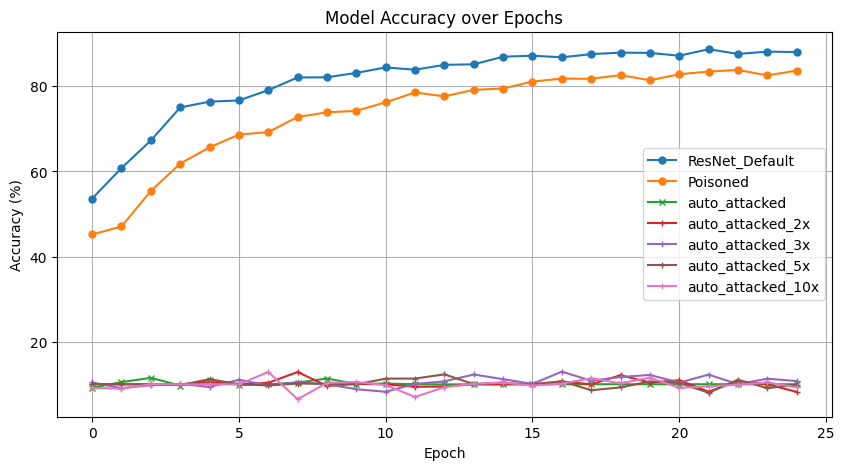

In [62]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='Poisoned')
plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attacked')
plt.plot(acc_auto_attacked_2x, marker='+', linestyle='-', markersize=5, label='auto_attacked_2x')
plt.plot(acc_auto_attacked_3x, marker='+', linestyle='-', markersize=5, label='auto_attacked_3x')
plt.plot(acc_auto_attacked_5x, marker='+', linestyle='-', markersize=5, label='auto_attacked_5x')
plt.plot(acc_auto_attacked_10x, marker='+', linestyle='-', markersize=5, label='auto_attacked_10x')
# plt.plot(acc_unet_10, marker='x', linestyle='-', markersize=5, label='unet_10')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attack')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='unet_attack')
# plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
# plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()

#### unet_attacked

In [63]:
train_loader_unet_attacked_2x = DataLoader(dataset=s_unet_attacked, batch_size=64, shuffle=True)

acc_unet_attacked_2x = train_and_evaluate(model_unet_attacked_2x, train_loader_unet_attacked_2x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_attacked), net_name="unet_attacked_2x.pt", log_name = "unet_attacked_2x")

Number of Data Type: 5
[Epoch 1] loss: 2.353
Accuracy: 9.62%
[Epoch 2] loss: 2.316
Accuracy: 9.99%
[Epoch 3] loss: 2.313
Accuracy: 10.00%
[Epoch 4] loss: 2.312
Accuracy: 9.28%
[Epoch 5] loss: 2.311
Accuracy: 10.00%
[Epoch 6] loss: 2.310
Accuracy: 10.04%
[Epoch 7] loss: 2.309
Accuracy: 10.00%
[Epoch 8] loss: 2.309
Accuracy: 9.78%
[Epoch 9] loss: 2.309
Accuracy: 9.75%
[Epoch 10] loss: 2.308
Accuracy: 10.10%
[Epoch 11] loss: 2.308
Accuracy: 9.91%
[Epoch 12] loss: 2.308
Accuracy: 9.75%
[Epoch 13] loss: 2.308
Accuracy: 10.14%
[Epoch 14] loss: 2.308
Accuracy: 10.43%
[Epoch 15] loss: 2.308
Accuracy: 9.24%
[Epoch 16] loss: 2.308
Accuracy: 11.01%
[Epoch 17] loss: 2.307
Accuracy: 10.00%
[Epoch 18] loss: 2.307
Accuracy: 10.23%
[Epoch 19] loss: 2.307
Accuracy: 10.53%
[Epoch 20] loss: 2.307
Accuracy: 9.23%
[Epoch 21] loss: 2.307
Accuracy: 8.77%
[Epoch 22] loss: 2.307
Accuracy: 9.45%
[Epoch 23] loss: 2.306
Accuracy: 9.62%
[Epoch 24] loss: 2.306
Accuracy: 9.69%
[Epoch 25] loss: 2.306
Accuracy: 10.26%

In [64]:
train_loader_unet_attacked_3x = DataLoader(dataset=s_unet_attacked, batch_size=64, shuffle=True)

acc_unet_attacked_3x = train_and_evaluate(model_unet_attacked_3x, train_loader_unet_attacked_3x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_attacked), net_name="unet_attacked_3x.pt", log_name = "unet_attacked_3x")

Number of Data Type: 5
[Epoch 1] loss: 2.357
Accuracy: 10.08%
[Epoch 2] loss: 2.320
Accuracy: 9.91%
[Epoch 3] loss: 2.315
Accuracy: 10.00%
[Epoch 4] loss: 2.313
Accuracy: 10.00%
[Epoch 5] loss: 2.313
Accuracy: 9.77%
[Epoch 6] loss: 2.312
Accuracy: 10.01%
[Epoch 7] loss: 2.310
Accuracy: 12.22%
[Epoch 8] loss: 2.311
Accuracy: 8.94%
[Epoch 9] loss: 2.311
Accuracy: 9.90%
[Epoch 10] loss: 2.309
Accuracy: 10.00%
[Epoch 11] loss: 2.310
Accuracy: 9.75%
[Epoch 12] loss: 2.310
Accuracy: 10.06%
[Epoch 13] loss: 2.309
Accuracy: 9.85%
[Epoch 14] loss: 2.309
Accuracy: 7.67%
[Epoch 15] loss: 2.309
Accuracy: 10.00%
[Epoch 16] loss: 2.309
Accuracy: 7.83%
[Epoch 17] loss: 2.308
Accuracy: 8.18%
[Epoch 18] loss: 2.308
Accuracy: 10.05%
[Epoch 19] loss: 2.308
Accuracy: 9.64%
[Epoch 20] loss: 2.308
Accuracy: 9.44%
[Epoch 21] loss: 2.309
Accuracy: 10.60%
[Epoch 22] loss: 2.308
Accuracy: 9.99%
[Epoch 23] loss: 2.308
Accuracy: 8.68%
[Epoch 24] loss: 2.308
Accuracy: 9.68%
[Epoch 25] loss: 2.308
Accuracy: 8.57%
모

In [65]:
train_loader_unet_attacked_5x = DataLoader(dataset=s_unet_attacked, batch_size=64, shuffle=True)

acc_unet_attacked_5x = train_and_evaluate(model_unet_attacked_5x, train_loader_unet_attacked_5x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_attacked), net_name="unet_attacked_5x.pt", log_name = "unet_attacked_5x")

Number of Data Type: 5
[Epoch 1] loss: 2.377
Accuracy: 10.01%
[Epoch 2] loss: 2.325
Accuracy: 8.64%
[Epoch 3] loss: 2.319
Accuracy: 10.00%
[Epoch 4] loss: 2.315
Accuracy: 10.00%
[Epoch 5] loss: 2.314
Accuracy: 10.00%
[Epoch 6] loss: 2.313
Accuracy: 10.00%
[Epoch 7] loss: 2.312
Accuracy: 10.00%
[Epoch 8] loss: 2.313
Accuracy: 10.00%
[Epoch 9] loss: 2.312
Accuracy: 10.00%
[Epoch 10] loss: 2.311
Accuracy: 10.00%
[Epoch 11] loss: 2.312
Accuracy: 10.00%
[Epoch 12] loss: 2.311
Accuracy: 10.00%
[Epoch 13] loss: 2.312
Accuracy: 10.00%
[Epoch 14] loss: 2.311
Accuracy: 9.12%
[Epoch 15] loss: 2.310
Accuracy: 10.00%
[Epoch 16] loss: 2.310
Accuracy: 6.26%
[Epoch 17] loss: 2.309
Accuracy: 10.00%
[Epoch 18] loss: 2.310
Accuracy: 9.89%
[Epoch 19] loss: 2.309
Accuracy: 10.00%
[Epoch 20] loss: 2.310
Accuracy: 9.97%
[Epoch 21] loss: 2.310
Accuracy: 10.23%
[Epoch 22] loss: 2.309
Accuracy: 9.71%
[Epoch 23] loss: 2.310
Accuracy: 9.07%
[Epoch 24] loss: 2.309
Accuracy: 7.38%
[Epoch 25] loss: 2.309
Accuracy: 9

In [66]:
train_loader_unet_attacked_10x = DataLoader(dataset=s_unet_attacked, batch_size=64, shuffle=True)

acc_unet_attacked_10x = train_and_evaluate(model_unet_attacked_2x, train_loader_unet_attacked_10x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_attacked), net_name="unet_attacked_10x.pt", log_name = "unet_attacked_10x")

Number of Data Type: 5
[Epoch 1] loss: 2.309
Accuracy: 11.19%
[Epoch 2] loss: 2.307
Accuracy: 9.87%
[Epoch 3] loss: 2.306
Accuracy: 9.99%
[Epoch 4] loss: 2.306
Accuracy: 9.97%
[Epoch 5] loss: 2.306
Accuracy: 9.94%
[Epoch 6] loss: 2.304
Accuracy: 9.56%
[Epoch 7] loss: 2.303
Accuracy: 10.38%
[Epoch 8] loss: 2.304
Accuracy: 9.40%
[Epoch 9] loss: 2.303
Accuracy: 8.43%
[Epoch 10] loss: 2.301
Accuracy: 10.62%
[Epoch 11] loss: 2.299
Accuracy: 10.44%
[Epoch 12] loss: 2.298
Accuracy: 9.42%
[Epoch 13] loss: 2.294
Accuracy: 8.70%
[Epoch 14] loss: 2.290
Accuracy: 9.41%
[Epoch 15] loss: 2.285
Accuracy: 8.93%
[Epoch 16] loss: 2.278
Accuracy: 9.67%
[Epoch 17] loss: 2.267
Accuracy: 9.35%
[Epoch 18] loss: 2.250
Accuracy: 8.82%
[Epoch 19] loss: 2.225
Accuracy: 9.62%
[Epoch 20] loss: 2.186
Accuracy: 8.72%
[Epoch 21] loss: 2.131
Accuracy: 9.20%
[Epoch 22] loss: 2.046
Accuracy: 8.28%
[Epoch 23] loss: 1.920
Accuracy: 9.22%
[Epoch 24] loss: 1.749
Accuracy: 10.28%
[Epoch 25] loss: 1.524
Accuracy: 9.51%
모델을 저장

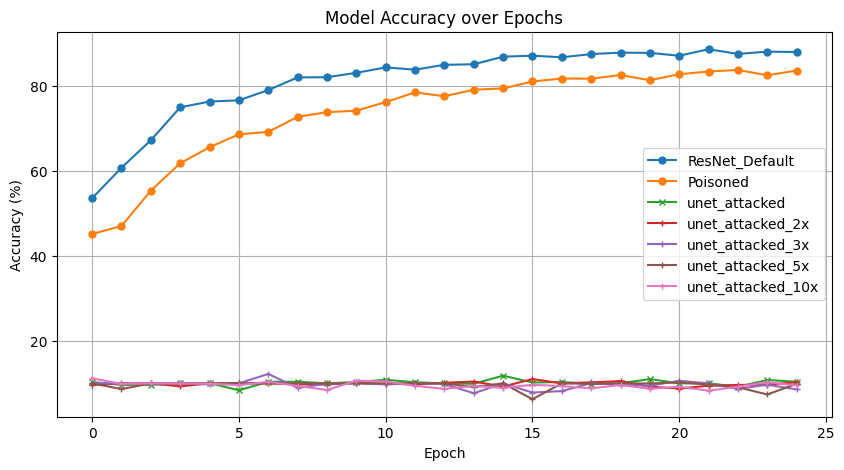

In [67]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='Poisoned')
plt.plot(acc_unet_attack, marker='x', linestyle='-', markersize=5, label='unet_attacked')
plt.plot(acc_unet_attacked_2x, marker='+', linestyle='-', markersize=5, label='unet_attacked_2x')
plt.plot(acc_unet_attacked_3x, marker='+', linestyle='-', markersize=5, label='unet_attacked_3x')
plt.plot(acc_unet_attacked_5x, marker='+', linestyle='-', markersize=5, label='unet_attacked_5x')
plt.plot(acc_unet_attacked_10x, marker='+', linestyle='-', markersize=5, label='unet_attacked_10x')
# plt.plot(acc_unet_10, marker='x', linestyle='-', markersize=5, label='unet_10')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attack')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='unet_attack')
# plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
# plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()

#### auto_100

In [68]:
train_loader_auto_100_2x = DataLoader(dataset=s_auto_100, batch_size=64, shuffle=True)

acc_auto_100_2x = train_and_evaluate(model_auto_100_2x, train_loader_auto_100_2x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_100), net_name="auto_100_2x.pt", log_name = "auto_100_2x")

Number of Data Type: 5
[Epoch 1] loss: 2.373
Accuracy: 13.02%
[Epoch 2] loss: 2.318
Accuracy: 10.00%
[Epoch 3] loss: 2.314
Accuracy: 10.00%
[Epoch 4] loss: 2.313
Accuracy: 10.00%
[Epoch 5] loss: 2.310
Accuracy: 10.00%
[Epoch 6] loss: 2.309
Accuracy: 10.00%
[Epoch 7] loss: 2.310
Accuracy: 10.00%
[Epoch 8] loss: 2.310
Accuracy: 10.00%
[Epoch 9] loss: 2.309
Accuracy: 10.00%
[Epoch 10] loss: 2.308
Accuracy: 10.00%
[Epoch 11] loss: 2.309
Accuracy: 10.00%
[Epoch 12] loss: 2.309
Accuracy: 9.82%
[Epoch 13] loss: 2.308
Accuracy: 9.99%
[Epoch 14] loss: 2.309
Accuracy: 10.00%
[Epoch 15] loss: 2.309
Accuracy: 10.00%
[Epoch 16] loss: 2.308
Accuracy: 10.83%
[Epoch 17] loss: 2.308
Accuracy: 10.00%
[Epoch 18] loss: 2.307
Accuracy: 9.95%
[Epoch 19] loss: 2.307
Accuracy: 10.71%
[Epoch 20] loss: 2.307
Accuracy: 9.38%
[Epoch 21] loss: 2.307
Accuracy: 9.35%
[Epoch 22] loss: 2.307
Accuracy: 11.09%
[Epoch 23] loss: 2.307
Accuracy: 9.97%
[Epoch 24] loss: 2.307
Accuracy: 9.70%
[Epoch 25] loss: 2.307
Accuracy: 

In [69]:
train_loader_auto_100_3x = DataLoader(dataset=s_auto_100, batch_size=64, shuffle=True)

acc_auto_100_3x = train_and_evaluate(model_auto_100_3x, train_loader_auto_100_3x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_100), net_name="auto_100_3x.pt", log_name = "auto_100_3x")

Number of Data Type: 5
[Epoch 1] loss: 2.374
Accuracy: 10.00%
[Epoch 2] loss: 2.321
Accuracy: 10.01%
[Epoch 3] loss: 2.316
Accuracy: 10.00%
[Epoch 4] loss: 2.314
Accuracy: 10.00%
[Epoch 5] loss: 2.313
Accuracy: 10.00%
[Epoch 6] loss: 2.312
Accuracy: 10.00%
[Epoch 7] loss: 2.312
Accuracy: 10.00%
[Epoch 8] loss: 2.311
Accuracy: 10.00%
[Epoch 9] loss: 2.311
Accuracy: 10.00%
[Epoch 10] loss: 2.311
Accuracy: 10.00%
[Epoch 11] loss: 2.311
Accuracy: 10.00%
[Epoch 12] loss: 2.310
Accuracy: 10.00%
[Epoch 13] loss: 2.309
Accuracy: 10.00%
[Epoch 14] loss: 2.310
Accuracy: 10.00%
[Epoch 15] loss: 2.309
Accuracy: 10.00%
[Epoch 16] loss: 2.309
Accuracy: 9.40%
[Epoch 17] loss: 2.309
Accuracy: 9.97%
[Epoch 18] loss: 2.309
Accuracy: 11.22%
[Epoch 19] loss: 2.310
Accuracy: 9.13%
[Epoch 20] loss: 2.309
Accuracy: 10.70%
[Epoch 21] loss: 2.308
Accuracy: 10.00%
[Epoch 22] loss: 2.308
Accuracy: 10.00%
[Epoch 23] loss: 2.308
Accuracy: 11.35%
[Epoch 24] loss: 2.309
Accuracy: 10.00%
[Epoch 25] loss: 2.309
Accura

In [70]:
train_loader_auto_100_5x = DataLoader(dataset=s_auto_100, batch_size=64, shuffle=True)

acc_auto_100_5x = train_and_evaluate(model_auto_100_5x, train_loader_auto_100_5x, test_loader, net_reset=(multiplier_sys_reset or M_reset_auto_100), net_name="auto_100_5x.pt", log_name = "auto_100_5x")

Number of Data Type: 5
[Epoch 1] loss: 2.378
Accuracy: 10.00%
[Epoch 2] loss: 2.324
Accuracy: 10.00%
[Epoch 3] loss: 2.318
Accuracy: 10.00%
[Epoch 4] loss: 2.315
Accuracy: 10.00%
[Epoch 5] loss: 2.314
Accuracy: 10.00%
[Epoch 6] loss: 2.312
Accuracy: 10.00%
[Epoch 7] loss: 2.312
Accuracy: 10.00%
[Epoch 8] loss: 2.311
Accuracy: 10.00%
[Epoch 9] loss: 2.312
Accuracy: 12.32%
[Epoch 10] loss: 2.311
Accuracy: 10.00%
[Epoch 11] loss: 2.311
Accuracy: 10.00%
[Epoch 12] loss: 2.312
Accuracy: 8.31%
[Epoch 13] loss: 2.311
Accuracy: 10.10%
[Epoch 14] loss: 2.310
Accuracy: 10.00%
[Epoch 15] loss: 2.310
Accuracy: 9.86%
[Epoch 16] loss: 2.310
Accuracy: 10.00%
[Epoch 17] loss: 2.310
Accuracy: 10.90%
[Epoch 18] loss: 2.310
Accuracy: 10.00%
[Epoch 19] loss: 2.310
Accuracy: 10.77%
[Epoch 20] loss: 2.309
Accuracy: 12.92%
[Epoch 21] loss: 2.309
Accuracy: 8.85%
[Epoch 22] loss: 2.309
Accuracy: 12.54%
[Epoch 23] loss: 2.308
Accuracy: 10.44%
[Epoch 24] loss: 2.308
Accuracy: 9.84%
[Epoch 25] loss: 2.308
Accurac

In [71]:
train_loader_auto_100_10x = DataLoader(dataset=s_auto_100, batch_size=64, shuffle=True)

acc_auto_100_10x = train_and_evaluate(model_auto_100_2x, train_loader_auto_100_10x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_10), net_name="auto_100_10x.pt", log_name = "auto_100_10x")

Number of Data Type: 5
[Epoch 1] loss: 2.312
Accuracy: 9.85%
[Epoch 2] loss: 2.308
Accuracy: 9.01%
[Epoch 3] loss: 2.307
Accuracy: 10.00%
[Epoch 4] loss: 2.307
Accuracy: 10.98%
[Epoch 5] loss: 2.305
Accuracy: 11.60%
[Epoch 6] loss: 2.306
Accuracy: 10.40%
[Epoch 7] loss: 2.305
Accuracy: 8.74%
[Epoch 8] loss: 2.306
Accuracy: 11.78%
[Epoch 9] loss: 2.305
Accuracy: 10.13%
[Epoch 10] loss: 2.304
Accuracy: 11.39%
[Epoch 11] loss: 2.303
Accuracy: 10.61%
[Epoch 12] loss: 2.302
Accuracy: 10.55%
[Epoch 13] loss: 2.302
Accuracy: 10.26%
[Epoch 14] loss: 2.301
Accuracy: 11.32%
[Epoch 15] loss: 2.299
Accuracy: 11.33%
[Epoch 16] loss: 2.296
Accuracy: 11.46%
[Epoch 17] loss: 2.293
Accuracy: 10.62%
[Epoch 18] loss: 2.290
Accuracy: 9.03%
[Epoch 19] loss: 2.284
Accuracy: 10.34%
[Epoch 20] loss: 2.276
Accuracy: 10.16%
[Epoch 21] loss: 2.265
Accuracy: 11.24%
[Epoch 22] loss: 2.250
Accuracy: 10.82%
[Epoch 23] loss: 2.231
Accuracy: 10.26%
[Epoch 24] loss: 2.200
Accuracy: 10.44%
[Epoch 25] loss: 2.153
Accurac

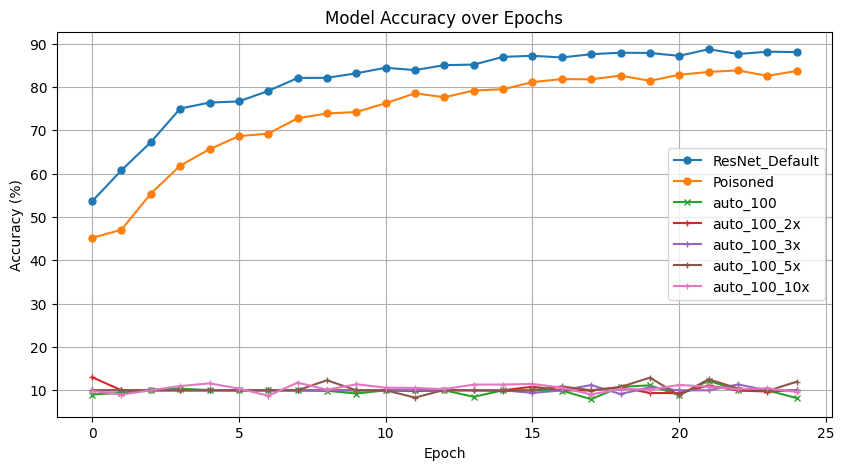

In [72]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='Poisoned')
plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
plt.plot(acc_auto_100_2x, marker='+', linestyle='-', markersize=5, label='auto_100_2x')
plt.plot(acc_auto_100_3x, marker='+', linestyle='-', markersize=5, label='auto_100_3x')
plt.plot(acc_auto_100_5x, marker='+', linestyle='-', markersize=5, label='auto_100_5x')
plt.plot(acc_auto_100_10x, marker='+', linestyle='-', markersize=5, label='auto_100_10x')
# plt.plot(acc_unet_10, marker='x', linestyle='-', markersize=5, label='unet_10')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attack')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='unet_attack')
# plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
# plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()

#### unet_100

In [73]:
train_loader_unet_100_2x = DataLoader(dataset=s_unet_100, batch_size=64, shuffle=True)

acc_unet_100_2x = train_and_evaluate(model_unet_100_2x, train_loader_unet_100_2x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_100), net_name="unet_100_2x.pt", log_name = "unet_100_2x")

Number of Data Type: 5
[Epoch 1] loss: 2.368
Accuracy: 10.00%
[Epoch 2] loss: 2.319
Accuracy: 10.03%
[Epoch 3] loss: 2.314
Accuracy: 10.00%
[Epoch 4] loss: 2.312
Accuracy: 10.00%
[Epoch 5] loss: 2.312
Accuracy: 10.00%
[Epoch 6] loss: 2.311
Accuracy: 10.00%
[Epoch 7] loss: 2.310
Accuracy: 10.00%
[Epoch 8] loss: 2.309
Accuracy: 10.00%
[Epoch 9] loss: 2.309
Accuracy: 9.42%
[Epoch 10] loss: 2.309
Accuracy: 10.00%
[Epoch 11] loss: 2.309
Accuracy: 10.00%
[Epoch 12] loss: 2.308
Accuracy: 10.00%
[Epoch 13] loss: 2.309
Accuracy: 10.00%
[Epoch 14] loss: 2.308
Accuracy: 10.20%
[Epoch 15] loss: 2.308
Accuracy: 12.07%
[Epoch 16] loss: 2.308
Accuracy: 9.95%
[Epoch 17] loss: 2.308
Accuracy: 9.97%
[Epoch 18] loss: 2.308
Accuracy: 10.00%
[Epoch 19] loss: 2.307
Accuracy: 10.00%
[Epoch 20] loss: 2.307
Accuracy: 10.00%
[Epoch 21] loss: 2.308
Accuracy: 7.95%
[Epoch 22] loss: 2.307
Accuracy: 10.00%
[Epoch 23] loss: 2.307
Accuracy: 10.01%
[Epoch 24] loss: 2.307
Accuracy: 9.43%
[Epoch 25] loss: 2.307
Accuracy

In [74]:
train_loader_unet_100_3x = DataLoader(dataset=s_unet_100, batch_size=64, shuffle=True)

acc_unet_100_3x = train_and_evaluate(model_unet_100_3x, train_loader_unet_100_3x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_100), net_name="unet_100_3x.pt", log_name = "unet_100_3x")

Number of Data Type: 5
[Epoch 1] loss: 2.361
Accuracy: 11.84%
[Epoch 2] loss: 2.320
Accuracy: 10.02%
[Epoch 3] loss: 2.314
Accuracy: 10.00%
[Epoch 4] loss: 2.314
Accuracy: 10.00%
[Epoch 5] loss: 2.312
Accuracy: 10.00%
[Epoch 6] loss: 2.311
Accuracy: 10.40%
[Epoch 7] loss: 2.311
Accuracy: 10.00%
[Epoch 8] loss: 2.310
Accuracy: 10.99%
[Epoch 9] loss: 2.310
Accuracy: 11.16%
[Epoch 10] loss: 2.310
Accuracy: 10.00%
[Epoch 11] loss: 2.310
Accuracy: 10.21%
[Epoch 12] loss: 2.310
Accuracy: 10.91%
[Epoch 13] loss: 2.309
Accuracy: 10.00%
[Epoch 14] loss: 2.310
Accuracy: 10.00%
[Epoch 15] loss: 2.308
Accuracy: 9.46%
[Epoch 16] loss: 2.309
Accuracy: 8.06%
[Epoch 17] loss: 2.309
Accuracy: 11.72%
[Epoch 18] loss: 2.309
Accuracy: 10.23%
[Epoch 19] loss: 2.309
Accuracy: 9.97%
[Epoch 20] loss: 2.308
Accuracy: 8.86%
[Epoch 21] loss: 2.308
Accuracy: 10.37%
[Epoch 22] loss: 2.308
Accuracy: 10.00%
[Epoch 23] loss: 2.308
Accuracy: 10.00%
[Epoch 24] loss: 2.309
Accuracy: 10.00%
[Epoch 25] loss: 2.308
Accurac

In [75]:
train_loader_unet_100_5x = DataLoader(dataset=s_unet_100, batch_size=64, shuffle=True)

acc_unet_100_5x = train_and_evaluate(model_unet_100_5x, train_loader_unet_100_5x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_100), net_name="unet_100_5x.pt", log_name = "unet_100_5x")

Number of Data Type: 5
[Epoch 1] loss: 2.372
Accuracy: 13.28%
[Epoch 2] loss: 2.323
Accuracy: 10.00%
[Epoch 3] loss: 2.318
Accuracy: 10.00%
[Epoch 4] loss: 2.316
Accuracy: 10.00%
[Epoch 5] loss: 2.315
Accuracy: 10.00%
[Epoch 6] loss: 2.313
Accuracy: 10.66%
[Epoch 7] loss: 2.313
Accuracy: 10.00%
[Epoch 8] loss: 2.313
Accuracy: 10.00%
[Epoch 9] loss: 2.312
Accuracy: 10.00%
[Epoch 10] loss: 2.312
Accuracy: 10.00%
[Epoch 11] loss: 2.311
Accuracy: 10.00%
[Epoch 12] loss: 2.311
Accuracy: 9.99%
[Epoch 13] loss: 2.311
Accuracy: 10.00%
[Epoch 14] loss: 2.311
Accuracy: 10.36%
[Epoch 15] loss: 2.311
Accuracy: 10.18%
[Epoch 16] loss: 2.310
Accuracy: 10.00%
[Epoch 17] loss: 2.309
Accuracy: 9.95%
[Epoch 18] loss: 2.310
Accuracy: 10.03%
[Epoch 19] loss: 2.309
Accuracy: 10.00%
[Epoch 20] loss: 2.309
Accuracy: 9.95%
[Epoch 21] loss: 2.309
Accuracy: 9.57%
[Epoch 22] loss: 2.310
Accuracy: 10.00%
[Epoch 23] loss: 2.309
Accuracy: 9.49%
[Epoch 24] loss: 2.309
Accuracy: 10.04%
[Epoch 25] loss: 2.308
Accuracy

In [76]:
train_loader_unet_100_10x = DataLoader(dataset=s_unet_100, batch_size=64, shuffle=True)

acc_unet_100_10x = train_and_evaluate(model_unet_100_2x, train_loader_unet_100_10x, test_loader, net_reset=(multiplier_sys_reset or M_reset_unet_100), net_name="unet_100_10x.pt", log_name = "unet_100_10x")

Number of Data Type: 5
[Epoch 1] loss: 2.311
Accuracy: 9.74%
[Epoch 2] loss: 2.308
Accuracy: 10.65%
[Epoch 3] loss: 2.306
Accuracy: 10.00%
[Epoch 4] loss: 2.307
Accuracy: 9.89%
[Epoch 5] loss: 2.307
Accuracy: 9.40%
[Epoch 6] loss: 2.306
Accuracy: 9.53%
[Epoch 7] loss: 2.306
Accuracy: 11.73%
[Epoch 8] loss: 2.306
Accuracy: 9.66%
[Epoch 9] loss: 2.305
Accuracy: 10.87%
[Epoch 10] loss: 2.305
Accuracy: 9.32%
[Epoch 11] loss: 2.304
Accuracy: 10.69%
[Epoch 12] loss: 2.304
Accuracy: 10.75%
[Epoch 13] loss: 2.302
Accuracy: 9.73%
[Epoch 14] loss: 2.301
Accuracy: 10.13%
[Epoch 15] loss: 2.300
Accuracy: 10.90%
[Epoch 16] loss: 2.299
Accuracy: 11.04%
[Epoch 17] loss: 2.297
Accuracy: 10.82%
[Epoch 18] loss: 2.294
Accuracy: 9.84%
[Epoch 19] loss: 2.290
Accuracy: 9.87%
[Epoch 20] loss: 2.285
Accuracy: 10.14%
[Epoch 21] loss: 2.276
Accuracy: 10.43%
[Epoch 22] loss: 2.267
Accuracy: 10.02%
[Epoch 23] loss: 2.250
Accuracy: 9.71%
[Epoch 24] loss: 2.228
Accuracy: 10.72%
[Epoch 25] loss: 2.194
Accuracy: 10.

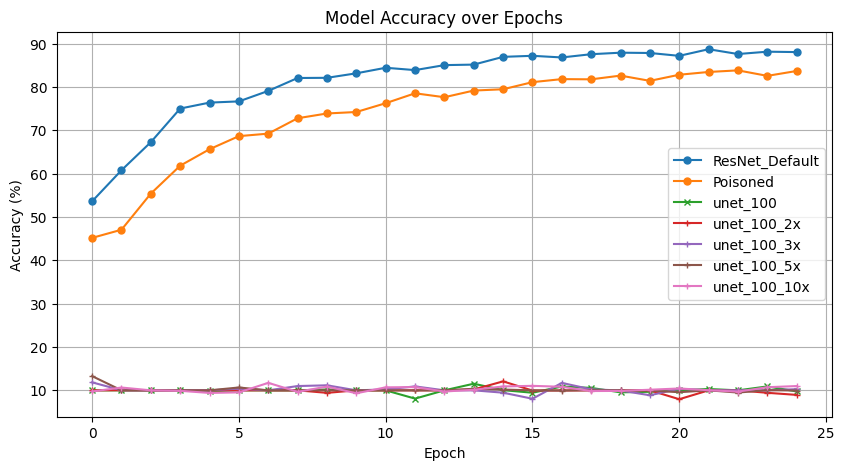

In [77]:
# Visualize the test accuracy
plt.figure(figsize=(10, 5))

plt.plot(acc_res, marker='o', linestyle='-', markersize=5, label='ResNet_Default')
plt.plot(acc_res_1, marker='o', linestyle='-', markersize=5, label='Poisoned')
plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')
plt.plot(acc_unet_100_2x, marker='+', linestyle='-', markersize=5, label='unet_100_2x')
plt.plot(acc_unet_100_3x, marker='+', linestyle='-', markersize=5, label='unet_100_3x')
plt.plot(acc_unet_100_5x, marker='+', linestyle='-', markersize=5, label='unet_100_5x')
plt.plot(acc_unet_100_10x, marker='+', linestyle='-', markersize=5, label='unet_100_10x')
# plt.plot(acc_unet_10, marker='x', linestyle='-', markersize=5, label='unet_10')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='auto_attack')
# plt.plot(acc_auto_attack, marker='x', linestyle='-', markersize=5, label='unet_attack')
# plt.plot(acc_auto_100, marker='x', linestyle='-', markersize=5, label='auto_100')
# plt.plot(acc_unet_100, marker='x', linestyle='-', markersize=5, label='unet_100')

plt.title('Model Accuracy over Epochs')
plt.xlabel('Epoch')
plt.ylabel('Accuracy (%)')

plt.grid(True)
plt.legend()
plt.show()